You will be using transfer learning on a large, known dataset called [MSCOCO](https://cocodataset.org/#download). Specifically, you will perform the task of "reference resolution" that identifies objects in images using referring expressions. 



### Download dataset

The mscoco dataset is pretty big (12 GB). We won't be using all of the data, but it makes matters easier to have everything together in one place. To help you download the data, you can run the following script (might need to open the script and follow step by step on windows). You will only need to run this once!

There is an [https://github.com/lichengunc/refer/blob/master/refer.py](API) to help you access and use the dataset. The main API is in the refer.py file. Run the following cell to import it, along with some other useful libraries (you may need to run pip to install them):

In [1]:
from refer import REFER
import numpy as np
import skimage.io as io
import matplotlib.pyplot as plt
import os
from PIL import Image as PImage # pillow
import random
from sklearn.linear_model import LogisticRegression

In [2]:
import os

from collections import defaultdict as dd

import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns

from tqdm import tqdm_notebook as tqdm

import tensorflow as tf

from tensorflow.keras.preprocessing import image
from tensorflow.keras.models import Model
from tensorflow import keras

from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.applications.vgg19 import preprocess_input
from tensorflow.keras.applications.vgg19 import decode_predictions

### Load the MSOCO dataset with referring expressions, show some stats. 

Notice that the datasets are already split into train, val, and test sets. This is to make it so everyone who uses the dataset can directly compare their results with each other. 

You will train using the `train` set. You will develop your model with the `val` set. After you think you are done, you will perform a final evaluation on the `test` dataset. 

In [3]:
# data_root = '/home/casey/witt/coco'  # contains refclef, refcoco, refcoco+, refcocog and images
data_root = 'C:/Class materials/Spring 2021/NLP/Assignements/A7/A7/A7/coco/'
dataset = 'refcoco' 
splitBy = 'unc'
refer = REFER(data_root, dataset, splitBy)

loading dataset refcoco into memory...
creating index...
index created.
DONE (t=22.05s)


In [4]:
# print stats about the given dataset
print ('dataset [%s_%s] contains: ' % (dataset, splitBy))
ref_ids = refer.getRefIds()
image_ids = refer.getImgIds()
print ('%s expressions for %s refs in %s images.' % (len(refer.Sents), len(ref_ids), len(image_ids)))

print ('\nAmong them:')
if dataset == 'refclef':
    if splitBy == 'unc':
        splits = ['train', 'val', 'testA', 'testB', 'testC']
    else:
        splits = ['train', 'val', 'test']
elif dataset == 'refcoco':
    splits = ['train', 'val', 'test']
elif dataset == 'refcoco+':
    splits = ['train', 'val', 'test']
elif dataset == 'refcocog':
    splits = ['train', 'val']  # we don't have test split for refcocog right now.
    
for split in splits:
    ref_ids = refer.getRefIds(split=split)
    print ('%s refs are in split [%s].' % (len(ref_ids), split))

dataset [refcoco_unc] contains: 
142210 expressions for 50000 refs in 19994 images.

Among them:
42404 refs are in split [train].
3811 refs are in split [val].
3785 refs are in split [test].


### Example

- run the cells
- each sentence (i.e., referring expression) has an id with images and sub-images associated with it within a dictionary
- there is one object as a sub-image box denoted by the green box outline
- there are three referring expressions for that object

In [5]:
ref_ids = refer.getRefIds()
print(len(ref_ids))
ref_id = 35254 # pick a random ref_id
ref = refer.Refs[ref_id]

ref # a dictionary with all of the needed info for a referring expression+image

50000


{'sent_ids': [100272, 100273, 100274],
 'file_name': 'COCO_train2014_000000173056_1.jpg',
 'ann_id': 275551,
 'ref_id': 35254,
 'image_id': 173056,
 'split': 'train',
 'sentences': [{'tokens': ['white', 'brown', 'sheep', 'right'],
   'raw': 'white brown sheep right',
   'sent_id': 100272,
   'sent': 'white brown sheep right'},
  {'tokens': ['black', 'sheep', 'on', 'right'],
   'raw': 'black sheep on right',
   'sent_id': 100273,
   'sent': 'black sheep on right'},
  {'tokens': ['sheep', 'on', 'the', 'right'],
   'raw': 'sheep on the right',
   'sent_id': 100274,
   'sent': 'sheep on the right'}],
 'category_id': 20}

ref_id [35254] (ann_id [275551])
1. white brown sheep right
2. black sheep on right
3. sheep on the right


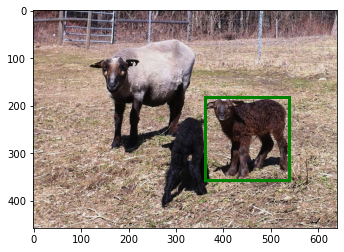

In [6]:
print ('ref_id [%s] (ann_id [%s])' % (ref_id, refer.refToAnn[ref_id]['id']))
# show the segmentation of the referred object
plt.figure()
refer.showRef(ref, seg_box='box')
plt.show()

The following function extracts the sub-image (i.e., within a bounding box) from within the image. 

In [7]:
def get_bounded_subimage(img_id, ann_id, xs=224,ys=224, show=False):
    bbox = refer.Anns[ann_id]['bbox']
    bbox = [int(b) for b in bbox]
    img = refer.Imgs[img_id]
    I = io.imread(os.path.join(refer.IMAGE_DIR, img['file_name']))
    sub = I[bbox[1]:bbox[1]+bbox[3],bbox[0]:bbox[0]+bbox[2]]
    if show:
        plt.figure()
        ax = plt.gca()
        ax.imshow(sub)
        plt.show()
    if len(sub) == 0: return None
    pim = PImage.fromarray(sub)
    pim2 = pim.resize((xs,ys), PImage.ANTIALIAS)
    img = np.array(pim2)
    if len(img.shape) < 3: return None
    img = img.reshape((1, img.shape[0], img.shape[1], img.shape[2]))
    return img

### Example sub-image / object

- the following applies the sheep example to the above function
- notice that it extracts the sub-image so you can pass it through a convnet
- it returns a numpy representation of the image

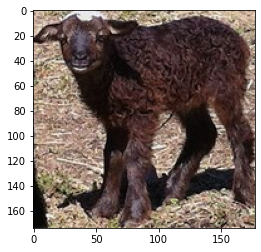

array([[[[201, 175, 155],
         [214, 191, 170],
         [209, 188, 168],
         ...,
         [219, 192, 174],
         [197, 170, 150],
         [184, 157, 135]],

        [[197, 172, 151],
         [214, 192, 171],
         [220, 199, 179],
         ...,
         [202, 175, 156],
         [185, 158, 139],
         [182, 155, 136]],

        [[170, 145, 128],
         [165, 141, 125],
         [193, 169, 154],
         ...,
         [193, 165, 146],
         [206, 179, 159],
         [224, 198, 178]],

        ...,

        [[  4,   4,   5],
         [  7,   7,   8],
         [  8,   8,   7],
         ...,
         [115, 104,  98],
         [117, 104,  90],
         [145, 132, 117]],

        [[  6,   7,   6],
         [  8,   9,   8],
         [  9,   9,   8],
         ...,
         [228, 209, 195],
         [189, 172, 159],
         [144, 129, 116]],

        [[  9,   9,   9],
         [  9,   9,   9],
         [ 11,  11,  10],
         ...,
         [193, 172, 160],
        

In [8]:
get_bounded_subimage(ref['image_id'], ref['ann_id'], show=True)

The following function `compute_posfeats` is a useful function that extracts a handful of extra features, for example, the area that the subimage takes, the x,y coordinates, among other things. Using this function isn't required, but using it will yield better results. 

In [9]:
def compute_posfeats(img_id, ann_id,):
    img = refer.Imgs[img_id]
    bb = refer.Anns[ann_id]['bbox']
    fname = os.path.join(refer.IMAGE_DIR, img['file_name'])
    if not os.path.isfile(fname): return None
    img = io.imread(fname)
    
    if len(img.shape) < 3: return None
    ih, iw, _ = img.shape
    x,y,w,h = bb
    # x1, relative
    x1r = x / iw
    # y1, relative
    y1r = y / ih
    # x2, relative
    x2r = (x+w) / iw
    # y2, relative
    y2r = (y+h) / ih
    # area
    area = (w*h) / (iw*ih)
    # ratio image sides (= orientation)
    ratio = iw / ih
    # distance from center (normalised)
    cx = iw / 2
    cy = ih / 2
    bcx = x + w / 2
    bcy = y + h / 2
    distance = np.sqrt((bcx-cx)**2 + (bcy-cy)**2) / np.sqrt(cx**2+cy**2)
    # done!
    return np.array([x1r,y1r,x2r,y2r,area,ratio,distance]).reshape(1,7)


In [10]:
# example using the sheep example on the compute_posfeats function
compute_posfeats(ref['image_id'], ref['ann_id']).flatten()

array([0.56284375, 0.39737991, 0.83945313, 0.77941048, 0.10567324,
       1.39737991, 0.34295148])

# Train

In [15]:
# base_model = VGG16(weights='imagenet',include_top=True)
# xs,ys=224,224
# layer = 'predictions'
# model_p = Model(inputs=base_model.input, outputs=base_model.get_layer(layer).output)

In [59]:
# from tensorflow.keras.applications.vgg16 import VGG16
# from tensorflow.keras.applications.vgg19 import preprocess_input
# from tensorflow.keras.applications.vgg19 import decode_predictions
from tensorflow.keras.applications import MobileNet

In [60]:
base_model = MobileNet()

In [61]:
for layer in base_model.layers:
    print(layer.name)

input_2
conv1_pad
conv1
conv1_bn
conv1_relu
conv_dw_1
conv_dw_1_bn
conv_dw_1_relu
conv_pw_1
conv_pw_1_bn
conv_pw_1_relu
conv_pad_2
conv_dw_2
conv_dw_2_bn
conv_dw_2_relu
conv_pw_2
conv_pw_2_bn
conv_pw_2_relu
conv_dw_3
conv_dw_3_bn
conv_dw_3_relu
conv_pw_3
conv_pw_3_bn
conv_pw_3_relu
conv_pad_4
conv_dw_4
conv_dw_4_bn
conv_dw_4_relu
conv_pw_4
conv_pw_4_bn
conv_pw_4_relu
conv_dw_5
conv_dw_5_bn
conv_dw_5_relu
conv_pw_5
conv_pw_5_bn
conv_pw_5_relu
conv_pad_6
conv_dw_6
conv_dw_6_bn
conv_dw_6_relu
conv_pw_6
conv_pw_6_bn
conv_pw_6_relu
conv_dw_7
conv_dw_7_bn
conv_dw_7_relu
conv_pw_7
conv_pw_7_bn
conv_pw_7_relu
conv_dw_8
conv_dw_8_bn
conv_dw_8_relu
conv_pw_8
conv_pw_8_bn
conv_pw_8_relu
conv_dw_9
conv_dw_9_bn
conv_dw_9_relu
conv_pw_9
conv_pw_9_bn
conv_pw_9_relu
conv_dw_10
conv_dw_10_bn
conv_dw_10_relu
conv_pw_10
conv_pw_10_bn
conv_pw_10_relu
conv_dw_11
conv_dw_11_bn
conv_dw_11_relu
conv_pw_11
conv_pw_11_bn
conv_pw_11_relu
conv_pad_12
conv_dw_12
conv_dw_12_bn
conv_dw_12_relu
conv_pw_12
conv_pw_12_

In [62]:
xs,ys=224,224
layer = 'predictions'
model_p = Model(inputs=base_model.input, outputs=base_model.get_layer(layer).output)

In [63]:
def get_img_features(model, img):
    img = preprocess_input(img)
    yhat = model.predict(img)
    return yhat

In [64]:
words_as_classifiers = dd(list) # use something like this dictionary to store positive examples
train_ids = refer.getRefIds(split='train')

In [66]:
# for a single train_id, you can get its image_id and the ann_id (i.e., the referring expression)
for ref_id in tqdm(train_ids):
    #ref_id = train_ids[0]
    ref = refer.Refs[ref_id]
    img_id = ref['image_id']
    ann_id = ref['ann_id']

    #then you'll need to get the bounded subimage by calling the get_bounded_subimage function.
    sub_image = get_bounded_subimage(img_id, ann_id)
    
    if sub_image is None:
        continue
 
    #then, you'll need to pass that image through a convnet like you did for A6
    sub_image = get_img_features(model_p, sub_image)
    #print(sub_image.shape)
    #optionally, you can call the compute_posfeats function to get some additional features
    #concatenate these to the convnet output to form a single vector for this image
    pos_features = compute_posfeats(img_id, ann_id)

    feature_vector = np.concatenate((sub_image, pos_features), axis = 1)
    #print(feature_vector.shape)
    #add this feature vector to a list of positive examples for each word in the referring expression
    # you may need to flatten() the feature vector
    for sent in ref['sentences']:
        for word in sent['tokens']:
            words_as_classifiers[word].append(feature_vector.flatten())

    
    # once you have all of the positive examples for all of the words, you'll need to find negative examples for each word
    # the number of negative examples should be a function of how many positive examples there are

    # finally, train a binary classifier for each word

C:\Users\Sajon_PC\anaconda3\envs\my-conda-env\lib\site-packages\ipykernel_launcher.py:2: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  


  0%|          | 0/42404 [00:00<?, ?it/s]

In [67]:
import pickle


# with open('pos.pickle', 'wb') as handle:
#     pickle.dump(words_as_classifiers, handle, protocol=pickle.HIGHEST_PROTOCOL)


In [24]:
import pickle
file_to_read = open("pos.pickle", "rb")
words_as_classifiers = pickle.load(file_to_read)

In [68]:
def get_negative_samples(wac, word, num_negatives = 3):
    negs = []
    words = list(wac.keys())
    num_pos = len(wac[word])
    words.remove(word)
    while len(negs) < num_negatives * num_pos:
        neg_word = random.choice(words )
        print(neg_word)
        neg_word_vector = random.choice(wac[neg_word])
        #print(neg_word_vector.shape)
        negs.append(neg_word_vector)
        
    return [x.flatten()for x in negs]
#     return negs

In [69]:
# neg_samples = get_negative_samples(words_as_classifiers, 'red')
negative_vectors = dd(list)
for cur_word in tqdm(words_as_classifiers.keys()):
    negative_vectors[cur_word].append(get_negative_samples(words_as_classifiers, cur_word))

C:\Users\Sajon_PC\anaconda3\envs\my-conda-env\lib\site-packages\ipykernel_launcher.py:3: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  This is separate from the ipykernel package so we can avoid doing imports until


  0%|          | 0/9350 [00:00<?, ?it/s]

othr
donkey
19
rileft
woamn
guest
pjnk
closestt
butterflies
peasant
gireiff
deckeer
has
spic
pruple
botrotm
chineese
mannequin
broccolii
underarmour
stoplight
shrub
jackeet
am
orse
drss
furry
labels
assassin
socks
relaxing
pulled
vehiclewoman
dsheep
hoody
tagger
patty
granny
desembodied
peas
cheking
headboard
grirf
wiry
rowboat
neckline
puzza
beets
im
ducking
scam
tipsy
aem
mike
index
truck
tomatos
diagonal
photo
molester
wtf
rirght
tye
northface
write
ump
leftmost
streak
peels
bordered
v
ritings
waitthe
purplish
figure
chewing
nivea
distance
madison
cop
armwrist
sighn
cockpit
drink
devicepainting
xxx
shortie
bottomrow
basin
tarp
keeping
broccioli
brussels
dragon
xs
stabbing
condiment
isa
increase
purp
frontmost
comic
hardly
wing
scene
jocket
baldie
pig
buttermilk
textured
garaff
bocokki
vine
raft
redorange
lright
pciture
plays
grape
sloppy
giant
bovine
botte
pulling
sip
family
sax
crossways
hit
pottery
clopse
hydor
fishstick
underneath
shown
taller
cofee
scar
york
ai
chld
biggiest
ole

bowling
partialbike
wich
righr
same
boyy
paisely
broken
rightorange
garnish
herb
ztoplight
rolled
whitest
vice
surrounding
bottommiddle
safety
sauve
buses
likes
grrom
donit
suitcase
iwth
faar
bamboo
atop
checked
basil
picking
umbrealla
bitch
trafficlight
mortar
tubecontainer
acket
awwwwwww
wg
space
one2nd
propellier
xmas
photographer
loner
system
wan
shirrt
bib
bumpy
rightbottom
platinum
bedsmats
float
breath
victory
virginia
nipple
sink
catcger
bomberos
motocross
noticeable
cupcakes
turns
substance
toilet
hah
loopy
susan
bleached
bbird
kneeing
elelephant
endside
ndswith
cap
worked
gatos
stufftop
steakchicken
pancake
girlaway
plateskillet
motocross
faceing
platter
lightblue
dimples
stsanding
kicker
tofu
property
wo
salmon
cather
whiteb
stools
reflected
mailbox
girffe
vace
ricght
grene
jecket
midfle
into
nan
toyota
mguy
continental
canter
redgrey
usher
bycycle
ugg
blurrly
motorccle
curtain
longbed
2md
ladys
clcok
sucking
lifestyle
statu
shoulders
ella
bahman
rhite
geko
691
pleasure
labe

eyeglasses
leftcenter
sure
bluw
tddy
drug
doge
shooting
arent
fatass
sandles
choclate
handle
dip
was
jam
fin
infornt
sagittarius
manikin
1772
hitterbatter
re
washing
clocky
tennesse
collor
braided
clicking
funky
camera
tabletop
requiem
cherries
peas
fatigues
100
blowing
wedge
hing
umbrellacanopy
littlest
grayish
stirped
uniform
towing
cane
pony
uswho
walking
wee
southmost
pointing
pooper
93
zegra
tote
shirtr
vases
stalk
loilet
0
presentation
touchong
amainl
babypoop
hover
408
carhead
lmfao
torward
aluminum
monkey
linux
damn
262
cigareete
flipper
hummer
squakk
dad
rightmsot
symbol
message
shuttle
mythology
fry
shirht
clocl
redleft
backgroud
tire
sailer
rafe
atm
donute
champ
china
handarm
leaning
brwn
oldman
ref
nyc
teaching
controlling
middlehead
leftfirst
buddhist
line
screens
twin
laughign
lowerleftmost
beam
carton
maggots
jew
pedestal
chassis
sammich
comforter
nee
tier
ewe
fucka
pattie
toaster
horozontal
hijabi
drress
racketjacket
birf
highchair
officer
giraffeagain
rights
oge
thinki

sheets
snowboard
armhand
doxie
lighted
pedophilia
whatshisname
herb
hes
laotop
manarm
formost
tvscreen
left3rd
shown
darkhaired
mouschate
farleft
vie
1182
leftwith
trashy
dude
crouching
owoman
lawyer
farther
slighty
labcoat
kewuit
carrots
racquetball
wom
mamma
agreed
wrinkled
cheez
doubledecker
ambiguously
infornt
hod
center
strawberrytopped
listerine
greengrey
lined
play
bus
bik
tiedyed
stander
ramen
bo
burgundy
talk
monieter
screenmonitor
wglasses
oneon
beanch
birf
fodo
kcd
backish
information
bullseye
specific
sausages
shearerwith
wpurse
bak
bigpeople
pita
rafe
whole
breast
muffin
redgreen
player
lanyard
extra
surprised
k377
conatainer
peenut
information
mt
lifted
sallad
pastery
heusen
garnish
help
frontright
miniature
crumb
sig
ainimal
interlaces
yeellow
teddybear
touches
life
fork
mary
beak
151
letf
spiky
slighty
laptopfront
logo
ddue
ambulance
brides
dough
healthiest
sassy
quilt
oriental
flames
new
almond
ummthe
toyota
lite
boar
centermost
inbewteen
coud
texter
plaintain
shity
ch

glitched
har
ladylol
fuck
legs
parade
cupcake
wok
trunck
smalles
clip
burnt
rows
striaght
injured
fern
checkereds
7844
beets
91
clueclick
nice
inbetween
businessmen
racer
greenthe
tonuge
sbottom
granny
anything
botrotm
olesum
olesum
easle
sholder
redleft
creamnot
drizzles
sandals
love
gas
dow
righy
pj
funny
please
arms
hahah
sprinkles
bites
miguel
peewee
pictur
pivcture
banan
nivea
foodtruck
edgenot
indent
romote
bounding
nleft
peeled
draculla
940
helper
bkacground
offwhite
stand
pineapples
jade
passing
pushup
drk
jean
entity
stern
bleachers
behindbetween
loilet
sidetop
diferent
different
mic
bar
pikachu
leftist
rightclosest
miniature
bowlspoon
girlnot
90
durrant
same
gathering
umbarella
titanic
squigglies
ront
breadoven
empy
maxs
tonuge
inline
refrigerator
flamingo
chocolage
tallish
tanker
rightgirl
waling
babyyyyyyyy
ba
horese
total
carrotws
holds
couches
gry
bluestriped
rests
of
stoplight
closset
waling
rifle
drk
golfer
pat
bi
rightmsot
dip
purpleviolet
seocnd
breadstick
15th
middle

sysmol
farthermost
inset
elegant
applesauce
limo
sprinles
preparing
bananas
racer
350
woth
filming
rounded
overs
spreckles
tolet
included
ima
ugo
casing
tennesse
smiley
eek
end
item
cab
colorful
jersey
sushi
blllloooooo
394
goalie
reeaching
litle
wings
rigt
actual
fila
tommom
jaccket
malnourished
imac
passaneger
peppers
halfcar
boko
tourist
foregrounds
pinkish
orangefrom
tart
else
bible
spices
grayed
mario
lold
sammie
girlaway
jockry
mound
vfs
japan
squre
trouser
othr
nails
holdin
outfit
gold
bb
chairback
thing
tape
bmw
stainless
contents
fatass
rider
suger
spree
bluestripe
register
asking
lard
females
maine
squatting
send
hoods
slide
flamengo
allany
coming
pants
laughing
calendar
local
tnak
winning
zrbra
dort
topbottom
standin
keeps
papers
backgrounds
slimey
skwhite
sittingsmiling
cop
2b5775
shaver
ed
bx59chf
loong
extreme
sax
maroonburgundy
ef03tww
eclair
hope
frispe
pushup
com
backpackbut
gy
puking
flowing
headlights
lock
smith
chested
holder
jockey
clair
tes
grn
dat
horsted
sideway

constable
rectangular
said
headboard
benches
cashews
upholstery
hooves
colum
arrangement
yellpw
montior
woth
knees
celery
backarm
wifebeater
eeyore
hitting
desktop
559
frown
being
tn
tatted
albums
paint0
blocks
mooses
miss
rainbow
holdig
beer
landed
bck
moniotr
goofy
sheepy
quseadilla
lounging
wz
topleftmost
highlighted
backstreet
ribbon
carebear
enough
broccoli
skinned
33
mad
leggings
wineglass
scary
conatainer
choc
mj
hunter
900
jets
ledge
bloody
shirth
cutt
masn
ovular
lambie
stirring
blade
steps
afro
beed
girl
handing
leftbaby
pleyer
yelling
coatcloud
things
bustruck
nana
couple
wplate
greenwhite
arks
road
markings
parkimeter
silhouette
skright
mobile
catering
pond
underside
shirht
icemaker
btoom
stipes
sid
folded
inblue
dwn
speedy
bananaa
t
sleeping
chocolage
folding
yacht
opened
ballplayer
bot
orangeblack
hafl
cutting
sea
o
lego
food
station
mpicture
anover
bluewhite
looking
9748
pimp
persdon
tabe
motorola
orangeolantern
wsunglasses
graffie
homeplate
grond
scruffy
garnish
wears
l

baguette
elephantas
disgusting
need
lr
atop
leaping
thumb
cown
licence
bell
eboy
unmanned
mike
skiiing
onth
brococli
bryan
thick
cowhead
thrusting
ladie
fell
hawk
bnanana
heaven
hoto
beater
whis
diggity
trinket
rightbehind
themiddle
blazer
preparing
skyfall
veyr
pear
tall
blindfold
wondow
bikenot
dead
current
karate
behav
armsmturk
headnot
leather
bluegray
crest
snowbard
plum
zeebra
am
bu
105
topmoat
chunky
lost
wodden
fake
furtherest
shearers
tarm
anywhee
sugared
gurl
glazed
fucked
four
magazine
smetimes
chocolaye
pat
tupperware
pantsblack
whiteshirt
bowing
vested
material
clothe
boarder
didnt
loader
puking
winnipeg
welchs
body
decoration
shadowed
atomi
kidf
laft
shirtr
stinking
australian
whip
lacing
skate
backgrounds
hmmm
propane
squigglies
beaver
brocci
panic
chainsaw
split
nips
elephannt
mark
we
rightgirl
freddys
beds
different
sandwhiches
brim
kettle
rectangular
toothbruch
snag
opened
elephentn
cutie
dolphins
homo
chips
heading
transexual
apple
cloest
sittuing
bushy
sanding
cover

massive
ot
entering
sanwhich
breaded
gear
inlap
rihg
stripeshirt
deviled
areato
arrow
along
public
personhalf
taste
allwhite
bog
lil
cola
ump
medals
lighting
barcode
nasty
utensil
birf
shin
snowboard
satupon
outfit
wyellow
choba
crawling
kitt
pics
juicy
femlae
bin
swaggy
tablet
groud
bottbananas
airports
toothbrushes
squigglies
clicking
skateboarder
snoopy
blanket
pantds
leftlooking
backgroundd
centerback
snowboard
containter
draped
bliue
doughnut
bt
bottbananas
checking
dudes
shoes
does
romote
topright
stsanding
slicd
nearly
strawberries
grayed
umbrlla
fiving
ar
camo
49
budge
rusty
watter
rti
mario
squares
stooped
grid
plymouth
sushi
dali
sin
ears
hatat
minus
laying
babys
zeebra
scoop
firagge
blck
pew
shelter
stockings
rackets
cherry
mask
pice
stuff
griffiti
womanly
limes
cooler
cutt
talble
wmask
dads
dreads
clock
his
dort
pf
firehydrant
swimming
tattoochest
specifically
plae
monutor
ytellow
washing
guage
puking
shape
fronttall
outer
shirtlesst
ofpic
stockings
girk
pear
lil
decorated


litle
cheese
trains
dhands
receding
wom
some
bookbag
jogging
midright
cair
backright
righthot
livingroom
classes
counterisland
persn
pizzzzzzzzza
corners
poweder
creepy
ferry
boarfd
grabbed
thinker
hawaiian
mt
unripe
guyits
molester
rownp
moist
message
gummy
he
jkt
metor
catcgher
slimy
bulls
drawn
baack
frblack
topless
selphie
riden
baguette
gus
at
monitors
look
towagon
broccolileft
class
bleechers
tr
drainer
winnie
wtih
denter
stooge
alap
bathing
umbers
capris
wifebeater
striangilar
dodgers
unside
1s
natura
politician
slumped
vines
stethescope
texter
grrom
streaks
cronut
lightbulb
sandwih
peeking
definitely
wineglass
shaggy
higging
johns
comptuer
cutting
tableall
vege
sgirt
coolar
kiw
rows
thhat
selphie
parked
coloring
nurse
darkhaired
locker
bridge
backgrounds
white
ricey
log
architect
streamers
plad
christ
macbook
glazing
bluepurple
adn
bright
visable
sinlk
crossarmed
purpleviolet
loll
loveseat
sugared
skull
neckline
eclair
ndswith
upmire
footballs
purse
elephantz
2ndglass
flowerett

attendant
boatd
ghost
ketchiup
handle
manager
za
ivory
blackskirt
32
cocktail
bottomrow
pice
surfbord
aligned
view
crane
whoops
customer
celtics
burn
midddle
booty
drinkltop
life
wrench
kart
roundish
pew
dg
peels
job
crumbs
atus
mints
students
were
playert
rightmostly
ibike
logo
backed
carots
brocoli
wbend
fashioned
kidthe
ttrying
laughign
metor
wiht
shapes
ze
upside
cabin
bo9y
zombie
buzz
inback
blackish
coolar
kettle
wbag
hungry
almost
dog
wonder
greenpirple
bluegrey
dresses
hadns
bnanana
nanners
brushing
whoite
btter
houseboat
clasped
thoughtbig
blueshirted
boyleft
za
submerged
frontblue
sta
crossways
obscured
chairbottom
sdress
sandals
motorcycle
stinks
rifle
hog
mothers
yamaha
peasant
begining
leftleft
womanly
yeleow
graffe
chocolatelooking
likely
boths
spiderweb
brief
carrotsmy
staright
exiting
bedsheets
luscious
yellowbright
frotn
terrible
shirth
was
shareing
nursing
miller
laptop
bagel
wvest
amy
babes
ytellow
bowlcenter
tophat
ricotta
bowlspoon
legen
pinkteddy
brace
cae
flowerp

upfront
computer
chairbottom
pn
oranish
photothanks
wmask
meeee
otline
lamps
engin
trpophy
straighten
love
toothbruch
ourtreachedd
call
elboe
yo
freddys
teacher
stories
hawaian
bonde
tree
peewee
graffiti
cheesy
skakter
papers
empy
ceter
skeptic
shorter
babyclick
macbook
leftn
ellephant
womanlooks
cener
furmiture
mandarins
sure
mans
foral
matilda
captain
immiately
ornange
boatcut
blackwhite
righit
othr
wagon
leftvery
sticker
oshaped
urinal
riht
veg
eyeball
coral
spat
mitts
suck
garraf
csout
nyp
boko
fritter
outstreached
hello
cutting
bluegray
caddle
hmmm
texter
strip
sittingsmiling
spreckles
coach
sorrysecond
brocalli
sufreboard
redish
jaccket
nw
blackwoman
ltraffic
courage
strange
skyfall
23
hovering
backgrounds
mguy
sequent
babypoop
sufreboard
classes
white
mints
hight
ten
tshort
romote
razr
pet
linesman
class
flatbread
ves
sobbing
goat
shadowy
greyblue
woodgrain
ai
mouschate
meatbread
sesame
amy
system
monks
cocktails
caar
wheelchair
straighten
haed
coffe
cucumbers
glare
spot
cam
bac

cinnamon
sdie
baaa
ebra
93
seat
2b5775
mmmm
closset
has
offended
cattles
rockingchair
oe
witout
edging
ts
purpleish
paddleboard
lemonade
semihottie
xmas
facehaha
bunk
jaccket
leftist
lyggage
mddle
guge
jeans
tennesse
blakc
shirtarm
level
bushel
hashbrowns
burgundy
refrig
kickiing
stinks
sister
toiiet
chest
vehicale
arm
topping
zrbra
btter
sleve
stove
speaker
blac
bustruck
choose
monte
murphy
orangeapple
hite
a1
bridge
girage
showen
bisecting
wagon
spaz
land
photo
an
japanese
wlid
jim
bow
stare
performer
richt
breaddonut
androgynous
whie
clutching
section
e
east
lighting
solid
yellowbluejacket
tperson
hitting
whatevers
glassware
shirth
whitred
there
in
shaver
usclosest
paper
gramma
1908
pepperoni
rafe
cip
butler
dip
secontion
vanin
laptopcloser
waist
should
yokohama
leftfront
bk
holes
judy
clump
greeen
throwing
rungs
biottom
pastrywithout
milk
stripe
ooutfit
girraf
skier
tartar
diagonal
borad
28
begining
blended
lift
antlers
comb
etc
blocks
whale
guy
uneaten
truco
softball
pear
freedom


firs
rightpink
broco
baaaa
closets
feft
awwww
personf
outline
neart
pissed
longboard
toasting
tent
multicolour
sprocket
brixton
waste
backgroud
leftelephant
motorccle
plaidish
pastry
welches
bluevase
hodling
looooooong
dornut
rocker
enough
shirtlesss
kit
atter
alot
tshirte
doberman
stripedpolka
controler
loaf
dougnut
boyy
horsey
bananer
bierce
frameleft
mat
cake
hyena
phonefront
elephang
based
72
navac
sexy
coats
ovular
truckvan
dont
weeping
rode
rit
drawn
rightmostly
goggles
ashtray
frigerator
ting
rigjt
pussy
toga
rigjt
artist
number3
thank
sce
lounger
sunny
coner
ironic
undone
ugy
sie
y
berry
ctacher
amy
platw
flames
unenameled
sweat
wrapping
atus
rearview
fluffy
giraffs
chese
grl
both
eyeshadow
bseman
anyway
bot
click
talble
shearing
tongue
baggle
hash
hafl
urmn
nin
catttt
242
team
maroonburgundy
element
bunches
shheeep
cuz
suppose
ephelant
ngel
labeledgreen
dad
changes
atvs
click
prson
410
hoto
pci
ye
boyman
keeping
spatula
turck
cakeon
fingertips
books
hores
frombottom
motorbike


mote
own
dels
nyp
striaght
backward
tired
uh
girls
trucksorry
garment
pizzaq
platesweet
directory
truck
brade
hnging
reffer
hirt
okay
holdind
platefirs
bottrom
pointed
ph
unmelted
creamcolored
ofpic
characters
kiss
stocks
pornostache
202
his
pizzaq
topmiddle
portion
print
1182
donit
cclothes
bayside
quilted
address
cakes
tool
orangetan
puking
sadwich
ketboard
keeping
trian
delk
fedex
stinking
littl
laptops
tag
wmoen
hat
goldbrown
interpretive
thew
bencch
tsp
foodtruck
cone
fabric
nail
redchecked
high
motorccle
draft
swoman
goldbrown
el
whit
lemonaide
grumping
increase
pich
pinstripes
giant
aged
shelter
corener
crock
coverd
closed
falafel
ellow
ackpack
baseball
hairy
werid
hat
prefer
elephabt
plant
hernandez
rabbitt
whole
flip
rightlong
bottle
blueshirt
plaidish
towards
plant
goof
bur
midget
handheld
glue
hijab
contents
clockface
fondue
waving
ugg
ornge
thumbleft
pumkin
girafffe
utensil
casing
collum
roman
inscribed
royals
slicee
touchign
tex
tissue
tower
stretched
504
anim
keeps
lighte

jocky
maine
oops
sunday
stools
olives
partialbike
standingle
planes
laft
specks
rep
seagull
thegreenboard
trike
british
burner
address
vehilcle
simply
bust
pizz
wball
guge
hari
nothingness
ephelant
allblack
sushi
hauling
blackwoman
trees
bieber
topbehind
tpples
mit
boring
ballcap
bite
chopper
icream
opa
pointy
lerft
righthot
350
harm
chappie
everyone
stretched
british
index
start
tanwh
well
pleftink
legged
get
stiff
greenred
kick
lshoulder
lefthead
80
cowhead
miss
38
cupcape
lambanyway
goop
german
toma
breakfast
ollie
themiddle
wred
cowhead
animalsheep
tcomputer
ranch
redish
petted
secontion
74
cuttoff
grad
style
behin
lesbian
blurb
hamlet
stripe
round
ritht
spastic
baf
giraffenext
brim
cool
multicolored
morocycle
leftus
def
ber
firagge
image
wwoman
girt
threes
10
brocillio
grapefrut
pooh
moms
pollows
bananan
blcak
botttom
cowe
correctly
dalmation
si
cucumbers
groung
napkin
sittin
drinker
thats
rocks
bowlfront
grinning
bouncing
chair
te
whis
hairdryer
dort
dominant
cabby
rhino
coat
nak

runnner
moustache
married
donat
john
segment
tallish
scratching
baldie
pastrywithout
funny
hate
wtf
babys
datcenter
csout
giraffenext
elvis
reffer
beneath
habicht
lright
garaffe
refection
police
leftmiddle
hore
sceond
spiffily
men
whittish
metter
ball
bebeh
backish
lowest
cubed
fryit
halfvisible
ugg
helmit
spaghett
pizzaa
phonesilver
showingclosest
beardoll
gow
barcode
france
girkl
letter
shopping
slow
eft
ellen
wrecker
leggs
cowhide
couch
partial
big
uit
burgundy
pipes
loner
gright
cover
curlyhaired
young
horn
midde
sideits
abstract
kidt
rob
wih
air
stuck
pushing
haldfoutta
chili
briefcase
f
snake
camaera
teaspoon
emblem
redwhiteblue
gallon
confused
meatballs
ricey
ra
quilted
toliet
deserrts
leftmose
zzebra
cane
khakis
upset
hed
todo
tr
wrench
atter
bottlew
mr
frontarm
girraf
againstwall
rudder
biggiest
shades
while
doctors
blueprint
crib
jogging
partway
monroe
wheeling
fringe
donw
indian
carrotmiddle
redorange
directly
00
kentucky
ake
elephabt
hurry
clown
appears
flag
pinwheel
fa
whi

hell
scayborad
unoccuppied
dreads
rightclosest
forwards
wessels
wo
ghost
vlk
honeynice
clue
puple
dali
peroni
wz
vogue
crescent
elephnat
tipped
wheat
alot
charging
drinks
trian
domut
toasting
lbus
heading
dvd
ummm
wide
printing
hill
painting
fossile
crunut
duck
oat
public
charging
melt
coverred
giraffie
rightbye
cany
schoolbus
stringy
noodle
guty
bunny
dishwasher
worm
stallion
193
lcd
ladylol
frontboth
five
riight
foodstuff
ibike
puma
prpulish
y
standingon
woth
redblue
luxury
334
matching
ne
airports
redfront
sinking
thoughtbig
agianst
waoman
wrecker
grown
lefto
babys
shorts
teddys
sled
gray
semihottie
grape
dishwasher
vasebottle
coleslaw
correctly
bikkini
turkey
girt
messy
leftcoach
mitts
driver
sheets
let
ceat
xmas
ubuntu
wou
femlae
sidewalk
pops
dort
dogc
remaining
scar
makeshift
rowleft
razr
plain
whand
topmiddle
persn
camo
shot
grirf
disgusting
scared
opposite
visor
graduate
clothing
zerbra
girt
directional
tho
mash
vestsweater
king5com
pined
interpretive
compartment
customer
borw

reflections
oclor
babys
chainsaw
leftred
lett
walker
sidewalk
wok
roght
cner
restaurant
chests
cringing
shirted
fluff
checkers
swing
forefront
80
bandana
slide
greem
seep
kitty
motoccycle
rakcet
colum
inn
bootays
chairs
creeping
ging
ashtray
inscription
crust
news
reddesih
send
jumper
specks
sokcs
a1
ironic
trian
george
z
frontsays
mos
scarf
blackcar
ocean
yearly
everybody
poka
taller
diced
cloth
sauron
yelloe
footrest
foregroound
cfirst
fielder
items
250
111
herbal
proud
insert
francoeur
gravy
dirty
happened
oone
laced
sail
urninal
simase
lighted
computers
yellowshirt
both
spaghetti
bein
gobble
lleft
glue
stove
jail
pantsblack
glasse
shirtby
faceblue
rabbid
opn
motorcucle
label
walway
pony
bsecond
vignette
metal
lawn
chugging
grond
grayblue
diamonds
blasses
yo
walding
ugo
sandwich
brownpants
art
yeild
cresant
shirtp
whitle
laniard
pounced
ord
indian
sakeboarding
thru
radical
glassall
whtie
bl
nope
ball
toasting
chuck
billion
tongs
pomegranate
girthead
metalic
mrs
med
boyz
poster
writt

hog
hog
grampa
holdind
bonde
hiar
textured
0
wvest
potleft
ambiguously
pineaplle
gettin
backgound
miller
gangsta
ves
bein
hold
snowboardernot
559
giraffie
mouschate
island
fucked
slides
tired
monk
passaneger
feathers
clock
pushong
forum
speck
yelloworangeish
atlantic
lemondade
haor
sloppy
burrito
spinach
ordering
meeter
sissor
mena
m5
barqsd
unifrom
adult
whhite
gu
democracynowcom
giraf
carots
300
countin
fourth
stoplight
thw
reflection
sprigs
girt
lord
flower
facing
comics
girag
haird
inspecting
badthought
whead
quilttop
logistics
k453
be
orangetan
pineapples
ways
crubly
foremost
catcger
bathing
wwhite
wihtout
hoodie
womaon
pplant
rihtmost
surrounding
bottomost
tv
spiot
noo
dry
blood
mac
book
kahki
face
chainsaw
kidthe
carrotts
bluewhite
limit
highlights
speedo
footballs
indent
baout
middler
exactly
fashion
surprise
242
belowbetween
submerged
brocoli
fouth
dk
tough
coputer
yo
blackso
a
mazda
mazda
waller
topright
umbrellaellaellaehhhh
squakk
browncake
shirtand
hour
goof
spot
laoptop
c

brocillio
hairmustache
eatin
rightclosest
motorcycles
labels
pinkbluewhite
aem
straight
gun
27
irresponsible
erect
bay
fatass
bannanas
shirted
texting
pioneer
wish
giragge
lift
forground
doorway
moma
bonde
stufftop
having
horizontally
torte
brought
bowlleft
due
mazda
descent
graffe
space
clocky
latke
ducks
umprie
bars
sits
sunglases
bycicle
ide
cokeacola
keyborde
diagram
sheep
urn
foliage
giurl
tex
orangeapple
cope
int
close
blcak
glitchy
monutor
sititng
our
blanket
jump
shaving
container
potatoes
carront
baseman
cupcakes
cokeacola
negative
petted
lattice
jutting
turking
balloons
reins
dount
disk
37
fishstick
brass
969
suticase
guyy
pcoekt
miidle
word
carrotts
puting
we
are
fingerz
tie4th
twain
umrella
eft
motorcyvle
loltwitter
wreck
ever
making
ous
lolbored
disc
above
peice
bakcground
orangr
clapping
toil
blsack
clunker
dels
himself
goof
uneaten
five
silver
chugging
mothers
btoom
whige
corder
htdg
coverd
anyone
guuyy
hamster
bendin
fishnets
continental
pitcher
sight
suftboard
llol
sec

carrie
bravo
anti
hatt
seperated
closes
crinkly
handbook
appleyes
whitetouching
sweatermiddle
fries
91
ugy
line
receding
tank
smelling
purse
trashcan
crane
hot
tnak
cahir
pez
vino
cammyz
mitt
bs
easel
bluegray
italian
hod
cactus
motorb
tie
boston
cooking
kimono
pair
goof
carrier
daughter
volkswagon
skunk
shirted
seatbelt
buckteeth
handles
barqsd
durrant
whose
illegally
raisins
mate
ifar
tangerine
whitepink
town
cushin
klm
staning
blackberries
door
trck
handits
bown
yak
linesman
comp
disc
strawberries
ceat
link
frigde
goatee
pilot
cercle
fielder
thirdfrom
located
frigerator
girkl
rep
limes
saddle
grief
centerblack
objest
surgboard
skis
standign
wheeler
umpi
pear
bookshelf
cholula
leftits
zoo
shep
radio
bandana
emtpy
shirrt
vehilcle
went
plyer
ubuntu
tal
chip
bananablueberries
freddys
er
3h86
mat
uper
slightly
next
wred
filled
forum
bottrom
gunther
lockers
how
ar
cruller
elefat
flashing
jr
polkadots
msandwich
thriangle
btm
spectators
shitr
chin
browembrella
stick
piizza
329
golfer
lower


kayak
tail
stone
faded
end
umrella
ful
ovular
manf
backjeans
clip
humjan
umprie
rowleft
boss
lettle
ligh
inlap
sauces
drizzled
theright
caeing
bloom
shriveled
cooking
here
frm
word
afro
clocktower
zepra
stall
prop
honeynice
compared
caption
mazola
sammie
shotgun
bowed
licens
leftwindow
plais
ahh
fontbook
disc
rght
mason
matches
exiting
stripped
jumpig
feline
compyrer
sorryboy
smoke
flipped
flaky
weenie
mountie
dweeb
half
elephantas
gym
hamster
throws
pigeon
be
perch
closed
quilt
yamaha
oap
write
your
zrbra
ubrella
frisee
patch
wasnt
gra
illegally
catch
eats
pen
isnt
neglecting
garment
hardly
nyp
win
simase
terminalbuilding
bikr
family
davis
brink
truco
new
chair
tyler
view
woody
loong
backjeans
tshirte
yelow
sp
faciing
stain
tured
lightbulb
btter
8th
hoarse
sriped
zebr
kidt
buggy
armpit
worange
unused
foot
chips
m34
assaulting
furtheest
pastryblurred
stamp
main
bowlspoon
oralnage
kentucky
pantsuit
wedges
approx
cuffs
momma
stem
lil
bass
mna
frontcenter
shirtjeans
sanwich
oops
kennel
pa

herbal
laptopon
font
roman
may
pantsgrey
workin
shorter
hoping
money
reflected
liza
allmiddle
imbrella
griraffe
43
conner
law
clostest
daark
topless
eke
stnadin
sweet
wan
thick
i
vested
boars
stovetop
cathcer
youd
monotor
twisted
darnwo
salt
chairthanks
underfurry
bowlrim
ashtray
junk
flames
oap
eater
plantsflowers
bg
chaerry
bookstand
space
umbre
shor
suitase
shirtlesst
seaboard
spinch
carront
tomy
gireff
feed
trucker
watchrolled
woven
leftestest
lamp
horses
leftmost
bigg
blender
die
nit
outoor
coat
gingerbread
quik
tie4th
girk
sweet
pearls
paneled
eat
sald
tiedyed
redgreen
comb
redshirt
93
vase
unc
lamps
surfboard
hnging
an
slugger
fashioned
dich
stripedpolka
canter
hen
logistics
brocci
areaplace
playing
lemons
didnt
among
rightcan
99
chopping
abercrombie
def
unused
appliance
house
bunny
grayblack
raped
no
awayon
nnoying
orangeapple
sparks
focu
duck
indiana
gobble
tier
pilgrim
passed
wan
shearerwith
x
groung
treat
strange
brocholi
pined
drawing
cylinder
sprouts
fancy
rileft
issues
st

mix
hoods
bedsheets
cou
sniffing
nike
saluter
crowds
glance
pot
candlestick
chained
leaning
218
shite
dawg
frisee
clothing
located
orangey
nametag
watchrolled
fro
text
buggie
visible
quirky
asleep
pen
deliver
patio
fabric
abstract
skewer
fortune
donkeys
orang
ranger
darkhorse
lap
boar
pizzza
fold
bowlonly
illegally
aviator
yb
screw
middler
bottombye
infalted
verry
employee
nutting
slicked
seconf
shirtr
okay
fielder
headcover
donut
headrest
banquet
sorryright
shirtarm
rig
fila
elbow
warping
brink
completely
deckeer
plane
racet
information
kernal
gunther
puter
tanwhite
bwteen
onthe
heap
many
stov
honda
benchchair
behin
quesilldas
cip
camers
sidewalk
toppless
tomoatoes
suticase
wagon
vent
pance
squatted
but
ratti
poiner
remotes
stroking
vogue
frong
grouping
gunk
umberalla
tiny
gloves
your
yperson
boel
phone
rasied
stnading
speckled
strip
cub
bowlspoon
vase
gon
btoom
haird
boyu
left1
midd
entire
compared
crubly
purpleish
tin
frsibee
tux
calm
whell
flowered
poking
tower
maggio
villian
scarg

opposite
vertically
lr
1tbsp
womanly
alien
zebta
skate
sneep
377
rearmost
nametag
oink
whead
bottlecounting
himself
wait
buisnessman
7oclock
aboce
soldier
hands
monutor
da
sttingin
bluevase
towels
pruple
sagittarius
pantds
mouse
lighter
metalic
bridge
girrafe
coe
nope
local
tralor
whand
wrapping
french
bar
buttocks
dream
drab
lemon
spinich
chatting
fingers
miror
slicee
frameleft
shaver
so
send
si
livingroom
plyer
against
floow
faciing
cair
chaiar
fret
ide
didnt
bikini
got
dragging
sittingonback
opa
surgeon
atm
playstation
brcolli
zerba
characters
whispering
pf
railing
jumpimg
flowerpot
cornor
roght
nut
surprised
tote
broccioli
otline
swiss
rusty
discovered
bananas
haircut
fit
coerner
cutter
tyedye
convention
scoop
cookbook
backtop
comforter
magazine
whitish
shitting
doberman
dial
leftactual
gearup
lion
records
northface
dudwe
boxcar
puffy
fodd
kittty
offood
branch
blackscreen
atcher
grapefruit
trunck
naked
coming
ridden
og
have
friendly
baskets
zebera
fatty
3
backgrounds
badckground
le

ref
chirt
svu
slive
clutching
cabinet
whir
worman
colum
kbeanie
elephantas
473
keeper
shaking
skinned
chest
triange
size
gariff
seater
jacketlady
saucer
gruel
skates
graysilver
yelloorange
architectu
character
staniding
laotop
blockhead
tes
girrafe
poink
dognot
toohbrush
winnie
doritos
sec
nlb
sidewaysish
shiert
jocky
manual
younger
chco
polka
prostrate
royal
today
bath
blllloooooo
event
squares
furry
mango
reflecttion
hatmoneky
glassesw
ottom
grond
pinto
know
cans
sandwixh
luxury
uh
cheesecake
starts
mag
trench
mashed
hn
cornflake
plaid
horsecow
misty
aht
tarp
frameleft
maids
fan
steak
nose
jim
95
dognut
mf
flowerpot
costume
b6
ricght
mah
raising
bierce
feeder
googles
wedgie
oleum
zebrain
smushed
whose
suitcade
caar
sunny
pearl
offmonitor
sneaker
mms
fomr
raped
hmmmright
bust
peporroni
cross
slope
sald
wine
cammyz
gase
bowtie
keeper
seems
slicee
missing
criss
other
hidden
sie
frametail
griaffe
ring
photographers
sections
syutcase
freig
jeans
soccor
skatborder
wfrisbee
crossing
mead
ho

northeast
grass
righting
patio
rised
sirt
15
bou
2
towed
playing
confused
angle
with
suicase
above
exactly
qfront
chesse
dad
suftboard
db
yehhow
magazine
hahahaman
doofus
usher
edible
greenblack
music
condiments
bluegray
snowboards
horsie
monieter
leaned
skinny
cheescake
dudwe
lfet
relection
omg
butcher
step
bred
lightest
tusks
spiral
yampotato
ctr
wbacon
requiem
bucket
side
za
cammyz
leftzebra
rutledge
ddish
bunt
nine
kernal
seating
poster
am
yield
end
like
devising
e
healthiest
killing
coat
mena
chests
grounf
hits
eaten
waterskiing
brockley
pup
sorrysecond
everything
rit
ababy
lonely
genie
empty
noodle
acid
guty
controll
picblack
ccenter
fajita
skieer
dipshit
1100
spottedcup
beardoll
bright
donw
tagged
headless
hatsomething
volunteer
mat
wait
coke
bride
brocccoli
pillaged
hn
shirtright
cropped
z
striples
winebottle
platew
dotted
grirf
chettah
real
contortionist
peperroni
baldie
referee
students
binding
trinket
geyser
plunging
hill
emt
squatted
row
111
seft
strawberrys
350
pupwindo
bl

eathing
phonenot
forefground
beard
tht
grteen
pastor
hermans
gey
garment
iin
puple
whitered
sorry
bluy
kiddy
dang
girr
photo2nd
gluton
jersey
written250
slat
trucksorry
38
pinky
explain
nan
mayo
moddle
trumpet
journal
tront
waller
around
too
dought
donat
half
holder
carrier
george
asian
firehydrant
remot
ct
rman
eats
30
today
cans
grab
passing
leftright
foral
squash
mango
dim
guard
arrangement
kness
sbirt
pickles
thrmiddle
suitcaseblack
wbag
our
ss
lchild
lass
down
display
suitcaseblack
grocer
backstreet
shirtcut
truvk
pjs
cactus
nigger
covering
hunks
hahaha
guyp
offmonitor
hoodies
ghost
foods
focal
gifafe
plum
focus
flailing
donbe
motorola
int
rightl
twain
stab
riding
ront
rightglass
lake
bluepeople
coch
23
bowing
rihg
by
platewhite
alephant
step
wieners
amount
beanie
336
obtuse
wmoen
womeon
trcuk
rockingchair
nd
broccollii
tractors
walding
wrap
tony
photo
roundish
robedress
burr
pizzaz
noo
liquor
pedestrian
clump
page
roof
shee
shake
ki
such
cranston
matching
oriental
streaks
conduct

freebie
wings
montana
ow
foldes
burr
botoom
toiiet
pearl
chests
liqour
bluepurple
leftbaby
arc
nose
folding
enter
cool
crack
workin
halfgirl
personf
rtght
gurl
screenmonitor
must
shoe
riught
shirtbrown
roller
rodent
leftkid
chief
class
sanwich
sanding
piggyback
vintage
spatula
diamonds
baggle
trees
snowpants
pink
kitchen
wa
stroplight
meters
gorilla
sometimes
barqsd
couches
puter
waitress
steam
bblack
appears
redwhit
hoizotal
batte
us
underwear
meeting
lookinf
without
hitting
redbluewhite
greenred
guy
bavck
slightly
slive
reflective
texas
orangest
kiddy
hortse
ears
onth
940
straightning
wrinkled
pinky
lobster
costumed
paws
moddle
snack
blemish
walking
sweat
hald
am
cookbook
wgrapes
icecream
whitish
clown
sclices
ingreen
homemade
measure
pump
closes
matress
queencake
dreedlocks
france
horsted
him
saddle
patterned
bunt
trench
plank
neon
peakingout
duckling
lemondade
loong
txting
umbrellaellaellaehhhh
phonesilver
jelly
weeds
inch
framework
whiteblack
perosn
bt
yankees
loong
demetruis
back

lookin
aluminum
babyface
erm
exsto
laces
right
lasagna
rag
pedofile
kernel
surfboard
midde
frontpants
zbra
coil
panel
cant
lold
naruto
tray
orage
multi
if
hogodogo
refelection
emtpy
bakcground
worn
brocccoli
staring
branches
cab
carrotws
cement
doggie
open
borwn
blacked
pockets
zebralike
k453
goughnut
allwhite
backj
frontboat
ya
leftbaby
memo
buick
rico
highest
cattles
cushion
ceter
hands
pet
tomy
beed
nutty
breadthing
diswasher
brute
elephentn
ringmaster
girlnot
tanker
distracted
drunkerd
benz
names
busty
tilted
504
cou
bedsheetflorabottom
propane
then
invisible
mean
mirrror
cent
autograph
giraffffe
stuf
spoon
mushrooms
curl
family
bunk
moth
ellow
shouting
redman
outta
aggressive
bblack
tableall
fo
superwoman
whitish
6382
skinned
tomoatoes
inbewteen
mesh
mouschate
upperright
doesnt
front
parcial
sittingonback
wiry
francoeur
blueprint
womnan
orb
nope
butthump
sip
fighting
standind
gate
pizzzza
rightest
points
middlehead
grantin
luxury
turquoise
cheese
inner
cornflake
sdie
slowpoke
blak

cowe
middlestandingright
rowsecond
blends
could
dugout
dudeds
squatted
uit
rightcow
tongs
slow
cown
foot
earlier
uniformed
informal
rtmost
brides
petter
cactus
garraf
guyits
middleolder
scisor
smack
bowlfront
umbers
unmbrella
slicee
sittingin
tracksuit
checkard
wordy
wee
hoking
7
walker
blackorange
mechanical
owoman
gloved
smile
um
tusks
coming
pixture
lade
blacksheep
gears
metter
bob
killed
boot
lookin
seconwlman
topbear
tree
christ
letterman
farther
put
backgroundd
matter
magazinedocument
yhe
greem
richard
zirraf
colorful
middleish
cupholders
chillin
uit
ketboard
boittom
khakis
hahahasmall
hangng
slit
bana
any
rose
bun
charging
girlk
stright
prettiest
y
rightmostperson
rf
stupid
guldens
headd
sndwhich
speckled
captain
sippin
grapes
sandals
ferry
wom
tp
miller
headed
pined
lead
woot
broccauliflower
wqall
clasped
sesame
tilted
bkacground
hida
octo
fishing
thingie
squating
bottbananas
sheeop
redskirt
gey
isnt
rightphone
blackso
quseadilla
halfgirl
tatted
preson
girlll
worker
leftguy
fen

designed
tpples
11
luggages
laid
spinach
pestle
murphy
278415
busty
checkard
steve
db
dnut
mtf4lyfe
tshurt
cabin
rear
coin
squatting
greyslate
inback
orangey
clohs
clothed
vechile
73
dismay
spherical
curlyhaired
mmmm
hhair
hchair
seatmetal
pier
party
9
obvious
really
grayed
doin
thats
meatball
slow
sitting
children
6th
024
trolley
vfs
bluury
bavck
cringing
rightsand
rightphone
ocntainer
lightbulb
onleft
grooms
bryan
little
wields
borcolli
liqour
nanner
pollows
girriff
hairdryer
stooped
mail
stationary
sleeveless
shearers
edgenot
hole
opponent
cookbook
sclices
bannas
ringmaster
sufrboard
whiteish
roller
barn
camer
cane
orangegreen
outline
sprite
numbers
snoop
clothe
welchs
ladder
greray
pon
riight
froma
whitegrey
position
minion
power
conner
bath
gireiff
body
made
bluebottomed
really
rowing
242
balancing
peperroni
comic
mixer
89
decoration
tubecontainer
ketchuop
paint
rounds
black
colum
pedophilia
maine
hsi
case
26
lasagna
iwth
empy
canoe
closestt
tothe
manual
animal
goal
laotop
las
cen

waiting
delk
nfl
raquet
sandwhch
invisible
zebera
railings
robe
merc
beighe
don
arm
avocados
pon
shaking
romot
sides
marking
blurred
rotor
bottorm
trough
purplechair
regret
sandwhichi
staples
510
rightone
hsirt
ski
parallel
raining
champ
audience
bulgy
tines
eco
ring
leftl
donught
ill
babe
entirely
bleached
sails
juices
shaker
stethescope
chin
childs
obowl
fatter
graduate
focal
sandwih
nutella
bluw
leftl
sharp
fromtop
terrible
females
puppet
skate
dow
gifafe
dhands
cooktop
fronto
rowboat
shameless
electronic
fish
twisty
moddle
indoor
grandmother
chocalate
stretched
fool
cutter
submit
delk
property
mototcycle
blred
clueclick
enterprise
stooped
generic
footbal
wonan
plaintain
purples
whittish
darkest
docs
rep
avoid
eagle
69
freddys
longboard
corn
rightmostly
father
of
fleft
sandwich
strips
sushi
chari
skybird
shearers
keeps
doxie
stipes
new
el
keeps
seond
ima
costume
tool
embroidery
homo
behavor
leftn
comptuer
office
walkind
slimey
stretched
womon
cof
octo
curvy
doughnut
wheel
gallon
kit

certer
rustcolored
holdig
who
again
evil
vaseurn
bullseye
rightone
bckpck
dive
stufftop
bu
abve
cuttoff
crawling
case
burner
bred
faciing
persons
boiard
peroson
clocky
bieber
lone
capris
maxima
soover
romote
tram
dounut
texting
bede
eomsn
tossed
butts
toyota
than
bananas
quilted
nokia
whitle
skinned
bookcase
tourist
bott
bluej
taller
bow
bitch
steak
vail
northeast
goggles
volkswagon
sufer
harry
rgiht
textured
boxcage
3d
oven
bamboo
widely
piee
lambie
phillips
wonan
bending
bankinni
letters
of
rigtht
greenlight
skiery
inshirt
pics
hashbrowns
jackets
bord
backj
luggae
helf
yellowgreenblue
sittin
last
balance
moooo
keyboar
pticher
superman
umbrellaparasol
bu
moctorcycle
gj
fist
yogurt
bottoma
container
3the
turquoise
twelve
bowl
cardboard
gunther
shaking
giraffs
lane
flowery
word
rightorange
douce
ourtreachedd
sittig
rigth
yellosw
say
mooning
tirangle
jumpy
ipod
watermellon
sparks
higer
pinkreddish
spat
popsicle
labels
nothign
minute
space
coral
chocolet
schoolbus
field
circus
folding
sta

oat
tshirts
correctly
bookbag
nips
wineglass
explain
lowers
dhirt
mistake
lemon
riight
furniture
wires
redyellow
moustache
winebottle
thingie
biggiest
points
flags
sorrytable
closedon
sin
wcandles
negative
pastreys
dining
thebook
cushin
crank
rasing
vechicle
who
whoever
teddybear
patterened
mascot
sdie
zepra
ranch
faced
smallll
keyborde
which
forum
brella
tran
hanged
banananas
bluw
pik
ffuit
centerbottom
neckline
soaf
dudew
dhirt
mtf
pedophilia
hmm
128
check
mian
jean
heartshaped
skateboard
tank
quilt
batch
leaping
toothbrush
latee
papa
flakes
planks
ppl
regular
tissue
medo
coud
dads
rowp
waitress
skillet
referree
sreen
ox
misty
donught
topbat
slive
hoto
pad
thwe
tank
kewuit
25
flip
armpt
aim
texas
candles
potty
piece
sill
pinkyellow
tomatoes
wreath
brassmetal
females
stainless
shitr
50
base
wing
tellow
middke
extending
teacup
event
carrotsall
peperoni
partleft
budweiser
nront
trianangle
hoizotal
santas
womeon
immediate
biottom
corset
sister
bottel
labeledgreen
scisscors
orangeapple
di

vehicles
whitre
coin
donate
urmn
hope
shelves
fondue
index
mic
subway
benchl
middlezebra
clipboard
reflecttion
hear
leftboy
giu
middlee
overly
ah
wg
ugly
oh
proud
mustache
farther
tong
piering
stoplights
kite
hump
when
denimm
5143
400
beighe
warms
stems
letf
shrugging
eyes
mostleft
confused
reddesih
atlantic
lugguage
racquet
turnk
tourist
pies
speck
lean
tird
clothe
leftbaby
mule
bakc
guage
floor
furiture
veyr
closset
offront
cluster
standingon
hour
giu
surfboard
so
sysmol
sta
dought
broccollli
wierd
steakchicken
public
yes
younger
lerft
dessert
bt
fsu
screw
closeest
pinkreddish
barn
redurgundy
hash
hair
landed
stright
sling
hapless
camea
tongs
bento
kicker
nothign
us
5
linx
visual
passenger
braclet
reote
yelloworangeish
louis
nit
earring
fatigues
balance
invisible
view
yues
address
bottomost
outline
driveway
salami
twilight
90
frood
sneakiest
sunglases
wwith
botte
9000
surprised
stuck
og
smudge
secluded
figurine
australian
checked
teddy
saluter
pestle
brocooli
posing
gloved
obama
circ

do
aceto
guyb
creamy
grond
sleeveless
orangeblack
tell
foremost
wpink
bumpy
24
harnes
underumbrellla
lapel
womeon
sock
earring
froot
shirted
paisley
54
version
chaisng
spinach
blowin
behindbeside
omlete
shadows
calzone
alap
doughnut
sweet
nw
multi
cente
ump
spotty
zip
2ns
moped
tires
blackso
af
breaklights
tracks
graysilver
mom
hot
sprigs
chick
orang
trolly
brownwhite
pedofile
roni
501
pilgrim
fine
4m52
whatevers
butts
adult
usa
shaped
dumb
tex
glassware
rigiht
right
bikenot
stethescope
rested
picec
yawning
sandwic
zipra
track
afgan
wz
stnding
hay
woo
brush
asleep
newspaper
force
leftzebra
suitcase
caps
wolf
limit
teddybear
onhis
guybottom
terrible
laptotop
redorange
mamabear
laced
thriangle
22
shheeep
bunch
umpi
al
grayblack
cammyz
denter
abag
froont
grumping
hoto
limo
forward
almonds
performer
king
tag
colorado
convention
greek
raetom
bluestriped
7th
blurred
serial
standinh
middleish
assassin
eyeglasses
yellowgreentan
mannequin
bookcase
peakingout
fielder
rim
pipes
moto
leftone
act
c

ion
patio
sittingsmiling
schwing
grillin
clohs
leftbrown
sititng
penis
straghtening
dick
enter
boittom
medina
strip
headed
uncle
a1
girfee
badckground
boars
funky
woaman
lighr
applesauce
nront
sandwucg
steel
separate
human
truckvan
toyota
personn
guycut
accept
tal
airport
350
pisser
sandwicch
burd
wstem
limes
umprire
parallel
hsi
ughum
bday
sking
ad
1198
kind
rtmiddle
visibls
nanner
pon
banquet
switches
patterened
op
fan
pretty
granola
scale
scratching
handing
lerft
shameless
backpackbut
peperoni
backarm
onsecond
vasejar
cinna
reddesih
potvase
jumping
bkue
atter
entity
raped
slat
licence
operator
gira
cdude
jumper
pinkorange
blackness
wbag
five
tartar
rectangle
fastened
sorrysandwhich
glazed
vhicle
vegi
poop
girls
rd
doxie
sititng
avatar
wgreen
backrow
fouth
mn
johns
awwwwwww
lady
kiss
chips
wsmiley
jesus
gauge
leftgirl
surrounded
piglet
ninja
dead
dish
faux
tabby
31
gramma
silvery
loaded
yamaha
lr
ad
montior
middleumbrella
kiw
legged
sure
giffae
broclli
five
farleft
nametag
covering
s

shelter
hotel
burgundy
brimley
constipated
dogc
attached
sixth
blob
celbrating
voyeur
page
drk
shurt
proctor
tax
blsck
elegant
rotor
coputer
hook
liking
grilling
ambiguously
sling
whead
basketball
suspenders
hospital
awake
basic
donw
choclate
a
si
cylinder
sissor
pieish
strapless
tbh
cantalope
peel
fighting
shoulder
glsas
pug
miidle
romot
coputer
stands
artist
swan
rob
haha
sasuage
alarm
greedy
something
glare
daughter
vissible
sjirt
pretending
talble
domut
garaff
yummy
porch
shoulder
bones
cheating
choclate
elepahant
breast
laced
zibra
bananablueberries
blueprint
sailboat
smetimes
donate
london
wstem
partway
wsunglasses
scissor
furmiture
goatee
bottoma
apples
partleft
righmost
od
racquetball
lips
underside
gimp
sneakiest
fishstick
boxes
canvas
rightman
stopped
multicolour
because
tusks
honeynice
th
breasts
mag
topping
multicolored
vampire
orangetan
cheek
sleeveless
idk
post
standng
negro
woodgrain
used
bananna
baday
tricks
lookikng
kernal
poseing
npope
purle
breast
bottole
hijabi
broc

walway
sandwicch
whipped
tgoogles
ponytail
raptor
dapper
sad
blass
towing
bender
dudee
dresses
themiddle
brocili
end
puffin
dead
cs
pisser
horrible
pops
ranger
talble
basil
xmas
spic
tsirt
zebar
coil
lauren
snuggling
pizzas
firstube
boardwhite
beaer
jacks
large
fy
ifar
had
cuttoff
zegra
blackon
birf
juiceleft
should
raising
sauces
backpack
twilight
creep
bridge
perosn
footed
ingredients
heinz
ramican
has
alongside
oranish
leftstriped
dripping
push
svu
claim
2013
hoodies
honey
richard
duct
touches
cowboy
broccollli
raching
puking
feeding
donbe
cats
sacrtf
ackpack
youths
abercrombie
laotop
waiter
lefttshirt
faceing
stnding
u
awwww
boo7
peson
turnned
quite
grounf
lapt
sticking
sprinkles
ef03tww
collar
seats
barber
montior
bedspread
outta
steel
haunches
guiy
folds
courage
hit
slightly
dudes
arc
wlid
lasy
grandpa
bustruck
eater
backmost
served
cov
triain
sidewaysish
gifaffe
personn
unc
blackright
toiletbidet
judge
poink
conner
belong
ambrose
vehilcle
gray
witht
trafficlight
celery
19
animal

bustruck
lock
atop
lawn
ehind
shark
reote
popsicle
hiding
bear
wedgeshaped
or
jets
rightdog
pc
fan
yep
dounught
mush
thank
ella
nblue
shrit
elepahant
laghing
persin
rihg
mix
shirtright
little
zebre
cheese
snap
sunflower
orangy
wifebeater
door
mini
trike
makeup
sequent
bening
ythe
slinnder
edible
chilli
gireiff
trainer
panic
lambie
tom
mashmellow
ship
measuring
righmost
somewhat
nursing
waiting
liking
railings
rwhite
leftzebra
21
bananas
bikece
condements
grater
greenise
botom
purpleblue
lug
inspector
leftkid
striaght
santa
immediately
armpt
cheff
cleavage
happy
inner
mario
bike
upset
duck
darth
curley
santas
keyboard
leftlooking
toilet
ridden
bookcase
shoulderleft
hod
pounced
yszh
ves
bnaana
freaky
corener
ron
ecg
leftsmall
7
appleyes
cinna
broad
lefvt
wondow
ocean
bater
strange
chickdude
sunglases
keyboards
pinaplle
mans
ladies
shirth
tpples
pulling
horse
im3rd
personleft
leftmiddle
bottomr
quadrany
wodden
pinstripes
boiard
take
hoagie
others
peal
bomber
jars
uo
tower
excersize
bib
pi

hairdryer
maid
pruple
od
unmelted
bluefarleft
bananan
object
court
e
latina
hiya
cuz
paneled
ddue
mommy
wreath
keft
stealing
fro
skii
sause
holdng
chillin
tell
yellowest
boarder
count
tablet
overweight
wondering
leftmiddle
cookies
seatonly
block
undone
france
plater
lake
duck
geraff
microphone
324s
bananer
thingonly
topleft
lowr
jackett
loser
hatch
bunkbed
tostada
killing
chocolage
carrits
ellephant
napkins
skinny
high
rightcow
skateboard
bluebottomed
doofus
multicolored
chunky
skatborder
suvcar
blocked
nit
ex
whitey
guycut
sorrysecond
grirl
sky
exposed
croissant
snadwich
chubby
telephone
tothe
highchair
gifafe
menu
just
trstack
looked
personhalf
rawrrr
cupholders
racket
kite
27
personcut
bocokki
whead
keyborde
medo
ph
roastbeef
ramekin
whelmet
pinkorange
nude
chicago
ivory
partleft
piano
outoor
bones
onn
structure
purplepink
me
whatever
column
chicago
reflected
penn
dinner
set
4m52
watcher
lean
nadal
frt
milking
antiquities
leftboy
scratching
handarm
ramp
darklight
persthe
sandw
bunt


urine
20
trains
tow
fair
withh
plush
sockas
juping
pearls
zebrah
purses
atus
brownleather
bigg
wiping
manin
appears
kiwis
69
lower
seco9nd
stinks
mena
orangess
logos
krispy
messing
touched
bottomost
france
yellosw
constipated
witht
ruffly
wordy
stove
leftb
chai
whiate
kred
horsted
limo
firts
ratti
inspector
windbreaker
park
ellen
umbella
auburn
tddy
chupacabra
stickin
elephant
doubledecker
stoplights
ritht
cantalope
system
fsu
dripping
le
handbag
unknown
lb
yellosw
bottles
mixer
bleu
item
sitting
looked
bakc
grumpy
sheeps
12
mike
corn
cusion
jumped
nigga
leaves
snowboarding
ous
botplate
thr
unsidedown
sorrysecond
exiting
blacker
miilk
smile
donut
tape
strope
barbeque
younger
luggages
thermos
avatar
victory
electric
helment
let
croc
garage
decorated
burgermayolettuce
vehical
conveyor
blackboard
mac
flight
topback
zero
been
rafe
longboard
bill
littl
hsi
light
foodcut
purpleish
46
footprint
sure
sking
desktop
sec
cucumber
carrits
sudience
prop
duffel
yee
cho
platesfood
steering
bikkini
ba

employee
sitting
orangewhite
squirrel
backpack
llady
then
shearing
ves
nametag
body
basketball
mashmellow
grown
vehicles
firafe
life
oorange
babyface
hait
ctacher
hahahman
uper
cutt
orangeish
parent
veil
backumpire
chuck
palest
betwwen
bluew
broccoli
cookie
olive
135
perso
whitebrown
atlanta
one
enrico
swinging
broccoli
ketboard
montior
alpro
home
shadowed
excited
scratching
bending
someing
thingwhitest
burgerkid
bit
mango
sunrise
wrapper
cupcape
handles
our
peron
controll
pantsgrey
sprouts
cows
cakepink
rings
salt
bdsm
zerbra
34
leftr
wbag
animalsheep
bluejean
indent
demon
boittom
truck
spherical
crossarmed
entering
ladies
bkac
formal
278415
rabbit
fluffies
holdong
vfs
roast
song
cnter
creep
beautiful
hour
wuit
cakes
headscarf
williams
clothesrunning
complete
ef03tww
mad
turket
curley
vneck
sub
mo
help
lttle
bottomfull
frontblue
sweatshirt
tp
alien
france
bucnh
umrebrella
pepporoni
lday
torte
balckwhote
anything
foods
appetizer
coud
691
guage
sjirt
hijab
xx
boardwhite
bond
ten
shirtto

propeller
motor
blackcar
appetizer
attendant
tailmiddle
toga
bookbag
measuring
bulding
pavementsidewalk
fromright
important
sbirt
engagement
workin
sf
signature
keft
rightmostperson
secondfrom
yellowwblack
beany
phone
uniform
dab
religious
moron
monnitor
dolphins
polkadots
blured
slicd
uncut
old
angle
candlestick
couchleft
lolol
parasol
21
bacy
chocolate
roght
rfront
jackert
tomy
baot
darker
dressshorts
suger
meeting
tyler
kart
suticase
wball
too1st
cirlces
hope
goof
tardo
francoeur
knees
poncho
bottomw
holdng
clicking
freddys
mirrir
motorcycle
cany
bearing
blank
pe
hoizotal
mm
marked
pool
shearerwith
pinkbluewhite
pantds
latte
rigth
woah
countin
hurley
413
somewhere
rakcet
treeplant
double
trolly
yeleow
hoe
yhe
goofy
dakr
chick
caption
pizzaz
boyle
shadow
jumpig
clothesrunning
golf
stwm
catcgher
piec
puffin
parachute
horsecow
modern
heh
opn
stroplight
mans
breakfast
crates
panera
luguage
diver
t
speckels
roast
deepthroatin
sdi
lime
holdig
sport
forks
facedown
horde
leftabove
picutre
h

pecan
shaggy
overright
winning
leaft
mom
dounut
modern
girl
shortstop
sleeveless
served
sofacouch
umrella
rusty
ordering
slaughtering
sclices
slab
ceiliany
number
girraffe
potus
railcar
basil
mixed
spiral
blow
kissing
lowerleft
your
fried
still
flpwers
moose
svu
blockhead
cupcakesarea
hump
donuts
answer
belowbetween
cashews
anywhee
lattice
airborne
donutleft
behindbeside
thomas
gase
pavarotti
court
jockry
claim
price
473
slides
pizzzzza
moving
boittom
ricght
glassses
extended
pm
nd
loking
tperson
gifaffe
whittish
bord
easle
sotting
turns
bleechers
gallery
pastry
ooh
poppyseed
frisby
hoodie
frof
motorcycl4e
girlk
cast
forks
referree
visable
min
bot
shirtthanks
sister
beautyrest
np
perpeller
mesh
racer
boyle
vanbus
hips
sprig
rihtmost
elelphants
grandmas
crouched
griaffe
feel
horze
bowlonly
trumpet
dapper
girlsmiddle
guty
fromright
co
shurt
shirth
oopsfar
skiers
pinkbluewhite
peroni
pimp
sippin
ront
banda
dount
oranges
loaf
winebottle
off
glitched
hsirt
judge
pearl
frys
trainstopped
grir

clcok
pipe
will
dull
towel
isnt
booklet
dont
boths
trouser
fathers
brush
sister
trk
rigjt
rite
lb
imageyoull
newpaper
pulled
bodylegs
sleve
gey
receding
slaughtering
chouch
tolit
36
looking
whitw
layer
centerline
typed
deer
horsecow
hatscarf
saints
snap
turket
had
pick
different
pestle
threes
phonesilver
middl
touchong
brassmetal
kernal
manf
backgroundd
multicolored
plat
yellow
do
striped
leftfirst
backward
fries
corder
upmire
closestcontainer
ag
quin
whatever
flipphone
elazquez
ress
call
gun
southmost
ladylol
smoking
bugs
podium
giraffffe
sidewaysish
girf
buttom
lttle
brides
canada
apps
nw
birds
ignoring
tra
pm
grandpa
loop
honda
cop
thirng
animalblack
stripper
lable
bushy
area
bathing
moctorcycle
headband
funny
spice
attendant
carrotsall
squares
ornange
minifridge
dora
truc
puke
seats
truckthe
turban
pumkin
pizzzzza
haning
letters
plymouth
candleholder
smooth
thomas
cornerfabric
darth
ducky
middleleft
sweeny
tower
overweight
yup
100
bsck
done
spatula
yessss
centerline
cahir
greenthe


donute
rman
acatcher
trench
retard
suitase
amber
milky
hairdryer
parcial
sk8er
facedown
woma
tleft
againstwall
couchuy
vehilcle
pci
mondays
ledt
5
db
lagging
suburban
wite
bikkini
bluered
players
ears
chested
taken
nront
boyleft
costumed
rooster
sut
bd
have
teaspoon
lbus
baskets
magazine
rapist
carots
trucksorry
dat
buttock
geuss
girlk
downhill
crying
whoch
furry
hahahahahahvery
vanbus
elelphant
screw
ears
brocc
cpomp
blondie
yahoo
partials
coa
utensil
garraf
las
ritht
giants
44
else
feet
rou
bottow
railings
field
shotgun
shity
turn
spout
look
japan
hodling
cigarette
hats
vintage
my
zipper
asain
parasol
cammo
separate
care
seco9nd
sandwiched
yleft
52
turnk
shortie
scren
costumed
observer
womanlooks
turker
umbrelal
blt
wbald
benchl
wright
lighting
racks
changes
macbook
wihout
smiley
topyellow
monks
porcelain
pewter
write
moooo
sjirt
spag
forwards
amainl
leftr
footrest
blacl
underneath
dudew
purples
opening
controlled
wii
willim
ploom
oap
aligned
matilda
vegen
mozzarella
honey
flag
flipp

badger
21
planks
hoods
roasted
sirt
ish
mote
tsirt
notepad
containers
randolph
homeless
donut
chameleon
umbella
orangr
spiderweb
passengar
sucking
system
kneeing
eshirt
fo
insta
bliue
gariff
bluegray
blacke
widow
disgusting
metallic
horrid
bukk
playe
chunks
goes
boobk
jack
nivea
dump
fence
wo
chaerry
meatbread
blowie
marine
envelope
though
vetg
whle
goes
brassmetal
guygirl
fedora
one2nd
redbus
whitw
eklephant
sakeboarding
pretzels
jakcet
sequent
tex
verizon
trainstopped
rigfht
sleeping
two
ok
insert
hips
clean
yam
burgerkid
bearswhite
bebeh
directions
partially
imge
chest
villian
had
spherical
navy
racer
bbaby
thoughtbig
statue
sittig
redskirt
blueberry
peice
ouch
directions
poop
females
creamnot
giraafe
fixing
soy
donute
refrigerator
than
pez
nude
rightbeing
ves
overweight
coral
scary
ware
veyr
fallin
childe
whitle
forground
bunches
traf
91
hoods
toothbrushes
rman
piglet
horns
playstation
cloth
dipshit
measuring
home
borcolli
recyliner
held
pinaplle
ordering
kahki
beany
horn
reacher
n

86
toddler
woot
stickin
sail
gauge
lurker
glove
skit
douce
barbwire
hodie
ainimal
glare
bluepurple
cookbook
sippin
ima
sour
shaking
topbat
reaer
nasty
wpurse
police
employee
lefgs
pellow
compared
lookign
quin
mustache
unoccuppied
littlest
super
inmiddle
chco
surfce
bkac
reddishbrown
wcarrot
ady
e
alephant
whitish
animalblack
orangess
calling
guilty
inscription
barcode
plates
code
53
3the
bleecher
peaches
wanted
tent
pinstripes
pinstripe
mysteriously
leflt
wars
box
vaseblue
actual
shirton
policia
snag
partly
golf
pickle
basebal
wih
machine
than
letf
umberlla
ballet
loilet
grampa
without
thompson
girriff
plum
fairy
crossways
limit
skirted
ouline
dont
dnut
piizza
raisedwhite
condements
grene
knives
ackpack
fluff
first
yampotato
colors
sald
wbag
tilting
bke
oralnage
perwson
pixture
badckground
plyer
wavy
brace
bbird
adidas
blemish
manleft
pizze
second
glassware
e
sriped
state
leftish
gangster
mayonaise
nothing
cowe
26
peakingout
cauliflour
gireiff
surrounded
pour
rockingchair
botttle
someo

fixing
sunflowers
kjacket
amainl
cab
tattoo
wieters
handsome
correctly
gummy
coffee
plaate
waering
frof
theback
name
heads
trk
nex
hanging
pizza
soryr
nest
sorrygirl
forefront
nowhere
bacrolli
bulls
cakepie
ar
clocl
orangeish
tissue
bedford
boys
line
bushy
breakfast
colslaw
broccioli
gifafee
liding
xs
poseing
forget
jockey
sammie
copper
breakfast
fun
meatball
oclcok
bending
frametail
condements
corn
tagger
center
plaidish
stein
team
pigging
360
eatime
orangefrom
xbones
rightbike
papers
outer
tooth
condensation
looking
by
quadrant
sneaker
womamn
runner
striding
lisence
meal
blackyellow
crusty
cardinal
girlon
constipated
cage
greenblack
burd
guycut
spastic
darkness
oatmeal
slowpoke
secondchild
greenurinal
herb
ofpic
erd
diaries
bell
platebowl
strands
touchin
biff
basil
bule
pinto
sailor
moniter
eat
youngest
hugged
measure
urinal
router
guge
met
haunches
orangeyellow
vblack
leanining
hero
arrangement
cooking
horsie
handled
crushed
looooooong
sippin
stickers
bendin
hello
some
messy
rubbing

ballplayer
fingerz
raising
mothers
butcher
balloons
giraffeonlef
standingthe
yellowgreen
hida
blury
bracelt
stwm
oj
314
geuss
sunlight
hand
llama
forefground
helping
fucked
lockers
double
turkey
threw
leftzebra
bruches
drinkltop
backmiddle
dougnut
triain
fried
bblack
leftmiddle
camry
509
sprouts
labcoat
matches
krispy
halve
ridht
whiteish
segments
btoom
cowe
roughly
back
immediate
soft
ph
highlight
offwhite
eatin
strawberrys
catche
donut
onw
victory
big
sectional
atus
mrs
bikkini
besides
leftits
hermans
monitor
listening
included
brother
coener
brownpants
leftwicker
greenred
hippy
trick
pm
med
tho
strawbery
blsck
batches
shor
bl
scissor
catcer
disc
eatting
streusel
headnot
eq
redwhiblue
dildo
toil
eboy
lapt
samsung
service
2rd
ubuntu
munchkin
bags
cork
blackhat
almond
rasing
objest
backrest
wswirl
out
firs
pizze
backseat
nissan
smoke
trail
rudder
zebr
dsheep
fluffies
scheming
theyre
jacet
rd
noi
legstennis
rightcow
romot
pup
weiner
propeller
glaced
menu
yellos
please
towels
ferry
overl

sash
ofcat
ecg
surrounded
leftfirst
showingclosest
stuffed
foldes
dhands
douche
bushy
puff
tomoatos
bein
dat
knife
frontcenter
naked
aproching
vested
pitcherurn
students
free
bettlguese
pilgrim
quik
bikre
island
parachute
stars
ha
higher
awesome
salad
motorcylae
surfer
this
framework
moose
unmanned
sorrygirl
bierce
husky
loud
sparks
note
draggin
unseen
purpleviolet
passenger
ridht
lobster
lifting
sleepy
derping
htotdog
stance
im
honestly
baguette
wait
stnading
binding
bunk
snarky
nissan
scalf
peoples
hind
peroni
fortune
foregrounds
usher
batterhh
register
vazz
wrapped
strped
palm
melt
trcuk
dork
stalk
handed
rudder
bac
okaysuitcase
west
padded
crowns
woaman
hahaha
ties
cather
burner
blankets
leftleft
hairmustache
singlr
increase
her
stable
umbrealla
anti
cuecumber
small
cop
androgynous
p
banaana
laughign
chassis
fool
grandpa
vans
for
mixing
blaclk
counterisland
evil
elephand
thingies
hitterbatter
cheesin
furtherest
hourse
goose
handcamera
able
walls
crnter
gra
tha
msandwich
crinkly
clo

playstation
donat
193
wplate
gjuy
oralnage
backward
selling
umbarella
sorryright
sheeps
pzza
yea
total
router
stemmed
shirtsweater
french
bonde
bloack
vace
crest
ottoman
rightmostperson
pushin
lmiddle
fireman
fronto
stripes
pinkorange
kneeler
humanoid
ghost
darkened
shrit
microphones
itunes
00
helmeted
politician
gomez
worm
tires
handnot
clapper
today
regret
grouping
sweet
coner
buildings
squating
legs
idiot
ont
changes
hoping
bannister
seond
golf
wsmiley
enough
vinegar
distracted
hugest
utmost
playa
fuzzed
spinach
plais
macaroni
524
terminalbuilding
fist
smetimes
strategy
girfee
almond
outstretched
cape
shrt
latice
ackpack
saluting
standingon
rasied
damn
loves
bulgy
blade
perso
broccli
sunglass
borccoli
marroon
streamers
hdog
compass
furniture
egyptian
jenas
whit
hoops
streetlight
camino
thebred
nigger
aggressive
sidedishes
nutella
soory
manf
n
k453
onn
jug
worn
buttermilk
n
gathering
smileblondie
bee
hangin
probable
michi
comb
napkins
8th
broccloi
edible
21
cord
bkg
cases
tirangle
pa

bavck
mountain
points
nutting
naked
soccor
arond
hovering
uswho
nasty
bunny
jumpy
knee
usa
redbull
amd
wheat
grill
28s
skier
chocolaye
kness
whhite
britain
barelyvisible
perch
rowp
6
rightlong
hosre
plants
pew
enough
buttons
vehicale
pastery
softball
redwhiteblue
sand
uppr
lei
presents
shirtand
orangefrom
pornostache
labtop
ts
sauser
lime
pieces
ubrella
wierd
mug
believe
fingered
vice
line
seocnd
sissor
gluton
tanwhite
uppr
gry
middlediet
bbaby
fingers
oops
stable
grid
flop
visor
neckline
desserts
beneath
behing
dudethanks
wrong
did
capri
chewing
biek
coveralls
oink
cloths
spear
flag
solider
kbeanie
paiting
creme
blueberries
2013
ten
undone
broad
mannequin
buns
tough
83
chocolat
topcenter
map
43
boats
dumped
bseman
ord
material
wii
bieber
frotn
p
28s
imac
you
jean
can
shheeep
salad
athlete
botoom
frothy
250
nanners
oone
mugs
hands
fluffy
volkswagon
slim
crotch
browntan
rubbing
croucher
beam
west
reaer
toaster
kid
jackt
holding
chir
blus
busty
peaking
singer
pig
redbull
matter
ketchiup


rustcolored
catering
airport
fancy
best
topyellow
sppon
kahki
brush
lazy
held
shopping
putting
twin
fonz
yellolwish
impatient
skiing
barefoot
reddest
ledt
locker
pushed
blueshirt
luggaage
ak
inthe
cathedral
daughter
cventer
cssual
s
stationary
mtf
starting
lagging
bukk
yay
drinks
orb
ddue
wicker
handled
pcoekt
propped
will
backgrount
17
medo
wood
umprire
withh
graduate
tomatoesnot
hasbrown
went
something
raft
suave
bmx
service
product
midlde
tonuge
is
rackets
tailmiddle
pipes
tsp
wsign
event
nof
girlgrey
star
shelter
buggy
porsche
lust
jealous
turned
constable
shrugging
pice
hsirt
topyellow
sometimes
drive
ake
soul
hyena
legt
shop
towels
donit
desk
obtuse
labeled
kitt
tilted
pcture
ppl
vegi
bierce
trainer
treading
loves
different
pickles
budweiser
obowl
drawstring
wrapped
ketchup
lbus
rightat
getting
garraf
elepahn
ecg
tsirt
oricon
penguin
hapless
wessels
wbat
pads
wg
spade
condiments
boxes
frie
schwing
donat
coleslaw
bkac
thats
midde
boyt
each
writtn
bike
isa
rides
motorcycl
awwwwwww


convention
meters
bowlfrom
wvest
sausge
focused
botttom
beed
element
picblack
coputer
babyyyyyyyy
giraffenext
motorcyclescooter
playr
1100
oink
mini
pic
1100
wblk
vanbus
boi
topbottom
anima
sticks
halfvisible
cap
lb
totally
spree
hear
spaghett
squirrels
fluff
cycle
girlon
suite
sidewayrs
previous
waste
childe
groundby
get
bottbananas
donut
bluew
vacant
jellybeans
neart
dimples
assasin
ner
animalsheep
frills
bbaba
roughly
marking
loversweatshirt
sufer
carret
wonan
969
fornt
oranish
zebr
morror
walway
duffel
goblet
worm
matt
leftthink
station
bikes
yellosw
derrick
botttle
beautiful
mack
crumble
snadwiches
fuzziness
drunked
bbok
shearers
crackers
kiddle
sammich
cute
tailed
sections
upire
eatin
secondchild
magnets
wool
skirt
tg14
master
usher
debra
meatballs
tuck
latice
humjan
feline
co
tg14
care
nondigital
standng
white
sindwich
puppy
skillet
skright
wbald
playerman
7th
grafitti
dang
bout
robe
ferry
albums
dollars
ifar
meant
shorter
foral
guyy
pillowbelowhead
bluejean
motorcycl4e
williams

cant
coney
there
stein
zebs
interlaces
dogs
lamps
strainer
standin
bout
longbed
resting
frying
sunglasses
feet
stance
blacked
cown
bottomside
railing
sky
liscense
shir
seat
areato
airplace
hauling
giraffe
oge
profile
ta
loveseatchair
harold
thrid
penquin
bloom
hahahahahahvery
turnk
standind
lambie
leftist
6
reaer
wow
porcelain
life
doughnt
rubber
aebra
backgrount
glss
thumb
righ
chopping
pumpkin
version
fool
rowing
happiest
circle
brick
nyp
ag
asking
body
umbrlla
furniture
49
scott
heusen
frontcenter
pixxa
referree
66
lemondade
377
storage
canteen
post
belowbetween
gren
ref
hand
jew
donutpink
glases
by
plateswhi
printing
moniter
nowhite
glaze
sufreboard
chiquita
redman
hed
greyslate
dodgers
cacther
measurer
shortsshirt
suave
super
leftest
tub
fwrd
curtainy
tablecloth
china
rgiht
french
windshielf
wizard
tines
females
mixture
pomegranate
move
6
ritings
race
9000
camera
batches
sar
rifht
greenpirple
king
cars
dirnk
lift
beans
frblack
yeleow
homie
6th
377
leftr
hull
peaches
uniform
worked

trays
honeynice
drawrers
younger
lerft
workers
xmas
furry
rightpink
hmmmright
hrse
redpink
tab
tankers
jeeps
england
lawn
witha
oar
girlblocking
hairstylist
onf
sndwhich
greenperson
cheesing
ruggles
gummy
microphones
dark
pplant
ffrom
wields
cornbread
ur
somewhere
scoop
cup
toothbrust
ceter
pane
mobile
shirtpants
coveralls
zero
ike
passing
ramen
robes
guybottom
redblack
hogodogo
ahead
spoty
whire
rowleft
mandarin
boardthe
standingon
juice
butcher
san
hahaha
ctr
vehiclewoman
hash
standingle
laptops
doing
live
excited
skyfall
pollows
boatd
stripeed
tabel
hing
backpackbut
deep
cookbook
bendin
start
angry
sock
book
extended
cringing
okay
nigger
geezer
tub
snowboarding
cornerfabric
boel
rightorange
sorryright
blue
giurl
elph
partway
lesson
shaved
bord
336
titanic
com
shredded
biggiest
whitw
stems
camer
sugar
com
pear
shelf
firehydrant
shirts
pixture
worker
eclair
parallel
shake
overly
airport
hot
towing
amer
burn
fork
geuss
hait
backleft
waving
senior
separte
near
british
engines
utensil
va

cocktail
little
whige
slight
ghost
tags
obnoxious
micrpo
mostbowl
was
wtwo
subject
trashcan
tattoochest
rileft
hay
bzebra
tho
frigerator
lef
leftbrown
pan
onhis
bbq
bnike
suspenders
ricght
peal
contain
hairmustache
romote
hostess
glas
jealous
or
od
strawbery
backleft
tits
waking
cheez
guyle
glaced
leg
dsheep
whicker
impatient
slit
backumpire
50
bikeavoid
sk8board
missed4th
walls
makin
maggio
siezure
gang
elegant
kickiing
count
halve
frys
faultsheep
purplish
leash
lunch
leggings
mostleft
asking
trenchcoat
plateskillet
rowsecond
those
bulgy
think
risghtside
pepperoni
frof
eman
backmiddle
over
brute
orang
pinkness
stripeshirt
elepahant
balckwhote
zegra
accents
shlef
excited
spread
balance
umprie
isuzu
clocky
maine
inspector
tho
honking
ner
30
food
claim
whtie
buns
bars
bannanas
trstack
really
heaven
tio
cameraguy
boal
paiting
drss
express
chick
rightmost
fireplace
wihte
elepant
strawbery
mdidle
pedestrain
beautiful
masked
incorrect
orangey
away
persn
rump
negative
motorcyclist
cuffs
span


bikewhite
fear
poodle
strainer
super
already
greenwhite
orangess
laghing
stirred
view
blacked
carwindshield
inviable
eats
roughly
elefphant
carrotsmy
memo
offood
braclett
freaky
bttom
pizzas
fence
submachine
trough
curled
mooses
matchutmost
yearly
carblack
hits
disgusting
cargreen
raped
horrid
geek
xs
digger
study
snowpants
landing
statues
tanwh
which
bottomfull
businessmen
backof
richard
mat
salsa
buttock
platform
ak
horsey
attendant
berry
horrid
hapless
frnt
mask
kid
designing
biggest
flat
throwing
grubbing
speckled
pontytail
shitter
tee
wieters
large
sesame
yellolwish
map
apart
blue
41
rightr
clippers
times
poster
pillow
cheesy
cown
sink
hahah
hp
boay
grafitti
gas
seft
suitcasethe
chuck
ottom
microphones
leftstriped
ugg
pinstripe
kicked
tomatos
mobile
cookbook
picnic
teh
bluegree
barelty
lamps
donut
firdge
bagel
trough
separated
immiately
corenr
bass
robed
worm
ar
leaves
quite
tiara
cutoff
vuittion
spingkler
dull
afgan
coveralls
geko
egyptian
persojn
bulgy
backback
gluton
vinegar
be

grief
puzzed
edifice
54
remot
stright
ramekin
photograph
squatted
eco
cak
tio
tugboat
confused
elephannt
nights
samsung
m5
pandolfini
flowered
rught
hmmmright
souffle
82
handkerchief
dracula
greyblack
bush
plae
ornanges
walkind
aht
seconf
boardthe
sight
jars
april
orange
bbaba
cupcape
wuit
clip
la
hmmm
sunglsses
ceiliany
pops
sittingsmiling
lttle
official
centerleft
barrier
sgirt
tuxedo
galloping
frost
walking
compurter
cakecraving
due
shooting
grazing
leftcoach
squigglies
birhgt
sidetop
aboce
nect
babnanas
collum
glove
adults
hamsters
after
new
orner
betwwen
deepthroatin
moron
mints
edible
donute
kinn
american
eater
loader
accept
breaddonut
dead
raw
hangng
avove
lemons
donbe
d
monkeys
900
curling
ledt
puppies
group
473
walk
map
blurr
king
wnecklace
palms
rightsand
phillies
sniffed
look
winning
clair
medina
need
leftstriped
e
btter
atter
pcoekt
grouping
insta
girlblocking
mash
led
grounf
grater
15th
ut
hollondaise
follower
player
snuggling
fruit
asking
streak
woven
dresses
basting
slau

fruitright
group
woaman
counter
eathing
straw
looked
bankinni
broad
shaded
thrmiddle
date
coachs
petted
leftside
countertable
breadsandwich
shinny
mmmm
oleum
backleft
slive
human
cronut
between
cushion
braclet
99
goatee
tsirt
saw
wlid
catche
rightwhite
co
ful
yaht
pointy
chopsticks
worriesdonut
curls
stock
muffin
full
crowded
3500p
rop
willim
figure
metalic
powder
relish
motorcycl4e
peas
she
brocolii
blackhaired
sash
curl
glitchy
202
fluffy
pate
belt
standind
beautiful
rofl
leftsecond
bases
radish
business
pinkred
girraffe
pm
bball
tower
brella
leftmose
closers
anyway
pelosi
pchute
rowright
middel
cleat
bedhind
sidewaysish
whitegray
ornange
lolgirl
trianangle
410
piza
reaching
girlwith
wswirl
marroon
gatos
bluw
may
bodysuit
ellephant
skipping
assasin
else
cakeon
infornt
backgroundcant
begining
baked
leftest
buses
limes
skull
wich
slope
bycicle
walding
seatback
fins
zeebra
gry
tongue
borwn
redorage
hidden
tropical
stooge
ortange
khaki
guest
xbones
keypad
sit
37
costume
carrotmiddle
ne
n

wumbrella
900
beaver
petted
pe
interlaces
formal
tuna
jogger
oval
whitecream
wears
shaking
petting
midfle
siitting
cov
tags
wyellow
floow
partail
sbove
stuffing
chopper
rain
appron
louie
vertical
mugs
sheepgray
breadthing
relfection
golf
airforce
milked
473
frof
gimp
themselves
almonds
sash
undone
poured
cupcakes
kimono
doorman
punch
sinking
tracksuit
pee
coaster
teady
zeb
picnic
swinging
jelly
spear
hijabi
boiard
hing
buttonup
brownpants
kreuger
wedding
proverbial
billboard
baggle
forefront
service
lei
sailer
applesauce
tough
helmet
400
know
shelter
coaching
middlediet
bedon
mistake
hamburger
speech
electronic
bushel
teddie
cowbay
friut
trays
pcoekt
needs
twin
quilted
stripeed
crates
upperl
horde
broccoli
sausge
compyrer
groung
dounghnut
quilt
luggages
groundf
sdie
gay
saddle
tubecontainer
bldg
macbreak
curtain
shinny
thrmiddle
mead
alike
dow
hmmmright
kidnapper
sandw
hit
weeping
dark
emt
boots
boxcage
seeded
liscense
stirred
noo
lids
prk
har
backgroundd
christ
casserole
pizzw
rafael


wmask
squares
pizzzzzzzzza
wiping
shirtsweater
edging
nasty
triangel
fancy
lst
cruise
hahahman
lasagna
creamnot
black
ellephant
tallish
sufreboard
cargo
bowls
antlers
cheesing
sun
birdie
sip
vanbus
club
layers
anything
kidt
miniskirt
artist
headlight
latte
greyblack
controlled
jeeps
plane
parka
worriesdonut
hoto
wrench
lambanyway
girafffe
he
gnu
watermellon
torward
creature
armhand
witch
sidedishes
students
footstool
cups
fabric
stallion
gummy
palyer
5143
cowe
stealthy
frt
presentation
gleeping
relaxing
glance
cake
97
hangng
wpurple
lack
kittty
unifrom
cinzano
hamlet
wuit
dressing
japanese
avacado
davis
peacock
milkshake
safety
razr
1908
oap
dessert
mtf
listerine
vegi
jumpimg
onw
printing
sock
smoking
loveseatchair
color
wierd
boot
freddys
leftone
platee
frist
policman
buggy
jockey
rests
storage
twelve
borccoli
alpro
gangsta
ake
raffe
wearign
pushing
whhite
buildingleft
braids
devicepainting
tirangle
statue
outta
sorry4last
lawyer
laqdy
batte
llol
pedophile
un
old
free
brella
floow
sub

speck
empty
shirtglasses
passing
rack
yeah
blsack
reddish
baldie
barber
overs
kidthe
pile
middlr
moctorcycle
nthe
empire
noodles
frosted
beed
dought
lets
orangewhite
cutt
biike
higer
pounced
calling
containter
crate
dogs
slinnder
broccolileft
banannas
headphones
hiya
wihtout
vaseurn
ourtreachedd
bomber
bx59chf
fucking
bair
mario
lolgirl
vneck
foal
seated
girll
28
choclate
diagram
diving
bluered
kitten
seciontion
bzebra
standign
vodoo
crock
pasta
chopping
turban
believe
donught
extremely
spiffily
rightone
htotdog
orioles
dumpster
nvm
yelloworange
humanoid
od
greenpirple
ninja
pieces
elephants
again
toppless
smack
turn
froont
wasnt
uppr
murphy
spout
handbag
stealthy
greyblack
eco
farr
pile
horozontal
moniter
attendant
mane
leading
island
picks
boobs
submachine
cowe
humped
jerrys
sofabed
folded
wueel
crate
skiier
geyser
pancakes
sorry4last
jar
pf
staright
frontblue
righttest
grapefrut
bender
trpophy
boiard
uneaten
surprise
scratching
humjan
placemat
dresses
fruitloop
doofus
backbutt
datce

rose
male
pigging
couple
tront
montior
dotted
motorcyckle
bunk
clips
topbehind
bg7181
unit
headnot
whitey
royals
whote
walk
sauce
cfirst
uu
building
elf
fronts
lugguge
kicking
shadowed
beighe
mead
women
peelings
yeild
rou
staniding
squeezed
appron
way
kneelind
upsidedown
walls
128
stir
middlehead
pinkteddy
jars
patternd
bg
middleolder
above
stools
othe
bathroom
ask
gadget
outstretched
ashtray
straps
piizza
badge
partway
scene
delta
girlon
piza
controlling
las
spade
gright
brelly
rind
geet
pregnant
muddle
laghing
laqdy
motocross
spinning
grl
blud
uniform
peddaler
falafel
lust
toy
contents
6382
mman
lattice
sits
sanals
yszh
leftfront
bwol
easle
look
canvas
vegetables
skiing
stein
bannister
cat
gpr
pantswhite
girr
coveralls
ones
tangerine
striples
burnt
imageyoull
vegi
claire
cooking
ps
spread
cds
almonds
whhite
tiara
wball
gallon
umbrellas
motorcyckle
unripe
intricate
tolet
snowboardernot
offmonitor
sitter
seperated
artist
paw
horese
outside
umpireref
rwhite
womn
tractoe
sta
transexual
s

hatmoneky
bullseye
rolled
reflected
sokcs
ctr
oragies
burnt
washbowl
saying
inviable
pinkd
reaer
triangles
frameleft
any
newpaper
wrapper
vehickle
switches
drizzle
awwww
too
boths
wifebeater
cocktails
rind
bikes
airports
horsecow
spinach
pond
fair
ms
vases
midedle
skieer
send
vechical
plaintain
9748
standoing
school
bred
peson
buttonup
pined
overpriced
dividers
loaf
shuttle
pears
slat
shave
knees
everybody
rose
withtongs
deer
diamonds
shoulder
oap
far
bordered
free
cookbook
oneon
youre
gown
animation
pillowbelowhead
hoods
sbottom
strawberries
bison
pans
pictureclosest
crushed
wieners
3
smily
catcheryes
seond
thks
brocoli
clockwise
candy
helped
loves
horsehalf
batta
suits
sides
wcell
reddesih
whell
yleft
blackblue
meeter
tuck
cuttung
boybrocolli
army
jacketnot
blaxk
obtuse
militaary
bookcase
liquor
dots
stroking
broccloi
triangel
clicks
escalating
live
straps
bounding
pate
ccorner
frontcenter
german
redhead
triangle
rico
metal
wars
greenwhite
babychild
againstwall
keyboard
lowerright
di

pancake
hell
pjnk
gloved
82
salmon
numbers
dudethanks
carr
hatchback
robes
inscription
geico
ashtray
tongue
crowds
icing
barelty
exsto
stripey
swaggy
goggle
frosted
creeping
flowerpot
beavers
aligned
mpicture
hole
utencil
touch
colors
leftwhy
choked
basically
wet
righy
shoulders
blackscreen
called
carret
stright
purplewhite
handlebars
problem
strawbery
boar
dump
va
parts
offwhite
el
bruit
jearsy
mototcycle
house
pew
stoplight
zebs
hulling
whitered
pirate
seed
grampa
mostly
jkt
hospital
bet
stupid
jungle
blocking
stinky
fancy
banaana
containing
itsa
sar
chunk
mac
literally
miguel
customer
kids
lefy
biting
sam
foliage
informal
scott
cheescake
clapper
airports
bundtcake
thinkpad
juices
doghnut
clopse
rain
jam
firemen
zebera
circle
kicked
same
figure
surface
kites
signing
rs
passenger
tha
dit
lemon
squigglies
polkadots
eomsn
sittig
blower
straw
checkerd
hooves
gon
slideing
grees
chocolaye
romote
track
beer
typing
herhis
motorccle
sight
mointer
squished
wumbrella
cakecraving
hanging
bananas

rakcet
avoid
garaffe
jazz
oneon
chari
sits
fog
back
blondish
lookign
dwn
smart
ripe
bbaba
homie
wuit
fo
flakes
underumbrellla
hart
poiner
yellowest
duckling
soman
climbing
farright
pinkred
645
debra
nursing
tom
stripeed
headboard
jeeps
sesame
mixer
toyota
yop
tallish
pantsin
unvisible
enrico
strapless
propane
picec
polkadots
multicolour
touch
well
swirl
ffet
holdong
cubes
bold
worn
clawing
dim
pillowbelowhead
oap
focus
sillouete
redfront
led
15
lettice
skiier
property
calzone
catch
hooded
crawling
smetimes
thanks
ag
footstool
going
braid
pinkyellow
borccoli
314
sparkler
plateswhi
spiky
firehydrant
teddies
standiing
stinking
bow
rightfront
hourse
dudele
bidet
camo
phonr
offood
stripedpolka
ceenter
garment
gravy
gentleman
lesbian
vehiclewoman
extreme
third
cone
ban
miniskirt
sreen
dye
plater
bieber
persont
secondchild
lifestyle
raffe
boardwhite
should
spectator
minute
coconut
skillet
shadow
sitter
space
crumbs
tell
riught
bench
gase
orangewhite
dawg
trucksorry
puppet
poink
orange
brocili

vehilcle
jack
filling
beer
hijab
leftr
ves
hawaian
catcher
toothbrushes
still
talk
sliver
lizard
forum
candies
bedspread
treeplant
grayish
leanining
bowls
putting
whitish
uneaten
funny
tilting
denter
square
bushy
mdidle
slat
htdg
womaon
clump
shows
plais
bikenot
informal
bustruck
shrugging
skateboards
tugboat
posts
sinks
umbrellaellaellaehhhh
choba
cak
glitchy
meal
greray
303
beater
blass
reading
sandwicch
yellosw
zebta
sunglassses
jearsy
bowy
ves
taken
cupcakes
strpped
raped
serving
ok
303
boars
leered
point
wman
ythe
fronts
screen
backseat
monte
creepy
bet
mag
hawiian
withtongs
spaz
cutt
yelloworangeish
digger
tons
mainly
ya
sheets
504
backtop
dounut
100
sheep4
held
ware
chicago
peelings
pete
suitcade
redorange
blac
allwhite
your
pticher
frood
bowel
whiteshirt
loversweatshirt
lowerr
frameleft
shurt
ves
condiment
furthers
litle
fouth
na
giriffe
shitting
bikewhite
clump
tsongas
sneakers
biottom
mets
easy
horsew
abag
wild
leftgreen
juicy
ner
secondchild
flipper
cinzano
xs
cke
goal
utenc

rubbing
strawberry
keys
2ndglass
mguy
againstwall
greenblue
biggiest
turban
whitesleeved
wbeer
cneter
336
awesome
sidedishes
been
couches
jumpsuit
mud
th
circle
brocholi
blackscreen
bananablueberries
aroun
skinned
spat
rockingchair
outlining
slippery
poiner
ducking
bottomrow
crabcake
dial
grraffe
living
washbowl
vines
davis
vegetable
eke
bening
engin
superwoman
bikers
pink
browntan
lil
empy
crner
bmw
rightmostperson
pan
creeper
alot
ups
jets
mit
bushy
onsecond
bambi
toaster
toppest
dudethanks
gif
tug
muslim
gol
bike
brought
did
outline
waater
grayblack
vicious
main
cdude
66
uikes
ducks
clearest
curley
blackish
gcarrotsgirl
scallop
urmn
shouldnt
girlon
bluered
pouch
1109
outmost
lightbulb
tnak
nyellow
mama
aple
33
bolw
7oclock
yeleow
firehydrant
laptp
currrly
edtge
feel
brocholi
whir
clutching
duded
couh
p
staning
lmfao
wetsuit
screens
stairs
bookshelf
thinking
there
dounot
than
sholder
sedan
sandwch
leg
tossing
secluded
eeyore
walding
bayside
cloest
senior
snadwiches
jobs
pizzzza
dreds

gentleman
3h86
puple
sliding
fed
sipping
shirtman
blackred
zipper
girffe
pizzzza
offcenter
opposite
racketjacket
get
upd
truckk
named
pinkie
cuttung
kidthe
cringing
lotion
shine
architect
ud
all
boom
tuna
mixed
enjoy
errings
outreached
lfet
ztoplight
tall
cakepie
ask
tour
arc
welcome
keeping
rihht
cutoff
meaty
kidclick
emergancy
lay
biggun
lowerleft
letf
wearing
cranberry
leftestest
ketchup
fight
puzza
dnt
study
photonecklace
pug
redwhiblue
obscurrerd
sushi
rusted
backgroundd
waitthe
bmw
diferent
cupcake
ridge
leftjust
luxury
whiteshirt
choose
jk
pe
gifraee
gluton
decorative
8090
braids
measure
pushed
garaff
childe
as
samsung
ver
lblack
peelings
towed
pupwindo
duded
johns
panera
tie
drawrers
pooh
ar
clcok
wwoman
spiderman
slim
arrangement
walkdont
leftbaby
knobs
ridder
buss
helf
redyellow
young
gilleleje
squigglies
mtf
lemon
machine
farv
litle
batters
listening
allmiddle
humn
graffiti
grapefrut
hen
pioneer
bendin
pig
thirf
elephent
balloons
chained
sub
hoarse
nursing
angry
windshield
m

righty
longbed
dolphin
resting
towed
lovingly
dg
slacks
1890
brocooli
umberalla
ef03tww
sneaker
mes
wgreen
roughly
douche
pastrywithout
upper
rightside
pedo
handle
titled
rightin
grandma
mj
silly
about
bubbly
silhouette
backmiddle
speedo
quarter
painted
hasbrown
banannas
suyit
pon
plan
market
behine
coputer
tote
tolit
mirrror
mound
cattle
suitase
anywhee
stream
immediate
cardboard
chinese
ricotta
kidnapper
tail
cse
sweatermiddle
facepalm
choco
tra
ceenter
siited
screen
pajamas
tarm
corona
drawings
click
doberman
guage
submit
blred
bottommiddle
nut
puffin
pastery
corona
purpleviolet
collum
borrom
breaklights
fa
ingreen
lbus
lyggage
seep
anyone
cusion
bowlrim
unsliced
pottie
crust
tart
bat
oldest
jewelry
grandmas
cheerio
foregroound
cornerfabric
king
flailing
skright
leftgirl
womamn
hats
froot
swirl
tips
ass
middlediet
upperl
unriped
ench
tanwhite
cropped
baller
suspended
screen
stand
cakepie
wheechair
stickin
forearm
mcneff
teerth
giants
7
kidgirl
overlapping
strapless
silly
recyliner
b

pickle
trailer
frontboat
bleechers
dining
brimley
blaxk
milking
oguy
ot
bigg
radish
wagon
deep
jersey
brcolli
smetimes
aroun
dbagel
pbear
jumpsuit
saying
900
did
umbrlla
bracelet
underwear
whead
saluting
race
canter
rightpink
backgrounds
crouton
pitcherurn
skeezy
ellow
modern
re
so
reflection
discusses
floor
caserole
trucker
rackets
plaate
14
kite
stall
objest
stooped
style
tedy
chili
sheepcut
kinn
cardboard
display
roses
tag
rright
architectu
click
redbluewhite
soilder
336
blred
burn
sodaall
rightehind
puting
ricotta
hod
vegas
cosest
woody
lmost
pinkish
leftish
towing
subdued
glitched
plantsflowers
base
rv
wno
circles
jecket
reins
tilting
babyface
geezer
clutching
light
magnets
rigt
workers
righthot
sloppy
anything
chinese
lol
tddy
lookingdown
caboose
wider0e
railcar
directl
shoulderpartial
lold
wcell
picking
fence
idk
lifestyle
volkswagon
trailers
scateboarder
spice
lit
atm
gesturing
local
lefthead
raincoat
shlef
unknown
vertically
bookfarthest
grapes
pantsblack
umbrelal
admiring
tog

pedo
edifice
diamond
milking
burgerkid
calling
uu
carpettriangle
edible
denter
fron
drum
bust
vignette
train
coco
modelintraining
tsp
hurry
firstube
mozzarella
yum
call
frot
bground
bball
macaroni
hay
dhirt
samsusamsung
hernandez
hatch
trike
steering
exposed
bukk
hulling
denim
calgary
backgound
hanged
claus
sheep4
quarter
snoop
post
pepperoni
buck
thank
skate
coca
cinnamon
ellen
bldg
ob
down
spottedcup
bagunder
rasing
frontboth
sindwich
tagging
foodstuff
welchs
teacup
squid
tram
spices
siezure
hah
yogurt
fonz
whitish
sniffed
friend
numchuck
sideits
bro
while
aproching
armoutstretched
rusted
bannannas
tattoos
rowp
vetg
elepahant
eyeglasses
vampire
sry
woah
ill
ceiliany
filming
chairy
curious
catcherman
puppy
birdaa
beens
pew
toast
2ndglass
sry
sounds
tray
pleyer
awkwardly
bannans
yuk
loop
pasliy
yaht
tiers
craft
gret
goodleft
bottomfull
lone
shelf
widow
bater
treeplant
edtge
guybottom
crowed
sit
onto
rigth
hatscarf
chaircouch
shirtby
clapper
lamp
jackert
112
jacketnot
tuck
202
interface

xmas
baseman
wields
tray
belonging
ruffle
sasquatch
weekender
rights
greem
athlete
sixth
cke
bowl
sticking
japanese
motion
chief
strope
heinz
seocnd
unside
78
miuddle
52
chouch
teacher
pinkteddy
cubes
mouschate
poseing
tour
baricade
sk8er
secondchild
clicking
prefer
backwards
crush
author
clunker
ghat
rear
corrner
thin
fartherst
blazer
raised
bus
granola
rlower
purpleviolet
ta
countin
sedon
vehilcle
excited
gey
oatmeal
shouldnt
simase
fruit
barn
vegas
bede
suited
knob
microwaves
grantin
bluy
shave
leptop
cusion
speakers
chuck
brittish
catchers
leaves
seatonly
harnes
mon
curly
bg7181
rd
ovens
envelope
darklight
flim
bnaana
wine
licens
catcgher
onme
smoker
orner
wolf
min
pastery
markings
chir
ipad
mixed
substance
jackethat
cabbage
bycicle
topbottom
presentation
offwhite
rad
blacl
chairthat
stuffed
three
ram
against
safet
lust
grif
oat
passing
doing
ladder
lockers
gesturing
bground
ruffle
slides
africa
greyhound
disembodied
peperoni
monitors
lowe
left1
eumpire
toliet
chouch
bottle
gesturi

drainer
flower
pound
extend
catcgher
busy
chute
twisty
7th
bending
waiting
stethescope
hrose
cranston
wields
krispy
shurt
fow
leftcenter
bbabys
broccoli
hhead
orangered
first
bluejean
youd
gummy
espn
quarter
object
french
bum
broccolii
dye
audience
distance
stroking
explain
jett
wing
toothbrushes
president
underside
plat
swinging
torquise
olesum
bikenot
bumping
bruches
covering
bluebottomed
leftus
seocnd
donw
serious
bike
grirf
extend
hood
gren
phillies
named
bnanana
military
backgroundcant
ramen
inbewteen
purplechair
fartest
chewing
casing
wear
mush
marvin
wannabe
latch
subs
tyable
sunlight
35
computer
sce
threw
upperleft
worman
windows
cruz
hamster
swoman
theyre
walkind
sheriffs
carots
masterpiece
netting
spaz
bot
bagpack
reader
motha
hippie
potted
52
toothbrust
screenmonitor
animal
toast
hatt
brocli
manthat
manarm
swoman
giarafee
lright
smetimes
roastbeef
spherical
bacl
riding
lyggage
longstockings
mguy
bottow
desembodied
shirtpants
cute
garment
grandpa
pyramid
banner
whoch
terra
ca

bundtcake
lei
tuck
lowest
bumpy
sheep
leftsmall
zbra
wvest
jeans
tropical
marble
this
marshmallows
middlebottom
persob
kinn
hoizotal
suv
spiderman
guuyy
shite
redshirt
wright
smith
photothanks
gear
babypoop
redwhit
baf
liscense
sausge
pretzels
kinn
force
gear
jamie
airport
shirtlesss
pictures
clawing
hore
bottoma
walls
elbows
rasing
drinking
sppon
layer
woman
100
cener
outside
broccolli
elepahnt
stiff
isuzu
lime
inhat
those
cokeacola
ramican
security
vegetable
blackboard
whoch
higer
elazquez
sidewalk
cause
unc
wih
lolol
pretending
last
porsche
pokka
attached
rightclosest
clicked
grene
farm
soy
aircraft
cast
gg
casserole
aged
middlee
22
propeller
orangetan
toma
conut
shelves
carrotethe
inscribed
whitebrown
suitxase
shrt
brussels
casing
mascot
latch
boom
wumbrella
circuit
centerback
righit
va
someting
funny
trimmed
rubbing
work
plaid
politicians
blueberry
biting
dreds
believe
motorccle
your
vaseurn
babby
pasta
glitchy
jump
up
brute
darkhaired
brimed
sideview
puig
leaned
braclet
oranish
s

miniature
wblue
bovine
bathing
sauce
staright
yield
lined
marron
sauce
ainimal
camea
direction
blueyellow
left1
rackets
ph
lght
surfer
thrmiddle
smileblondie
york
trianangle
browncake
ocean
gettin
claire
browner
literally
relection
directl
sorryright
bananablueberries
ladys
tote
scooter
lambanyway
oclock
2ndglass
trees
cather
spade
closset
halfvisible
do
dreadlocks
colored
forground
breadcake
disquised
safety
cucumber
steel
refumpire
sack
friuit
shearing
refridgerator
middleright
boardthe
plaate
hardgirl
mud
babes
macy
sugared
dear
sandwichdog
hugest
master
bluw
hahaha
ill
peace
wwith
wonder
jumpig
smiles
toohbrush
phtot
labcoat
wbald
viking
snowboard
killed
mash
zebre
drawstring
377
bottleglass
bmx
little
girieff
skakter
she
vie
sayin
derrrick
ckhlair
fromright
office
cans
bath
skiis
morror
control
picture
im
rad
holdin
teapot
glases
ourtreachedd
lightbulb
bottow
still
bees
pray
yawning
cotta
snack
blueh
remotes
footed
509
all
mitten
shurt
cakre
palm
clip
coch
borwn
south
due
tagger
7

ack
tokyo
laughing
kissers
paneled
sald
bluishgray
grillin
friends
mauve
brocillio
broad
androgynous
toliet
firehydrant
birthday
shritto
coatcloud
forfront
cherry
wit
hoping
vail
except
509s
five
mural
ble
girlll
coveralls
podium
drugged
legover
rlower
vechicle
blinder
monument
stockings
belong
foil
trenchcoat
spice
strawberry
foldes
peice
sill
skirted
inorange
muddle
brimed
suitcase
graffe
babypoop
saddle
brocholi
autographs
tothbrush
sut
isnt
sec
lines
spices
eyeshadow
ababy
page
shopping
snuggling
fatter
peron
car
hot
tending
meetter
svu
playe
arms
ztoplight
crumb
900
lose
skatter
miami
sleeping
hugging
cou
hors
wscarf
begining
painting
bill
toohbrush
ztoplight
noodle
outmost
together
segments
racquet
mashed
kneelingright
backleft
such
crank
slight
shirtgrey
usshoulder
chocolaye
bottorm
callin
rwhite
bottoma
are
looks
visibls
chcolate
alot
faces
girraffee
outlining
wiener
victory
shirtcut
weiner
andwich
numbers
vail
womanlooks
cusion
going
skeezy
squattin
potleft
itself
righjt
brocc

ham
bak
cholula
doc
pad
dough
girt
v
knobs
vertically
bill
leeft
trousers
za
rightin
pepperoni
king
arrows
blinder
toppings
separte
waiting
drinks
gown
ligh
werid
easle
ki
highest
toshirt
scissor
vegi
anyway
stools
meterr
contraption
blood
torch
outfit
kneeler
firagge
players
teaching
camaera
kidt
sweatermiddle
frost
blackk
fron
stars
humjan
hipster
garaff
onions
toilett
barge
thug
cooking
6
urnial
truvk
menu
bije
surprise
probably
rig
2rd
furry
focus
hannah
beanbag
straighten
blemish
statue
choked
pimp
afr
za
tshirt
hrse
tardo
mitten
bars
hatsomething
yeellow
piegeon
walls
lrigth
items
fatty
trying
girrafe
kernal
girls
dell
beam
aem
semi
squeezed
rowsecond
building
chips
find
crossing
forces
windmill
breaddonut
lefts
tha
leftgreen
carried
girk
forefront
please
nestling
screens
cany
umpher
tag
zipra
cucumbers
900
pads
wvest
airborne
char
milking
safet
balc
trafficlight
jones
other
crumb
policemans
located
law
zzebra
peeking
texting
theright
medium
saying
suicase
lbowl
whittish
footed
p

sneakiest
gall
dripping
sleve
mazda
swinger
canter
pile
direction
hortse
pices
compurter
standign
separte
crumb
bieber
doughtnut
titanic
today
atter
hp
plus
outfront
bodysuit
grapeseed
owoman
berson
allwhite
am
fry
jackie
giraffeagain
coerner
nanas
rolling
flops
compartment
turqoise
wizard
weekender
surrounding
oap
playr
5429
rightnot
kites
parachute
ecko
immiately
game
quad
sorry
swirl
well
gaint
word
navel
also
bloom
peguin
leftboy
chip
parsley
bred
mooses
qfront
bottoml
lemonsapples
rught
foodstuff
quseadilla
wooden
burn
reote
89
laddy
chocolatelooking
pinkwhite
rou
cloak
derpy
veep
seciontion
pulling
hitting
cattles
lower
small
spoons
onf
evil
laptopfront
backmiddle
handarm
bebeh
mdidle
bristles
laces
miirror
ugg
cut
sick
yampotato
hidding
girlgrey
greek
mozzarella
football
wwoman
been
botoom
defender
part
cool
mguy
terlet
bdsm
veil
girlleaning
choc
kissers
ready
parsley
click
pajamas
avocados
standing
rimmed
baggage
blueblack
artist
chairback
newspaper
skir
graysilver
spaghett
tot

leftfirst
mothafucka
zzebra
carrot
titled
goat
ugy
commode
suckling
claire
triangle
pc
nealing
stuf
part
persont
leg
topright
elephabt
bare
condiments
staniding
tired
towed
ipad
rright
bottomabove
triple
frig
darkened
bipedal
pic
pantswhite
standing
backrest
laying
skirt
halved
which
choc
tshort
flakes
sand
khaki
shep
coatcloud
dressed
haha
corenr
floow
cakenot
casserole
sedon
leftlooking
rustcolored
giraffenext
tophat
died
hairpin
littte
stickers
ridht
int
disggusting
aple
atop
shave
sufreboard
geuss
dong
va
kiddle
browner
toiiet
tgoogles
paddle
meg
today
towards
skinny
tomatoes
landed
medo
oh
tonuge
leaf
corermans
here
urine
owl
chilli
pearls
trinket
enjoying
budge
zeeb
stiches
tank
bone
sweatsheart
lacing
uncut
opa
nipple
amer
shears
stands
wear
highchair
middler
324s
outfit
english
model
pineapple
corndog
finnair
boxcage
flowerpot
snoop
guldens
ffrom
frombottom
stoplights
review
banan
sailboat
girfee
knees
right3rd
raft
olives
grocery
discovered
orangy
slide
chica
bath
spray
leftus

deepthroatin
them
clown
good
tabletop
staning
fan
secong
micrpo
onion
opened
cops
fingertips
basting
scren
legsfeet
side
bleecher
care
touchign
separte
jersey
fruits
cleavage
cakes
seco9nd
keyborad
lemonade
pancakes
santa
doctor
checker
unifrom
cabinet
kidwith
handling
cold
leftiest
potvase
vw
enter
woody
loveseat
write
haired
toyota
elepant
surf
orangered
sam
lame
partail
gireff
headd
tardo
unsidedown
teshirt
as
spree
beak
war
after
stacks
secondfrom
horsse
criss
did
boat
hotdogsandwich
held
retard
grayblack
vogue
drawings
dismay
else
duffel
lots
reaer
ocean
greengray
derrick
rightcan
thescreen
blackboard
broccoli
herself
wrapped
snack
fith
platesweet
boar
40
ainimal
scratching
zirraf
speckled
saying
alarm
stacks
both
sunshine
sandwhich
sword
suave
almond
carront
tiei
passanger
2encond
urmn
boke
middlr
shareing
customer
matchutmost
ah
kidthe
cocoa
sat
fishnet
clicked
creamy
n
balls
palazzo
suicase
vaseurn
five
socks
scr4een
teal
erd
himself
redshorts
camel
trousers
substance
mic
heade

ts
wiht
tonight
knees
rd
floor
boarder
lid
lurk
bab
kcd
cutting
tnak
barelty
dressing
words
559
self
spot
whitesh
opposite
fishstick
sprite
skit
quiche
handbag
keyborde
puting
onme
couch
na
lwoer
cleat
condiment
righty
haired
trainer
gy
garraf
buswhite
drress
granola
redd
cfirst
google
throw
slats
seatbelt
knit
stripped
zebra
appron
sause
fine
motercycle
listening
version
pedophile
pole
belly
character
king
pantswhite
inspector
bouquet
least
royal
lbus
victim
outdated
wow
pajamas
wires
lifted
bilke
18
grond
bannister
partial
straws
microphones
peas
jr
dollars
very
broccali
opn
locomotive
underside
box
facepalm
dorky
tophat
donut
benchl
cchecked
lockers
sidedish
check
fried
cow
lighting
inch
cleavage
crooked
tramp
vegetable
glsas
kity
reflective
mon
btaking
lovers
clcok
on
sidetop
information
bground
bottomfull
horsey
grilling
standind
shirtholding
infornt
night
hiar
better
stripe
redbear
mazda
stuffed
leftish
landing
backback
scateboarder
britain
somewhat
athlete
grabbed
assassin
kiddo

directl
anove
tied
treeplant
group
hips
rigyht
pointed
palm
layers
lefgs
concrete
diagram
open
burgermayolettuce
pete
staning
maroon
could
barge
avacado
fronton
ph
driver
fossile
ambiguously
flower
bull
ledt
shirtman
coat
row
step
browncake
lmao
soryr
placemat
chewing
duuuuuuude
dimples
behindbetween
undone
hnd
righttop
elephants
thug
flop
pizzaz
sprigs
folds
pictur
now
griraffe
rightbike
chopsticks
boys
merca
zipped
bseman
silhouette
teapot
bikeseat
firts
couple
fsu
peace
batches
proverbial
crner
teacher
denimm
tier
squares
beanie
lol
guy
shoulder
fortune
header
fireman
bunk
folder
granma
nee
flipping
reft
basic
drank
drunkard
chopsticks
oge
comforter
aple
nummber
unoccuppied
cycles
giu
co
higher
miirror
victory
system
tomatos
sprig
ctr
worn
orang
cactus
501
cap
bunch
down
woaman
squ
stache
yield
cane
tennesee
blacke
umprie
elelephant
swaggy
cakethe
latina
tr
stsanding
jelly
soman
killer
bluegreen
lookign
jackett
junk
elepahn
ut
regular
singla
homemade
rightdog
wbeer
crooked
pixture
s

candlein
diagonal
tea
wiht
click
thingies
shoot
bs
faux
blackso
videobook
dudes
girraf
ban
icream
ficcus
sideways
band
canvas
speech
camry
ready
cornbread
touched
windbreaker
magazone
chaircouch
whhite
study
planks
wiener
shaded
mustang
rounded
cornerfabric
persn
fontbook
fashioned
ion
leftnp
catering
rightbike
fault
cowboy
head
together
senior
basil
shee
yellwo
tye
behing
blad
groud
vintage
bsck
cheerio
femlae
bookshelf
babyclick
goatee
thwe
pee
earrings
above
outline
peeking
ponytail
guyy
reflecttion
wedgie
greyslate
csout
barn
shearerwith
decker
comics
greenwhite
wavin
girk
hashbrown
ill
laying
straw
over
bottrom
pontail
utencil
scard
miami
lean
umreb
uncovered
fastest
pear
flailing
dount
pots
flavored
avoid
shheeep
huddle
cakepink
hatscarf
armoutstretched
friends
rasing
underarmour
anyright
haning
beanie
bouncing
fromleft
thrower
printed
avatar
sandwich
sen
exploding
sandles
peelings
floow
garage
toast
shirtgrey
3h86
lead
walding
drugged
biff
chilli
convention
skimboard
frigerator


rear
boyleft
beavers
pepperonis
second
sideways
rocket
carhead
chari
loking
nestling
carhead
scr4een
redurgundy
itsa
palyer
toiletbidet
1772
veep
suburban
metor
mountie
dipshit
ecko
egg
perpendicular
backed
frblack
cookbook
uy
people
flipphone
saucer
shrt
rafael
anyplace
shritto
todd
rught
dressed
unoccupied
baldish
welchs
pjnk
scooter
angle
wodden
him
blackorange
marked
ill
gay
shirtbrown
bowlspoon
amlost
vignette
plays
strope
ron
sheriffs
guycut
reflective
firehydrant
uhaul
pece
bulgy
fontbook
baseball
gross
sheepcut
shave
warms
agianst
lolbored
sleeveless
wedges
sling
lst
cupcape
circular
prob
past
pruple
furthest
meduim
redblue
horses
get
fedex
loader
froma
horsehalf
hay
pita
eat
fronnt
flying
friuit
monkey
blackjacket
sinks
skateboard
shaded
icream
sections
pole
approx
soman
wlight
belowbetween
griffiti
somthing
wrinkled
ephelant
doughtnut
co
gleeping
giraffi
bearor
horsef
handing
slimy
propelor
frigde
grass
soccer
bowlcup
stiped
my
upperl
sippin
bd
eggmcmuffin
ephelant
tedx
right

blurb
keep
sandwic
slot
landed
refrigerator
stander
polkadot
budge
woan
neckline
darnwo
photograph
im3rd
giirl
chicks
airports
groundby
grl
lookin
piec
cauliflour
rightboy
tug
skiis
stripped
pull
straighten
funny
snap
onbottom
pillow
bumper
yupp
tattoo
89
yearly
handed
haha
biege
closet
art
rocking
99
widely
navel
girlon
barrel
hoto
corn
inw
covered
tangerine
title
middlef
thhat
stethescope
capri
muster
gu
bzebra
fries
boy
atv
nissan
do
plaintain
tedy
tanker
squirt
oncoming
beed
hortse
womamn
redwhiteblue
vine
end
tiei
spread
situation
bridge
poiner
containers
cowpboys
stereo
fin
superman
bieber
loilet
motercycle
standing
snowboards
sucking
keeping
redchecked
motorcyle
step
guyy
abovebehind
chouch
yearly
billion
potatos
art
heels
whand
romote
puffin
cropped
farright
pinwheel
silly
sandwiches
righr
botoom
pitting
middleman
viking
hole
nails
sunflower
towagon
coney
specific
embassy
ingreen
admiral
wall
caption
stamps
bananafront
blured
judy
utensil
gifafee
eathing
three
uy
grouping
empty

bordered
surfer
fr
fartheres
vw
pc
kernal
opened
tiedye
gingerbread
fishstick
ahhhh
41
sixth
nestling
correctly
pidgon
pointed
donutleft
happenedright
manf
traffic
fedex
blackcar
abovebehind
beanch
lovingly
bg
concrete
awkwardly
abov
motorb
wrinkly
pape
shaded
this
fuck
shirtred
quin
agaisnt
shirtred
128
upward
badge
cattle
sticker
veggies
sking
stach
pink
rightphone
hydrant
hte
watchrolled
table
folder
separate
00
music
tomatoes
strope
toucher
sleeping
burgandy
behin
cox
lmao
bridge
ress
french
greenfootlocker
puppy
ruggles
suitase
jerse
lack
catheral
pots
danish
ambulance
brockley
besdie
cropped
centr
backback
mike
way
bukk
spic
graffe
nondigital
ambiguously
skeezy
signs
seats
leftgirl
pinkness
rug
patty
coatcloud
feft
browen
sip
diagonal
pjnk
baricade
camaera
hair
bottoms
bouquet
bananafront
vampire
loilet
strope
hatted
wedding
midle
mad
whale
kity
surgeon
equipment
can
plans
mechanical
rightbye
sheet
moms
woamn
vehicle
count
guys
pictureleft
motorcyckle
stooge
og
asking
diver
burnt

knives
him
dispenser
hunk
images
president
exiting
yam
flipper
ide
morotcycle
beans
pornostache
memo
bartender
wooded
taken
motorb
skir
corners
boars
ink
botoom
layin
giraffffe
blueleft
partiially
signs
insides
gold
gloved
guybottom
shiert
tube
morror
wa
worries
boiled
sox
trck
safe
spic
harold
bottomr
leflt
woaman
indiana
bible
ahh
lifestyle
skipping
up
shite
through
arrangement
gallery
phonefront
chests
opa
024
louis
words
mazda
foodtruck
ont
upire
case
surprise
peenut
brush
oval
lavender
letter
chute
lettice
skiery
cakenot
occluded
day
driving
triple
tugboat
greenthe
fronbt
monk
small
british
slighly
two
truckk
ttruck
worn
guyb
pplant
stnadin
syutcase
6
thumb
skisuit
bust
shirt
shirted
calzone
67
jr
siitting
boko
garraf
guard
jacketnot
bulding
puig
chocalate
unmade
lambanyway
backgound
orca
stacked
creature
wild
33
gym
takes
left1
zipper
bkie
cattle
straps
texas
greyhound
literally
dres
storage
smudge
flesh
dornut
aglass
flamengo
operator
waling
0
bikkini
bood
parasol
brunette
drank

sprigs
bomberos
peels
dismay
ware
octo
haird
coputer
bayside
lolbored
vihicle
snake
burnt
fromleft
first
pellow
anthony
ttrying
oclor
wfruit
tattoochest
frontmost
column
jackt
swung
spiderweb
citizen
foork
aldult
wred
borrom
nurse
panera
leftside
footed
male
metal
guage
grandmother
threes
watermellon
immediately
smiles
miror
redwhit
sailboat
mashed
rightphone
ladt
undone
kart
drawn
loilet
leeft
giraffeonlef
jeep
clips
men
begining
dem
badger
baricade
shir
crossing
blurrly
dance
snowboarder
tomato
poppy
floating
thee
peacock
chopsticks
girlwith
pocket
crooked
girt
yellowgreentan
meeter
horese
fruit
tiara
neart
drress
ranger
persons
calendar
girraf
michi
larger
coco
blackon
buick
guessed
stoplight
nice
vege
badge
singleft
sdie
frying
shirton
coca
patterened
leftcoach
womanly
grilling
stories
now
porsche
column
taling
leftside
un
setting
cynan
redgreen
miller
nobody
nitro
lbench
gilleleje
look
arrow
christ
seaty
attacking
sugared
19
dresser
neart
fallin
yleft
shaggy
afghan
keyboar
bachelo

usshoulder
kilt
bad
cild
left3rd
grirf
photobomber
shirtand
blackon
porch
cammo
scrcouch
blueish
handits
tons
rack
flailing
under
rasied
boot
boxcage
spotted
mazda
impressionism
prepared
sbove
midget
fear
who
blass
screw
cloest
blueberries
thermos
wit
legen
equipment
skating
crusty
juice
banan
snowboarder
benchchair
leaping
rightbalding
ambrose
kiddle
tyler
hleft
canadian
broccollli
thong
french
pieceof
cheff
smushed
bulgy
sta
bread
eumbrells
cycles
suited
meeting
slope
umbrellaparasol
covers
fanny
widely
eats
bikes
phillips
orange
three
plais
pinto
chairback
carrier
pant
cupcape
bowlfront
broccolli
powdered
puter
tying
mountie
frames
plus
batte
ice
shirtsweater
lego
oclock
menu
glitchy
furtherest
yahoo
cucumber
badman
glack
purse
tee
highlight
hulk
cabbages
bounding
universal
nextblue
1s
theat
cheff
spree
poiner
laptopfront
barefoot
babyclick
hald
stir
iced
metor
olock
blacke
kettle
milked
fez
tattooed
boatd
collapsed
leaft
hugged
beaters
uppermost
ud
booth
tarp
teaspoon
breaddonut
pe

steam
dug
ra
hoe
idea
peel
rtight
hidding
its
asking
umrella
lamp
pitch
ctr
diaries
kiddy
trey
bnike
based
sirt
sharp
guygirl
why
urnial
register
overly
baot
badger
workin
sandwick
catttt
rightbottom
ooutfit
nuts
checkered
bkie
chick
anf
audience
crazy
eshirt
blah
tomatoes
something
arrow
ladder
bedspread
code
luxury
glue
pitcher
one2nd
state
melon
hlf
donutpink
picturesheet
puma
away
potter
message
avatar
snag
putting
utility
yokohama
smileing
chairthanks
trippy
bocokki
penguin
beads
correct
brownies
keyboard
thirdfrom
master
side
mac
sand
popsicle
tpo
denim
milk
dominant
chili
forsting
loud
aple
mom
nd
outstreched
lurker
mab
shit
reporter
mess
shaded
loooking
ella
passengers
stir
cacther
pleasure
pharmacist
insta
coworker
frfont
tug
saver
blackk
laqdy
sleepy
topleft
dogs
brococli
grape
wred
bluepurple
police
faced
towels
curtain
grirf
sorrylaptop
cany
located
inf
arange
skwhite
aebra
wihtout
shirtr
shadowed
jones
redbluewhite
scam
leftsmaller
pance
propelor
scott
pengiun
chaisng
hn
b

bipedal
morocycle
photographer
swining
gg
umbrellar
laghing
patterened
tomatoesnot
moooo
munchkin
batta
overalls
cubed
cloths
raching
cane
batch
been
kernel
makin
baggle
frontsays
seated
slide
service
parcial
brelly
ficcus
horsew
jocky
veggie
dot
electric
strawberry
fingers
yearly
cow
oman
littl
tn
plastic
bread
tied
leather
shirtpants
striaght
refigerator
comfortable
oldman
tyable
tie
wbags
chocolet
barge
gireiff
pirate
nondigital
trippy
flames
pepperonis
debra
bowlfront
whip
eomsn
pinkbluewhite
stereo
branches
fingerz
rihg
tired
shoulderleft
trying
leftcenter
ellephant
devicepainting
structure
dawn
braid
toilett
compartment
sauve
stabbing
thanks
mazda
easy
agianst
giraffeonlef
nigger
ef03tww
tong
glaases
exttreme
chickdude
tiled
shopping
969
vicious
shirtless
cuffs
sweatermiddle
jellybeans
cather
extreme
tricks
naruto
behine
wpurse
splotch
overpriced
riders
switches
toiletbidet
teaspoon
airplace
hull
overhead
kity
jockeyt
242
fluffies
shoes
grl
will
complete
rockeron
tie
tbh
brocc
bo

operator
bedspread
rainbow
crates
691
nypd
breadcake
yacht
complete
juices
prob
pizzaing
boss
tossing
snaggle
clocok
motorcyle
silverware
peenut
cclothes
wcandles
riders
position
backseat
lets
enjoy
fine
motorcyckle
manikin
sunny
crock
bible
koala
cip
taking
truk
starbucks
younger
vae
lantern
mf
skater
frontboat
anyplace
pandolifini
blacksheep
bbird
cocoa
degenerate
blakc
wheelchair
pointer
across
spider
spear
crazy
substance
vans
hunk
lugguage
slight
barrier
horozontal
meatballs
chocolage
cornflake
baby
scott
goose
barley
bierce
bkie
sndwhich
ramkin
collapsed
slacks
atcher
cold
umbre
clawing
over
pizzza
skinned
tgiraffe
youd
spinach
construction
sunlight
pcture
oshaped
pour
stew
wide
giraffeselect
different
armsmturk
mand
chute
tabby
democracynowcom
chevy
probable
baked
their
whiteorange
frotn
picking
maron
doing
broccolo
upp
scrren
african
pyramid
telephone
belt
hawaian
burritto
secondfrom
krispy
broccollli
rad
bannister
motorcylae
bikewhite
tape
chilli
numbers
meters
tilting
world
e

dudee
top
rightthanks
rightboat
rigyht
backmost
angle
hoizotal
my
eith
europski
brocoli
politicians
womaon
rlower
glasses
chrismas
tr
laugher
pictureclosest
brownblack
round
jewelry
hyena
hp
purse
heap
horozontal
hoe
salt
bachelorette
maggots
snowbard
girag
legged
diferent
appears
bisecting
leftmost
backrest
left1
picutre
cockpit
meatbread
littl
basin
carone
half
frothy
meant
bold
piece
inside
bbird
tabletop
paw
bridewoman
hacket
ballet
netting
seagul
farther
partly
hd
segments
bliue
dish
standoing
saluting
tatoo
ledt
happy
rowp
trinket
slce
sunday
frblack
by
baldy
derping
bluewhite
bayside
bik
trail
67
shirtarm
montana
vaseblue
frameleft
fartest
marron
miles
american
paste
doctors
jumped
pinkness
horsie
cathedral
prpulish
chuck
raffe
mash
pile
strip
sausge
bottommost
wfrisbee
paisley
etc
asain
waitress
somewhat
leopard
longboard
pright
shirttie
bebeh
509
ther
grees
elephannt
fairest
south
lbus
robes
peppers
behindbetween
ff
balckwhote
minifridge
21
evil
womm
halfman
grapes
snawich
cal

behinf
alap
different
cuecumber
frblack
grifere
humping
cowe
brocalli
trey
meetter
bearded
cou
pounced
sammich
wom
fried
property
mot
random
backpackbut
lable
hatat
bluewhite
elefat
ring
def
incorrect
island
flip
murphy
sash
aplliance
costumed
burry
ships
milddle
rightboy
cushin
malnourished
habicht
camara
tailmiddle
interpretive
bkie
midright
brother
blueprint
streusel
2ns
latke
blackk
burner
leftkid
hacket
picks
without
girag
billion
idiot
comptuer
fighters
sunflowers
btter
northeast
leftcenter
airport
ccenter
cuttin
seafood
tool
whore
toilet
invisible
smug
bowlfrom
beef
lounging
person
bigger
tatoos
sagging
triple
girraf
orse
goldbrown
ngel
boy
peacock
skimboard
statue
d
lit
floret
tiei
streetlight
bluegray
chaiar
nech
garaffe
waitthe
ringmaster
eft
blacl
ski
dogs
donkeys
barelty
vw
hell
gery
prettiest
oar
kissing
reacher
quilt
poff
voyeur
gery
peacetop
barrett
slugger
carcass
shadow
garaff
cner
bearswhite
cola
prob
champagne
snadwiches
canteen
pepperoni
entree
giratte
said
doberman

helf
mushroom
girll
polkadot
reastraunt
righting
pantswhite
folded
orangeblack
fruity
used
miidle
thebook
pinkish
speckels
ph
caption
worries
rightone
wishing
topmiddle
seatbelt
boybrocolli
king
blacked
life
flipped
hijab
soaking
east
mendo
tights
stickers
jacked
oclock
tilting
op
planter
dancer
pate
hawaiian
ill
oven
uikes
wieners
american
eyballing
shirtless
ally
streetlight
naruto
bikes
ladder
sam
amainl
broccolo
girraffee
toward
pjs
informal
bikece
doughnt
stacked
shade
click
african
shor
tbale
dry
enterprise
devising
kidnot
meters
fsu
cooler
womnan
scrunchy
propellier
bacrolli
backmiddle
scale
blindfolded
cringing
refelection
scam
yelllow
boardwhite
middlezebra
aproching
rhite
sprocket
petting
78
dow
hamburger
ppl
candlein
stach
orange
horze
homeless
leftguy
electronic
arent
watchign
anial
public
staring
1908
wpurple
stamped
pisser
bluw
bullseye
leftover
brwn
undies
crossed
androgenous
thrusting
bovine
waller
smudge
cakepie
showingclosest
stipes
pants
thermos
grab
reffer
chair
x
m

among
brownblack
be
still
pengiun
vans
bum
fy
vblack
dnt
lavender
music
hawaiian
probably
turck
doggy
middel
bbok
wedges
dow
puffin
rawrrr
squished
letterman
cinzano
wants
hp
cast
bbok
sleepy
elbow
meaty
tri
skirtlegs
stipes
situation
alephant
ves
littte
oleum
pillow
multicolor
grapes
beneath
218
grandmother
dolphins
wtf
frome
wplate
gunther
skin
france
canvas
girage
againstwall
threes
kimono
eyeball
guyy
villian
tiny
greray
2ns
wrapping
cutout
borad
motorb
rtmost
cushions
shawl
himself
wider0e
intricate
chocolet
jets
poink
five
rightwoman
dishes
finger
sight
aem
mural
girlwith
send
scallops
rowleft
cakenot
sking
ninja
footed
greray
buses
hairline
feathers
claf
much
closes
spingkler
73
infornt
wwith
him
silhouette
mooses
righjt
grocery
foil
cocktail
yeleow
middlebowl
bus
fa
beaver
politician
rightperson
elephnat
syrup
hotel
grater
brownleather
bluury
playert
barrier
redchecked
koala
public
angels
stalker
leftred
sandwicj
jade
anyright
turck
ot
butler
wlaptop
sick
sprinkle
bagel
218
sta

peeled
nutting
girfee
thru
serial
91
chugging
mostly
monitor
penquin
cork
amer
mario
peperoni
batter
cashews
rightmost
squinting
sticking
buttom
berry
saucer
paste
holy
stander
ranger
needy
bumping
eyes
edifice
incorrect
whispering
kjacket
obtuse
hoodies
sparkler
girl
ooutfit
stylist
potato
opn
waller
blackon
ovens
ogi
controlled
shelter
leporad
nanners
squid
kkid
flipping
coats
scarf
toronto
unmanned
int
hidding
caeing
moist
beed
machine
sugared
burger
1100
sorryright
checking
til
biggun
nude
frissbee
mad
watter
tailed
oriole
322
hatmoneky
ruggles
shirtlesss
standinh
bwol
splayed
benchnot
chickien
firdge
meeee
clothes
blsck
juicy
bendin
friuit
eboy
eyes
facehaha
hors
shirtthanks
smaller
ymca
toilett
stolen
brusher
dorky
memo
tnak
upperl
giant
pump
which
garment
lass
squatting
the
bananaa
beed
quadrany
lrigth
lil
bow
michi
motorcyclr
carrying
bedhind
doin
loll
fornt
heavy
guitar
suit
world
log
wineglass
palyer
wooded
mondays
assassin
full
bolt
mmid
trio
walding
elephannnt
motocycle
wtw

bsck
trio
flowerett
collared
controls
dressed
rightmostly
choclate
then
isa
lr
coated
cloth
seeded
leftwindow
panama
smller
hatted
clothes
magazone
umpire
stands
leaving
ally
stringy
babys
happenedright
skiis
doin
breaded
about
torquoise
vneck
pepsi
k453
blurb
sittuing
baldy
genie
thug
round
pice
suburban
livingroom
shirrt
moped
cabrera
storage
firt
jaccket
camper
pissed
vessels
stabbing
pizzaz
forks
eco
magazine
stove
plate
beyond
captain
zeba
war
sakeboarding
copfront
huh
yellowgreentan
googles
sillouete
carwindshield
teshirt
thinks
bowlleft
leftist
mointer
strawbery
ellephant
carone
already
stab
inthe
udder
claf
force
hhair
shaped
vessels
three
cpomp
sorry4last
skit
dean
cats
holdong
drunkard
sedan
potter
patch
tapestry
monkeys
chica
moto
cushion
chunks
patty
dim
miguel
elephang
steer
shirtr
greean
plaqs
29
low
dot
showing
sprinkle
stinks
chilli
rhino
pinstripes
tony
ratti
righthand
refumpire
washing
umpire
cheetah
manleft
obowl
o
chili
swirl
pie
waater
middle
curious
striding
black

zebralike
controlled
bowling
youngest
badthought
buried
purplish
everyting
hope
umberalla
righty
rightbottom
sweater
widow
shareing
panties
sitted
veep
sm
chunky
carafe
remot
guest
biind
fruitright
jobs
soaf
obamas
ceremony
ride
limo
brocolini
pony
bottel
border
hamsters
wihtout
leftish
hernandez
weeds
instrument
photographed
swivel
behavor
written
fist
hmm
waffle
plae
snag
crner
judge
sprite
styilist
grirl
club
27
ricey
bankinni
ella
quarter
rightmsot
dug
knees
corndog
awayon
sauce
middleman
o
headnot
cattles
army
darkened
wtie
gus
46
cum
childs
bridge
greenpirple
mc
mirror
abover
marked
case
bonde
tg14
clear
girl
pnk
dean
furthest
rightboat
leftl
borad
paw
fighters
british
retard
poerson
inner
suit
weirdo
slider
guyy
fella
bordered
sdress
middlebottom
deepthroatin
neck
francoeur
speedo
shrite
casing
know
independent
cattles
walkway
miffor
amlost
tie
thebred
mesh
judy
yellowwblack
wetsuit
wou
bunch
elephannnt
lefr
suit
takes
dishes
bllue
putting
crust
wedding
trucktrain
retard
love
lo

hog
strange
poles
backrest
tallest
cashews
teady
sriped
lower
bespectacled
chai
dishes
flatbread
multicolored
pinkblack
a1
beague
cole
modelintraining
manblack
nanas
cut
31
great
yo
bomberos
vail
guyb
badman
rag
cheerios
butt
backround
frisee
rosebush
afr
wg
arabic
motorola
pigging
knobs
ichiro
umbarella
wht
rightyea
ok
cfirst
kilt
contortionist
orangefrom
grayblue
greenn
skybird
gal
wieters
woan
mound
sport
mpicture
fruit
spastic
camaera
mushrooms
wool
things
ze
teddys
pantsgrey
rightman
moest
carrotsmy
lounge
imitation
really
nd
paw
edgenot
extreme
worker
swan
pigging
okay
1100
rump
jk
walkdont
vent
measurer
go
swabbed
surprise
bicycle
bordered
crain
breadcake
religious
leer
bristles
potvase
tyable
cameraphone
foods
drunked
along
blu
menu
pruple
sleevews
crab
foldes
tophat
catcgher
stright
playe
personf
pulling
shepard
sour
amd
tyable
wplate
racer
rolling
quiche
ship
frotn
interior
boa
milking
please
videobook
sculpture
sttingin
tcomputer
shirtlesst
midle
cowboy
pieceof
follower
sdre

beardoll
smelly
cjild
pkins
shooting
roller
wok
curl
disk
glitching
camers
wlid
brussels
urnial
tomatoesnot
shady
bookfarthest
kcd
collar
poodle
hero
waling
croucher
hose
aeroplane
thumbs
horese
mixer
sliver
bilke
britain
cmputer
folder
neglecting
scalf
decal
rooster
tsrit
spade
mythology
frontboat
butting
hahahasmall
couichh
brocli
imbrella
molester
sunglasses
pole
mmmm
icream
shark
loop
pepporoni
biggun
area
flaky
forefront
brat
unhappy
raspberry
word
bou
interior
sandwichdog
waitthe
theirs
elepahant
biff
painting
dumbo
sorry4last
sofaback
bruit
okaysuitcase
tarp
tiniest
wii
dug
awake
kidgirl
yokohama
nest
kats
foral
butts
pit
york
bacy
arc
playert
151
bannana
architectu
surfboard
banannas
triange
eyeshadow
yelllow
umbers
nose
drnking
runnner
auburn
rightehind
ignore
standingon
truc
kitty
crnter
shlef
topmost
sleeved
meal
column
measure
brother
strip
swung
starting
brella
seaty
clapping
sk8board
22
craft
swaggy
mcgee
party
fur
ratti
juice
teerth
chinstrap
cokeacola
mm
inwhite
tardo
s

boobs
pate
crap
chick
sweatsheart
dof
trousers
tolit
whitetouching
turd
miffor
keyboard
rite
lookign
frames
sad
drizzle
gray
moctorcycle
mooses
something
checked
condiment
umbrellar
eshirt
mushrooms
vegetable
situation
slight
opening
agaisnt
twain
shirtglasses
borc
yehhow
notepad
generic
borrom
doofus
towels
940
redhair
urmn
donit
carrots
pillows
umpire
canopy
goggle
banannas
pippy
gleeping
cssual
button
furthest
my
toaster
bog
itsa
comforter
pright
oone
yee
lect
boxcar
spectators
clueless
quin
leftabove
bottombye
bowlleft
skit
lue
jewelry
bluegree
frontboat
grilled
grabbing
haldfoutta
blud
get
catching
cracked
tanish
uniformed
tattoochest
his
giraf
beanine
bloack
misty
buckteeth
pedestrain
bluepurple
bblack
rop
motorcyle
bou
barelty
study
shoulders
catamina
geraff
lookign
marble
sasuage
boxes
sdi
each
shorty
cubed
plantain
open0
coaching
tipped
eyes
rowp
banda
texting
server
ramp
army
shrite
bulls
avocados
redblue
cakepie
braclet
celebrating
cakre
reddishbrown
diswasher
personf
lei
to

cente
nondigital
golden
seat
leash
prepared
cloths
lowe
motorb
rabbid
cammyz
ps4
wheelers
lounger
seed
01
tshirte
wihtout
soover
jazz
524
ti
329
blowing
skybird
frint
perosn
lift
sudience
stalk
pump
lisence
nose
squ
ummm
booklet
bushes
obowl
hose
tpink
dawkins
forefront
leftcoach
holdin
definitely
2ns
amd
fall
meth
girafee
cy
upset
svu
treading
cabinet
sits
torquoise
ringmaster
redman
yea
tilting
madison
meters
tra
kneepads
teacup
jumper
ful
bick
map
hauling
suite
elderly
offront
stuck
chairthat
diving
whitew
talker
rightt
pticher
rocking
cammo
pushup
sriped
brass
shurt
blakc
poodle
bowlcenter
rightcow
dwn
focus
needs
torte
sunday
lefttoright
cokeacola
casserol
95
clueless
directions
bebe
waldo
topleft
shurt
sleeved
eith
zebrah
pokka
shirtlesss
lounge
teady
frothy
colt
pointing
thank
kockey
atter
bracelt
wueel
focus
tr
underneath
riught
bkie
cant
tp
staniding
cortner
pohne
jack
tug
oldman
unc
fartheres
nanny
yellin
whis
grinds
vine
freig
ten
turtle
makeshift
partial
grandmother
feather

footballs
cell
most
frof
drress
vehilcle
giving
messing
winnie
gren
hmmmright
partleft
ornanges
is
disembodied
arabic
wbag
toliet
living
claf
amy
bluy
ph
falling
firdge
coworker
faster
amer
calgary
chaerry
toching
personwith
unwrapped
trains
bodysuit
eastpack
balding
trey
trcuk
pearls
vanbus
anima
players
umpireref
honking
truco
watermelon
377
illegally
fluffies
skiis
standingthe
homie
crown
pyramid
crumbs
redshirt
gif
bldg
ty
teerth
behin
xbones
fish
kama
phillips
litle
braid
smallll
balc
hey
page
basic
blacke
falcon
pillowbelowhead
umbrealla
edifice
lowers
banda
laptopon
racoon
sixth
hor
ladylol
efs
witout
donutleft
sleepy
neon
toyota
engines
bands
mcbean
gimp
botton
bycicle
engines
labeledgreen
lowerleftmost
bbq
bottoma
jacketlady
cheesing
chaise
orangeblack
dirt
hidding
yellolwish
arabic
1908
stach
streak
got
ceenter
whead
413
best
hidding
carrotws
blueberries
oap
momma
midddle
pete
umm
stamp
massive
memo
buck
trainer
goop
textured
metor
thirng
cany
swan
champagne
gw
speaker
sighn


stacks
glitchy
the
leftman
was
taco
rwhite
leptop
standinh
impatient
ide
pink
hole
sta
seasoning
middle
horsse
boths
beardoll
schoolbus
wooded
girafe
c524
skir
brocci
vans
sakeboarding
sholder
stuf
brocilli
pony
fontbook
broccioli
podium
smller
rain
drive
ther
zebs
moddle
puke
sausage
babannana
let
squatter
upright
pleftink
climbing
5429
pbear
service
horizon
glare
parts
girkl
policman
blocked
pate
blog
family
cold
batterhh
drive
carots
machine
roller
weekly
fishstick
girlwith
leftzebra
bumpy
necktie
toilet
clutching
racks
yummy
hand
robedress
vio
suitcasethe
squatter
atcher
wg
porsche
card
watermelon
thescreen
foral
browntan
batter
touchong
catching
youths
hleft
steakchicken
laotop
vignette
highlight
write
skieer
cookie
dead
sandw
shirtholding
shirtholy
sshirt
personb
middler
jockeyt
legged
hawiian
bread
english
whiteish
gol
chettah
jenas
grass
floret
farm
grocer
corrner
greeen
sprig
pan
clay
operator
aceto
siting
bearer
rearview
streaks
grandpa
agaisnt
glass
bunndle
pop
backtop
crull

camera
toppless
beague
tofu
time
bluejean
wagon
ingredients
coffeee
rightside
courage
shity
wrapper
shirtby
stove
limo
smal
tackle
wite
bluegreen
sufrboard
umbrellaa
crawling
gifafee
clohs
mow
chaior
mcbean
areaplace
hardly
catcheryes
crumble
yellosw
canadian
borad
benches
toppless
pole
breadslice
weekender
bearing
drinks
trinket
fuit
ra
frnt
racket
lambs
teddybear
picutre
without
androgynous
shoulderpartial
crank
gifraee
inbetween
religious
cloest
fame
syutcase
193
eaten
firs
midright
netting
dorway
batte
brittish
catttt
eeyore
ferry
pouring
orangefrom
earring
tasty
looooooong
passaneger
gruel
wdark
kale
soman
cammyz
girraff
slideing
umbrells
girafee
australian
pipe
visble
honking
sdress
mike
neglecting
carpeting
diver
uh
balloons
harm
platform
botom
poles
leftjust
skate
forfront
hoops
got
sheet
partialbike
ciw
action
dryer
grampa
off
colorful
apple
playing
goof
pursre
rn
88
ignoring
pro
samoan
vehilcle
panties
half
station
terrible
blob
frontblue
zebera
whearts
truvk
frontclosest
sea

plat
chef
anthony
ramican
layers
backside
trees
umrebrella
beach
thingwhitest
torquoise
derrrick
crushed
autograph
engines
rwhite
ruffles
longstockings
sea
pigging
plaate
prominent
fryit
lamp
stuffing
mottled
marshmallows
politicians
goggles
sandwhich
fez
cooktop
camouflage
monieter
maroonburgundy
meeter
served
pottery
trinket
bottoma
sittingsmiling
suitcade
michi
erm
8th
worman
salsa
counting
buttons
footrest
moooo
wvest
bick
seft
donbe
ficcus
kiw
roller
cab
bodylegs
ford
motorccle
oink
extra
cabbages
waterbottle
halfman
barber
itunes
umbrell
bride
doubledecker
pamphlet
turbin
hairpin
personholding
agree
boay
throwing
p
onright
attendant
hows
low
stripper
bowtie
cuting
babby
democracynowcom
panic
racketjacket
skiis
snap
walk
naked
chip
ump
app
ith
crossing
cabin
nlb
miniskirt
reacher
immediately
withglasses
shirtbrown
ahhhh
lday
motercycle
say
btoom
striding
sidewayrs
less
bicyclist
barrett
blus
sce
sex
kuggage
politician
gang
pestle
crescent
sassy
mlaptop
catchers
metal
lion
passaneg

submit
tags
crescent
scoop
woo
super
matress
prob
footprint
reddest
buttocks
int
carts
dance
blackred
new
fez
hoods
thank
farthermost
bleecher
mta
bottomside
wool
drive
wrong
jeep
staning
sunflowers
characters
swinger
pe
relfection
moth
granny
taco
soup
unenameled
catche
bee
se
girkl
cheff
officer
giraffenext
freddy
personholding
54
oman
babys
grabbing
lght
beaer
rider
middlediet
vitoria
counting
bottombye
34
suckling
spiky
peroson
smiles
motorcycl
sick
pit
foggy
blackgrey
brownleather
tow
must
canteen
fox
above
frontonright
davis
mcneff
case
bagle
elepahant
brownshoemanleg
motorcyckle
headright
backj
shirttie
noodle
uppr
punk
goof
handling
spacer
animation
trin
elelphant
occluded
dornut
pined
ways
darkhaired
working
simase
suv
laptp
camino
avatar
comin
baldhead
pizze
solider
smling
kuggage
dance
ties
taking
wields
yellowshirt
beater
ocntainer
octo
stack
england
wmask
doctors
platee
beatd
grandmas
faeton
topping
dracula
punk
ornge
racoon
rope
crouching
e
broccolli
carret
greenfootlocke

onw
gearup
3
controll
speaker
grandpa
elephent
lake
capri
standng
platesfront
tracksuit
redbluewhite
overs
yelllow
cap
leftdog
fowning
clopse
sheath
imbrella
roni
life
nerd
scrren
rightboat
cheesy
woven
hawk
tramp
jones
please
wtie
track
nothign
plant
smartphone
puting
girlwith
smig
spokes
standin
scrarf
browner
sittingonback
cakes
sinlk
meterr
taste
sprite
winebottle
anti
yszh
rectangular
gg
paisely
pedo
too
tes
ion
peron
34
turbin
amimal
ya
tread
fur
number3
forearm
assasin
chip
catche
saver
design
tird
orangey
cuuuute
gariff
only
landing
tied
ikea
checkereds
lowers
friuit
dougnut
bedspread
arange
jacketlady
jane
degenerate
27
croc
fez
bar
circus
112
flash
mattress
cringing
crawling
dorks
doge
instead
couches
poka
him
electronic
playing
ginger
oj
widow
highfivers
beardoll
dogs
trucktrain
description
plant
disk
purpleglass
78
partials
licence
orangetan
touchong
polo
wool
separate
sheets
tagged
word
middlebowl
suitcasethe
fall
underumbrellla
vicious
vogue
ob
guidebook
pizzaq
player
mon

wave
umbrelal
see
closed
crates
vodoo
leaned
dudeds
prk
lookikng
rat
kite
transexual
cheesy
ornge
begal
twisty
avove
ritht
eumpire
jade
crazy
peole
catch
mike
3the
closest6
bluej
budweiser
imac
barcode
frontleft
anf
cholula
324s
darnwo
guty
away
sanwhich
righht
tatted
quesadilla
candleholder
ellen
asparagus
ten
khakis
hyena
rightside
helf
lable
dels
t
overhead
mario
kidthe
guldens
toshirt
botte
tophat
turket
sie
100
tail
floor
kitchen
anti
an
piggyback
europski
nurse
shown
txting
wheel
apa
onl
bartender
yelloworange
soldiers
racet
he
garaff
frontleft
surfing
matter
butterflies
birhtday
skies
toliet
torso
bearing
isuzu
cuz
brownhaired
clappin
bartender
leftdog
chir
krispy
leftanyway
tguy
shelves
blakc
toothpick
thingwhitest
groom
mobile
mad
garbage
erm
swimsuit
striaght
pnk
slideing
snk
each
engines
live
nvm
leftsubmit
leftr
elefat
frametail
glack
yearly
drk
sideyou
sunny
trucksorry
onit
font
multicolour
chic
trip
vneck
seatonly
lest
ngel
gril
5143
taller
buttom
leftcoach
costumed
blue


peanut
drss
comp
portrait
leftone
shirtto
righthand
bunh
pastor
firagge
too
caeing
chairs
chips
inside
policia
handling
firetruck
sorrysandwhich
frontcenter
huddle
phonenot
furmiture
lurker
frisby
chopped
dessert
chocolatelooking
whiate
equipment
feline
stock
pigging
bowlfrom
neck
clopse
ally
dought
plantain
omg
barelty
46
nxt
separte
garnish
pandolifini
urninal
thx
comb
bleecher
sayin
woamn
242
behindbetween
1198
veyr
nicely
admiral
catcher
ump
backward
behine
girriff
underneath
bmw
woman
charir
501
nunchuck
scotter
nummber
square
lowerr
ours
toward
increase
eith
disggusting
streaks
shirht
collared
confusing
whoch
dhirt
marilyn
propelor
tough
leftonly
beanine
rests
pit
jail
bluefarleft
nine
leafy
rightmostly
lolthat
sailer
9
butthump
sammie
fins
giriffe
toddler
hats
suspended
shortie
hd
deserrts
lies
already
montor
herbal
float
terra
rightno
morsel
bruit
burgerkid
row
boobs
previous
74
googles
mistake
flowered
thong
pollows
hawk
leftr
hashbrown
pestle
dots
security
brocooli
suspenders

avove
blurr
prostrate
griffiti
shaded
rear
float
upperl
nex
chir
pillaged
derrick
brocli
rigght
udder
shoot
ignore
nw
ipod
donute
unbrella
demon
art
giraf
so
sweaty
aplle
pizzza
animals
jean
plain
al
barrel
shortest
hog
botton
pedo
ne
cupcake
plays
piece
bott
houseboat
lesson
appearing
eyeshadow
compass
invisible
screenguy
nose
beanbag
vail
com
frontgoat
wlid
wht
vanbus
crates
discusses
wooded
romote
kid
ex
clocok
girt
mama
giraf
parsley
cosest
blueish
perso
bedding
smiley
stacks
onbottom
kiddo
tagging
sausages
huge
paisley
whoever
tp
babychild
owl
dounot
happy
tra
knocked
bedon
ladies
medina
jumppinh
nt
catcger
lade
maggots
sprig
bulgy
408
ruggles
bluishpurple
benz
girls
bid
clearish
noodles
headrest
avoid
blocks
topbear
wreck
focus
floewr
glassesw
patternd
stallion
staring
hoking
beaer
redgreen
australian
dumpling
bartender
shirtjeans
cneter
dnut
ruminant
charir
othr
persthe
gorilla
medals
leaf
hgat
jack
zebar
un
pantds
pumkin
pcoekt
woth
multicolored
bouquet
west
greyslate
laptp
kug

btaking
win
flower
fucka
mit
bjig
persson
rests
manthat
mule
bidet
desktop
ltraffic
propane
itunes
areanot
speckled
ovular
eft
boiled
lanyard
oorange
shape
focu
bottoma
molester
umpire
grin
ccenter
rollerthingy
horsew
lesson
thin
butter
should
treeplant
roni
laptotop
chiquita
kittty
fucking
slow
beaver
jr
bandanna
hellen
homo
fith
suticase
chopper
oman
pictur
skatborder
mountain
135
coud
motorcycl
skimboard
coveralls
thumb
puppies
omlete
mini
laddy
texan
jobs
hamlet
monkey
strange
glazing
hite
bottomboat
gatos
carrotws
tear
bartender
lemons
beets
fallin
plum
celtics
romote
endside
teachout
tits
guessed
fat
lemonade
surfce
whore
hampster
kkid
halfgirl
breasts
greenlight
motorcylcle
furmiture
fy
egyptian
conatainer
shot
couple
fruity
sunglassses
chicken
short
decoration
lies
toga
english
hostess
banjo
stiped
lugg
fastened
behindbetween
rather
cabbages
chaiar
linesman
watter
photobomber
wgreen
elephang
lab
susan
leftstriped
boys
riht
frontcenter
mitten
stamp
bundle
wlaptop
maple
2b5775
ri

redbus
pc
constipated
fez
wbags
metal
halfman
checkered
oclcok
joker
leaping
lblack
trolley
papa
touchin
burrito
bb
firdge
sin
sas
booklet
griffiti
travel
moped
mpizza
tug
closer
tshirte
edges
botplate
times
disconnecting
bikes
eat
obama
sleepy
toilet
theres
santas
fishing
lolol
frispe
beardoll
nokia
effing
decanter
poster
nanny
glaases
time
hp
mom
deckeer
makin
montior
edtge
bedsmats
wbald
sugar
bottom
ts
waffle
sleeves
blondish
sitted
knealing
wooded
autograph
lame
chickenmeat
bmx
twisty
leaft
urinal
put
bacl
perpendicular
textured
offmonitor
dornut
utility
degenerate
lasy
skatboarder
burgandy
indian
softball
coleslaw
wcarrot
bear
righ
cornsr
quirky
rti
partway
bases
biggiest
thumb
skatter
ricepotatoes
linesman
bmx
square
stallion
bottom
umb
dumpster
behinf
target
shir
airborne
60
vehicle
arn
lift
lue
cans
standng
peeled
bin
ciw
suyit
sails
umbers
wineglass
ploom
tits
curled
nerdy
montana
imge
card
bottbananas
controller
many
secluded
shoe
miniskirt
most
touchign
15
adults
mitt
thee


glack
toothbruch
shin
crackers
bzebra
topblurry
escalating
cheetah
satupon
victim
ummthe
hamsters
up
ea
ooutfit
guym
yellowbluejacket
escalating
cooked
catcer
garaif
biggest
horsef
turntable
calm
wrinkled
shirt
checkers
dognot
4
suticase
thermos
jobs
standind
broclli
sin
yourself
squatted
assaulting
weekender
heinz
creature
pizzzzzzzzza
marine
broccoli
farside
personleft
20
likes
hamsters
dumb
fortune
photobomber
admiring
cou
kuggage
mms
luxury
doctor
cylinder
messenger
bubbles
sculpture
halfman
grabbing
held
makes
mostly
eatime
gcarrotsgirl
wheeling
parkijng
tnak
meal
buggie
worn
seconf
nyp
lack
ol
palyer
med
schwing
review
meth
duo
brocccoli
atcher
barbwire
cargo
plan
cs
hot
hawaian
quite
books
labcoat
official
quilted
nunchuck
babychild
swirl
peporroni
swirly
stereo
monkey
look
redwhiblue
dreams
tomy
barakoli
youths
cather
offmonitor
elf
napkin
france
griraffe
blus
tomatoes
redish
unbrella
was
profile
spic
frontsays
cigarette
bule
quik
crinkly
against
whand
netting
lacing
drunkard
q

refigerator
benches
pro
wiry
rhite
sallad
game
walnut
unmade
checked
brownblack
beavers
truckvan
others
meeting
flaky
waterbottle
tovar
horseradish
lookign
showingclosest
banna
pointed
firt
razor
choba
leftus
apple
rounds
shirted
hard
doritos
coud
1109
futuristic
centerline
elks
redblue
cpomp
sport
trying
armsmturk
broccolii
life
shareing
tongs
outdated
aqua
honey
litle
glsas
coca
safe
smller
cycle
19
shirtp
rwhite
refection
roller
gifaffe
force
ambrose
open
friend
fontbook
ra
widely
tread
leftbrown
middleheight
ridden
clicked
borwn
mass
benz
laghing
dounot
log
loud
jackets
picblack
ignore
killer
standinh
coputer
asking
mass
girt
approx
stickin
surrounded
curling
propped
rm
cover
contain
use
elephantas
vehiclewoman
work
soilder
child
sip
derpy
pilot
femail
bycicle
ut
ref
stnding
hipster
thot
plaid
funky
idea
legover
controller
fsu
roastbeef
duffel
beanbag
82
whitew
coener
rustcolored
purpleviolet
singlr
umbrell
bowlwhatever
terrible
birdy
blanket
topblurry
sweaty
but
frnt
exactly
lefta

middle
boatcut
frie
mixing
lids
yourself
mf
goofy
ch
marine
dresses
riders
dali
catche
greenn
aproching
patio
lbowl
carmel
darkness
weenie
unmade
outta
ligh
soilder
propped
hit
bt
brute
desktop
platesweet
stoner
topbat
flatbed
lavender
flowery
siited
cameraguy
skim
polkadot
ff
tomatoesnot
named
redblue
phillips
lump
motorccle
crushed
rigfht
clock
first
suitcasethe
fret
level
whore
9
slimey
mason
withtongs
fodd
carwindshield
buttermilk
suyit
market
ubuntu
322
armpit
yearly
keyboard
mddle
baout
suitcade
obnoxious
bath
mitts
scared
suspiciously
donw
drugged
gireiff
frof
bendin
73
diggity
toching
umberlla
pooping
lunch
waitress
woo
rightat
sling
boyu
grampa
texting
tovar
blocks
wfeet
kidf
helmet
lamp
humanoid
ooh
motorcyclescooter
ashtray
unsliced
skii
babby
boots
stab
bathtime
dimples
skisuit
saying
outline
across
ef03tww
righthes
wheel
electronic
ze
bum
whitw
memory
spokes
wide
pik
bend
candles
visibls
headphones
policeman
spiral
sagging
sill
trolly
lets
station
handsome
hugest
emt
freak

midget
sandw
sbirt
sufer
backgroundcant
bathing
uner
frontpants
fridge
drizzle
basball
panl
tossed
witch
multicolor
alcohol
tarm
ricght
barley
skright
vodoo
sheepcut
bankinni
bluegreen
cabana
changes
iin
corndog
isa
buried
remot
boyu
stsanding
25
balding
809
stsanding
ngel
def
veep
elephent
flatbread
derpy
liscense
retard
grocer
erect
cases
partail
penguin
fire
croissant
headright
circular
chocking
backright
disk
omaha
chairthanks
mark
pixture
rabbitt
jacked
greyblack
ahead
ront
backright
elepahn
whoops
begining
b
9
tiei
lightblonde
314
le
curved
cuttint
stairs
unriped
icream
mark
sized
woma
badman
walk
curious
shearerwith
brightly
flying
nipple
bald
18
backmost
raining
citizen
breasts
gramma
halfcar
live
tomatos
trumpet
pcture
camear
burritto
umb
eone
rightdog
persthe
rat
fronttall
cuz
crnter
dipshit
cakes
model
whos
creamnot
waller
her
mcneff
tsirt
catering
squatting
smileing
denim
runner
lifting
def
lemonsapples
bluejeans
30
ms
stiches
suitcase
mary
blah
spree
obowl
uu
ench
brittish

chickpeas
hunter
gone
photobomber
mixed
beater
satupon
cou
dad
backback
bluejean
hermans
bottomleft
bubbly
zbra
leftjust
mashed
unseen
lift
oriole
robe
touch
teapot
sufrboard
gangster
redfront
subdued
girr
fritters
video
teddies
overalls
fritters
tolit
tront
bunh
greenperson
helmet
25
behidn
dreedlocks
aproching
hirt
bustrain
helf
boot
splayed
gril
stripeed
tshurt
bravo
trimmed
pedofile
buttom
totally
hmmmright
booklet
wtf
points
flowered
trucks
crest
joe
sill
wondering
park
birhgt
table
neglecting
umbrellas
ye
darkhorse
gase
fronttall
sbottom
joker
wlpx
food
dab
chameleon
behindbeside
rti
neckline
slope
climbing
lock
chaircouch
rim
train
skate
char
passengers
frigde
half
reeaching
garaffe
plyer
ttee
cutie
grazing
rgiht
grapefruit
matt
fog
mpizza
reddest
east
bone
miller
then
ide
avoid
grits
nametag
shady
gear
teenage
done
milky
onw
leftwindow
insta
acket
sticks
upperl
wanker
polymer
rightgirl
shine
tall
cild
plays
computer
floow
braclet
ubrella
visor
primary
tines
motorcycl4e
shouting

monument
currrly
guty
com
boxes
greyblue
deviled
blck
topleftmost
neck
yup
spinch
waterskiing
zebre
starbucks
kiwis
ful
husband
drress
besdie
chief
bg7181
refridge
vertically
bangs
rihht
continental
brixton
someones
pinto
sammich
pixel
tabe
earlier
bowlfront
shearing
contraption
sm
stones
hod
tomatoesnot
oorange
bak
rfront
disggusting
ruminant
topright
wood
filled
c
whicker
bak
yellowshirt
makes
slaughtering
stainless
sig
lesson
product
appliance
unmanned
waitress
sausages
mos
balck
orahnges
fame
tops
barber
mean
denims
pottie
zebralike
applliance
336
54
blackso
body
toys
seconwlman
uppper
handbag
mayo
girffe
uneaten
haning
candied
dhands
irony
wii
borrom
har
horsew
dumpling
wearing
lounge
twain
gauge
legsfeet
upwards
pipes
ver
cann
greens
calgary
peguin
sailer
zebras
suitase
jearsy
most
hydrate
middlezebra
tanjacket
pig
palest
wsmiley
horese
dracula
fishnet
mamma
facing
random
sandwhich
journal
rakcet
shirtman
oe
standoing
shirtthanks
words
sencon
kerry
wback
midlle
bday
tallish
meg
s

guilty
hchair
taco
rowboat
specks
stovetop
cushions
racquet
ferry
letterman
fontbook
containers
ipad
london
footballs
froot
umbrellaellaellaehhhh
nigger
place
cutt
bovine
oragies
field
37
riht
meeter
ice
blackyellow
np
icecream
nearly
belazu
risghtside
5
oldest
74
9
kissing
yellowbluejacket
apron
checker
interior
upright
wbend
still
indent
caressing
ous
kneeling
benchl
farm
seating
cabbages
rings
birf
balsamico
cars
other
jacketlady
embroidery
1100
blasses
trains
toucher
personwith
swung
nront
wihte
pickles
sheeop
referree
screenmonitor
wondering
smiley
cookies
whand
ricght
grouping
potatos
sandwih
lose
knees
bground
pornostache
bluefarleft
edge
marron
brimed
calendar
holdig
streusel
footbal
diving
frissbee
43
tracksuit
offwhite
faciing
blurr
rack
bloomberg
boobs
deserve
console
freaky
eumbrells
wcarrot
frme
womens
breadstick
babby
fighter
bsck
backrest
walking
jobs
blanket
ide
middleheight
celbrating
wbag
tangerine
keeps
tiers
fielder
giraafe
under
satchel
zebta
withglasses
wrench
hea

tableall
motorized
las
mothers
glassses
hatmoneky
calculator
shake
atvs
pineapple
cauliflower
tra
abck
wider0e
face
grayed
crying
fog
panl
peacock
afghan
winebottle
each
blower
intricate
peroson
main
knealing
39
sliver
longhairs
sk8board
grits
lids
bitch
designed
69
spine
ritings
umb
vechical
hook
draculla
themiddle
people
ridder
bnike
work
giraffs
middlehead
spaghett
skate
murica
zebrah
passing
pick
lemonade
petter
leftsmaller
unmanned
play
birf
yearly
oneo
angels
blueturquoise
wieners
frong
nanny
mythology
talk
ok
middlee
nigga
pm
multicolor
unripe
glassware
bird
be
flyer
sagging
wall
bottlecounting
machine
chaerry
partly
bisecting
mtf
canoe
sorrygirl
job
show
plaintain
adorable
burd
blackboard
playstation
frostingon
blsack
bout
eco
computer
restaurant
ruffles
btaking
zebar
sunlasses
faded
k337
an
louie
baricade
shaver
facedown
rested
left1
wguac
dough
extremely
muzzle
cooked
democracynowcom
thebook
brococli
sirt
stalker
kneeing
utters
mens
champ
disconnecting
lips
rigth
emtpy
beads


childrens
friday
ally
eyeglasses
inbewteen
squ
si
sause
spinich
blllloooooo
bening
kblack
brussels
262
middleright
cirlces
thomas
nthe
sause
lr53
cooler
passengers
lap
race
mpiece
urnial
peole
400
1s
puppet
amer
elelphant
striaght
pushong
private
made
road
dispenser
pleasure
mule
elefant
prop
arms
lid
acrobatic
ipod
rollerthingy
brimley
carots
ta
spinach
bottrom
along
024
spade
slides
biting
runner
sword
coud
grief
haveing
uk
wagon
unused
thx
dhands
brocolii
blus
rtight
wedge
watching
lugguge
grillin
heinz
ruffly
bakc
rigyht
jar
blow
inf
lright
hairdryer
stool
utility
sprinkled
135
number3
shirtto
blad
peeps
blurb
girlsmiddle
enjoy
clearly
forget
reft
elelphants
forehead
boars
seafood
2013
mguy
camea
691
vegetable
clerk
image
rests
chineese
bikle
bday
cclothes
regular
oragies
pbear
hanged
worker
mash
2n
biff
pplant
dividers
shirt
womanly
tpo
covers
pinky
ps
get
beind
pane
couh
cammyz
cronut
ornanges
drawing
clearish
triangular
k377
mrs
review
cloth
ag
mc
windows
fool
children
deserve
c

poweder
509s
mitts
freddys
mum
hairy
ballet
tips
bowtie
umberlla
sometimes
loilet
errings
wheeler
giriff
pestle
blacke
min
holdong
braclet
indian
journal
discovered
carrotmiddle
cabbage
montior
garage
oralnage
headface
less
ps
citizen
ivory
toilit
patient
journal
pickles
buy
poseing
zeb
past
jew
and
silhouette
touching
kid
fruits
wihtout
tannish
fat
unsidedown
limit
yampotato
ful
bookbag
snowbard
meters
likes
triain
oclcok
barelty
dork
containers
micro
outside
peenut
brightest
umbella
merc
chef
reagan
division
wupper
batches
seat
cubed
cheff
disconnecting
hummus
grandpa
cof
stone
pizzzza
rightne
cuting
urnial
tiers
moth
pancakes
couh
tailed
lurking
good
clockwise
fucking
sjirt
ainimal
healthiest
def
middl
greyshirt
towing
bloomberg
burrito
frm
zebta
leftred
ploom
wanker
style
stromboli
convertible
jocket
froont
baack
sweatshirt
sleevews
centerright
tidye
opn
zegra
te
sedan
rightbike
pchute
wbutt
sandles
banannas
rotor
zip
bridewoman
speaker
sudience
peanut
dought
waitthe
weekender
th
t

seeds
cops
5
many
backgroundcant
saver
badger
turnk
partail
cuz
mane
graffie
1182
sunglsses
speedo
headright
yawning
hotdodg
loveseatchair
flat
snd
truk
leftkid
vuittion
frontmost
borad
merca
armoutstretched
strainer
stands
post
boyt
umbarella
elephent
thrower
genie
wanker
bearor
objects
busty
bluw
atlantis
greem
bikers
mazola
lets
sandw
seatback
veep
73
drumstickchicken
beagle
onleft
pear
reastraunt
fossile
politicians
sokcs
postitioned
standing
frnt
cattcher
soryr
edition
silverware
jearsy
curls
diving
greyblack
gjuy
jealous
spherical
iselephant
eggmcmuffin
rider
yop
taken
ham
server
fontbook
bede
motorcycle
bangs
peeking
conductor
behine
abuse
sandwih
tots
chips
kred
headband
toopink
baller
eyes
vice
cellphones
bluewhite
wireless
idea
gooose
6th
rightwoman
saver
number
bite
eklephant
jerse
immediately
shirtholding
nanas
greenred
squatting
nobody
fruits
tx
yeah
rooster
holy
app
allmiddle
doggie
cssual
held
nothingness
shirtwhite
grapefruit
rooster
least
longhairs
east
thing
yellin
ph

motorcucle
stooped
blobs
speckled
na
fishnet
pharmacist
prep
dit
beneath
drawstring
peewee
lean
gluton
fronts
multicolor
elegant
thong
suitcasethe
wstripes
arc
doubledecker
yellow
fencerailing
claire
pinaplle
carrotws
railing
groundf
tr
ridder
unmbrella
faceplant
play
between
coats
lefttshirt
containers
forfront
upblck
third
spine
smiling
hydrate
seatbelt
notepad
pool
presenting
elks
couch
pohoto
living
scateboarder
brocc
torward
click
mandarin
segment
dawg
lattice
gret
handsome
nt
greenblack
moma
persont
righthand
zeb
44
furtheest
motorcycles
stnading
helf
tags
china
beart
segments
garraf
stadning
platform
blindfold
dangling
brush
plugged
witch
patient
lunging
nails
law
too
3d
grayblack
paisley
ass
outdated
carebear
pleased
adn
past
510
chocolage
holy
blurred
animal
chocolat
chocolage
wankette
bell
pattie
saver
speckled
baldie
taste
win
vail
printing
collar
atus
foodtruck
carrotws
lesson
88
straighten
hchair
many
terry
specs
randolph
hidding
ffet
20
cord
backgrounds
wonder
midlle
redd

shirrt
exploding
deliver
motorccle
worries
brick
holy
crowded
rafe
bball
stove
topbear
cheesing
rasing
tg14
fartest
basic
midle
wmask
ooutfit
pharmacist
number
blacke
time
football
whitish
uppr
have
foot
pamphlet
hurry
headrest
111
ckhlair
homie
nan
100
blueprint
mf
length
pright
sex
time
butthump
outfit
htdg
duffle
beagle
rom
blackwoman
style
rockeron
infornt
wall
denter
jones
atm
prepared
city
column
oge
ramen
rag
tiers
standingthe
armhand
main
greeen
cronut
strawberries
firafe
faces
lounge
shaving
101
trick
lookinf
banda
dels
keyborde
study
boyle
skeezy
farv
rocker
shawl
squinting
frontboth
shepard
tangled
pantsblack
girlgrey
architectu
nanas
shine
jk
lmost
air
ducky
cowboy
cucumbers
wmask
when
toll
mm
pepporoni
botte
buswhite
dres
balance
store
frisby
pinkyellow
redbull
romot
linesman
vuittion
mistake
blak
boyy
bigorange
rightbike
teddies
leaf
unknown
eatingcarrot
faaar
parcial
93
stretched
wih
gadget
student
sniffing
baldy
bass
daughter
clearest
labtop
jacketlady
directional
bdsm


inwhite
torward
agreed
bedding
mud
pinnk
gesturing
headnot
knob
obscurrerd
frisby
avacado
miuddle
lucky
hairy
snoop
footstool
eggmcmuffin
mugs
1200
grandmas
bikre
sandzebra
cam
fun
gra
peelings
bracelet
winnie
beater
rihgt
breaded
shirtlesst
catttt
splaying
remaining
corona
mian
talk
1100
hit
filming
moooo
orca
calf
elephnt
luggages
slight
puff
thebook
hing
just
snoop
not
tomatoesnot
rx55
feeder
tough
holder
miuddle
woan
umbella
middlef
principles
cakeon
backed
ne
cent
bigg
picnic
rightest
4m52
opposite
stubble
scale
horses
cs
brides
ignore
blurry
faces
fat
ba
streetlight
reds
pic
blac
mendo
mooses
uk
juice
piefece
whiteblue
holdin
grandma
hits
asking
flower
usa
ofpic
cherries
tallesy
ff
sweet
pbear
zebrah
moto
champ
backpackdont
redurgundy
insert
lect
cruz
national
tio
lidded
rightr
check
close
hodie
headlock
few
fromtop
umrella
humping
poster
wtf
checkard
ballplayer
app
gloved
crew
plays
cclothes
carrie
zeeb
fruit
sideways
kiss
wodden
wilford
winner
tha
faaar
window
tgiraffe
shark
re

anyplace
washbowl
inscribed
busy
snowboards
spingkler
sony
branches
parrot
sp
material
county
middlestandingright
spine
metor
btaking
lounge
tying
champagne
scalf
multicolour
reds
friut
rainbow
bead
bbq
elephentn
slim
dance
sandw
costume
motorcycle
riht
dragon
terry
virginia
sheepcut
bow
each
ladylol
matt
ruggles
tothbrush
bottomw
visible
kitties
frnt
yues
acid
boy
pornostache
belt
samsung
pizzaa
olesum
plantain
cyclist
wlight
glases
confused
chicks
closed
hulk
thethe
private
brown
objest
elephantas
lookint
bendin
th
placemat
mets
edging
toching
pineapples
womm
nech
strawberrys
condiment
title
chewing
dounut
bike
bluury
images
unform
off
onbottom
nehind
verry
truckk
unused
chicago
duuuuuuude
lday
faced
blass
statu
hairstylist
drawn
braid
think
fromtop
unknown
bender
guilty
excited
fella
bathtime
manikin
cover
platform
crouton
theat
nutting
dad
included
texas
meatballs
bigg
holdig
yellowgreenblue
beautyrest
glazed
preson
7
wblack
burkha
wpurple
snd
329
cardigan
stereo
goblet
teerth
push

lett
neither
swiss
tab
organge
hell
hte
code
receding
being
wrist
them
diamond
alot
rd
boo7
typer
hunks
dots
clcok
catcgher
donkeys
beautyrest
homemade
413
phant
spaghett
foil
cosest
wmoen
dwn
93
puppet
meter
chair
blueyellow
crying
milddle
sas
bsck
mail
boroccoli
moddle
umbrela
blackhey
omg
ecko
bookbag
righttest
carret
blondish
oopsfar
computer
blurb
midde
english
press
walway
sorrysandwhich
london
graffe
kerry
yea
holdng
strpes
brief
titties
baf
shadowed
pizzza
ladys
rightcow
micrpo
hippie
leg
cathedral
thought
hill
wok
whie
nin
hiding
lbench
standingon
signs
videobook
swishing
wave
amer
brwn
peice
twilight
padolfini
rightglass
pilgrim
bounding
snadwiches
jacked
arond
doxie
cork
diggity
pupwindo
abck
haor
dvd
wscarf
champagne
seasoning
frothy
fist
sclices
shaved
does
pit
champ
turban
don
5
vehicles
hleft
playe
ytellow
doors
hotdodg
sittting
bile
nealing
edtge
nothing
rght
towels
behav
218
uppper
frombottom
wbat
souffle
offcenter
cakes
bathtime
noticeable
screenmonitor
sick
womon
gnu

multicolored
umbrells
closet
yellowgreenblue
carrotws
drive
superwoman
tying
warms
brelly
rtmiddle
far
pet
fatass
carrier
blocking
lrft
cellphones
doesnt
laft
orangeish
triangel
polka
hash
orangest
rightman
candle
rwhite
um
mixer
bordered
hahahahahahvery
eat
atcher
game
architectu
spingkler
hmmmright
busses
glassses
tiny
tractor
wordy
sgirt
belly
fighter
rails
gight
th
tiers
yampotato
backarm
spple
boob
doors
greens
scrcouch
full
pane
worker
unsidedown
stickers
nude
jumping
montana
redd
backish
corener
kiddo
amber
crouton
slaughter
mailbox
backwards
shaded
hovering
jumpimg
bedford
forwards
bars
reins
thwe
bows
01
jew
fog
backed
poerson
drawer
sing
elf
mazola
shirtp
nw
elegant
take
frist
202
cds
nun
ingreen
half
hotdogs
sounds
descent
pizzzzza
piano
keeper
military
shaw
pigtailed
headface
parsley
funny
humped
weeping
dow
cutting
bulbous
exiting
lose
borcolli
bs
read
mann
elf
shurt
violet
lagging
veyr
yellowshirt
moron
elderly
inch
doxie
cause
beak
camear
gluton
guard
miidle
breakfast
as

glove
sammich
cum
batterhh
macbreak
catering
room
wiry
guyy
powder
beautyrest
corrner
blender
anim
liner
brpown
camino
quilttop
cushin
slimy
platebowl
portions
babies
brocccoli
shirtcut
fins
sofacouch
blueblack
rightbehind
gay
boxcar
pier
pf
anthony
contents
bottel
cushion
extend
pizzza
see
blouse
furmiture
bushes
sry
section
boots
onphone
stripeed
cruz
shears
a
trying
pinkteddy
hoping
leered
backside
sad
couch
comfortable
parallel
toilet
multi
pate
bein
not
ol
bristles
leftb
sacrtf
long
sufrboard
youth
crackers
zebrahead
bud
frontgoat
rear
saddle
foliage
dreadlocks
bowlcup
knewwling
helmeted
denim
yello
sheath
loud
club
bavck
stadning
they
handled
peeling
cho
bruit
fillings
orangefrom
hour
yelloorange
electronic
ot
tsirt
hahahasmall
teshirt
rings
feed
peels
pnk
spiffily
chairy
ting
45
catcheryes
bluestriped
sufreboard
sheepin
penis
blocks
floret
puff
wave
centerline
zebra
hipster
sandals
bluestripe
prominent
righttop
sandles
leaft
staples
leftrhino
badman
spiffily
aim
armrest
tableall

fame
stacks
dounut
beae
pchute
rihgt
crouton
longstockings
feathery
platw
hod
hole
bellied
happy
cushion
faceing
cadillac
tights
cr
longest
solid
already
olock
forget
forehead
armpt
408
licking
penguin
sufer
faced
yeleow
double
motocycle
72
crunut
guyb
dat
tiei
diced
haired
kcd
atcher
jumped
lable
outstretched
ffrom
trio
sorrylaptop
sneaker
poerson
girlblocking
txting
mmid
boay
waterbottle
casserol
elephannnt
cupbowl
sweat
sodaall
umberella
blackberries
nthe
ninja
tires
walker
duuuuuuude
lookingdown
quadrant
gra
tasty
peal
receding
bacon
creme
nightgown
botplate
pots
vae
crossed
sidewalk
stable
seagul
sittuing
clean
butthump
girlsmiddle
platter
hiding
isa
frontboth
dweeb
carret
pooper
refumpire
pornostache
poka
connection
bra
marilyn
firemen
toblack
biike
rs
278415
onit
toiiet
tht
darkest
both
flashing
278415
womm
visibls
baskets
rightnot
freedom
coputer
kernel
showen
grape
wig
linesman
fruitloop
stroller
spherical
duded
fishnets
rhcsa
body
soaf
pantsblack
seconwlman
blockhead
drunkerd

blackorange
agree
fashioned
nicely
morror
souffle
indent
approx
backgroung
elephannnt
pinky
excited
straightning
autographs
airports
cakepink
pandolifini
thingie
gown
pictures
surface
skiery
kitties
utters
camara
martini
boyle
stemmed
undone
wants
rightwhite
middler
brownblack
dodgers
parasol
pug
laptp
pticher
slut
distracted
girlleaning
toching
express
obowl
stunt
leftlooking
demon
milkshake
kats
pepperonis
pounced
suger
kidf
seagul
arm
clock
ladys
jim
intricate
lfeft
lard
peacock
spatula
expression
dessert
imageyoull
rightout
bnaana
clipboard
gra
cente
orse
olives
bat
infalted
overalls
milddle
trck
mes
botom
roller
signer
monitors
umreb
segment
been
tallesy
latina
expressing
whiteblack
daark
bunch
tostada
seperated
brush
322
microwave
chopsticks
tp
bristles
snadwich
shears
halfway
i
happy
segment
windshielf
p
lattice
phant
woth
sinlk
pant
shortest
coener
griffiti
donbe
banananas
wait
mints
blackjacket
sanwich
turd
himself
worries
graduate
wrong
uhaul
hahahahahahvery
leftwith
napkins


gingham
377
reastraunt
potatoes
tube
ag
signs
tarp
inshirt
fishing
cabbage
preson
lapel
yo
swimsuit
tshire
marking
killing
botle
blackyellow
relfection
ovular
purpleglass
artist
strings
wing
btaking
gery
21
onbottom
21
btaking
touchingfeeding
clothing
10
mets
onsecond
designing
ouch
teady
pasliy
yelloworangeish
aht
nips
cventer
bug
gw
glassed
brush
liensed
push
beavers
nursing
hamlet
catching
emt
dsheep
correct
drss
reflecttion
suspended
mean
liza
roght
suitxase
trucksorry
bare
zombie
snadwiches
drss
rightish
80
wueel
named
midair
davis
graysilver
higging
eathing
stirped
giraff
pastery
ipod
pineapple
cellular
entirely
dance
kittty
talk
iphone
matching
cupcakes
clips
lot
ghat
zzebra
brace
words
leading
secondchild
clothed
cashews
steam
fluff
tolet
drop
content
alot
hahahman
jumped
kreuger
gathering
vuittion
onions
workers
chips
np
potleft
orangefrom
spat
skatter
leaning
faceplant
closedon
eatting
curtainy
matt
greenblue
teaching
tes
sceond
neart
sparkler
hero
usher
umb
soryr
sleep
strea

wing
asleep
dugout
boay
sissor
farthest
safari
wetsuit
hijab
visible
tiny
tyedye
toolbox
dawn
cantalope
oh
bluegreen
golfer
pillpw
page
checkard
sideways
liding
brocili
tourist
fouth
commode
raft
morocycle
veyr
halfvisible
lifting
footballs
bottoms
dels
purlple
potatoe
artist
uswho
puppies
nutty
cooking
bettlguese
unwrapped
grraffe
parts
bbq
horsey
suitxase
monopoly
phonefront
rightman
salsa
cruller
oralnage
frosted
braids
wrecker
smileing
frme
wz
tines
paisly
waiting
spatula
meters
scarry
fairest
peice
bustrain
flat
barrel
frontonright
shite
big
element
8
scheming
lemonsapples
bluegrey
another
stones
hdog
greenblack
urn
alcohol
unoccuppied
onl
righthand
cutout
helmit
are
lavender
whipped
2ndglass
overly
mixer
diamonds
hyena
chunk
yellolwish
monitors
killed
nuts
tube
married
thrower
bottel
stroplight
themselves
both
much
handle
personn
skatborder
righht
cheap
jocky
glaze
bananablueberries
baked
beast
wtie
greek
striaght
faeton
sheeop
pizz
sea
seal
plans
outline
hairi
spple
xebra
der
fl

lowerleft
checkerd
utencil
teaching
pop
bluishgray
donate
offront
busses
hauling
adjusting
mound
motorcyle
peice
jackets
blurrly
guards
leftvery
squre
bovine
rightmostperson
posing
enjoying
run
diving
anyright
oatmeal
wedgeshaped
orangefrom
coaching
guyy
ak
rosebush
propeller
rightmsot
tattooed
stickin
total
platee
afr
electric
cr
wg
garlic
confused
texan
guy
broccoli
67
bluegreen
bowlfrom
fronnt
lavender
leptop
masked
hn
gate
front
limb
toawrds
pooper
sbove
laptop
leftactual
counting
devicepainting
plater
picutre
inhat
architectu
gunk
pug
tapestry
easel
stroller
armchair
bigger
polka
glassesw
casserol
llady
tex
furtheest
pastery
toaster
angels
motha
off
tone
monnitor
little
orangeolantern
lfet
hn
abck
glas
leftactual
butcher
anim
ccorner
sick
play
shirtand
shears
benz
flames
idiot
ckhlair
truckbus
stripedpolka
sandwick
measure
tshort
teallight
ram
avoid
loader
pantsin
bottomcenter
bluestripe
redwhite
kids
yokohama
biscuits
beatd
anf
grn
salt
fuzzed
foregroound
counterfeit
for
sails
su

hugging
usshoulder
tissue
cement
clappin
boxes
wearing
team
sunflower
robed
righttop
tiger
hari
202
mouse
anythign
spawn
stirring
frm
hash
slugger
chair
layin
raching
grayblue
end
farthest
horseradish
critter
arms
remot
bluebrown
bar
hay
goat
ront
elks
brn
elefphant
centerline
beans
tyler
level
opponent
unmbrella
monitoe
uswho
separated
omg
jogger
dud
times
smiling
jumped
air
collapsed
righgt
copfront
convention
board
roasted
length
nurse
sauron
plum
strap
cjild
birdy
cheff
righ
yelow
i
davidson
childe
dat
drizzle
blroccoli
hoizotal
vice
hipster
horde
corona
actually
eyes
haha
suitcase
sencon
controls
blred
shirtholding
slut
whir
fronts
document
thru
grayish
honking
pursre
sokcs
lanyard
middleish
broccolibottom
crooked
patch
foral
britain
vitoria
locker
bubble
rightperson
bellied
safari
ortange
livekentucky
blinder
air
candleholder
lchild
pinkpurple
turban
treading
vuittion
knealing
mlaptop
freestanding
tpples
grocer
foal
bonbon
grayblack
napkin
vanbus
spingkler
frills
microwqave
sillo

girlk
plyer
ruffle
fold
saints
item
cown
rails
stickin
catchers
lamps
oopsfar
medals
atlantis
onto
redbull
sequent
womn
greray
knobs
fore
lawyer
charging
tight
sack
donw
gallon
gj
68
parcial
tonuge
reflected
wondow
onto
wieters
sausage
todd
one2nd
headnot
harnes
ss
crumbs
giraffeselect
wball
yessss
redish
bet
hips
eater
five
glue
vae
plans
whitle
spout
wsunglasses
cupbowl
foregroound
oclcok
thru
slot
dip
whis
waiting
vaseurn
blllloooooo
passenger
spree
shown
spot
leaf
hite
allblack
cow
delk
scrubs
armrest
thumbs
brella
smal
stock
rum
bulding
floppy
andwich
dressshorts
photograph
doll
stright
cellphones
tugboat
atlantis
rusty
cpomp
basball
working
cause
partner
nowhite
oncoming
fifth
ribbons
clapper
farthermost
isa
wman
motorcycl
discolored
strret
bottled
rockeron
beer
utility
broth
workers
pursre
loop
birdaa
someones
movie
leflt
shirtby
barrel
pizzaish
abover
fight
umbrel
vail
mans
shiert
underarmour
manarm
condensation
nobody
midright
flowing
6
drinker
guess
butt
hottie
frigerator
fed

sofaback
bundle
delta
suburban
tothe
middlee
checked
above
suitcaseblack
balding
vice
character
pillaged
planks
alap
artist
verizon
three
mann
redpink
browntan
coloring
morror
pinkorange
3the
whote
hanged
peakingout
centerline
kitchen
sidewalk
d
swirly
metere
both
thinking
peeing
redman
specs
coming
arrow
file
shooting
upsidedown
jockry
buckteeth
buck
leftbaby
spherical
teddies
elelphant
clicking
further
centerblack
baackground
bottombye
handds
greek
lounge
blends
wedding
bigleafed
truco
already
stirring
people
canopy
chocolaye
tramp
hugest
better
pad
flakes
lasy
bannannas
sandals
ooutfit
kcd
od
mess
offront
stage
thirf
personleft
appleyes
refrig
aceto
idea
tv
souffle
palazzo
bannas
luggae
trousers
onphone
buildingleft
friut
womanin
bleachers
liensed
one
horde
tread
tough
bees
neon
zebralike
politicians
sandwitch
scayborad
gallery
sand
gus
middlee
tedy
shadow
closets
bridge
eek
jif
ont
slicee
maybe
evil
dirt
nthe
bold
quseadilla
yuk
pizzzza
clementine
socks
83
sagittarius
sprocket
sec


giraf
class
while
36
pottie
bushy
coe
travel
raining
skatboarder
pciture
personf
thanks
propellor
bud
keyboar
x
davidson
boyle
enter
backmiddle
womanlooks
span
9748
giraffenext
bananaa
does
jane
grr
furniture
ellen
carrier
marilyn
motorcyclist
fucka
length
bb
drizzle
umbrellas
dell
bottom
bonut
friut
higging
waldo
corder
wodden
marm
reeaching
rakcet
vfs
bad
wears
tiedyed
whitle
sce
toothbruch
phillips
coffeee
frigerator
potleft
lying
snk
mesh
beast
408
waater
objects
booty
broccollli
mike
patch
sittingin
points
bowling
blinds
boto
wears
plus
thick
order
pedofile
wbend
cox
superman
bananafront
smoker
nurse
zebrah
girlleaning
chubby
fourth
stuffed
obtuse
50
03
sleevless
bottole
midddle
trafficlight
smallll
kerry
khaki
backside
historian
biceps
themiddle
cabana
jett
wavin
do
gery
righmost
added
worked
keep
pouring
seatmetal
cathcder
maroonburgundy
corn
graphics
referree
skirtlegs
twocushoin
turnip
tent
leftman
narrow
beat
shiny
lard
items
seafood
blackness
sort
banna
woo
womn
ramen
middle

shotgun
blinder
security
024
callin
sword
brief
motorcylae
sald
dancine
drk
whitle
swishing
microphones
luggaage
pippy
playstation
sanding
am
homo
topless
falcon
tanker
nice
ski
abercrombie
airlines
linux
crabcake
somthing
bagunder
treeplant
sugar
davidson
railings
unoccupied
goop
mototcycle
lasagna
bettlguese
piegeon
jumpimg
reching
tag
based
figure
fuzziness
greenpirple
vest
blender
microwqave
somewhat
diet
division
toiiet
mauve
wcurly
limes
specs
towel
miami
bomberos
upperleft
carrotethe
b
farright
biceps
laptops
write
die
lolol
969
dudethanks
cups
sheep
fork
potato
cookies
pizzza
locker
hummer
splaying
paddleboard
legged
truc
pepporoni
relfection
elderly
unmelted
yellowbluejacket
awkwardly
rectangular
moma
lefgs
lefr
foldes
torch
jars
bookfarthest
grater
woot
48
review
blender
chocolatelooking
licence
chest
crowd
spaghetti
colored
ttrying
squating
countertable
rwhite
spokes
directions
secondchild
uner
candies
ahead
retriever
steel
widely
frig
blueyellow
shake
chesse
toothbruch
shak

budge
story
aplliance
moooo
gloved
334
sandwitch
brown
chocolage
250
jumped
stovetop
saw
part
crust
horozontal
catcher
bnanana
muzzle
fromright
stone
overs
killed
waling
inviable
pictureclosest
bent
cement
yogurt
stove
nunchuck
one
mmmm
controlling
yikes
friends
multicolor
table
cutoff
thwe
baldie
halfman
intricate
brussels
paisely
wgreenblack
goggles
shirtand
ramkin
benches
sorrygirl
sweatshirt
standng
carmel
suitxase
nitro
swinging
suckling
number
calm
stach
meters
fluffies
random
partal
duffle
matchutmost
propane
ready
ceat
wrinkly
hairline
donute
wbald
makeup
skright
dare
grn
trucks
phillips
refelction
onsecond
anf
makeup
print
backgroud
brocilli
faded
gy
knit
fa
abovebehind
samich
you
disk
cook
thingi
elbows
alaska
deep
let
corners
stooge
extending
swim
ramican
uppermost
loveseat
squ
chick
lbus
celebrating
fishnets
window
grumping
meatballs
edge
cowgirl
closedon
indoor
calendar
fins
syutcase
asain
largest
rihg
taller
europski
cushion
yo
wishing
dipping
visble
ud
king
obscurrerd
pa

eatin
skies
boko
bananafront
sheers
dressshorts
frisee
headboard
emtpy
sex
cabrera
yellowgreentan
lard
westwood
penguin
did
dressing
moest
cmputer
trucks
cases
may
runner
persdon
barbwire
yellowwblack
crib
unripe
95
yello
paddle
love
agreed
extremely
notepad
b
hidden
love
mashmellow
personf
barrel
tights
harm
loooking
whatshisname
poink
unside
sounds
friends
mercedes
bunk
markings
sprinles
signal
beae
turker
chocolaye
559
check
tokyo
winnie
elephannt
lwoer
sitter
jelly
look
btm
sut
arond
crest
horse
withtongs
dancing
fuzzed
due
hijab
shocked
hoking
tiewearing
virginia
hairdo
decorative
botttl
leftt
raise
girll
strategy
motocross
bluegray
cinna
aem
budge
wback
rubber
nearest
more
sections
pinky
scallop
peacetop
evil
need
thumb
wedge
golfer
reching
blad
notepad
cutting
symbole
haning
junk
butterfly
snk
cathcer
plymouth
stripper
orangish
stroplight
rigyht
brown
legstennis
armchair
footstool
bluebrown
hive
doors
67
duded
suftboard
mug
tangerine
neckstrap
whiteblue
abve
cof
bedspread
suppos

edges
shirtbrown
leftcoach
private
wasnt
cronut
bak
ramican
sakeboarding
kart
stage
heusen
porn
nana
girrffe
tramp
grafitti
wihout
or
wit
377
ooh
fireplace
lego
d
shrit
brpown
wcarrot
holdong
collum
macbreak
died
babychild
reaching
guage
neon
wrist
chicks
napkin
cruise
stuffing
multicolored
parital
wieters
beihind
ruffles
lloyd
tardo
labeledgreen
done
licking
girriff
earring
farside
policemans
sheepgoat
rug
leaving
albums
sparks
kittty
pearl
footballs
let
969
fucka
laptopfront
chineese
mote
youd
tye
inset
sunshine
wordy
babes
persdon
outer
rowing
otline
tonges
strap
teh
freddy
grubbing
childs
humn
borwn
bottel
current
grouping
witout
teal
hippy
pantsblack
teddie
french
babnanas
kart
bathing
snow
impressionism
matching
mddle
cowgirl
ont
steps
clothe
informal
clockface
yop
denims
slippery
wcell
layer
hospital
cruz
tail
helper
says
armchair
las
frsibee
510
small
phone
pointing
skatebord
gramma
bowls
hart
groung
jackert
rock
honey
cum
head
weird
australia
dig
wright
siccer
eatin
witch
sail

middleright
banannas
laghing
thompson
opponent
veyr
moth
copper
roman
easel
marble
b6
four
rotten
pissed
kcd
hit
glasses
clerk
partleft
sorrysandwhich
carrits
trolly
broccolii
grapes
waater
silvery
coral
la
writing
now
twocushoin
goofy
vertically
grief
dort
frills
pooh
stools
clostest
sliding
peeking
feathery
grabbing
pigtailed
mic
tn
relaxing
mud
las
urine
secontion
othe
ba
foil
american
beside
btaking
eatingcarrot
better
selphie
zeeb
skateboardnot
construction
sheets
ink
shelf
n2nd
devising
oranish
skim
baricade
jump
fucka
tomoatos
sandwhch
whitetan
onl
thrid
gomez
worange
birdie
upp
burritto
tropical
highlight
yellosw
camouflage
sighn
pullover
hashbrown
arabic
kidnapper
clearest
blud
conut
shitty
brwn
blud
condements
horrible
skisuit
fanny
skiers
clippers
telephone
nearest
crystal
marks
cofee
stunt
blus
glass
guym
last
medals
muslim
pippy
slce
glasses
tail
bottomost
assasin
highfivers
cutt
cream
stuff
250
lock
ib
notsink
quilted
horze
garaif
opa
backpackdont
wally
stoplight
tags
new

macbreak
bags
working
firefighter
please
horsey
cild
unenameled
laptop
pineapples
eco
umbarella
hatchback
way
awesome
contraption
saddle
puple
tpo
wplate
fuzzy
octopus
lettuce
stockings
pursre
sniffed
flowerett
disconnecting
blroccoli
wieners
bunndle
cauliflower
wrinkly
conut
re
canopy
sunday
hourse
liking
mercedes
police
biggest
skisuit
rings
ladder
halves
brocli
doberman
sides
appliance
uswho
cner
tonight
dounut
peeking
screaming
6382
train
orahnges
pit
palm
bookcase
kidgirl
glance
mostleft
bluejeans
lerft
partner
whiote
remote
whoite
oranish
bouncing
rihgt
tiewearing
footbal
ababy
cowpboys
eww
zoet
moose
girraffe
centerblack
stem
pockets
wall
offood
extending
sofa
limb
rimmed
fireplace
26
pump
bounding
remote
rhcsa
me
redman
sandwicch
pane
planes
lookalike
tropical
sweater
longish
ranger
radishes
policeman
greray
miniskirt
girlnot
mailbox
olesum
rag
wear
electric
helping
clair
boiled
puter
buy
rum
lyggage
pivcture
cute
souffle
408
skyfall
spotted
pleasure
german
adn
cranston
rutledg

time
wall
linx
claim
cellphones
rightfront
eith
grater
watch
cattle
shepard
ehind
information
deep
cente
seconwlman
buddhist
gren
bluegree
solider
clothe
crown
orangish
triange
grafitti
bo
dish
spokes
flops
plunging
fella
design
nails
quseadilla
oriole
geezer
hahahaman
type
cocktail
ps
snowpants
liqour
dig
normal
nee
bater
elephant
fame
middleblur
court
orangest
tupperware
dapper
pinto
redhead
closestt
turket
braclett
grinning
lips
arrow
sweaterplaid
said
bat
shorty
centerish
knees
wcolorful
masked
kneeing
glue
teaspoon
greyish
sallad
grayblack
andwich
pizza
sweet
oldest
obscured
crumb
cargo
jacket
helmeted
buzz
effing
crumble
1890
five
personcut
taling
shheeep
snake
retriever
doin
ligh
life
saying
cheap
tables
500
law
sudience
leftwindow
ogi
pigtails
fixed
whos
upperl
puffy
dancing
bows
bowls
maker
pro
lemondade
trstack
or
chir
sandwish
keeping
coorner
leftblack
gleeping
booster
furtherest
winebottle
sholder
waling
secontion
bottomost
sharp
turck
hawiian
shortest
married
pinky
1182
en

pony
cathcer
british
birdie
wrapper
soryr
baaaa
robedress
cssual
street
sppon
78
nine
volkswagon
45
engine
midddle
trays
disgusting
toast
montor
crumbs
catheral
clcok
royals
brim
writtn
scooter
girsaffe
13
wiping
chan
conner
eek
eatin
eldbow
matchutmost
leftcoach
umbrelal
corrner
pillaged
meant
shirtarm
probably
basil
abag
pony
potato
mandarins
bord
muffin
closestt
rooster
loaded
bottomr
brocolini
cakepie
iphone
jump
sorrysandwhich
aisle
grits
rightmost
margin
pan
15
mguy
bs
girkl
cutt
yleft
mazola
lifting
rider
blacfrisbeek
brocalli
riders
va
orangish
cart
referee
carront
times
farleft
pb
bttom
reader
painted
masked
07
slide
ottom
conveyor
girage
make
grocery
cammo
cardboard
d
head
teddybear
modelintraining
substance
spokes
1198
dugut
lolgirl
victim
over
handling
sbottom
dort
lettering
triain
october
394
stinks
please
mand
heep
aluminum
laptopfront
racquet
awesome
m34
armpits
puzzed
2n
highfive
eyeglasses
bacon
passenger
basket
plaintain
fastened
computers
text
bening
unenameled
noodl

immediate
stache
colslaw
miami
teaching
zebrahead
extended
pinkred
bases
clocky
conut
coner
moron
bedford
shears
signs
pape
bseman
teddy
directional
binding
watch
pollows
roses
owoman
directl
rowing
gpr
3the
disembodied
boots
rooster
foral
moustache
rocks
fishing
girk
jumpig
blueyellow
suits
basil
orangeripe
vuittion
bluefurther
garaif
farside
youth
chest
cruise
mos
court
bible
carwindshield
orangegreen
wman
las
bein
tha
laptotop
cushin
htdg
1198
shirtglasses
constipated
zipra
nothign
plans
socks
controler
shoulderpartial
thumb
engagement
putting
fontbook
oguy
chettah
cox
baldish
waiting
parka
leptop
toching
needs
grapeseed
scalf
pinkteddy
vaio
rusted
zipper
ugo
bw
bluebottomed
jean
lefft
elepant
squirrel
asleep
pinkorange
greengray
client
panic
go
hairdryer
grouping
fruitright
rightlong
sausages
vases
smooth
longish
clair
bottrom
dipshit
tp
slope
rum
hgat
pay
vneck
wally
offmonitor
striaght
page
overhead
know
whir
righttop
leggs
seafood
bows
good
which
fingernail
boobk
spade
elephanta

scary
andwich
bottbananas
biggiest
wseeds
brn
air
walk
grazing
redchecked
ap
baggage
stroller
umrebrella
wavy
lefthead
cops
sillhouette
41
blak
chaisng
hairi
botto
babychild
baling
rightman
force
facepalm
atvs
raetom
ridden
ob
tshirt
pollows
yelling
grater
tostada
breaddonut
africa
someing
sitter
bbaby
lleft
drk
fallen
sebra
thrd
nutella
morror
spokes
shirtr
omg
zipper
anti
shirtblack
bbabys
rested
seriously
wfeet
carone
pineapples
hite
raisedwhite
leftanyway
lowe
tailed
bottbananas
makeup
bovine
broad
ban
theback
he
illegally
track
crouched
framework
dk
barbwire
yelloe
72
heartshaped
limes
dounut
d
motorcyckle
dvd
girkl
windo
wfruit
minute
camera
firehydrant
airplace
lounging
lifting
plaid
tellow
brownshoemanleg
trenchcoat
davis
sticks
reading
granma
fingerz
gurl
refumpire
footed
bushel
fajita
cathedral
rightyea
shelf
laptop
backgrount
honey
pumping
bodylegs
hahahman
watter
jah
comin
spree
located
landed
horseradish
follower
maple
phillies
leaft
sucking
squeezing
letus
foodcut
beef
te

elephanty
ohalf
sillhouette
darkness
fro
camry
bakc
frig
dug
gcarrotsgirl
cupcape
holder
blueyellow
ontop
womanlooks
clappin
sub
photoguys
kick
plater
leaft
express
forget
somthing
birf
lmao
cylinder
smilling
chompin
propelor
za
sign
2ndglass
skatboarder
chan
boondock
jeeps
eating
excited
bold
sock
forkknife
size
tot
yellowgreen
poseing
theirs
blacksheep
curlyhaired
whitebrown
headed
theirs
downhill
reflective
botton
gguy
ontop
swim
oleum
partially
view
ladylol
minifridge
chappie
urinal
fret
brocillio
midfle
sideways
uppr
guidebook
stylist
plank
suck
nasty
sas
cheesecake
rightne
cookie
bottoml
geet
buttocks
nyellow
pigtails
rhite
dogs
ainimal
moddle
rabbit
partal
feathers
screenmonitor
stooping
pound
clenched
wguac
dim
tagger
big
ottom
girkl
section
sk8board
leftcenter
basil
windshield
ups
squatted
rhino
guyy
clementine
crowns
kale
arms
goblet
magnets
markings
centerbottom
tip
albums
beach
halve
whos
crest
joe
peal
standign
steakchicken
because
1s
loud
sauve
tongs
skis
chairback
bottom

rusted
frontbottom
approx
righto
trombone
badana
sprite
spacer
chunks
joe
vogue
suv
nyp
torward
lblack
fight
dud
dimples
disgusting
cornflake
wear
plugged
feathery
holes
girraffe
dull
pinkd
tagged
womeon
15
bookstand
rightbehind
farthest
ballcap
sexy
carafe
porcelain
bra
yee
motorized
wooden
least
soccor
way
choc
package
mane
carpet
llama
skis
saucer
creeper
shelves
sweatshirt
nasty
orse
gren
ricotta
priest
occupied
lamps
rgiht
jacketlady
cair
ears
bottle
draped
ratti
hait
sideview
laptp
mn
upsidedown
metallic
hitterbatter
dot
qindow
winnipeg
knocked
flowers
chick
persob
sittig
sand
guym
mazda
rbald
vodoo
passengar
microphone
footballs
whitew
lost
orangeyellow
wblack
frost
ahead
livingroom
fila
family
lefthand
outlined
crabcake
greenperson
bruce
ocean
irony
banan
coconut
sleeping
poerson
giraffeagain
place
pplant
beanch
samsung
inch
purpleviolet
leaves
girafe
sen
halfsliced
haha
unoccuppied
halfman
solider
cream
frige
cleat
backgroung
zeba
door
cuddle
ladys
mead
pinkish
preson
teenage


animalsheep
umprire
rightmsot
wonions
platesfood
duonnut
wheelers
doubledecker
women
tartar
bootays
deformed
dorks
waldo
surf
rightglass
sandwich
fairy
ticket
ddueede
trey
bra
umbrella
giriff
bmw
keyboard
edtge
direction
segment
palms
mian
unoccuppied
sox
seft
boat
roundish
weird
wait
pepperoni
africa
bodysuit
turnned
lose
ornge
topcenter
bathroom
kiddie
waterbottle
23
ngel
jar
stroking
scayborad
brownies
beatd
shortstop
schmooze
2rd
lake
throws
dishwasher
androgenous
squattin
victory
prayer
cherries
tractoe
atop
complete
door
1198
coa
trim
leftt
oclor
submachine
basket
okay
plates
directional
undershirt
richt
wooden
crunut
sounds
handle
eyeglasses
attached
tgiraffe
clipboard
even
completly
currrly
blah
greyblue
had
frisbee
shirtglasses
blaclk
booklet
pleasure
bluegrey
vneck
smetimes
nut
sony
bzebra
rihht
fomr
tpples
vest
ovular
bluegray
fried
call
like
conatainer
bambi
bond
carrie
anywhee
woot
chairthanks
firagge
baggle
monitor
pandolifini
wcolorful
topbear
collared
bkie
smaller
white

elephannnt
lowers
394
inscribed
hatmoneky
int
faded
cupcakes
sf
getting
scratching
horseradish
runnig
blackhat
browner
bluegray
slow
shorts
fouth
hugged
loud
scayborad
hotdogsandwich
bikeavoid
bustrain
rag
boths
pee
skatborder
tong
earring
patternd
receding
contanier
lamb
life
yehhow
deserve
goofy
cocktail
liqour
signing
stomach
redwhit
zeba
guiy
bedding
pornostache
a1
whitecream
donky
lounger
wblk
deformed
handds
carwindshield
truco
braid
handed
racing
vertically
raising
ow
tennisplayer
inhat
diving
tired
ze
crinkly
headd
backarm
airplace
geraff
hhead
knight
judy
yuip
picblack
me
watchign
picutre
noodle
beside
100
smooth
lame
raptor
centerblack
visiable
parm
lght
onthe
chairsleigh
borwn
girafe
tye
reds
cargo
dump
speakers
says
diagonal
blond
cameraguy
ally
pear
jockry
dorway
celtics
or
mitts
yerrow
tool
manleft
jett
sipping
school
fuit
freaky
sailor
stov
guyle
buswhite
partal
videobook
bone
sleeves
hits
ya
snoop
ugh
gren
anyone
books
branch
glitching
picked
greem
spices
arks
comics
co

womaon
509s
buggie
decker
zeeb
sebra
entirely
nips
47
zebta
parm
ontop
roasted
bare
freaky
greenn
sliding
puking
righttop
mandarin
plush
thr
intricate
looking
ratti
napkin
yupp
knight
bottomfull
bleechers
suits
engine
stage
suv
liza
bikle
tomatos
rat
chineese
bittom
hortse
sec
lef
rofl
knocked
sax
ulgy
shapes
duded
sheet
whirt
macy
playa
screens
duct
school
whir
torward
headlight
smoker
clue
snowboardernot
ficcus
rearview
taling
profile
bannister
ceenter
bluevase
shaded
bed
trays
abck
fanny
cucake
va
sparkler
sprig
brockley
grampa
thick
leftleft
thew
underside
arms
midget
pot
soap
chir
topleft
jumpy
politicians
til
clothes
patterened
bite
warping
vegi
platee
girll
rightside
gase
shriveled
hart
shirtman
bebe
maggots
brade
faced
cnter
seed
hhead
camear
hatscarf
jersey
brn
eyeball
prep
thinker
ythe
kcd
wan
doing
hawaiin
pastries
scalf
fritters
capris
blinder
chunk
mans
smetimes
muslim
80
tanjacket
grteen
wmoen
winebottle
chinese
eyeball
topbear
024
sack
leopard
er
7844
shoulders
upsidedow

here
enjoying
dry
free
george
hanging
wiry
giarafee
cakert
choba
upblck
cabinet
micrpo
mail
audience
flavored
unc
mandarin
ballcap
emergancy
exttreme
font
portland
photoguys
girlaway
peach
stoplight
sandwhch
umbrella
sheep
pilgrim
cathcder
backback
mayo
taxi
butterfly
astred
ffuit
girthead
vw
bak
expression
hugged
elphant
almonds
reddiest
bruches
love
monieter
sandwick
5143
whote
ut
earlier
robed
chested
carpettriangle
outfront
shes
wball
monster
bacon
46
ifar
toil
rubbing
y
certer
redorange
greenperson
tad
nine
elph
reflected
mac
directly
oon
quad
firts
blondes
wsunglasses
shiert
hahahahahahvery
heaven
home
topbottom
goes
bacrolli
boys
went
equipment
30
af
visible
lright
doesnt
seconwlman
buzz
brought
toilet
higher
trumpet
creature
lips
pizza
carone
couchleft
brownhaired
stach
seco9nd
kidwith
slce
nee
yeleow
motor
bolw
trees
extremely
blueh
pipe
bryan
thew
oval
pancake
legen
pissed
chouch
belong
nancy
treat
latke
handsarms
plymouth
bowlspoon
hari
doctor
balloon
stickin
secon
afgan
atl

whirt
trailer
snake
gobble
grayish
chocolate
lamps
cuttint
mess
hart
bender
monitors
der
cak
bluered
doberman
hart
banaa
ana
grafitti
carwindshield
stripedpolka
vehickle
forum
wrapped
punk
travel
butts
ok
stiches
northeast
upright
waring
sttingin
laghing
slicd
fit
leftjust
knobs
sagging
fondue
tokyo
trucksorry
loweer
lazy
rhite
waterbottle
hacket
worked
olive
elepahn
sleevews
vodoo
cds
wich
army
tables
camo
neglecting
pkins
peroson
ploom
away
cof
dumpling
cammyz
559
legs
layer
popcorn
min
bannansss
frosted
hors
spices
daark
bonut
random
era
crouching
frontleft
awwww
baaaa
donkey
balck
side
ouline
middlebowl
edtge
grocery
ahhhh
new
slive
stationary
slaughter
leftestest
opened
weiner
fo
gariff
ord
pepporoni
maple
latke
blueprint
brittish
oge
inmiddle
bus
zepra
harold
flatbed
dg
bede
lunging
miilk
onthe
mama
review
wman
wmask
314
popsicle
pee
berry
hitterbatter
vicious
aa
owoman
croutched
trafficlight
tiara
character
stacks
rump
torso
oil
rutledge
tsp
towing
cornor
gramma
why
woth
leftguy

cast
smooth
nit
pretzels
hash
ketchiup
thw
soccer
oops
farthermost
shameless
peewee
great
ooh
fucking
taste
middleolder
bundtcake
ffet
armrest
sorrysandwhich
carebear
eathing
descent
topback
hows
plae
metal
forearm
designed
mom
macy
girrffe
ordering
eats
wrapping
tiewearing
pizza
runner
criss
titty
hairpin
shortssandal
ffrom
lead
makeshift
pissed
multicolor
bikkini
soldiers
oman
arrow
lemonsapples
lead
puking
puke
wedge
samsung
cashews
cringing
vicious
pamphlet
blowin
taple
finnair
chain
dawg
glas
toppest
singla
standoing
onhis
sudience
plaqs
shitter
juicy
knife
zibra
backpack
rightcan
fith
grumping
code
died
controlling
sidewalk
pinstripe
got
japanese
zebta
gently
plantain
basic
elephnat
tbale
unripe
watermelon
momma
in
right3rd
bead
select
manblack
smelling
stab
nigga
tracks
sdress
girafee
momma
snowboarder
cam
43
guybottom
zeebra
peaking
seconwlman
yues
mian
bananan
noodles
rght
little
tattoos
alot
requiem
texas
bedhind
dare
dry
catering
skiier
letters
whatshisname
iphone
rightbotto

lawyer
lily
teh
cmputer
alongside
sttipe
miirror
get
fruit
granma
marm
darth
text
onion
traf
cornbread
picks
kneeler
wonder
seatbelt
picture
sidecar
whitered
dresser
witht
fingered
lleft
beighe
cargreen
rbald
5
handsarms
pumkin
haning
chaiar
parka
dab
measurer
fist
froreground
watching
stern
section
acket
chocolaye
mamma
hello
redwhite
lmiddle
dismay
cortner
centermost
gw
handnot
uppper
hummer
sequent
baskets
foods
tirangle
avoid
drizzle
kiddo
makeup
jackert
sprite
kiwi
delicious
lights
mirrror
fodo
platform
shaw
really
biscuits
ababy
offood
lol
loading
gren
turket
raisins
drugged
shortsshirt
legstennis
speedy
creeping
handles
fleft
religious
foral
pizzaz
coud
tram
8090
vetg
victim
rafael
teaching
blade
bebe
sox
toronto
welches
cutter
ceiling
puzzed
choco
disquised
sexy
cornerfabric
cherries
elephants
72
pies
clueclick
dessert
bare
slive
plais
urninal
peddaler
rubber
cloting
bottel
ladie
brwn
slighly
pavement
clueless
today
diswasher
horizon
tag
rightboy
powder
giraffi
tanjacket
wiimot

bb
perso
redbluewhite
oclcok
man
typer
stove
pair
38
shorty
dial
eaten
500
controlled
funky
miuddle
ceramic
glassall
hah
bater
choose
still
rith
rightgirl
kness
attached
behine
fatter
spinch
superwoman
already
accents
goalie
blueish
football
ythe
california
xs
talking
shell
leftgreen
helment
xs
sandwhch
blackness
democracynowcom
broco
stuffed
coener
behing
remonte
sunshine
milddle
salsa
texan
closer
pigeon
clerk
leftwhy
pound
dumb
graffie
cabinet
spout
camry
ttruck
delk
labtop
safet
died
9748
barbwire
court
wig
sittting
mouth
shirtpants
turned
backgroundcant
beihind
recliner
giriaffe
wom
drinker
fgiraffee
pillow
frame
hoodie
hamburger
mototcycle
pointer
enjoying
uniforms
elft
upblck
bilke
derping
corener
tee
baggage
skateboarding
conatainer
peelings
sut
thebook
wrench
lamps
brass
graduate
siting
new
childrens
crouched
dounghnut
stiff
pans
centermost
skatter
bikkini
bookcase
31
stars
backrest
las
yellowbright
hungry
blur
flipping
eyeglasses
banaana
switches
forefront
wplate
yellolwish
1

dhirt
teerth
least
shirt
orse
cae
walkway
shirtby
slats
bannas
soaking
skinned
carot
because
edition
benchnot
phtot
cold
plateswhi
bowed
bwteen
suitecase
writing
hsi
bigg
sandwucg
wth
fabric
swimsuit
chick
whitred
hahahasmall
fellow
bagged
roll
banna
makeshift
cropped
handnot
quarter
probably
gret
rightcomputer
disco
tiedye
banjo
satupon
pond
caserole
far
rightmostly
covering
band
lr53
stacks
poor
write
umbrela
aa
pickup
bnaana
biind
bases
dell
steering
bottoms
friday
towards
memory
rat
puma
bbok
mt
elephnat
rightwoman
pantsuit
glitching
filled
boo7
bust
purple
jersey
bold
sick
piizza
mooses
propped
borrom
ummm
part
cabin
fodd
bl
beater
slighty
beyond
fork
meatballs
snaggle
killing
trippy
f
bustruck
motorcyclescooter
hoodie
skatboarder
stain
nstove
tostada
backrest
bunk
animation
nearest
table
styilist
headed
modern
parked
spot
yelo
writing
sandal
armsmturk
sad
foregroound
leftbaby
holder
breaded
partal
hoe
glare
pm
braided
wessels
zipra
tomatoe
crooked
sorry
jeans
spokes
darth
desembo

bruit
cuttoff
sasuage
middleblur
vase
uniformed
piee
little
seating
rit
davis
students
braclet
dab
zeeb
antiquities
kayak
sunrise
floewr
glitched
fgiraffee
viewer
sshirt
single
pitching
pizzaish
zibra
sedon
inline
geet
bonut
abck
biege
chuck
cresant
dognut
cubed
cr
giraffie
blackk
misty
pomegranate
upblck
shearing
westwood
throws
bluepeople
skisuit
tow
barcode
bumping
clearly
television
horrible
ambiguously
luscious
hooded
canvas
midlde
cowboy
eatime
wwith
carryon
kind
batman
louie
lloyd
help
feathery
pnk
grouping
masn
oopslady
bowlspoon
fo
me
chese
tanwh
trashy
uhaul
done
giant
bana
drab
shirtholding
dirty
coaster
pizzzzza
palazzo
turquoise
whipped
laptopcloser
popcorn
hahahaah
bieber
racoon
i
slice
chompin
oclcok
appetizer
toward
pandolfini
together
balckwhote
ware
forsting
handlebar
prep
truffaut
giraffeselect
platewhite
vines
armchair
uswho
choking
browncake
grown
handlebars
somewhere
bonde
formal
wball
pollows
panl
path
extended
strpes
leptop
bkie
sheepy
blobs
elephent
128
tolit
c

fronto
leftsubmit
pans
triain
alaska
if
greedy
belong
bell
badman
historian
whitegray
55
containers
onme
overhead
rackets
knives
bloom
criss
hahah
elephentn
furry
sinking
phonefront
middleheight
rubber
television
colslaw
oman
boroccoli
sunlight
licence
hadns
nutella
date
hell
objects
independent
cutoff
nlb
handed
whitw
glitch
brim
slugger
popcorn
1890
cheerios
cops
douce
facemask
dangling
strawberrys
points
drive
olives
rtght
date
tour
rolls
seed
binding
suitecase
bananafront
pengiun
hands
animation
wineglass
cann
ties
sandwicj
doughnt
goggles
oriental
signal
trio
news
jutting
beetle
wrapper
shit
keypad
womanlooks
rest
vignette
idk
bush
computers
ironic
served
chic
ooutfit
bathroom
trumpet
theback
amber
plane
smetimes
grandma
dwn
racoon
patterned
collar
suicase
bottled
flailing
sock
elboe
cakes
bocokki
sittingonback
not
greenthe
shlef
ubrella
independent
cookies
pape
chugging
95
raincoar
police
by
usclosest
sweater
hover
lurk
press
contraption
oranges
crack
redhair
nit
aggressive
cupho

6th
chickpeas
exactly
negro
grabbed
rabbit
kickiing
llol
bw
merca
villian
pharmacist
yeah
ollie
wheel
camara
creeping
moniotr
crack
middel
catche
runnner
panel
gifaffe
when
raching
righting
pussy
410
slat
sliced
michi
donut
shaded
apps
bott
carrott
granny
motorcyckle
gears
against
tsongas
invisble
girls
15th
cloak
genie
collared
taller
alephant
yellowbluejacket
microphone
umbrellacanopy
bracelt
crowd
north
suicase
clenched
giriaffe
nurse
foldes
rightsand
cows
sprawled
stuffed
tran
fishnet
pics
meaty
giraffffe
girr
sunglassses
rightboat
laptopcloser
turquoise
umpher
twisty
sinlk
bulgy
type
wrong
slim
page
armoutstretched
matilda
51
stall
mary
loilet
done
wman
accept
teacher
andwich
meatballs
vestsweater
cowbay
botton
ceiliany
miller
grapefrut
patterned
live
friut
hah
limo
topmiddle
tarm
pane
fishnets
bikes
righmost
walking
18
278415
ironic
derrick
barrett
tangerine
brocc
plat
skeptic
wrinkly
level
woodgrain
hoto
rightmostly
snuggling
jumping
empty
keyboard
strawberrys
fattie
mouschate
b

elepahn
equipment
carrots
bana
ally
scard
leftstriped
previous
stabbing
tram
outstretched
law
frisbee
redbus
winnipeg
wihtout
pottery
thebred
bikers
501
shirtpants
thats
cole
bikre
beets
truvk
skiboard
appleyes
giraffeonlef
burners
loll
bball
things
squarish
sprawled
foregrounds
al
rails
bottomfull
gra
counting
layin
armchair
backrow
cair
presentation
hafl
cross
mac
davis
scene
screens
ahh
scared
holdinglime
manglasses
rigyht
booklet
jerrys
pretending
ovens
malnourished
sleevless
school
creep
bumpy
lifting
nthe
focu
leftestest
skateboarders
children
playing
camouflage
fame
saluting
oval
raspberry
sid
spine
lug
goal
bed
folder
amount
chained
1890
androgynous
umrella
onion
peoples
dought
broccolo
symbol
comin
notebook
toppings
huddle
badman
stnading
ruggles
boyy
shirtless
middlef
lawyer
cornerfabric
rf
art
higging
camouflage
middl
mpicture
coew
44
take
indent
heart
upholstered
vehilcle
harry
retard
kidf
lookin
redish
old
footballs
zipper
ornange
lambs
biscuit
mah
houseboat
barqsd
headlig

peace
desembodied
coverred
coney
yues
headcover
yak
firagge
grumping
bowel
laptopfront
anywhee
moooo
diet
benz
bottel
pet
sagittarius
customer
pop
unix
hugged
rirght
goes
safe
usa
motorbike
jif
hell
carryon
balsamico
secontion
8th
lefft
heads
curlyhaired
bracelet
piizza
sm
subs
butler
werid
lightbulb
hiar
shaved
pastries
clocks
rop
doughnuts
blackscreen
gguy
zucchini
forkknife
mistake
theres
folder
natura
sorrysecond
skewer
bathing
uhaul
killer
headdress
righttest
wireless
micro
wsmiley
avocados
anywere
ritings
marron
habicht
borrom
boke
england
colt
miss
peppers
students
groundby
toothbrust
cventer
tyedye
uswho
atcher
baricade
usher
lmfao
correctly
k337
poisonwood
stnadin
duded
8th
suave
giants
thomas
a8
band
whand
orioles
rounded
mauve
center0
grater
tossed
dinner
cowboy
chameleon
outfit
rhite
canvas
thompson
hoe
wiimote
tupperware
fringe
lb
sriped
twin
comb
footballs
patch
invisble
chick
c
westcom
bannana
trianangle
burgerkid
sofaback
lefgt
ghey
porta
jar
straghtening
runnner
ight
m

stooge
gira
sedon
lambanyway
dalmation
bottrom
stethescope
bouquet
having
called
trstack
loser
fromtop
chir
xs
89
moniter
abov
caddle
riders
numerals
eman
wplate
rightdog
pelosi
falling
silhouette
hoizotal
dollar
bug
elephantas
racks
shirtglasses
imac
gruel
relish
shaking
shity
while
mms
carpettriangle
2b5775
glaze
overlapping
portion
wheelers
wcolorful
chairsleigh
yield
loooking
bieber
forks
blueshirted
thong
topbat
berson
guiyar
elephantas
mop
clementine
bowlfront
longboard
exsto
crooked
iphone
handbook
carcass
yellowshirt
vent
grayblue
loop
frnt
draft
checker
bin
dragon
borwn
standing
shirtarm
budweiser
gummy
maid
couichh
toopink
rightt
size
kissers
fsu
lett
camino
brownblack
dem
ling
widow
whirt
comic
melon
thru
fsu
vehicle
themiddle
facing
emtpy
google
lbus
veil
sandwch
suite
guiyar
me
meduim
pate
kahki
lawyer
hippie
25
lolgirl
slice
open0
milddle
wbags
important
daddy
34
catcheryes
ask
typer
property
obamas
jockey
sunshine
document
luggages
playin
undershirt
areato
cellphone
logi

leftguy
stiped
chasing
corona
broccollii
groundf
wihout
paisely
looks
gw
john
milk
iddle
coil
bluw
beae
screen
washbowl
snowbard
compartment
bass
latte
shake
ewe
beat
outstreched
strpes
member
fedora
cape
bento
freaky
ever
grandma
fornt
swirl
wodden
geek
sailboat
squirrel
tsirt
near
partway
underwear
receding
drooling
aroun
catttt
plans
shirtr
foods
armsmturk
goth
sut
biike
bigh
umbrelal
sunrise
stabbing
350
keeping
bender
denimm
semi
molester
faucet
hulk
headband
snoopy
aggressive
voyeur
smug
ninja
duffel
bumpy
flavored
hamsters
trip
righmost
jackeet
ice
era
westwood
usher
grayed
sheeps
thingi
limit
large
99
193
28
knealing
motorcyckle
knocked
drug
crouton
yelllow
cowpboys
tain
sttipe
headnot
frothy
chocolaye
amber
toolbox
pleyer
chld
bookstand
tuxedo
peeling
beanbag
brownleather
almonds
horizon
aglass
arrows
specific
bowlitself
cupbowl
lsft
wit
frontmost
chips
shadows
guilty
skater
cellphone
snake
leftcoach
vegi
foot
system
orangeleft
skis
blood
touchingfeeding
shitr
frontboat
ocean


pivcture
typing
rigght
got
submit
bathroom
drum
elaphant
policeman
deviled
among
coar
trucker
papers
rom
clippers
clothes
greenlight
squirrl
camara
tanish
chassis
bunches
solider
showen
gireff
lowerr
303
amainl
hotdogs
pad
dong
agianst
car
paper
plaintain
sandwiches
mmid
buny
pen
coney
brocli
redhead
royal
lego
truckblue
poisonwood
girf
walk
partner
wears
bipedal
wouldnt
gesturing
canvas
served
york
spread
rectangle
mead
seeded
wankette
hummer
coin
rihht
stoner
control
scout
fat
potatoe
leftin
slit
persson
elephannt
betwwen
ceter
behindbetween
tshurt
forfront
lolgirl
gold
haveing
server
perwson
brocili
brocolli
spectators
bid
umpires
spaghettios
cream
angry
carront
deckeer
ternen
blk
hahahasmall
flames
croissant
locomotive
lrg
powder
juping
wood
girraffee
motorcycl
dial
brassmetal
tomatoes
salsa
lass
peal
cam
arrow
obscurrerd
sill
human
stopsign
reds
ord
vechical
gun
mayonaise
unriped
without
performer
claim
sideyou
upblck
licking
wball
bierce
car
full
toys
4
crowed
guest
persin
cows
s

horrid
headscarf
jerse
mandarin
shoe
umbrellaa
gg
tapestry
dell
symbol
sudience
public
blueberry
preson
middlehead
mlaptop
lowe
bluebottomed
moose
fronton
handsome
yearly
wilford
straghtening
screens
nstove
fucking
brimley
carone
bck
hairi
acket
faux
mama
garage
rides
tattooed
seatmetal
turck
jelly
monkey
leaving
cookies
candied
toilett
burgandy
uikes
grirl
dugout
texter
ugo
cookie
erm
califlower
selling
yellpw
wman
touching
guge
atter
painfully
second
nit
horseradish
latch
cdude
trashy
track
umbrellacanopy
buss
dort
chasirs
botom
bottow
middleright
ba
ass
push
fireplace
along
faar
pulling
lovingly
abve
tonight
admiral
jug
potted
blowie
bottleglass
brixton
public
plyer
brocli
fontbook
meatbread
bluevase
upwards
trucks
dials
drinks
hard
flesh
fence
certer
frontcenter
best
fatass
bird
midle
tow
era
phillips
htodog
elderly
pimp
soy
speck
524
infalted
motorccle
ceter
dels
34
rested
as
books
badge
bomber
froma
chineese
pastrywithout
rfront
sandal
anial
boring
shoulders
jumpig
elaphant
bikin

chickdude
does
fur
anover
thingie
murphy
glue
group
horsew
nerdy
jackett
lttle
airborne
cholula
qfront
pie
bacl
belowbetween
ed
eldbow
officers
greek
skyfall
panda
ous
onr
planter
wupper
balckwhote
fun
sorryright
anyone
bck
brockley
price
dividers
workers
carrotsmy
foodtruck
youd
awkwardly
ahhhh
folder
westcom
foodcut
both
fruity
boths
sexy
shirtblack
feline
parital
vertical
upmire
bending
toilit
ttrying
hed
vodoo
leftt
hair
easy
biind
milked
kiwis
heartshaped
plaintain
motorcycl
purpleglass
extend
engin
refumpire
taxi
issues
hurry
clothe
cair
banjo
tagger
canopy
us
persn
markings
relection
terra
feathery
sliced
pissed
outmost
fed
fedora
thriangle
peice
harley
eyeball
teddys
tip
unmelted
alike
sheriffs
horrid
attacking
kahki
900
33
along
cotta
bab
sparks
spear
beavers
ice
when
chicken
skwhite
sk8board
marked
btw
redblack
radishes
tennesse
bottbananas
chassis
shitter
badman
6382
shortsshirt
tallesy
lone
baout
wlpx
umpireref
lace
parm
wwoman
adult
fool
dollar
mysteriously
jungle
many
pie

extend
mc
spout
angle
swirly
siezure
fattie
beague
redshirt
explain
secong
pilot
meeee
handling
oragne
multi
lab
loltwitter
bananna
serious
tanding
granola
scren
odd
pooper
chouch
broken
meal
longish
ridder
glasses
hourse
lookinf
mcdonalds
bottomright
morror
tp
hnging
dye
shopping
coca
monieter
helped
spiky
sofabed
welchs
stiff
lefttshirt
shaver
jars
parsley
girls
dodgers
raise
slive
geico
whore
benchchair
ob
frontboth
scayborad
centerbottom
wvest
frot
japanese
girafee
angels
subdued
bleechers
wheelers
nleft
skies
b6
blood
mixed
watchrolled
how
burgundy
quilted
beach
iddle
glaze
pippy
royal
capri
oat
elph
waater
homeplate
jist
code
mike
kidclick
track
rightehind
floating
leggs
glare
thinkpad
lose
cast
uppermost
pandolifini
doule
undies
collared
thingi
blurb
remonte
prob
girkl
girlsmiddle
fourth
punch
aht
pictur
fairy
bottoms
girraffee
spawn
medals
descent
envelope
vege
onf
wumbrella
alpro
patty
scarf
balding
purplish
wondow
inback
zebralike
mcbean
backpackdont
younger
east
smug
dora
fa

husky
mythology
dnut
selling
splotch
coener
umbrell
watermelon
elphant
mainly
guiyar
wpurple
mitt
tractors
ignore
bite
gall
coats
rou
hind
carpettriangle
maxs
security
onbottom
pantsblack
foodstuff
passaneger
rom
acket
broclli
faux
centerright
tye
top
touchong
stolen
waste
brownies
dounghnut
drress
girlblocking
decorated
station
tatoos
militaary
comics
catttt
ag
piano
umbrelal
seafood
urnial
american
rihht
desk
ceat
john
dottythingies
unifrom
inshirt
halfvisible
peroni
sailor
close
lemonade
akward
pics
avocado
vest
kockey
owl
shurt
bamboo
orangeapple
250
truckk
brocillio
almond
pe
stovetop
fila
jumpsuit
hashbrown
liding
muslim
what
ther
snap
ar
keyborad
suit
behin
clenched
v
peeling
atlantic
arrow
3500p
whiate
42
hotdogsandwich
gue
printing
suitcade
couple
redblue
braclet
sunshine
ayellow
fencerailing
bluegrey
cercle
screenmonitor
atcher
lightblue
rushing
broccolli
clasped
budweiser
google
centerright
mild
559
old
wheelers
devicepainting
giraf
hores
umberlla
stomach
2ndglass
are
ofthe


uncovered
latice
hoodie
tleft
clocky
youre
farther
ob
leftest
del
arrow
umbarella
latice
kiss
horse
peeing
ladt
kitteh
previous
umbrealla
nobody
hiar
cargo
catamina
squigglies
pee
murica
cooked
middlezebra
purses
remote
rounded
carrits
descent
colundar
pearl
motor
fuck
rowboat
shheeep
clippers
whoever
read
onthe
notsink
choose
teaching
dish
leer
drum
lugg
creeper
stnder
jah
wguac
kitties
rightl
page
headnot
turban
perwson
ron
g
title
cant
sdi
handsarms
firefighter
shirtblue
whote
whats
turquoise
unit
blackso
suitase
plant
granny
topbear
interior
chasirs
moo
carried
pastrywithout
n
matter
thumbleft
hosre
tux
wodden
ingredients
paisely
bott
tracks
farright
hahahahahahvery
focus
candies
girlgrey
fog
suitcade
cetner
farthest
kreuger
cuttoff
boards
watermelon
hands
bones
hawaiin
leftmose
girlwith
snap
milking
motorbike
clolor
ous
bellied
yelloworangeish
dodgers
tiniest
gray
stands
amtrak
county
staning
veh
7th
part
waterbottle
dollars
sidewalk
blaxk
vaio
snowboarding
likes
motorb
hiding
who

sunglass
workin
leftright
turtle
shurt
furiture
wsunglasses
unside
puple
stupid
tomatoe
99
lefttop
race
dare
outfit
behidn
proverbial
pikachu
dugut
leftits
partial
tabletop
sleeping
legsfeet
blackcar
hashbrowns
fish
creamnot
napkins
262
tomatoesnot
envelope
inn
wi
99
hoops
fret
7
burners
hairdryer
condensation
younger
abag
act
motorcylcle
52
ont
so
yay
clear
sweatermiddle
wish
large
derrick
hummus
either
pixxa
vertical
wno
receding
miniskirt
throwing
drizzle
pounced
flash
momma
coew
cheescake
rwhite
students
gcarrotsgirl
winnipeg
awake
morocycle
picblack
airlines
lower
turnned
interlaces
sport
pushong
smaller4
nearly
wifes
adult
kneepads
basin
bair
grn
flowered
seeds
scott
streetlight
cy
ducky
pounced
mayonaise
shoes
crumble
snuggling
words
painfully
dognot
cuttin
tennesse
xbones
modern
umbrellacanopy
cfirst
reddesih
pohoto
badger
cardigan
mirrror
blower
wmask
ambiguously
brownies
about
fathers
clutching
gravy
journal
1908
wieters
together
facemask
hannah
tube
alike
short
bblack
bldg
b

burgermayolettuce
cox
manboy
hugged
landed
flowered
grid
wrinkly
pecan
falcon
bill
middleblur
exact
paint
dwn
fingered
led
controller
well
creeper
womanlooks
symbole
golf
ebra
nude
choco
dads
ph
toohbrush
thumbleft
fartherst
friuit
guyp
ingredients
mass
meters
performer
handle
roastbeef
stand
burner
coke
wlid
holes
emtpy
dumpster
story
player
roll
hotdodg
ritht
luggaage
auburn
wankette
ubrella
sorry4last
chasirs
girafee
where
obscured
paneled
reddiest
16
peppers
mugs
alaska
ceenter
bent
leftjust
cakepink
tony
twocushoin
skeptic
carpet
racket
darkened
hooded
compupter
bond
backleft
color
mic
raetom
really
fruitright
agianst
bttom
mot
immediate
rigyht
orahnges
blow
spag
brick
girr
ubuntu
thr
flaky
caressing
goal
knees
bears
reacher
their
vestsweater
escalating
inspecting
blsack
littte
jacketnot
mr
williams
guiy
wih
gry
wblue
nine
carots
private
texter
bleachers
choked
puig
cy
handsarms
backjeans
putting
camo
whiteish
craft
rbald
bi
booklet
douce
31
waater
fastened
everyone
got
phonefront

biek
muscle
holes
geico
pissed
racquetball
sprinkes
someing
wii
woamn
secon
tshurt
pineapple
bottomside
type
tropical
whiteblue
tophat
submit
stab
nest
meterr
yay
pinkness
cargo
kama
curley
lefy
sholder
mna
willim
cheerio
yo
lines
stew
sideview
toohbrush
purse
standinh
vegetables
vae
exposed
drier
tiers
carrits
hydor
borad
tazi
barrier
negro
char
efs
royal
client
females
whitecat
necklace
pokka
notepad
topbat
octo
standingle
sick
curl
fucked
leftp
mouth
tpples
taling
dang
loversweatshirt
cinnamon
37
whitebrown
playert
instrument
yelllow
idk
trainstopped
steps
n
davidson
filled
rode
players
dorothy
phonr
vlk
onl
skimboard
whicker
boi
nfl
motorola
partleft
tidye
eats
keyborad
montor
monte
basil
flower
union
girffe
maroonburgundy
cner
forward
masked
tht
appliance
wild
hotel
wsunglasses
breadsandwich
too1st
broccolli
chopper
wifes
gril
rtmiddle
yuh
funky
footstool
pray
mom
lips
forehead
snd
femail
whoel
appears
scarry
allmiddle
14
controlling
derrick
balsamico
handcamera
geisha
cakepink
ci

some
assassin
boel
sp
zebre
metor
itemcouch
controll
sword
texter
personwith
basket
trianangle
platform
cabinet
railcar
crouching
holdig
california
word
sidewaysish
hear
fog
goal
toast
umbrellas
grumpy
rafe
canada
rose
yellowgreenblue
2ndglass
railing
retriever
tennesse
standingle
literally
womens
corners
slce
black
stripe
dressing
motorcucle
orangeapple
louie
married
fight
lying
mitt
hdog
briefcase
shorty
zoet
brussels
empire
cigar
items
uner
highfivers
burritto
zombie
farthermost
soaf
sliver
harry
paisly
brief
toy
catttt
next
9
fire
hairdresser
moniotr
amlost
headcover
cushin
ti
bento
stipes
orb
farthermost
calf
screw
less
retriever
raining
guard
jogging
teenager
umbrellas
chevy
ugly
chait
greenurinal
theres
news
fsu
s
za
lop
fazbear
called
controler
jay
count
ox
shirtjeans
wool
fonz
salsa
standiing
curvy
cargreen
plateswhi
earrings
brute
message
sax
belly
deformed
elephentn
porsche
grooms
owl
leftits
shep
bit
law
confusing
title
desk
bedsheets
whire
camo
dildo
cocoa
colorful
thingi


03
canam
ship
bottomleft
poff
pantswhite
circular
sign
believe
catcher
sunglases
cement
called
kitt
broccioli
africa
242
trash
mo
slide
longer
podeium
seconf
bbabys
other
oh
raincoar
chairs
ofthe
her
mane
his
boars
cakes
british
handing
wave
lefvt
guage
tpo
laqdy
already
sex
led
114
skate
awkwardly
278415
ambrose
blueyellowred
skirted
equipment
skisuit
omlete
female
way
refrigerator
chickenmeat
previous
separated
ducky
centerline
talker
greyshirt
priest
palm
bday
pantsuit
never
mysteriously
brocooli
patterened
honking
peporroni
sugar
babys
glassall
groom
backof
sotting
husky
buffalo
aht
counting
meg
fellow
filling
jogging
van
trashcan
guiyar
pads
stuff
clawing
68
scheming
marroon
rught
hors
closers
hosre
male
kiddo
grinds
greyslate
inbewteen
silly
stock
gray
bana
planter
helment
crown
neckline
blackwoman
stoplight
rigfht
browntan
miror
duo
whoite
pestle
orioles
swan
ps
covering
bold
shirtcut
dump
uhaul
plat
slightly
frontonright
tux
oil
biker
picnic
tabel
saddle
shirtlesst
yet
righthot

spherical
suspiciously
pulling
marking
micro
cringing
bug
eggmcmuffin
blueyellowred
g
shirtand
utility
tguy
fins
bamboo
poiner
obscured
obscured
crust
zebras
bik
khaki
chameleon
dean
photothanks
ambulance
shaking
elefphant
eboy
wrangler
pixel
banquet
narrow
lighted
gu
jug
going
art
davidson
blury
pole
canoe
oopsfar
hunter
post
apa
whir
pointing
skin
horze
nex
salt
jeep
middleright
haor
peron
animalsheep
english
ffet
bee
blowie
scott
brocooli
partner
print
squirrl
unoccupied
gang
too
dow
pyramid
animalblack
rights
unenameled
girl
mural
normal
bi
sockas
16
blobs
feeding
shortsshirt
pate
stems
hawk
thks
btm
wich
lasy
smelling
rop
hairdresser
drops
sixth
dials
dripping
ladies
wrench
tshire
drinks
chunks
girlon
goes
badana
discolored
morror
righting
baguette
bacon
sister
lemonsapples
ofn
ruggles
umpireref
kis
ph
cabana
thrower
movie
bad
titties
coe
reching
fight
yahoo
firefighter
conveyor
standingon
whiteorange
pohoto
rectangles
cabbage
seriously
terlet
girraffe
hope
recyliner
menu
buns
sta

pointer
lounging
delta
definitely
leered
cases
olive
ahead
ducking
seen
squre
rightl
pita
skirt
humanoid
piee
frown
picnic
friday
mitts
malnourished
ass
licence
climbing
coworker
oj
passengar
hlf
bannannas
heartshaped
pepperoni
pastryblurred
sun
skull
around
soda
barqsd
car
boroccoli
creamcolored
boobk
substance
shirtred
spiderman
faultsheep
tpples
middleolder
firagge
shortsshirt
sillhouette
northface
fatter
macaroni
mendo
all
boatcut
statue
dodgers
hotel
pleft
motorcylcle
truco
hmmm
thing
buch
pance
whle
padolfini
whiteblue
rightclosest
girkl
cdude
lambanyway
ternen
beart
confusing
secont
chica
botle
thumbleft
ottoman
bground
awayon
issues
shoe
snowboarder
shit
ashtray
onleft
ny
cornersuitcase
hores
frontleft
seriously
pavarotti
tableall
coener
sockas
wz
stripper
flash
keeps
taken
casserole
sp
flowery
hore
bluejeans
shirth
yum
painfully
cream
coco
duonnut
shade
carried
botom
carton
cener
fowning
eastpack
upholstery
girraffee
boi
groundby
tht
nest
sharp
hate
boel
hey
baggle
ide
else
si

good
photograph
wihtout
milking
frisee
809
cent
entire
hait
inwhite
when
shitty
miffor
giraffe
chairbottom
bars
blsack
asian
bottorm
pita
date
bedhind
sittingonback
kinect
onsie
potleft
yellowred
loops
pony
held
400
b
pickles
sandzebra
masked
fedex
tshirte
bone
fruity
kit
medium
54
main
kind
cinna
abover
yee
frblack
everything
showingclosest
topyellow
owl
bananan
pancakes
botttl
trouser
ps4
bottommiddle
flakes
alcohol
rafael
jockry
notsink
eumbrells
eagle
backish
bend
bathing
lambie
trim
na
cycle
pray
gears
medo
chari
maple
bolw
motor
babyclick
bzebra
camara
relish
bell
walkway
stiff
camo
ima
personhalf
enterprise
simase
hoizotal
loll
dnt
hahahaman
uy
tidye
leggings
forkknife
blazer
eft
strap
batterhh
brink
die
utencil
carrotsall
docs
checkers
324
boys
bible
bookshelf
uppper
grampa
podium
looooooong
armpt
hhair
frong
texan
dumpster
hell
oranish
picnic
prepared
doubledecker
wmarshmallows
chan
building
hog
telephone
gloves
ranch
laced
obscured
thanks
woman
besdie
vege
mcdonalds
stealthy


satchel
butthump
leftdog
keeping
wrinkly
weed
medium
sitted
ffet
drinker
parachute
catcer
rightboat
wiimote
themiddle
hour
bowlonly
betwwen
mechanical
apart
slightly
skillet
carrots
selling
bikece
carmel
wgrapes
getting
n
almost
deserve
grteen
vasejar
bottomleft
suitcade
yuh
shee
afghan
stance
basin
hanging
basket
cream
fencerailing
snow
case
oap
facepalm
spear
orca
vechile
ciw
hahahman
borrom
guilty
goal
rails
try
oopslady
cowq
barelty
obowl
parsley
ortange
colundar
candlestick
doggie
bottommost
one2nd
umbrellas
runnner
corenr
ass
dount
selphie
basically
kitteh
hollondaise
reflective
tale
opening
countertop
seft
grab
turns
dbagel
foal
plaidish
drunkard
snowboarder
snuggling
mike
lion
barefoot
sokcs
wrist
world
n2nd
kicker
seond
balloons
lily
glitching
pattern
leftiest
girr
vine
charir
thks
reacher
makin
deserrts
mango
poppy
falcon
bite
omaha
scissors
gate
gifraee
puke
backwards
beighe
playe
clicking
turning
horsef
stirring
biek
sandwixh
greenent
midright
mud
hunks
blurr
upper
suitcade

stripey
sweatshirt
pinstripe
decker
backpackdont
zoo
tramp
takes
comic
idiot
folding
am
halved
lug
rfront
yup
walk
ref
mazda
hairline
iwth
zebrain
video
licking
coud
blacker
scrunchy
ballcap
event
singing
worman
hotdod
tomoatoes
apa
topleft
officers
toppest
graffiti
watch
suburban
word
bead
seems
rungs
hips
cage
smoke
cakre
wines
something
eatting
slugger
glitchy
stach
folds
pieces
pearl
shortie
lasy
ms
notes
arks
believe
candle
frisby
topright
zebs
kiss
royals
bttom
pregnant
uppper
bottlecounting
tube
bede
medium
scisor
touched
fishing
potter
something
cheerios
lightblonde
sweeny
mothers
casserole
wondow
sysmol
white
petted
squakk
unmade
driver
speckels
billboard
onw
stripeshirt
torte
honestly
rightside
triain
mab
comforter
baot
juice
montana
storage
bikewhite
tolet
bride
paisely
dottythingies
latee
com
zipper
nech
fedora
playing
lazy
full
lattice
imageyoull
wondering
cnter
curls
convention
toppest
birdy
bowy
expressing
umbrela
nearest
luxury
opponent
yuh
remot
toiletbidet
old
hydor
p

nextblue
ricey
shape
inshirt
distracted
skiier
withbrown
calgary
righit
kneeling
breath
greenblack
banananas
boss
400
street
thhat
delta
dudde
standoing
captain
streak
stirring
golden
hijabi
beast
presenting
almost
eyballing
tidye
disquised
410
storage
derping
exact
nunchuck
motorcylae
babypoop
bnanana
forefront
borwn
eone
hooded
goggles
bannister
furmiture
jockey
babychild
shadowed
line
footstool
select
seasoning
buffalo
jacks
abstract
painting
roasted
controler
maxima
misty
faultsheep
controls
frontright
colored
nipple
gatos
backtop
groung
croissant
pearls
balckwhote
yellwo
firafe
furmiture
umbrell
bigger
fame
pez
samsung
cushion
motion
udder
blackwoman
boyz
sttipe
brocolii
onf
lb
dreams
speakers
inner
chappie
oe
interpretive
redwhit
btw
hodling
wth
seriously
hah
vae
witht
footbal
c
meal
gold
foral
fries
littlest
a1
pciture
salad
onsie
rabbid
2encond
pon
ways
matching
cann
rests
toothpick
whitebrown
random
maid
lowerr
engine
yellowgreenblue
futuristic
las
knealing
sometimes
shaking
h

safety
panda
kicked
keyborde
traffic
babannana
hauler
rightbottom
batte
slaughtering
rawrrr
stationary
uniformed
desktop
humping
currrly
oncoming
gobble
gpr
turnk
dick
netbook
olives
grrn
decanter
an
sgirt
frisbee
ss
blackhey
submerged
shawl
granite
pug
skieer
bt
explain
completed
h
personholding
nanny
relaxing
washbowl
brightly
duded
mauve
buggy
cigar
maxs
siccer
maxima
layings
entering
sexy
bground
blye
am
claim
glitch
vehicale
clearly
sweet
beer
camara
garlic
directional
kidclick
der
ambrose
tv
sunglsses
toward
jump
get
fishnet
girlnot
squirt
mess
toblack
dougnut
smileing
runnner
we
bday
tazi
karate
bedhind
hasbrown
hugest
cow
shave
owoman
gym
bottbananas
00
darth
frt
hald
hard
crab
vessels
onme
camaera
lcd
browner
bluepurple
kimono
secondfrom
console
bushy
platinum
anover
surface
dognot
less
tackle
honeynice
boar
48
bowlrim
prep
eft
able
happened
handsarms
tattooed
eyeglasses
rack
stove
girf
am
lemonsapples
fatter
counterfeit
ccorner
raining
mon
slicked
speck
bunndle
elephantas
lon

railings
aligned
string
griaffe
lauren
signal
high
quarter
stabbing
bleecher
ashtray
bigorange
greyblue
would
lowerr
hydrant
parcial
faceplant
day
squirrel
stubble
bluegray
prob
chocolaye
carpettriangle
cape
bannan
everybody
10
isnt
orangy
chassis
backleft
whead
unform
dumped
by
sloppy
wtf
vail
bacrolli
girlleaning
chip
carrie
zeba
plais
yea
nex
simase
closet
lght
gireff
bedford
bottoma
elephand
armed
trashcan
eyed
womanl
f
74
someing
waitress
thingi
banana
baday
air
pottery
scissors
feeder
co
blurb
tie4th
milky
drizzle
towel
controlling
yee
abovebehind
wetsuit
minion
surfboard
vace
asain
botoom
tcomputer
frosting
prota
umberlla
lemondade
hoodie
chopping
bliue
creeper
tshurt
dock
eleft
mtf
mango
noi
cloths
carcass
hull
middleright
stretched
opened
hotsog
capris
rear
ploom
decker
taco
grocery
hardly
jumpsuit
wpurse
burkha
chicago
gently
bebeh
mcgee
third
frisbee
kbeanie
main
pattie
totally
standin
led
hawk
slive
ffuit
waoman
blllloooooo
push
raquet
shirtr
spaghetti
umbrell
cupcake
behin

elks
backrest
frsibee
flag
rolled
witht
duct
submit
semihottie
tied
weeping
obnoxious
reagan
cuecumber
barakoli
handsome
elephants
mat
dryer
halfman
landed
tiny
highlights
constipated
mane
cokeacola
darth
stnading
suvcar
gesturing
sprocket
any
waering
stool
clcok
ai
covers
formost
horsew
art
potus
93
lfeft
whie
handits
vasejar
impressionism
checker
grandmas
seats
plus
itunes
wears
urinal
clay
wrong
asking
pedofile
jogging
boat
burd
skater
rearmost
businessmen
wback
purlple
thingwhitest
fomr
hen
grond
devising
longbed
windo
zebrah
cather
gy
believe
tovar
caucasian
immediately
ballet
galss
lettice
hgat
boardthe
turning
distance
mayonaise
plants
donky
chaiar
excpet
buttermilk
hotsog
stache
father
bebe
firehydrant
ceremony
bannanas
safari
mpiece
stacked
ass
pants
mack
grill
whiteshirt
choked
salmon
starbucks
bluury
eatingcarrot
tines
microwave
roundish
vio
gown
shearers
fleft
unripe
refridge
greeen
dhands
griffiti
maybe
shrugging
clappin
hidden
vine
molester
basebal
tone
equipment
float
kn

sexy
shirtp
tomatos
canteen
bkg
umbrellabottom
monieter
calibubn
behidn
hangng
lantern
yellowgreentan
shheeep
truc
north
rightt
raining
probably
broccolis
looks
hipster
ramp
thingonly
bottled
badge
umbrel
pale
qindow
oatmeal
checking
facedown
sin
jumpy
candle
suburban
hurry
llady
how
rowsecond
metalic
grillin
bunh
blindfold
toaster
cherries
blurb
aroun
sofar
dognut
earrings
generic
wave
assassin
behavor
oat
knob
whittish
shitting
tad
having
towels
hen
squirrel
glassall
erd
ouline
shaped
mushroom
case
sideits
hatat
africa
whitepink
partner
smoke
cowe
aisle
cip
belowbetween
collum
jars
breakfast
blender
dressed
nadal
rigght
stool
tropical
octo
headcover
slow
video
picking
besides
bldg
knees
carafe
diced
roast
tennesee
sandzebra
forward
yum
inside
screens
kentucky
111
matress
desktop
sobbing
mouth
brownie
nipple
9
radical
relection
foodtruck
leftleft
frontonright
hotsog
zebta
cruise
infornt
well
lids
johns
wbacon
zen
sorryboy
alpro
dessert
standingle
onn
ringmaster
youths
toopink
potatos


womens
main
littl
cusion
vaz
labtop
vio
gin
fucka
pickle
maple
beaver
ack
sofabed
cargo
chirt
thrmiddle
pup
convention
nt
yahoo
cashews
equipment
shades
twelve
hoodies
laoptop
coca
theres
beyond
afgan
txting
nose
thanks
wno
magazone
farv
ecko
completly
hait
john
burr
lold
birhtday
leftactual
toweled
are
sallad
elephannt
awake
speaking
benz
think
grene
brocli
fouth
leftabove
wfrisbee
razor
oneon
mmiddle
scrreen
smartphone
shoulderleft
appliance
zebar
2013
salsa
garnish
management
videobook
gorl
punch
coachs
picking
thingie
everyting
soaking
lr90
handbag
doritos
hunching
leaping
overweight
dads
suitcasethe
blackwhite
sushi
surgeon
foal
ves
tote
giraffeselect
hotdodg
nanner
orangefrom
booty
tarp
leer
guldens
pretzels
ymca
carblack
whitesh
faaar
cellular
time
frigerator
brockley
derrrick
dawn
taxi
fishnets
grantin
downhill
cuttung
breast
blacked
oclcok
slighty
title
propane
u
dnt
interfaces
checkered
slightly
aroun
trousers
honest
karate
elephants
bottome
aeroplane
snowboardernot
girll
oop

historian
tabby
bavck
pig
orang
bluestriped
nissan
barcode
bebe
liquid
lead
seating
tperson
sandwhich
drab
kidf
discovered
borcolli
icemaker
speakers
25
panties
brocci
unrinal
neon
blindfold
bow
leading
closeest
tots
remaining
yelow
and
apart
leftthink
greek
cooler
bustruck
uper
leftnp
sink
across
tpo
ranger
racketjacket
otp
groundf
freddys
moto
muster
tops
tankers
eman
1772
crock
pinky
counterisland
raped
welchs
banquet
scallop
redbear
chopsticks
brocili
principles
met
truckk
vehicles
davidson
butcher
dad
rights
contortionist
grocery
sash
middlezebra
boatcut
penis
winning
backrest
citizen
blowing
terlet
package
toward
dreedlocks
browner
appearing
little
serving
jocky
sofabed
38
natura
bluejeans
meat
leftthink
wqall
kidnapper
handles
bananan
chopped
horizontally
fixed
watch
ofn
efs
garden
chappie
blouse
santas
fluffies
314
wider0e
breaddonut
cushions
waller
finger
graphics
foodstuff
headnot
hod
bottomr
coveralls
cabbages
force
hands
cabrera
griffiti
hasbrown
whitesleeved
applesauce
ins

strip
scrubs
disconnecting
deer
withh
righr
field
poff
handkerchief
buttock
hottie
six
beanch
dem
4m52
vacant
zipper
doors
thegreenboard
holes
topright
puzza
tshire
ceremony
nobody
jumped
amazed
secont
swimsuit
sanding
falcon
rx55
couple
anywhere
whir
boss
bands
winner
blanket
escaping
drawrers
fillings
picked
plz
toast
messenger
samsusamsung
puzza
salt
romote
neckstrap
clocky
fez
escaping
farr
plate
thee
exttreme
goggles
tabe
tio
paws
topyellow
oralnage
whitish
patch
sprigs
lest
rotor
liquid
manon
shrimp
hover
wfrisbee
bubble
saints
note
der
cheesecake
park
sandwhich
32
staring
orage
medium
propeller
entree
flatbread
black
seatonly
ffet
windshielf
thin
jumping
focal
banna
space
cr
secong
union
area
cantalope
roman
laniard
looking
deck
trunck
til
karate
blred
fleft
sails
tired
lavender
fern
ble
stunt
turban
chameleon
bear
enterprise
pinnk
coil
tiedye
signer
know
points
pottery
brides
same
rti
cococut
bedhind
standin
tellow
poweder
rimmed
continental
swabbed
cups
trough
frontright
beans

purpleblue
principles
cresant
whitebrown
whitebrown
pants
peanut
phant
dud
thomas
momma
skatborder
backstreet
purples
sagging
tshirts
vacant
mashmellow
pad
cneter
regret
says
pray
bjig
giraf
floppy
embassy
hostess
tables
wbat
ceiliany
ear
backgound
passengers
sled
header
bak
spiky
eyeball
cheerio
redyellow
gifafe
bookcase
gright
rind
hump
brockoli
ddueede
sling
carts
wqall
260
lleft
brute
books
shears
taling
whip
canvas
hafl
larger
cutt
fisbee
ont
fromtop
hen
limit
stufftop
262
spot
comforter
flowerpot
sidewayrs
begal
dials
stiff
gomez
shrt
vertically
invisble
pop
toblack
proud
walking
graffiti
homo
sweatermiddle
aple
pin
laqdy
liensed
walking
alike
mint
stabbing
donky
action
rotor
barelyvisible
verizon
skakter
fuck
fomr
boyy
calendar
mom
sclices
catcger
unriped
handheld
sections
giirl
ground
bood
bkacground
relaxing
slide
dnt
hate
hairdo
truco
vine
rigth
scisor
tshirts
sinlk
botttl
suitacase
amlost
nuts
laoptop
selphie
graffie
decal
394
quesilldas
breakfast
shapes
celbrating
highlight

backmost
bluepurple
hatscarf
vegen
klm
inhat
guess
cope
snarky
topleft
carrotws
luzon
kidt
androgenous
redd
badge
sheepcut
neckstrap
2b5775
invisible
to
creeping
fron
racquetball
giraffee
backgrount
dognot
orangey
flashing
put
done
guyp
robed
shirtpants
bookstand
rightno
casing
frame
lookin
saw
pinkand
amtrak
dryer
banana
part
pinkred
arent
lamp
wanted
whiteb
munchkin
chute
900
stop
m
asparagusbrocollini
rightone
aviator
botom
stroller
uppermost
japan
de
selling
rlower
wearign
nokia
smooth
freaky
shaver
okaysuitcase
souffle
brother
fish
peasant
chickdude
proverbial
kennel
crawling
bluegray
rightpink
chari
owoman
footrest
theres
toilett
nancy
pelosi
shameless
leftdog
happenedright
golfer
marked
lead
vinegar
hashbrowns
steak
piano
pjs
bggest
step
bord
alcohol
leftzebra
backmost
wheeler
rusty
leaning
sheeop
measurer
wood
lower
bathroom
eklephant
poweder
democracynowcom
lugg
goatee
cloest
cho
tea
suitcade
broc
catching
inside
shirtand
zipra
ficcus
hacket
husband
scott
would
pinky
stropligh

four
nude
blackwhite
bkie
resting
west
e
running
potleft
s
borcolli
plater
sshirt
vfs
kit
moms
dugut
sandwicch
jealous
partialbike
ledge
ord
rainbow
checkerd
north
moooo
lleft
onright
happenedright
shep
neckline
phillips
cheesecake
organ
property
crossways
babnanas
lttle
theright
frigde
chickpeas
303
carebear
king
hog
tangled
docs
lug
wbeer
girk
stting
wear
umpire
wswirl
padded
skiiing
sides
uhaul
portland
sunshine
winner
done
public
meterr
entree
doughtnut
plz
spoon
glove
gas
backmiddle
someone
resting
toronto
lock
thirf
blowin
lagging
gimp
reacher
router
wierd
holdin
cnter
breasts
rightout
bearer
pavementsidewalk
femail
frnt
hah
seagull
standing
kneeling
focused
pointed
bedsheetflorabottom
hoody
unwrapped
lefthand
kimono
singer
completly
brocolii
whatever
bahman
stoner
playing
free
latina
checkerd
canam
poff
needs
cosest
shirt
comin
counterisland
measuring
probably
kids
fuckred
chaiar
nanner
1tbsp
babypoop
28s
snoop
printed
slumped
pictureleft
app
wooden
jackethat
sandwiches
pea
elel

toilett
muslim
wheat
ramican
flpwers
sheeps
images
leftr
rose
honking
ipad
cabin
marble
taste
stomach
manblack
chassis
snowboarder
barley
boittom
tabby
dg
harley
thingies
granpa
k453
windows
coconut
lounging
davidson
suitacase
move
emtpy
chco
faceing
blake
kissing
keft
night
thanks
72
bluishpurple
ask
wheat
meg
flowerpot
womeon
indigo
womanly
telephone
huge
liza
wdark
dye
prostrate
nozzle
tellow
lovingly
nondigital
lonely
icecream
blank
28
cuddle
coorner
ollie
bottombye
hulling
board
man
wrecker
riht
face
bomber
cuttung
roman
shaggy
collapsed
lard
fixed
pillowbelowhead
ad
sip
hlf
hips
wan
coated
chinstrap
lfet
slight
mmiddle
underfurry
way
peperoni
rightin
panama
leftblack
mustache
killing
dean
opponent
conveyor
blobs
bw
homeplate
neither
girsaffe
veyr
atvs
biceps
machine
eco
leftr
whites
knight
tshirt
hat
377
nutting
had
jumpy
skewer
334
pinkyellow
ellen
monopoly
can
clinton
fox
polar
swishing
sanwhich
bagunder
eatin
seed
sony
wear
strope
har
skwhite
images
blurred
babannana
partail
c

ugh
barelty
willim
nearly
firagge
thought
whitetan
skybird
cylinder
ploom
knocked
shirttie
hiding
junk
pita
kahki
outfront
awkwardly
slacks
hunter
fryit
stuff
mta
cucumbers
dorks
elephants
pcture
inline
shrimp
cactus
segment
pew
bananas
lookint
whitest
xx
teddies
edgenot
future
puking
cokeacola
hairdresser
poster
sprinkled
flipper
sock
whitesleeved
confusing
steam
girlnot
label
cakeon
boob
slicd
cuting
cssual
layer
music
rightgray
lamb
code
murica
bjig
frying
boatd
touching
rogain
piec
hawaian
tha
peoples
elephantas
odd
3500p
rob
track
wred
scrubs
basin
victim
backmost
sorrysandwhich
sushi
complete
most
topyellow
upmire
nice
midlle
hairpin
hp
monkeys
tight
deviled
lamps
looks
hafl
collum
tongs
typed
bwteen
licking
skewer
lefvt
litle
stainless
grabbing
garden
cherries
turnip
rright
poles
backgroundcant
faciing
watch
armed
undies
biege
entering
stem
milkshakr
smile
massive
flaga
nitro
shadowy
alike
formal
pepsi
sititng
total
tuck
slider
mailbox
dive
gesturing
middel
ikr
trcuk
behinf
stre

unvisible
larger
grifere
dg
shorty
blackcar
comics
bottem
glass
blackboard
botplate
feet
baseball
hold
suitxase
lest
shown
hugged
claus
dang
hatt
sad
tennis
astred
redhead
clapping
chairback
ceenter
sandwich
alpro
hortse
vicious
contain
farr
outlet
snadwiches
bolt
umbrel
hoto
dracula
grrn
bridewoman
stiff
ebra
everyting
fool
yellow
sandwic
fa
fromtop
leftt
turnned
covers
personcut
head
hung
trashy
motha
trcuk
teddies
headlock
strings
ignore
lift
silvery
cloths
whitecat
seen
cork
fruitright
peron
eyballing
micrpo
circle
cute
hotdog
vege
worker
cardigan
chairsleigh
xs
meters
turqoise
why
browner
roses
warm
bottomost
cyclist
ol
grteen
motocross
112
lil
sort
sndwhich
whiteorange
89
chicago
headed
dots
seatmetal
steps
visible
sucking
cross
horizontal
suitacase
iin
hanging
vague
ridge
broccauliflower
eyballing
topped
9748
monitoe
hafl
pontytail
healthiest
decoration
orang
bck
labtop
fishing
postitioned
backleft
conveyer
cement
wich
beague
silly
interlaces
dolphin
broccolo
triangular
lr53
tab

artist
floow
809
banaana
9000
pigging
lblack
climbing
one
mitts
brides
ipod
1109
our
fame
heavy
celtics
uner
lookalike
discovered
daughter
suckling
deformed
swung
guitat
03
time
guycut
shop
longboard
read
party
headnot
fattie
stubble
froot
amber
speech
meterr
boarder
tal
cventer
eats
phant
middlefront
polar
express
animalblack
sticks
408
cente
croutched
aviator
bocokki
silverware
seatonly
rows
menu
loilet
picturesheet
jean
playstation
specific
lr
ass
stnder
matching
persdon
bik
arrow
bliue
powdered
cruise
put
matching
scheming
snd
faceplant
midfle
willim
information
up
shirtwhite
potter
heh
threw
motorb
smoothie
dognut
souffle
maron
trail
handnot
blocking
bryan
redgreen
them
sweeny
racks
labeled
tallestmans
bandanna
caked
touch
nokia
eeyore
food
champ
chocking
crane
bycycle
kinda
cornbread
hotdogsandwich
pilgrim
day
armwrist
a8
thats
tr
parital
hahaha
nanners
guyle
frog
tractors
brcolli
five
partialbike
ulgy
cuting
door
welches
lambie
creepy
sip
believe
derrick
handed
manarm
9748
wear


dali
fellow
nan
va
soccer
seconf
flipphone
caressing
plane
sheepgoat
refridge
drss
shitr
rectangle
rirght
wedgeshaped
weeping
glitch
yea
footbal
midair
greenthe
beenie
foreground
lounge
eyes
current
opa
cup
disconnecting
embroidery
lmfao
parachute
bluegreen
halved
mes
fool
kit
frostingon
blu
snag
sandwic
handlebar
bearing
price
thhat
reddishbrown
agaisnt
mo
bluebrown
literally
nt
frme
elft
lying
ceiling
tossed
6
ish
garment
floppy
frood
paisley
kentucky
12
giurl
redwhit
marilyn
paper
chaise
haired
wooden
ting
borcolli
domut
17
umbrealla
motorcycle
tbh
nront
redbus
uikes
calibubn
snawich
cheerios
sititng
papa
kitten
kale
brownpants
pinkpurple
strpped
biike
robedress
jumper
toiiet
bumper
bathroom
ties
559
hanging
pixel
aproching
atlantis
asain
seen
habicht
horsecow
spine
cranberry
calibubn
random
charge
applesred
armhand
bruce
among
signal
pushed
scar
lay
leanining
saucer
demetruis
mtf
cuttoff
travel
gangsta
grinds
vans
smal
50
photoguys
clearly
sakeboarding
busty
hed
dudew
lb
boob
quilt

lemondade
topmoat
laptops
sause
middleish
classes
showing
vaseblue
helf
well
raincoar
steel
plaid
xmas
poink
directly
cigar
anf
griaffe
speckled
masn
eldbow
marking
garlic
forsting
flat
nurse
easy
frood
fart
smiling
night
secont
shorter
even
horze
greenurinal
low
disc
doorman
coe
derrrick
strawbery
tous
rti
getting
smetimes
quesilldas
bryan
cssual
dnut
ph
graduate
whitegray
donkeys
countertable
blak
platw
bearing
science
cofee
opening
giraffeagain
herbal
snowboardernot
rihtmost
straighten
ofcat
grilling
orang
reddiest
camera
version
visiable
england
spice
blt
waater
extending
seen
lawn
tennisplayer
eew
goop
guitat
fouth
lock
giraffs
bronze
frsibee
latice
peelings
pisser
wedgie
goop
fro
neither
twisted
momma
beed
put
keeper
couchuy
colors
twocushoin
unripe
glance
cigareete
llama
eco
morotcycle
trick
ed
bonbon
wred
lght
carhead
frombottom
ling
dumped
stab
pepperonis
thirdfrom
shown
gorl
doughnt
sandw
cranberry
cool
adn
blueish
rigth
gren
pance
18
kitten
bottole
april
blow
talker
teenage


smle
midd
hgat
tx
12
17
sandwichdog
apples
tured
olive
broccollii
scale
silver
dorks
peeps
dark
clicked
hulk
nobody
sasuage
biting
paddleboard
horsey
taco
gase
towel
wglasses
whoite
potatos
principles
wedge
specifically
grantin
trike
lurking
pizzas
blueberry
netbook
stars
sk8er
18
gunk
wlpx
businessmen
black
miuddle
spatula
folded
mound
tipsy
belonging
unripe
opened
padolfini
mooning
ass
object
extension
runnner
injured
leftwhy
smoothie
broccolli
clocktower
montior
thingies
girraffe
bikeavoid
alongside
sling
hurley
direction
2
backround
kblack
groom
pastrywithout
112
manual
couichh
anywhere
octo
raining
clearly
ovens
softball
kakhi
dnut
frigerator
dallas
si
miilk
northface
frametail
glases
dorks
animalblack
donbe
ny
trousers
colundar
truckthe
notepad
winebottle
ifar
middl
outdated
rotten
delta
elepahnt
flowered
crv
perch
knob
baricade
rubbing
chute
hoodie
can
lsft
glare
boyfriend
rightdog
teddybear
dads
graf
bikkini
mens
players
smileing
person
eft
wqall
zoo
staples
canvas
handnot
roas

amber
night
war
cnter
bowing
louie
hawiian
player
whole
durrant
boa
maron
that
ship
dort
grabbed
champ
mustache
tshirte
wswirl
modern
singlr
holds
moctorcycle
pb
safari
crank
siccer
sick
peerson
transexual
fairy
upperright
steer
yellowest
ugg
seeded
lisence
gilleleje
lugg
193
player
wig
m34
caps
le
amount
structure
batter
pplant
laft
raincoar
chcolate
garaif
doule
reddesih
coloring
suvcar
gingerbread
orioles
stick
strawberries
nissan
suck
microwave
garnish
raw
garden
cat
donught
pant
collar
wing
dean
rileft
raisins
chettah
also
humping
leftcoach
snadwiches
breath
tennis
squating
pat
playstation
lightblonde
alephant
alien
fault
sitted
layer
toopink
faar
grilled
nt
dnut
toblack
laptops
se
pizzaing
agreed
entire
stacks
cub
marine
chocolet
clementine
rolling
bs
legsfeet
pumping
eew
salsa
wines
moron
keyboard
furniture
sandiwch
danish
2rd
those
soft
conatainer
lunch
licence
balckwhote
steering
lefttoright
drunk
faultsheep
hey
melt
noo
kidthe
pray
tennisplayer
manikin
icemaker
shearerwith
fr

midde
mta
xxx
catch
wheat
stretching
straight
subject
dogg
leftrhino
drizzled
element
mistake
gimp
cattles
bacl
sorrysecond
driveway
ai
brink
sight
japan
love
hottie
tire
theyre
submerged
seeded
previous
draggin
reflections
leaf
bierce
mixture
area
burgermayolettuce
hulk
bison
itsa
pasta
bruh
lightest
form
offood
drizzled
mointer
opa
immiately
personb
foodstuff
swan
work
drress
stomach
er
cream
razr
forum
onto
gj
were
redwhit
unc
easel
sjhirt
winebottle
typing
plus
dhirt
spinch
surfbord
assassin
swimsuit
ram
shearing
jumping
australian
masked
toawrds
handheld
stnadin
beautyrest
contain
grief
leftjust
voyeur
fron
gow
handheld
broccloi
hsi
seed
mit
yellowgreentan
rail
skateboards
brunette
straw
blroccoli
napkin
ed
weird
hellen
wish
sheepy
coca
chairy
emergancy
squatted
pm
couchuy
derrick
to
vaseblue
granpa
buddhist
7oclock
chupacabra
2n
bucket
loops
platesfood
hsirt
glance
carone
rightglass
poking
cooler
hurley
2
grain
jets
proud
left1
license
112
surgeon
sweatsheart
son
small
manf
white

1200
bbaba
vaseurn
25
goalie
allblack
lbus
deliver
haird
beany
cneter
chappie
sandwitch
butler
bananana
hida
flash
icream
pavement
organ
twilight
grinning
railings
vertical
ashtray
torward
spic
chilli
leg
raincoar
plater
pull
slowpoke
spots
mna
blackon
upd
schmooze
wavin
sunrise
macaroni
fajita
portions
long
least
faux
birhgt
brat
hole
crowd
richt
signer
rd
sandal
treat
pursre
homeplate
jars
sjirt
brink
leftmose
dish
apps
tablecloth
pohoto
needy
dare
fastest
sausge
blondes
glare
slit
nof
umbrellas
mrs
hawk
desk
headphones
wtih
fwrd
stickers
squarish
total
beneath
whitle
gifraee
chcolate
sorrytable
504
ainimal
stadning
plane
tip
dwn
kinect
random
lefvt
lovingly
well
pottie
rolls
benches
ic
purplish
ur
block
pastreys
froont
south
ps
palms
c524
kiddle
waiter
blaclk
pengiun
snowboarding
buttom
glazed
hey
plaidish
lasy
blueh
hows
arabic
geraf
femail
observer
pinkorange
nestling
pillow
carpeting
distracted
ballplayer
chillin
handed
red
trailers
ythe
comfortable
story
tender
tallesy
cowboy
dk

toronto
wider0e
schwing
raising
f
blake
rushing
marked
mom
crubly
yuk
vegi
numbers
farr
budge
carts
ham
button
paste
sesame
material
hood
yelloe
slut
modern
sceen
labels
main
gallon
htdg
tippylooking
flops
when
hor
belonging
ciw
braids
hidden
truk
hari
seal
lugguage
ahhhh
mcdonalds
fixing
ecg
lwoer
unripe
disc
arn
boyz
42
negro
east
dear
behine
tart
boyle
shaved
softball
botto
herself
ceiliany
dude
parcial
manf
decanter
prson
undies
giraffee
yperson
wg
thrusting
towel
spotty
camo
smily
choba
elphant
jackert
sculpture
socks
podium
dancing
plymouth
school
leftbaby
good
frie
orca
boardthe
architect
deepthroatin
dab
farm
robed
74
yee
brocilli
mixed
boat
bowlleft
exttreme
containter
waater
peasant
bisecting
tankers
wool
frontgoat
liking
eldbow
remonte
dit
touched
sititng
bannan
chested
madison
ouch
dials
thumbleft
rightman
knight
stnadin
chickenmeat
middleolder
rubber
uneaten
bottomost
printing
idea
baldish
umprire
taken
largest
situation
striding
hooded
overweight
frontboat
bicyclist
subme

donught
pepporoni
title
bak
dudew
grandpa
backgroundd
important
spple
tolet
backjeans
facemask
headcover
gry
guitarhero
tail
sauce
claim
co
puppy
centerblack
folds
middlee
tsirt
named
zipper
caps
foggy
disco
haning
pplant
skater
beagle
leading
plus
donuts
wqall
feathery
blondish
broad
vace
grab
braclet
gright
infalted
chocking
motercycle
stealthy
broccolis
curtain
pigtailed
sink
raining
dont
fallen
mustard
coner
wbend
talker
eclair
onsie
console
sandwic
bloack
har
thew
nursing
curved
sprout
contanier
cube
jutting
cops
lchild
appetizer
briefcase
grapes
opn
rides
mcneff
leftjust
frame
stack
toothbrush
stopped
bison
ake
barrel
shirtholding
26
insides
music
poppy
isnt
cuttint
raisins
fifth
chillin
extend
baggle
tri
under
softball
creeper
cupcakesarea
starts
lold
cookbook
aldult
redwhit
chopper
grees
giraff
devising
orangeripe
cather
motorcycles
into
older
part
thew
coloring
girafee
stunt
puppet
uikes
moustache
hahahaman
righy
stripeshirt
war
whige
scayborad
leaves
nanner
spree
handshake
po

rigjt
giraffe
saints
leftb
ooh
rman
guards
vacant
cardinal
keyboar
playerman
tallestmans
rounds
ribbons
disco
handlebars
referee
rocket
gir
rotten
mat
pipes
thank
lily
lasagna
shades
dimples
pet
sleepy
necktie
chait
stream
vuittion
336
weeping
bed
normal
tatoos
worange
scard
upp
button
called
volkswagon
bumper
quesadilla
oon
somthing
breadcake
carrot
elephentn
engagement
embassy
tourist
txting
woo
airports
clothing
sheeps
locomotive
everything
uncut
cchecked
dount
5
impressionism
arange
grouping
phonr
kinect
afghan
gifafe
trombone
baya
medium
chair
persthe
atter
whitred
horsehalf
markings
closestcontainer
madison
strip
sidewayrs
acid
mooses
bott
party
budge
picked
hip
animal
le
hope
motorcycle
stockings
rigfht
babyyyyyyyy
liqour
74
bair
chld
streusel
tower
screaming
talking
lei
soryr
countin
sniffed
masked
touchong
grate
ith
ppl
anyright
ceiliany
motion
9
condements
reflecttion
coral
rightmostperson
saw
signs
kitteh
suger
infalted
goes
lets
wout
frontarm
ifar
dancer
based
busty
whhite


db
comforter
sweeny
clohs
calzone
tying
miniskirt
masn
octopus
rounded
colslaw
chocolat
cathcer
kinect
behinf
halloween
giraffffe
hiding
siited
helmit
uikes
pillpw
women
min
praying
almond
leftr
among
space
bird
yaht
ecko
fromright
yellwo
mary
ice
racconbear
toawrds
receiving
piee
camara
beaver
peewee
conatainer
words
express
radishes
swimming
pizzzzzzzzza
halfcar
brownhaired
strawberries
peopl
chickenmeat
angels
amlost
clostest
114
helmit
onsie
gettin
corners
tangray
borccoli
slow
frills
eli
alarm
ahirt
munch
snadels
pops
raw
poiner
schmooze
blanket
leftanyway
longest
inthe
soft
mann
cafe
arabic
soft
cubes
wish
pretty
sanals
against
meatball
lttle
either
along
kentucky
slicee
woodgrain
shirtp
dem
pe
chinstrap
ikr
rightbalding
skier
apple
checked
thegreenboard
cusion
vampire
glasse
rigfht
whiteblue
partner
prominent
bluewhite
reflection
checkard
drawstring
lowr
ous
gariff
giy
boyleft
skateboarder
outstreached
graphic
black
crner
111
42
like
raped
tending
weird
mothafucka
dhirt
separte


headright
checkereds
kneeing
flowers
jockey
would
wheeleo
frigde
drink
shoes
suited
bees
tomatoe
pete
whole
sight
gireiff
guygirl
eyed
mandarins
roght
coca
extending
omlete
babyyyyyyyy
center0
clueclick
basil
botttl
k453
bandanna
whie
hot
motorcyckle
fedora
tiny
blt
westcom
package
coca
circus
waiter
chested
2md
suitxase
warm
floret
pregnant
paint
power
secontion
frog
ruminant
blueh
raw
soover
onw
hydrant
bakground
toweled
seed
draft
crumbs
herself
steps
rightphone
nuts
nd
aboce
pool
marking
bucnh
moustache
tolit
limes
breadsandwich
umrebrella
goth
ront
bannister
textured
toothpick
vehicale
herself
trim
tier
dels
raped
edition
swirly
laptotop
bbird
wii
mets
piece
potleft
panda
clocking
men
adult
kneeler
shaggy
weeds
dounghnut
bicyclist
malibu
pinkbluewhite
bookshelf
onit
rihtmost
fedex
blacker
partleft
limes
momma
helping
skating
plushie
grubbing
hostess
extreme
neon
thethe
binding
guilty
polo
notepad
smelling
sink
betwwen
gifafee
mendo
domut
gilr
snow
frood
lion
bckpck
tasty
condiment

blocking
cause
midle
setting
signer
bottoappple
73
left1
bald
plane
cenyer
otp
clipboard
invisible
bred
squ
guym
me
leftist
icemaker
closets
liking
land
ddue
drk
ttrying
trstack
job
secondfrom
unix
42
vogue
retriever
pew
hope
passanger
breasts
dhirt
backseat
turban
olives
contraption
catcher
attacking
onn
leaned
agree
blackorange
umpireref
fighting
finnair
fornt
withtongs
wcolorful
pipes
wagon
carrotethe
wodden
pancake
behindbetween
playerman
comic
sandwucg
tipped
him
drss
chili
wrangler
television
wearign
fossile
snuggling
cement
clcok
phoen
brocolii
diagram
fiving
partials
science
toching
aht
16
speedo
whoite
tiedye
youngest
unhappy
partials
ting
cat
receding
armoutstretched
coolar
straghtening
dad
fossile
boyu
abov
peacetop
wheelchair
tong
hte
baked
thong
allany
planks
easle
boarding
teddie
telephone
dounghnut
skiing
gun
called
wok
sk8board
workin
convertible
aqua
whcih
meeee
blow
bsck
definitely
slow
scary
cneter
stuf
large
rtight
soup
grr
mitts
dresser
trimmed
stretched
platinum
c

meg
ch
stop
crinkly
slit
kid
corder
sunflower
tomy
foral
froreground
keyboards
bunkbed
bannister
eeyore
lcd
theyre
foork
whiteblack
shouldnt
mddle
lefty
tomoatos
burgundy
bkg
tennesse
ubrella
sen
handled
married
candies
wave
lake
headband
chainsaw
trainer
salsa
derrick
atlantis
slice
base
ram
girkl
6
corener
suitecase
finger
polo
speech
specks
hodie
interior
marked
leporad
tankers
wbeer
furthers
tes
female
skipping
leftwith
wfrisbee
dugut
spastic
burritto
leftbaby
pornostache
illegally
clappin
coerner
kidf
eyeshadow
pinkish
cfirst
start
thee
guge
wguac
engine
twain
drizzle
cupcakesarea
lappy
using
redblue
lidded
peroson
leftmose
airforce
corners
tedy
widely
defender
forearm
pie
unix
vneck
saints
hold
loveseat
leftzebra
due
longboard
candied
donutleft
cant
112
sorryright
striaght
knocked
standoing
sorrysecond
gallery
carblack
s
shirtsweater
wrangler
sniffing
wondering
her
inw
ruffles
marks
girafe
chainsaw
nowhite
del
girlgrey
horsted
clicking
youngest
legover
anywhee
topright
we
driving

girlsmiddle
april
honeynice
chair
relish
background
birhtday
actual
garment
pumpkin
focu
controllers
bl
vine
shir
ridht
trailer
briefcase
backgroun
exact
visiable
bunt
defender
count
hod
sidewayrs
fucking
muscle
f
borad
separate
liner
banananas
large
bear
women
dance
roses
doc
rightgirl
hores
speaker
pug
ffrom
stnadin
galss
thrd
leftstriped
idk
write
platewhite
chuck
baout
descent
raining
and
barelyvisible
as
shortie
cup
bread
nw
tray
brownwhite
headless
e
bundtcake
yuh
handsarms
drizzle
triangular
shirtholding
dapper
buggie
pedestal
umbrellar
carebear
already
frombottom
spinning
baya
27
attached
rasied
occluded
turn
bovine
rotten
anim
alien
32
rright
theres
birdaa
ruffles
thru
ours
lookingdown
pillaged
ignore
unrinal
one
bluepeople
9000
snd
goalee
bluefurther
mirrir
chocking
my
wrist
middlestandingright
police
watchign
ts
silver
villian
bkacground
edtge
eq
adorable
balsamico
burr
toil
anove
clothing
loll
guyb
ttrying
slideing
monutor
passengers
645
womanl
cleavage
berry
huddle
ugy
bed

leftonly
wrong
guty
n2nd
jocky
rocks
suite
smelling
insides
fontbook
medo
322
find
mannequin
guty
quilt
dawn
caucasian
rackets
bookstand
dang
siited
teshirt
called
tube
chirt
burner
latched
diggity
nondigital
extended
japanese
usher
forkknife
turn
cool
lane
wings
pastry
pushong
mechanical
giraffes
squeezing
whiter
bottomboat
303
door
correct
racing
square
stern
inscribed
tell
13
focus
girriff
white
rowright
ridder
curtains
opposite
urmn
author
restaurant
coverred
hotdodg
guards
blackred
pushup
pet
miirror
porcelain
theat
someing
edge
harley
occluded
pikachu
middleolder
fiving
chested
miirror
don
elegant
foldes
fucka
bottlecounting
yeah
girlwith
injured
grn
smith
worries
legs
mailbox
audience
bikini
diagonal
sock
baday
medina
tazi
utensil
through
cloth
shaving
wuit
abve
baricade
bold
biscuits
armpits
empty
aeroplane
rollerthingy
abover
shake
bo9y
north
cream
backing
blueh
rakcet
boarfd
peole
strategy
baday
13
claus
mickey
gifafe
dark
hmmm
rope
dancer
footrest
blackjacket
upwards
sister


turker
hoop
hgat
lightcolored
whispering
wrinkly
staked
womeon
insta
oriole
othr
boyle
headboard
mint
grown
bana
abover
slideing
spoons
bile
homo
element
hunched
couches
el
dodgers
lass
inspector
sheepcut
dracula
admiring
hotties
net
leanind
spinach
rings
stuffed
nd
dessert
lucky
closed
basball
dominant
solid
galloping
parkimeter
tazi
giraffetall
rusted
private
hmmmright
inset
liding
foodstuff
nanner
vechile
wlpx
sittin
parallel
hait
grn
middlehead
witout
basebal
colar
sheep4
bball
shortest
bater
shoes
portland
doughnt
simase
hovering
peson
bananafront
reffer
itunes
forefground
weenie
bottome
southmost
teaching
sanals
houseboat
risghtside
masterpiece
amy
waitress
greenyellow
brocci
24
bands
chic
kilt
nose
rigiht
tellow
pale
roastbeef
redhead
umbrealla
paste
flashing
teenage
firehydrant
parm
babychild
blemish
paddleboard
reft
kats
shirt
pecan
gray
bored
lolz
bookstand
abag
sleeved
aluminum
regular
running
toching
appron
correct
escaping
boatd
boa
bookbag
jew
soccer
trio
banan
jazz
latic

cclothes
awwwwwww
eclair
68
propellor
rihht
serial
buttocks
1109
mitts
3
shrugging
mooning
metal
beige
draped
arond
starts
entirely
picutre
hawaiian
elepant
writing
exttreme
asain
shrimp
maron
ashtray
father
tran
hottie
nanny
receding
pudding
tracks
eek
behin
mo
colslaw
hotdodg
swining
rigjy
carmel
lovingly
straws
360
monopoly
uner
walk
redbluewhite
crv
sliceon
bnike
sdress
freezer
leftestest
pie
station
ivory
qfront
taken
push
actual
inwhite
shinny
lambie
nivea
jackett
kimono
prettiest
front
shirtcut
stalker
handkerchief
underneath
greek
triple
our
inviable
dvd
cneter
botton
7oclock
covered
carrots
attached
bottoml
goof
peeing
autograph
wineglass
toddler
basebal
gone
singing
smudge
butthump
littte
leftvery
need
notebook
cathcder
cakre
elvis
upholstery
cabrera
pikachu
smily
seater
cattles
pup
toma
cair
superwoman
btm
skewer
curling
brassmetal
employee
elephant
cather
costume
scrreen
dottythingies
diving
balance
dognut
dismay
sandwitch
chocking
vines
girlwith
lazy
dots
champ
tab
hulling

numbers
kicker
donit
sauce
umrella
pictured
bulbous
whiteblack
banda
shoe
bowl
guard
350
heep
verry
erson
cow
macaroni
division
mos
sheeo
cattles
fried
blinder
delta
carpeting
milddle
bliue
jacketnot
both
whats
stylist
boards
guybottom
burn
leftbrown
monitoe
snowboarder
secluded
sanals
leftl
saluting
remonte
racketjacket
firetruck
k453
themselves
table
eggmcmuffin
cakert
nobody
frispe
striding
miilk
dorway
cycle
oon
abov
tv
bahman
ornanges
handed
first
scotter
tomato
goalee
lloyd
rooster
blade
ahh
benz
lmao
prostrate
lapt
convertible
poka
five
basket
rectangles
tostada
policeman
flipping
must
stipes
laptopfront
wueel
birf
zero
bulbous
crushed
siccer
bo9y
loops
safet
bannanas
knobs
rirght
picblack
shirtby
oval
easel
toiletbidet
suburban
skiiing
volkswagon
bluepurple
luscious
buisnessman
seat
umbrellaparasol
suburban
gate
missing
pottery
oralnage
check
brocilli
containter
off
cups
goof
bananafront
banjo
slice
paddle
closet
slope
shown
ummm
almonds
atlantis
kockey
u
rails
momma
monnitor
l

ipad
sayin
wred
stealing
clawing
tran
wires
yummy
umbrlla
sanwhich
bum
wbend
deepthroatin
cap
rudder
swining
ight
2md
catering
toothpick
fronto
sriped
shite
moving
frames
03
montana
frontboth
exttreme
wii
jearsy
blurb
cap
vhicle
cloak
dought
slaughtering
barbwire
sandwhiches
shirtr
gallery
bomberos
theright
slot
stylist
brim
oj
sandwhch
market
figurine
notebook
omaha
straightning
plush
anyright
cho
platesfront
batters
lama
ol
androgenous
dancer
minion
cats
minivan
bottoms
cabrera
puking
expression
wyellow
ake
crouched
skinned
elepant
kit
directions
airplace
mos
headphones
halfway
ofcat
vechical
regret
giffae
rather
tone
underwear
woodne
guidebook
clohs
shee
bassinet
because
dry
granny
led
oops
completly
trstack
ally
pull
brussels
scrubs
folding
gue
waring
lsft
jockeyt
linesman
attendant
silverwhite
gow
hurry
atcher
cargo
bluew
mama
awkwardly
cupcakesarea
cube
edge
mound
school
hijab
lowerleftmost
redgrey
winnie
bbq
sprawled
prota
missed4th
25
278415
twain
situation
roasted
worman
blurr

wbag
bench
skirt
btw
elge
faced
boarding
choked
huge
womanl
friends
scessors
umreb
sight
armpit
platewhite
casserol
lcd
last
15th
modern
avoid
zebera
ones
beanch
ring
ver
pleased
knob
patch
happiest
topcenter
heh
wcolorful
trashcan
dock
bumpy
hernandez
slaughtering
choked
pandolifini
catcher
nerd
mit
25
onright
browntan
aplle
dispenser
headface
sorry4last
umbarella
rightside
hald
aligned
fleft
lil
skate
brownhaired
wines
zrbra
yes
bunny
leporad
potus
uppermost
whitest
sclices
chasing
comb
manarm
rad
squigglies
moniotr
waater
citizen
medium
jackeet
checkerd
tommom
duffle
afro
glass
watcher
skating
stylist
laniard
da
standinh
duuuuuuude
applesauce
ooutfit
lst
cutout
stripper
saddle
waldo
infalted
brockley
rtght
haed
lbowl
hernandez
apa
bowlfront
tassle
vechical
straight
spinach
enjoy
faceplant
snoop
closers
pears
pushong
picec
midair
force
sausage
stripoed
copper
nivea
moooo
tomatos
scene
thumb
hte
exploding
slider
mooning
lead
tanwhite
bleached
rightest
ndswith
avocados
highchair
asking

pkins
42
baller
obowl
sambar
umprie
errings
mos
greyblack
wlpx
meetter
oar
rat
visisble
pillaged
universal
ballet
graphic
icream
eleephant
flop
laptopcloser
botttom
only
fluffy
object
elephent
areato
quite
leftzebra
blackred
worker
stnading
vhicle
girrafe
hitter
motorhome
sceen
262
re
blackk
coveralls
tgoogles
322
zerba
color
baricade
measuring
awwwwwww
belong
mpicture
couchleft
sewn
zebrain
demetruis
informal
agianst
undershirt
aplle
bigleafed
rodent
2n
asparagusbrocollini
frosty
34
whiteb
young
pavarotti
underarmour
stabbing
3
sax
cattle
bottomrow
dell
warping
deepthroatin
sittuing
sweet
umpi
themiddle
orangeyellow
mat
headcover
striding
braclett
posing
refridge
66
wbend
waitress
king5com
topmost
3500p
burner
hodling
bluevase
tsp
champagne
91
turking
nxt
sheepcut
trashcan
wman
whatshisname
awayon
flags
sm
burritto
writing
silly
armsmturk
oneo
hatsomething
basket
tio
footed
hurry
hard
contraption
blaclk
stereo
hlf
dounut
im
bs
send
licks
blindfolded
sugared
vested
younger
suftboard
fa

unmelted
xmas
greyslate
cigareete
spottedcup
band
rigyht
alaska
horseradish
guilty
vehicles
group
mickey
snk
backish
oink
tank
bday
aim
cane
blurb
tartar
sirt
easel
type
whos
miidle
tird
old
secondchild
smling
kernal
our
peopl
shirttie
complete
chese
tabby
int
mushrooms
mostly
helmit
tanding
peeled
milking
admiral
pm
soup
werid
vague
subdued
00
youths
branch
orangy
whiter
truckvan
rofl
greens
27
hoe
al
blade
sorryright
yelllow
bikers
cinzano
tying
behine
bottomcenter
shirtthanks
frm
outreached
honda
slot
marble
fruit
yourself
ty
horsecow
watter
squ
japan
iphone
frog
strap
whige
liza
carwindshield
wedgie
random
orangr
tooth
55
armrest
obowl
wtie
vase
wgite
inviable
nicely
kids
tube
geek
umbarella
hod
leftp
sockas
fucking
redbus
top
scalf
view
tye
hatmoneky
atvs
wit
trio
coorner
lee
texas
breadthing
coa
someting
hummer
vitoria
scrcouch
containing
dawn
elelphants
tho
pitching
boyleft
mashed
cats
sofabed
says
closestt
patient
stnading
fsu
canter
meal
macy
colorado
never
ones
wierd
barrett


vehickle
gir
plant
shinny
cair
knees
wright
leered
purplewhite
spingkler
nana
hight
um
metere
belly
rusty
sniffing
meatbread
fodo
tracksuit
691
crinkly
fy
ridge
striangilar
curled
weenie
blake
gangsta
cattles
coch
router
chips
twisted
gight
laptp
ummm
stripedpolka
cluster
peakingout
rabbitt
tomy
shortie
28
bruce
midedle
herself
bratwurst
indent
curtainy
inback
jars
boyman
brocolii
gitl
glance
only
pulled
express
roll
dorks
planter
ridden
piefece
couchleft
platesfront
trashy
doofus
half
seal
get
ya
waking
wwoman
blackish
womans
dumb
spices
most
miss
negro
waste
matching
mann
personhalf
fucked
sox
desktop
glassed
kiddie
spoty
keyboar
bagel
zebra
opponent
red
elft
hashbrown
partal
belowbetween
outreached
dreedlocks
heinz
ther
signing
hoto
sheriffs
sry
hostess
mcgee
straighten
pillow
dhirt
sclices
derping
stalker
cchecked
portions
doll
bkground
klm
bkacground
controlled
slope
rightbehind
toilett
catcer
glare
down
del
humjan
eone
sissor
shady
handled
pleft
biek
bag
hydrant
taste
singleft
sh

btw
spine
clappin
refridge
youngest
surfing
pushup
dumplings
celery
genie
poisonwood
whitw
acrobatic
guess
brcolli
st
cauliflour
pullover
inbetween
married
bird
peroson
worm
flpwers
clohs
frontblue
bottomrow
sailer
reching
vehicale
blur
squid
we
eq
wfrisbee
lightbulb
crowns
blueleft
leftonly
stemmed
thumb
tangerine
avacado
braclett
gatos
jist
pedestrian
flying
wars
benz
slight
flamengo
sufreboard
guitar
broccolileft
cashews
rig
microwave
hnd
netting
suvcar
rileft
wmoen
backrest
trick
huddle
jackt
gown
394
ss
pinkwhite
sotting
loong
hollondaise
ucky
with
pigtailed
berry
greyhound
sheepin
flowery
wich
papers
crowd
cheesy
blower
holdin
monkey
racket
drug
happenedright
twisted
vaseblue
bottm
womanin
spic
refrigerator
tralor
diamonds
ban
burnt
areaplace
errings
dels
sculpture
trashcan
kitten
planks
showing
shirtp
scruffy
tidye
cair
mommy
aht
tassle
browntan
drops
grees
merca
mon
inset
womon
home
dip
print
samich
bathing
lightblue
fore
parasolumbrella
tire
ladies
pizzaz
decker
tovar
grayish


manarm
breast
kbeanie
a
anything
bakground
lips
m
lbus
boarding
army
dial
7
opn
scrcouch
birdy
eye
calm
moving
waiting
shortie
onions
aht
9000
gingerbread
butterflies
breadoven
chicken
highest
bipedal
american
burgermayolettuce
adidas
honeynice
redman
royal
stabbing
tail
hah
neither
3h86
middlef
carmel
adolescent
hope
lowerleftmost
neon
puff
drawstring
essert
paint
soap
te
profile
bracelet
sex
tht
scary
seat
turket
ramkin
sammie
shrite
armed
waater
beart
badana
alap
cornor
backback
tusk
excpet
walker
rofl
macaroni
broccolibottom
checkered
oven
matter
tallestmans
bench
redshirt
slimey
continental
shee
aim
bowlitself
taple
al
animation
spingkler
content
exactly
whitetouching
visible
sammich
couichh
pies
beef
horese
ahhhh
biker
hiding
bowlonly
balance
sniffed
89
personn
pontytail
address
raining
sneep
slats
bnaana
killing
crank
hipster
chan
proctor
clothing
gifafee
whhite
hart
rightne
polkadot
sandzebra
don
jade
crescent
pies
alarm
toilett
computer
joker
derping
floor
benchnot
stright
rac

thwe
admiral
desktop
laddy
cloumn
field
anyway
greedy
chld
yes
eater
kick
bottlecounting
mothers
horsey
tommom
blueish
pece
wbat
rest
nokia
second
blacl
panera
dow
clear
sokcs
biker
fez
mitten
sexy
ana
sack
persont
contain
karate
doorman
surface
handles
vehickle
checked
waitress
fastened
camper
7844
jacet
cycle
onions
objects
dogc
leftside
butterflies
carpet
otline
beanine
lace
loser
bipedal
girlleaning
buggy
obnoxious
ddue
suck
tshire
petter
whiteblue
lefto
sinlk
tokyo
eumpire
girk
tomatos
tgiraffe
puke
undone
google
somebodys
closestt
thingie
south
platw
vasebottle
fontbook
waist
vio
hgat
blackwhite
barrett
quirky
tolet
contraption
plastic
redbear
creeping
tricks
wild
pretending
cloest
cabin
connection
belonging
beer
greenpirple
bonbon
roastbeef
pleyer
fajita
diferent
nect
funny
pig
sunglasses
canam
longish
lemonaide
isuzu
leftlooking
carrots
architectu
pavementsidewalk
catamina
rapist
sidedishes
pirate
dock
singla
speech
farside
sking
anover
mannequin
floor
chocolatelooking
circus
l

beind
snawich
mothafucka
entering
coloring
pontytail
wred
elephnt
licking
no
kity
cardboard
swabbed
chocolat
phillies
breifcase
rack
earlier
balc
ingreen
cathcer
kid
jackett
hatted
handbag
cool
awayon
terry
santas
hand
pissed
typing
colundar
girffe
tankers
onphone
wristband
girage
backed
don
snowboardernot
rgiht
cigareete
ally
polka
runnig
tg14
vehicle
cycle
visable
croucher
happiest
vague
birthday
adn
mountie
friut
ruggles
watch
farther
01
ring
scard
cent
legen
bags
lefty
pilot
blad
beneath
doughtnut
leftmiddle
batters
ddish
kicked
high
corset
imge
bottommost
rigjy
wanker
showing
hi
samoan
thebook
backgrounds
scruffy
drinks
cellular
334
unform
panda
restaurant
referee
private
kitchen
candy
agaisnt
malnourished
ligh
banan
kkid
fluffy
vihicle
hottie
deserve
draft
designing
potatoe
ducks
bodysuit
plum
blueh
vetg
trinket
veil
finnair
shredded
potus
ibike
coconut
claus
nine
upp
blackblue
fault
tassle
lookiing
leather
waller
stooping
h
le
windo
autograph
callin
shadow
statue
behav
wpurple
m

midright
af
morocycle
gadget
fatigues
casserol
platinum
soft
burritto
mural
lolz
ooutfit
chocolage
octopus
trying
rig
pcture
big
stuff
mr
bloom
nyellow
floating
triange
wouldnt
yee
hmm
badge
fold
likely
meter
oriental
tardo
donut
expressing
times
lama
lisence
copper
butter
bleachers
behing
pineapples
buttonup
uniformed
boyy
truckk
stick
racing
bodylegs
center0
mooses
holdng
jaccket
stocks
utencil
baseball
fancy
righty
phonefront
sewn
overalls
medium
botoom
lefto
gobble
frigde
dipping
sandwch
hashbrown
geisha
ellephant
gym
lady
descent
mote
hlf
claim
wan
yuh
flowered
fight
judy
coaching
closet
lake
rn
signer
prob
at
yee
simply
tax
bluegrey
chrome
whitebrown
ruffle
messy
inw
pate
crner
tazi
birdaa
al
foggy
outreached
matchutmost
palest
watchign
eating
sight
topyellow
luggtage
teddybear
safety
throw
cement
catche
9000
hippy
soover
lettuce
pears
300
jackethat
terrible
biggiest
nex
bluestriped
choco
freddys
sprinles
youth
theirs
baseball
autographs
curtains
snoop
sub
brocolli
tattooed
bacro

torquoise
hugged
lighter
oatmeal
groundf
boarder
empire
awwwwwww
blackcar
mac
stockings
grillin
ruffle
persdon
peenut
beetle
rear
tallest
slope
rimmed
ally
beach
undies
likely
lemonsapples
slimey
32
tread
connection
lloyd
railcar
bamboo
sinking
im
snake
susan
bottomside
marble
mddle
stov
zirraf
doctor
behine
garaif
tartar
inhat
greenyellow
care
satchel
greek
blake
damn
egg
lamb
imageyoull
bites
wpink
toilet
wiener
anover
essert
pair
flatbread
cowpboys
moist
celtics
legstennis
gall
tartar
quadrant
maple
basic
rightcomputer
how
pinkbluewhite
bottm
sholder
umbella
miniature
colt
sex
trail
sill
bananablueberries
f
dali
bikewhite
baaaa
pomegranate
beind
slats
lowest
botto
fin
free
frme
elephang
secon
faux
trashy
an
rhcsa
stripoed
fault
bkac
fire
linx
jackett
tshort
firt
peddaler
south
rose
hog
potted
quadrany
terry
cycle
plaid
reader
buggy
oge
flipphone
agreed
text
thrd
information
righty
kewuit
ex
quadrany
80
vino
diagram
greenperson
bridge
dimples
kiddo
tagger
lil
peasant
armhand
platesfo

lemonaide
albums
woma
ted
datcenter
33
deer
sandwih
owoman
jumpsuit
bow
bristles
yep
ribbon
stiped
hollondaise
okay
boke
bedon
catcher
waitress
lightblonde
yogaposesbelike
flipper
newpaper
leftright
nametag
drizzle
242
quarter
rightmostly
elft
hitting
boi
11
torquise
ally
dinner
nee
helped
focus
draped
giraf
storage
dort
besides
quite
ztoplight
sce
coca
sindwich
her
slippery
assasin
retriever
blurry
did
embroidery
hollondaise
morsel
dumbo
cheek
ag
polkadot
lemon
sandwick
swimming
2encond
mmid
carblack
sister
snuggling
like
eft
painfully
spacer
ambulance
beighe
golf
slicee
rom
ornanges
architectu
lrg
rightish
designed
doors
kitty
circley
blurry
smling
partials
stop
someting
suspenders
spiky
era
ocean
kick
ackpack
bruches
backround
whitest
kuggage
caucasian
liscense
strawbery
girlleaning
9748
broccolo
amount
margin
doofus
nicely
badger
redhair
partal
barrett
bukk
party
speedy
chasirs
ike
whitw
higer
clown
eumpire
spat
stainless
bottem
bra
har
thecoach
forsting
guage
patternd
app
nitro
ca

inviable
seatscreen
diggity
quin
on
dripping
flames
shearing
universal
ench
whatever
mann
e
vegas
shelf
own
mushrooms
chairback
fathers
bieber
suspenders
db
computers
sorryboy
partner
pkins
loaded
some
guge
personleft
put
stnder
topback
oralnage
snack
lies
endside
blinds
van
74
lines
90
sanwhich
browembrella
skiing
bannannas
ffuit
propped
chocolage
saints
city
punch
colors
working
tabe
family
machine
6th
bows
lleft
snowbard
crib
videobook
crackers
rested
hatted
era
whipped
bottlecounting
blur
whle
burger
giraffe
immediately
tommom
pad
proverbial
510
doggie
tracks
bunndle
facedown
control
brockoli
desktop
aem
whige
phne
51
effing
controll
bottel
policeman
kblack
aligned
excersize
cheesin
cupcake
plane
pop
inch
hoto
dat
ruggles
octo
shaving
trail
sewn
sits
pitcherurn
mtf
standingle
rocker
spaghettios
blender
handles
tiger
outer
wdark
reflection
draped
reft
pioneer
screaming
rifht
chairthat
jew
ponytail
goose
jet
rainbow
mazda
lop
saddle
does
raetom
upsidedown
bottles
umbrellar
name
stude

woah
leggs
yeellow
bottbananas
passed
dount
cucake
prk
containers
quseadilla
hoping
fillings
shitter
inblue
tbale
veggies
smushed
minvan
contortionist
leaning
gut
girraff
60
sandwichdog
hive
yerrow
llady
management
packpack
drizzled
dripping
outlined
hrose
juiceleft
buzz
arc
product
broccollli
redman
feline
browncake
ballet
coach
mostleft
wrapped
gnu
greens
cycle
carts
creeping
uncle
girraffe
duddee
shite
ramp
messenger
rig
shirtbrown
rightbeing
sig
open
chip
is
blueyellowred
beige
edition
flailing
panic
kreme
handsarms
lego
broth
column
babys
smiles
leftman
denter
vazz
flowerett
elepahnt
geek
knewwling
now
leftt
45
sufreboard
leaning
uh
atm
forfront
skin
smart
nest
dallas
ships
stiped
toronto
plz
reddest
mostbowl
ride
chocolate
choclate
peanut
leftboy
midair
baackground
tanding
broccollii
uncut
vinegar
showen
pedestrain
lighter
likely
caramel
sewn
bushy
standign
surfer
kid
header
nigger
plaate
unoccuppied
sprout
past
arabic
candles
opening
nose
ternen
elepahn
paiting
haird
without
pri

crosswalk
sagging
cofee
celbrating
swishing
yea
character
thingi
retard
vans
sign
tender
abov
drops
cathcder
inblue
dials
sex
draggin
colar
stick
ricewhite
eq
okay
munchkin
portland
vfs
grief
pieish
oranges
propelor
bw
sugar
phonenot
thrower
camear
breakfast
overly
semihottie
stone
siited
shining
awwww
dodgers
cox
rightr
refridgerator
lighted
grraffe
coud
yellin
cutout
pinkteddy
scruffy
signer
withglasses
watchign
garnish
nect
reffer
cornerfabric
tool
bottole
swung
freaky
rings
dimples
bblue
theback
bocokki
quilttop
dreds
hodie
throw
googles
blackright
accept
sit
checkerd
blackk
anyone
3the
moore
suave
carried
plymouth
greg
shearers
essert
lil
snawich
broccollii
sagging
pitcherurn
rightclosest
vanin
stting
dracula
pilot
conveyer
eshirt
ceiling
clothesrunning
olock
turkey
cloth
hd
spinach
riht
ot
toward
pinkbluewhite
bluestripe
hawaian
round
rapist
handbag
redgrey
rightorange
allany
blur
fluffy
ddue
belt
mad
monnitor
instrument
sideview
kernal
yearly
n2nd
steel
tanktop
tvscreen
welches


ike
413
pushong
stirring
ridht
blueyellowred
feeder
pretty
art
fame
chief
unmberlla
rat
beighe
shortstop
guygirl
cutter
pay
hatted
jockey
snuggling
hoagie
oj
upwards
carone
cheez
inlap
warms
frontarm
hoops
scateboarder
jumper
queencake
horese
frontclosest
lid
hsirt
arc
fajita
ron
sail
graffiti
ladt
inbewteen
orang
comin
freddy
whiteb
bb
liza
rain
lantern
shlef
tanish
delivery
neck
bakcground
tarm
stabbing
360
shuttle
sheepin
gatorade
sugar
redgreen
persin
suitacase
cheking
court
outdated
shaggy
jerse
lying
ugh
chairy
tralor
denter
elph
bedding
tractoe
thingies
gguy
giratte
moooo
smile
boarder
sleevless
dreads
cair
firafe
polkadots
blobs
dreds
workin
wristwatch
charging
onphone
bike
carmel
standingon
batterhh
nutty
ol
blcak
cycles
palest
passengers
matchutmost
90
borcolli
bedspread
focu
bluepeople
signature
sweatshirt
wih
rep
brella
booster
panl
schoolbus
rowleft
everything
brittish
blueyellowred
scene
guards
iddle
right3rd
pich
agianst
everybody
danish
heap
cowbay
dominant
issues
limit

meatball
ef03tww
garaffe
dork
vicious
fromt
pippy
grumpy
tostada
girlk
pear
slider
nicely
fossile
october
sweaatshirt
guty
metal
shapes
orangeapple
indent
bowing
manual
suitcase
againstwall
laddy
plastic
chari
flpwers
lappy
sandwch
frontgoat
rabbitt
smig
gg
drug
whip
goof
drink
mes
based
choking
chief
pohoto
broccollii
excpet
kayak
says
looking
noth
moniter
cse
chest
massive
bravo
circle
sgirt
glitching
bikes
whitesh
strawberrytopped
center0
cabinet
yummy
planes
roof
gear
diced
drumstickchicken
diagram
sittuing
tshurt
cococut
westwood
lefgs
broco
court
curtain
squatter
pantsblack
champagne
checking
whead
era
yacht
offcenter
checked
lfeft
lesbian
gg
dancer
pastrywithout
tub
wumbrella
tshire
concrete
umberlla
spine
michi
breadslice
nech
multicolored
frnt
buick
ofpic
nozzle
ladie
toolbox
groundf
wrangler
those
chocolatelooking
partail
poor
girraphe
gilleleje
inset
lamp
mac
sandwucg
54
frontclosest
whitle
cranberry
sister
30
sparkler
time
visor
bell
fromtop
beavers
pastries
blow
sheepgoat


backgroun
lead
46
cuffs
clue
server
topbottom
tofu
73
shep
pulled
middleman
cheetah
laptops
dweeb
wish
whiter
basting
lawyer
priest
bckpck
toiletbidet
dougnut
sprawled
brownleather
lyggage
collor
matilda
laughign
backward
brownleather
personn
subs
i
cococut
tower
ramican
markings
them
shaking
curtain
tra
curved
girlaway
gangster
clipboard
drier
yellwo
treading
breaded
stuff
flashing
furthest
toothbruch
bycycle
cabby
wields
gross
aqua
staked
girlll
hoto
use
stwm
8
rught
hospital
zebrah
mash
inside
teacher
mottled
double
makeup
center0
group
kitteh
keypad
htodog
oat
cheesy
umbrela
critter
sen
vasejar
barbwire
cokeacola
vasejar
wool
thrusting
fridge
fy
quadrany
thingi
monutor
forfront
douce
champ
sm
corder
farside
moth
thingie
leftish
fronbt
construction
airport
persojn
sheet
pigtailed
runnner
cente
texting
compurter
dallas
doesnt
fool
foremost
cowe
good
catching
porn
blends
devising
ramkin
check
watching
brought
cup
stylist
bkg
parachute
winnipeg
jackt
bnanana
surrounding
gun
linx
lanter

gril
wblack
painted
breaded
farthest
sndwhich
fella
screed
straws
coke
typer
antiquities
shoulders
gireiff
coloring
drop
fed
npope
sandwhich
rightehind
headdress
carront
groung
peaking
womaon
crawling
rirght
kick
tomatoesnot
belowleft
hah
rail
brockoli
skiery
drunkard
greem
chrome
bearswhite
redblack
them
pic
pixel
girl
meeee
bakcground
parital
193
com
batman
microphone
working
guyits
pursre
bucnh
donught
immediately
sneakiest
board
nest
eyeglasses
greenpirple
butt
kissing
netting
eastpack
kidt
yelloe
garbage
stairs
shuttle
stripey
wihtout
pumping
humping
umm
leftl
beind
ice
btw
b6
put
plants
na
phonr
discusses
thick
doughnuts
laptops
vehicale
horse
ugly
fronnt
dougnut
guldens
radical
ketchiup
vitoria
cokeacola
dreadlocks
blurry
footed
moddle
elefant
skakter
doorway
flowered
tothe
run
re
pretzel
walkdont
thru
horses
owoman
yield
thumbleft
ortange
floppy
3d
bg7181
countertop
boondock
jamie
stuck
bananaa
pinkand
mistake
21
cowhead
guldens
monotor
scisscors
personf
three
basball
truck
tsp

secontion
super
m
lurking
glsas
scateboarder
edtge
cathedral
gone
shoulder
hari
middle
crabcake
named
meeter
yuh
diving
decorations
everyting
complete
rith
hows
brocccoli
bottomr
sheepgray
adjusting
charir
16
napkins
peas
cloest
handcamera
seaboard
chan
sorryright
cruller
hairband
geko
bluy
drawing
300
foldes
cuffs
bookstand
ohalf
greg
five
multicolor
hockey
holds
yessss
blocking
salt
speckels
afro
gg
nasty
stripped
wrecker
righthand
knocked
ummthe
stooge
circle
surboard
middleright
writtn
chin
mototcycle
biscuit
jockeyt
greywhite
criss
gurl
coney
sauce
leather
1908
womanin
colors
thingi
ucky
furthers
yellpw
tennesse
burkha
zibra
cabrera
frontcenter
wooden
riht
candles
righit
yawning
zip
4
chocolate
closes
bday
booth
thrd
colorful
liding
cr
does
buses
rider
contortionist
23
shirtholding
nest
kbeanie
four
clappin
chassis
polka
bg
berson
rightboy
aviator
leftdog
cakert
letter
glassall
slim
vanin
atcher
ontop
prop
balc
cant
nw
fit
insert
eyeshadow
astred
shorter
both
loser
nerdy
43
offcen

hor
picturesheet
rigyht
redfront
watcher
rightcow
spinning
sufreboard
seatscreen
wmoen
tatoos
cause
bakc
mans
rolls
chopsticks
singla
shredded
40
fingered
compartments
wild
easle
karate
chocolatelooking
llol
ourtreachedd
dumped
orangefrom
fsu
jumpig
facemask
sheepcut
guybottom
penn
redorange
staning
bench
luggages
towars
hat
lust
bena
leaned
tidye
lowe
squirrel
remot
outfront
clearly
flowers
hrose
blad
frosting
triple
fifth
kart
tonuge
fartest
sax
bumping
backumpire
bleached
gangsta
louie
snadels
peeking
eyeing
accents
refigerator
woman
obtuse
arc
liquor
model
tperson
wolf
dug
bbatter
righgt
oe
doc
text
skir
toma
sayin
ful
ricght
conatainer
listening
cowboy
poiner
shirtjeans
flowery
inw
wan
amd
leaving
tex
goal
hed
95
proverbial
suave
grinning
jesus
fatigues
refection
aplle
co
cruise
car
pond
fruitloop
dock
nut
coa
kneeler
guitat
say
beside
engagement
windmill
marroon
tyedye
yellowgreentan
trucksorry
biggest
tits
toppest
creamnot
thompson
buttons
blockhead
bespectacled
homie
maxs
motor

vechile
sorrysecond
town
kidnapper
pippy
vignette
pizzaz
express
behav
quirky
away
blasses
onions
yelloworange
cluster
sill
public
m34
frblack
wedge
wankette
giraff
eone
redhead
emo
gpr
pattie
cuffs
lagging
uncle
finnair
boat
welches
tanktop
counterisland
sweatermiddle
shady
turbin
cocktail
thumbleft
defender
shirtholding
2n
jobs
docs
strawbery
wheeler
mysteriously
saints
enrico
balance
treat
extend
sectional
wfrisbee
canopy
doggy
prepared
foreground
tube
flash
leftiest
basil
torquise
date
nadal
icing
bodysuit
whelmet
micro
dougnut
tear
plz
flying
row
wine
buttermilk
smiling
unmelted
suitcaseblack
tabby
roundish
swivel
mms
mesh
ous
panera
win
politicians
tes
cashews
lard
lcd
keyboar
blu
shirtr
umberalla
luggae
potty
baseman
monument
ghat
gitl
chocolat
am
compyrer
berson
satchel
girlll
liquor
leftgirl
chuck
16
bambi
stuffed
racquetball
run
open0
intricate
disk
ottoman
lost
lemonsapples
n
hn
made
britain
grilled
inw
caps
vogue
round
tipping
liscense
tabasco
cheescake
rigjt
bathroom
324s


docs
fish
scooter
seaty
wblack
cherry
forks
cfirst
walkway
hyena
shirtand
slimy
shorty
scater
boarfd
coe
arrangement
visibls
ulgy
contanier
ainimal
goes
pizza
shrugging
girrffe
sparks
griffiti
harnes
teacup
treat
upblck
51
legen
dry
lift
breath
324
observer
sushi
backjeans
mix
wearing
bird
frispe
spherical
fighters
standinh
martini
withtongs
bunt
eatime
slighly
braclett
quiche
ten
clappin
hleft
creeping
tiger
miller
after
raffe
la
juiceleft
inhat
thirf
printing
system
show
holdingblue
flight
rump
probably
characters
picked
sausage
meeter
busy
whiteb
buffet
blacl
elf
random
derpy
envelope
boyy
dvd
disc
elge
tool
boarding
across
tokyo
colslaw
bebeh
righgt
job
foreground
slice
string
girriff
sammy
corndog
delk
bottomabove
dancing
dressing
garaff
nerdy
blackskirt
purse
tan
puppies
rowboat
system
clips
frig
oshaped
notepad
buddhist
shouting
lying
fromright
flakes
jeff
enjoying
teh
playert
rightpink
burrito
slaw
lemonaide
ubuntu
schwing
jeff
laghing
assaulting
creeping
lowerleftmost
scooter


53
fromt
extreme
midlde
lips
towed
plate
injured
pnk
monitors
backpackbut
thank
friendly
radish
squirrel
yum
airports
wlpx
orangy
blsack
baaa
hoods
computer
obowl
pregnant
truckk
809
clocks
graphics
army
chaircouch
pedestrain
swimsuit
bown
lleft
headd
motorcyckle
kred
mop
sides
backgorund
visible
brade
iced
containter
pizz
headphones
pictures
sas
safet
whitebrown
pastrywithout
bllue
parasolumbrella
shep
third
nvm
powdered
stubble
nigger
policemans
duo
movie
animals
hed
lop
george
middler
pengiun
bases
grab
coud
towel
exact
hairdo
wswirl
yup
honda
femail
spotted
behav
leftvery
triangle
bukk
db
hida
ham
bllue
manuscript
impatient
gren
boko
jogging
spple
coconut
shocked
wrench
wo
public
shirtholy
hotdog
gown
squished
braids
montitor
midddle
rtmost
nealing
womamn
wrecker
redhair
upsidedown
between
steer
console
extended
carriage
surf
23
farr
entirely
seafood
whitle
onw
heusen
basebal
roughly
skewer
matilda
liquor
food
botom
sideways
brixton
panic
yeleow
fronton
applesred
women
title
angels

303
furniture
comfortable
drizzle
looking
comptuer
gg
medals
colorful
know
bite
kimono
rights
included
weed
jumped
vechical
topright
hydor
womanin
plugged
shitting
boats
kitten
column
omg
decorative
backgrount
fox
richt
sencon
brimley
snowboarding
juicy
frsibee
ceiling
elephantz
billboard
it
minifridge
blank
tons
die
lowr
tender
colundar
smug
suitcases
cupcakesarea
starbucks
ubrella
leg
wsunglasses
among
slide
raft
choked
googles
devising
wfeet
britain
brelly
duct
auburn
victim
roast
asian
razor
caps
eagle
kicker
sorry
hoping
orange
mena
men
hhair
greyish
chili
numchuck
bsecond
liqour
dead
potatos
grillin
pizze
breadcake
couchuy
syrup
kickiing
pose
sorrylaptop
giffae
holdin
county
silhouette
broccioli
scalf
killer
shirtthanks
sorrylaptop
areanot
bleecher
faggot
sufrboard
blondes
catch
pixel
ra
pullover
cclothes
b6
rright
pcture
bakcground
breath
bumping
girlnot
lovers
leftguy
harold
bacy
glance
porsche
rightdog
amlost
sub
nanners
bluevase
giriaffe
whatevers
mauve
haunches
lowr
jett
vin

pelosi
tights
areanot
attendant
pastries
ketchuop
riden
hostess
plays
weiner
gloves
toppings
inorange
vfs
yelloe
cercle
tofu
tote
deserrts
eleft
division
ribbons
market
blacked
laugher
blowing
teapot
tannish
wbald
treading
her
pew
matilda
cke
relish
lightcolored
pitching
themselves
britain
kats
gut
riding
celbrating
cage
glassware
free
brimley
mama
tea
no
wants
comin
fist
cotta
tshort
swabbed
garment
clock
pillows
middlebottom
dork
grrom
gu
jerrys
rows
pikachu
stock
throws
outdated
thks
burn
shopping
topmost
sie
redchecked
archer
girrafe
surface
boxers
holdng
metere
calibubn
panl
speaker
upside
other
atlanta
frist
wifebeater
near
carmel
batters
seaboard
contortionist
boss
stiff
hnging
gin
criss
fame
screed
seasoning
plant
closers
sorrytable
bryan
rump
text
lwft
chips
screw
mit
coaching
cuuuute
mna
snake
topping
pikachu
umbella
split
retard
umbrlla
righthot
massive
polo
skating
oatmeal
handds
peels
wbat
ubrella
fuzziness
singer
refelction
dogg
farm
sleepy
pinkred
clothe
center0
unmade
d

greenery
bruches
trimmed
furtherest
bluw
canada
nails
blurr
tights
pictur
journal
eclair
swinging
groom
dressing
towards
stting
spout
obowl
leftnp
mans
clicks
panties
disk
items
lifted
material
floewr
suyit
polymer
chld
refelction
ff
hottie
secon
forget
30
passing
cown
diving
rite
bikes
blueberry
pik
architectu
monte
whiteorange
knight
boko
lace
baldish
strawberrys
bout
homeless
geezer
rode
cutogg
cork
tpink
conductor
hp
bruches
bowtie
loking
spple
outstreched
pharmacist
beart
shirtjeans
fake
34
bananafront
purplechair
manon
grampa
sammich
kidthe
us
parkimeter
derpy
shit
walls
dirnk
rileft
their
bacy
stealing
mens
spacer
lamp
cameraphone
darkhaired
nine
pushed
beardoll
ups
matter
cameraguy
jockry
giriff
airforce
raincoar
armhand
thrower
girffe
bun
bowlcup
bottomfull
cabana
disk
stipes
bottomw
girlnot
lmost
pinkorange
cupcape
crotch
hijab
trouser
trays
song
rum
gjuy
burr
peron
persin
hawiian
shoulderpartial
autograph
measurer
moooo
while
armpit
appleyes
presents
tbale
zipra
controllers


rigyht
tangled
tossing
instead
rwhite
kidgirl
backgound
utmost
ndswith
jk
fiving
bet
yuk
ummthe
bluefurther
leftleft
colors
kilt
cr
anove
into
thanks
docs
polo
tarm
coew
utmost
stand
blue
giffae
pics
c524
jocket
itemcouch
young
hawaiin
died
onphone
ugy
ligh
ontop
bolw
highes
dumb
appron
sleeping
furmiture
unknown
blocks
midlle
pizza
blackred
googles
baby
lace
aceto
tangled
setting
nanner
girafee
canadian
dishwasher
medium
decker
basebal
small
bassinet
cone
airlines
borad
ridder
carrying
cd
vases
podeium
clapping
blanket
awayon
sorrysandwhich
brownblack
aem
planter
laptop
upire
booth
chaircouch
bord
spaz
hadns
tanwh
umberella
melon
guyits
upfront
washbowl
bikini
sauve
bulbous
veg
outfront
blueleft
wedge
roastbeef
science
headright
tissue
humping
elepahant
lagging
mr
draft
smiling
rope
herhis
brpown
fourth
diet
pj
donate
goalie
nobody
ridder
brass
oj
bouncing
yellin
header
crumbs
feathery
googles
oralnage
whore
bold
asparagusbrocollini
sufrboard
lunch
manuscript
hippie
fist
ponytail
jesu

canter
segment
pans
suck
stock
silverwhite
tiara
working
segments
og
runnner
sneep
inbetween
tangerine
sorry4last
toilet
makin
reflected
magazinedocument
shor
urine
porn
shocked
hardgirl
umbrellaa
flatbread
fin
stnadin
fishing
jerse
ripe
sorry
cacther
vuittion
safety
loopy
seco9nd
leftguy
pillaged
long
hait
sambar
sbirt
robedress
blad
haunches
glas
broccolo
redgreen
tool
bright
bggest
midfle
unsliced
panl
ignore
downhill
trim
umberlla
tallestmans
topbear
turd
whitered
weird
clear
entirely
blury
co
miidle
spiot
pillows
ah
chaisng
degenerate
goalee
lmfao
bater
pant
applesred
appleyes
fwrd
towing
crowns
mt
marroon
alot
underumbrellla
brococli
ummm
frontboth
sit
place
crain
feathery
bowl
manon
center
300
tonight
streamers
sriped
wiht
african
moving
beenie
chan
it
bags
pchute
hole
dressed
dudes
inw
kerry
raising
bounding
actual
cutogg
dumpling
sidewayrs
burger
gril
fronton
rounded
righ
moving
fila
thhat
hellen
superman
life
sink
maine
dat
statues
then
cardigan
straps
winning
withglasses
hon

entree
bunkbed
siitting
lazy
hrse
unripe
bloack
blsack
power
blowing
convertible
framy
sprigs
pour
frint
hover
dres
fun
sax
letus
date
babyyyyyyyy
catchers
wheels
ourtreachedd
middle
tending
whats
fire
cranston
336
page
pans
rtmost
350
citizen
tea
brace
magnets
directions
gira
rungs
cutogg
zegra
amlost
vaz
dogg
ringmaster
fronto
skater
closets
soaf
middl
onright
monroe
1890
82
keyborad
letterman
unwrapped
wman
molester
wiimote
mr
rop
bookstand
tramp
fy
cakre
though
tourist
juices
jones
hero
polar
mooning
groundby
something
tsp
mike
naruto
girieff
panera
inshirt
message
goof
wines
chairbottom
ambrose
cowhide
water
lmost
poking
shorter
mysteriously
tsirt
cabin
bldg
lower
paisly
dimples
truckvan
discolored
strpped
littiest
sneakiest
actually
frametail
brixton
streak
limit
guldens
toddler
burger
barrier
name
really
biscuit
left3rd
bachelorette
kiddie
tofu
entirely
people
sleeve
science
swinging
boxcar
counter
pillows
broken
lchild
riding
rightehind
dividers
metal
hamsters
beard
frof
holdin

lolol
heusen
bbq
puzzed
balding
included
stealthy
laptops
pew
five
hooves
house
babyface
pices
cargo
mixture
tht
butt
carried
leaving
pot
sassy
pajamas
peporroni
duckling
sunny
brelly
cantalope
49
dbagel
mixed
yllw
pich
dreams
hes
street
bluered
reddishbrown
rails
laptopfront
prpulish
dud
pool
koala
insert
tal
ymca
waiting
behine
kewuit
potatoe
elefphant
bows
ghost
sorrygirl
armed
ber
tommom
canam
tips
forefground
blueleft
ripe
ruffles
heading
stunt
rgiht
rightat
printed
camers
empire
creamnot
645
piink
swan
sunlasses
halfsliced
stright
evil
tassle
croucher
wondering
wwoman
beautyrest
dancer
loong
bluestripe
corona
wizard
neckline
property
heaven
lounging
moore
thingonly
blured
pair
liking
threes
hampster
heels
andwich
skateboardnot
dell
tvscreen
watermelon
tubecontainer
montana
checkered
nowhere
a
graphics
eklephant
othr
rtmost
2encond
three
tht
pnk
ba
sing
calm
overs
veggie
cruller
righthes
condensation
off
sidedish
utters
zebr
changes
sprout
first
ladie
buttermilk
land
skies
botton


69
fries
clueless
hawaiian
evil
jumped
motorcyclr
inspecting
safety
unmelted
colum
anthony
kites
peas
ion
vail
bratwurst
seperated
youd
curious
drunkerd
mrs
reddish
eathing
againstwall
lemon
puppies
bunch
against
behind
miss
fun
ehind
bouy
monutor
bangs
pew
nips
bowlleft
9
chute
armrest
talker
shearing
peice
grapefruit
waater
nw
ducking
steak
lowerleftmost
leftboy
zebre
colors
bushy
throwing
doofus
receiving
yee
orangeblack
hind
lump
parked
ecko
peperoni
midde
cook
bronze
whitred
woth
poking
rail
ph
compartment
40
withh
left1
strings
luggages
about
guyits
folding
bbird
shirrt
grampa
primary
a
cercle
potato
griffiti
rocks
laptp
nan
scheming
couh
bartender
mad
balls
wou
macaroni
frisby
behidn
crane
bbabys
redurgundy
darkness
backpackdont
spectators
wheelers
carront
nummber
erect
containing
they
photo
beat
tsirt
spinich
rightman
squash
le
caboose
into
junk
anover
say
pillaged
mango
legs
ackpack
peperoni
believe
brocci
spot
touchingfeeding
smig
broccli
paiting
dancer
jay
ladys
sandwick
cus

room
christ
electronic
garlic
pancakes
such
higher
gangsta
rownp
burritto
conner
leftover
smooth
micrpo
conner
turtle
parm
jerse
bottome
settings
outreached
with
purplepink
checkard
chopper
opened
trailers
tiewearing
navy
partway
collapsed
eek
president
onw
yupp
samoan
squash
fronton
dipping
dudele
champagne
hogodogo
homo
lrigth
lchild
carrie
riight
childe
mess
wrench
buttock
ice
oat
trick
buildingleft
etc
plater
braids
burners
blueblack
penguin
catch
ambrose
whitish
douche
conveyer
sword
correct
skakter
backing
snowboarding
semihottie
yak
veh
allany
conveyer
motorcyclr
points
pinky
tpples
6
that
county
racket
boroccoli
rightorange
ddue
espn
under
retard
momma
somewhat
avocados
sodaall
kis
skewer
oj
poseing
soft
bomber
chefs
waist
mothers
disk
dreadlocks
yield
xbones
diamond
baggle
glasses
leftrhino
finger
batches
above
macbreak
boxcar
relish
sitted
agreed
avacado
headlock
pattie
yeild
whoel
leftover
guuyy
brunette
petting
stolen
asleep
ne
disembodied
thhat
hit
choco
kidclick
scalf
mon

reaching
silhouette
blankets
cowe
checking
taste
withtongs
jumppinh
no
insert
formost
hatsomething
ask
neon
btm
prostrate
towing
secret
chocolate
leanind
news
leopard
press
buggie
latina
wbat
ketchuop
stool
completed
only
16
visable
podium
elepahn
leftp
inviable
wtih
controllers
piegeon
skater
cheap
antiquities
backing
generic
messing
griffiti
garraf
sleeve
clunker
edg
ron
gaint
hummus
mushrooms
baaaa
blurrly
some
cookbook
mama
bonut
girk
boardwhite
glassall
smart
leftwicker
magazone
swim
leading
wolf
sk8board
double
bein
age
pier
hunching
motorcycle
washbowl
geyser
mman
rownp
staright
twin
claus
suyit
doesnt
doesnt
toucher
dk
doughnuts
aproching
game
com
motorcycl
freebie
creamy
ice
mobile
rubber
state
balloon
content
peerson
backgroundd
scrubs
apples
open
kiwi
foregrounds
bije
spastic
prepared
middlebottom
exsto
oon
ur
thank
fin
kneeler
informal
swan
admiring
jumped
drawer
cpomp
scruffy
tx
it
goldbrown
visor
nanas
apron
chocolage
windows
closest6
metter
bottleglass
lefttoright
future

mustang
wineglass
redwhit
laptp
spastic
hookers
brushing
behindbetween
snack
certer
zoet
device
benches
clolor
like
graduate
shirtcut
overs
rigt
logistics
bunh
app
hd
clueless
redman
stripeed
clothed
ah
carret
hait
pinkreddish
tiedye
fireman
register
roundish
mistake
clock
greenise
puzzed
tain
thats
chatting
cell
frisbee
base
coffe
cushions
surfing
heusen
lamps
squarish
st
lmao
coveralls
rightcan
fifth
indiana
just
wbat
gruel
pices
bubbly
lookalike
onn
sandw
piggyback
from
38
cofee
scott
chicks
elephany
cab
bottommiddle
system
cheesing
oguy
yellpw
colt
brusher
womm
tp
bbatter
golf
hotel
desembodied
teddys
kites
meatball
camo
clocok
sjirt
bottles
full
piglet
skright
farther
laugher
inscribed
something
tes
petted
passing
pimp
descent
guitat
pushed
reading
waring
greenblack
krispy
smaller
rackets
cocoa
female
ana
southmost
colley
mit
backarm
chica
middlr
glare
thecoach
letterman
umbrellas
bedsheetflorabottom
monopoly
gunther
rungs
gooose
shoot
wifes
frontmost
sauces
waring
apps
bbq
tennis

themselves
tothe
wonan
mo
catch
purp
erm
laddy
parcial
hahahasmall
tal
cherry
atlanta
dumpster
appleyes
across
potus
feline
mcbean
even
talble
flatbread
veh
near
trafficlight
wrist
trailer
monnitor
helmit
containing
starts
thiny
wordy
giarafee
pointing
sweet
skakter
middlebottom
com
yellowgreenblue
american
suitacase
duck
bulbous
leftcenter
cameraman
catcgher
singer
cortner
vaz
escalating
smily
slut
kidwith
vine
piece
pickle
cats
motorcycle
awkward
ther
of
cnter
flaga
aproching
gnu
speedy
going
pop
awwww
tooth
horze
whale
martni
coch
cycles
sail
sliced
texter
tatoo
whitew
bearing
toddler
darker
eman
hgat
atomic
cauliflour
plateswhi
bettlguese
coil
newpaper
display
warping
pastryblurred
highest
grirl
leftist
whote
809
gruel
hida
baack
sheepy
away
coil
oh
snap
misty
shirtholding
stroking
truckk
pivcture
statu
burger
rgiht
toll
clementine
forwards
bunches
stealthy
bsck
banananas
onright
bottoma
dudethanks
fomr
red
guess
straightning
rigjt
elefant
sbove
hampster
jkt
except
coachs
caeing
ch

banan
race
desk
hydrate
deserve
times
218
314
rightbeing
hahaha
wessels
sailer
moniter
otp
dodgers
marilyn
choco
turtleneck
hangng
speckled
leanining
314
cherries
tn
gil
cosest
brocc
veg
girlon
raching
skate
crackers
lmfao
doughnut
crazy
obscured
themiddle
deep
greray
sling
bases
stsanding
sideways
abve
double
brownblack
txting
armpt
instead
beer
syutcase
being
pray
dare
wuit
30
fiving
elelphant
necklace
beae
wblue
chests
wordy
radishes
purples
paint
streak
afgan
soldiers
polar
whose
photo
cluster
piano
leftdog
swinger
dudethanks
charge
fancy
clock
greenthe
lifted
flashing
slighty
jogger
scrcouch
tarp
aebra
need
atter
rightest
caar
lefts
crew
scr4een
redchecked
bolw
batch
fro
centermost
cum
ves
blinder
boatd
ucky
atlantis
size
crossways
wild
crib
decal
cone
king
borrom
lighted
redgrey
cakenot
laughing
pich
furry
daark
cellphone
topmiddle
hamsters
bison
surf
micrpo
dudethanks
tatto
she
highlights
fireman
tbh
rightperson
tug
sandwic
labeledgreen
olives
point
bamboo
posing
basic
lookingdo

outside
ladies
fancy
derpy
receiving
leeft
pet
security
moore
foork
hsirt
monopoly
skateboardnot
pin
guys
glance
airplane
feild
cutout
crouched
miniskirt
stnder
spinning
monte
stooped
seeded
gettin
fgiraffee
bomberos
tad
denimm
athlete
mate
umpi
soccer
chcolate
mustang
thoughtbig
cox
obowl
costumed
girr
bridewoman
counterisland
candied
towels
wwith
menu
sittingin
uu
gg
included
cheez
zucchini
mousse
sayin
shop
strange
secontion
tracksuit
show
blackskirt
contortionist
skate
monitoe
blade
grayblue
rightcow
pcture
budge
spiderweb
carrier
efs
pantsin
capris
choc
gilr
sudience
app
browembrella
martini
khaki
chocolatelooking
to
leafy
oh
sip
partials
vetg
marking
matching
shirtholding
stinky
auburn
hummus
sniffed
rockingchair
tazi
picec
decorations
drinkltop
fucka
gangsta
siccer
cann
canadian
albums
scheming
bet
hilarious
frontboat
header
against
pedo
jackt
bbird
laptopfront
bushel
rag
directl
potleft
piec
toga
sleevless
round
collum
tablet
dreedlocks
greyblack
fall
care
friut
babyclick
rowri

bacon
raptor
holdong
stairs
squash
manthat
elbows
trailer
closet
nitro
wseeds
wskis
rock
sufer
oatmeal
yelllow
penis
nyp
darklight
rasing
sheepcut
rightbehind
spaghetti
condensation
frig
reader
town
angry
jakcet
bed
cakethe
girraffe
butting
tird
lifting
bushel
headless
suspenders
silhouette
buffalo
carmel
wee
retriever
whiteblack
booth
isuzu
direction
sec
fear
bouncing
nondigital
grif
erm
semihottie
loner
ccenter
sniffing
dogs
tending
med
sax
helf
bu
bur
speech
picks
sunrise
nivea
could
nearest
mum
nigger
shirtholy
hey
halve
clolor
chairthat
photographed
beanie
likely
livingroom
faded
bright
noo
scruffy
wo
broccolileft
fingered
north
goblet
sorrylaptop
coloring
swirls
licence
stripoed
earring
pticher
husband
minute
elephants
girieff
wallet
donkey
umberalla
rihgt
star
member
yahoo
zeb
sippin
monopoly
curlyhaired
unenameled
surrounded
family
bencch
quiche
bucnh
stubble
v
truck
wannabe
triange
teenage
lugg
pearl
plane
hooves
stroking
74
tying
hsirt
gingham
underneathbelow
propped
jutting


umbrellaa
pots
shirted
whos
cornflake
blacfrisbeek
boxcage
guilty
claf
coner
biggest
faces
widely
booty
ord
nan
del
panera
taple
vine
stinking
afro
eone
kidclick
rileft
reddest
pilot
tin
pretzels
end
leftb
mcgee
tone
forfront
pottery
sandwic
pharmacist
subdued
chaisng
snoopy
biker
worn
british
kennel
brocc
botttl
wmoen
nd
thin
strip
colum
froont
pond
pollows
skiing
pictured
sheers
hear
pleased
catttt
liza
handbag
dorky
mirror
wplate
frood
basketball
chocolet
thirf
forum
motorcyvle
control
eating
mask
zebrahead
sideits
tomato
persthe
trolly
eating
penis
kitties
court
pastor
rfront
firetruck
yszh
utmost
lrigth
name
faar
seft
is
cole
skating
squeezing
sheriffs
japan
radishes
broccolileft
basil
bees
swivel
camear
clohs
ref
strawberry
lemonaide
boa
iddle
rigjt
drawstring
wmarshmallows
erect
cuecumber
records
cmputer
then
tram
tomy
blueish
dispenser
draped
upholstered
microwqave
twin
chin
graffe
wool
greenyellow
turkey
soman
snowboardernot
draped
stuffed
go
mcenter
pitting
suitecase
dorks
ch

sunflower
frotn
jumpsuit
jars
burn
paddle
makeshift
cookie
porta
pictureleft
focused
pregnant
rofl
vegi
eman
mirrir
wright
chasirs
tot
octo
guycut
secondchild
ruminant
sceen
french
contanier
clapper
hind
tsrit
gut
minifridge
rightl
chinese
lee
fin
509s
inblue
cameraphone
withh
immediate
nude
strips
leftwhy
pleasure
cakes
granma
almonds
coney
zibra
gin
chuck
backing
hatmoneky
slighty
marvin
slowpoke
colundar
europski
telephone
fabric
shitty
cowe
ridht
crouton
palazzo
fur
moth
backtop
wcell
rightbottom
closedon
shirtr
flesh
mounting
sodaall
viking
torso
hard
carots
rowing
tool
blueish
anyplace
rou
haveing
tracks
scisscors
volunteer
alongside
wow
coe
five
ha
milddle
engine
who
patterened
fringe
slit
girafee
find
suitcade
angry
peroni
softball
jackeet
perosn
sunflower
stars
baling
tennesse
womans
pisser
bg7181
munch
righjt
makin
greenwhite
england
duded
littiest
compupter
sebra
horizon
slider
oricon
headd
buttocks
vaseblue
ghat
foggy
motorized
ok
slicee
kitteh
clock
secluded
house
phtot
wh

sititng
gilleleje
bluew
frosty
guge
ight
stromboli
tous
geraff
tupperware
sandwucg
foregrounds
tab
rightlargest
quseadilla
haldfoutta
cloest
lowerright
skinned
staked
directl
long
blackskirt
uppper
tpink
whte
surfboard
pineapple
sndwhich
mail
db
slinnder
closets
poured
shorty
grief
elelphant
bearswhite
adidas
veg
sun
booklet
trin
middleright
sniffed
morotcycle
rolled
directions
building
purpleglass
15
oncoming
truffaut
redman
either
pleft
opening
lap
cakre
cubes
whitey
specks
red
sneakiest
easel
ow
veggies
sunrise
together
titty
clenched
wedgeshaped
mango
mpiece
hash
alien
eumbrells
cchecked
cornbread
lday
bagpack
blocking
making
minifridge
boal
coner
giy
alone
clippers
plantain
shritto
oleum
mes
silhouette
paint0
camers
luguage
gil
stickers
crabcake
sweetie
sk8er
banna
plushie
poured
trunck
baguette
tourist
yellowbluejacket
equipment
sdi
stylist
hors
agaisnt
aem
8090
cornersuitcase
someones
kakhi
bachelorette
chait
shirt
hermans
midldle
deliver
wearing
met
lily
sack
ducks
babyyyyyyyy


blacked
rhino
rightgray
camer
slot
traf
bule
eyes
ad
whitre
essert
peeling
cross
pisser
rested
fromright
softball
rightgray
toohbrush
hotdog
thingi
theyre
lefto
lovingly
trstack
ducks
sunday
local
wom
teaspoon
ballboy
whiteish
shaker
vague
torch
shirrt
trays
lowe
specific
yhe
bigpeople
really
shirtsweater
compyrer
botte
sandwich
cowgirl
though
highlight
littte
fishing
galss
woaman
pinkishcolored
skillet
concrete
hermans
bkground
bustruck
degenerate
loop
eastpack
batches
choba
airplace
dragon
carrot
staning
calm
behinf
lright
base
contraption
folded
suyit
haird
deer
cowpboys
workin
master
blroccoli
ashtray
cutter
32
smling
ble
chairthanks
fy
skaetboarder
streetlight
grifere
ficcus
slat
notsink
toothbrushes
bikre
browembrella
glitch
passing
waoman
luggae
tshirts
adolescent
lefttop
spiral
motorcyclescooter
purplish
suv
store
leafy
ricewhite
yelling
backmiddle
ingreen
cssual
flight
fgiraffee
cowbay
wheels
sndwhich
reeaching
collapsed
barelyvisible
granny
fronnt
below
vihicle
confused
bluur

sin
fruity
lounging
900
peole
hadns
hsirt
memory
nips
neck
cub
gentleman
outoor
holdingblue
tablet
crowd
sodaall
shirtred
yes
shirt
donkey
vhicle
lust
whiote
pinkorange
stab
1109
outline
preson
brownhaired
footstool
bigg
wizard
banda
official
umprire
mario
photothanks
miirror
liqour
buttocks
silly
slat
together
seal
phant
guybottom
ty
milkshakr
wedge
piee
womn
monster
blass
orangr
sunshine
milking
couple
edgenot
wa
pots
waitthe
images
bannanas
proctor
rightgirl
rightpink
girafffe
onsecond
cucumbers
rom
tallesy
wbald
slce
giraffeagain
tugboat
unvisible
garaffe
trinket
running
hait
pewter
futuristic
ginger
gloves
bristles
contact
skir
candied
blury
terlet
handheld
pushong
moniter
fazbear
labtop
shoulderleft
toward
cushion
honest
btwn
garlic
goatee
tyable
pastor
biddy
subdued
hipster
stopsign
wo
shoulders
sasquatch
sitter
onme
semi
numerals
umbrealla
judy
lean
zipped
address
one
leaned
trstack
leftgirl
67
furiture
blackhey
babypoop
teaspoon
makeshift
keyborde
fit
excited
tusks
sasuage
dud

forget
trim
goggle
stories
easy
inferior
fingernail
cammyz
buckteeth
statues
rabbit
ricght
shoulders
ta
ass
parsley
bows
cutt
setting
grocer
bottomr
auburn
humped
callin
outfront
bana
poodle
drawer
stirring
ner
rightgirl
son
croissant
kitt
sandwiches
orangeblack
bride
dudwe
eco
zbra
fisbee
skiing
kitties
pciture
photographed
smling
tiara
ready
omg
living
armrest
glasses
peeing
topyellow
fronbt
highlight
centerback
situation
stnding
feathers
giants
wearing
bluewhite
skiing
diagram
dbagel
brownshoemanleg
sweeny
toma
dollar
kiddy
whoel
girlblocking
leftmose
orangeblack
grees
thiny
high
porta
bend
bk
attacking
hmm
cornsr
tomatoes
inbewteen
rightnot
latina
bitch
politician
tha
persdon
lold
ababy
bovine
bt
raw
negative
rit
koala
blaxk
wumbrella
kitchen
dogc
fronbt
puting
tops
glass
46
claire
shurt
europski
areato
restaurant
nissan
sash
coorner
329
loud
applesred
muffin
swoman
believe
strpped
drawrers
fishnets
jazz
dotted
tot
cole
ya
tpink
outdated
gilr
shake
guge
backpackdont
slaw
rutledge
c

peron
grazing
xmas
pf
pastor
rowright
blankets
crossways
cakeon
personholding
microphone
kid
sjirt
carrotmiddle
theirs
plantsflowers
carrie
disconnecting
shirtblack
ckhlair
pro
cuz
infront
keyboard
luggages
deep
hhead
wtie
bluw
tnak
daark
either
non
fall
have
guyy
stubble
suftboard
getting
bottommost
stuf
license
overweight
breadsandwich
plaqs
blower
stuck
frontarm
bill
random
frie
bebeh
kblack
tad
lap
crackdrs
dorks
shirt
si
comic
thirng
tire
tidye
shee
rafael
rightbalding
wihite
wwoman
taking
dich
72
gal
suitcade
plantain
jewelry
flame
krispy
electric
frame
ob
carwindshield
thumb
greenent
batting
califlower
sprout
lion
zebra
pjnk
octopus
nigga
spot
66
awwwwwww
toliet
offmonitor
nokia
greenred
400
burritto
wheelers
did
umbers
tags
tedy
littiest
bottles
mf
trainer
35
purples
highes
laying
pounced
shurt
padolfini
grad
pellow
shortstop
pinkred
richard
instead
squirrel
bambi
03
job
sauve
shades
couh
flamengo
tangled
trainm
stipes
th
caar
cherry
snuggling
sausage
poles
lotion
backpackbut
d

roasted
checking
pots
hydor
statu
wines
leftdog
spree
brocolli
greyblue
barbeque
whitepink
kreme
wanker
oink
rail
shirtwhite
offcenter
chari
really
faux
fomr
atvs
stting
barge
sar
extension
riight
ninja
trey
atop
womaon
ride
hockey
bw
cupcape
harnes
umbre
straws
crack
tarm
falling
lettice
kitten
puzza
military
sidewayrs
hotsog
bkg
goes
beautiful
block
tab
carwindshield
eklephant
purle
bottel
guard
exploding
rotten
ot
pete
overright
idk
beanch
somthing
blu
kernel
sammich
california
ricepotatoes
backj
intricate
arn
har
harry
t
cake
banquet
chocolage
pleased
act
carried
trailers
forward
flowerett
wuit
baf
jet
place
mani
marvin
cr
singing
fastest
caucasian
nh
hugged
leg
starbucks
wierd
sweaterplaid
stinking
zebar
swining
coffe
sausge
camo
inferior
pics
punching
jutting
foot
sidewayrs
choked
frontright
tall
fingerz
package
beard
picture
night
latee
belowleft
cheesing
brass
blcak
tow
defender
lego
umpi
powder
girlaway
wz
corrner
bigpeople
pant
youd
clocok
pleasure
trafficlight
fold
leftside


dollars
horde
boxes
retard
travel
pizzaguy
ringmaster
backpackbut
heading
sectional
unmanned
mark
console
blockhead
standing
bluishgray
condensation
bikeavoid
basket
afghan
players
rofl
bowls
motocycle
shadows
towagon
dumped
tshire
tip
hit
sheeo
upright
children
rug
hurley
sleeves
fairest
boyt
ugy
legt
shirtgrey
onl
gifraee
persont
older
officers
poster
wno
firefighter
get
pointy
bikeseat
multicolour
bwteen
cou
yield
file
pirate
bulls
some
everyone
pot
jerrys
punching
hurley
store
dude
filled
leftzebra
elegant
trouser
dresser
universal
waller
pizzaguy
barrett
dancine
datcenter
trcuk
horsef
amn
stalk
astred
toast
dryer
cause
paddleboard
playin
jew
carcass
wdark
wguac
level
bipedal
suyit
girfee
handle
escaping
picks
racquetball
skatebord
greenblack
sight
si
iphone
jerrys
whitre
luggtage
nw
remaining
print
them
our
middleman
beighe
baseman
hotties
bearer
braided
womens
rightbeing
british
flame
doule
boars
giffae
boys
boatcut
buttons
bottle
broco
balancing
jesus
monitors
meatball
burd
mole

moustache
spear
relish
doberman
leftfirst
teddy
ginger
thinking
mane
few
aisle
tanwhite
grayblack
plant
a8
separated
aceto
yellowwblack
cattcher
cord
fry
ty
wlaptop
ironic
ricotta
shades
elephanty
dancer
ting
teddybear
charge
leftactual
ipad
yeah
munchkin
shirtblue
pinto
tax
folds
bookfarthest
onbottom
scam
british
diggity
lets
wrench
travel
ummthe
grin
brace
wheechair
division
cranberry
richard
forfront
standiing
unrinal
tipping
stnading
outoor
circley
admiral
gu
brocli
as
recyliner
od
criss
stovetop
path
beneath
eatime
backj
bracelt
liza
sipping
bunndle
jungle
stealthy
named
stemmed
lookint
pantsblack
motorcucle
tarp
missing
spider
kidt
compupter
bbok
thick
mirrir
turnip
abarely
casing
trukc
samoan
elboe
bomberos
bloom
onto
parking
offcenter
topback
soup
pizzaq
8090
rocking
bottlew
focal
atm
almond
rowp
blackhaired
3h86
behidn
broccloi
pineapples
cashews
orioles
goes
seco9nd
bkground
star
breadcake
fool
silly
point
hello
luxury
both
jif
snawich
porsche
wupper
tender
whand
plaqs
sammi

skinned
hermans
riight
stalker
blackwhite
foral
closets
davidson
cheesin
umbrells
blends
rightgirl
grr
celery
jet
sunlight
exttreme
iced
ghat
80
dalmation
glsas
thhat
thrusting
carrying
sugar
101
toast
pixture
column
btwn
mon
tolit
whitepink
choco
textured
pinkred
stringy
owoman
anyright
53
rightcan
fried
stripper
shiert
sheep
raising
mark
could
swining
pixxa
stocks
onn
skiier
treeplant
perpendicular
penn
ex
group
blueturquoise
coner
blass
stoner
kity
whearts
walker
kickiing
shirtlesss
glare
futuristic
lily
o
truk
designed
bluejean
staniding
bonut
zerbra
id
sticking
oragies
cocoa
partway
300
sub
pizzaa
forwards
begining
feather
kerry
turtleneck
lauren
bday
lyggage
pops
flowered
hmmmright
statue
comforter
tropical
54
dressing
greem
curtains
needy
baggle
meaty
nanners
chco
stooge
stallion
modern
richt
blower
meters
yelloworangeish
gold
rhite
doghnut
acket
married
big
cattle
ted
hauler
eww
hlf
bottlew
thumbleft
ploom
pooper
natura
newspaper
spacer
wii
spiky
decanter
wonan
berries
pipe
zeb

cpomp
whiteblue
sholder
towel
bedsheetflorabottom
division
moustache
contortionist
dab
living
wild
caramel
bee
lasagna
racket
rightperson
feel
duddee
coco
wheel
different
critter
cup
lemonade
stop
compartments
remot
screed
donuts
pticher
cockpit
terminalbuilding
wrench
shuttle
sheeo
toast
inch
padded
eeyore
member
retard
trip
motoccycle
flpwers
chocolage
meatballs
japanese
mass
pointer
mouschate
day
name
frosted
yellowred
feline
ecko
inblue
tattooed
punching
girlwith
giu
flipper
thks
flatbed
funky
pixel
jumped
frontleft
placemat
looooooong
puma
sce
overlapping
cclothes
rtmiddle
sheepgray
stting
cola
videobook
ch
go
spatula
rightsand
weiner
bodylegs
curled
bunches
elephang
totally
ottoman
37
towels
sticker
arange
bac
footstool
dugout
yupp
cent
legged
help
motor
wheelchair
babe
tes
botte
universal
frames
dish
so
karate
sauces
scisscors
call
leflt
flame
pajamas
plaintain
bd
girraffe
unvisible
leftn
ginger
ballcap
nlb
comic
blackon
unc
ignoring
plugged
midle
owl
bedon
sliceon
armrest
badth

hive
drizzle
childs
scarf
trolly
1182
street
wheeler
bycycle
wrong
weener
ambrose
wants
lots
firt
stirred
rustcolored
tuck
pbear
lighting
whiteish
poured
parasolumbrella
thw
offront
holdng
opposite
doughtnut
truffaut
there
midair
hatt
vege
dwn
cork
grain
frome
horitzontal
toy
yo
clcok
zeebra
friday
selphie
faded
brococli
toliet
strings
maggio
gull
blacksheep
ceenter
title
hodie
bleachers
swimming
ha
weirdo
banana
visable
world
hear
pies
urnial
ollie
pizzaing
frown
snadels
letter
aplle
acket
wrinkly
handds
hsirt
chute
sculpture
baldish
graf
non
34
television
trianangle
bout
0
tire
horizon
waist
pcture
tupperware
elephannt
tom
circley
stalking
screenguy
giraffeagain
bluegreen
blackboard
lounge
utmost
view
skinned
leftmiddle
sunglass
edible
toucher
mass
old
pretzels
boi
put
lei
circles
yee
applesred
chairback
twain
npope
wpink
crouched
stiches
extremely
hamsters
polish
suite
sheeo
tong
topbehind
wfruit
window
bigh
cner
holds
ff
ai
liking
ambulance
blueh
jackethat
goatee
skies
upset
dreds


didnt
teenage
botrotm
oguy
boel
meter
man
nutty
zebralike
fame
dance
uppermost
biceps
ainimal
frontsays
torso
bbaba
clicking
lavender
youngest
muffin
omaha
seen
floow
nobody
bluefurther
utensil
cast
racconbear
saver
serial
yaht
legs
kneeing
skirt
smetimes
onion
flame
groundby
tow
baackground
pillowbelowhead
skiiing
child
tuxedo
shlef
mdidle
hitter
3500p
least
vegi
somewhat
abercrombie
pounced
pet
frotn
indian
plans
exttreme
douce
ass
this
44
sirt
skatebord
babes
girlin
lies
969
gun
planks
twocushoin
led
bedsmats
handshake
lil
finger
meter
manfar
crain
stool
quite
hatch
girll
cho
breadthing
m34
royals
claus
sink
aluminum
shirtholding
decker
backback
blondes
wiht
ceat
heart
floppy
jocket
obscurrerd
haveing
diaries
cover
pioneer
neither
soldiers
beak
meeee
herbal
main
cracked
gravy
pieceof
mt
tperson
able
int
purplewhite
forground
mixture
leather
separte
party
texter
15
singla
topmiddle
dhirt
rafe
gingerbread
orangeleft
abstract
rv
wedges
perwson
sokcs
prk
glazed
ephelant
display
mand
322

pinkness
bwteen
nail
1890
spectators
good
cente
tangerine
lght
brockley
left1
sheath
rind
thebook
vent
pedestrain
wbag
bottlecounting
clicked
trick
jockeyt
onbottom
poor
cheez
dawn
ckhlair
bball
ladylol
butter
sized
architect
sedon
wheels
dudeds
brusher
23
bottommiddle
imge
lemonade
isnt
whiteblue
squre
furmiture
helf
frontboth
motorcucle
fog
elephang
fartest
circular
wiener
content
agreed
horns
thumbleft
maine
lb
eclair
heusen
butt
falcon
nearest
sauve
dogg
gangster
pew
jacks
too
satchel
dreams
behidn
camry
item
fa
likely
chairs
portions
pandolifini
giraffes
masked
principles
grees
airlines
brimed
pitting
portrait
shrugging
himself
meatbread
wbag
squarish
bred
buttonup
cartoon
fireplace
vace
farv
2b5775
beautiful
praying
slimy
dials
budge
sandwiched
paddle
kiddo
95
sam
horizon
brocillio
suspiciously
urmn
cops
pizzzza
tho
shurt
ponytail
cups
woth
bieber
trainstopped
videobook
wihite
perpeller
scallop
descent
streamers
japanese
whitegray
coerner
obtuse
zipra
sig
thrmiddle
seep
flatbread

93
parade
riight
beaters
most
autographs
complete
patternd
jerse
bootays
armpits
cupholders
fingerz
chaiar
hole
npope
squarish
butterfly
triange
pasta
birdaa
turban
taker
horze
ceiling
label
rights
babychild
perch
hod
bites
kerry
thhat
douce
gearup
urmn
snow
most
secret
lucky
platesfood
actual
phone
bluy
tra
buffalo
orangewhite
shoulderpartial
airborne
shriveled
abarely
baldish
management
foremost
righto
baguette
nutty
talker
underside
inmiddle
bus
journal
greyish
douce
adult
dark
child
want
train
sleeve
ball
personwith
whitegrey
whitetouching
wedgeshaped
motorcyle
gatorade
jumper
firehydrant
kissing
king
trpophy
bicyclist
refridge
distracted
tractor
keft
teh
messy
october
skatebord
flowerett
fruits
but
botttom
donute
natura
backseat
mitt
shirtgrey
platewhite
mmiddle
thrid
spiral
wrong
zeb
pinwheel
abov
wondering
bacl
105
luzon
cornflake
flowerett
suitecase
guyy
bundle
mot
littte
bikenot
tab
orangey
forces
stripes
horrible
yogaposesbelike
ho
photothanks
nh
light
mary
stones
45
lock
flo

liking
femlae
shareing
snd
fingernail
impressionism
sakeboarding
park
pan
peron
grandma
rico
banjo
stooping
outstreached
quirky
modern
allany
blakc
fish
orangr
titty
element
brwn
trpophy
tote
lfeft
leftactual
measurer
headright
partial
matches
racks
cauliflour
pn
dumb
dracula
glaced
photo
dudew
sheeps
railcar
suicase
hotties
bu
cat
girlsmiddle
roght
closer
mascot
peson
skeptic
nobody
suticase
tomoatos
rightboat
killing
mlaptop
strip
safet
aged
jah
vice
ringmaster
cringing
horse
sttipe
slatted
brown
cameraguy
hed
rm
tie4th
biggest
lounging
73
pumping
4
vehicle
francoeur
camer
hotdogsandwich
15
btaking
splotch
dougnut
punch
fishnets
closestt
hoody
adult
womanin
lit
halfsliced
written
bit
bowlcup
veil
ctr
times
leftcenter
make
toppless
gir
moooo
leftright
androgynous
sunglases
rep
hoodies
ber
critter
proctor
magazine
littte
dora
has
bog
skieer
badman
6th
napkin
rightehind
picturesheet
gnu
mix
giy
wifes
wheel
ceter
cchecked
giving
specifically
sailboat
utility
staples
woaman
ever
thrower
v

bbabys
whell
nd
personleft
anyplace
chineese
alcohol
cattle
toy
glaced
canopy
billboard
pictures
pci
orangeyellow
just
hash
pchute
crackers
kis
x
ginger
ord
much
30
balsamico
convention
longbed
doberman
sittuing
copper
jacketnot
porta
doberman
frig
deliver
yay
bigh
righy
quilt
braclett
ooutfit
tender
basketball
pci
spout
things
si
dg
compass
person
pastreys
peporroni
armchair
spade
footstool
handsome
tirangle
brocilli
retard
smallest
busses
trunks
sittting
alcohol
half
leftwith
poster
motorcycle
genie
rustcolored
bunches
backjeans
alarm
thin
unsidedown
dildo
policemans
marks
sony
lighter
wavin
volunteer
burkha
trying
handkerchief
amimal
graffe
wields
peaking
totally
partly
smileblondie
real
ornge
lantern
crunut
grantin
hairy
slive
leftin
rigtht
backjeans
suite
swinging
leftmiddle
snoop
atlanta
modelintraining
walding
radish
lrg
winnipeg
chick
nin
lookign
msandwich
toching
rightno
doggy
sex
tankers
trying
trouser
hoarse
broccolileft
dressed
breadoven
cover
drawer
usher
shaker
babyclick


fron
embassy
cameraphone
four
crv
suyit
gleeping
added
starting
class
skakter
centerright
stretching
brushing
italian
slaughter
exttreme
cabbage
sirt
choba
winner
rockeron
flamingo
thompson
beardoll
whoever
urninal
like
ritings
scateboarder
hanfs
bookshelf
remot
wessels
farther
magazine
caddle
handcamera
chaior
lad
podium
shelf
hugged
call
boring
sam
peddaler
tsirt
beads
grrom
cair
cope
patient
dull
pinkyellow
coe
blueprint
milkshake
perosn
fender
bee
sandwhichi
gesturing
no
truffaut
buny
chopper
elazquez
gey
icemaker
soccer
lump
ingredients
curled
leftjust
facemask
crap
container
ba
falling
filming
redskirt
having
time
cheescake
tedy
turbin
dwn
pplant
padded
nealing
lined
important
woodgrain
drainer
rings
bachelorette
rigght
mitts
gright
bullseye
rearmost
flailing
restaurant
girl
mayo
pidgon
msandwich
drooling
sadwich
coner
lies
printed
dalmation
susan
impatient
tin
pilot
sedon
yelloorange
wsign
videobook
stopped
magazine
skater
winnipeg
hugest
donky
sorry4last
lmfao
ttrying
dean
dalm

cheesecake
bottomboat
saluting
dort
faeton
creature
wheeling
whiote
easy
effing
purse
pops
pigtailed
overweight
gunk
books
backgroundcant
ya
314
sotting
sweaty
usshoulder
cub
lacing
stickers
women
suspiciously
bick
darker
leftactual
bmw
skillet
fowning
football
sausages
trim
selphie
nest
needy
edging
grapes
mesh
ones
okaysuitcase
skin
hn
poured
herhis
middleright
blazer
skater
snawich
dugout
one2nd
tho
nlb
vail
hald
metor
kickiing
john
tell
liza
frige
bucket
dive
be
pupwindo
wblk
licking
mauve
hydor
rockingchair
redorange
soy
ice
bending
girlleaning
bottlecounting
fontbook
duded
welchs
greek
hait
gym
handarm
paisley
bown
truckk
story
lips
rowleft
gase
pornostache
platebowl
womamn
floppy
whoops
yogaposesbelike
insta
leftl
outstretched
sprouts
maxima
sufrboard
dow
boittom
whitetouching
derrick
lday
men
ling
turck
bride
hlf
human
hirt
np
ones
zirraf
smileblondie
jacks
fighters
leftdog
ill
fucking
elph
batch
lookinf
duddee
cop
next
zeeb
oclock
tracks
paws
flipphone
hydor
topbat
la
wonions


cupcape
padolfini
lookikng
somebodys
svu
triange
scarg
sandzebra
claim
cabin
indoor
catttt
cakes
embassy
wheel
monitoe
position
zip
pack
cammo
ghey
have
trey
california
caar
triple
speedy
jumping
overly
puig
stuck
reffer
ford
pidgon
foremost
imitation
yues
jif
hmm
uit
enough
mozzarella
potvase
spotted
kiwis
dreadlocks
covered
beast
covers
54
horsew
cucumbers
sndwhich
hatat
woodgrain
sniffed
sliced
ear
bride
bulgy
wax
ducking
chocolet
yeah
sofabed
jacked
compupter
leftwith
righthes
leftist
doule
designed
designed
davis
nutella
do
girlblocking
jockeyt
makes
speaking
hoto
peroson
fat
polkadots
groundby
pond
ikr
headlight
brocc
off
talk
jacket
wwith
hampster
crate
peace
splayed
tanwh
grinning
knives
edge
gery
urine
lagging
wheels
kreuger
brownhaired
pich
pinkred
stander
wiping
admiral
bac
hunched
donky
rightboy
shell
rigjt
hydrate
safety
zirraf
260
inspecting
billboard
xxx
spaghettios
kid
rifle
cockpit
lizard
party
coaty
skating
drunk
cloth
parkijng
jealous
plates
what
mints
bottoms
zepra


hit
jr
lowr
pisser
catch
bet
mazda
headlock
outline
blackred
gauge
gingham
highchair
940
o
quadrant
mointer
hairdo
bouy
knocked
herb
sliding
frnt
sideways
redskirt
lright
pf
kama
ughum
faaar
tour
fluffy
neon
sandwixh
random
fgiraffee
tokyo
wih
horrid
confusing
woah
outoor
counting
tallesy
manuscript
worn
piza
rightin
coming
station
rigt
giraffs
tackle
lauren
licking
blacksheep
hes
notes
leftist
knob
crackers
specks
trafficlight
espn
bond
strret
rolling
local
duuuuuuude
tomatos
rounds
skiing
dot
coworker
til
brussels
grilled
uppermost
swirl
soldiers
leftus
birhtday
coverd
vegetable
rabbitt
candleholder
eyeshadow
crossarmed
lift
cathedral
jars
waring
runnner
slicee
boyleft
slices
display
written
head
over
pitch
ide
ahead
gloved
form
motha
bahman
signs
zoet
girrffe
tralor
heinz
spiral
errings
gallery
fabric
agreed
cornerfabric
chatting
mythologies
intricate
attendant
kama
bigger
donit
propellor
lwoer
pigtails
brocalli
photographers
doll
gilleleje
resting
mta
skatboarder
slicked
ggg
unifor

comic
blackwhite
reote
twilight
kred
standiing
coat
sized
whir
ady
mitt
pooper
drum
closestcontainer
hover
trpophy
aem
system
bown
railcar
porch
blouse
eatingcarrot
watch
wing
waater
puffy
uppr
elephang
emt
fashioned
murica
cast
borwn
what
bkue
thingy
aceto
ol
te
harnes
ridht
display
lesson
beside
ceiliany
girraffee
scrren
singla
leftelephant
thirdfrom
animnal
kcd
box
numchuck
freestanding
rag
flamengo
elephand
tolit
loops
schoolbus
door
abstract
squid
marshmallows
blackhey
raisins
license
dude
doubledecker
tie
lolol
dud
bridewoman
skateboarder
looking
cupcakesarea
cy
anyplace
fuit
freig
sorry
partiially
plan
hatt
bkacground
standign
jerse
swinging
va
umbrealla
hahahahahahvery
sniffing
zeb
partner
khaki
umprire
umprie
listening
vine
mickey
ffrom
court
comin
fy
leftp
ambiguously
waitress
cakepink
upside
thinks
breadstick
zebera
guym
shrite
admiring
leftman
interlaces
smileing
hips
hairi
cheesecake
cement
bleu
hleft
kennel
egg
seatbelt
lets
51
cutting
tonuge
longboard
sheers
narrow
lily


picutre
belazu
prefer
forwards
39
batting
checkereds
firemen
ckhlair
ridden
belong
freezer
captain
app
layer
nurse
rakcet
opn
cabrera
bowlitself
cuttoff
far
samoan
tackle
hunter
handds
irony
whtie
hour
bears
secondchild
gearup
geyser
ves
greyslate
garbage
frostingon
spout
cups
shirtred
sits
potleft
tomatos
key
twisty
with
brocci
sprite
btw
watcher
geyser
wankette
bottbananas
emtpy
fist
rightmost
costumed
drugged
version
ice
furthest
filling
elefat
leftright
roof
private
orangy
hoodies
whoever
fist
sunglassses
cracked
afr
compass
umprire
donit
peroni
7844
miami
longboard
sprocket
kayak
entire
claire
flute
litle
soilder
sandwicj
backtop
frong
c
ea
tanjacket
botoom
39
reacher
naked
punching
cane
radish
umberella
carpet
clerk
spots
88
hoto
rised
thinkpad
turbin
signing
hp
briefcase
segment
righttop
bun
squatted
freezer
leftsmaller
latch
uk
steve
gallon
george
sipping
ritht
glitchy
mixed
wtwo
left1
tablet
wankette
magazine
curl
compupter
beige
past
cann
scrubs
fins
cum
sewn
pyramid
plain
sn

rotor
harold
bleu
paisely
blanket
caar
noth
dose
eater
redbull
gifafe
cs
rileft
lies
raped
want
rabbit
skatter
glue
mate
bmw
goggles
damn
haor
ass
sox
puking
marine
fret
keyborad
countin
semi
carrying
red
getting
left3rd
wfrisbee
bije
middle
boring
jutting
chic
manleft
slicked
partials
squirrl
pee
fatigues
scisor
forearm
laddy
fastened
feathery
backgroundcant
topbottom
speech
landing
plan
pound
toiiet
buse
empy
behinf
bjig
disconnecting
surfing
tusks
comptuer
boo7
fuzzface
showing
bocokki
manthat
rail
correctly
fron
strret
packpack
hite
lect
crack
haunches
hapless
excersize
sticks
buzz
senior
whitebrown
hats
spot
ramekin
outer
blurr
darklight
nearly
directly
tattoos
smalles
scottish
driver
mainly
cola
leading
nee
rectangular
frnt
stooge
114
rockingchair
greenent
babyface
shelter
kiwis
cab
goes
babypoop
disc
jockeyt
chefs
boarder
tusks
miirror
righy
sandwish
snow
bites
boobs
trucks
wbend
pump
pavementsidewalk
centerish
start
motoccycle
gren
leftfirst
tramp
typed
toga
poster
elepahant
sk

pm
multicolour
rowboat
crouching
cds
chaise
santas
cip
craft
tellow
pushed
drum
pinkie
brella
lop
tabletop
middlezebra
blinds
invisble
ratti
ront
fossile
freddy
keeping
luggae
motorbike
armoutstretched
m34
living
whitepink
nerd
ythe
vaseblue
eatin
lett
panl
yellos
anim
trinket
huge
naked
playin
images
gruel
firemen
backward
blocked
butthump
magazine
blackjacket
seep
wax
bannister
blak
ceiling
ofpic
honda
cockpit
friends
lee
puffin
handsome
derrrick
wbeer
checkerd
liscense
middke
did
plaate
wouldnt
stack
brass
btw
gear
frontmiddle
suitxase
tallesy
hips
drumstickchicken
leeft
gj
harry
shirtbrown
borcolli
convertible
gingerbread
croaching
jecket
himself
cleat
pullover
whitetouching
poles
stromboli
ternen
casserole
badthought
africa
treat
lines
speaker
bebe
beagle
firagge
daark
prota
ber
parasolumbrella
wrong
smetimes
fried
checker
bac
23
door
coaster
boy
spinach
kinda
biddy
interpretive
sheet
farther
outstreched
sht
unripe
wqall
railing
sm
croaching
bottomw
backgroundcant
umberalla
midget

snoop
inbetween
stipes
free
elphant
rasied
trousers
reds
fronto
boiard
keeping
arm
grumpy
dwn
they
vanbus
trousers
spingkler
passanger
kentucky
two
side
pinkred
rightdog
study
bur
strawberrytopped
meg
girafe
google
goofy
bottorm
metalic
zero
stands
blackhaired
dismay
bi
bowlcenter
stall
bag
bathing
bath
caps
hospital
headless
skit
ymca
anf
sprinkes
9000
standin
standingle
scallop
donate
homeplate
life
mostleft
whip
waller
yellos
brixton
quad
middl
surfing
hitter
whead
op
urnial
aviator
whitey
hrse
plants
one
oshaped
wih
5
20
fluffy
wooded
opa
coming
sittingin
hahahman
redgreen
english
being
hoto
secluded
too
pumping
goalee
rightbottom
bb
thx
total
bule
fries
kiss
hairdryer
controllers
reddish
oldman
sighn
bo9y
uhaul
couches
luggaage
giraffeselect
radical
meaty
uu
catcger
prayer
yellowbright
aviator
singleft
stupid
werid
lr
shit
spider
ledt
soryr
alone
number
nront
bikkini
honestly
foggy
tractor
bzebra
corn
elks
dudethanks
thinker
expressing
yellowblack
corder
clothes
oldest
onphone
bot

level
crosswalk
pavement
angry
pictureclosest
53
13
stew
mum
bac
ketchiup
specific
officers
tostada
wscarf
member
stupid
thingonly
faeton
dripping
motorccle
spices
folded
everything
screenmonitor
folding
kidt
uikes
printed
catchers
gifraee
everything
tot
kidwith
nadal
truk
tong
crushed
checker
silver
darkness
rockingchair
cellular
wstripes
cooked
pipes
greyshirt
undershirt
bugs
running
joe
an
brassmetal
ficcus
runner
destroy
cococut
waitthe
bagunder
hahahasmall
holdind
express
erect
coerner
ally
wwhite
floor
backstreet
trailers
drnking
pisser
legsfeet
83
ging
draped
wheeleo
whitehorse
brown
pin
seatmetal
beanbag
buny
ridges
kitt
thebred
frontbottom
bomberos
fo
tube
furtheest
gang
kitt
feet
longer
dude
pantsin
diagonal
pooper
kites
slaughter
mommy
ngel
deviled
line
wgreenblack
motocross
baking
razor
24
fame
leftblack
obscurrerd
clair
kakhi
pay
maine
candle
scard
caboose
garaff
preparing
aroun
withtongs
cuttint
kiddle
pizzaa
clawing
midle
centerblack
already
mugs
clump
quarter
atop
motor

hn
whispering
belonging
sesame
skinny
tp
serving
racer
cakes
milked
witch
sallad
tipped
probably
ships
goofy
staright
skating
heep
dought
headphones
tha
cookbook
snarky
snowboardernot
dk
giraffes
read
bryan
hotsog
soory
shirtwhite
crane
brocolli
neckstrap
cocktail
manager
juicy
sanwhich
poweder
meatball
nutty
fodo
board
mcneff
pantsgrey
dvd
spectators
parkijng
pantswhite
added
together
takes
verizon
whirt
fingernail
outlet
harry
after
whore
costume
blackso
walker
shining
ones
masked
sandwich
legged
leftgreen
151
sockas
dudethanks
elephantas
when
rigtht
pizzaish
yszh
uu
icream
not
bee
lefty
skim
happiest
bije
surfing
son
paisly
eleephant
wred
law
bust
thermos
doughnuts
view
secon
trouser
rght
dsheep
offended
whitehorse
tgoogles
backleft
pineapples
awkwardly
adolescent
pig
sits
mixture
smiles
thot
waering
cof
ivory
mothers
confusing
food
peerson
word
goblet
kettle
abuse
those
turnip
wristband
suckling
tape
yeild
milky
jumpig
dream
stands
cool
newspaper
wiht
frig
greenblack
lightbulb
jump

st
ecg
leftgreen
potty
briefcase
in
leftcoach
canteen
carryon
skaetboarder
speaker
0
zebrah
open
hosre
decker
shaped
verizon
flop
leer
jearsy
cathcer
planks
roast
berson
turnip
83
animation
frameleft
textured
watcher
peal
rested
smoothie
mounting
oclor
efs
maggots
first
cattcher
coat
cjild
sexy
current
crap
straghtening
eyeshadow
hiya
greengray
older
stnding
propane
strawberrys
botom
book
scott
susan
rwhite
smallest
orangegreen
spider
mothers
playa
cener
instrument
imitation
eggmcmuffin
wearign
fromtop
vampire
base
observer
manboy
crap
sliceon
siccer
kitchen
fluffies
ocean
shheeep
north
shooting
ceenter
milked
happenedright
stovetop
bikr
adult
polish
bannan
bites
jacket
raquet
ox
sorry4last
stylist
hahahaah
wiping
donute
wih
zebs
boyt
bananna
serious
coew
song
toopink
vaio
bass
stands
handle
workin
easy
rockeron
inn
38
botle
dye
wo
weenie
ewe
donw
froont
lowerleft
boondock
submachine
pantswhite
babyyyyyyyy
sititng
striples
biff
as
raspberry
friends
six
jerse
fuit
amd
18
ruminant
begal


cutout
bender
cover
ron
balckwhote
trombone
carebear
swimsuit
afr
cub
smaller
whittish
card
broco
colorado
bipedal
viewer
amimal
balding
dong
leer
guym
lambs
mask
umrella
stew
turtle
rigtht
righttop
crew
ticket
pictured
curious
humped
kneelind
personcut
purplish
bottel
billion
closets
cook
armpit
kneeing
speedy
sasquatch
topping
chief
seep
delivery
calgary
peakingout
83
righ
broclli
112
edtge
sport
directional
airport
pharmacist
bottole
ninja
doggie
thee
sayin
sandwih
lies
tannish
2encond
cclothes
inside
tissue
first
do
yues
clunker
micrpo
refelection
outfront
bile
seating
claf
victory
snadwich
redbus
rolling
p
lable
rightorange
touchingfeeding
headlights
slicked
hydrate
pimp
surboard
rightbeing
characters
vneck
avove
chefs
management
frontcenter
sinlk
othe
calendar
shirtgrey
brunette
version
bathroom
numbers
ornanges
hart
foam
youngest
rightt
farm
descent
chrismas
children
dount
bik
piizza
sas
fell
stripedpolka
secret
rop
skisuit
lrigth
cabby
opening
bowling
butler
ginger
cabinet
ra
b

boardwhite
corder
the
homeplate
sittingonback
dumpling
shirtglasses
below
sex
lamps
music
benz
signs
medina
wsunglasses
bak
gangsta
pickles
ymca
imitation
ovular
free
dishwasher
hour
shirtcut
wearing
backward
smileblondie
parrot
drinkltop
choked
brat
entity
bikers
propeller
pinkblack
suburban
maxima
flipping
shave
entree
eleaphant
whearts
ummthe
pinkish
tankers
grain
milking
twilight
backright
ginger
urnial
stnder
dnut
rightcomputer
backgrount
even
farr
49
hahahaman
store
matter
firs
rightside
skirtlegs
cornor
beer
boarfd
leftthink
bood
8090
shaded
devicepainting
titties
all
ughum
leanining
brute
blends
snadwiches
barelyvisible
volkswagon
piec
puple
blockhead
bannister
lighr
auburn
rightclosest
burners
heavy
lightblonde
truckk
hip
whitered
dildo
pizzaguy
sized
cds
excersize
bowlfront
wcarrot
donky
ontop
countertop
shortie
3d
circus
sprinles
lucky
thick
japanese
bananer
tusks
kjacket
yelloe
pinstripe
crossarmed
dumbo
bmx
outreached
kinda
moving
seasoning
situation
heusen
drier
review
re

wrinkled
happiest
bro
kewuit
enough
biscuits
lines
chin
monkey
cameraman
bin
408
oclcok
cofee
court
tits
whiteish
sled
workin
notes
treading
bracelt
england
tramp
club
rectangular
wgreenblack
stache
stacks
tong
sliver
standingon
peddaler
brass
odd
wit
cute
painting
377
geraf
20
floow
cowq
cds
multi
tri
speakers
yellowbright
shortstop
ma
frown
boay
chappie
horde
orangey
sweaty
standingle
hugging
kicking
sharp
convertible
canvas
donkeys
puzza
limo
gadget
g
lloyd
duffle
crib
hottie
tartar
brittish
umbrealla
swirls
controls
sex
towards
cokeacola
slicee
angle
runnig
03
too1st
milkshake
frontonright
centerback
sbottom
mattress
shrugging
liner
delk
male
whiteish
lugguge
asain
elephannt
locker
lett
crowns
blazer
stalking
slicked
cigareete
sassy
probable
footballs
stones
loooking
smack
leftrhino
aldult
stiches
brocci
along
spottedcup
persdon
cuttin
nothign
dolphin
1182
giurl
included
armhand
bidet
middlebrown
mike
dought
maid
yuk
game
catheral
sheeps
toppless
beam
32
shaving
sidewayrs
eleft
pri

gol
sandwichdog
against
shows
containing
champagne
saluting
made
shortie
vblack
whand
couchuy
pond
date
whitey
thong
butt
birthday
dull
blazer
guy
hay
peacetop
zeba
gown
pplant
nypd
sofacouch
sleeveless
ridges
vice
umbers
trumpet
ibike
tes
strawberrys
spots
signal
eek
poisonwood
baskets
nof
womanl
sofar
fashioned
gw
watch
firehydrant
rusty
moddle
grab
pizzzzza
furthest
bottoappple
homeplate
burry
speedy
asian
standingthe
toast
puzzed
kitty
sgirt
rught
bra
metere
frissbee
policia
toiletbidet
paddleboard
yeleow
grl
messing
tye
leftgreen
unseen
beagle
leer
chewing
lee
basebal
bus
refumpire
rail
gangsta
pumkin
tanding
don
tread
yperson
kiss
mooses
orangeapple
bus
separate
laptops
meatbread
thrid
piizza
rakcet
abovebehind
pool
bar
halves
bkground
nanner
3500p
radical
fingerz
crooked
vertical
children
trpophy
snaggle
michi
jazz
emtpy
anywhere
tong
topped
donbe
stir
inlap
ith
slinnder
entree
stage
workin
stnding
hunk
distance
rihgt
boardthe
controllers
024
googles
champagne
ts
slumped
standin

baldhead
hoping
striangilar
blindfolded
bone
gue
goalee
blackorange
dragging
pizze
dollar
hugged
heaven
bigh
crubly
smig
ckhlair
open
overalls
phillies
gatos
clinton
stream
sax
ricey
boiled
name
tannish
umberella
tshort
racoon
architectu
wskis
wavin
blackred
smetimes
kernel
mini
book
gright
candle
pretty
cuuuute
carr
tannish
brightest
disco
sandwicj
ups
behindbetween
bbatter
hida
batter
bedford
imageyoull
teady
stupid
rightehind
bender
ritings
bierce
scrcouch
carwindshield
jocket
santas
rockeron
dean
crushed
e
wmask
footstool
vessels
tardo
whiteblue
robes
criss
loaf
geet
tangled
empty
chan
wet
standind
pizzaish
club
cou
cammyz
fron
broclli
dipshit
toll
packpack
objest
stacks
apples
coa
xxx
wht
mit
bannansa
staked
shirtright
butcher
aglass
flowers
wlid
fondue
whir
bearded
kiddo
goalie
pants
surfing
muster
bookstand
clip
arabic
chips
middleish
pictures
tongs
squating
ooh
geyser
shouting
cresant
shirtred
dreedlocks
holes
toast
small
adidas
stealthy
bond
doesnt
lard
orangish
shopping
wcell

lurk
645
umm
pedophilia
bottled
handling
quin
31
surrounding
oat
zegra
hit
mush
ike
worman
banannas
ties
baller
mama
3
makeup
bannans
um
rightbeing
wally
bair
miss
rtight
puzzed
reddest
rite
tom
faar
smileblondie
football
davis
below
worries
moth
help
pedophilia
1109
case
socks
koala
flatbed
europski
mango
geisha
delk
nunchuck
nitro
skis
paw
lizard
cy
bleechers
noticeable
wires
nunchuck
netting
bede
19
burgundy
app
xs
accents
gadget
sprite
check
frood
scar
tour
luggage
nehind
zepra
redwhiteblue
perso
breath
itunes
ingreen
parkijng
tone
judge
headlights
vertical
standign
seaty
curious
mean
tanwhite
dolphin
handnot
kkid
biege
taple
yellosw
magazone
zeba
infornt
k337
calgary
cabby
1
tattooed
loser
architect
mm
sayin
dount
hydor
hawaiin
salad
bankinni
clopse
arent
chips
bustrain
fatter
woan
geese
eke
redbull
atter
mans
shoe
with
lloyd
yep
rightno
arn
aem
office
pci
peson
phoen
peeling
decorations
go
everybody
sidewalk
rightl
keyboar
awning
macy
smller
chevy
tiled
chefs
gue
onleft
knee
left

lift
aldult
tiniest
womanly
waering
sweaatshirt
arc
rat
mints
code
snadwich
mostbowl
middlediet
humped
humn
tanktop
gret
impatient
genie
woody
curly
ron
style
cakert
sweatsheart
boom
okaysuitcase
multicolor
lying
brocci
refigerator
ack
carrits
faded
pm
rabbid
cigar
roastbeef
about
bab
peewee
controlling
vblack
spread
brightest
laptopon
subway
surfer
firstube
brick
dish
anti
rigth
zebs
part
monkeys
state
person
shoulderpartial
pecan
videobook
whatevers
boar
cowpboys
hunk
beighe
aggressive
step
playing
malibu
turned
seriously
symbol
wines
hospital
doors
ngel
handcamera
empty
pc
elaphant
presentation
stems
scrreen
berson
leftist
starbucks
lighter
behid
hungry
blazer
rightest
traffic
leopard
tbh
bangs
tear
suspenders
layings
tatoo
truckk
mask
angle
lbench
compurter
elephants
higher
count
umbrella
shearing
chocolat
did
field
bi
waldo
tennesee
keypad
leporad
drunkard
orangr
redorage
reddishbrown
goop
cheerios
kama
gathering
toweled
bucket
closset
boths
rails
sakeboarding
sdi
cone
ritht
sorry

chica
theat
witout
ceter
owoman
crouching
doll
littlest
upfront
carrits
rightehind
sasuage
firafe
working
needs
wicker
whand
backgrount
imageyoull
soap
gloved
wields
of
powder
floral
ih
multi
bowlitself
overalls
greenpirple
count
erson
sculpture
faucet
flaga
doggy
elephentn
bob
cheking
jr
cold
center
pasta
skillet
porcelain
coar
staples
middlee
soaf
barrel
turd
billion
stripey
okaysuitcase
ear
substance
oopslady
lay
topwhite
umbrellaellaellaehhhh
themselves
husband
fishnet
righmost
beaver
cheating
statu
pea
maybe
slit
peron
bustruck
gol
banaana
club
erson
shrt
frosting
navel
bathing
sandwic
beak
compartments
brown
carrotsmy
bannister
sticking
matches
jacks
effing
shark
crner
matress
oldman
pear
swabbed
sig
spingkler
brocci
kama
legover
thrusting
dad
carpeting
grin
surg
pretzels
rigth
comics
unbrella
chested
silvery
peson
shoulder
change
cheek
gangsta
typing
sedon
sofar
only
boke
recyliner
westcom
quesadilla
winebottle
mama
coin
lay
serving
111
purple
hungry
matches
closet
inblue
woth
f

rimmed
maids
console
bit
940
two
witch
rite
rightno
burnt
tender
hida
france
striding
ahhhh
count
monk
read
schwing
referree
thumbleft
friday
winnie
11
gentleman
pillow
ruminant
bigh
french
leftmiddle
ornge
net
staples
wooded
avove
excited
blue
shotgun
intricate
parkijng
shows
dit
skillet
surboard
computers
england
sinking
burn
anyright
sign
shown
swirly
without
steve
cococut
brockoli
ph
littiest
enjoy
dirty
finger
policman
cupholders
cssual
heinz
skakter
guiy
clipboard
fronbt
redpink
roasted
heusen
filling
suftboard
stainless
rtght
extend
tonges
camry
babnanas
yellowgreentan
377
blad
lifting
bkground
ting
squares
nearly
yum
riden
cip
banna
jim
segment
biddy
mousse
end
gross
pinstripe
ceramic
boittom
pay
young
then
7
electronic
surfce
belonging
porta
windo
bit
scateboarder
whitecream
complete
radish
mesh
visual
rightsand
bluevase
pretzels
resting
lef
typing
guiy
segments
honest
ranger
blueprint
dinner
fishnets
rutledge
lookign
woot
couchuy
iwth
racet
washing
post
k377
loader
entire
hiv

atcher
dognot
leftwith
saw
san
headed
potato
stands
bkacground
curls
ord
folding
were
slices
blacked
put
lego
puple
lefthead
donbe
whte
vfs
shrt
grl
garbage
polo
reffer
doin
joe
stacked
racks
broccolli
rightorange
isnt
doggy
zebras
stnder
brownwhite
handnot
strip
greenent
chic
bije
leporad
areato
rom
ship
messenger
passed
yues
meeee
soup
tguy
4m52
comb
kneeling
records
whire
eclair
ring
spiffily
thingies
lord
barrier
shirth
ts
mazda
handlebar
toothbruch
werid
hauling
personholding
toaster
mamabear
bannansa
towel
knit
clue
croc
crumble
caeing
curled
chettah
motorcycl4e
ledt
seperated
belong
grteen
appron
closets
flatbread
monitor
armoutstretched
doggy
bottomright
clenched
flag
chirt
stuffed
peas
peporroni
kneeling
smling
hummus
yop
brassmetal
pizzaing
wo
thw
aircraft
motorcyclist
navac
bunh
immediately
ti
listening
7844
beavers
faded
stack
jeep
centr
doctors
vaio
cuffs
garaif
area
plater
nothing
fashion
edge
keeps
frontright
sodaall
mena
rump
pizzzzza
lambs
stooge
cement
beige
purse
sle

muzzle
ahhhh
sttingin
ban
ex
blackon
dancer
sencon
zepra
donuts
drier
butterfly
buddhist
next
agree
yehhow
catcer
voyeur
keys
fifteen
admiring
indent
closet
sex
homeless
mauve
48
dognot
gunk
crouton
burnt
president
snake
leftright
streusel
fishing
elephabt
yield
skinny
modern
tank
ceremony
wbeer
gy
umberalla
spices
hard
dg
tshirte
bd
bi
xxx
coveralls
earrings
motorhome
april
beer
lest
cowgirl
curls
parked
table
now
tent
goughnut
which
wwith
broccoli
officer
tedy
leflt
lop
thin
cheking
maxima
standingon
speakers
increase
clean
suger
v
copper
rectangular
walker
bum
backwards
matter
vest
stacks
hairdo
header
leftman
leflt
fabric
pined
dad
bulding
trippy
rowp
scarf
outreached
cornersuitcase
broccli
gloves
rode
greenshirt
691
sittin
pears
pancake
clicks
rs
reflecttion
excited
todd
sharp
may
soda
breadsandwich
send
leafy
cho
bearer
amainl
coaster
counterfeit
biike
whitest
ffet
badthought
anywhere
tugboat
member
blacksheep
charir
butcher
40
tan
carblack
beed
malnourished
october
parked
sesame

lowest
brink
botttom
potus
lerft
fr
greenent
passed
sprinkled
faceblue
whip
insides
yankees
jearsy
ex
mesmerized
phoen
mugs
boxcar
platform
nurse
sittig
buffet
nutty
smiley
circley
wheeler
fatigues
dsheep
hijab
dipshit
tag
reffer
secon
furthest
below
shritto
panic
shortstop
chocolage
eman
accents
gry
whiteb
ranch
backish
indoor
pivcture
bounding
deer
sprinles
snarky
mtf4lyfe
multicolour
coin
platter
nanners
alongside
court
potleft
basic
metal
controlling
froot
armchair
chickpeas
werid
giraafe
labeled
yuip
subject
magazinedocument
owoman
mouse
pointer
king5com
houseboat
kinect
burgandy
rightbye
comp
motorcyclr
trk
slider
necktie
min
garaffe
giffae
floewr
napkins
except
ndswith
jeeps
stripe
bruches
uneaten
spiral
pizze
kjacket
owoman
blurr
whose
dads
main
areanot
theirs
controls
headcover
kickiing
metallic
juping
clown
along
skatter
half
pretzels
handsome
click
amazed
bloody
standiing
blueberry
walk
scott
rightmostperson
beaters
package
fog
impressionism
wiimote
answer
shrt
small
lines
r

sprout
flavored
rutledge
handlebars
candlestick
motorcylce
slacks
domut
tiei
pour
mmm
anf
jockey
mitten
pikachu
piink
klm
island
kitchen
pandolifini
furiture
vetg
muffin
eboy
sniffed
flames
shiny
baot
at
motorb
mash
whitered
hannah
wswirl
controlled
polo
rain
gin
letter
genie
effing
wrench
crossing
mark
paper
uniformed
sceen
toppest
peddaler
undies
other
vio
262
iphone
switches
raisins
archer
trip
blackish
rode
kernel
pancake
pantds
mandarins
mcneff
miles
fryit
wplate
atomic
holdig
northeast
hyena
bedhind
somebodys
carrier
montior
whatevers
umrella
highfivers
knocked
gorl
cosest
olock
manthat
rabbit
boxers
umbrellas
muster
died
womeon
trim
rowboat
fed
bomber
ugy
skirted
buttons
outer
um
sandwic
scessors
widow
hello
frint
oshaped
tatted
gguy
pzza
obtuse
8th
brunette
pinwheel
wee
hd
tomoatoes
cheesecake
playr
grad
newpaper
sheets
envelope
iselephant
scale
circley
crumble
llady
front
mysteriously
mac
bucket
spiderman
motorcucle
morocycle
crush
worn
ndswith
call
arent
leftestest
cabin
side

poking
tanjacket
cabby
pinkness
wheechair
playstation
livingroom
plant
barber
ride
kred
inback
lefttshirt
plate
leanind
currrly
barely
pharmacist
tin
image
shirtp
macbook
closestt
blroccoli
vail
blouse
squash
foork
metal
jif
bo9y
money
leftman
blacke
middlebrown
harold
duck
offood
fedex
burd
broccolileft
frontsays
afghan
age
mug
lounge
carried
licking
tractor
penquin
shearerwith
bedford
like
compyrer
irony
halve
raft
geisha
forces
freestanding
samsusamsung
sack
frof
backgorund
stooping
blsack
bedsheetflorabottom
twilight
entree
t
69
gate
parallel
broccolo
crumble
ridder
watcher
stool
pizzzzza
clothe
rungs
driver
mtf
monster
cart
tapestry
tabe
fo
yellowgreenblue
ith
rodent
sandwick
bitch
horsted
alongside
wwoman
elephand
frof
scratching
crew
potus
basebal
piizza
casing
puting
keeping
rearmost
ambulance
geek
mashmellow
snadwiches
know
has
edg
turker
leftguy
tomato
bottombye
trenchcoat
truckblue
whittish
yhe
porcelain
htodog
secont
mark
gross
measuring
foliage
stoner
mazola
skaetboarder
b

girag
streusel
dangling
gently
airplace
dapper
trpophy
kity
bristles
pee
drive
dogs
belowleft
carblack
sufreboard
lbench
ones
hmmmright
rf
baf
creeper
redhead
guess
dugut
drinks
crumb
squatting
sub
fortune
sad
blueh
donbe
baldish
disembodied
ridges
blockhead
brother
spotty
gg
mothafucka
footstool
meatball
skatebord
ph
ffrom
slighly
rear
leftt
coke
stain
laddy
cushin
54
eatime
habicht
mugs
matching
jackeet
lust
tot
said
controler
300
earlier
chick
inthe
bater
rightcomputer
pigeon
dudde
degenerate
humanoid
cage
griffiti
blouse
lugg
cake
pane
skateboards
avove
motoccycle
jeep
skateboarder
speedy
coral
loaded
cartoon
ucky
cinna
canoe
smalles
brunette
hairband
patty
cigareete
monkey
four
birdie
polka
rollerthingy
twelve
mrs
statu
umpireref
striangilar
cammyz
jean
nvm
really
penn
future
fist
turquoise
dof
newspaper
cropped
151
aple
increase
going
branches
vaseurn
coin
motorcucle
bottomright
footstool
dressing
batter
clerk
woamn
animal
raw
index
specific
raspberry
90
buggy
shouldnt
rope
bk
st

delta
pushong
playin
force
stoplights
coleslaw
yellowbright
gret
breasts
bbq
hmmmright
toothbrushes
even
chained
dump
brocalli
holdong
tous
redbluewhite
thug
wedgie
peeled
buttermilk
brake
hairdo
be
leftrhino
tpink
calibubn
pastery
prayer
wondow
females
peeking
probably
iselephant
lily
lost
rack
ringmaster
ban
obscured
granpa
platesfood
itemcouch
waterbottle
tshurt
big
spastic
soory
shitter
soaking
wiping
ram
her
price
pn
wish
towels
oncoming
costume
brat
northface
no
kitties
pinkbluewhite
utmost
uh
breasts
through
nowhite
crossing
boyu
board
goalie
aplle
peroson
tiara
fancy
everyting
2ndglass
roght
rides
zeba
lefthead
01
pointer
grin
skiery
boondock
suspended
vest
catcger
28s
orange
shrimp
hydor
banana
brocolli
midright
pc
bassinet
carot
raquet
wlid
lies
skateboarding
tom
shotgun
zoo
classes
lettering
tug
grubbing
with
whoch
smelly
kinn
a
iselephant
shitting
romot
bottomleft
66
whie
terminalbuilding
dogg
fret
fool
nfl
sofabed
greenblack
leporad
outlet
shaver
tab
tazi
turnip
seatonly
l

plae
drunkerd
vegen
morror
leaping
laughign
bannister
trolley
zerba
gulc
frist
boiard
hotdogs
camera
co
roasted
a8
piano
bluy
ur
seafood
dragging
mattress
showen
faar
lose
instead
boi
skateboarding
svu
bottome
sdie
bur
leftlooking
station
masn
lright
shake
warm
suftboard
robe
lovingly
kit
slinnder
windshielf
tedx
backof
ef03tww
coated
clostest
extending
wpurse
midfle
backback
helment
onphone
teddys
frontarm
portions
offood
driveway
salad
couh
squatter
thiny
clothesrunning
pooh
antlers
parasol
shoe
erm
halved
handlebars
nearest
yellos
squinting
motha
singing
backgroud
hairdryer
controller
bud
shape
mf
umberlla
bankinni
coil
guards
reching
pewter
plaidish
hait
hoizotal
taken
laptopcloser
skateboarding
vehicale
bunch
torch
goofy
chocolatelooking
remotes
emblem
sheepgray
bs
heep
lefto
g
hump
looked
bred
min
sheeo
youngest
lwoer
topbat
womamn
braid
centerline
rolled
jacked
yield
chrismas
mottled
blaxk
lfet
strawberrytopped
coleslaw
dessert
brixton
glazing
frothy
beer
insides
flaky
grapes
ma

see
soaf
ornanges
caramel
sing
controllr
freezer
palyer
wback
da
instead
looking
wguac
ready
ouch
dit
yues
crates
ghat
sauser
ortange
bt
pasta
count
having
controll
hospital
pointed
triple
bikenot
fucked
phonenot
teddy
fartest
chaisng
rihg
corndog
refection
oricon
backgrount
agreed
amainl
guys
puppies
cycles
smilling
dip
batting
turqoise
highlight
kneeing
bluevase
patriots
metor
gobble
crab
glassware
lame
brocooli
maybe
nutty
beanbag
persson
lizard
blak
toys
stuck
bluepurple
foork
picturesheet
wheeling
paisely
girag
barrier
bottommost
switches
crackdrs
highchair
netting
stripeshirt
boots
bravo
condements
youths
unix
leftiest
areato
bunkbed
net
multicolor
woven
jam
flowery
peeing
purplepink
ma
pushing
ih
foot
jungle
coud
simase
lefr
natura
davis
wheeleo
oval
partail
farright
applesred
ducky
being
pads
backing
racketjacket
coaster
leftman
work
twisty
ar
metter
firetruck
montier
whittish
douce
350
griaffe
era
china
hight
fuzzface
bingo
maker
pedofile
student
hellen
ababy
patternd
hahahaha

fallin
tablet
touching
german
drk
lighted
marshmallows
outoor
spokes
freezer
sight
tio
atomi
complete
smoker
foodcut
tallish
trucker
along
tour
h
elephant
googles
cocoa
skating
party
soy
hte
canvas
slowpoke
likes
giraf
mcdonalds
jogger
kike
tolit
obtuse
satchel
painting
pich
printing
fronton
ow
bown
granpa
panera
comfortable
parka
dispenser
sandwicj
18
upholstery
polka
susan
43
lettle
flowing
personleft
shirtman
meters
leafy
rightcomputer
platform
mlaptop
palyer
suck
eleephant
bunch
controlled
ummm
malnourished
cracked
persn
lefthand
purpleglass
tux
smily
motorccle
dit
cupcape
bliue
anywhere
skateboard
piggyback
rightnot
arrow
ady
tarm
penquin
tpo
sebra
peenut
hi
pushup
redwhiblue
bottrom
frown
refridgerator
vice
97
chopped
greywhite
was
salmon
eumpire
coated
longest
flowers
bair
47
fowning
boay
same
giraffenext
dug
woot
leftjust
frisby
aebra
spiderman
secret
giirl
cresant
stinks
bones
sttipe
pci
co
creme
livingroom
persson
hasbrown
perch
mo
tralor
lying
cent
firts
black
brushing
jacke

holy
yak
boiled
rawrrr
nude
6
probably
mail
wwith
giriaffe
wihtout
bands
batman
rightest
shearing
playr
pool
author
righy
scale
harnes
shortsshirt
were
hhair
rx55
vio
fodo
scissors
necklace
stop
mna
surfce
charging
rightest
2encond
whead
horitzontal
grrom
22
elboe
structure
biceps
bleacher
40
cirlces
drinker
husky
diswasher
yellowwblack
attacking
alap
pinkbluewhite
butterfly
home
cauliflour
wupper
awesome
stsanding
tattoos
terrible
blackblue
construction
honeynice
sexy
router
mab
footed
chineese
moctorcycle
amimal
klm
boatd
milkshake
handed
hamster
businessmen
topping
blacfrisbeek
hafl
love
vace
sceond
amlost
punch
hard
longest
romot
closest6
touchong
wyellow
sweat
dive
spiot
blah
cornflake
flying
backstreet
herself
confusing
handarm
dorky
baackground
milddle
eclair
12
busses
framework
punk
accept
tomoatos
greenfootlocker
sprinkle
daark
middleumbrella
issues
bening
view
shes
sneakers
mcneff
frosting
tied
keyboard
fruity
license
geraff
bblue
headcover
boxcar
reaching
six
wearign
foggy
j

forces
51
stuff
whitegrey
bench
redhead
board
middlebrown
vaseurn
covers
picher
elephanty
neither
runnner
shelter
grumpy
nuts
trolley
sedan
pokka
bule
lil
atvs
brixton
sugared
fed
hate
strange
pilot
lr53
tht
mixed
carpeting
va
atlanta
garment
dildo
african
rim
potted
draculla
salad
lest
324s
leftwith
lookikng
terry
grain
atop
overalls
plantain
jeep
rodent
warms
sweeny
glassed
jumpy
73
ribbon
labcoat
40
pea
carcass
ridge
dripping
lop
elefant
bikes
partail
wondering
strap
dancine
snow
west
skating
gulc
belly
frombottom
jumped
yay
corona
bluejean
infornt
nw
cop
gase
pieish
glasses
flakes
aboce
arabic
beetle
reflected
cant
swishing
footprint
last
edging
silvery
lolgirl
bttom
vehicle
tugboat
reching
bluegrey
atomi
patternd
hnd
note
topright
cinna
rested
passenger
wants
nana
noodles
atlanta
frigerator
gifafe
seaboard
tusk
hawaiin
plastic
duffle
somewhere
jeeps
miuddle
item
subway
peels
bush
blud
tshirt
ignore
tabasco
controllers
standing
seocnd
ted
backgroud
cuting
camino
exposed
camino
feft

vegetable
africa
snap
sprite
trashcan
pictureleft
backish
stainless
whale
bushel
brow
behing
stroller
righjt
suburban
piizza
wonder
stopped
netting
zeeb
righjt
secondfrom
choked
umpi
whitesh
coar
anyone
wife
shameless
rx55
leaned
whos
sttipe
wbag
halfhead
wifebeater
kiwis
arange
snawich
behinf
burners
ciw
centerleft
puma
creep
beanch
spice
upward
guilty
bathtime
mommy
trimmed
gcarrotsgirl
yaht
curtainy
greenperson
slight
k453
stuf
oops
gray
monkeys
bum
stretched
fridge
bowlwhatever
frong
edges
porta
frissbee
jackie
denim
sut
sandwicj
blacke
seep
jelly
kitten
transexual
ruffly
leporad
mom
sits
lowr
elephang
tcomputer
buttonup
pitch
ugh
girl
cnter
decal
she
jist
passenger
streaks
soccor
bacy
lapt
peas
grl
oil
cronut
crock
animation
sheeo
lookikng
broccali
lasagna
target
rright
skates
cclothes
sneakers
shrimp
grief
dres
jug
ohalf
reacher
peeling
zoo
baricade
biceps
wieters
vaio
eathing
ting
apron
graffe
bg
grayblack
headphones
meatballs
spot
sprigs
zebrahead
spinach
bikes
smller
tothbrush

sleeves
chip
whale
cowbay
orangeapple
hellen
bowy
bites
redshorts
thumbs
dudwe
bumpy
334
topyellow
bookshelf
pizza
marilyn
elepant
de
ice
beat
horsecow
rusted
headscarf
move
ih
slide
vitoria
eumbrells
negative
ow
station
palms
pixxa
filming
pillaged
baseman
alcohol
seconf
pops
personhalf
fryit
opponent
limo
blueturquoise
weirdo
hull
female
laptotop
hairdresser
phillips
amer
brocoli
centerline
referree
too1st
condiment
kewuit
53
trenchcoat
whose
ner
zoo
catche
appron
atlantic
outfront
keeps
blak
ak
wueel
golf
pant
giragge
starts
rowright
40
47
unmelted
puking
manleft
oj
juiceleft
platform
squirrels
grabbed
new
beets
scater
boarding
nvm
pasliy
his
jail
rain
pinnk
bo
dirty
yszh
showing
fireplace
salt
buckteeth
horse
miniskirt
ecko
vanin
toll
memo
swimsuit
devicepainting
kittty
qfront
furtheest
adorable
goodleft
panel
erson
slider
moved
rightlargest
bowlleft
meaty
handing
areato
kity
fluffies
principles
amainl
vent
tongs
hapless
racing
design
women
link
napkin
cakre
beaer
vehiclewoman
524


trinket
different
jobs
stinky
cholula
vicious
slight
eyeball
closestt
speaker
raised
digger
vuittion
the
grape
muddle
carrotsmy
ridder
sk8board
y
beds
giffae
backj
pizzaish
backmiddle
piece
lil
twocushoin
sry
quilt
pciture
whitered
elelphants
saying
wman
african
biggest
lift
gira
boss
50
potleft
biek
bead
tatoo
smileblondie
waitthe
foodcut
creeping
lawn
chicken
principles
scalf
woven
ceramic
between
batterhh
indigo
parking
rounds
shirtholy
elepahn
stwm
grinds
griffiti
murica
stirped
written
black
amlost
vaio
quadrany
effing
whtie
lame
inviable
dogs
skier
hotties
side
knight
dispenser
eating
chicago
guyits
hatsomething
bloack
customer
pita
stalk
trailers
bending
cockpit
naked
licks
benz
closes
fy
canoe
sprite
nowhere
leftits
cutter
unknown
coney
bluered
watchrolled
outstreached
alaska
bood
elepahnt
color
imbrella
bwol
lot
nun
nothign
chrome
frt
trunks
obtuse
packpack
wreck
vhicle
speckled
span
blemish
turns
he
waste
jackett
lights
screenguy
couchuy
crust
triange
net
still
oink
sam
bwol


puter
helped
lean
showingclosest
pticher
oclor
geraf
coaty
turnned
bkground
bearswhite
lowest
camaera
brown
full
ccenter
forehead
sht
pantds
yankees
phne
gow
pidgon
twelve
senior
electric
charging
biottom
rv
stopsign
biege
author
laptotop
game
thx
legs
world
talk
passed
ump
corener
scar
ephelant
lefthand
bottorm
turban
ramican
qindow
behing
tall
yehhow
bare
dudee
inferior
stationary
grocery
personcut
non
bball
kerry
thiny
blsck
rows
kbeanie
cadillac
truckvan
leftvery
outstretched
babes
lord
whte
blondie
ducking
sled
least
exactly
have
romote
excersize
vases
wguac
mcneff
persson
knight
shaded
314
plus
blurrly
casserole
whitepink
mic
teaching
heh
sar
snowboarding
tri
patterened
slighty
photonecklace
brocci
visiable
crust
backof
onright
closestt
yleft
bott
sald
fronton
lbench
francoeur
gross
carried
bowlrim
farr
rigjt
chick
condensation
mostleft
pad
fucker
daddy
cylinder
mama
graduate
sotting
perch
27
faggot
elephabt
belly
pudding
righttop
pizzw
refelction
newspaper
duckling
ut
outmost
ba

toga
coputer
bbatter
latee
hats
lowe
whatshisname
sbirt
race
fez
fr
stinking
dorway
burd
asparagusbrocollini
mickey
biting
louis
shredded
son
burn
multi
mpiece
blacksheep
backrow
bare
wrench
faceplant
sliver
kinect
era
laugher
cd
naruto
whitegrey
boay
thebook
tangray
grilling
sagging
peole
directions
mna
gol
wo
robes
makin
od
full
contents
zepra
bellied
dogg
chopper
chain
halfman
steakchicken
beanch
wineglass
endside
speck
docs
wpurse
float
blobs
roundish
walnut
football
backgroud
too1st
eew
o
redurgundy
mayo
dumped
vazz
ress
squarish
lattice
wskis
ymca
controlled
pop
motorcucle
redish
partway
bunny
radical
noi
goof
seconwlman
bumpy
dich
nun
trim
nightgown
sidedishes
wheeler
boal
un
umbers
stairs
peppers
peaking
dead
clutching
scater
21
duckling
vase
greenyellow
meatball
tangled
bowlcup
peel
kred
aisle
dressshorts
set
laid
clueclick
oon
porta
garlic
plans
stwm
broc
weener
ucky
crap
coke
diced
homie
base
skiier
bggest
tonuge
orb
bottommost
brimed
minvan
furthest
sex
jackie
gently
boybro

d
bblack
these
suv
orangish
wedge
gross
kidf
jerse
ba
bulbous
makin
sunglassses
graysilver
strawberrys
yellowshirt
dudethanks
scoop
47
historian
manfar
jif
rightl
teenager
blueprint
hoarse
george
151
rfront
bd
an
karate
stnding
bblue
briefcase
powdered
fuzzface
browncake
13
shoes
middle
girraffe
parent
rearmost
peopl
ucky
whitey
stool
242
sanwhich
33
texas
pug
tines
blindfolded
sunday
autograph
sill
plastic
wuit
keeping
stamped
limes
student
lolol
squre
flight
fromleft
whitle
centerblack
tossed
tot
chute
dripping
leeft
eating
sticking
shirtto
product
frotn
stripped
blurb
loweer
jocky
fingered
manarm
boyle
too
large
retriever
cooktop
offood
lockers
bnaana
member
penis
jackert
te
doorman
rigiht
pointed
logo
dreams
badge
scayborad
beanch
inlap
bases
othr
rightthanks
streak
personholding
ya
zebralike
pancakes
rightpink
pound
shrt
milddle
kiwis
kitties
blended
shirth
human
coner
sadwich
elbows
tostada
yerrow
im
unoccupied
teaspoon
duffle
bencch
mab
veggie
jumpsuit
jackeet
box
peerson
tent
c

roughly
smooth
drress
ears
desktop
sriped
styilist
jeep
shouting
pouch
starts
flags
zero
milked
drum
botton
bruce
ves
picblack
chettah
spastic
soccor
lurking
foam
pantsgrey
armpits
orangeish
crate
centerbottom
dugut
sittingonback
version
samsung
candles
kiwis
horsecow
calzone
wpurse
sweaty
botttle
shot
ttee
66
mobile
bacy
sandals
midedle
fo
retriever
eboy
oneo
bedding
squatting
address
observer
cakethe
frontmost
3the
girlnot
bigg
dump
jam
diferent
drinking
marm
yszh
leftjust
chairsleigh
trcuk
michi
yellwo
northface
rowing
stinking
honking
tr
mustang
wtf
behinf
each
clicks
german
skatebord
ciw
notsink
blacker
dolphins
sreen
ofn
clocks
refumpire
parasol
2
plais
bog
bee
grab
miguel
hugged
motha
fighting
cclothes
thrusting
co
embroidery
umbrel
chaisng
loser
bambi
johns
202
haveing
center0
408
tear
bumper
yellowwblack
sittingonback
suppose
photobomber
hellen
topping
sandwicj
genie
scrren
forks
bayside
girrffe
cheetah
profile
bannan
redurgundy
getting
holdong
dof
toppings
umpi
plugged
hatted

barefoot
cakeon
girlaway
winebottle
shown
jocky
unmelted
clocktower
northeast
suitase
imageyoull
rightgray
irresponsible
chameleon
pepper
prpulish
windbreaker
above
officers
wit
mtf4lyfe
umpher
motorcycle
tropical
press
ffrom
munchkin
certer
stooge
blaclk
rabbitt
lonely
giarafee
frisee
moma
bee
jogging
perch
first
changes
ny
cubed
chip
perpendicular
zoo
stting
clocl
yawning
luzon
doofus
wlid
crossing
luggaage
snag
washing
blackright
woaman
podium
cmputer
witht
m5
somebodys
lolthat
hangng
fishnet
rug
pastrywithout
sheeop
burr
filling
lee
cather
watch
tilting
strawberry
made
wireless
cronut
wheeleo
chasirs
1198
northface
coch
buttons
dg
sauces
vuittion
birf
nails
bucket
hits
basball
occluded
along
personleft
necktie
so
hleft
anti
horn
frisbee
aa
furmiture
select
suitecase
highes
purp
300
bridewoman
stopsign
dolphins
tuna
fashion
juiceleft
broccolileft
skillet
leftb
bjig
seatscreen
incorrect
kuggage
motorcyvle
runnin
emblem
decanter
emo
semihottie
tsirt
anywhee
holdong
yerrow
grayblue
cla

tostada
polkadots
squirrels
bottomw
olives
sking
rightglass
typed
label
crust
rigyht
zbra
zbra
pizzw
too
waitthe
himself
touchong
dudes
hair
infornt
wscarf
collar
spaghettios
snag
ake
tom
surgeon
blu
work
item
into
2
boyz
dawkins
grate
zebrahead
rightpink
measure
brownpants
brella
pizzaq
typing
chewing
tovar
licking
single
couchuy
phne
tough
gull
slicee
gas
bile
curlyhaired
leftcenter
cheek
broccolii
cornsr
ballplayer
veggie
eboy
iwth
swim
yhe
seen
topped
iced
hell
space
jumping
stnder
mcbean
element
pnk
strawberry
cups
missed4th
bikeseat
greenurinal
uniforms
gas
inthe
flowing
pohoto
stadning
silhouette
unrinal
candied
scren
bass
bottommiddle
girl
surface
dogg
218
chair
bck
cranberry
yellwo
ipod
fault
goldbrown
firafe
platesfood
veggies
10
fatty
stain
eumbrells
hawaian
stripedpolka
laqdy
sidedishes
drops
ad
proctor
claus
lap
sheepcut
cetner
zegra
lookinf
ting
halfman
bustrain
containter
shortsshirt
proctor
policeman
pinkbluewhite
lass
pane
brelly
girl
suited
airborne
kama
bloody
boitto

bikini
rob
lightbulb
added
torquise
booth
utility
further
girage
feeding
comb
leaving
buildingleft
cowhide
collared
hoddie
masterpiece
parasol
whites
jah
clothesrunning
rectangular
efs
2md
tankers
stuf
cov
gilleleje
501
spiffily
ed
position
wbeer
armpt
splotch
bee
cornerfabric
inshirt
shelf
pnk
tomatoes
pro
carrotmiddle
anthony
nealing
font
cammyz
asian
kayak
racing
leftcenter
pinkishcolored
informal
decanter
meant
frie
gireiff
diferent
jet
basin
mouth
headscarf
rightside
bananana
aged
egyptian
blaclk
stretched
doorway
dismay
headlight
tra
sholder
mint
kewuit
grees
bowlspoon
cakenot
chir
broccli
playing
peice
register
bunches
trin
nech
blacke
maan
womens
moth
scallops
nothign
pinkishcolored
bowlcenter
radish
giraffes
rightmostperson
sideways
cente
tattoo
flaky
nine
dount
tux
chocolat
lett
modern
orange
between
frie
ceter
sweet
scooter
ne
128
tatoo
frontright
ucky
glance
01
inferior
bt
panl
motocycle
crew
lust
notebook
yelling
vogue
ketboard
rounded
pinstripe
errings
walls
ur
chocolet
e

sized
cair
shrt
greyblack
sysmol
colorado
strawberrytopped
leftside
nadal
spray
hait
picher
mitten
linux
mguy
facedown
smushed
feet
outmost
gifafee
kicker
contortionist
checker
bicyclist
atlantis
brim
hip
skiers
push
blaxk
manuscript
fifteen
guidebook
rightlong
militaary
backleft
reading
whitred
arm
raining
bac
laptopcloser
apart
mottled
hidden
speaker
another
rightbeing
date
angry
grad
men
sleeping
49
nyp
tuna
across
lb
mush
plae
herhis
bttm
bush
plaidish
surfing
smallest
puffy
cardinal
wavin
pants
pee
picblack
marron
dvd
wild
motor
lightblue
fruitloop
gus
soaf
sunglass
sofabed
cranberry
borad
clocok
picking
g
jif
raised
del
them
landed
firdge
long
shortssandal
winebottle
buswhite
donate
cheesy
leftestest
bean
toucher
bzebra
pointed
pioneer
36
lloyd
ndswith
sideyou
derping
airplane
widely
motorcycle
griffiti
era
pf
toilit
loud
chairthat
cycle
boyman
edg
whell
lb
oap
bored
plant
kind
secong
racketjacket
snadwiches
miirror
arm
thingie
snawich
skunk
employee
brownie
fontbook
unix
vogue
b

scrreen
retriever
sheepgray
leaning
figure
birds
batch
itself
toliet
aldult
ecko
yeild
would
coated
posing
betwwen
uppper
it
girlnot
rusted
hockey
appliance
disco
pizzzza
greenthe
black
lighted
sweat
slaughtering
hamburger
icream
suckling
belazu
wupper
imac
swiss
batting
romot
suv
ball
chir
gettin
sled
clearest
balding
faced
unoccuppied
labcoat
beihind
luguage
flat
hoping
flops
eagle
before
surg
sausage
shirtright
sjirt
rest
pearl
sliding
strange
frying
mani
pice
hauler
truk
shaggy
on
medium
hydrate
partial
ranger
purples
potleft
knob
dumpling
longer
reote
heusen
headband
boroccoli
whiteorange
pics
records
candies
lshoulder
numchuck
said
turquoise
yszh
letterman
faggot
dognut
fowning
tableall
pimp
spherical
ontop
raising
what
shark
whatevers
cinna
poking
triple
compupter
hover
badge
fabric
botoom
kneeing
raft
tanktop
emo
la
ofthe
stnding
panl
39
marking
stnding
coe
mack
teapot
records
tier
trimmed
purplepink
gallon
stones
sid
watchign
taker
opened
whand
frostingon
highfive
standing
rn


zebrahead
wedding
leash
quin
tree
squattin
lone
yacht
overlapping
metor
chests
fishstick
redish
rightcow
picks
glassed
dogg
or
sillhouette
fatty
wearign
coaty
gulc
carriage
up
parent
who
sandw
condiments
whole
comforter
buses
m
discovered
less
sorrylaptop
crock
caramel
redwhiteblue
eggmcmuffin
lime
bugs
sf
guards
polkadots
rifle
johns
grapeseed
rabbid
plank
poff
personwith
cushin
overhead
teddybear
spastic
notepad
teh
rman
breakfast
fondue
dow
bog
scren
bolw
controll
giant
shirtsweater
exploding
scissor
frotn
bunk
ketchiup
darkhorse
climbing
microsoft
lookalike
soover
bannansa
boats
infornt
firefighter
righttest
clocl
15
hitterbatter
immiately
inblue
spine
greengrey
thingi
tirangle
brocccoli
zombie
likely
town
flpwers
beanbag
ice
oneo
cauliflower
hhair
dort
poured
reflected
visble
wsmiley
whitle
richard
scratching
secondfrom
avatar
cuecumber
martini
handshake
grain
pickles
elephant
wields
tie
manf
brimley
giratte
legt
self
nutella
beardoll
sprinkles
hari
casing
driver
womnan
ballplayer

fartest
sewn
babnanas
material
truvk
rightgirl
eatingcarrot
tanish
brow
log
macy
pixxa
orangewhite
tan
whale
glove
tyler
dumpling
truckvan
icing
trunks
daddy
bdsm
barbeque
granola
brocc
ricght
lug
many
frnt
fatigues
bliue
frig
shin
crouton
clerk
public
bk
womaon
cluster
eyeshadow
whoops
boroccoli
guycut
cellphones
whitetan
bananer
suspenders
freaky
sunglassses
horseradish
essert
below
frontmiddle
woody
rider
sectional
fixing
corenr
ber
ves
out
fuzzy
bottel
cakethe
pedestal
suv
tarm
poking
aim
whire
wave
wwith
circles
hive
went
kerry
camouflage
blond
cocoloco
baling
ketchuop
headphones
ford
surfce
turbin
girlleaning
zoet
ornange
tipsy
chairbottom
somthing
pastor
cheating
giraffeagain
flatbed
milddle
national
pright
widow
disembodied
silvery
hairdo
danish
allwhite
avoid
botrotm
life
babnanas
bground
chubby
storage
lefthead
whie
lurking
milennium
denims
yupp
bubble
bored
teaspoon
la
ourtreachedd
regular
facing
speakers
poink
pandolifini
something
fold
eyeing
torward
tassle
guyits
goodleft

soory
orang
computers
ugly
brocooli
greenlight
stsanding
quarter
thw
semihottie
giraf
highest
caressing
tothbrush
balck
tipsy
soda
girraf
kernal
pinkand
obama
gear
scisscors
choc
svu
jk
horze
clean
cleat
wa
flight
centerblack
judy
stunt
miguel
elepahnt
tgoogles
wbacon
monitors
hairdo
lookint
soft
striaght
dhirt
7
motocross
slightly
striples
greenshirt
purplepink
mouschate
cone
chaerry
froont
headd
chili
frig
hamster
whatevers
ibike
color
tusks
turban
carrits
kidt
glare
blowie
model
mit
life
unoccuppied
ships
ss
cabinet
151
dakr
lugguage
white
clocl
randolph
healthiest
tidye
petted
sash
reflecttion
dragging
ughum
metter
middlestandingright
power
rightlong
shortie
daark
terra
sig
wheeleo
terry
leftestbanananana
girl
dk
drops
liner
wrench
bottled
convertible
friend
its
360
dress
sandw
blender
vace
akward
bouncing
werid
batter
court
s
509
babypoop
balls
mototcycle
last
gravy
sniffing
horizontal
vans
stromboli
sayin
having
cats
print
undone
foliage
of
cylinder
appliance
btoom
screw
slightly

sideyou
homie
chickpeas
pecan
outlined
xebra
silver
frigerator
someone
rakcet
riden
skeptic
circular
ahead
shrub
graphic
picutre
backleft
whole
sheriffs
regular
ry5
goblet
loweer
mote
tuna
wedgeshaped
carryon
botrotm
britain
moddle
bwteen
smig
notepad
greedy
obscured
anywhee
stander
sittingin
card
sk8board
laotop
graysilver
thermos
wman
bagunder
sofaback
gunther
official
onr
curling
forsting
jeep
wrapper
hhair
bikle
haired
brocilli
wooden
slimey
poncho
bs
aluminum
west
humped
dhirt
hors
thing
handits
counterfeit
tier
laptotop
buddhist
mustache
rightmostperson
onhis
titanic
midget
measuring
turntable
arrows
fox
kit
umbrlla
dirnk
slut
martini
puting
surfing
ofn
inspecting
fez
plat
bord
railing
closest
bacon
crew
vested
wrapping
cattles
peeing
biind
pushup
october
taxi
frblack
sen
ag
ic
littlest
firagge
tines
whand
brownwhite
hairstylist
peopl
girsaffe
grantin
umprire
toshirt
peeling
manuscript
doughnuts
makeup
conut
super
artist
obnoxious
too
laptotop
bear
whale
sin
croaching
rolling
bow

lantern
cherry
ups
onn
balding
piggyback
painted
infant
crner
schoolbus
coca
arond
bunt
fingernail
left3rd
zebr
crain
foam
vertically
slimy
bikece
lowerr
tra
drier
darklight
leftsecond
rifle
pastryblurred
pepsi
glass
personholding
rileft
slighly
brownshoemanleg
coek
ladys
clips
brocoli
paddle
suticase
yerrow
rearview
frosted
politicians
nstove
ddueede
mcdonalds
handling
drawstring
rope
zebralike
computers
ripe
canopy
doorway
suck
tshirte
poured
cruise
fried
motha
ny
hollondaise
lefy
thick
bblack
corn
pete
91
mouschate
handds
and
fencerailing
where
phonesilver
crackers
rightl
dhands
banner
decorated
mesmerized
inn
no
polka
thomas
sister
designed
jist
cheesing
ench
jumper
bottow
messing
balls
scary
firdge
smiling
mdidle
ur
hour
yelo
med
tn
dollar
unmelted
like
simply
inviable
comp
cranberry
cat
boay
sriped
kilt
banquet
bend
bathroom
baricade
least
blackhey
im3rd
rite
nee
mms
fuzziness
strip
cmputer
married
htotdog
nail
truckvan
zebras
wiener
closed
shit
ringmaster
rigjt
bottomright
mead


prota
squeezing
swing
manikin
armchair
posing
platefirs
mdidle
bakc
essert
almond
class
based
fartheres
meduim
wguac
jets
darkest
diced
greenthe
handcamera
hangng
whote
lb
inner
welches
upside
sprinkle
october
feft
peddaler
flames
yhe
umm
sbove
beany
pocket
cenyer
angle
escalating
bassinet
butter
carriage
mass
buffet
non
gpr
cabbages
mother
pushin
blurred
pandolifini
horitzontal
bloom
yuh
strange
bikre
maple
wonions
racoon
goodleft
fins
mashed
magazine
backgroundd
bug
placemat
desk
stop
sorrygirl
cab
er
canoe
griffiti
oil
header
roundish
lowerleft
bacl
shop
covered
layin
decorated
longish
yellowred
slaughtering
7oclock
impressionism
wilford
video
genie
market
vfs
anyone
platinum
kittty
hiding
36
cupcake
kale
wmask
sandwixh
palazzo
outoor
san
stretching
organge
park
edg
ur
again
cargo
dipshit
2encond
giarafee
syutcase
melon
grater
awkwardly
punk
string
apples
hotties
frametail
snaggle
seconf
bsecond
cabana
brimed
statues
girls
bipedal
barn
microwaves
critter
wbacon
chco
opn
wblk
law
sjh

smle
crap
wnecklace
pound
spinich
potatos
ridder
ridges
breadslice
batches
bluury
garaif
pair
glazed
dumpling
while
glitchy
sofa
ttrying
rightits
vest
fillings
striangilar
behine
mouschate
aproching
donate
subway
37
shirtp
frown
camper
reddiest
tattoo
sip
aqua
ndswith
backpackbut
greenn
kite
wear
forground
curious
vasebottle
serious
claf
middlebrown
aa
statu
legged
tankers
okaysuitcase
sofaback
eof
icream
banquet
flannel
flash
nose
path
futuristic
busy
bannans
fastened
vail
rigght
jerrys
umberlla
handle
mn
lmost
county
509s
peacock
keyboards
lemons
strapless
fez
shuttle
hashbrown
12
seatonly
retriever
younger
drunk
smoke
billion
garaff
bott
liqour
event
goat
chaior
comin
wieters
images
shirtthanks
beardoll
guessed
bayside
makin
street
bieber
control
bananafront
chief
sndwhich
botto
desserts
constable
ight
hacket
hamster
fingerz
hijab
btm
willim
desert
gireff
higging
hairband
giffae
geraff
sriped
dare
smetimes
partial
seconf
fgiraffee
ther
cattle
boroccoli
frontboth
halloween
regular
ma

nblue
lagging
wig
walkind
lad
key
pepsi
tirangle
chineese
windo
put
frown
motorcyclescooter
slices
nextblue
pillowbelowhead
alongside
pizza
brimed
windbreaker
turqoise
feeder
tallest
haired
borc
guess
hatchback
derping
ginger
bluejeans
office
awful
earring
seatmetal
separate
shawl
closed
260
thescreen
truckvan
sirt
pate
middleish
fishstick
farleft
tiedyed
n2nd
shitty
elbows
throw
orage
stock
geisha
autographs
casserol
ner
hamburger
miss
ztoplight
neglecting
cutoff
hat
duck
meant
mugs
pink
sprinkled
rtight
bjig
irony
veyr
potato
dudew
britain
corener
piece
dad
mozzarella
personwith
o
kitt
toaster
asking
stamped
g
feathers
tired
usher
taxi
purplechair
motion
turbin
when
524
sized
lambie
island
bluevase
kjacket
nstove
ouch
tossing
blackish
buzz
brocci
theyre
awkwardly
outoor
stopped
buckteeth
coerner
smug
slim
lay
ketchuop
foral
reeaching
important
subs
eatin
rised
bleecher
headnot
raffe
biggun
rusty
platewhite
veh
seats
winning
onhis
itunes
d
kats
calling
computers
taste
few
crowd
lefty


sliding
uncle
personhalf
elge
boo7
ovens
hey
teerth
cutie
clocks
bije
turnned
row
poiner
fucked
candies
chatting
embroidery
pleasure
crackdrs
rug
cold
dweeb
lazy
mand
giraff
trolley
ffet
bus
mild
basil
gloved
trucktrain
meeter
thwe
ak
peole
park
super
personhalf
fault
onit
navel
onto
carebear
specialty
degenerate
outdated
skiboard
moterbike
bluefarleft
whittish
official
glitched
keyboar
buzz
middleumbrella
avocados
powdered
brocolini
throwing
rectangles
bottomrow
cds
big
checkerd
geezer
ecg
grown
miffor
legsfeet
macbreak
glaced
included
pearl
hair
stander
stripoed
candlestick
tracksuit
balding
cirlces
steps
pumkin
secondchild
fr
doberman
airborne
highes
stop
graduate
rosebush
eatingcarrot
clown
board
chunky
lack
knee
moniotr
wlid
brelly
43
foodstuff
princess
butts
condiment
fishnets
plane
frof
greenyellow
peroni
white
bleacher
choba
fruitright
tom
cranberry
gluton
monroe
oil
greenyellow
lolbored
shotgun
camouflage
sebra
cheating
numbers
street
thee
down
plants
english
vblack
drress
pea

babyclick
bees
vogue
smile
tomy
loop
skaetboarder
sacrtf
skieer
clasped
lockers
dirt
cellophane
binding
turker
chocolatelooking
swishing
awayon
upset
shirtr
how
clothesrunning
cylinder
lad
squirt
leftleft
contents
carret
wedgie
smoker
hour
giraffeonlef
snuggling
stwm
irght
jeeps
cocktail
redleft
number
girt
coated
hd
side
te
deepthroatin
whelmet
dressshorts
motorccle
homemade
sanwhich
sippin
blackwhite
sea
stable
lef
drinker
horitzontal
ainimal
clocktower
beginning
guitat
shoulders
noo
toward
ways
speedy
xbones
eft
hahahman
bowlfront
aboce
single
northeast
beat
die
googles
goalee
winnipeg
pedestrain
smileing
tellow
righ
martni
warms
stew
delivery
cruller
rtght
mpicture
backgroundd
paddleboard
cropped
station
wee
jecket
plant
nails
sandwich
bmw
sideview
dinner
grillin
heaven
umbrela
stubble
partiially
powder
butterfly
wlid
miirror
engin
bomberos
dounut
tuxedo
dem
rightl
child
mr
reader
peperoni
umprie
partleft
spiderweb
them
burritto
cup
cventer
backgroung
rightlargest
three
dud
comptue

showing
tothbrush
scrreen
shade
clearest
brussels
mitten
pounced
jogger
shaw
enterprise
umpires
pet
said
beverage
wsunglasses
garbage
wings
sidecar
maroonburgundy
express
butler
stainless
crumble
rump
ignoring
hole
checkers
fame
gal
amimal
seperated
skateboarders
coner
handds
decoration
canvas
all
truckthe
laddy
tolit
comin
oragies
parsley
opposite
abover
botte
nextblue
chaior
borc
lowerleft
tattooed
helmet
lightbulb
senior
below
band
herhis
03
bread
leading
horizontally
celbrating
55
giriff
abercrombie
babypoop
matress
chan
refridgerator
wstripes
sheet
suit
clip
hind
bagpack
moma
upside
package
great
albums
cheap
horn
blueh
noticeable
leftnot
piegeon
otline
backright
smoking
41
circley
avocados
feet
low
surgeon
tattoos
papa
denim
curtain
yellos
hrose
level
shadowed
vent
grandmas
stamp
k453
pair
cranberry
flyer
bible
rind
smelly
blak
leftsmall
cruller
coener
cornflake
locomotive
eeyore
striaght
abve
rightone
clostest
bttm
wbald
animalsheep
beets
banananas
looooooong
pepporoni
unmelted


coney
piece
domut
slice
gooey
fisbee
boyz
discusses
anyplace
toast
with
balancing
boyz
yee
holding
rtght
old
rico
tusk
chopped
wfruit
jail
animal
traf
hose
ct
sandwic
shirtby
fattie
truckk
sallad
tarp
corset
gut
grrn
delicious
dough
missing
proctor
cush
drops
buttock
skieer
geet
thescreen
woma
own
bushel
amlost
cookbook
burrito
elelephant
fighters
burgundy
peenut
him
lei
suger
clown
withtongs
tguy
lght
volkswagon
fingerz
bannister
company
greyhound
montana
busy
get
rwhite
frametail
gue
others
sandwicj
highlight
handbook
righ
awful
agree
pushong
after
sandwick
pizzzzzzzzza
helping
miilk
flatbread
written
upper
getting
parked
spine
humjan
helmit
birf
cuttin
flyer
quseadilla
yourself
controllers
smelly
treeplant
helf
touched
db
do
carrier
pursre
cahir
skateboarders
eco
c
guiy
collor
nearest
chairs
met
antlers
goat
topmiddle
ting
bow
bluegree
kats
business
sliver
umb
pack
motion
fool
pissed
speckled
counterfeit
pinkness
houseboat
redfront
pump
granite
mic
whoel
lolgirl
cake
zebrah
wally
co

driving
bust
orangish
dvd
bat
cowgirl
babys
palte
almond
orangey
baldie
drainer
deviled
eyballing
ayellow
truc
pandolfini
pohne
fit
wmoen
toll
toddler
backside
rowing
peppers
manf
cip
icecream
groundf
yb
skates
door
ambiguously
medals
sandwish
sysmol
efs
standingle
eli
oink
orangeapple
player
centerline
inset
shritto
chevy
abve
whitesh
submachine
amtrak
dry
helf
bmw
aisle
sidedishes
pinkblack
bowlwhatever
top
lop
shadowy
ribbons
and
teacher
menu
barrett
sight
stirped
tbale
bidet
pandolfini
holdind
glazed
hampster
eumbrells
kiddie
greens
second
lowe
bible
ofthe
sleevless
kitten
wtwo
atomi
brocc
ress
alaska
chocalate
redskirt
thingie
first
girafe
beavers
shes
pisser
ecko
mannequin
bck
cakethe
farr
skimboard
poweder
constable
paint
behing
al
purp
miss
skateboards
blueyellow
bootays
have
passing
oclock
need
whitre
rounded
date
crust
toddler
ceramic
crest
remot
architect
choach
spectators
metal
smilling
butterfly
ytellow
did
kiss
witch
lead
flowery
bou
strawberries
bycycle
cuttint
theyre
bo

peopl
service
sanals
faaar
racks
subs
vest
finnair
wfeet
crazy
sttipe
eww
tiniest
croutched
controlled
panel
towel
sailor
yield
licks
mouth
drizzle
bordered
faceplant
unriped
slighty
checkered
balc
his
bust
large
mamabear
pitcherurn
qfront
air
official
zebrah
allwhite
secondfrom
plz
visisble
also
backpack
rightclosest
pimp
decker
bunch
disc
monotor
eeyore
bood
bonut
topback
folded
runnner
boel
bag
ingreen
sausge
kiddo
slaughter
moore
hour
phonr
dirnk
ainimal
letters
umpher
lmiddle
should
print
blinds
bikle
holds
tellow
giving
surgeon
zebra
raise
vissible
you
hida
cushions
marm
was
totally
elelphant
strawberrytopped
humping
standingle
grteen
benchchair
bag
meat
around
chicago
stander
bannans
drum
buffalo
strawberry
cars
1182
8090
named
frisbee
lego
leftstriped
heap
bride
passengar
handbag
roof
monte
hive
brusher
slumped
hat
chappie
orangess
bowlonly
seperated
trinket
comfortable
mtf4lyfe
rti
sorry
tell
poweder
babyyyyyyyy
bannansss
netting
photothanks
ttruck
parcial
appron
surfce
requie

tabel
broccollii
crystal
itunes
asking
you
cuting
planter
toppless
moron
wodden
boars
overweight
while
acid
bog
zerba
brother
sammich
wwith
full
northeast
jar
corermans
news
chait
rasied
daddy
upire
yellowblack
boybrocolli
tommom
hands
peeing
visible
ont
rom
garnish
unmade
ketboard
redblack
cuttint
garaif
pavementsidewalk
motorcylae
bridge
elelphants
lapel
seasoning
scessors
costumed
posts
behine
dudee
horizontal
sidetop
flpwers
bravo
tits
hands
cylinder
hing
int
zrbra
gril
calzone
lmfao
leftred
bounding
sammich
sambar
bluy
inlap
29
parm
biddy
hook
ak
or
maker
strings
motorcycles
picutre
shocked
petted
lapt
ugo
covering
upd
sleve
iddle
dsheep
pigeon
whose
wrapping
gir
themiddle
scooter
headscarf
nicely
passed
surrounding
shritto
haning
yop
bllue
29
family
bugs
spectator
foods
blinder
clothesrunning
tedy
cann
golfer
patient
72
2
waking
ench
propeller
mmm
aplle
giraffe
nutting
haveing
withh
shape
rbald
quirky
plymouth
boards
slimey
touchin
29
yelloworangeish
ol
kilt
suvcar
tangerine
west

ballplayer
rowboat
rigiht
compupter
silverwhite
sideits
monieter
inf
grocer
roses
compass
frof
behidn
tonuge
whispering
slighty
darker
nivea
ar
skateboarding
90
base
hmmmright
blacfrisbeek
sip
buildings
leftsubmit
frontonright
spinich
liscense
eyeball
narrow
package
uper
eyeing
hashbrowns
tabasco
as
brocolii
woth
wguac
giratte
dounghnut
necklace
inviable
leftsecond
maple
zerbra
partal
rainbow
october
away
canter
riight
kicking
nextblue
kitteh
pinkpurple
butterfly
refridge
talk
guess
flying
fencerailing
foodtruck
star
ski
rightlong
thinkpad
plus
mtf4lyfe
photo2nd
rotor
peewee
coney
jay
napkins
extra
cammo
womaon
coverd
vicious
plaidish
redorange
trip
grirf
thick
nondigital
scottish
widow
zipra
law
wrapped
fell
foil
kiddy
burr
poerson
discolored
flute
underneath
surprised
clothe
haircut
booth
bena
boko
9748
hoop
vehicle
molester
zebralike
wankette
candles
bite
theres
mesh
slim
stnadin
seems
grayish
frontleft
badthought
tanish
sunflowers
pooper
blackhat
cuuuute
thompson
peacock
blueberrie

unifrom
peeps
hawk
holes
fame
kidnot
purplechair
cooktop
womanly
stella
kind
pants
hooves
bond
gue
ide
hippy
toward
exttreme
container
greenpirple
jeff
rtmost
tube
torch
guage
mostbowl
pn
herb
bab
ovular
cchecked
thecoach
plate
yellowest
g
flip
roof
crate
crushed
military
fixing
botto
concrete
separate
soft
keeping
leopard
nose
rightbehind
350
thrusting
athlete
sidewaysish
wbutt
seats
bblue
upire
calculator
littte
rigtht
tofu
centr
pices
vio
rightclosest
greyblack
standoing
pleft
14
mddle
relection
mascot
righttop
beads
darklight
rawrrr
garbage
crumble
hill
grifere
sindwich
uu
gil
already
black
new
refridgerator
persob
mead
cho
generic
eith
slicee
cows
camers
candied
choco
frills
leftsubmit
forehead
triangles
dounghnut
round
immiately
elegant
brockley
yues
vacant
risghtside
botoom
platesfront
chained
punching
us
re
wgreen
breadsandwich
pciture
cabana
a8
bedsmats
maroonburgundy
ships
1200
clicks
m34
dolphins
tophat
stuck
pillpw
leftish
coatcloud
stach
great
vehiclewoman
portrait
pinkora

negative
pinstripes
scrreen
midfle
f150
wrinkly
15th
phtot
60
tennisplayer
widow
raining
rightcan
bullseye
frontonright
platewhite
docs
loud
lay
centerline
designing
hen
sleeping
pin
un
beihind
softball
sttingin
wears
sheers
carts
partail
whitebrown
whatevers
rubbing
foggy
rectangles
unenameled
thinkpad
vegetable
pantswhite
caddle
unenameled
chewing
matt
infornt
hahaha
frontclosest
stoplights
sedon
caps
rocking
rightmost
metallic
behindbetween
puig
sunglasses
jump
2rd
device
carret
address
lot
edtge
disgusting
sndwhich
caar
surface
desktop
greyslate
carrotethe
count
pich
tax
tg14
wreath
cornbread
frontright
lightning
picked
motorcyckle
seaboard
holdong
shrt
cups
beginning
areaplace
hiar
animal
wguac
art
hoe
motorcycl4e
vessels
tr
wihite
overright
bored
sandwick
pancake
hugged
stopped
spatula
secong
whitepink
drier
ricey
submit
y
frme
fine
stroplight
skisuit
tyedye
toopink
forefront
bmw
counting
waitthe
kness
living
xbones
dhirt
dornut
bruce
int
seafood
petting
ibike
swabbed
goood
ex
br

arks
8090
bathtime
wihout
tofu
duddee
flute
iwth
sht
backj
bttom
leftelephant
marine
sweet
ohalf
pool
motoccycle
carriage
conveyer
k453
outlining
sign
thingys
body
sysmol
loader
horsew
idk
garaffe
bean
crown
bull
jade
llol
suspenders
mushroom
spotted
zebera
stairs
vazz
milking
borcolli
benchl
taken
lefthand
mn
soaking
london
pedophilia
errings
rtmost
girlaway
gunk
mouth
chaiar
begining
ummthe
by
rafael
japan
segments
grees
cheesin
morsel
sencon
jets
thingie
try
broccolis
mans
words
grinning
toilett
lake
submerged
politician
wave
sides
aem
may
author
shity
dads
touched
cheerios
she
computer
dit
sailor
canam
sculpture
gorilla
someones
carcass
gorl
checkerd
tonges
swabbed
legen
pillows
bees
hanging
presents
edtge
saver
pillows
sat
ba
highchair
spice
hotties
brocolini
corona
mozzarella
stuf
skiier
drunked
pices
habicht
trcuk
aligned
bkie
slive
animal
setting
coke
sandwhich
juping
phonenot
milked
checking
titty
body
frispe
folding
pticher
nextblue
whie
lttle
strainer
ritht
lama
points
cahir

small
overright
smallll
monk
lowe
vent
peaking
kity
frontmiddle
walnut
ferry
picturesheet
laptopfront
polkadots
soul
frosting
btter
biscuits
zombie
family
hunter
rom
duuuuuuude
bedding
blueleft
vegi
lerft
ledt
griffiti
dot
conveyor
picturesheet
crossarmed
parasol
matches
ifar
sailer
mah
hannah
subway
frosty
nxt
spherical
leftmiddle
15
orangeapple
evil
1772
stir
zebar
arc
fixed
chaiar
pissed
pickup
kettle
faux
womans
hats
rised
wwith
hawaiin
visisble
righto
e
highchair
catcheryes
bacrolli
suticase
stiff
york
5429
blueturquoise
purp
catch
than
baseball
me
queencake
nearer
slugger
mr
streusel
tonight
kakhi
follower
glitching
lefto
jay
distracted
plaqs
errings
screed
recliner
stocks
hirt
delivery
bebeh
guys
theirs
yamaha
flannel
fret
tube
maybe
horese
francoeur
butts
octo
k337
umbers
baling
elge
motorcycl
frown
stache
thirng
hits
narrow
far
were
diagonal
apa
striples
slot
toga
labels
war
speaking
peaches
pharmacist
doggy
nyp
constable
bounding
montor
olives
bright
bottomost
shell
middleold

womens
motorcycl
deserrts
mo
floret
charge
guycut
abuse
secont
clicking
sittting
chicago
wbeer
butler
m
cut
drive
quadrant
pomegranate
locker
monkeys
countin
stooping
antiquities
meetter
extremely
leporad
crotch
crowd
whote
raquet
makeup
bush
down
bruches
nude
ellen
figure
boyt
sure
78
suitxase
stereo
headrest
laptotop
unside
religious
bdsm
faeton
autographs
beart
tooth
pissed
wqall
spree
backing
themiddle
mondays
afgan
packed
sailboat
pissed
blurb
yep
shark
bluw
womamn
fingertips
zebrain
times
ra
really
218
againstwall
bannan
boardwhite
hiar
stare
piizza
panera
hleft
handling
wgreenblack
couh
sleepy
layer
peaches
ber
leaping
loading
336
straight
running
photo2nd
corenr
batches
camino
busy
giurl
apps
smart
plunging
bar
cuffs
muffin
elepant
decorations
chickpeas
acatcher
lookint
somthing
pipes
coming
laughign
fencerailing
wok
barley
bout
broccolo
hook
onth
def
barefoot
skiboard
tennisplayer
brownie
douce
pick
ambiguously
handsome
snuggling
lefvt
rom
grinning
outfront
chairbottom
trying


hump
belly
canoe
gross
gleeping
upperright
bluepeople
pack
sittig
tier
portion
flyer
stain
puzza
blackgrey
higer
bread
someing
parking
topmoat
black
middler
2013
omlete
fronts
wstem
72
focus
midd
unknown
rigfht
greyshirt
cokeacola
kiss
larger
muslim
drainer
rogain
curly
pane
darnwo
freddy
boy
busses
lst
tiedye
sauve
visibls
crying
soilder
grass
legged
meg
halfhead
borccoli
signs
90
toddler
eith
slideing
dalmation
cropped
leftestest
purses
pillow
mario
mcenter
ornange
johns
pepperoni
8th
holdong
loader
dugout
antlers
pj
sword
design
videobook
smug
rolled
sotting
caar
whitw
veh
straight
frint
cats
suyit
grandma
fun
contraption
pf
plae
hor
run
hello
hida
ctacher
cupcape
blass
machine
baseman
goldbrown
ellephant
playert
bonde
wait
sighn
sheath
onf
bsecond
deserve
photographer
chompin
dear
harnes
giraf
bushes
buggie
behindbetween
lug
ion
cuffs
drizzles
pioneer
rhite
blt
pantsin
278415
uikes
stairs
gearup
middl
leftmose
kity
blurry
blackhey
tagger
abarely
bleu
coworker
gitl
card
1772
assassi

blondie
queencake
benz
pinkorange
motorbike
egg
sprout
pizzaing
bird
tot
grate
structure
patty
n
entree
bubbles
mayo
nect
ricepotatoes
lefy
escalating
rightgirl
mouschate
hello
ouch
paper
camear
rearview
duonnut
dear
righto
amazed
grown
tagging
trunck
railcar
gulc
cooking
cookie
orahnges
hp
baya
bags
tatoos
barqsd
parkijng
fgiraffee
benchchair
thebook
350
pinkbluewhite
salsa
trucktrain
armsmturk
sad
umprire
montitor
service
suits
bones
spiral
rightperson
hugging
itsa
crescent
noo
streaks
cord
leftblack
died
pudding
apples
footbal
plans
veg
torward
cssual
motorcyckle
thompson
sunglass
yuk
mpizza
videobook
lion
runnner
headed
aeroplane
tazi
willim
staning
nightgown
boring
himself
partials
stems
bowlfront
ricotta
laced
blankets
donbe
screw
ecko
shir
canadian
huge
loading
soy
bartender
42
manboy
motorcyclescooter
bluebrown
trpophy
sorrylaptop
ble
threw
ortange
umm
emergancy
mane
blindfolded
pedestrian
stoplight
nypd
hand
injured
usclosest
building
minivan
wagon
sheep4
sidewalk
lowest
ceili

crossed
womon
bilke
shit
over
licking
blood
nerdy
tiewearing
ellow
shoulder
george
areanot
hed
dip
crain
hermans
graduate
see
davidson
orangefrom
pantsuit
flop
brocci
yelllow
shirtjeans
bananer
ceremony
toothpick
topleftmost
place
snowboarder
deer
youngest
crossways
ride
grirf
pat
xs
or
worman
stripey
houseboat
nan
slight
middleumbrella
belowleft
briefcase
bikewhite
slim
smileblondie
suger
righthes
ramp
limes
tyable
lawn
plaqs
boyy
strawberry
conveyor
conatainer
jecket
candies
green
markings
bookcase
underarmour
exploding
lighr
sandwich
montier
grraffe
topmiddle
wanted
zerbra
ob
kernal
attendant
bento
fillings
bmw
tossed
crnter
definitely
platee
pinstripes
kiddle
baguette
hovering
middke
straw
reddish
tony
skinned
snow
coats
motorcylce
tomato
poster
forehead
called
blackred
dominant
post
grubbing
biting
dumped
appetizer
guess
pigtailed
notsink
went
autograph
reddesih
300
skillet
larger
lookign
hte
stir
adults
piefece
corset
manuscript
player
nearest
decker
wishing
based
platinum
surgeo

turking
ham
cathcer
cylinder
leftnot
orangeripe
53
sandwic
liking
steam
gil
server
hugged
mguy
engine
bou
homeplate
dressshorts
dudew
straw
eastpack
ffet
skim
carton
bruit
injured
buzz
rainbow
blue
glove
thirdfrom
laotop
shoulderpartial
refumpire
grayed
carriage
smetimes
lolol
excited
cactus
caps
below
tong
banan
miami
waiting
feft
cheff
rocket
other
safety
title
sailboat
ghey
hotties
crackers
squinting
lsft
brimley
gatorade
flag
ront
spacer
urine
continental
ball
spectators
billboard
lettle
crush
costumed
architect
zebras
classes
tables
legged
interlaces
towels
beanbag
wood
mrs
chairthat
bikeseat
pciture
separte
handnot
hanged
bkac
priest
coew
longish
all
kuggage
highlighted
backing
limb
36
th
lookign
ontop
bacon
poerson
curling
compartment
jocket
elephnat
waiting
tails
doofus
cooked
saints
outer
header
tow
ornge
wheelers
wild
wok
frames
guidebook
pictured
dim
quad
cammo
apps
524
nike
swaggy
warm
cortner
pisser
middlr
talking
model
our
greyblue
belong
peperroni
constipated
ricewhite
b

del
master
sticking
bannannas
duddee
stiches
lake
hottie
platesfront
crossways
spinach
yikes
amn
cuffs
jacketlady
flailing
umbarella
herbal
tatoos
hanged
windbreaker
baricade
tomato
saddle
elegant
quite
embassy
girieff
minvan
righthand
reastraunt
brake
ratti
juice
perpendicular
scar
faultsheep
let
walking
spherical
salami
pulling
hidden
volkswagon
truckvan
brocci
forces
doge
leg
withglasses
herself
multicolor
fajita
mate
grocery
sceen
atvs
bucnh
perwson
28
stance
knees
johns
leftanyway
not
waitress
texan
umm
giragge
skiers
mary
autograph
letf
outstreached
lose
peenut
goof
chuck
chip
heels
74
shows
condements
headband
settings
orangest
roller
ho
drainer
admiral
dumpster
mud
gpr
umprie
blackboard
fair
batte
stalking
tossed
glassall
pomegranate
nlb
camaera
thingies
unform
baked
backarm
scheming
ocntainer
giraafe
boats
unmade
miffor
irght
woman
quilttop
visiable
yessss
grayish
distracted
lump
buttermilk
brocolli
wifes
eggmcmuffin
underneath
sneakiest
e
dogs
sill
kitty
sin
slicee
guage
tbh


think
curvy
windmill
mit
shadowed
squash
monotor
honeynice
allany
refelection
rifle
sgirt
ramican
bottel
batches
wyellow
bordered
rabbitt
skwhite
guldens
partal
license
cercle
fatter
microwave
glaases
394
ya
stethescope
scrcouch
orangeish
aplle
next
headboard
claf
cop
slicd
antlers
whitetouching
sleeved
orang
notes
call
fallin
pikachu
discolored
equipment
lsft
guldens
leftwicker
loaf
leaves
man
excpet
seconwlman
girraffe
then
inline
needs
clapping
creep
generic
ovens
gira
lot
another
yield
peasant
toward
msandwich
bro
wedgeshaped
uk
luggaage
pharmacist
splaying
whiteblack
rodent
boars
pit
trick
painfully
giraffi
squarish
sideits
animalsheep
jeep
greg
withtongs
hows
mustang
bigpeople
horozontal
cameraphone
brocalli
sprite
sandwic
horsse
gearup
code
jacket
pinstripe
thats
drunked
eek
bulding
haired
blacfrisbeek
leftestest
plantain
202
devising
truk
elbow
guyp
surfer
frfont
giraffie
standingon
inspector
north
scrcouch
dots
mandarins
binding
brother
bottomboat
char
elegant
throwing
dreads


25
critter
electric
bluishpurple
lght
glaced
hnd
diamond
woman
constable
clocktower
wordy
na
patty
dull
seater
air
soap
teddy
ofcat
ketchuop
slicd
pointing
girthead
chain
fedora
8090
pretending
elephantas
coke
glare
hydrate
screen
ornge
navel
gurl
seen
othe
topblurry
wlpx
cowboy
teddies
latch
ninja
shining
gight
sbove
almonds
focused
bro
hoking
hitterbatter
bikes
catheral
wiener
vanbus
rightmsot
inf
chocolet
tio
grr
blasses
patterened
brownwhite
feather
sammie
righttop
you
moma
seconf
tip
triangle
redskirt
backward
cloth
105
spag
photographers
tits
me
likes
persson
hamsters
pomegranate
loooking
loading
bro
jackert
tiei
cssual
slat
eco
folder
wonder
h
kiw
injured
cuddle
charge
lamps
hari
propellor
baricade
rwhite
intricate
rightbalding
loud
miss
kis
bunndle
guess
bbaba
his
ill
schmooze
ricepotatoes
geese
holding
behindbeside
browembrella
lookiing
reching
hairi
butcher
pinstripes
lap
manon
dnt
sometimes
skakter
guitat
ra
bater
angry
quesilldas
beae
elph
closet
plank
elph
construction
dog

mguy
goblet
yellosw
motorc
potvase
marilyn
cross
braids
tostada
mtf
hump
greyhound
someones
pose
girsaffe
child
way
added
greenent
brelly
cuttin
wblue
ta
teenager
double
pinkreddish
material
vestsweater
splayed
posing
goat
tv
dounghnut
botoom
jobs
mother
bagel
wallet
quite
gorilla
sidecar
midfle
borrom
polish
laghing
coner
ddish
tommom
braids
climbing
chaior
doesnt
though
fowning
pops
glassware
til
layings
lidded
tires
bottm
hmmm
samsusamsung
characters
clutching
taken
official
stairs
abarely
doll
ttee
loveseat
wii
cooler
talker
spiot
scisor
texter
multi
324
baskets
fart
lefy
pate
elephand
holdinglime
jets
sacrtf
awesome
31
modern
193
baot
exiting
ornanges
punching
shirtsweater
natura
clcok
ima
visual
goalee
rafael
raisedwhite
sideyou
todo
mot
elbow
left3rd
bocokki
tallesy
outline
brocoli
closes
kidgirl
rbald
sliver
bonut
pticher
kiwi
stirred
bbabys
stemmed
sweatermiddle
sinlk
oclock
stromboli
persdon
dipshit
skater
hiya
fallin
ted
place
reporter
fodd
bluebrown
stripoed
candleholder
gu

shark
ipad
rocker
bench
laqdy
sokcs
frint
controlled
extended
onion
eboy
wearing
baldie
carrotts
suave
doorway
plushie
hotsog
shirts
awayon
choking
ramp
matter
patch
racquet
wball
jumping
slide
ho
read
hah
abve
tapestry
old
punch
beets
shirtright
moustache
post
isnt
giraffe
beaver
mna
aple
geyser
ducking
st
aircraft
trucker
owoman
clenched
leftmiddle
fed
rigth
zero
cooking
brink
leftred
blackberries
sweaterplaid
swishing
blazer
oranges
seatscreen
tape
aebra
butter
haird
platinum
btaking
perso
wheelers
rman
tail
teerth
train
traffic
lavender
picher
tram
whiote
thirng
dit
5429
midget
selling
needy
truckbus
vaseblue
oat
stacks
stir
el
pete
gut
boob
durrant
aem
scissors
lugg
maroon
bycycle
ngel
ccorner
yellwo
inspecting
snowboards
mesh
centerline
nuts
botoom
squirrel
topping
buried
flowery
leftdog
peelings
shity
kiwi
tho
infornt
laotop
two
named
elf
gus
hamsters
glitch
spiderweb
golfer
womanly
backround
bluefurther
silvery
modelintraining
staples
jr
tapestry
sliceon
computers
skeezy
floret

graphics
lowerright
flop
cutie
orangeblack
taken
lane
directions
floewr
measuring
ladylol
crumble
polar
girlwith
terlet
frontmost
log
bum
jean
onr
leather
ricepotatoes
cakecraving
holdingblue
hawaiian
rest
rhite
slaughtering
bycycle
mirrir
park
bruches
batting
too1st
tip
yep
makeshift
extend
parachute
apple
case
decanter
pleasure
tv
billboard
taple
curling
sittuing
yupp
78
bet
photobomber
bottoms
persson
convertible
cchecked
police
icemaker
hp
atm
sugar
boal
checkereds
halfcar
mauve
adidas
towed
needs
rught
can
open0
poff
monotor
woan
vice
packpack
muslim
nleft
benchl
comfortable
coffeee
bleacher
silhouette
peron
cocoloco
slicd
frying
lab
dumpster
backsideright
puppy
suitcade
leaft
darklight
bust
downhill
rightr
stones
filled
ol
drab
flat
purpleglass
softball
babby
s
fur
girlsmiddle
wwith
lunging
spread
yaht
eyballing
women
plane
our
elephant
cornor
napkin
edgenot
hsirt
braided
collared
urninal
tattoos
sig
guyb
spotty
wback
notsink
greeen
elelephant
blackk
vehicle
tophat
latch
rightlon

bottomright
watcher
hugest
groundf
bottlecounting
minute
letf
lion
coats
deviled
war
almost
coke
middleleft
sunflower
trucktrain
inf
nnoying
rightehind
reader
hiar
hairdo
rightne
wii
cuttoff
foldes
print
ur
refridgerator
montier
rightphone
beihind
rightglass
pillowbelowhead
broccolli
bottole
counterfeit
coaster
vaz
hermans
kentucky
beat
brixton
umbrell
brockoli
30
blinder
game
ceiliany
xmas
crabcake
people
below
ag
drawer
th
dollars
shows
tassle
cou
focused
assaulting
deformed
sittig
redshorts
leflt
dispenser
3the
ur
handbag
anyway
burkha
diferent
bannister
donut
blueyellow
puting
guym
crazy
cycles
bouncing
somthing
makin
babannana
umm
fries
bikkini
odd
clapping
rusted
unoccuppied
lef
grandmas
triangular
lowerr
apa
bair
hotdodg
cubes
degenerate
elephany
welcome
text
sunrise
seats
emt
licking
nront
cub
vlk
puzzed
toothpick
view
pete
umbrela
drab
mn
gireff
wan
mote
help
driveway
motorcycl
platewhite
coffeee
broccolileft
retard
praying
bear
coffeee
250
soy
cynan
characters
hotsog
cop
fris

shameless
take
slim
bottles
canoe
chute
meter
guiyar
greean
kinda
platesfront
but
porta
rakcet
cantalope
shade
horese
seep
extension
frint
actual
deserrts
stuf
monopoly
suave
acrobatic
centerbottom
imitation
upsidedown
candleholder
knewwling
rimmed
vechile
yellowgreen
tht
misty
follower
redblue
sniffing
thingi
corrner
furtheest
hash
cany
passengar
john
edgenot
bottow
stroplight
tovar
willim
bottole
shelves
meant
frametail
whead
rimmed
poppy
anyway
monument
bakc
backgroun
yam
yelloworange
redd
stands
road
sen
mamma
ketboard
kick
cakes
gow
riders
stupid
eli
blondish
grief
blackwoman
girlin
brococli
bottm
goop
101
yogaposesbelike
leaves
bald
lambs
personn
bnanana
gorl
meatbread
giraffeagain
scene
cakethe
zirraf
heels
8th
ms
righto
paw
shoulder
uikes
stamp
floor
model
animnal
leftgirl
decker
ady
hello
does
marm
catcheryes
widely
character
squirrel
roll
lright
halfvisible
rusty
ware
yampotato
sobbing
counter
rings
path
catcherman
pticher
bke
elvis
clicking
gesturing
backgroun
googles
specif

motorb
shir
lsft
refumpire
furthest
bean
love
fork
youth
buttons
throw
rightsand
octo
suvcar
bristles
hero
gir
thank
arent
sofa
has
left1
ont
whatevers
mound
blt
lighr
colt
baldy
chillin
manuscript
toilit
dog
photo2nd
griaffe
deformed
mot
garlic
pitch
unrinal
self
inset
grampa
d
sweetie
reote
tops
piglet
glazing
rep
hockey
squares
cacther
needs
acket
multicolored
wseeds
fishing
gril
coar
boyfriend
seeds
brow
foggy
cockpit
controler
fuit
miuddle
spear
kale
clolor
ike
loves
329
jaccket
pantsuit
trk
cortner
stinking
normal
sliding
cneter
orahnges
rodent
cofee
nfl
backsideright
anima
filled
duffel
blobs
doughtnut
couch
directl
rihtmost
bakground
statu
feline
balance
splotch
tralor
boondock
rigt
camel
trail
aqua
latina
thong
frigerator
nerd
agianst
bwol
be
something
biggiest
clicks
eathing
british
sunglsses
doughnt
shirtlesst
zebera
uswho
sausage
block
mamabear
takes
boybrocolli
torch
brother
harry
submachine
gil
loltwitter
shelves
bottomw
garaffe
purpel
cowgirl
evil
staring
underumbrellla


skiers
inset
jackert
puzzed
theback
numchuck
skateboards
cornersuitcase
slowpoke
udders
sorrylaptop
bedon
cak
ruffles
dumpster
grazing
tug
lst
pepper
recliner
sheepgray
tom
ofthe
pastry
women
01
griraffe
sunny
shirton
catche
shades
ruminant
wbacon
bedhind
coaching
bottleglass
inback
wave
dudethanks
bowed
centerish
garlic
stands
brides
windows
pump
lightcolored
ocntainer
arent
aem
belazu
elelphants
theat
ok
graphics
pipe
bucket
lefttshirt
ttrying
miffor
size
baking
ear
cloest
twocushoin
strategy
doggi
scard
sheets
umbrellacanopy
frigerator
ours
toast
putting
cow
bleu
wearign
pastor
peel
pigtails
centerleft
mm
cd
uy
are
middlebowl
peopl
soup
trashy
ummm
pin
making
colundar
dbagel
foodcut
blackshirt
northface
8th
swining
peerson
vaio
storage
ha
braided
flowerett
vasey
awesome
its
eldbow
tractors
manleft
blueyellow
minus
lugg
chopsticks
hahah
ifar
kentucky
backumpire
cargreen
chic
piefece
pleftink
biottom
tone
womon
rails
camera
figurine
pizz
standng
bowlwhatever
cows
canned
luggaage
remot

airports
covering
broccli
screenguy
heinz
interfaces
fallen
shep
photobomber
private
redshorts
sholder
coatcloud
gym
crinkly
carrotsall
prettiest
dirt
backtop
vechile
wanker
lowerr
drinker
sandwucg
47
grraffe
leflt
stting
18
duuuuuuude
solider
sandwucg
taxi
cameraman
vanbus
broccolis
stoplight
meeee
tabe
checker
brownies
brace
raw
foodtruck
cutie
she
flipping
scheming
tha
khakis
personb
seeded
berry
bow
frong
chaior
ow
south
guitarhero
wpurple
holding
fall
controllr
groung
reddishbrown
guldens
merca
unmbrella
og
necklace
fwrd
liking
witout
gguy
boss
eco
refrig
vlk
brownies
onme
whiteshirt
smily
bottomside
shirtred
header
crouching
thebook
3d
hour
wrapper
blackright
adn
mayonaise
spotty
im
lights
flannel
king
will
bannanas
opposite
piee
platform
dognut
cage
wheelers
lable
hamlet
whitetouching
motorola
condements
blackgrey
now
serial
shape
bars
raisedwhite
teddie
groundby
curling
ringmaster
double
wood
fin
nthe
headright
toppless
tha
pontytail
cloumn
sayin
maids
um
thingy
cargo
wondering

push
west
messy
firafe
striangilar
asking
lounging
rubbing
store
screaming
croutched
mcgee
splaying
carpettriangle
miror
biggiest
37
glas
lowerleft
smiling
giu
policman
wieters
overright
swung
centerback
volkswagon
motorc
mum
louie
metal
pixxa
eek
pitting
blah
dorky
1908
relfection
indent
crane
jocky
kewuit
miuddle
gus
ecko
traf
mitts
radish
agree
playerman
hamlet
cargo
wool
rightlong
spree
pippy
crain
trike
tail
weed
persson
wooden
inlap
lday
spacer
miles
merc
bustrain
lue
chopping
101
headnot
maids
laptopfront
lsft
carrotts
stone
backtop
move
sprawled
pizzzzza
pizzaish
bib
mottled
length
porsche
skatebord
lambanyway
blob
riught
firehydrant
choking
buick
screenmonitor
cameraman
mc
bukk
hunching
chameleon
macy
winnie
blue
colslaw
scoop
thegreenboard
bunt
zipped
thermos
mf
shining
5143
sorry4last
cream
focused
force
court
sausages
lookinf
vest
areato
tankers
albums
from
brocilli
sar
boy
barrier
quirky
juicy
wtf
medium
room
obvious
rightdog
desktop
laft
dirt
bumpy
shrugging
duddee
greens

licence
lets
quesilldas
wbag
manf
halfcar
bubble
onthe
rightno
fronton
two
broccauliflower
swoman
hump
ketchiup
belly
th
batches
touchign
ships
foil
quarter
mickey
giratte
schwing
democracynowcom
layings
banannas
ugh
airplane
cigarette
gently
carrotmiddle
japanese
checkedshirt
dive
bottlecounting
ready
womamn
allwhite
pillow
sweet
hiar
seasoning
acket
signal
like
raching
bear
kitteh
mud
umbrelal
entirely
kit
leanining
buildings
lawyer
frisee
baya
crate
soman
capris
counterfeit
lady
chips
doxie
blaxk
review
15
parital
sing
purplewhite
scissor
kreuger
jewelry
parrot
wrist
jade
dare
champagne
jumped
fisbee
edition
shity
policman
talble
citizen
guys
sndwhich
blah
lone
offended
pizza
fingered
fron
normal
badckground
aqua
withtongs
jah
writtn
hunk
blakc
mugs
loop
shirth
tropical
countin
minute
suitacase
pippy
40
bedsmats
kinn
ho
girfee
peddaler
chained
whire
mixing
wagon
lantern
redgrey
o
bsck
flowing
hasbrown
duonnut
blond
carrotethe
sip
duo
uner
ramp
able
bride
racing
510
bick
btwn
finger


lay
modelintraining
layer
juice
bleechers
rings
angels
flowered
through
died
135
anf
constable
miuddle
whites
freestanding
right3rd
gearup
tour
benz
naked
bikkini
clasped
rum
offront
motorcyvle
crouched
holdng
burners
sandwhch
reds
dought
bridewoman
giu
convertible
tossing
shaggy
mouse
start
scale
purse
comics
78
zebrah
limit
82
bluy
visor
hot
donute
foliage
boarding
blower
idk
catcher
retriever
frint
guygirl
subdued
fingertips
awayon
used
uper
fine
bmw
parade
backpackdont
wbacon
ricght
tatoos
liza
behindbetween
boondock
blu
mets
included
wooded
sittingin
wbend
headboard
taking
cheescake
pivcture
diswasher
borrom
kbeanie
toucher
waist
haveing
adjusting
tiers
digger
grape
husky
sunrise
word
mddle
touched
pengiun
breaddonut
flailing
cresant
safari
upd
clock
bubbles
jumpsuit
zeeb
pchute
mothers
dog
mf
greenfootlocker
im
miuddle
burry
color
wicker
texas
leftb
fifteen
rigth
nine
pepper
tured
childe
served
flamengo
baggage
perpendicular
macbreak
boston
whispering
price
rght
romote
veyr
chees

ver
checkereds
icing
pull
neck
clump
catttt
reaching
mop
humping
crossed
thoughtbig
st
c
fielder
meters
changes
moose
serving
moo
baaaa
yeah
keeping
bottlew
placemat
wouldnt
banna
robe
besides
gireff
datcenter
lump
clunker
spread
stripeed
spice
applesred
plaqs
boyleft
shirtlesss
truckbus
rides
buswhite
vegetable
pe
childs
cropped
rubbing
faucet
shiny
mf
regret
plane
boring
whoite
station
scrubs
whitehorse
swan
australian
brussels
anythign
photo2nd
your
champ
mane
f150
ladie
bground
whiate
yellin
jeff
humjan
trick
lookalike
yak
bodysuit
hate
slider
shirted
bacrolli
ugy
pull
selling
kimono
bubbly
mddle
faced
sdi
lowers
horse
gg
sleep
sunglases
ninja
rollerthingy
animalblack
pinkwhite
bbatter
oval
bean
leggs
singing
peels
glazed
snd
024
seagull
trousers
rock
and
machine
standing
67
rtight
espn
legs
length
fgiraffee
barelyvisible
handled
leaft
rider
reching
ellow
74
zepra
endside
bunny
cowgirl
benchnot
murphy
tanding
cloest
gym
farv
header
babypoop
biike
potus
sheath
plunging
citizen
wmoen

ob
tostada
sand
surgeon
trombone
garaff
infalted
eke
spreckles
bucket
cupholders
trousers
klm
click
boarfd
sp
gol
embassy
ppl
nuts
sheet
truckbus
walnut
redbear
touch
path
clown
single
hida
sshirt
document
ewe
faceing
drizzle
ythe
lantern
girraffe
nex
she
sunglass
eclair
keyboards
shirtglasses
singlr
tazi
chairs
guldens
y
accents
squakk
bluefurther
rightbalding
btter
twisty
print
yellolwish
foral
spiderman
sweet
scr4een
faar
montior
mostbowl
thinks
surfbord
oj
lightest
stooped
glazed
elelphants
chairsleigh
02
dreads
peperoni
potter
flpwers
tattoos
topwhite
basin
whitey
rights
abuse
lright
juiceleft
f
confused
capris
bicycle
slumped
giraffetall
pengiun
rico
dump
peeing
making
righgt
elks
rearview
eclair
97
baggle
blindfolded
baling
plunging
aeroplane
playert
toppless
hamburger
striples
inbewteen
nitro
raching
server
oven
rihtmost
has
black
grape
section
raisins
slighly
dye
ottoman
seems
elephannt
kiss
trainer
tomatoes
colum
clocktower
breifcase
panel
bikeavoid
demon
frontboat
yerrow
hai

zebras
hay
impressionism
broco
mustang
quite
reote
tennis
raisedwhite
atvs
handarm
nyp
opened
2013
kiddle
flipping
snadwiches
thingwhitest
ho
separated
midldle
triange
k453
licking
cockpit
asain
roundish
container
everyone
strange
delicious
law
thumb
strret
44
8090
miror
helmeted
unsidedown
brink
degenerate
awake
fret
lisence
halloween
disk
pastor
massive
tomy
bun
ricey
formost
opn
out
avacado
moooo
outmost
lookikng
sunglsses
mmmm
seaboard
braided
s
confused
want
umbrellaellaellaehhhh
rightehind
ling
vampire
folds
girlon
cou
balance
lop
contact
breadoven
oh
everyting
hoodie
mote
attendant
better
going
19
disc
maid
africa
hn
move
bittom
engin
stripped
leaning
sleve
sodaall
nose
cute
farm
bravo
boob
blueleft
button
delicious
thumbleft
yawning
laid
windmill
pzza
text
undies
shirtjeans
planks
violet
pulled
dudele
38
walker
suspenders
montitor
childe
strapless
penn
2ns
bugs
fanny
beed
thinkpad
hing
need
trailers
suitcasethe
designing
wueel
skateboardnot
higging
halves
matching
barely
girafe

jerse
frontmiddle
guitar
ttee
baseball
jam
france
toddler
countertop
unform
turn
rear
bartender
from
super
bord
still
yeellow
character
toilett
dominant
lightbulb
robes
mean
tons
picnic
onright
th
clockwise
badana
lettering
surfing
fine
whitepink
chinstrap
fruitright
jackt
beatd
mena
seep
hamster
bolw
flowerett
cellphones
eaten
again
crib
toiletbidet
jackett
soup
bannister
davis
wwhite
boiled
hors
drinking
darkened
yellowgreen
parked
stalk
wlpx
sandles
elephannnt
streusel
greywhite
jr
miilk
chco
hasbrown
leftvery
mab
shearers
containter
frof
vegetables
pickle
closset
handshake
botrotm
squirrl
cany
orangess
pots
rightbalding
verizon
bars
rafe
underneathbelow
tired
mythologies
cartoon
flowing
spiot
ear
brownpants
mondays
grrom
lapel
inscribed
hydor
marilyn
doughtnut
happy
leggings
pickle
chirt
tokyo
hair
dapper
neckline
handles
ttruck
kiddo
lright
bunndle
bulding
dive
baguette
propped
charging
harley
above
outlining
pinky
tellow
harold
gol
skies
gireiff
bathroom
tanding
infant
mcenter
yo

fuit
camers
monument
um
creepy
bleachers
barber
fruitright
appearing
androgynous
zerba
carr
dude
an
correct
leftred
brownblack
yellowgreen
ccenter
homo
roght
prostrate
freaky
turbin
whir
broken
bluew
cuddle
grandpa
peroson
underside
giratte
suitcaseblack
drunkard
deformed
horsted
chest
elft
limes
bottle
backumpire
jay
pinkwhite
placemat
bena
bruit
rtight
fell
maan
bedding
don
ofn
cercle
pavement
mtf4lyfe
bloack
easy
m34
peporroni
carot
takes
nanners
sheep4
calm
fingered
moving
or
toothbrush
likely
hamster
cakecraving
longboard
walway
ghost
armoutstretched
grayed
clcok
doge
cuttung
pans
pinkwhite
ble
grampa
whitre
racket
bluefarleft
plum
cornor
wcolorful
study
bede
bottome
hari
same
boke
secontion
morsel
donught
hangin
grumpy
darkness
signer
brocili
pearls
shirtblue
strpped
boondock
basebal
wnecklace
clinton
soccer
botto
inferior
boardthe
loser
escalating
safet
lolz
scrarf
speckled
chassis
tokyo
scarg
yup
twin
clair
lily
circle
author
zip
singleft
penis
bouquet
midfle
rightyea
thrower
f

tshurt
base
vertically
moms
donkeys
blackskirt
tomatoes
transexual
mab
wz
slides
cenyer
rigtht
violet
101
cuddle
australia
highlight
suftboard
an
dort
hafl
pushing
broccli
montitor
bugs
mta
baggle
yszh
eyed
breaded
chasirs
tram
jumpimg
maron
gruel
creme
pinto
rows
product
coverd
glazed
canopy
rutledge
limo
sheath
counter
hyena
work
daughter
thinking
sweetie
glasse
skiers
batman
slinnder
wqall
leftr
pushed
knocked
unform
dounut
porta
stream
giraffie
cupbowl
armed
grr
emt
medo
blackness
donkey
ingreen
wifes
lowe
upire
boardthe
countin
cuecumber
gorl
crner
stomach
littlest
teacher
airborne
harley
elepahn
tossing
idk
uo
wields
uo
ne
ughum
persin
unside
deckeer
canter
start
bundtcake
gallon
bumping
105
womanly
windshielf
branches
caucasian
elph
rn
cner
onphone
darkness
weirdo
shiny
both
lookin
dudee
negro
grooms
far
inf
mamma
plais
law
boar
sen
girlll
disc
sudience
figurine
segments
doofus
ggg
inline
movie
pole
maple
ficcus
25
cushin
jesus
cadillac
pleased
ho
ottom
tangray
shade
mario
organ

uo
parasol
uy
sgirt
loopy
greenpirple
jerse
blt
leftfirst
pavement
bottm
coral
free
whore
ubuntu
grief
hive
hairpin
croutched
beihind
tennis
yop
aple
sure
lmiddle
goalee
navac
juiceleft
91
hands
platee
quilttop
blondie
glas
oragies
rirght
simply
24
time
mtf
lone
arms
scr4een
refelection
toilet
cox
hulling
umb
yelloorange
washbowl
stripes
new
tennisplayer
mad
negative
moniotr
sandwic
microsoft
trying
wieners
perpeller
whiteb
centerright
dornut
wields
wearing
underwear
noth
shouting
tied
audience
hmm
nyellow
donuts
closestcontainer
thee
woody
suyit
haldfoutta
work
sling
crate
littlest
sprinkled
meat
motorcyle
ymca
bowls
sheepgray
compromising
sittuing
hitter
crain
xxx
sk8er
fat
inner
stemmed
muffin
razr
interior
tier
derping
wristband
study
wiht
messy
stone
throws
grooms
propellier
wide
bloom
dumbo
11
cone
6382
club
winebottle
broccolileft
303
ternen
pance
crap
poppy
off
charging
using
bowlfront
tshirt
yllw
fighters
wbags
leftred
pops
brocoli
vague
shirtright
balance
sandwucg
headless
sp

beaters
botplate
1200
bunny
whitecream
choose
girrafe
tow
suckling
pasliy
are
specialty
yellowwblack
dipping
brocolii
olock
sassy
faceing
cinnamon
lemonade
leopard
bending
smileblondie
stool
ridges
nleft
snawich
heh
105
milennium
toblack
tin
grayblue
licks
pizza
scrren
guessed
honestly
avatar
940
apps
doorman
msandwich
coputer
cinna
sakeboarding
bristles
threes
view
further
umbrelal
dwn
sshirt
yop
elephand
lily
omlete
shaw
nextblue
pf
bidet
tongue
hummus
mop
basebal
wood
hidden
farv
wanted
rum
wolf
pastry
puma
badman
looked
del
land
backgorund
loading
faar
starting
shrimp
peole
carots
buckteeth
chefs
rightclosest
strawberry
lowest
smig
zipra
soup
cameraman
hotsog
crumbs
backish
warms
botrotm
suv
motorcyle
sun
aldult
surfbord
chained
pulled
phones
nt
herb
girrafe
bluevase
cutogg
tperson
winning
tiled
greyslate
tartar
personleft
zero
poppyseed
gariff
inner
gunther
elbows
keyboar
bluejean
90
piece
coach
hmmm
tofu
hijabi
broth
nike
leered
behind
arm
gifafee
oil
scout
rusted
saluter
chopper

orahnges
262
stick
kneeler
sidedish
blueprint
suger
pedofile
yerrow
sprinkes
completely
south
want
lefttshirt
tent
oil
wihte
bachelorette
pup
apples
78
trainm
both
boat
manglasses
horsey
chilli
baldie
hp
fuzzed
ble
onw
ho
brocolii
weekly
sandwucg
upholstery
april
tossed
hung
suvcar
bakground
stroller
mt
girlsmiddle
crush
bug
za
backjeans
girlon
broccolileft
wizard
windshielf
vail
whitish
rolling
whtie
somewhere
car
service
motorc
yupp
yellowgreenblue
mondays
basebal
wood
oragne
camera
engin
pajamas
clothing
docs
meant
cutter
gil
keypad
plat
backgorund
booster
clippers
enrico
kidf
texting
sasquatch
rightehind
spokes
bluewhite
lefto
ana
smile
tell
backish
goose
clown
ricght
bouncing
righthot
pillpw
caddle
closestt
souffle
will
dnt
zbra
postitioned
banquet
bottle
firetruck
sideways
shrub
claf
diamond
find
aged
ear
blroccoli
whore
stones
shirton
historian
refigerator
winner
peroson
bilke
life
motorized
lotion
dive
gight
aeroplane
minus
tots
mushroom
curled
nightgown
umm
leftkid
waterskiing

cahir
erect
kidf
reflection
spinch
blond
bananana
spade
legstennis
grayed
dudethanks
conductor
kiw
tattooed
ceremony
rright
napkins
balc
ps4
cope
touched
packpack
ap
beyond
blurb
kinect
bleechers
frontsandwich
oguy
pez
margin
leftcenter
dim
pan
tram
midlde
samoan
athlete
omaha
raisedwhite
celtics
bodylegs
keypad
tanding
focal
smallll
dressshorts
baout
bulls
88
duded
liking
geisha
ollie
submerged
arn
scateboarder
geese
sandzebra
cylinder
snadwich
men
munch
dream
crew
faeton
114
flames
pantsblack
brush
melt
1198
datcenter
mmmm
videobook
ever
afghan
43
historian
thru
siting
thx
molded
sandzebra
monutor
freedom
snuggling
upp
broccli
snk
furry
tennesee
backgroundcant
tanding
int
white
morror
address
frontgoat
offood
kittty
road
bands
darkened
tag
hamster
ceiling
grn
shrub
micro
backgroundcant
wball
mf
secon
rightlargest
guyits
yellowshirt
jew
cube
small
catheral
clenched
whatever
sippin
suitcade
righthot
helf
leading
clothed
reflection
asking
rght
underfurry
human
lef
whitebrown
cream
botto

34
tht
ham
farleft
redskirt
grocer
why
beef
fleft
tropical
righy
bite
veggie
pinkblack
clicks
pci
flags
umpire
skwhite
rihg
guyy
where
verry
brade
glass
sled
drinkltop
licence
redshirt
blindfold
awesome
tippylooking
threes
bottem
cone
porn
munch
mms
haldfoutta
righto
corona
rowboat
cutting
chinese
again
sister
middlediet
prpulish
less
wheeler
horses
leftcoach
singleft
udders
swoman
fog
cloumn
bonut
onth
mail
laughing
airplace
thingi
splayed
sidewalk
says
personn
meaty
falling
tiei
pen
object
bet
bottoms
giraffffe
seagull
organ
clothe
standng
whatever
pay
wite
lowerleft
chese
treeplant
bout
bowlfrom
light
jocky
greenblue
op
faux
vaio
urmn
lookingdown
greeen
bill
tpink
staning
bikes
fridge
cauliflower
hello
9
theirs
wasnt
orangest
heels
stir
spiderman
bomberos
thethe
state
chrismas
las
329
sectional
bena
gathering
burr
stomach
glassses
plater
visibls
bro
barn
grantin
conductor
wild
y
terrible
mcdonalds
tsrit
mean
cabin
octopus
though
mean
offwhite
triangle
laptops
262
7
fell
smushed
dres

shortsshirt
music
glaases
unvisible
breadstick
he
tray
tab
elbows
blueblack
hidding
cum
bown
biceps
screed
latke
apart
want
righr
instead
ike
banjo
shareing
woma
lead
ofcat
next
pikachu
ther
stamped
workers
willim
bottomcenter
sheeps
chained
planes
mannequin
creature
thwe
redblue
students
do
swirls
manblack
80
remonte
slides
guyp
grief
coe
969
coffeee
radical
umbrellacanopy
csout
backgrount
ornange
eco
figure
pearls
bagunder
hart
seagull
numbers
pyramid
muffin
pushin
raised
heaven
plates
tshurt
bib
suited
surprise
tattooed
latke
purples
olives
unmade
fellow
tagged
edges
wow
officers
msandwich
balc
batman
class
alone
pouring
rigyht
amd
yourself
nothingness
weirdo
feathery
flipper
fuller
pew
himself
eater
okaysuitcase
headface
hatted
personleft
tire
bedhind
onright
boot
spot
broccli
position
principles
should
smoker
excpet
agreed
vegas
oorange
corset
licking
skiier
like
pretending
case
giratte
hatt
bit
garlic
compromising
bwteen
greean
bittom
safety
glassall
baked
fish
knobs
enough
bnana

braids
burgermayolettuce
whelmet
lil
bckpck
desert
cocktail
inspecting
girlll
tables
pleft
flight
spices
cronut
duuuuuuude
leg
pastery
wondow
mans
onit
palazzo
wool
lurker
petting
painted
beaer
der
blocking
zipped
see
grees
decanter
same
ridht
ham
n2nd
stroplight
inn
screen
shadow
fazbear
16
sissor
clump
mitten
tarp
ztoplight
snk
animalsheep
freestanding
jockry
utters
ambulance
fluffy
fur
atcher
pticher
monster
whatever
yellowest
straighten
either
frown
cow
whitepink
stairs
crack
sun
nail
multicolour
mos
grillin
perch
bouncing
elepant
extra
raching
blond
oclcok
camers
just
dounught
plyer
carried
apples
fillings
fuzzy
countertop
middlefront
package
curious
tatted
rhino
plater
zip
wpink
cox
stretched
whicker
loll
upblck
jeep
finger
cleavage
pro
imac
spout
pajamas
shirtgrey
todo
wheelers
chained
facepalming
tassle
ummm
ranch
suitcasethe
gummy
32
girriff
weekly
outmost
belt
hotsog
lidded
crib
stealing
tbale
stove
backof
hight
frme
folds
zzebra
rainbow
bunk
samoan
dreams
brim
waterbottle
ch

bearer
yogurt
stroking
doorway
sausge
crumb
plans
ribbons
montier
redbear
haldfoutta
topbottom
unmelted
tpples
listening
nfl
buy
tired
bluishpurple
clcok
hirt
key
customer
tagger
many
pinkyellow
gimp
finger
outer
from
rightmostperson
mommy
balding
underumbrellla
shepard
s
incorrect
bear
inscribed
fossile
benz
twilight
fish
min
married
tattoos
334
rifht
toothbruch
washing
whiteorange
ubuntu
irresponsible
tallesy
dc
motorcylcle
moth
rightcomputer
skiery
an
mug
lord
flakes
hatted
screw
jackeet
bambi
slut
nose
dottythingies
train
leftactual
upwards
righgt
oatmeal
oap
bingo
blinder
creepy
mt
tsp
kit
26
leftfirst
lightest
dressshorts
cheescake
mms
group
tured
leftwindow
backback
bo9y
ottom
od
blackshirt
show
cheking
airport
biker
feather
seriously
centerback
cann
frills
policman
unoccuppied
sails
19
african
bannansss
900
trippy
moo
6th
clearish
boyy
disc
tippylooking
zibra
cool
outstretched
donkey
unriped
standinh
grain
crawling
badman
cropped
bak
purplepink
pug
ink
raped
erson
hamburger
ban

unused
longest
octopus
conut
mlaptop
suitase
rigjt
hilarious
darkness
catcgher
shocked
shep
mason
rightish
wallet
7
carryon
letter
frontleft
owoman
bouncing
sections
mirrror
boi
blinds
cowboy
widely
umberlla
wbat
buttom
bana
faciing
redhair
horze
chunks
redskirt
95
stories
hilarious
cherry
richard
tire
offood
flat
cokeacola
kneelind
bwteen
condements
bill
cowhead
ne
wok
yea
briefcase
suitcases
clips
mtf4lyfe
praying
santa
tipped
lambie
donate
boths
guidebook
standind
bluestriped
personb
ztoplight
unseen
barbeque
limes
same
smilling
profile
answer
breaddonut
mrs
belazu
barn
near
sat
forum
almond
sniffed
glas
buy
girkl
doubledecker
biff
504
farside
derpy
liner
maxima
exactly
loves
sshirt
afr
rushing
sittuing
glassware
balloon
wieners
racconbear
monutor
tht
mouth
pinkreddish
into
glassses
hlf
biek
frombottom
hottie
zombie
afro
vodoo
belowbetween
hlf
leftwicker
rawrrr
neither
capris
aldult
contain
comfortable
sausage
elepahnt
grirf
262
jackt
baking
microsoft
ho
follower
boittom
kitties
dan

bblack
motorcycl
sbirt
sencon
yeah
dumbo
opn
stripeshirt
focu
attendant
allblack
wscarf
bananna
sandwish
we
fomr
drugged
sinking
yikes
sneakiest
ake
espn
figure
leftp
bred
banquet
victory
k377
handnot
prance
heartshaped
npope
masn
smal
pice
polar
topbottom
fella
pattern
completed
thhat
tilted
hunks
cop
ninja
crackdrs
wueel
rounds
footstool
measure
squirrel
balls
kiddo
bottomost
gow
garaif
palazzo
bust
worman
gunk
wite
seeds
stew
leftgreen
checkereds
nin
trench
stem
bespectacled
ackpack
politicians
unhappy
frigerator
rhite
tongue
subway
brocillio
blud
puter
withtongs
thumbleft
leftanyway
kimono
pearls
stipes
swivel
unix
middleish
throwing
coral
sindwich
tote
suitxase
orangeleft
obamas
singleft
doc
vail
towars
signs
sheepgray
ref
pocket
mazola
scar
rightt
waiting
wifebeater
maker
different
leftr
tossed
bananer
hell
get
negro
glassses
lust
lolz
midget
frontmost
cookbook
minute
baackground
clueless
bluestripe
visiable
ternen
har
threes
biggiest
mints
stationary
sriped
swining
gret
balloons

race
banjo
fomr
mpizza
arabic
amainl
bushy
anf
scallops
leftwhy
lounger
maxima
juices
microsoft
lambie
lbowl
someing
boko
anima
ratti
bs
trio
street
basin
liquor
sanwich
cat
oldest
motercycle
glove
stockings
fool
story
suspended
entity
draculla
badckground
architect
alap
lets
onright
endside
pimp
onsie
umrella
hahahaman
rti
pooper
vest
somewhere
tow
watter
duded
chineese
three
catamina
resting
ma
cooked
splotch
study
john
shadows
barrier
backed
foodtruck
policia
brute
fedex
mound
date
da
girl
masked
bloody
sub
freestanding
cattles
banjo
cringing
slighty
opposite
moved
frosting
parasolumbrella
luxury
latched
ever
licens
offcenter
heavy
casserol
smart
holdingblue
umberella
racquetball
fallen
admiral
hood
hatscarf
headboard
pastor
gearup
hosre
miuddle
thanks
trin
der
brocili
veep
knees
confusing
lighter
page
maple
branches
sittig
clerk
wman
too1st
orangeblack
fro
mta
chocolage
junk
be
covers
banaana
skii
stroller
bulbous
greem
maids
jett
blowin
area
scam
334
braided
pnk
yo
stainless
maggo

dials
bluury
topleftmost
stance
bluered
colored
spotty
kity
stripedpolka
tarm
toronto
arange
dare
siezure
dials
wines
sheepcut
sight
fillings
frig
reflections
gow
onth
nyc
completly
lemonaide
paddleboard
93
seatback
tarm
coney
facemask
wizard
smiley
shoulderleft
cheetah
bliue
lapel
frof
loweer
outoor
rightr
spaz
spinach
cart
1890
sliver
samich
laptop
brussels
fishing
60
wessels
262
foam
womamn
snadels
drainer
clocl
clothed
smart
platinum
shitty
knees
trick
disgusting
caddle
burry
footbal
rightmsot
batting
chait
wedgeshaped
pee
couple
un
bening
think
doughnuts
but
hald
olives
players
bottm
guitat
boobs
sillouete
paste
m5
amy
sidewayrs
impatient
pockets
colors
sky
lite
graphic
playa
fila
subject
know
eww
doughnuts
zebta
striples
foork
centerblack
mcenter
headright
plushie
love
tarp
cringing
four
golden
truckthe
sunny
vest
groom
hashbrown
furry
steam
card
ms
blacksheep
alike
blt
zrbra
canteen
lerft
skim
otline
spice
thriangle
bellied
but
guard
girraf
rump
girlin
blackish
miniature
ther
zi

coch
vanin
kreuger
moist
persont
huge
swan
womnan
spawn
backed
berries
architect
bycycle
banana
teaspoon
organge
gun
runnin
wishing
froreground
slighly
halfway
ours
hairdresser
33
pepperonis
drug
rifle
longish
pudding
mguy
lapt
wihtout
clock
airplace
shite
trck
breadoven
hnd
hairstylist
tanish
peeing
mashed
girlll
yellpw
againstwall
mitts
fow
trpophy
flat
suvcar
whatever
frfont
avocado
wno
sideits
woan
motorcyclescooter
trainstopped
palazzo
mailbox
smle
yues
bikers
girt
patterned
gy
hn
bottommiddle
amd
pich
madison
choking
walk
89
hatmoneky
scene
mat
appears
frametail
checked
grandmother
susan
ddue
daark
which
seconwlman
lookin
tuck
letterman
cattle
flowery
pretty
skaetboarder
tail
pointed
wishing
presentation
bannister
europski
shredded
giraffie
backback
mounting
20
foregroound
jogging
singing
barrett
burd
2encond
pantsblack
photo2nd
leftist
ide
out
lanyard
pullover
us
tons
cheking
moist
leftsecond
tender
fabric
mooning
orangish
information
dare
bananaa
sut
land
tbale
atvs
center
doug

sorrysecond
navy
gloved
banannas
stallion
rope
yupp
thrusting
sandwixh
pink
navy
sunflower
yb
monnitor
ababy
oricon
oatmeal
furniture
flowerpot
turn
platee
callin
drop
shitr
kitteh
unc
less
mashmellow
mirror
overweight
eumpire
orangeripe
contraption
trucker
raised
trip
probably
pigeon
vhicle
pizzw
500
bowlitself
mmm
admiring
reporter
grond
seasoning
tagging
headright
latte
blog
comic
girieff
bento
haired
france
sinking
colored
p
bob
sotting
hafl
hahah
fortune
blue
mayo
beam
mommy
win
went
backj
peole
ront
laotop
lighr
icing
bana
kiwis
badthought
frontmost
flim
mound
tra
peeps
long
blacl
immediate
making
adorable
upperright
muzzle
anima
swaggy
crowded
93
pillow
15th
bottbananas
cubes
livekentucky
chilli
side
504
oge
2encond
dawn
middlee
hlf
504
tsrit
trike
fruits
dnut
forward
teddie
pinkpurple
address
pcoekt
pruple
morror
ruffle
horese
sweatshirt
cauliflower
platesfood
thingie
bite
bke
court
overalls
kimono
jets
diver
ph
pillaged
fixed
middlebrown
sunflower
tostada
diet
antiquities
carr

trombone
paws
mean
grl
rainbow
bush
macy
fixed
lookign
closest6
laptop
unc
carhead
gloves
guessed
girlk
mushrooms
burrito
veh
heading
hatt
separated
waitthe
bristles
arn
prettiest
ogi
hunks
beaer
towel
cr
straws
bikini
basil
stomach
whand
helped
customer
89
mountain
wseeds
dipshit
creamcolored
unoccuppied
skis
bggest
forks
kicking
redgreen
frood
bust
american
jazz
biscuit
entire
ally
refrigerator
01
backseat
vintage
zeb
bands
listening
aggressive
drnking
grocer
carblack
compartment
ummm
wedges
vino
nront
underside
news
morror
somewhat
helment
bak
meduim
exact
woodgrain
darkest
hostess
a1
spoty
miles
danish
armhand
perso
onl
od
giraffee
floow
blouse
float
suitcases
superwoman
allany
eww
geico
spoty
juice
bbird
afro
sebra
onn
theirs
monk
mass
standign
sport
seatonly
bunh
playerman
bryan
extension
mooses
6th
laptp
glassware
biggun
laddy
wmarshmallows
trombone
bball
expression
tshurt
skateboardnot
loader
fringe
wider0e
minifridge
staning
spreckles
t
catcgher
giant
pipe
autograph
sid
extend

headcover
prk
cooking
banannas
shirtcut
sorrylaptop
dnut
snowboardernot
gatos
outreached
2encond
cartoon
behindbeside
vertical
breadsandwich
mcbean
doctor
clawing
eatingcarrot
redwhit
france
boars
grubbing
bunny
directions
lic
runnig
midget
cube
applliance
spray
whiteb
sjhirt
totally
thriangle
inf
acket
creme
reddest
shit
dancer
blacl
it
bittom
everybody
job
pinkwhite
cellphone
leftish
goughnut
swabbed
wagon
limes
smooth
kimono
doughnuts
doggie
umb
couichh
kidwith
camer
highlights
public
jars
blade
trench
duckling
51
headcover
pictureleft
streamers
sandwixh
leftmiddle
h
bottomleft
marilyn
kickiing
in
1198
passanger
cape
zoo
umm
design
read
comptuer
whiteb
2013
packed
kidclick
wou
commode
ratti
inner
fingertips
wblk
kneepads
sails
ugly
grooms
halve
icemaker
center
luggage
capris
fastened
safari
icream
coachs
bookbag
propellor
viewer
sand
formost
manual
sailer
cloting
feline
oat
drinking
windshielf
seeded
leftwhy
secong
love
t
cronut
stamped
cornersuitcase
tailed
thr
boots
crazy
choco
qu

located
fender
winner
seats
alot
partail
tying
killed
beenie
tleft
feather
bowtie
ting
feild
dudwe
wedding
tot
a
yankees
105
ups
dim
limit
strategy
bowel
trenchcoat
person
outer
stones
lead
doofus
ikr
anyright
k453
sprouts
poppyseed
swing
lolbored
yellowblack
rectangle
upholstery
limit
femlae
goggle
toopink
pillows
shaded
winnie
barqsd
asparagus
lr90
fridge
regret
animnal
browner
deliver
kit
chasirs
shave
stnading
john
middle
greeen
cherry
lamp
arm
bottoml
jackethat
fin
elephany
hoop
smart
slot
pelosi
rakcet
stamps
moddle
boiard
blackscreen
lttle
antiquities
passed
shriveled
ting
jerrys
noi
grad
sotting
nails
centerish
blueh
wbend
organ
strpped
tender
bead
casserole
carot
nike
jones
burkha
lolthat
drawn
code
ecko
saw
ack
lightcolored
whoops
ake
pane
dk
thegreenboard
couchleft
defender
sunshine
siezure
stem
hida
woah
leggs
highchair
outfit
tallest
massive
wear
meetter
dweeb
sport
ruffles
wpurple
bracelt
limb
main
watcher
martni
soccor
tanwh
holdinglime
linx
icing
yield
handles
pizzas
tr

munch
cigareete
ficcus
bowing
feft
underneathbelow
dottythingies
umbers
barrel
needy
pinwheel
bater
catcer
controler
honking
swoman
type
cylinder
smallest
holy
friend
zoo
camel
elphant
oar
giving
separate
snarky
veil
cusion
m34
k377
elf
futuristic
hot
garaff
message
sixth
maggio
crust
hotel
ngel
upside
straighten
reflecttion
hover
danish
brink
books
ikr
blueleft
checkereds
canadian
boom
fluff
bagel
ps
elft
pitting
xx
drawrers
rectangle
ice
amy
motorcycles
runnig
tablet
ciw
kinect
stocks
brusher
parked
kayak
mc
britain
ther
mow
symbole
gettin
door
macaroni
youwoman
balsamico
armpits
balc
ikr
veh
tone
2md
kity
lmfao
cjild
faceing
ouch
carrotethe
sheath
lower
peel
sleeve
comics
wanker
catch
gal
pigeon
dnt
inw
whitre
tgiraffe
lagging
theirs
lack
astred
chopped
holdingblue
fronto
sid
girlnot
hardgirl
lady
sittuing
striding
kit
hulling
better
onthe
bottomfull
sauve
under
gears
jew
rightbeing
shirtglasses
greenery
ask
sandwicj
raft
beds
unit
eklephant
bushy
202
fault
egyptian
knocked
armrest


bluepurple
plaidish
diswasher
umpire
puzza
bunny
bodylegs
ellephant
start
then
nothingness
muddle
hida
righ
crack
toppest
gus
eww
clenched
cheesin
basil
catch
outlining
ltraffic
parent
m34
redbus
contents
purples
burners
frontsays
christ
barn
lil
hip
double
brocccoli
cameraphone
gas
forsting
letter
cube
erd
swimsuit
matching
propeller
steve
fronts
referree
closestt
lrigth
admiral
city
besides
plat
mythology
closers
blackjacket
witch
baguette
submit
modelintraining
military
pepper
buzz
cast
mna
kjacket
wihite
conner
bieber
imge
beam
sled
legsfeet
standng
hermans
immediate
camer
coaty
bac
girieff
mab
upset
sandwish
blud
busy
singla
clockface
guyle
broth
tots
gpr
middlefront
margin
bnike
500
poodle
mum
armhand
mmid
miirror
vie
relish
helf
keeps
which
press
yikes
camo
tube
liner
slim
elge
siitting
know
thr
eleephant
bananan
shirtblue
frog
bedsheets
motorcycl
juiceleft
reds
frontboth
skit
longish
maxs
garage
carrotws
landing
redgreen
upperl
carpet
sandwixh
semi
wwith
rigiht
moore
band
tread

wedge
clue
cner
thirdfrom
fanny
batch
tipsy
wooden
inch
monotor
clothesrunning
bt
england
license
mmm
shiert
held
charir
potatos
559
ny
buttermilk
whand
prostrate
cse
needs
flesh
size
pouch
shirtlesst
medals
raptor
hnging
btw
upward
close
tomatoe
tallestmans
officers
rith
towing
subs
jumpimg
garaff
wgreenblack
gallon
basin
stem
elefphant
broclli
cocoa
girll
onr
ddueede
sleeves
iselephant
ph
chari
faaar
tennesee
baaa
ugh
posing
poppyseed
whitish
nront
rgiht
redhead
titties
tardo
very
suite
caressing
fouth
bluury
farther
sexy
carmel
computers
bigorange
rbald
backside
gey
wallet
constipated
crowns
sunlight
sections
brockoli
care
umbrellabottom
abuse
gangsta
hore
darkhorse
plunging
teacup
bblack
leggings
fa
lold
sack
liensed
kicker
emt
sesame
chained
helf
ricght
vases
wedges
shave
rafe
bavck
doughnuts
glazing
burner
ofn
cast
fr
dell
lloyd
cigarette
milking
mugs
nvm
4m52
sub
bikers
sheep4
horrible
hitting
usher
era
piink
petted
cardboard
everyone
trian
dudde
document
stands
tailed
dollars
g

gunther
feather
railings
refumpire
donat
leftonly
shitter
straps
bjig
trains
benz
braid
self
froma
africa
hhair
zoo
unc
greem
conductor
blad
jesus
vino
porn
champagne
little
miffor
safet
rlower
sneakers
refrigerator
chunky
chip
rtight
rightl
windbreaker
platee
bedsmats
parm
36
wee
doubledecker
herbal
peaking
router
grl
heh
girsaffe
bbabys
grad
amazed
shouting
surprise
memo
antlers
platw
brockoli
smaller
bachelorette
blueh
stalking
151
pockets
grrom
angle
secontion
cocoloco
pool
facedown
nleft
tra
hovering
push
reflection
withh
coerner
piink
leftt
firstube
tupperware
toiiet
mna
billion
avove
kuggage
lighter
sm
around
jump
sittuing
orangegreen
reddesih
sobbing
sirt
kiwis
ythe
relaxing
solider
80
whatevers
bananer
snd
firemen
truck
cfirst
arange
spice
butterflies
greenred
rain
trolley
breadoven
whipped
wouldnt
awning
sleeping
falcon
bearswhite
furniture
sweaty
crest
among
cops
peeing
crabcake
draculla
oh
vehicles
ducks
dof
tear
anima
stockings
baout
bad
jam
font
umbrell
firdge
grabbing
ma

bellied
peeled
laptopfront
blueberry
wupper
holds
pepperonis
greenise
firemen
sdi
im3rd
botplate
bulgy
pontail
piza
camper
parcial
barely
chaise
cow
vice
rigjt
demetruis
lshoulder
buses
maple
song
ripe
poppy
pinnk
amber
shurt
cut
liking
umbrells
ketchuop
plaintain
latke
firefighter
nivea
subdued
brussels
anyway
staples
target
beardoll
boarfd
folder
requiem
strope
firs
corndog
batman
dipping
outside
dug
bottomabove
lovingly
bluepeople
bass
mddle
trashcan
wtih
upire
umbrellas
vitoria
nanny
shears
standng
fuit
bannannas
blurred
durrant
aple
bowlonly
margin
rails
righty
outlining
cyclist
bird
brwn
compartments
dallas
sobbing
lest
flush
seems
celebrating
vase
vegi
sunglass
stocks
farther
kneelind
muffin
clair
25
stooped
sprinkles
due
ears
choach
must
blsack
mcgee
hats
dude
balloon
streak
enter
35
occupied
rock
unix
sec
driveway
gurl
puzzed
theyre
lold
bankinni
fall
blueshirted
zeeb
sanwhich
shity
newpaper
jobs
peelings
wine
riding
coe
loltwitter
lattice
electric
his
sticker
9748
beach
words

hilarious
pretzel
charir
middler
patterened
backgrounds
boarding
pocket
corona
rightthanks
hashbrown
press
too
poking
theright
totally
throws
chairsleigh
butterflies
callin
booth
ump
towel
wooded
inch
rounded
propane
ib
opa
tran
tured
asparagus
platinum
objest
nthe
halfway
slide
radical
shark
turnk
tshire
fuit
farleft
sindwich
chocolatelooking
yelloworange
hunks
kiddo
guidebook
fame
guycut
headphones
clcok
flatbread
seatonly
snack
zegra
higer
carrotsall
mannequin
pizzaish
jockeyt
mouse
pleased
loop
loopy
slacks
lolol
hash
ridge
simase
helper
backpackdont
24
bust
drawer
sandal
p
extra
girlon
structure
pitting
e
cylinder
yeleow
trinket
fruitloop
escalating
gut
tatoo
matching
sheeop
dork
we
rightpink
muster
sunny
hidding
girrffe
staright
accents
frt
bow
sunlasses
sprawled
hnging
tartar
backbutt
pchute
lily
soover
c524
mpicture
want
128
wwith
girafe
cakethe
mom
times
tramp
sidedish
kis
turqoise
haired
skaetboarder
unside
quilttop
ous
miniskirt
boroccoli
beaters
cent
rman
flipping
field
ous

bu
bluebottomed
peddaler
womens
office
bee
roasted
ffuit
jim
breadcake
botto
cdude
important
obtuse
topless
verry
brushing
wsmiley
breasts
pivcture
giraffs
focus
bumping
skim
womanlooks
bible
stickin
president
ingredients
doggi
nypd
phonefront
jackethat
atop
atv
vessels
bowlfront
shows
meatball
workin
candle
comfortable
punch
tubecontainer
74
cornbread
cadillac
loop
waterbottle
rocks
fingers
enough
cop
sorrysandwhich
beard
leggs
cope
raisedwhite
baldie
tall
closes
f150
flowers
comics
sauce
product
figure
outstreached
bball
hotel
blueturquoise
touch
ti
tiny
beast
lr90
tender
furtheest
night
written250
cocoa
rushing
thirf
elvis
wtih
bieber
pictureleft
llady
hope
suitcade
clothed
waoman
fencerailing
backwards
lr90
amtrak
sorryright
denims
colt
shirtand
cruz
teenage
graffie
cola
restaurant
okaysuitcase
darkhorse
butter
metter
looooooong
calendar
tal
sanwhich
safet
bannana
yellpw
jacet
bodysuit
lookin
wax
whell
plank
poles
branches
jet
refection
democracynowcom
mostleft
lamp
sceond
cucumber

llama
jobs
covers
ridder
die
stripedpolka
tiers
leftover
pea
fifth
unform
furtherest
youd
polkadot
uk
ninja
eyeing
retriever
ties
pizzaq
rug
groud
grrn
beaver
herhis
nvm
mit
plaidish
large
inmiddle
un
jist
wedges
couches
blondie
boarfd
coach
smoking
destroy
weeds
deck
bigger
seagull
bannana
brimley
mpizza
cheesecake
flannel
clocktower
tassle
dab
baldhead
rightcomputer
blond
crowed
stsanding
doughnt
tal
casserol
waitress
bottomleft
bunt
coney
yellowwblack
vechical
bird
sprinkes
horizontal
unsidedown
anima
mommy
parasol
rightbye
thingy
matilda
clearish
turban
pockets
anyright
trunck
cattle
mo
sacrtf
frisby
flip
pinkteddy
colorado
leggs
street
breadstick
nyp
independent
reflecttion
shlef
spots
loltwitter
backgroud
yessss
eq
greenblue
redshorts
centerleft
siccer
liquor
middlefront
member
gathering
puple
neart
8090
bsck
scarf
alaska
slippery
fashioned
wing
post
thick
hdog
montior
awayon
backseat
robedress
hulk
prpulish
bot
bronze
motorcycles
policemans
rightits
passing
bear
rounded
blackski

longstockings
dugut
girffe
steering
gatorade
elks
mobile
breifcase
hoods
ifar
fatigues
horsecow
frostingon
trey
fair
zebrah
stethescope
logistics
bouncing
3500p
53
024
haor
crv
nothing
titties
wiry
soul
kcd
trainstopped
darth
budge
oatmeal
facepalming
pirate
shiert
barrett
trying
wedding
101
taxi
leopard
priest
jacet
laughing
fo
mean
bearing
cronut
shoes
while
canam
rightnot
can
geese
horsie
emergancy
gireff
tomato
frong
yperson
rightdog
window
figure
wee
hatat
ohalf
cloth
organge
rightlargest
slive
eggmcmuffin
trimmed
crust
lot
eeyore
tennisplayer
vlk
slicked
pumpkin
cafe
coa
hawiian
vinegar
pedofile
kkid
tall
paws
sandwiches
pilgrim
quadrany
toolbox
food
pictureclosest
trains
bomber
bloack
senior
la
airport
piece
stovetop
us
rubber
stoplights
cox
nthe
meaty
mound
almonds
lazy
knewwling
haor
youd
bite
del
reacher
scheming
shirth
veh
nobody
joker
ellen
awwww
ap
od
ella
kcd
propped
costumed
kiddy
parent
tront
chrome
latte
clicks
jersey
tralor
cse
punk
wierd
herself
closest6
polka
kneele

jogging
further
mta
beanch
thks
skiery
bananablueberries
stairs
lots
bott
kicking
nips
grocer
g
rightbike
roasted
frood
usa
trucker
bleached
homemade
leftactual
bedsheetflorabottom
oon
minute
bacon
boiled
ruggles
clinton
badana
topwhite
gull
press
tankers
x
girlblocking
couple
blak
shortsshirt
greenred
aldult
guiyar
antlers
derrick
mic
geet
remote
wa
blackyellow
burn
couple
backof
order
petted
immiately
egg
beautyrest
budge
delk
bottomw
chic
obscurrerd
unrinal
somebodys
outstreached
prayer
statu
cortner
pikachu
compartments
grinds
flowered
plain
rail
klm
warping
pedestal
young
platesfront
sauser
hottie
strope
or
awwwwwww
whitest
definitely
shirtgrey
yup
sitting
only
slive
jazz
grillin
beast
coar
handle
ellephant
persdon
eyeshadow
lower
smller
wool
baf
blac
womm
garnish
wfruit
crazy
sheep4
delicious
partialbike
number3
has
barrett
organ
wtf
killing
pf
granny
brwn
conatainer
passengar
nothign
waller
stocks
otline
teddybear
half
probably
england
amused
stuf
52
hhair
saluting
breadslice
ve

background
carrots
smelling
personf
strips
beart
turquoise
yee
shurt
dryer
rtmiddle
peas
geyser
designed
playstation
mounting
hida
hait
fortune
asleep
handling
huge
good
ltraffic
blacked
fomr
leopard
eomsn
candlestick
seems
rightcan
piee
led
femlae
umb
magnets
pockets
hips
harm
slats
pineaplle
canam
her
hacket
geese
header
suitacase
drug
gimp
strpes
ting
vines
grapeseed
scisor
rockeron
doggi
fritters
rooster
jeans
toolbox
badthought
formost
5429
tp
spot
leftestbanananana
bl
canadian
malibu
shirtglasses
touchin
future
atus
buns
doing
centerback
colour
lifted
bball
vasey
vehicale
face
woan
target
groung
bord
eli
striangilar
bowlitself
scrubs
roses
260
pizzzzzzzzza
handsome
denim
chica
trstack
jug
miniskirt
buried
beautiful
piering
mcneff
slicked
tattooed
rat
backround
36
collapsed
motorcyclist
rn
elks
salmon
ol
duffle
suit
caserole
bettlguese
sheriffs
tossed
iselephant
semihottie
half
boring
blk
blackness
vegi
open
suave
tsrit
frosty
wessels
still
upward
fuit
tshort
ramkin
slce
pushup
sk

dugout
collar
overs
gilr
ratti
dali
pineapple
bid
parm
eggmcmuffin
bahman
leftrhino
limo
helmit
decanter
emtpy
wheechair
crust
female
wiimote
yellowred
beginning
noodles
drizzles
boatd
brief
panic
edgenot
puter
truc
bood
bacon
bule
octopus
stolen
hoe
stubble
lwoer
terry
skii
genie
polymer
broccolli
skillet
feathers
pitting
sweaatshirt
cellular
seeded
flaky
csout
earrings
wit
covering
frme
n2nd
furtherest
5
nan
donutpink
column
officer
lounge
flowered
are
hog
haed
carebear
sandwitch
multi
beanbag
areato
glassses
clothes
rightest
sandwhich
mon
condiment
jar
ad
whhite
cattcher
hostess
stage
bikece
cak
polkadots
buggy
edifice
boondock
even
midde
backstreet
ging
asian
speaker
headdress
ib
sjirt
cowpboys
poppyseed
sea
france
woo
todd
mmm
deep
spree
crazy
bath
umpires
amer
submerged
molded
redleft
bucnh
independent
b
welches
men
bonbon
sanals
terminally
calculator
yeah
lookign
19
peacetop
whoch
patternd
dance
follower
lots
redbear
soory
oink
pokka
drugged
poink
held
paddle
bronze
softball
men

lab
pnk
whoch
leftman
frot
belazu
grumpy
vw
dreds
fabric
broccali
relish
bottoms
thingys
yellosw
eshirt
shaded
heavy
teddie
wifes
garraf
wwith
pnk
alongside
greyish
accents
german
umbrellar
ricght
30
smug
herself
confused
anything
sweatermiddle
plaqs
africa
kneepads
eith
van
brococli
beer
sized
bootays
sprinles
1100
doggie
soover
phtot
riight
rightone
highfive
red
ill
call
dogs
elephentn
dem
spout
barqsd
wseeds
junk
meeter
stack
quin
puig
geyser
size
plyer
cow
matt
impatient
catcherman
leftboy
whitey
robed
paiting
poop
big
rapist
cuffs
pigtailed
usshoulder
umberalla
strainer
watermelon
shell
light
bije
k453
employee
doxie
ahead
rownp
alike
ruminant
botplate
cupcake
reacher
barbeque
sk8er
complete
sloppy
budweiser
metalic
outstreached
crystal
nearer
sunshine
bottomfull
shirtpants
beets
comic
airlines
trainm
carrotts
submerged
trstack
flight
cranston
buttons
jacked
semihottie
frameleft
elephang
crawling
loaded
dresser
leftdog
closest
sheepgoat
space
frfont
pewter
any
mostleft
sunflower
g

rapist
bk
element
cakethe
cabana
ceiling
clocks
manboy
couch
goalee
rolling
pier
trying
kness
shoulders
chai
bkue
bzebra
seciontion
jackethat
hoods
older
burritto
below
bottorm
firstube
bottome
heading
withbrown
drss
north
spice
262
platform
giraffenext
courage
frigde
bookbag
bananana
rowright
hips
zeebra
zebera
barley
performer
such
either
emo
pieish
resting
guyp
girlleaning
butting
feild
balls
rigjt
portland
jug
toaster
blackblue
science
holder
damn
gears
sprinkle
sie
marble
oman
ruffle
marking
fastened
spple
youngest
shows
jumpig
rocker
garaffe
waoman
woven
zrbra
pearl
sofabed
loud
birdy
redorage
copfront
ainimal
ts
dry
squakk
pestle
control
rtight
whispering
thumbleft
asparagus
into
bzebra
eye
holdig
killer
boto
mguy
such
refelection
oneo
unside
wrecker
angry
95
phillips
muffin
horze
frisee
sea
click
cantalope
bluw
curtainy
greyblue
tupperware
faceplant
outstreached
wife
triangle
sm
killing
rigth
flowery
curled
arange
camry
borad
appliance
potleft
paisley
rowleft
cente
ap
trippy
sh

leftabove
fishstick
mcdonalds
pengiun
crumbs
we
zerba
canter
flags
strip
drress
pance
eater
tires
coconut
middleman
abve
rounded
tolet
coar
poppyseed
singer
drizzles
nront
net
zebras
weener
clohs
boxers
hoking
creamnot
uncut
rosebush
engagement
ofthe
uppermost
fa
blak
tyable
well
unvisible
rubbing
gloved
armpit
hatat
touchong
fodo
malnourished
visble
scessors
ewe
grabbed
referree
chickien
lold
aroun
wblue
bicycle
cheerios
trukc
sidewaysish
side
lamp
inferior
atlantis
sex
jump
pixture
wiener
buny
rainbow
rop
minute
pant
ps4
walkind
botttle
seocnd
subject
derrrick
spots
doritos
hoods
woo
randolph
bleachers
rightne
carebear
legs
botte
phonr
wood
vie
big
sammie
54
position
passanger
frie
guitar
isuzu
markings
kiwi
yellowest
blindfolded
trck
glitched
rigght
surgboard
oncoming
thin
bush
berson
topless
vegetable
object
hortse
groom
ahh
seasoning
bikenot
bloody
pretty
transexual
peerson
imbrella
hurry
kidgirl
chaior
champagne
longboard
kness
teddie
ythe
shes
youd
covering
plz
cloths
androgynou

frblack
douche
tshirts
erm
otp
peach
guym
blowin
leftelephant
vaz
redshorts
females
cabbage
mane
drink
shrub
plyer
ceter
cornsr
leeft
nest
boke
leered
team
bruit
brocli
actual
bunches
panera
bedsheets
pinkness
blye
tsirt
tuna
redbluewhite
picking
pinto
cool
porn
rightits
colt
purle
50
giffae
magazinedocument
ignore
cycles
daughter
bottome
grifere
waldo
stnder
caressing
ooutfit
re
o
atlanta
lmiddle
dreds
sneakers
elephant
abov
triange
cowhead
jumped
cosest
braclet
separte
drank
bluejeans
yep
frameleft
bule
giirl
legstennis
insert
transexual
onn
furtheest
bottomcenter
ront
botrotm
rowleft
flowered
visiable
giu
themiddle
guest
ff
nana
1182
sneaker
califlower
sillhouette
wfeet
bik
pcoekt
blocks
another
cinna
broccloi
shady
maggio
standing
rico
moto
drizzle
blocking
moose
afro
midldle
tire
umpher
unenameled
mead
outstreached
sandwichdog
nowhite
tupperware
distracted
bento
offmonitor
folder
loveseat
photoguys
leftin
blackskirt
purse
midd
terry
bile
banaa
shirtand
entering
crnter
backleft
cow

lest
bud
downhill
rs
leftmost
travel
wedgie
mcneff
stache
asian
truk
sweaatshirt
baya
91
crinkly
benchl
natura
thrd
handbag
diggity
licence
montier
skillet
cupcakes
making
pie
whhite
pastery
cloth
rotten
faaar
hlf
batter
teeth
drunk
bayside
faar
ebra
scrcouch
creme
halves
dvd
laniard
hip
lappy
tallesy
streak
parking
textured
reader
20
so
meatball
mascot
mointer
carts
bee
south
rockingchair
redgrey
cusion
peice
whle
cutoff
light
immediate
flame
tostada
off
minvan
breakfast
tangray
bettlguese
probably
lr90
cheating
ponytail
seen
lavender
pinky
forefground
dracula
bunkbed
laces
propane
botttl
orse
agianst
onright
sister
highlighted
ramican
kitteh
beast
cdude
mot
uper
pizzaing
other
slight
cae
backward
moms
wiht
limb
roof
dorks
bblack
playert
drier
wscarf
322
shearerwith
hairi
slimy
cant
polkadot
forefground
comptuer
darkhaired
tshire
backgroundd
she
beads
lrft
controllers
line
galss
skateboardnot
skeptic
disgusting
gitl
guitat
pigging
china
lose
mozzarella
liscense
badckground
girll
witha

69
hook
rightsand
shades
turnip
shelf
scarf
glases
inw
bluury
coloring
bkie
freezer
dorway
littl
frontcenter
screens
centerline
says
prominent
are
breadstick
slightly
corset
purplewhite
speedy
bggest
tolet
pizzaing
luggage
cown
england
wnecklace
balc
acket
phtot
sittingin
sencon
tourist
nw
rs
motorcyclescooter
great
caption
oriole
cornbread
kites
pizzzzzzzzza
bowy
shaker
triangular
pat
farther
place
stov
emtpy
turbin
1s
zebera
leftr
penguin
juiceleft
yay
clohs
shadowed
guty
lefft
denim
butthump
fronts
goalee
animalblack
french
doll
behavor
symbole
catching
work
940
limes
crumb
wseeds
frys
waling
wfruit
cell
surprised
step
lights
nokia
misty
akward
kidwith
sand
eatime
logistics
ber
meduim
laugher
tent
in
club
tossing
legstennis
squid
fries
candy
mayo
element
greyshirt
hamburger
elephany
wax
greyblue
gunther
enrico
jars
jellybeans
righttop
basball
doughtnut
enjoy
foodcut
creme
bet
lefty
yperson
wite
cakert
made
monkey
today
lefthead
yehhow
biggiest
object
yelloworangeish
bakground
alarm


neon
motorcylce
uper
9
oragne
bigger
picblack
laotop
punch
smoker
raining
redurgundy
maxima
brass
brim
urmn
wstem
womm
lmost
strawberrytopped
sorryright
citizen
leftelephant
bottomr
champagne
yllw
cushin
drk
yop
ooutfit
satchel
boxcar
snowpants
lord
ridder
orangess
legt
hasbrown
flatbread
bees
corermans
bubble
dress
curl
handlebar
sony
dof
clump
pinnk
over
almond
rollerthingy
toshirt
pcture
bananna
sm
wguac
sleeveless
ella
immiately
snake
sagittarius
craft
freig
maan
wires
maine
longboard
bground
cae
littte
citizen
sexy
smelling
palazzo
wordy
camers
whoops
umprire
bookstand
cashews
turtleneck
ficcus
ady
waterskiing
ladder
blacl
thks
airport
giarafee
bilke
grooms
smelling
donutleft
wom
armrest
lambanyway
loop
attendant
androgynous
ternen
blu
armchair
three
clunker
pad
letf
comforter
smetimes
min
bannas
shaded
top
leftp
tad
chubby
cner
couh
paint
archer
lfet
dials
chin
swaggy
groung
fgiraffee
burd
wupper
leftp
cke
meduim
doberman
wood
shirtand
oriole
af
idea
chocolatelooking
cany
laptp
c

atter
quesadilla
bankinni
crnter
raise
smooth
aglass
glazing
rught
umprie
twain
copfront
ourtreachedd
legsfeet
ruggles
bunk
frong
crack
frm
hydor
mtf4lyfe
5429
barrier
foldes
boarder
siccer
brides
cheescake
maroonburgundy
show
montitor
victory
middleish
complete
rightphone
lightcolored
granpa
leg
zrbra
leftnot
pciture
beaer
leftnp
wskis
luggaage
coaching
facepalming
rightbottom
mural
pjs
both
wearing
cornflake
insides
ctacher
262
motorcyle
baldish
partiially
cinnamon
cops
frotn
chute
squre
peels
scoop
stooge
upire
lblack
47
sunflower
balck
thin
ad
filled
swinging
501
backarm
snap
whitesh
laughign
below
dish
travel
portrait
portions
backrow
swirl
sceen
balls
happy
inwhite
aem
mac
onleft
wno
hleft
podium
orangeyellow
stream
middlebowl
pinkd
single
turkey
firts
backed
buch
extend
turquoise
frotn
pretzels
leftvery
rocket
wblk
block
uper
brella
jam
jockry
vaz
lr53
greedy
sdress
twisty
dose
buffet
hauler
ketchup
tangled
sunlight
bananas
only
htodog
jakcet
clutching
mooning
controler
blackred

gj
vine
lit
draped
msandwich
cold
sandwichdog
bije
girriff
luggtage
hortse
roses
headright
glaze
bassinet
kidclick
elf
focus
spreckles
device
fins
playa
uppr
beverage
tallesy
cheesing
greem
purplish
suitase
othr
crates
theirs
middlee
compass
ramen
47
screaming
kred
lemon
judy
spingkler
exttreme
bunkbed
sides
fins
pursre
closets
murphy
3d
dvd
written250
cycle
would
clearest
printing
fromt
shirtp
id
um
yehhow
crv
blu
peanut
cmputer
fajita
sig
kicked
splotch
anti
boston
likes
jacket
budge
ballcap
lap
toothbrust
rti
sushi
boyz
each
microphone
closeest
afghan
peenut
donbe
vase
number3
remote
photothanks
zrbra
nanas
straws
pour
wall
pplant
sneep
forum
mitt
plane
fish
syutcase
smiley
pantsuit
belazu
flat
ceiliany
bottomside
haha
armhand
msandwich
faultsheep
netting
creeping
hah
fighter
target
place
vegetable
jackt
clocok
bick
catcheryes
mandarin
it
bananan
fomr
dhirt
sandwch
centerish
rf
zeeb
eaten
duffle
standng
dorks
threes
toys
train
meat
grirl
vaseblue
manglasses
jakcet
treat
note
bein
sh

jersey
cactus
giu
goal
want
muslim
umberlla
moore
thinker
ontop
woo
grees
a
astred
accept
stamps
gry
flag
baguette
convention
whitesleeved
lfet
mmm
ketchup
spingkler
chopper
robedress
piec
mani
spoty
really
scrcouch
womm
fish
suckling
giant
northeast
performer
stir
dounught
bubbles
painting
exposed
vine
lst
ruggles
shoulderpartial
boarding
plaintain
bigorange
si
ront
style
afr
ham
baackground
spherical
maan
pillow
toddler
basic
cupholders
upblck
hangng
compyrer
bottm
turned
lamps
presentation
switches
mmmm
roll
adults
dig
grilling
bkac
clueless
pudding
womens
badana
backgorund
coco
kiss
pool
theright
movie
ally
rind
bieber
register
correctly
plastic
quiche
veg
fifteen
cloumn
lean
rightmostperson
kites
it
mailbox
collum
slat
panic
grond
amimal
guy
corner
free
occluded
maxima
wcolorful
ringmaster
chests
lemonade
sitted
sec
fronto
hte
luggae
daughter
homeless
righthot
aged
gooey
santa
rightl
doggi
dounghnut
dirty
ladylol
horozontal
playa
pots
nothingness
striples
chicken
happy
lable
wrist

helping
fruits
rightpink
butcher
slce
googles
bkie
beihind
outside
malibu
behine
rv
97
painting
cattcher
random
coach
ye
tra
right
alaska
sideyou
villian
makes
dollar
wines
sunglasses
arms
doesnt
strip
porn
onw
effing
tshirt
included
truckbus
shown
btter
hatt
maxima
dirty
sunglasses
rasing
whitecream
bride
lawyer
rright
hahaha
sheepin
umbrells
nun
cae
focused
theback
cloak
bendin
scrcouch
hitting
gry
26
immediate
lookingdown
ollie
block
halves
pastry
vent
villian
bown
midd
brute
broccli
buttons
grayed
shirtthanks
skewer
someing
visiable
empty
completly
blah
whiteb
basting
66
unmanned
clipboard
mah
gin
faster
bunkbed
separate
handbook
button
shelf
cooked
parital
lesson
omaha
bruce
dang
couh
haveing
horsse
ivory
pb
trainm
legsfeet
colslaw
pushin
calendar
insert
sid
likes
dodgers
binging
firehydrant
bseman
freezer
tralor
bottombye
ofthe
banannas
maine
zegra
cranberry
blackgrey
crackdrs
finger
moto
thinks
cs
fluff
stripes
pleft
rocking
fromtop
hotel
picked
amount
snoop
rightgirl
yelow
wron

giraffeselect
girk
tri
morror
goodleft
names
docs
pigging
omlete
theirs
mmm
serving
personhalf
perso
hourse
sideits
righthot
wumbrella
lonely
bur
backumpire
farside
stnadin
wright
pzza
stov
moved
rooster
sit
oar
stripes
tsp
wguac
sneaker
waffle
platee
wrecker
pinkpurple
brade
suckling
bannans
akward
hawaian
unmanned
folder
theright
ffuit
ingredients
xs
draculla
300
unrinal
wz
minute
jif
bend
handcamera
blurb
playert
macbreak
haha
girlk
amber
sunflower
sheepin
middlefront
written
ruffly
otp
flavored
porn
sleeved
passengers
milked
creature
habicht
dirnk
waitthe
elf
wupper
double
puffy
plunging
thick
umbrellaa
reching
guage
total
backbutt
tablecloth
lefttshirt
buddhist
fins
cakepie
measurer
latte
poice
right3rd
screw
passed
umberlla
handsarms
keyboards
tie
mild
part
solid
vignette
boondock
interfaces
pizzaguy
building
leftbaby
pads
tonuge
skiboard
ruffly
cardigan
puter
think
crackers
frigde
national
asian
lad
basket
helf
unvisible
informal
noo
imitation
tolit
panama
dell
skateboardnot
esc

cargo
room
queencake
cloth
gauge
bugs
tux
bd
pee
astred
halfvisible
ion
ehind
violet
lighted
ceiliany
sparks
acket
coil
1182
butcher
animnal
fritter
biting
cruise
crner
motorb
berries
cap
reflected
softball
burgerkid
seeds
yupp
think
pantsgrey
scrcouch
jacet
boxes
swivel
military
browen
rooster
shir
fromt
next
upholstery
tired
dell
grad
peaches
sanding
must
lolol
spreckles
wifebeater
nyellow
nyp
dvd
noth
womanl
crinkly
masterpiece
scary
rowing
adidas
skakter
mouse
bodysuit
hirt
rightboy
royals
moth
sidecar
awayon
driver
spoon
b6
mashed
bowel
lines
trin
texting
mountain
southmost
aeroplane
way
girr
squeezing
cheescake
beanie
furiture
trail
vehiclewoman
named
matching
chocolatelooking
jumppinh
plaate
celebrating
swirly
turtleneck
soldiers
jocky
tbale
sprinkes
granpa
official
different
sling
gurl
dounot
hogodogo
latke
gangsta
corndog
firt
89
forward
burgandy
wblue
mythology
leftest
trafficlight
ferry
sweatshirt
sailor
mary
typed
anywere
takes
wom
items
tht
cruise
sorrylaptop
tsp
girll
ind

crank
acid
rails
conatainer
atomi
satchel
bo
cild
hirt
babyclick
pumpkin
irony
lounging
kites
jones
ho
tddy
jif
wordy
pretending
froma
badckground
party
torquoise
saluting
marm
balckwhote
crouton
kentucky
pepper
bowlspoon
twisted
swiss
lmiddle
witch
trash
ahirt
tugboat
hip
like
grilling
stems
superman
trucks
clocok
pocket
ehind
ellen
hoagie
frome
frothy
bumper
hrse
tyable
server
ppl
coner
zipra
laghing
tipsy
auburn
watermellon
magazone
tiedyed
burner
compass
theres
disembodied
sindwich
tabe
ddueede
lightning
paint0
foregroound
sprinkes
batting
lemondade
chinstrap
let
whites
bleachers
ur
burd
juices
layers
babby
freezer
behing
kneeing
meeter
grumpy
furmiture
ingredients
awayon
headnot
glazed
fartest
greyblack
ababy
jack
pecan
blackish
lighr
back
collar
joker
instead
standign
mounting
strawberry
pushup
steakchicken
curlyhaired
miss
biting
2
cripple
amazed
debra
stealing
toilet
brocolii
benz
reds
cant
spingkler
vio
wings
knit
hello
yelloworangeish
lightbulb
reching
bukk
burgundy
darkened


tableall
mistake
windshielf
runnin
molded
part
loversweatshirt
kidf
bigleafed
gatos
smallll
rosebush
blacke
taling
platewhite
titled
twocushoin
chic
shirtby
docs
usa
vine
wrong
middlr
nametag
mario
place
windshield
mitten
tshire
lshoulder
yellin
kitchen
horitzontal
clolor
eyballing
armpits
plunging
chuck
crumble
thirng
smling
triain
dudde
te
sas
turqoise
tiedye
strapless
unsidedown
south
munchkin
wbags
dishes
middleright
doorway
each
rtight
checking
elephany
tured
cruz
tiara
zeebra
miller
1198
sour
windo
handheld
cream
freig
stretching
audience
indoor
poking
wasnt
motorhome
cup
midddle
anywere
wheechair
entity
huddle
great
sheeo
clips
presents
human
cou
scrubs
sas
beautyrest
code
hairpin
lounging
holdng
art
fryit
indiana
vasejar
terlet
hod
checked
touchong
able
doghnut
hotties
waking
staright
excersize
bedding
siccer
off
individual
topbear
plums
harley
vehicle
rite
as
jane
hatmoneky
higher
controll
handarm
you
frothy
escaping
elft
game
male
jump
vaseurn
metere
let
yea
bacy
discusses
gi

tgiraffe
waoman
junk
ripe
wanker
righr
66
jug
tellow
fault
bagle
udders
refumpire
boardthe
rop
sidedishes
tovar
sillouete
yello
stew
boy
bounding
landed
peoples
secong
straightning
denimm
unused
uniform
invisble
upper
weener
buns
wno
looked
sky
stallion
rowp
60
computer
tennesse
fork
greyblack
board
criss
shitr
eyeglasses
peels
dognut
cds
wht
rafael
breadstick
aplliance
policia
woma
fajita
kahki
sky
hiding
porta
passengers
lit
si
staniding
tattooed
bannan
durrant
spinch
sandzebra
pavarotti
ones
light
hunter
1182
off
orangest
diet
select
410
rotor
base
drier
drress
bday
camara
jogging
mercedes
itself
whale
females
pinky
moniotr
mac
borc
dount
thx
bridge
ten
tie
frontpants
lies
toawrds
canada
flowerpot
bookshelf
topwhite
pinkreddish
shooting
shitr
quadrany
blackskirt
sunflower
dear
burners
blueleft
stretching
graphic
bell
firefighter
directly
fish
contents
condensation
cushions
ox
tuxedo
rhino
pump
ves
linx
humped
ehind
wide
behidn
sandwichdog
pizze
aged
blueyellow
king5com
accept
cylind

cetner
sin
allwhite
bleachers
side
lwoer
com
formost
bije
csout
cute
shears
thingies
pose
lefthead
then
bebe
mugs
crnter
parasolumbrella
elft
number3
cheff
backjeans
sad
hairdresser
ztoplight
barakoli
information
mule
badge
squash
chettah
naked
whore
mushrooms
hotdodg
honda
plum
pixture
sandw
seeds
exttreme
dividers
wbags
elderly
napkin
truco
dudew
horitzontal
blackshirt
snowpants
tie
management
never
turkey
greek
debra
ner
stairs
atomi
nike
2013
upside
completely
holdng
baout
upfront
shrub
maroon
bkie
wondering
ciw
rolled
utensil
969
sleeves
greenn
pit
nowhere
biottom
card
middleheight
frisbee
elephants
latte
extended
sky
uniforms
medals
shirth
closet
whoever
windshield
beanine
8
lite
spoons
sudience
blueberry
g
bencch
cabinet
crnter
showen
lemonade
moved
leftvery
uniforms
matilda
maid
blck
ake
wheat
dials
solider
bacrolli
ous
dnut
blackhat
screaming
quseadilla
prpulish
running
coew
towel
tin
grampa
redbull
lock
girrafe
bowlcup
leftiest
gummy
lettice
stamp
striding
waffle
gifraee
fore

suburban
gril
wvest
ythe
jackt
elephantas
khaki
shocked
ocean
richard
keyborad
sideits
1908
johns
pkins
rusty
bkground
dorway
handds
been
oralnage
bowls
kerry
flip
serving
hsirt
journal
shadowy
edgenot
brightest
paddleboard
datcenter
dvd
appetizer
convertible
dudethanks
hiding
touch
porsche
signature
tableall
ling
neart
grass
idiot
mena
oriole
strainer
ghat
ord
speech
females
plantain
pestle
nothing
bukk
jockeyt
booth
sdress
frontbottom
shirtlesss
candies
scallop
ummm
planes
suticase
ar
stiped
wswirl
pooper
stov
visisble
slce
rusty
banna
jakcet
wcolorful
entirely
maroon
greray
clothe
te
belazu
tender
photographers
froma
shirts
bkground
thingys
golden
booklet
lame
blender
parkimeter
paisely
hairdo
dry
photoguys
handheld
spider
lite
figurine
purpleish
elazquez
tax
heels
herb
guys
rimmed
sheepgoat
bite
dognot
backgound
specific
great
girraffee
broc
winebottle
nnoying
reflection
ambrose
laced
vested
bitch
unit
pedofile
curls
bullseye
nutting
moved
mt
lightest
yb
purpleblue
leftbaby
eke
rig

ramkin
calibubn
forfront
stubble
stems
looooooong
tuna
zebr
canoe
welches
luscious
ranch
pew
lei
handled
mousse
policeman
stiff
bambi
zebrahead
conner
mag
headrest
07
geraff
peas
talking
puter
sub
purpel
wavy
bottole
camper
christ
foodtruck
crawling
vhicle
pose
grill
fashion
comic
pic
quirky
tux
leftwith
blobs
stripes
leftr
pohoto
gross
af
seed
dat
problem
knocked
corset
ct
hanging
809
oge
clasped
device
shears
specifically
fruit
ghey
hahahahahahvery
derrick
spout
peperoni
fun
teacher
markings
rhcsa
ships
pitching
frome
parachute
content
bkie
todo
bord
keyboar
tatted
woma
degenerate
head
womm
spider
rackets
lrigth
topmost
everything
indent
hatch
wmarshmallows
emblem
crap
right
thirf
blcak
television
shes
airlines
fanny
clocks
nleft
strope
camea
exiting
milennium
rightwhite
bedsheets
horns
lable
male
arm
maker
gently
interlaces
stomach
greenn
labtop
microwave
streaks
dominant
birdy
guge
waitress
duckling
griaffe
hamster
bagel
buggy
hed
magazine
cann
trio
plants
sheep
dads
yelo
lef
rhite

bridewoman
cone
rit
rain
pancakes
anim
baller
stem
girafffe
giraffi
silly
le
bet
hafl
hod
herbal
nigga
obowl
mesmerized
fit
creep
sneep
wfeet
blury
panda
register
hunks
wbacon
hrose
pinkd
thingie
pasliy
structure
mechanical
around
tippylooking
suyit
glaced
woan
wpurse
sasuage
npope
it
grapefrut
goofy
infant
framy
yeellow
fodo
shirtright
raffe
boom
heads
scrreen
utmost
shirted
catcher
court
bikewhite
501
schwing
license
going
stooge
prep
kite
dinner
jecket
plates
lights
bin
pleased
themselves
setting
eomsn
crunut
zebre
jumpimg
upside
elphant
wfeet
person
spokes
proud
coca
back
whatevers
meter
alaska
poerson
ront
duck
hashbrowns
kneelind
svu
standiing
surgboard
blur
sprocket
blackon
cholula
offwhite
firdge
distracted
nront
stick
bowy
rug
hose
blob
skunk
owl
73
brim
ring
baldhead
cut
middler
unside
parital
crystal
american
frameleft
desembodied
jungle
pandolfini
wwoman
pupwindo
pitcherurn
knees
redwhite
specks
bento
spple
beginning
how
wbackpack
boiled
cof
xx
bowl
leftright
botle
piglet
h

belong
separate
steakchicken
macbook
denim
pie
broccolis
curtainy
alot
beighe
cheerios
halfvisible
aht
kness
perwson
pc
chainsaw
has
umreb
pollows
prettiest
disk
bo9y
closestt
barely
crane
woamn
tguy
chettah
blured
what
stack
shirtholding
soy
sausages
ny
reflecttion
ayellow
umbrellaellaellaehhhh
cakepie
tvscreen
caked
thumbleft
wodden
decoration
pbear
guage
pitcherurn
chuck
sbottom
sidewayrs
chest
tilting
wiht
smle
bunkbed
denimm
wifes
moped
fronttall
typer
food
brella
fuzzface
cuecumber
wieters
buzz
firstube
buggy
meaty
cheap
wears
whos
spatula
donate
girraf
womnan
farright
sin
zebrea
animal
baldhead
out
topmost
daughter
here
skatboarder
umprire
thebook
panties
graf
jeans
cream
for
rigtht
upd
sadwich
leftboy
bjig
can
pour
burd
sausage
sack
towars
whitw
goalee
laptopfront
crubly
stting
feeding
motorcylae
onsie
cakecraving
carriage
squirrl
deviled
badman
uncle
undone
shirtblue
haircut
chcolate
toiletbidet
tanish
caramel
oval
candy
high
awwwwwww
kimono
butterfly
blus
vae
sandwch
dow
down

wihtout
psp
legt
baaa
guyy
cronut
welchs
steve
mlaptop
260
containers
candles
condements
elephannnt
jet
villian
toshirt
animalblack
too1st
turban
wrangler
oldman
bones
hart
wieners
toilet
neon
stainless
slaw
vae
lord
square
pinkish
fronto
weird
plaate
belly
among
teaspoon
fake
mozzarella
bowlwhatever
skybird
mag
catheral
standingthe
ridge
tart
dakr
gireiff
potatoe
backside
brocooli
scessors
umbrellabottom
snawich
lefft
cruz
step
tube
tshort
mirrir
artist
complete
pant
blurrly
sheep
helmit
donit
whale
honking
equipment
keft
whos
checkers
shirtarm
sleeved
patterened
table
ress
spinch
personb
facehaha
look
dc
arond
parsley
crates
orangewhite
strips
backed
walking
botto
likely
guym
refigerator
baaa
wristwatch
whoch
coar
motorcyclr
ffuit
farv
hash
masn
decker
bg7181
mean
club
cloest
slightly
waterbottle
centerbottom
kneepads
dk
inbewteen
greenlight
yuip
playa
ib
ugg
mab
crystal
avatar
callin
lshoulder
girlleaning
mes
ahhhh
uu
elegant
bodysuit
backback
44
rman
piglet
coats
her
sugared
yehhow

with
blueshirted
surfboard
lbus
zerba
furiture
homemade
frm
394
vehicle
wback
waitthe
ba
french
crunut
cows
chuck
persn
2encond
tupperware
rightbike
craft
mama
syrup
centermost
basically
manthat
umberella
bordered
vehilcle
camara
missed4th
shoot
blankets
bluw
viewer
sause
centerbottom
glitchy
fighting
fryit
whitest
skright
hauler
monster
fiving
eyeglasses
coorner
flipphone
orang
rightmost
giraffes
erson
frissbee
fuck
bbaba
guyle
type
seats
ouch
yankees
tossed
dudew
eyed
elepahnt
lookalike
stalk
fedex
manikin
1tbsp
yankees
buttom
persdon
hore
pug
reote
pontytail
seeds
2
hanged
engine
outta
racoon
font
pedophilia
zebs
another
ocntainer
bigpeople
biggest
legstennis
racing
bottom
tableall
iddle
100
t
posts
7th
opa
tips
twain
oshaped
lots
ignoring
budge
suited
bruce
dresser
decorations
underside
bottombye
breaded
reote
master
winebottle
turnned
for
labeledgreen
sta
rightmsot
full
english
brocolini
fruit
proverbial
bannans
orangeleft
bground
blowin
rm
form
redpink
tennis
blackon
shown
screed

first
crossing
bumpy
furtheest
pixxa
drress
cherries
cage
motorcyle
amtrak
leftr
giraffie
boke
winnie
bro
opa
ally
ships
sideways
our
peice
ground
bkg
magnets
unripe
arrangement
us
jacet
sandwitch
bushes
faggot
bowlitself
chir
fishnet
hoddie
blud
obowl
mean
iddle
airlines
choclate
humanoid
cracked
limit
chubby
solid
horde
dressshorts
feet
stov
collum
bicyclist
funky
swing
uikes
hook
puzzed
arms
beihind
serving
sndwhich
gut
remotes
bottow
fonz
pich
tp
curly
crates
human
shirtless
mortar
swirly
anyright
backsideright
binging
slighty
cakert
girkl
ddish
kid
flipped
tn
dimples
motha
48
butt
scotter
hole
crystal
dudde
yuip
hung
tug
blake
hhair
frame
sandwicj
golden
mendo
dear
touching
stripe
truckbus
cloak
truckk
steak
guiy
wonder
feline
teal
melt
cube
nude
towagon
ladt
52
rightwhite
two
100
ffrom
narrow
center0
frnt
suitcases
lr90
steering
exttreme
intricate
brocolli
yeleow
sky
clothed
rim
browntan
broth
leftits
blck
frog
simply
cactus
opened
up
inside
motorhome
put
amlost
jumped
daughter
r

kiw
eatin
cent
platesfood
cooktop
lips
barelyvisible
faces
ar
sides
meaty
figurine
drawrers
caserole
barcode
mad
starting
bearswhite
childs
shouldnt
toys
ayellow
your
locker
te
breadoven
photographer
pivcture
bolt
trombone
hits
truco
olesum
bena
milddle
rf
bowlwhatever
cut
wedges
micro
towagon
mms
could
kness
photographer
broccioli
leanining
richt
bruh
lapel
stache
14
hah
1198
buch
oldman
gull
palazzo
atus
mendo
judy
workers
stiches
offood
vaio
111
wordy
peanut
his
giving
mixed
giraf
crackers
bground
mesmerized
anything
asparagus
wild
wavy
leftstriped
using
middlestandingright
thwe
rght
324
hatted
chese
50
bartender
pull
treading
bouncing
rump
righthot
served
busy
joe
brother
motorcylcle
500
english
swinger
nursing
clohs
potter
magazone
cocktails
frof
greenpirple
rightest
description
partal
bracelet
pontytail
shelf
china
handlebar
mask
buny
matilda
truk
mike
girfee
tn
negro
crner
hoop
flamengo
why
eaten
bnike
bikewhite
uhaul
zeb
pupwindo
poweder
wyellow
ol
mitten
zzebra
shep
bwol
medal

dominant
chirt
recliner
clippers
warm
rowboat
presenting
upperleft
toothbrush
showingclosest
mcneff
pigging
oven
camper
perpendicular
headrest
corrner
pictureclosest
parking
rith
signs
woah
puter
gaint
okaysuitcase
windshield
lock
boobk
carrotsall
shirtto
rails
missing
moest
grab
backbutt
bowlrim
drainer
sleve
biggun
spple
natura
corrner
bag
saluter
bottomost
class
redgrey
kidgirl
doin
obscured
ki
aproching
tomatoesnot
offcenter
backumpire
zebras
plymouth
package
grabbing
grinds
bmw
profile
rapist
clown
sandwish
ooh
slides
bluishgray
veg
meg
19
tri
comptuer
tanish
carrotsmy
sparks
guyb
onphone
buttom
stab
crossed
mythology
narrow
spastic
stance
handling
curls
oricon
electronic
lfeft
tilting
canvas
knealing
chocolate
siezure
siited
except
plastic
preparing
pony
surgeon
midedle
paint0
packpack
coconut
stripedpolka
turqoise
stoner
ababy
room
straps
creamnot
only
btaking
tcomputer
doors
waiting
motorhome
marks
bottlew
undershirt
bonut
mcenter
pantds
chairthat
bluishgray
borrom
rungs
riight

october
issues
had
content
truckvan
26
compurter
girafee
waffle
doge
contents
hell
tusks
husband
oopslady
himself
bground
clcok
coch
controllr
chrome
ugg
toppings
catcherman
greenperson
blondie
coney
12
banans
si
waiting
cchecked
womm
strped
warms
rightboy
dispenser
se
walkdont
ffrom
decorations
torte
ana
glasses
redhair
maroon
rightehind
righgt
elepahant
shelves
medina
mail
spastic
ttee
partiially
hydrate
meeter
pregnant
ghost
mna
agreed
daddy
lefft
coming
buswhite
eek
mm
real
rightboat
rug
couchleft
whitepink
cluster
hijab
blurred
tending
chicago
brocli
doin
fair
middlef
sugar
righthot
mate
ny
hgat
boob
fronton
horsehalf
orang
dugout
googles
stripes
leftzebra
dort
assassin
outreached
giraff
pumping
womaon
platebowl
gguy
ingreen
attacking
liding
ladys
panl
spectators
nin
leftwith
normal
crap
asain
chickien
snoopy
beae
went
baking
creeper
shitting
whitetouching
haveing
chaircouch
pinkie
bouncing
brunette
houseboat
nw
b
stripped
purp
righ
kis
fsu
sandwic
shot
yop
slicd
breaklights
partl

vinegar
pollows
whiteblue
riden
champ
agreed
kneeing
lowerleftmost
rad
skiboard
northeast
halves
buttermilk
coputer
furmiture
cakre
mddle
partleft
africa
busty
motorcyckle
prop
skier
samich
device
darkened
nw
bkground
foodstuff
blends
frint
sittingin
track
btter
pantsin
pedofile
material
tip
dipping
wblack
torquoise
boob
octopus
plank
animals
ourtreachedd
hiding
kicking
toothbrushes
surfbord
rob
zebras
yellowgreenblue
whitesh
haor
san
boards
airborne
many
tongs
stands
victory
aviator
welcome
buick
shaved
upwards
outlined
browntan
og
tree
barelty
woo
nude
dount
braclett
woaman
weekly
literally
bikes
carhead
centerback
leftl
dhands
kale
collar
tardo
worman
shining
beart
thrmiddle
harnes
barely
boroccoli
separte
dancine
inbewteen
glue
drum
hate
9
guygirl
racing
thanks
carrits
braids
turck
elderly
tperson
jaccket
zucchini
halfhead
hippy
refection
awake
dakr
blackjacket
rightfront
sweatshirt
sunglassses
parallel
frigde
capri
pinkness
painting
tp
lr
liquor
from
paisly
buy
charge
chesse
cheez

stern
playr
beague
eman
redwhiteblue
pizzaish
hoizotal
hapless
carcass
roof
picked
thingys
giriaffe
moist
manager
nozzle
fiving
sorrygirl
blueleft
loud
inspecting
code
colar
boss
elephand
excited
correctly
youwoman
bluishgray
blackwhite
moped
baack
carts
folder
fazbear
piggyback
capri
tennis
bubbly
rightehind
engagement
gue
sushi
papa
starting
yee
righthot
obtuse
fallen
inn
weird
scateboarder
arange
dwn
glassesw
wiping
blacked
porta
reffer
away
bluepurple
haired
ashtray
wheechair
gilleleje
midfle
multicolor
racket
carblack
darker
mugs
john
plad
handlebar
horrible
ikr
skier
redwhiteblue
rownp
lug
oldman
shirtbrown
playerman
jay
zebrah
greenurinal
middleblur
pharmacist
shity
nealing
tabletop
hull
yet
puzzed
rain
allwhite
must
urn
peice
lowers
motorcycles
hida
court
boto
tailed
womanin
basting
horsse
rosebush
show
nutting
slive
steps
jets
hooves
catche
bluishgray
sissor
grape
pounced
hp
dough
agreed
5
cener
baby
pack
utility
toilet
flames
pepperoni
cakecraving
jazz
couchuy
tackle
roof
tal

smling
texan
brightest
rectangles
jealous
nadal
countertop
fromt
sprinkle
horizon
lappy
folds
114
dragon
tn
ttrying
puke
middleheight
amn
blacked
rwhite
honey
pocket
goofy
visiable
sititng
dresser
blackblue
geisha
veggie
lid
jellybeans
dare
milking
our
applesauce
handle
insides
airports
zrbra
somthing
vuittion
spinning
umberalla
bannannas
fruit
citizen
forfront
longest
writtn
selphie
cakethe
hoarse
btoom
target
rightne
scayborad
aim
well
volkswagon
lurking
bond
ofpic
eone
tiers
t
pound
bananan
canoe
middleblur
suicase
vertical
giarafee
australian
pticher
rungs
peguin
drawn
hit
takes
event
manarm
streak
dumpling
fy
trunck
bluestripe
15
leftsecond
basebal
rightlargest
bke
security
rightat
lead
truck
gra
jacks
bead
leftblack
elefat
file
royal
horsse
broccali
dancine
font
slicee
cuz
chairback
sail
bke
redbull
hot
girll
bottome
teachout
standiing
personwith
centerblack
footrest
witout
interior
mint
mascot
skiis
quarter
die
bttom
leg
buffalo
whitehorse
woah
caked
hampster
kiddo
100
dracula
s

lttle
extended
tothe
purplewhite
maroonburgundy
boyy
male
motercycle
cowpboys
whitw
banquet
melt
middleish
shaver
driving
ceramic
gilleleje
dig
jew
sunday
50
dab
onn
poisonwood
isnt
propellier
bottole
gifaffe
54
monnitor
blacl
grraffe
horze
april
baldish
pinkreddish
orb
graffie
lift
horsey
scarf
bikle
kneeling
tie
smug
snap
wball
flowered
bananer
leftsmaller
surrounded
clocking
mozzarella
cuttoff
fornt
floow
winner
soup
middlr
archer
visor
he
fow
bluej
pops
brocoli
tone
anywhere
drank
frme
ofn
ffuit
fork
legs
swim
inhat
900
hurley
nypd
keeper
turban
atlantis
aroun
bones
white
dolphins
bravo
lettle
thrd
donkeys
6382
jars
hows
kick
pioneer
dinner
ceter
haha
umbre
carwindshield
suits
afro
bar
brocoli
buy
boxcar
pouring
platebowl
sandwich
111
croucher
pizze
shorts
too1st
hacket
glss
exiting
someing
that
inthe
stealthy
der
paisley
fronbt
pulling
roastbeef
leered
charir
refridge
ladys
stands
zeeb
cheerio
bx59chf
bears
fillings
slut
bouncing
bo9y
tooth
countin
thingonly
hawaiian
generic
pavar

wallet
middleumbrella
straps
elge
platw
carrots
random
tape
mpicture
pinnk
greeen
plain
mama
lips
honey
kissers
tbale
hind
toast
pound
farside
hotsog
backwards
frige
t
yield
backumpire
girlin
rightside
hawaian
braids
fish
lei
erson
eclair
jug
mixer
air
sittingonback
razor
cellophane
sorry4last
rightbeing
ttee
pohoto
buffet
backgroud
backgound
frontbottom
header
separated
mask
redish
dvd
whitre
ski
guitat
mass
rihht
rocking
kilt
anywhee
knob
eldbow
greenred
freddy
cke
marshmallows
cakepie
obamas
trailer
lay
murphy
homeless
entirely
shirtcut
baout
sliced
plateswhi
monks
shouting
elefant
bord
included
begal
feed
80
pellow
babes
burrito
haning
videobook
sebra
ddueede
jif
dock
blackcar
passenger
sut
toolbox
satchel
mcneff
pumping
catch
potus
ally
doing
crock
marilyn
holdig
panic
grraffe
backjeans
brusher
saucer
squash
banna
hotsog
prayer
elephabt
barelyvisible
fouth
paint0
sce
drinking
animalsheep
gear
murphy
alarm
dhirt
compass
trees
rifht
lounge
racket
compyrer
surfbord
informal
whitish
s

yerrow
whell
earlier
dudew
boal
ceter
brief
thomas
volkswagon
middlediet
coe
colorfull
1890
zebar
dirnk
67
umbrelal
carr
welchs
weed
ith
pohoto
escalating
sad
send
hors
mn
bluevase
lefthand
pohoto
pantsin
zero
strope
nech
uppr
second
bushy
dudele
casserole
vino
montitor
graffie
lies
rit
sshirt
glue
five
schmooze
frissbee
shave
bean
nerd
chatting
anti
baackground
tsongas
separate
yawning
ricght
leftnot
luscious
diggity
giurl
jumper
brwn
umpi
trashcan
todd
waater
camo
jewelry
wieters
rightboy
mpiece
bruit
policman
flesh
such
2ns
a1
umrella
gone
burr
shirts
rightwhite
wstem
sakeboarding
beind
personwith
it
doggi
toast
duffle
bilke
umprire
golf
tires
backgorund
giraffes
large
47
broad
darnwo
snaggle
patterned
sweaterplaid
rightits
juiceleft
kike
shirtgrey
nasty
broccollii
flat
reffer
shirtr
sholder
skatter
fronton
blueberries
fryit
oriole
self
btm
olesum
colorado
muscle
hotdod
tart
roughly
chasing
413
veh
starts
cutter
ploom
banquet
zibra
crib
inner
polar
rightglass
blasses
sheepgoat
buckt

charir
arm
kicking
orangeyellow
froma
fr
yep
photographers
smileing
ord
endside
spear
parade
doors
wodden
kind
element
rasied
meatbread
welchs
checkard
neon
talble
walkway
todo
whitre
curley
thompson
relaxing
even
borccoli
label
trim
yahoo
infalted
black
embroidery
key
hnd
thrusting
mashmellow
mab
certer
rti
care
carton
muster
shorts
marilyn
dorks
golf
zebera
choking
admiring
decanter
bugs
skies
seond
bikeseat
plushie
crackdrs
tipping
hiya
sockas
palms
scrreen
licence
hangng
adolescent
parachute
surrounding
separated
led
touchign
shade
crain
persons
downhill
digger
lmost
walkdont
name
luggage
poncho
lone
upward
amn
podium
med
log
guyp
hairstylist
fella
teeth
teal
umbrellaellaellaehhhh
pockets
deepthroatin
jumping
bottoma
peoples
boay
ovular
frontblue
layings
dit
slides
lef
fromtop
couch
sparkler
cheetah
owl
piglet
5429
thought
thermos
rightne
cube
suspended
bumpy
frnt
station
rwhite
electric
watch
juiceleft
because
frombottom
ainimal
blackberries
treat
impressionism
mean
thinking
hoddi

whle
elelephant
friuit
mos
auburn
frotn
umrella
pearls
rocket
girlleaning
skies
broccolileft
perwson
womans
tag
bannanas
zebta
559
neart
touched
header
suitcases
luggtage
women
hijab
pump
bowlonly
easle
liner
badge
03
whitesleeved
set
hitter
fallen
ipod
guidebook
paw
ling
collor
shocked
calibubn
shitting
dads
crab
wee
emblem
bathtime
benches
interpretive
dispenser
stickers
womnan
ladie
excited
sandwiched
tongs
playr
netbook
tiers
gauge
bloack
sails
coaty
select
older
macy
content
poppyseed
soup
garage
happenedright
41
buried
strawberrytopped
sufer
putting
oar
sk8er
paddle
blsck
haldfoutta
bananna
wall
clicking
key
aim
pyramid
pelosi
kuggage
wcolorful
bracelt
guyp
may
begining
eomsn
catcger
luggages
boroccoli
quad
fattie
parasol
msandwich
lite
gjuy
creamcolored
onit
strped
bible
clocky
sails
50
attendant
rught
catcheryes
bridewoman
aviator
clcok
puma
speakers
tiei
porsche
chilli
lights
fairest
lolz
waiter
onphone
urn
ricght
poseing
washing
lookinf
ki
horrible
2encond
doctors
patriots
zz

pete
tiedye
ashtray
mask
place
dottythingies
frontboat
blower
fartest
skate
rails
benchchair
scrubs
aligned
badger
cocoa
partner
kart
highes
armsmturk
centerright
ummthe
sign
goop
dels
want
truck
redwhiteblue
turking
cather
goalie
glitching
girlon
dishes
wtf
clip
birhtday
flight
wig
yes
pizzzza
uppper
pushong
footballs
lapt
mommy
stallion
suits
yes
compass
leftstriped
less
over
bottoappple
flash
planes
shapes
milked
nw
masterpiece
laddy
yogurt
toppless
wihte
hawiian
vasejar
purlple
shirtred
tall
headscarf
bluew
dali
gloves
distracted
gummy
girlgrey
graffe
center
pavarotti
othr
drinkltop
blad
thug
donky
aglass
metalic
cupcakesarea
omaha
morsel
rhino
frontsandwich
magazine
yhe
urine
backgroundd
left3rd
sky
72
grrom
tips
bugs
cookie
cheking
yb
rightt
dorks
msandwich
tad
melt
breaded
rockeron
scessors
bakground
ricotta
bo9y
socks
vanbus
sneaker
beginning
shirtright
players
gifafee
kkid
boards
trunk
onto
homo
eyed
check
horsehalf
fo
controller
fritters
ship
sunglassses
stain
snoopy
clenched

papa
gas
knee
cent
blackcar
carret
platee
ubrella
bowy
baseball
boyle
zebrahead
pushong
alaska
410
thecoach
brow
stop
bottombye
bigger
tipping
brella
leftabove
beneath
policman
avoid
knees
whiate
arabic
amainl
phonr
instrument
vegi
longboard
ephelant
leftsmaller
handkerchief
go
tender
gunther
eof
y
footed
parital
slit
catcger
toy
foggy
seeded
characters
green
vinegar
skatebord
shredded
landing
tailmiddle
greenery
partway
mot
wstripes
briefcase
sandles
ze
ceter
spoon
nivea
wristwatch
pinkness
rlower
cather
leftthink
about
darklight
guiy
ytellow
soccer
bluegrey
foods
vasebottle
thru
typing
fireplace
bold
slumped
eumpire
subdued
lonely
bob
outstretched
momma
lr90
piglet
nancy
mayonaise
show
til
steer
collor
chari
medo
wfruit
motorbike
referree
whle
wbald
crock
sleep
speedo
choking
poink
lump
victim
upire
need
japan
sandwixh
centerish
colar
schmooze
billboard
labtop
grin
hangng
g
backtop
woaman
ti
fa
shorty
juicy
persdon
umbrellaa
nigger
cutogg
wguac
unseen
flop
a8
belazu
hchair
coach
alon

triangles
giy
cuttoff
hey
skwhite
celtics
thingonly
fingertips
graffiti
refrigerator
blroccoli
monitors
allmiddle
skinny
chest
chaerry
beatd
clasped
catamina
bottlew
chopping
parade
shopping
barber
chic
onphone
groung
sandwicch
awful
lyggage
sandwucg
horsehalf
topmoat
onw
fr
90
z
secontion
wblue
president
bell
duffle
wihite
folder
ctacher
shirton
pantswhite
now
stright
lee
brightest
leftestest
toiiet
cute
even
rightbye
walnut
flipper
chese
onsecond
appleyes
righmost
emtpy
act
2ndglass
camry
iced
tpink
yum
atlantic
trainer
backmost
do
leftiest
symbole
wooden
expressing
monument
twelve
tomato
yeild
lambs
1890
teddy
entity
kilt
whites
microphones
brassmetal
bigh
yelo
yeild
orioles
thank
purpleish
eyeglasses
blackberries
surrounding
reft
botte
leg
proverbial
mayo
ocntainer
choba
ricewhite
bodysuit
sandwiches
study
brella
sweeny
stopsign
measure
san
pik
school
pushong
inf
wrecker
dumbo
fireman
money
african
map
milddle
cornbread
baking
rightglass
halfway
todd
lr53
vio
exiting
glas
chassis
c

upside
lookingdown
moddle
07
liensed
ephelant
him
pajamas
pigging
waitthe
platesweet
frist
tracksuit
ligh
bro
motorcucle
zerba
orangeolantern
illegally
grn
scared
chef
outta
vague
names
hockey
shirtjeans
bored
uniform
redskirt
cocoa
ddueede
greenise
leftest
fishing
toothbrush
mj
jobs
soaking
gin
wwhite
friendly
totally
tony
kneeing
grapeseed
top
worriesdonut
appears
patriots
ling
omaha
frontsandwich
broad
croucher
umpi
pizza
eklephant
ic
sony
coch
uncovered
wz
go
shoulderpartial
coaching
chirt
bannans
starbucks
beast
bana
momma
somewhere
shortstop
snarky
bannannas
catche
shoulder
mule
price
202
unoccuppied
vechicle
pickles
grampa
schoolbus
stuffing
tractor
eagle
remot
standin
toma
leanind
lurking
stuffed
bill
motor
eli
hmm
platee
circle
hores
wtie
roastbeef
grif
bblue
traf
ta
bacl
fartest
treeplant
slaw
blackberries
clean
pumkin
photo2nd
elft
mug
plain
redyellow
birf
organ
what
guards
bolw
ady
brother
ak
gnu
polish
babypoop
fingered
smig
rightits
frsibee
girf
pin
camino
umbrellar
drawr

min
orangewhite
ti
brockoli
wordy
uk
few
tape
face
pumpkin
younger
orioles
bottomright
silly
rihht
motoccycle
alongside
bd
squirt
grab
bacrolli
thanks
pastreys
sneakiest
corrner
northface
wbat
gatos
dig
coco
redyellow
cutoff
fox
ts
shirtr
hnd
abover
brown
ordering
fog
baot
dumped
boyt
sobbing
leftred
visor
gow
demon
hp
passenger
whipped
onn
atv
hight
amber
bkground
victory
ciw
willim
spiky
cresant
spree
yehhow
bottomside
royals
lion
bluew
stein
kitten
umpireref
catheral
hchair
claire
reddiest
coch
except
someones
coke
puig
firs
wfrisbee
rowright
version
beaer
tipped
turket
persojn
sause
panel
ellow
reds
controllers
psp
fastest
papers
01
ovens
redbus
tatoos
sedon
falling
areaplace
deep
cut
9
doctor
bannansss
frood
corner
cardigan
eshirt
bikece
nancy
strip
88
imac
split
thinking
costumed
blindfold
leopard
lfet
everyone
headlight
nivea
belly
slatted
bamboo
wqall
king5com
slatted
cord
spastic
bleecher
belowbetween
wht
stools
backgroun
pizzaa
hip
vegas
relfection
belowbetween
petter
whiteho

stars
koala
union
subway
stov
zen
tallish
usa
whicker
leafy
partal
lightning
laoptop
heap
threes
many
owoman
sweeny
footed
driveway
bebeh
reeaching
tovar
whitebrown
tongs
turquoise
forward
frombottom
apps
sectional
welchs
conut
blinds
sotting
tabel
og
meetter
skiier
dryer
kity
kinect
curlyhaired
above
laft
jackt
switches
round
zebar
shaggy
snap
collapsed
plateskillet
plane
sk8er
length
silvery
denter
abover
greyslate
donit
elelphant
monutor
dumplings
lb
polka
kissers
human
enter
brassmetal
couches
tote
robes
playing
lime
zebrain
trousers
cclothes
traffic
middke
boay
boko
panama
asleep
pretzel
perpeller
chilli
fornt
balance
alike
coverred
redman
officer
womn
yacht
zombie
married
structure
charge
spat
pedestal
footballs
fazbear
rom
twisted
wetsuit
crusty
her
mj
highest
eq
citizen
gooey
bum
ting
leftits
redfront
tips
obnoxious
furthers
jacet
z
kinn
grief
elepant
blak
goofy
helf
rakcet
kickiing
ph
beae
sclices
seafood
fair
roof
bred
ibike
backgroung
almonds
great
smaller4
hor
cabana
mit
ca

metter
doc
elepant
sig
giriaffe
must
girraffe
background
bunh
behid
candies
otline
netting
yellowshirt
greenpirple
elephang
opening
halfway
faciing
snadwich
wonder
jug
bottombye
theirs
blaclk
gira
picec
drawrers
sec
but
pitch
loops
own
popcorn
treading
weener
aebra
lauren
ndswith
buss
backseat
ref
caeing
whle
soman
kuggage
pieish
shity
drank
maid
righthand
disco
od
snadwiches
racquet
jaccket
stacked
cucumber
bus
patient
88
tv
colorado
meaty
curious
longest
hangin
whitecream
isuzu
zegra
handle
oneon
actual
336
brownwhite
connection
chocalate
plateskillet
forearm
cair
kness
truk
purplechair
dancing
ouline
we
leer
chica
round
carrier
pick
page
dump
onbottom
leggs
horozontal
frontsandwich
same
balc
glove
gguy
furmiture
taste
horsew
letter
bananablueberries
ironic
hangng
schoolbus
circley
tangled
meal
ill
highfivers
shell
cushin
virginia
sectional
stein
girafe
seagul
kinect
bg
nunchuck
stripper
centermost
new
redorage
dragging
hairpin
tomy
spottedcup
surfbord
bg
coaty
ridden
drop
onr
278415

news
pchute
leftgreen
leftboy
ricepotatoes
bambi
almost
trolly
girkl
ze
knife
watermellon
tooth
yellpw
svu
booster
torso
funky
ignoring
slider
llady
kiddo
strip
bandana
tiei
layer
tidye
tartar
wihtout
chaircouch
blindfold
against
510
buggy
ferry
cair
flannel
umbrellabottom
cchecked
hippie
driving
denims
reflecttion
gull
cement
redyellow
linesman
visibls
photographed
whose
empy
middleblur
excited
religious
marine
about
bubbly
student
sandwch
bg
brocholi
arange
topblurry
wheelchair
trianangle
sunglassses
fit
broco
spices
primary
anywere
diagram
dripping
15th
platinum
belt
spiral
boys
arrows
elephantas
sedan
meatball
faced
stool
scr4een
all
geese
pointer
but
mushroom
wbeer
that
roght
elephantas
ngel
pticher
palyer
royals
dounghnut
unc
spree
bday
napkin
balc
topping
coral
batter
mah
october
labels
stnding
puting
say
bananas
clothing
domut
pb
pig
applesauce
nips
turkey
pinto
beads
windshielf
waist
vasejar
squre
poiner
excersize
catcer
whiteblue
noo
close
thrid
soaf
personf
toothbrushes
purp

tshort
meter
tall
decker
camaera
orangeapple
alike
metor
rs
sillhouette
quadrant
faster
shee
jam
nyellow
african
hook
frothy
safe
dracula
guycut
bzebra
kinn
day
junk
overs
footrest
staright
nadal
strategy
carblack
suitcases
ewe
loop
subs
ricey
ipod
walnut
froont
mes
utencil
sasquatch
nail
tom
shortstop
fur
hydor
covering
frosted
lost
sandwhich
stones
near
lmfao
whiteblack
song
compupter
pump
kidnot
making
bathroom
mane
carots
diswasher
girfee
singer
shouldnt
awesome
cherry
rirght
wait
toblack
arm
sititng
coew
bair
macaroni
their
atlantic
donit
stripe
oshaped
subdued
connection
gallery
mugs
imageyoull
tag
bluebottomed
veil
images
pond
thermos
atv
usa
eating
dang
exiting
leftl
starting
girk
spinich
cluster
wblue
fence
personholding
goggle
blond
highlight
las
rump
mazda
put
dumpling
certer
loops
grouping
leafy
jackt
german
sprinkled
bigpeople
wfruit
pissed
sunlasses
lawn
donky
tin
backsideright
spokes
dhirt
lad
cum
goop
redshirt
strings
fro
raincoat
brocili
wow
cringing
hats
fore
grandpa


thee
bookbag
unknown
margin
outstreched
kayak
colum
cokeacola
paiting
jkt
school
farright
hirt
furmiture
tower
holds
times
ottom
doggie
entering
ladylol
conner
reeaching
d
floow
bottow
butt
outlet
whore
floral
lots
squ
cabrera
coner
gooose
bracelt
lids
information
21
folded
bunndle
broccollli
fastest
smileblondie
dolphin
bacy
yokohama
malnourished
lights
mans
independent
id
golfer
whitish
stainless
nana
clump
whirt
button
pineapples
ramekin
righmost
monster
stockings
pastryblurred
anim
helping
organ
rightmostperson
trolley
longstockings
cowhead
stripeshirt
autographs
shearerwith
pinkd
htotdog
alcohol
shirtpants
rightbottom
tender
quilttop
catttt
withtongs
highlighted
sasuage
skaetboarder
awkward
dreadlocks
vino
m34
tiled
boots
drug
lightcolored
photographer
narrow
pupwindo
peel
mask
glaze
service
main
hotdodg
wallet
parkimeter
ana
low
students
blurb
iddle
planes
frontmost
rigjt
slice
matt
morror
sheeo
fomr
coming
seatscreen
outdated
aceto
chickien
mitts
pinkorange
mushroom
vw
asian
abu

description
blueyellowred
leftabove
keyboard
leftwindow
notebook
394
dong
asking
lettuce
start
flash
bento
336
fatass
obscured
fronttall
lounge
get
quesilldas
tomoatoes
middlediet
pedophilia
quilted
wallet
redleft
leftr
dawn
cakeon
died
scrren
higging
anywere
canter
elft
whites
jogging
utmost
tha
heels
lght
vitoria
continental
wear
patterened
sprinkles
ledt
breaded
burgerkid
cubes
countertable
crooked
deep
tablet
pleased
robe
hmmmright
roof
dhands
blsck
grond
midright
cooktop
potato
pizzaz
mythologies
scayborad
dads
breadthing
cutie
elepahnt
boyt
malnourished
stalker
part
haired
straps
middlr
oil
bay
dishes
scale
salmon
stroplight
pinnk
decal
seed
already
wupper
keyboards
rob
taker
blackred
lttle
shite
juicy
82
wicker
greenthe
upsidedown
womnan
bowed
makeshift
opn
plantsflowers
layin
tshort
toblack
curvy
tabasco
cheesecake
smooth
waater
candies
pixxa
panda
card
upire
gariff
anthony
cool
motorized
middleman
tshirt
sofar
truckblue
manblack
keeper
hash
fruitloop
firdge
plae
razor
queencak

ad
uncut
miles
yokohama
pippy
from
tsrit
toilit
yellowred
conductor
closset
wplate
furtherest
flash
applesred
decorations
horseradish
lookinf
topleft
signs
footballs
rocker
airforce
base
softball
01
through
intricate
orb
mcdonalds
meters
tippylooking
ofcat
asparagus
greenperson
surgboard
griraffe
goodleft
ma
multicolor
abstract
thinkpad
bwol
clappin
jeans
middler
darkness
crackers
obowl
carpet
tiled
sailer
lmiddle
brace
umbrellabottom
licking
bee
profile
handlebar
needy
note
camaera
donute
bening
thru
umpher
eww
yellow
tails
ff
has
faceing
fuzzed
story
chica
pivcture
nw
2md
stain
giffae
giy
hitter
picutre
eyballing
villian
curling
cenyer
microphones
pineaplle
standiing
hnging
rearmost
important
glue
capris
male
tusks
flyer
keeper
lite
tird
cloting
llama
carmel
sneakers
1109
mouschate
parrot
cakepink
mailbox
wedge
kbeanie
doc
outoor
mush
wbat
butterflies
fancy
second
arrow
pieish
grain
butcher
seating
thiny
burrito
catcherman
brococli
cringing
boyt
brown
leftn
server
bun
giffae
my
note


mdidle
pull
pushed
horizontal
irony
abercrombie
roundish
travel
coputer
hacket
suitxase
giy
hoodie
swimsuit
egyptian
pigtailed
burry
kiddo
product
basin
sugar
total
canada
pedestal
partail
selling
luggage
worman
clicking
vicious
geisha
ith
clopse
turker
strips
trainer
livekentucky
navel
perpeller
greem
jumping
tanker
dismay
yelloworange
elephannnt
got
slider
blaclk
blackish
vehickle
lost
vegetable
deckeer
shaking
fatter
whle
pies
elefat
buss
nof
ea
stnding
art
shortsshirt
dads
cheking
stwm
lowest
ahead
blond
bluepurple
numchuck
aroun
lurking
microwave
tan
grocery
redman
back
juping
thirng
latke
carots
unside
greyblue
broccolo
dinner
dels
s
engines
sliver
backmiddle
footprint
boyy
local
fern
boyman
jockey
sweetie
peeking
donbe
story
kernal
zeba
leftelephant
mythologies
broccli
rosebush
blsck
crossarmed
stovetop
drinker
batter
white
glitch
cakre
hows
warms
motorcyclr
gow
scale
k337
grad
latke
crossarmed
montior
elephang
pretty
quite
plant
poseing
fold
soryr
gun
lambie
maid
stems
grinning

wannabe
pet
350
rodent
ceramic
link
righit
scr4een
tallish
uppermost
33
secondfrom
donat
inshirt
stov
speakers
robe
navac
barrett
american
furthest
bananaa
bakc
cild
warping
offended
toilets
camo
03
hottie
elephannt
herbal
sleevews
kcd
partway
51
lee
htotdog
ph
9
chettah
cellphones
suspenders
geko
hamster
clerk
girlwith
bicyclist
albums
broclli
dels
hd
blueturquoise
hite
wsign
stnading
unsidedown
uppr
zeb
corenr
ones
suvcar
one
yellowwblack
imbrella
pillpw
in
dallas
operator
piza
leaves
carts
taker
michi
phtot
bluewhite
cmputer
trucker
breast
train
blindfolded
wqall
slicd
yea
pictureclosest
suger
yellowest
bigger
oranges
weeds
topbear
kilt
billion
siccer
camear
soryr
leftstriped
bikle
guest
convertible
falcon
trailers
leading
ord
faaar
trunck
walking
broccolileft
stnading
men
target
cant
blue
rightin
grocery
jug
mostly
goal
lantern
cann
manual
left
maker
left
sorrysandwhich
bodysuit
tommom
backright
doubledecker
sauve
cooking
gifaffe
wrinkled
donught
witout
hhead
photobomber
uniforms
s

breifcase
volunteer
vice
samich
dressing
lookint
foldes
mian
chinstrap
femlae
sjirt
3d
sittin
picnic
cakenot
umm
babby
author
morocycle
darkhorse
karate
inscribed
jackeet
fully
girll
1tbsp
greeen
boko
boatd
moniter
thumbleft
waste
chairbottom
surfing
phonr
shrimp
sideview
moto
rowsecond
tiny
drinks
seatmetal
99
ur
ucky
yuk
headright
ramican
couichh
7oclock
iphone
martni
hips
chickpeas
ice
spherical
darkest
leftestbanananana
cam
groundby
duckling
pf
bottles
ill
garaff
pizzzza
caboose
khakis
counting
leftred
bulding
checked
cener
leftestest
woot
bl
botrotm
leftright
dolphin
belly
sixth
leftlooking
biottom
leftb
lined
mad
turn
hen
club
mitts
mpicture
stream
dildo
sprinkled
toasting
whiteshirt
bowlspoon
remotes
lotion
tags
unix
attendant
dull
sand
headed
dripping
mural
sceond
mother
blury
splaying
inlap
moose
cycle
leftin
archer
glassed
lttle
frisby
parital
sorry
flames
pruple
freezer
pushong
fixing
mack
hatch
ballet
surg
babes
bee
birthday
negative
ver
gifafee
honeynice
strped
glasses
sui

letus
firetruck
unform
boay
catcgher
griaffe
am
elvis
emo
mpiece
chests
brought
slight
fronttall
dig
camo
whie
rightnot
blah
cases
will
sceond
91
merc
meatbread
organge
obnoxious
walking
peroni
eatting
seafood
wiry
headlights
tops
diagram
riding
pole
suitcade
spice
margin
brute
girrffe
almond
sit
pice
radical
canam
airplane
50
hore
pickup
leftnp
cluster
boatcut
wno
gatorade
reft
tackle
umpireref
farm
rgiht
wifes
collared
blackish
glitch
wodden
parachute
butler
tanker
lrigth
dg
nutty
topblurry
lcd
meter
bood
could
mouse
halfway
filming
trail
electronic
colley
shriveled
cner
headed
drawer
clearest
vehickle
motorcyle
bay
pioneer
plays
halfsliced
bite
linux
kjacket
lefts
paddle
normal
yelling
bjig
1tbsp
yellowgreentan
bluepurple
gimp
counting
spiot
seriously
lolthat
patch
southmost
chefs
inset
dorway
kneelind
waist
faux
stripped
bear
centerblack
net
giraffs
amainl
moped
outta
sallad
cresant
warm
female
rightyea
frint
bkac
blk
chaiar
leftest
ahead
brightly
clocktower
baaa
pleyer
cardigan
bo

faceing
shirtwhite
wrinkled
inspector
nanner
shirtholy
wrinkly
fisbee
mets
splotch
moo
bluegray
shearers
faces
braided
sidetop
cornor
cssual
cracked
union
baldy
bachelorette
joker
smile
square
qindow
curtain
pelosi
hummus
shirtarm
i
topleftmost
4m52
slatted
gifaffe
redd
uh
hatmoneky
whitetan
stuck
yerrow
rowp
winning
weed
tleft
rgiht
highlight
unrinal
banaa
clueclick
guitat
thwe
inset
manuscript
skimboard
degenerate
eww
inch
bangs
whatevers
cutogg
biggun
pich
completed
seatonly
strapless
sillhouette
canter
taller
boxers
shaggy
am
lone
rightbeing
fingertips
backmost
pillowbelowhead
lowerright
futuristic
conductor
strawberries
expressing
sniffing
backside
wheels
path
prk
lefto
bartender
private
chocolate
together
slugger
skirtlegs
does
lighting
downhill
androgenous
bananna
san
mendo
graphic
oj
ketchiup
thethe
reffer
hurry
umb
sidedishes
german
closedon
bottome
wcolorful
shirtand
garment
blllloooooo
needs
bun
setting
grirf
shitting
parking
greenshirt
coerner
reddishbrown
bog
shriveled
bus

bkacground
raptor
hugged
fear
kissing
pies
stools
mlaptop
lchild
skyfall
furthers
ticket
tagger
sorry4last
grill
bowlspoon
blt
kike
bigg
burgerkid
gra
sodaall
england
crying
woah
unbrella
lei
aligned
carrotws
arent
butterfly
straighten
lidded
stnding
ya
semihottie
kbeanie
whicker
fiving
actually
360
porcelain
glss
clawing
sauce
facepalm
end
cuttin
scarg
mat
girlon
flipper
colt
compartments
chainsaw
969
small
whie
kerry
righit
instead
olives
full
ze
26
41
octo
cakre
scessors
babypoop
latched
admiral
brownhaired
bluegree
smoker
thiny
nyc
lmfao
sails
graphics
carryon
holder
strip
clopse
ficcus
de
backarm
tall
obnoxious
boittom
pixel
merca
griffiti
nerdy
admiral
powdered
auburn
clenched
hurry
coener
condements
cokeacola
scallop
goalie
parka
giarafee
breasts
prk
generic
spiffily
clocktower
eith
element
yaht
hovering
paint
beenie
abstract
cy
beneath
charging
whelmet
rs
freebie
unrinal
boondock
the
cellphone
paddleboard
veggies
tleft
date
crystal
itself
rite
jumpsuit
laghing
facepalm
knees
mo

presenting
billboard
3d
halfman
am
poppyseed
hairdryer
dab
fruitright
single
lama
liensed
u
suspenders
batting
umberlla
wsunglasses
asian
school
welcome
canadian
mitten
cupcakes
toward
triple
pantsin
bkue
beetle
mountie
beighe
christ
cchecked
kahki
peroni
tannish
onion
swirl
clocktower
whirt
carret
containter
45
margin
frombottom
barrier
rightbalding
minvan
upd
collum
clear
wrap
jamie
highlights
writing
skirted
sorrylaptop
wetsuit
study
budweiser
fuzziness
baldish
discovered
coated
rump
86
cauliflour
spreckles
plant
duo
reddesih
popsicle
platesfood
themselves
astred
bikeseat
fallen
word
them
underfurry
neglecting
carrie
toblack
trying
brought
pright
outstreached
dakr
made
cornbread
choco
shirtarm
fabric
sufreboard
knobs
derrrick
slut
orangewhite
mddle
content
how
wineglass
ibike
plan
cchecked
rightlong
shaggy
carrots
sakeboarding
chevy
propelor
baldhead
blood
7844
antiquities
tricks
fourth
wvest
deliver
worker
wblk
lamb
dump
zirraf
eboy
skim
skeptic
wheeling
anti
furmiture
polkadot
stu

racet
ceremony
tee
clothe
wihite
notsink
509s
carrits
pepper
wfruit
elvis
yelling
knight
camer
slippery
dining
gravy
wgrapes
said
nanny
prettiest
toohbrush
clockwise
bottommiddle
infant
jacked
vneck
slim
ricotta
bedsheetflorabottom
shirtglasses
reflective
frontsays
brocholi
vio
burgermayolettuce
float
strawberrys
draft
cercle
shrimp
steps
steering
lawn
cute
alarm
price
groom
whats
bananna
ibike
1100
leftn
chairbottom
pinaplle
speedo
tleft
handarm
walking
right3rd
bair
shirtthanks
principles
sometimes
0
botplate
shirtman
rightbye
bldg
gry
aplliance
superwoman
remote
blondie
bbq
umm
napkins
pizzaing
whiote
shearerwith
clicking
hes
platinum
7
semi
stream
crackdrs
headdress
tio
blackk
lrigth
tomy
fingered
welcome
co
ridden
uppper
upholstery
grazing
55
fault
sedan
faaar
shirtright
sce
um
hugging
rights
miilk
bilke
not
punching
clue
bottoml
three
11
boxcage
safari
switches
dirt
muzzle
objects
twain
mack
terminally
danish
denimm
presents
nuts
middke
sandwhichi
blueyellowred
bottle
problem
hac

modern
rightat
theright
jumped
oranish
bundle
scruffy
sotting
heavy
japan
grees
amtrak
doorman
leered
descent
forget
whoite
loveseat
wueel
motorcycl
ledt
wgreen
tomy
wglasses
teshirt
smetimes
both
vegetable
too
material
brixton
branch
ramen
bugs
bbabys
elephanty
biege
glack
dumpling
rose
uit
wondow
guuyy
oricon
bikini
hsirt
japanese
glassses
fingers
ivory
53
kiddle
hyena
fifteen
segments
appetizer
tong
samsusamsung
kitt
nicely
your
fluffy
food
relish
brella
hawk
newspaper
brute
calibubn
lesbian
behindbeside
creature
chairs
fromright
nerdy
pounced
idk
googles
chocolat
thks
envelope
cakepie
qindow
jacked
carrots
avacado
cd
iwth
pollows
skirtlegs
doggie
kitchen
haird
sunrise
pancakes
stare
leftt
law
mms
2013
coatcloud
suckling
sanwhich
veggies
witout
lowr
sweaterplaid
bein
goalee
typer
elegant
camera
foregroound
statu
ves
glas
costumed
tupperware
micrpo
screens
oragies
pour
xx
jk
hijab
middleheight
wqall
wscarf
saddle
redskirt
sexy
slow
luscious
giraffetall
bunch
backed
baseman
atlantis
b

gase
rightish
pecan
cheesing
furry
clicked
botte
tot
pinkness
cuttin
trainer
mama
buggy
domut
press
btw
kneeling
ababy
trees
413
behinf
caramel
habicht
darth
sbirt
prson
clapper
armhand
banquet
tht
backing
ake
one2nd
parallel
orse
wilford
squigglies
blond
hairband
refigerator
creme
electronic
fringe
plyer
diced
separated
glue
patient
jumped
manboy
ex
presenting
mman
mitten
ctacher
skyfall
tuck
nursing
pedofile
wcarrot
barelty
guards
collor
crotch
tip
single
masked
headright
multicolour
davidson
coch
wifes
glsas
angry
bundtcake
tous
cadillac
bbaby
tennis
reaer
tram
youwoman
killing
backgorund
octopus
nokia
baked
then
toppless
littl
skewer
including
frame
home
5
chopsticks
boxes
dogs
calculator
peacetop
plater
yikes
borwn
grown
everything
coa
punching
pecan
clockwise
judy
female
kinn
backrow
tront
braid
ba
picture
ugo
discolored
bowlfrom
touchign
focal
target
reaching
blondes
funny
choclate
oralnage
opn
extremely
broccloi
them
vent
sedan
placemat
righjt
bzebra
apron
middleumbrella
dorks


arrangement
tardo
hore
chairthanks
fire
monument
middlr
surprised
blockhead
robes
lion
freaky
observer
tablecloth
redgreen
laghing
parasolumbrella
nof
righy
push
compartment
bx59chf
yszh
mitts
apple
laqdy
puffin
curtain
talking
basketball
cabana
sandwish
lmao
lunch
dc
leafy
able
rightcan
parade
property
milddle
alien
curly
gira
ichiro
hurley
purpel
lambanyway
triangel
behavor
limo
reds
onsie
lounge
device
aim
baout
crowed
politicians
skateboards
ahhhh
singlr
show
hate
multicolored
shirtgrey
scheming
file
glasse
rested
im3rd
boel
mmid
18
chillin
persin
fridge
kernal
chief
geico
fa
scarg
kiss
hairdryer
mets
policman
utmost
yelloworangeish
blacke
pinkteddy
girkl
hogodogo
deer
waiter
kness
lue
nearer
got
bleacher
ih
main
lright
swim
happenedright
enjoying
firts
bustruck
laniard
nvm
colum
spiot
try
dakr
umrebrella
letf
greyblue
uit
others
elft
raincoar
formost
beighe
legstennis
rlower
condements
the
motercycle
fajita
giving
flamingo
styilist
surboard
413
grown
eman
wooden
catering
cheesy
fa

hatmoneky
caboose
sheep4
decorative
chco
grooms
brownshoemanleg
vehicle
unmberlla
lanyard
version
nearer
buch
alcohol
tonuge
basball
rogain
pavementsidewalk
drumstickchicken
509s
wicker
straps
whats
hungry
headlock
fucka
relaxing
groom
vaseblue
highlights
pm
these
feather
crab
gallery
hunk
patch
sails
gangsta
too
surprise
clocks
corn
rhcsa
indent
guygirl
padded
tits
grapeseed
cupbowl
figurine
panera
student
oldman
hiya
theback
behine
hog
victory
spiffily
freaky
freaky
arent
away
tr
latke
sweeny
scott
sipping
faar
stripedpolka
lounge
nearly
due
hourse
doorman
girriff
tri
cner
fleft
enter
curly
bluestriped
peewee
night
blueturquoise
bluepeople
ecko
btter
geisha
photobomber
fartherst
raffe
trombone
fighters
clippers
49
bro
into
meg
squirrel
slab
gomez
leftvery
proverbial
wheeleo
witha
sammich
working
briefcase
baseballt
watchign
pool
diet
rearmost
passed
frosting
glance
plateswhi
bur
hardly
3d
put
shirtbrown
panic
satupon
fighters
ref
sweatsheart
chairsleigh
truc
fornt
orangeleft
bare
pan

pattie
tub
suitcaseblack
market
kockey
moustache
overright
pet
cuttung
candied
sunglsses
girlaway
coew
yerrow
phones
prep
liza
counter
rock
ne
sled
champagne
toolbox
skateboards
leftguy
the
uy
memo
bebeh
lime
whoops
backumpire
bakc
legsfeet
curtains
vail
wedgie
mitts
secondchild
talble
hind
used
clapping
der
celtics
lefty
formal
sequent
don
truck
winnie
system
waater
bikece
vegetable
1772
gallon
platesfront
hauler
sun
stooge
effing
slab
mix
visibls
trying
greyshirt
wmoen
crap
buffalo
waking
oguy
penis
nana
span
straghtening
soy
leftt
strapless
plank
labcoat
parcial
dakr
chari
glack
corners
dc
grown
peole
pearls
vegi
pit
frosting
home
batman
wig
ble
ass
couches
lleft
cows
beard
tddy
map
beach
agree
lasagna
kiss
bluefarleft
spaghetti
herb
middlebrown
rind
chasirs
stooping
plum
spingkler
gireff
waste
stripper
refrigerator
22
shorts
motorcucle
irght
cool
dildo
colors
layings
kkid
toronto
backgroundd
tal
cild
greenthe
ther
pee
part
suitcase
carmel
officer
carpeting
umbrellaa
spot
bonbon
leg

umpires
architectu
partleft
beavers
pouch
sprocket
shows
botte
tnak
contortionist
bedon
whitecream
bubbly
agaisnt
gummy
story
rightbeing
fingernail
pilot
plane
extended
h
grn
pearls
middlezebra
kilt
cripple
sparkler
grandpa
pinkand
first
freedom
button
raped
bluestripe
farside
icing
sorryright
upward
slab
tattoochest
racketjacket
fore
rectangular
turbin
hidden
carots
lamp
littte
cresant
brockley
stnding
brocc
peaches
again
doughnt
grits
thebred
dryer
somthing
horrid
drunked
cococut
turd
leeft
bottole
left
get
owoman
light
pci
stroking
toy
woamn
ffuit
93
something
blackish
spiffily
giant
skright
leftiest
dollars
2encond
running
jett
pastrywithout
ear
ballboy
cathedral
girafffe
groom
lett
cargreen
seagul
loading
knife
montana
rihg
keep
armrest
llady
engin
foregrounds
zegra
used
sneaker
melt
railings
peach
ry5
ceramic
taker
bbq
b6
pinkbluewhite
persons
bubbly
delta
hotdog
playerman
firstube
electronic
wman
fucked
yperson
pinkie
mayonaise
shoulderpartial
whit
sandw
throwing
monks
focus
sli

bunh
birdy
corrner
bair
dapper
lightbulb
lappy
shaved
bilke
glasses
cat
cargreen
barely
planter
horn
aple
croucher
weeping
extremely
frames
26
guygirl
gut
sunglasses
ye
girfee
champ
crossarmed
freestanding
constipated
ass
motorcyvle
mother
leftblack
wieners
girfee
zegra
cargo
crack
97
bendin
stockings
mcenter
leftgirl
fingers
blacksheep
suckling
oxbull
sleve
hnging
roastbeef
spots
bigg
hunter
limit
bluegree
duonnut
grass
rolls
mian
mendo
kerry
descent
hotdodg
dought
bground
greengrey
atm
spot
blroccoli
american
granite
dounught
playert
banaas
lei
blueprint
sar
blackscreen
armpits
meatballs
shaving
lots
backj
bat
ill
blsck
bottome
west
frissbee
floppy
haed
udder
wglasses
raffe
ud
prance
beany
dragging
shee
shop
mirrir
trashcan
heaven
tran
gallon
recliner
barely
noth
mailbox
plais
flipphone
canned
carront
sailor
559
vignette
tire
open
seatback
cushin
flying
bik
dudeds
pitting
umberlla
ceramic
my
lugguage
bulgy
tropical
wich
tabel
rainbow
dials
brocolini
umberella
either
wit
cowgirl
choc


5
controll
kitties
driving
travel
management
crv
hooded
coaster
mane
tram
sittingonback
suv
latke
tagger
sandwhich
camo
chairthanks
day
longer
screw
camry
fuck
mmm
african
lmost
curious
buggy
rihg
in
hulk
monster
rightlong
huh
com
tarm
pasliy
sufrboard
sick
pay
african
orioles
proud
davidson
chesse
beer
righttest
blender
sheepgoat
mashmellow
dish
redblack
farther
wcolorful
bracelt
sindwich
blackboard
breadthing
muslim
employee
cutie
then
rasing
orangeish
cahir
lolgirl
teaching
rail
gorilla
drug
leggings
againstwall
baldie
photo2nd
pushong
boyy
greenent
okay
handing
blueyellowred
independent
farm
ver
snap
made
center0
frigde
bottomw
vent
btaking
lettering
rings
kart
click
lefty
fromleft
blackskirt
mos
uit
flpwers
coar
topped
leftkid
era
pads
thethe
signal
hoodies
siting
westcom
frontgoat
littl
placemat
pastrywithout
eone
jackethat
batters
rounds
badman
micrpo
coar
bd
othe
contraption
log
rightlong
sprinkle
pez
a1
goood
coaty
magazine
rearmost
pixel
gear
floppy
jif
diggity
motorcycle
zeg

wok
girlgrey
fruitright
horses
unix
seco9nd
akward
faultsheep
onr
loaded
sausage
geko
quik
answer
jumpsuit
loop
wing
kreme
strings
headphones
check
couple
ti
eone
shapes
smudge
stolen
degenerate
direction
spiderweb
cup
overlapping
last
grteen
fontbook
vogue
kitt
gatos
8
nfl
41
television
stirring
bblack
bukk
mac
picec
yelloworangeish
employee
behidn
overright
labcoat
standign
skinny
owl
carrot
soccer
signer
eleft
fucked
rights
member
kness
sheers
cathcder
leftcenter
keypad
honey
african
78
stipes
crooked
holds
skimboard
cord
pointer
maine
sakeboarding
closestcontainer
bridge
ppl
miss
onright
beens
avoid
bullseye
yourself
24
ith
player
cactus
dudew
ahhhh
around
side
wondow
yawning
water
northface
listening
bison
tophat
crumble
blackberries
wbacon
words
handnot
action
rotor
geko
mcenter
trainer
clue
triange
omlete
yellos
royals
behidn
93
baguette
berry
frissbee
cahir
1198
blacke
hawaiin
stroplight
enjoying
photographers
young
haunches
siezure
stalking
redshorts
because
someones
manblack


gadget
tbale
tattoochest
buss
worn
wtie
bikre
tipping
cornor
samich
midfle
yello
cement
border
sprinkle
centerbottom
sofar
filming
adidas
hat
bookbag
orangest
brella
bedford
trombone
onw
merca
entire
leftguy
pavarotti
motorcycles
rasing
gears
everyone
black
ref
veggie
carryon
footrest
peeps
gery
diswasher
cutt
celebrating
orangr
upp
brimley
chineese
treading
jockry
grifere
icecream
facedown
pole
girraphe
caramel
kahki
bumping
triangel
fr
ewe
whitre
teachout
whipped
potato
well
mommy
carmel
babies
barley
ink
condensation
stuf
smelling
hawaian
kiddle
slighty
afghan
candy
crazy
coorner
lamp
grrn
samsung
grumping
blow
refelction
gobble
semi
slicee
trench
topback
rounded
lchild
banaas
sammich
del
bean
lemondade
blud
sry
llady
without
begal
tell
awake
mozzarella
fireplace
turn
condiments
plantsflowers
lr
skater
rocking
beach
cuddle
reins
mac
shorts
gummy
wsign
planter
smudge
belazu
message
vehical
pussy
title
girls
orangeripe
rownp
hrse
utters
ench
clue
secontion
future
greyslate
meal
landed

balc
kitteh
tall
books
piza
moniotr
ceat
specialty
withbrown
woo
motorcycl4e
animal
sailer
bunh
dial
88
pedo
no
binging
righmost
lets
fuzzface
chocolage
seatback
grantin
skull
topmost
real
crumbs
dryer
bloack
alone
exttreme
blob
extreme
ornge
cip
kbeanie
unform
or
brusher
dogg
bad
motorbike
thingies
denim
cattle
applesauce
trolley
california
bouncing
ring
persons
diamonds
descent
vegas
closers
siitting
chip
gummy
zebras
strategy
porch
curl
mean
stov
folding
booklet
playing
canoe
lsft
drinker
carryon
which
hotties
reading
streamers
rides
curling
lightning
dodgers
colorado
grandma
grill
new
shows
bridewoman
playr
receding
will
aplle
face
outta
kitty
cigarette
calculator
errings
called
graduate
donit
yellowgreenblue
frigerator
tracks
fuck
dang
nancy
plate
luggtage
ladder
cops
lying
collared
radish
chaircouch
ur
counting
tires
propellor
below
rowing
simply
eleft
sliding
standng
purse
folded
galss
hooded
clocking
rockeron
heap
sauces
pewter
piza
extra
unvisible
umbrelal
spear
whitered
black

paisely
rightat
balckwhote
lily
ramican
prson
widely
them
mix
splaying
diamond
roastbeef
sip
dudee
directly
lord
livekentucky
don
kneeling
syutcase
contain
mail
broc
lookinf
target
agaisnt
topright
whitest
bath
choba
stick
wball
curlyhaired
atus
rob
secondchild
carrotsall
lady
crying
mamma
bencch
hummer
mitts
stroplight
humping
seatback
moist
vines
swiss
bustruck
bottlecounting
pane
lemonaide
current
meat
beans
teddy
morotcycle
badthought
swan
cross
lounger
mortar
blacked
zzebra
walkway
mouschate
pointed
which
bendin
squating
near
orangr
biting
kiddle
npope
pullover
fanny
ball
tomatoe
fruitright
spots
msandwich
blackscreen
bannan
bottomost
management
wlight
area
skillet
umbrellaellaellaehhhh
clocking
killer
wtie
airplane
merc
petted
hole
thats
blurry
graffe
footprint
cabinet
skate
lowerr
signs
sorry
pomegranate
chopper
striangilar
rockingchair
ranger
cooked
umbrelal
coca
martni
lump
36
gight
eshirt
pinkpurple
spatula
mm
gooey
pastrywithout
obscurrerd
furry
isuzu
lookikng
smack
cocktail

topright
navac
mass
mugs
embroidery
dawkins
lett
csout
waiting
stripedpolka
drawings
loooking
wolf
chrome
pedofile
bog
unform
air
trolley
chan
tbh
pioneer
fiving
mr
carwindshield
heartshaped
bald
someing
sheepcut
martni
victim
further
humjan
notsink
onbottom
skatter
rogain
969
busy
wman
blog
beighe
go
infornt
sweatsheart
inside
op
ffuit
farr
lad
dirnk
reds
bog
shirtred
bordered
bick
wristband
rightlong
wrapped
elephent
uppr
service
tiled
paddle
cuttung
time
covered
picutre
chaiar
priest
raincoat
stripedpolka
imbrella
hotdogs
cathedral
interior
leopard
barrett
leftmiddle
yokohama
frame
phant
snowbard
enough
informal
jade
jockeyt
insta
jade
wpurple
greenfootlocker
sshirt
tangray
anywhee
fun
plantain
picher
size
mugs
balls
kissers
event
wi
doughnut
righjt
orse
kerry
eww
brow
leftsmall
loking
cheescake
adorable
sheets
lright
frof
tshurt
tokyo
pull
semi
rightboat
ploom
sorrysandwhich
sorrysandwhich
cats
memo
umbrellabottom
atv
900
magazone
pea
terra
american
wbend
wax
gangsta
hes
bustruck
c

bowlspoon
fedex
8090
bout
booklet
luggages
paneled
nt
derpy
324
puking
rised
win
greenfootlocker
chassis
recyliner
kidf
frblack
glack
moddle
persojn
stare
pictureclosest
orangey
trenchcoat
mamma
oap
caboose
wswirl
tperson
lwoer
motorcucle
horde
banda
11
shitr
sotting
wieters
makin
her
surfboard
crossed
chunk
lord
tail
rite
pie
sandwic
noticeable
smartphone
ugh
gow
headed
avatar
48
orange
monotor
mirrror
thrmiddle
british
sister
medina
cargo
refelction
approx
15
playe
olive
lttle
idea
youths
apart
traf
separte
hoe
gariff
fencerailing
price
yelloworangeish
sunlasses
toothbruch
suitcases
upholstered
broken
bonde
yszh
sunglsses
umbarella
prota
masked
spinach
applesred
brides
peroson
moniotr
pizze
dressing
showingclosest
jack
lemonsapples
eew
chickien
ubuntu
hell
crotch
bikewhite
moore
frying
flags
900
clocks
shirtblue
oink
giraafe
themselves
tractors
bigh
kike
basball
shaving
pattern
middlee
strange
guitat
stalk
elepahn
because
buried
bib
art
elph
persob
dogc
winner
northeast
seco9nd
leftb

dornut
chute
leftits
crowds
dick
glitchy
weed
tippylooking
family
greenperson
lame
buss
header
margin
sissor
leanining
miirror
circuit
distracted
sweatshirt
lect
check
bisecting
necktie
locker
rightclosest
inn
fully
leftred
umbrellas
sig
brimley
guilty
hahahahahahvery
sunglsses
wcolorful
peddaler
marilyn
labtop
logos
umbrela
rolling
creme
ench
nigger
yelllow
greedy
fishnets
glazing
motorcycl
bilke
swinger
wax
scisscors
swirls
girraff
poodle
hunched
listening
brownleather
policman
oldman
elephand
semi
many
maggio
cardigan
orangered
bakground
masked
penquin
fashioned
leash
scottish
brussels
men
fuller
loaf
dwn
bk
miles
specialty
characters
front
mazola
vlk
mug
bay
applesred
peach
parent
upblck
lght
gangster
zoo
kneeler
boto
suite
sails
racks
peels
bbaba
teapot
biker
pay
vases
csout
dong
elazquez
chicago
ps4
shir
cane
chupacabra
sorrylaptop
ta
vfs
greek
drainer
bundle
cleavage
camouflage
jazz
stick
frnt
blackboard
shirttie
rightin
ana
polkadots
hairdryer
chaiar
opn
below
welches
suitxase


zerba
shirtgrey
bored
vegas
round
rihgt
skirtlegs
pissed
pinkishcolored
anyone
turns
overly
gatos
somthing
lb
leftbrown
crackdrs
gira
sandwhch
gight
patriots
carpettriangle
denimm
gloved
upp
exsto
orangess
touch
down
tipping
gesturing
loves
butthump
clown
toward
shuttle
rman
aht
shortstop
ogi
spingkler
uh
letter
bearswhite
halfman
ballet
teddys
parrot
tots
53
cruller
pisser
lbus
girlsmiddle
democracynowcom
atvs
text
lying
ltraffic
pockets
jets
waist
greyish
soaf
carrie
vehilcle
pull
shirtjeans
measuring
layers
hotdodg
bingo
halves
app
withh
rooster
polkadots
stwm
pound
motor
roastbeef
dought
coming
woven
candles
grooms
cakethe
til
orangy
fuzzface
brn
surgboard
jewelry
jenas
yhe
acid
moooo
vasey
york
service
purse
cover
bagunder
slight
snoopy
awayon
sneakers
manf
flatbread
5
bib
shirtand
murphy
dog
jars
brocci
slce
latice
gall
el
rightside
parkijng
105
mans
glassesw
rushing
koala
keyborde
ulgy
leafy
behindbeside
bean
shrugging
motorcyvle
wumbrella
blindfold
vehilcle
poster
frown
thingi


bke
lappy
pedo
knives
lagging
less
grapeseed
sin
dig
gears
eyes
ofcat
bit
frontboat
freddys
shirted
latched
bluered
sitting
contain
pool
jacketlady
tongs
gjuy
gangster
urnial
jr
by
claire
diet
lambanyway
fastest
stwm
impatient
tomatoe
lowers
striaght
suits
mustache
nana
fins
airplace
murica
hahahaman
spots
left3rd
tennisplayer
doggie
moist
botton
dipshit
field
ouch
pooh
areaplace
she
porsche
purplewhite
wpink
surprise
restaurant
awayon
heh
carcass
lowe
redblack
botoom
morror
sing
tractoe
very
diamonds
doggi
ling
imac
wbag
gey
blakc
rith
fifteen
vazz
arrows
dumbo
gas
bakc
leftover
wheat
sin
animals
flowery
portions
thrusting
11
tender
coachs
cheescake
worm
curious
floow
secon
rear
squatter
description
breifcase
love
crest
marked
lemons
fanny
drinking
bile
frnt
wireless
suckling
baot
bout
waller
cigarette
conveyer
midlle
greengray
baseman
toronto
pinwheel
yeah
box
pewter
boot
dancer
cener
girieff
purplepink
doggie
corners
loud
thethe
kneepads
mr
sockas
freebie
cronut
goof
steering
vhicle

uniforms
waling
gcarrotsgirl
dig
geisha
soy
plymouth
im3rd
pewter
pizzas
heinz
girieff
youths
clenched
rop
sceond
controllers
elephentn
mah
foal
opn
humping
indoor
boy
diced
europski
grillin
thomas
chatting
breaddonut
umbarella
coated
frontmost
suited
knocked
pinkorange
ugly
wieners
virginia
centerline
waoman
jacket
dull
cupcakes
girk
jet
lighr
many
dreads
chassis
jackie
holdinglime
legstennis
violet
refrig
mets
mta
panties
best
elegant
led
garage
zerba
abstract
threw
turket
fro
bottommiddle
manleft
shoulder
stripeed
hamburger
mcbean
earlier
crosswalk
toilit
anythign
curtains
condiment
kissing
lst
block
glss
tongs
benchl
scruffy
munchkin
borccoli
babnanas
calgary
jew
pony
that
elepahnt
pictures
beetle
everything
sayin
cutting
chocolet
chait
kites
wineglass
wieners
baseball
gentleman
lit
closset
squatted
48
deserrts
oops
persob
veil
foil
scissors
be
butting
erd
swim
dornut
racket
bbatter
topleftmost
discolored
trukc
lest
slighly
eyeball
persson
baseballt
smalles
lane
elefphant
cinnamon


chuck
wgite
89
42
tshort
leftiest
mj
metal
call
saver
punch
carrotts
691
homo
fromtop
aplliance
shirtarm
pizzaq
crazy
chilli
mysteriously
pchute
shirtsweater
boxcar
outmost
pixture
sleevless
trashcan
probable
sry
piering
bottbananas
captain
mamma
drnking
tomato
cheerio
tear
whis
happy
gow
countertop
sagging
stamp
penquin
cowpboys
keep
shirtpants
incorrect
heusen
hidding
kcd
anf
vegetables
boto
north
tabe
fryit
awesome
frameleft
contraption
frontbottom
backgroung
tissue
caked
bacrolli
bass
pizzaz
digger
smig
botttl
wueel
too
sour
wonan
approx
medium
run
focu
headd
wig
behindbeside
drops
rushing
ever
morsel
oneon
much
ps
turnip
mamabear
100
streaks
bannana
syutcase
trolley
trashcan
veggie
pinkblack
hernandez
haunches
racquetball
rightcomputer
sunglassses
bordered
onright
indoor
frostingon
shit
referee
gj
spacer
sipping
feeding
killer
description
pantsuit
hangng
17
chickenmeat
teaspoon
cornersuitcase
candleholder
dye
rest
tote
froreground
all
miguel
nlb
bulls
hanged
sititng
marble
pan
cha

go
coconut
businessmen
corset
sunday
binging
camers
racing
umrella
principles
click
fins
botplate
portion
headd
management
lidded
frnt
blank
greenurinal
circley
tennis
highlights
cute
redd
faucet
sister
middlef
band
textured
windows
umbrela
wonan
typer
merc
band
tricks
slimy
ramen
powdered
androgenous
treeplant
hot
review
clippers
redbluewhite
denter
send
feed
non
platefirs
broccollli
14
blackright
senior
umberella
glass
whoel
personwith
cinzano
crawling
hairpin
coco
windbreaker
gjuy
vessels
crunut
hamlet
ingreen
cushin
magazine
gil
eyeshadow
ladylol
crunut
elelephant
poppyseed
crushed
kity
claf
beanbag
shrub
shortstop
royals
dogs
gase
pizzaa
leftstriped
tray
stamps
bananana
berson
vhicle
mj
book
blackboard
necklace
kitties
interpretive
bouquet
rigiht
rocking
22
montana
mayonaise
de
ikea
colley
fur
rightphone
longboard
plae
painted
work
nowhite
rico
grocery
4
hay
blurr
undone
last
urinal
punch
leporad
omaha
dressed
lucky
portions
veep
character
monkeys
head
sar
frblack
frontboth
secret

halfhead
hotdogsandwich
abovebehind
pull
46
turkey
balck
fin
deck
hind
sequent
tsp
hard
closed
coleslaw
bood
rightmsot
laced
liza
toshirt
ggg
shareing
cucumber
split
brimed
color
rite
tp
prepared
seatback
cubes
left1
bannan
diagram
uper
bluebottomed
retriever
fry
buswhite
flash
candied
review
trains
then
leftestest
motor
4m52
cardboard
porsche
ucky
emtpy
wear
backgrount
skiboard
baggle
age
wgreenblack
ppl
kness
whire
fried
inn
stolen
self
fishstick
coated
lawn
shrite
frontbottom
animals
commode
ed
camaera
ice
douce
brococli
rigth
gomez
swiss
satchel
blueyellow
leggs
nightgown
broccoli
minivan
cornerfabric
moterbike
travel
visisble
mann
camry
purplewhite
aqua
snarky
wscarf
homemade
cork
sweeny
trinket
pitting
of
speech
clcok
snadels
hidden
plants
vaseblue
imitation
ceramic
ouch
clock
caboose
warms
ebra
specialty
elefphant
ornanges
countin
warm
prep
urninal
sufer
hulling
whole
checker
dont
whcih
skir
lefttshirt
cnter
tomoatos
oatmeal
teddies
mechanical
skin
rightclosest
dorothy
going
cle

boybrocolli
letterman
trunk
clockface
morocycle
poking
signal
poles
baldish
fartest
lawn
ooutfit
bede
lap
i
cowboy
haha
players
394
teddybear
gue
titties
crawling
loilet
pinwheel
leftonly
gauge
tallish
monopoly
rabbit
clueless
middlr
rail
sufreboard
aviator
cloths
ish
vaseblue
hore
buffet
bonbon
suitcase
lion
suitcaseblack
issues
stirring
teaspoon
sillhouette
sec
bball
jumpsuit
mobile
cream
view
boss
louis
pantsgrey
chairback
blackorange
chompin
lawyer
spiral
laoptop
spastic
blud
wgreen
rtmost
bar
waving
chain
shirton
son
crossing
has
action
sheers
oge
camper
wears
chicago
sloppy
middlezebra
luscious
sodaall
buckteeth
amy
real
organge
wodden
duffel
sufreboard
orse
more
hurley
prepared
fillings
peas
glasse
eggs
controlling
captain
mos
top
stinking
gifafe
watch
imageyoull
macy
zero
directory
smelly
bunch
seft
dracula
bowing
suave
groundby
bettlguese
nt
patterened
asking
granny
controll
penquin
gym
mesh
adn
pointer
coek
lchild
vitoria
uner
frispe
bare
whats
poncho
tolet
unriped
shady
liqu

weirdo
womn
painting
rs
grene
whiteb
yeellow
ovens
man
handcamera
puma
guess
whipped
tassle
bum
100
flying
guybottom
leftnp
middler
inshirt
oragies
jones
cynan
hotdogs
cupcakesarea
praying
licence
ramican
tanker
sandwish
panel
beenie
australian
rosebush
lect
pedestrain
homie
knocked
drk
poerson
handed
umbrel
bassinet
chairy
canam
dnt
shocked
panera
lasagna
krispy
stove
hen
abstract
age
ballet
yues
sissor
purle
background
leftest
garaff
tguy
pright
butt
poff
rtmiddle
chested
dollar
overly
emt
bieber
longest
horsted
richard
mcneff
tables
cameraphone
win
parsley
our
butts
tsp
mouschate
78
conatainer
leanining
baling
chettah
diaries
jist
slicee
backed
brush
banana
checkereds
laptop
somewhere
sweatsheart
pape
aem
contents
smallll
murica
righy
persdon
find
wpurple
door
pinkwhite
tpo
counterisland
saw
skinny
boroccoli
meeting
ways
strawbery
foodcut
kicking
woo
ddish
box
sandwichdog
bluegree
hampster
smaller
sec
blt
cats
heap
sometimes
sleeve
tsp
horze
propane
hermans
whitepink
mason
autograph

who
sprinkles
sttipe
sf
umbrellaellaellaehhhh
doorman
art
playing
town
nitro
gatos
lowr
manager
whie
toma
elazquez
nleft
stalk
somewhere
bukk
fireplace
eumbrells
intricate
photobomber
longstockings
durrant
fa
zebras
trough
rop
beaver
pizzzza
9
rightthanks
hurley
silhouette
corenr
diving
plum
thank
dumped
sttingin
acatcher
bakc
ladie
sideview
pontytail
wrinkly
animal
vw
bent
12
onphone
carwindshield
completely
btw
ti
grubbing
persob
tell
mans
43
forground
whitesleeved
cloest
chocolet
piec
40
dem
scott
gey
coorner
rightbike
dragon
dought
rotten
portion
fatty
pinkish
noi
clolor
wine
athlete
sure
chettah
plush
csout
loaded
foal
midle
rightne
trailer
lcd
middlestandingright
flesh
cherry
mand
stew
backgroun
pillows
conner
250
tri
androgenous
sprig
lead
lb
backrow
greengray
foliage
leather
giraf
orangeolantern
wedges
wavin
grantin
skatborder
backmost
frontcenter
plyer
frog
mcbean
overweight
rightno
personwith
suspended
cloumn
tio
fabric
tired
staring
yellolwish
locomotive
move
frome
statu
com

jack
eyes
flannel
tights
submit
bakground
cool
beaters
packpack
wseeds
kama
yb
purples
school
kettle
pregnant
cheesecake
others
wupper
pale
squarish
rockeron
after
each
scisor
15
hotdogsandwich
laptops
darkest
strret
blred
ress
db
extending
lockers
cashews
faciing
semi
jamie
topmiddle
tanktop
penguin
fry
rides
coorner
miles
pohoto
bike
umberalla
does
spoon
dorothy
herbal
mets
wet
cholula
platw
agianst
tartar
opposite
middlehead
stripeshirt
brocolini
skii
backround
babe
screenmonitor
stsanding
toawrds
calibubn
stuf
oricon
mmiddle
begal
pet
jug
insert
personwith
rught
aglass
longish
running
coil
barge
giriaffe
kernel
pright
ch
mayonaise
settings
drk
sin
vicious
shin
completly
flamingo
harm
bbaby
champagne
visisble
skate
zerba
oralnage
50
brush
phonr
umpires
pantsgrey
minute
zebrain
knocked
rightlong
walker
c524
latched
bikenot
crawling
cloumn
peice
grazing
motorc
cfirst
righr
lade
banananas
dots
peeled
brwn
bw
dsheep
pontail
orner
cupholders
patient
snawich
pice
platter
dsheep
farright
s

crossed
pant
blurry
clunker
grass
giriffe
cheetah
bottomfull
apps
footbal
mask
sauve
overalls
thumb
towed
gcarrotsgirl
wall
grate
crouched
filled
sails
start
ta
mysteriously
architectu
idiot
brim
brownblack
melt
indoor
lmost
wcandles
allany
blends
window
pump
wax
cadillac
nanny
dallas
hores
satchel
tarm
off
rock
belowbetween
mat
leftgreen
should
trash
onl
upperl
fluff
balloons
83
thew
seciontion
bubbly
girlin
toothbrush
suburban
furniture
kidt
froma
blowing
fomr
airborne
uhaul
latch
clawing
ballboy
dapper
wax
bowlwhatever
emblem
cattle
caar
guys
junk
lefthead
miidle
kuggage
refigerator
tub
eumbrells
fold
lefy
in
push
14
mooses
veg
duffle
hadns
glases
snowboarder
countertop
babyyyyyyyy
disquised
trucks
correct
spoons
use
purplish
guygirl
smoothie
demetruis
flying
team
glazed
broccloi
chin
tyler
thrower
pestle
apps
carcass
fighting
halve
left1
streusel
rabbit
shirtgrey
250
bluebrown
bikr
frown
giraff
bisecting
tell
hairy
orangetan
buck
ottoman
closed
surrounding
dud
lday
hampster
nyellow

king
jocky
snd
hell
quesilldas
forum
sucking
married
vehickle
cuttung
titanic
ox
geraf
barley
poles
straghtening
netting
toilett
harold
trombone
accents
boobs
grabbing
hes
coin
devicepainting
lightcolored
bttm
bannansa
auburn
umbrel
waffle
boyfriend
sony
looked
manthat
spaz
pci
dudwe
without
redleft
drum
eith
suitxase
mpiece
master
zebs
peole
yelo
pe
07
cellular
zeba
anywhere
zebr
cabbage
seconf
mane
beautiful
mmmm
minivan
that
dounut
gery
radish
topless
cuttin
quik
bud
ubrella
bike
slides
gorilla
seating
sandiwch
wrinkly
fez
mamabear
kred
racet
ar
pretzels
tot
refelection
bown
rightwhite
hellen
lane
she
witout
60
crying
buried
friut
guldens
motion
uhaul
gulc
2b5775
whiteish
gingerbread
element
motorcyckle
wheeler
firemen
autographs
point
duffle
bottomw
lighted
crates
motorc
pined
pink
lanyard
bookstand
shotgun
sneakers
cone
bend
bacon
forehead
wi
ccorner
bluestripe
huh
bridge
vested
yellolwish
rolled
cornerfabric
kneeing
widely
pchute
dock
righting
jet
drizzles
were
pillows
slide
ratt

da
column
dudwe
houseboat
umpire
ceat
trousers
avacado
draped
smileing
bsecond
reaching
independent
sofa
feft
soldier
holding
blah
cattcher
rockeron
guitar
bisecting
ship
orse
glassware
gray
bushy
loser
bond
ababy
nestling
shirtlesst
fire
laid
mat
brick
193
pose
policman
letters
naruto
peperroni
johns
bl
sjhirt
boots
grapefrut
umbrellacanopy
sunday
braclet
sprinkled
highchair
cho
office
gir
pans
refridge
cr
dnut
edge
donute
cushin
triangle
robes
win
bou
eumbrells
lue
forks
subdued
dishwasher
whhite
touching
second
peasant
chute
stwm
whitle
foam
wblue
hawk
living
bulls
left3rd
counterisland
milk
ahh
surgeon
canoe
candies
manf
letus
gireiff
girafffe
oval
pushin
stuck
elephnt
giants
enter
boston
024
drab
kitten
pleasure
spinning
wieters
towing
sport
btter
pb
apron
glassware
lowerright
hellen
ah
meth
bomber
danish
wlid
topping
bit
oge
umbrells
spiral
stopped
penis
bottem
lid
tubecontainer
ashtray
udders
plum
stooped
hardly
clocky
railing
ah
faultsheep
bottleglass
mother
guge
zipped
neither

9000
leftist
girlwith
wedges
heap
toys
pharmacist
bottomost
npope
persin
giraffetall
kicker
king
beginning
pavementsidewalk
bluebottomed
lapt
boke
sokcs
alot
dryer
screens
motorcyvle
pushong
midle
bolw
lefto
boats
barefoot
blue
bottomright
talking
strange
dumpster
voyeur
catamina
helping
ide
raising
med
zebrain
firagge
sking
pjs
nutty
blueshirted
select
someone
yellowbluejacket
teachout
rail
mototcycle
kockey
taste
rose
nude
licks
why
chairthanks
whitetan
ib
wieners
nleft
umprire
nanny
peaches
elft
standing
lovingly
police
sttipe
outdated
trumpet
food
abag
oops
bick
wave
airport
earrings
draculla
utters
whle
mt
bkac
seafood
rihg
tailed
windbreaker
dog
bananan
dollar
still
vintage
vague
miles
wieners
hatscarf
your
ytellow
guard
duffel
backtop
falling
carrier
sheeop
grain
centerright
ngel
undies
tights
clueclick
punching
mrs
awayon
blackshirt
snap
downhill
thirng
ripe
crown
christ
garage
sofar
1s
document
miirror
starts
righjt
stringy
dallas
bottomw
nerd
thermos
race
says
gifafe
stein
ti

bright
littl
eastpack
hose
broth
sheep4
been
sheriffs
tiers
derrrick
outside
approx
caddle
minivan
isnt
tax
gentleman
zero
specks
triangles
southmost
brockoli
sheeps
upire
lrg
architectu
penis
agaisnt
trashcan
overs
cheetah
grid
though
wig
bagged
gym
stopped
apron
dudwe
perpeller
refelction
rightboy
shirtjeans
trombone
suitxase
muddle
girafee
darth
independent
soover
slightly
collared
tabe
turned
center0
carriage
yogaposesbelike
labels
asain
stalk
notsink
continental
kidwith
whhite
rightits
buss
frontblue
lid
blackyellow
cute
940
unit
wstripes
buny
feft
kats
weener
blowie
97
bracelet
frills
ref
frood
laddy
bggest
chari
taxi
blackboard
crest
lolol
frombottom
british
dick
wig
leftgirl
microwqave
cinzano
propellor
whiter
saddle
sammich
char
peels
ipod
wreath
grampa
shadowy
sobbing
blackscreen
barrel
tallestmans
ballet
fit
lama
hidding
410
including
flashing
matching
hook
wom
patterned
jones
cakert
degenerate
cameraman
cpomp
crumble
blacker
vaseblue
drinking
s
barley
baackground
truckvan
i

sas
fashioned
lemondade
to
garaff
yee
gallon
silvery
cop
performer
blouse
garraf
bearing
cou
low
woma
uo
through
moniotr
swoman
shaker
ex
redurgundy
tattoos
hing
licence
dressshorts
asparagus
bottel
clay
bonut
whiote
lic
bblue
cheese
vicious
ur
monroe
icecream
faeton
410
rightpink
orangeleft
cds
bowy
mario
ocntainer
unmberlla
wa
park
luguage
ugly
armwrist
peeps
double
coerner
catamina
bluej
trafficlight
thingys
wedding
mail
store
onme
redshirt
hippy
floow
lchild
dumb
teaspoon
snowbard
midget
makes
twin
cuttint
towing
re
pandolifini
richt
toucher
areato
button
murica
skateboarder
bug
beighe
cutt
nront
sister
lugg
watch
pies
will
bt
select
drier
chocolatelooking
alongside
playr
kreme
calzone
tatted
upmire
kentucky
quesadilla
swing
bushes
urninal
redwhiteblue
pisser
va
plant
electronic
spat
sweetie
latina
soy
shirtjeans
foliage
abover
brocc
lane
carafe
fender
mot
ephelant
bluegreen
infornt
floret
lolthat
ten
picture
218
petter
knocked
cattle
stovetop
french
added
squirrel
plunging
gobble


bluw
hog
tots
frost
fruity
titanic
he
blackwoman
oclor
panda
bannannas
monkey
thanks
track
banananas
snow
story
guitarhero
rightish
urine
bannansss
snowpants
refridgerator
hashbrown
farther
wonan
military
bathtime
redshirt
navel
arange
heaven
purlple
swung
one2nd
elephannnt
min
overhead
persojn
monotor
lightcolored
umprire
layers
broccolii
derrick
hosre
hold
lappy
brocilli
goose
bass
vechicle
gpr
citizen
47
gruel
cutie
piece
banner
thinks
fell
girlll
loner
baseball
thirng
lemonaide
balsamico
wseeds
attacking
denims
side
eleaphant
jumper
it
midfle
cup
corner
stinking
touch
fingertips
greenery
dc
49
duded
chupacabra
montier
liking
kidthe
bookbag
giraafe
nightgown
bananas
piegeon
stolen
reddish
fanny
bro
change
cage
adult
vehickle
rightthanks
hoddie
mrs
suspiciously
abck
purpleviolet
knees
teal
rustcolored
hod
rightmostperson
skunk
hald
beenie
1198
mule
crowd
whitew
28s
toyota
clearest
birf
tird
palms
love
whitle
secong
croucher
jet
striples
bloody
klm
background
eman
squash
wicker
nin
me

michi
safety
cowhead
breifcase
leanind
same
wiht
rifle
hp
sunflowers
dolphins
inthe
zeeb
purpleglass
zeb
strange
spoon
sidetop
yum
pie
reching
democracynowcom
knife
bg
lefy
york
sillouete
shirtless
parsley
booth
behing
lee
itself
torte
youwoman
onn
it
bannansa
keyboards
sittig
see
redbear
exactly
bije
mythology
chica
ingredients
sing
jett
def
coffee
moo
leggs
leftish
cabin
jackethat
zebralike
stooped
rustcolored
sides
blue
wanker
half
choclate
hive
tanish
sandiwch
clair
lower
wine
necklace
rightwhite
ugly
singla
eaten
sax
obvious
spat
sprite
teshirt
breaklights
teddies
legsfeet
raffe
rushing
sprinkled
around
holds
lovingly
wgreen
surf
butler
rearview
vechile
pright
lab
bluw
pyramid
sking
aim
suger
beast
topcenter
chick
umbrell
pieceof
teacup
524
against
birdaa
suckling
pitching
manin
tshort
gomez
control
ready
sheepgoat
tr
pics
redd
wmarshmallows
fringe
liqour
faucet
ashtray
fifteen
wskis
bakc
524
lolthat
shelf
ladies
thin
stright
drawings
filling
whand
shorty
slicked
louie
subdued
mid

silverware
clicks
hashbrowns
begining
ricght
borrom
peelings
another
hoe
gol
lame
banaa
pixel
necktie
juice
umbrellacanopy
ballplayer
seatscreen
collar
camaera
st
urnial
goat
leer
poweder
blondes
omlete
crotch
commode
cneter
browen
boiard
infront
pineapple
personf
homo
policeman
sweatermiddle
digger
nest
pudding
loaded
tedy
yeleow
correct
girlnot
chairback
flatbed
pjnk
terminally
race
yhe
teady
turban
handheld
headlight
mesh
thirdfrom
agaisnt
before
grirl
slaw
elephany
oat
cheesin
cornsr
cute
motorcucle
desert
cushions
carot
froot
customer
again
hunk
body
nan
sweaty
feline
rackets
ion
bluew
gight
straight
14
vine
49
hoking
pleasure
pinky
sheep4
crescent
chinstrap
hoagie
markings
lr53
verry
passenger
yszh
doughnuts
vegen
cupcape
headrest
lookalike
greg
hatat
forearm
neck
lefttshirt
atter
wiping
urinal
woman
missed4th
fartest
chasirs
shouting
glaze
lust
drank
beatd
nanners
boal
reading
phone
puppet
schwing
leftb
spoon
up
wmoen
brocc
roast
lid
tallest
peice
photoguys
headlock
barrett
comp

touchingfeeding
naked
reddest
catcger
named
victory
cetner
noticeable
beanie
cupbowl
blakc
octo
cadillac
piece
boarfd
outfit
ur
jist
partials
bck
deviled
bi
ambiguously
rotor
boi
wom
wom
mandarin
ducking
lightcolored
texter
kneeing
unenameled
porsche
richard
chocolage
blaxk
babnanas
ceenter
caserole
halfman
puff
drab
ephelant
satupon
jackethat
tleft
humping
beaver
pellow
neither
platform
orahnges
cauliflour
bent
wright
fromtop
siitting
invisible
ways
bathroom
pleyer
womamn
boobk
righttop
hoody
material
ucky
seatonly
ps
stunt
cole
brassmetal
hodling
outta
brownshoemanleg
cke
grin
donutpink
batterhh
wreath
blackhaired
girlin
hmmmright
mostly
hunter
mguy
lefttoright
tatoos
meeting
bog
leer
princess
part
mommy
80
hairmustache
rico
typing
couchuy
davis
apart
buckteeth
unsidedown
grapeseed
pitchure
motorola
regular
cranberry
blackorange
clothe
elephnat
sits
undies
tal
utencil
strpped
candlestick
vines
sayin
tatted
racet
darth
glaze
guiyar
let
jar
cocoa
thumbs
darkest
vuittion
stella
focus
se

ima
bocokki
pointy
purp
currrly
faceing
bluegray
fireman
pice
ight
only
hotdogs
whearts
passed
bloomberg
cherries
vehicle
brussels
gang
riders
tolet
checkereds
silly
grouping
swung
nitro
greyblue
stroking
cr
platew
crouched
bowls
backof
dudee
nowhite
leered
situation
board
explain
padolfini
overalls
chrome
exiting
below
navac
zebrea
longer
pin
scrcouch
nuts
rotten
countertop
waving
fromright
couichh
mazola
dressed
hijabi
slinnder
girt
strawbery
magnets
it
slaw
touching
looked
beaters
ctacher
pinkbluewhite
bluewhite
icream
slideing
degenerate
decorations
bk
butterfly
figurine
tiers
leflt
loaf
poink
touchign
insides
rested
umrella
liding
doctors
calm
albums
pepperonis
blower
shearing
wing
sword
somewhat
very
bento
gang
center
girlleaning
insert
journal
cinnamon
diswasher
snoop
loltwitter
letters
sandwicch
pooper
wicker
orangeish
tab
dishes
jockeyt
vegetable
doctors
one2nd
watcher
del
pe
jk
leaf
loopy
looked
greenurinal
notes
wcandles
redbus
pnk
made
gj
yszh
purplechair
260
centerback
pea

ainimal
kats
disggusting
bites
loweer
wbeer
stickin
matt
cuttin
dalmation
print
ways
cameraman
pinkd
lust
3d
must
frisby
hes
inset
inn
cow
oriental
disk
national
shirtlesss
banannas
bigleafed
righty
candleholder
yellowshirt
psp
lace
whitey
lst
carpeting
podeium
utters
bracelet
pinkyellow
roll
cornflake
paw
uniform
botttle
bottleglass
bottomside
walkway
tart
now
onhis
grad
number
wtie
grumping
giraafe
wuit
pleftink
lr
mane
fella
reaching
city
rgiht
hunk
matt
shrt
bodysuit
author
poles
crnter
hugest
f
shirtred
tht
hourse
images
thong
longstockings
sorryboy
douce
sm
cho
broccollii
elephannnt
shaded
wifebeater
rocker
ottom
nanners
suspenders
jumping
secon
pigtails
lookinf
bottomcenter
partway
pads
coil
mitts
crnter
romote
glassware
heavy
slinnder
trainm
rider
cut
athlete
rubbing
freedom
reflected
parsley
moniotr
btm
cow
chompin
butter
dnut
peelings
tothbrush
into
surfboard
cupcake
gra
todo
shirtbrown
north
hurry
adidas
bzebra
carrotethe
selphie
brcolli
blondes
tray
lookint
afgan
garaif
hal

bebe
350
tongs
prpulish
iwth
curvy
knee
bittom
nurse
fatass
able
halloween
smal
parkimeter
dominant
seperated
tongue
female
assassin
character
compartments
bred
wheelchair
pushed
hoizotal
metalic
it
slatted
indiana
submit
yellwo
2b5775
length
anial
ya
ceenter
elephantz
insert
whis
sweaty
sweetie
receding
wseeds
topleft
trunck
led
setting
swaggy
yield
tnak
local
purplish
donit
vested
autographs
checkard
dish
vague
gaint
pickles
baackground
fur
324s
cetner
cruller
lump
polkadots
beam
eathing
hitter
mooses
blak
domut
glance
tgoogles
hashbrown
pink
minion
platesfront
lined
nanner
stall
entirely
cathcder
np
goop
cactus
speedo
suitcade
grater
awake
zrbra
hahahaman
mt
2ns
furthest
autographs
blud
sprite
khakis
inspecting
blinds
atus
morror
critter
sandwiched
wanted
hay
teddys
radish
babannana
cupcakes
guycut
hairline
skiis
collapsed
basket
zombie
palazzo
dow
worange
chco
blazer
digger
eklephant
alephant
slices
dials
elvis
banaas
scater
wearign
umbrellar
potty
guiyar
squarish
striaght
thinks
e

stoplight
suburban
hogodogo
fashion
thegreenboard
wsmiley
guards
hatmoneky
lefthand
beany
antiquities
lookiing
camear
oclor
racconbear
house
why
hair
sideview
dreadlocks
tale
headcover
reagan
speck
santas
montior
tailmiddle
choba
rlower
located
zegra
toaster
wii
corder
brockley
grr
gentleman
marm
cair
halfgirl
pointed
stoner
ack
pined
dounot
bookfarthest
af
cae
honda
undies
backgrounds
patient
sniffing
board
elefant
cner
scout
93
happiest
smoothie
coated
crates
silverwhite
spingkler
orage
shoulderleft
bangs
chiquita
barbwire
leggings
turnned
gilr
snoopy
ladylol
242
holdng
strainer
digger
6
sandwiches
picked
pinaplle
pinkbluewhite
melon
crain
badger
vehilcle
blackshirt
headlock
girafee
truckblue
tabletop
blindfolded
dudeds
circley
frnt
tennesee
ramen
others
rail
vehicles
doghnut
brought
group
tidye
jutting
steakchicken
paper
gate
sony
waller
peeing
warms
lemonsapples
donut
pointed
dangling
virginia
bi
octo
hoddie
object
comfortable
pinkness
moto
eyeglasses
leaning
frigerator
pineapple
t

ging
mesh
cocktails
ledge
quilttop
pretzels
maggio
dull
been
doggie
dudeds
knewwling
bottomrow
ciw
capri
just
smal
caption
curled
geek
starts
hortse
boxcage
younger
spectator
242
multicolour
halved
rightcow
chinstrap
father
balsamico
tramp
bouquet
plantain
kneepads
preparing
clutching
rofl
bluew
croutched
nicely
listening
trunk
spoons
metor
longhairs
crowns
bloom
eone
compartments
gon
loilet
trio
dads
mitten
brococli
purpleviolet
pharmacist
easle
skirt
inblue
torquoise
decorated
garaff
lounge
condiment
crumb
roastbeef
potatos
reddesih
suspenders
oclor
legsfeet
cellphones
rigiht
fashion
earring
thingwhitest
reagan
china
plateskillet
fluffy
mms
tiedyed
trucktrain
able
lefttshirt
midright
bikr
vacant
brownleather
stove
hoods
telephone
mauve
otline
though
letterman
gold
derrick
laghing
ngel
onright
berson
jug
striaght
seasoning
puple
h
ipad
tedy
monk
scrcouch
atlantic
computers
quiche
farm
nails
signature
shelf
aggressive
bak
no
teh
uo
elelephant
less
safet
upholstered
bronze
scrreen
bob
q

stolen
dirnk
krispy
armoutstretched
rings
tanding
middlestandingright
crooked
metor
wblack
hunching
travel
write
farther
pigtailed
negro
watchrolled
btaking
titled
sandwic
sofaback
knees
australia
yield
tiewearing
susan
want
samich
turned
wires
transexual
upholstered
players
baot
youths
coco
crescent
toawrds
shirts
santa
kidnapper
atomi
banna
sorryboy
bootays
e
griraffe
craft
hand
drawn
pick
pursre
sodaall
flat
hijabi
trying
dipshit
inviable
purpleglass
princess
that
piefece
decoration
bleachers
tiara
rlower
knife
louie
effing
platesweet
you
38
elefphant
write
er
braid
stream
cellophane
bule
runnner
scam
toil
parkijng
dk
previous
drainer
grouping
buried
broclli
vasey
dapper
abck
1100
beardoll
celery
themselves
tank
buried
claus
ceat
facehaha
bkacground
persojn
girf
waling
lugguage
nnoying
firefighter
guidebook
jealous
sausages
towars
cathcder
guidebook
rustcolored
you
blueberry
alike
multi
orangeblack
barbwire
tothe
raw
leopard
woodne
underarmour
pigeon
hafl
jocky
shelf
chested
holder


spinch
brocolii
furtherest
gesturing
cakethe
checkereds
poop
waving
womn
btw
wedgeshaped
stinky
streak
loooking
choking
screw
thank
very
goof
completly
salami
k337
lolz
bi
whore
winning
htodog
visibls
enough
chco
trpophy
vent
obama
strpped
controls
redpink
strawberrys
signal
guiyar
scrreen
dial
tomatos
toronto
bottoms
meatbread
slumped
hairmustache
rep
clockwise
taxi
lamb
ous
board
pizzaz
decoration
grirl
chilli
ribbons
topcenter
fingers
butt
loveseat
button
shrimp
eatin
all
vehickle
market
wstem
banannas
bellied
moustache
peguin
bayside
cucumber
croucher
bs
booster
tshirts
punch
yawning
blackyellow
bipedal
beast
outside
blad
comfortable
trukc
someing
ironic
greywhite
bowing
purse
qfront
miffor
elefat
blocking
loveseatchair
toothbrush
straw
theright
reddish
lesbian
juping
banna
ooutfit
john
yelllow
giurl
firetruck
gight
frong
sword
barelty
straighten
puppy
blowin
each
cow
rightdog
rownp
1890
poseing
fodd
quite
88
trunck
chairs
e
skirtlegs
cuttint
jkt
parasolumbrella
rightpink
7
wings
a

wglasses
skatter
halfvisible
sambar
total
greenshirt
heusen
park
passed
bolt
pellow
bruce
crumbs
forkknife
will
scrcouch
ranger
looks
better
hairmustache
pimp
kiddo
bespectacled
saw
adn
fow
rv
injured
jackett
hunter
lovers
scrarf
slinnder
seater
bleached
shoulderleft
horrid
garnish
almond
yerrow
index
turck
wpink
vae
bowlwhatever
righjt
star
farr
parital
utters
upwards
makes
lefthead
boxers
hiding
z
beater
titty
plunging
leftjust
eboy
23
bkie
31
mushroom
tht
wbat
shelves
honestly
bookfarthest
lounge
listening
going
client
touches
sk8er
chameleon
broccauliflower
gallon
forfront
picnic
metalic
cuddle
wanker
kkid
tabasco
ox
duonnut
2ndglass
cops
punching
glaases
frontblue
increase
backleft
guuyy
browntan
babannana
ummthe
dressed
chopping
member
bond
dough
93
roman
fox
sled
peelings
piza
friuit
yellpw
couchuy
bald
turn
compass
rasied
sacrtf
robe
fret
motorcycl4e
enjoy
raetom
indent
blade
purplechair
fighter
leftkid
coar
toll
used
offcenter
monument
blueshirt
squatter
chairy
straighten
lugg

somewhat
expressing
sreen
guuyy
brownwhite
important
nips
slice
x
hing
pizzaz
spiderman
turnk
step
goth
pouring
strapless
bumping
coaty
k377
yup
overright
riight
wordy
increase
mousse
aceto
rump
39
peal
onn
caboose
headless
sunday
curls
mointer
microphone
construction
fishing
tourist
sheeps
righjt
elephannt
withh
unmanned
biddy
inside
middke
die
leftside
poiner
beighe
torso
science
leafy
orangeblack
forwards
west
colorful
cruise
leaft
chips
gira
passaneger
hiar
frys
luggage
motorcucle
headright
planes
yellowblack
sneakiest
piec
sexy
puking
pregnant
bowlleft
sectional
sunglass
trcuk
griaffe
coconut
ps4
air
pot
sniffed
containers
bikeavoid
douche
littl
middlezebra
pisser
sleevews
bigh
wbat
el
sausages
brusher
ritings
womanly
oat
bin
fucka
eatin
horitzontal
delk
nest
intricate
leaving
abarely
loll
shown
puffy
burger
motocycle
geisha
leftestbanananana
wiping
cigarette
vested
ivory
celbrating
bambi
see
singlr
farthermost
knobs
titty
someting
zebrahead
chouch
218
ikr
behin
lab
stroller
compt

el
broccioli
biottom
atlantis
berries
hooded
leggings
pies
inn
orahnges
stripes
daark
wfrisbee
soilder
bwol
beverage
cupcakes
elelephant
us
vneck
shlef
breast
girll
blackblue
picher
talking
focused
monitor
magazine
puffin
ottom
visable
toothbrushes
ruffles
strapless
truvk
wierd
miuddle
pineapple
500
cchecked
toys
product
foal
yupp
moctorcycle
squigglies
biting
ith
decorations
unvisible
witht
steel
nummber
sprawled
milking
delicious
time
strips
cowhead
squatted
trick
womaon
bridge
pixxa
tnak
ps4
fingered
cup
sesame
nightgown
herbal
46
dc
boxers
skateboards
crooked
stands
looked
stein
fuit
girafffe
sauce
messenger
woodgrain
characters
girffe
circular
shoulderleft
glitchy
bground
playr
55
drinkltop
theat
cool
ramkin
bowl
3
infalted
side
barbeque
micro
stern
pjs
blueprint
sandwhichi
haha
tiedye
cowhead
tennesee
jesus
aht
wool
wupper
girthead
highlighted
clearish
had
piee
macy
rafael
donate
chickien
geyser
pleft
decorative
dirnk
taker
laugher
allblack
tuck
spat
abuse
mn
hitter
message
blues

gow
blackwhite
bandana
seal
ccenter
offmonitor
peron
burry
leftfirst
picture
policman
hes
urninal
streetlight
singing
sar
potato
giraffeonlef
likes
infornt
whitecream
pohne
unmberlla
bsck
pantds
vegi
historian
grandpa
broccioli
whoops
welches
atus
loweer
yeellow
pzza
graphic
photographers
matilda
carried
clerk
d
stipes
normal
arrows
princess
spinning
pitcherurn
canvas
dudele
talker
manager
work
bushy
quarter
kblack
tho
montitor
friendly
peas
lerft
dug
cner
standign
pockets
rofl
cather
sunglases
angle
mc
borcolli
ooutfit
item
farleft
fodo
sissor
fuzzy
frint
polkadots
skakter
brocci
boar
belly
hanged
holes
purple
magazone
focal
apa
trombone
fencerailing
badthought
multicolour
slope
gleeping
pizzza
messing
controlled
plugged
hidding
8
whie
um
sassy
sweater
tallest
tothbrush
blocking
shitty
sprinkles
offmonitor
ainimal
bottbananas
suger
brocolli
aggressive
bearswhite
elephnat
guards
ritings
portions
appears
crouched
brockley
quirky
trike
beast
appetizer
cheesin
skier
raise
cd
imge
boxcar
k

colslaw
frigerator
jets
rightmostly
checkard
wfruit
lesson
awful
skatboarder
sprinles
cresant
wheel
beautiful
hung
squatting
tain
things
wearign
whiote
elephant
whit
tugboat
stop
soup
hamlet
rti
mna
day
racketjacket
cubed
yellosw
quilt
infront
cip
camera
tanwh
rm
bottomabove
squatting
holdinglime
scayborad
shaved
pepperoni
bra
prop
straw
toopink
eatting
bit
anything
apple
spectators
handnot
boys
babby
firs
snoop
world
noodle
mit
strap
fuzzface
keep
peaking
righjt
applesred
giraffie
triple
keeper
pitting
anywhee
whispering
boots
sidewayrs
fluffy
flop
applesauce
scisor
f
trim
beast
someones
elepahant
phoen
plastic
hotdodg
read
cigareete
whole
skateboarder
listening
grumpy
breadslice
twocushoin
puking
brownleather
rum
matches
obowl
turned
botto
swirly
gjuy
gow
beak
oragne
femail
measurer
chopper
frontarm
peacetop
checkered
whitecat
skatter
lurk
hairdryer
cherries
serial
vertical
marm
whitw
close
though
pin
national
wfruit
painted
sunday
picturesheet
banner
lefty
choose
rightne
btw
turtlen

bigorange
three
ratti
504
hte
macbook
seaty
sheeo
thrid
vw
hari
oclor
orangeapple
chips
mj
flavored
squeezed
blood
cam
stop
king5com
dres
painfully
trainm
school
walk
cfirst
hchair
stew
loop
pharmacist
bikr
47
beets
lr
tanish
yikes
gy
poseing
mena
stage
wtf
guygirl
orahnges
electric
brownhaired
pnk
woah
stallion
wbutt
biceps
piee
appetizer
non
ne
pedestal
ware
tip
umbrlla
inthe
frameleft
vace
keeps
glue
turquoise
titled
foodcut
nleft
child
shredded
backgroun
register
playstation
greenred
ddish
ut
ti
viking
draculla
hunter
boobs
bandanna
porta
totally
mary
sewn
pipe
dreadlocks
pedestrian
belly
sweaatshirt
horsew
poice
bein
blankets
umberlla
lips
yamaha
laying
greenthe
stemmed
raquet
lug
facedown
turn
milking
outline
peewee
thks
down
sucking
signer
blackjacket
rubber
pizzas
trousers
loaded
soory
berry
ketboard
sliced
fuzzed
thompson
bristles
anyright
elboe
feathery
pixel
vehiclewoman
tht
squirrels
ladies
boybrocolli
slimey
platform
bacl
fryit
ambulance
farright
el
brockoli
screaming
blon

does
zebera
robed
skirtlegs
propped
specifically
schwing
kernal
rightsand
dreds
club
whitest
rear
moniotr
powder
unwrapped
sittingin
ff
burrito
roll
stretched
setting
bovine
under
waldo
segments
cnter
racket
whitre
audience
carrotsall
named
soft
swing
doxie
law
dads
overhead
reflected
clockwise
blackcar
kiddy
morotcycle
crossways
tolit
ceenter
lovers
captain
roast
mirrir
motorcyclescooter
rightpink
backarm
separate
bwteen
pair
pizzw
manthat
waling
carrying
client
jewelry
montana
closeest
coe
bingo
mmiddle
loveseatchair
talker
catchers
fishnets
elephabt
champagne
resting
stnading
wcell
cargreen
bushel
animnal
towels
262
liza
shirtby
clothed
sokcs
prson
mother
literally
onl
cheescake
beside
press
rightlargest
worked
mustard
beanine
greyshirt
btaking
rhite
winner
metalic
stab
presentation
somebodys
tier
copfront
sweetie
lic
ledt
swinger
gluton
written250
mechanical
la
hive
trike
rightest
giffae
bottlew
th
botttle
bespectacled
lr53
frameleft
a8
hijabi
peach
cakenot
beart
ipad
tusks
entire


buried
lazy
clicked
kinect
boittom
naked
leftbrown
handds
bolt
already
loveseatchair
grif
booster
sorrytable
bigg
sauce
upholstery
middlezebra
glitching
peaking
habicht
sewn
lefthand
kite
ichiro
mason
talker
stipes
foodstuff
perso
wedgeshaped
stiches
closed
girag
ner
yhe
helper
yellowbright
moms
fuzzy
crib
platform
word
font
coleslaw
eleft
caserole
np
platew
ggg
witha
coral
nect
propellor
tedy
peaking
east
bzebra
children
caked
belong
macy
mote
frontboth
ciw
tothbrush
mobile
teddie
greenthe
almost
lemons
letf
reaching
gentleman
wondow
whitetan
stamp
rihtmost
below
heart
imitation
uper
goldbrown
squirrel
ahirt
sprouts
discolored
service
lesson
witch
bud
word
pohoto
ide
halfman
emergancy
spot
gross
yellowred
pornostache
26
evil
e
second
cold
orangess
robed
vogue
2rd
shoes
haircut
handsome
nuts
japan
abuse
friends
bile
somewhat
deserrts
saddle
breaddonut
mmid
bet
indoor
sail
luggtage
whiter
tent
hoping
sandwich
dk
15th
keeping
nancy
frombottom
jones
visible
another
huh
stripper
shortsshir

wooded
blueberry
bedhind
nehind
railings
orangey
cakecraving
among
elph
airlines
bunh
willim
f
badman
rearmost
seco9nd
rep
upright
boatcut
medals
fruity
stylist
bib
thing
tie
tovar
wings
clear
mozzarella
leftish
rode
computer
ambulance
pant
below
girlsmiddle
upp
compared
cuttint
whitest
blurrly
frys
officers
k453
girraphe
eklephant
hatsomething
left
pitching
margin
couches
sony
garraf
carrotethe
swivel
newspaper
ladt
p
trunck
haunches
freebie
guybottom
willim
waffle
patch
blender
tape
crate
blond
hd
granma
propped
braclet
tangray
scott
photothanks
hhead
faeton
met
streaks
stuffing
actually
whitehorse
ketchuop
hats
hn
ashtray
wheat
waterskiing
touchingfeeding
hairdresser
dels
sprigs
jet
claus
ortange
polka
midddle
spout
shaving
manuscript
npope
hida
feft
canadian
granola
bluejean
cage
birhtday
tirangle
footrest
greyslate
underarmour
broccollii
decker
boys
afr
righttop
pot
prota
pantsin
jumpig
amer
lookikng
nest
glitchy
elaphant
rapist
fella
skieer
tier
shitty
ful
australian
system
hore


83
painfully
rightwhite
computers
sofabed
ct
crouton
yellpw
snd
bumping
tshirts
wooden
lil
goblet
gira
underfurry
dip
tbh
fomr
microwave
undershirt
crumble
named
tan
sax
broccali
blurb
squinting
loll
wifes
seed
wondow
browner
prep
squash
coa
pavarotti
gase
pineapple
ady
down
bjig
size
officers
frost
laying
groud
magazone
blazer
28s
gu
wright
segment
loves
matching
girraffee
orang
unrinal
bronze
parkijng
lion
seats
warm
burritto
wbags
needs
utensil
drunked
wrinkled
sut
polo
burry
younger
cuecumber
slut
keyborad
to
broccioli
orb
dresses
1s
sheep
zepra
piering
eyes
crouton
rested
82
tonges
skate
burn
leftstriped
bugs
ridht
tippylooking
foil
panama
longstockings
boardwhite
chassis
clapping
brelly
pontail
bottomr
beans
frombottom
licens
wgreenblack
recyliner
trimmed
doorman
lauren
tpples
rider
blcak
eyeshadow
croutched
faciing
shirtlesss
overpriced
blocking
held
51
toronto
clicks
chco
roght
tablecloth
miffor
shearerwith
sokcs
pick
sweaty
tot
obscured
ring
choco
circle
cowq
monieter
mta
tied

irresponsible
rudder
fwrd
raffe
adolescent
africa
scallops
ladies
rti
trashcan
slowpoke
fromright
sandwhich
skates
lold
lovingly
elephanty
wrap
submit
carebear
decorated
courage
arrangement
package
elft
gently
turd
hotdodg
paisely
others
sittig
staniding
carrotts
shaving
ears
shaved
baguette
topyellow
ob
squished
fanny
lambie
garaff
eeyore
rigiht
picked
cutout
camea
bus
redpink
zibra
inscribed
leeft
frontmost
nobody
eklephant
fritter
bater
doctors
section
cuecumber
314
whitish
carone
other
else
tell
6th
rind
colorado
theright
boyz
principles
walking
wbutt
cowhide
pillows
garaif
raised
cell
ner
ggg
extra
clocktower
fathers
chocolatelooking
hahah
giratte
chait
washing
food
suv
pastry
wavy
elegant
hsirt
hatmoneky
shheeep
pices
boa
avocados
shouldnt
kity
mixture
eatingcarrot
ya
kidf
lefthead
kicked
hodie
birds
sewn
fridge
streetlight
hockey
grubbing
pn
ddue
freedom
atvs
tht
blac
cent
allany
foork
weekender
diaries
scruffy
type
stop
giant
pinkwhite
informal
nyellow
18
yuk
peacetop
rm
pointe

blackon
sodaall
chest
bavck
fork
guard
papa
anythign
leanining
someting
hose
shake
hump
contraption
fez
foodstuff
penquin
smetimes
chugging
gus
stripoed
second
1tbsp
bseman
primary
persdon
guyits
woody
rabbit
gireiff
bomberos
la
noi
mini
garaff
christ
pizzaing
footrest
riht
sunday
blackso
wbeer
bannans
concrete
rn
richard
ferry
pupwindo
everyone
electric
keyborde
deliver
orse
ooh
belly
rigjt
showingclosest
bowls
waterbottle
th
pound
dudele
whitesh
tyedye
todo
secondchild
girieff
double
most
buggie
dirnk
designing
trunck
freig
bear
zeba
write
petted
inner
brides
first
bottoappple
chested
boardthe
scrunchy
ice
lolgirl
rightboy
pastryblurred
sufreboard
ord
traffic
towagon
lold
itemcouch
overpriced
freestanding
tiewearing
theright
purse
curtainy
lemondade
raincoar
towing
jars
capri
begining
app
labcoat
rightclosest
scar
toilet
stuffed
shirtjeans
wth
framy
huddle
watchrolled
squ
cheescake
chopping
chatting
hgat
pictured
may
ketboard
hermans
speaking
towing
nokia
wreath
immediately
breifcase

blackskirt
scrubs
dudde
burger
overpriced
shady
ummm
broco
volunteer
gow
folding
mann
tanktop
latched
brocccoli
upside
crowds
suitcases
bikle
changes
manblack
backumpire
dot
soap
topbottom
buses
thrid
np
cans
tuxedo
snawich
blueyellow
poisonwood
lapt
delivery
smaller
wtih
bluevase
guycut
bigg
hahahasmall
ink
ignore
showing
gase
base
jutting
vodoo
girthead
backpack
winebottle
drawer
birthday
shirtand
tiedye
girlll
toiiet
tshire
letters
redbear
purplewhite
kblack
misty
perpendicular
40
pokka
kiw
verry
st
whoel
chappie
redshorts
same
grif
btm
pizzzza
switches
gentleman
blacl
377
idk
peeling
humn
squre
faded
plaintain
headrest
topleftmost
hourse
whiteblue
bwteen
redorage
over
brimed
otline
drk
wodden
not
ramkin
100
hung
pan
position
photographers
typer
catheral
griffiti
pci
doll
farr
pizzaa
donate
olesum
chesse
wred
buy
npope
pursre
foal
shee
bordered
ddue
mdidle
wheeling
riding
matress
sat
purpleglass
scissor
broco
apron
elepahnt
tatoo
order
standng
kneeing
umbrelal
stnading
not
chic
caba

palazzo
girafee
thriangle
pier
leftsmall
ghat
winnipeg
clean
laptop
oorange
pepporoni
nope
pepperoni
mf
push
skaetboarder
samsusamsung
elephannt
letus
tie
flan
htdg
mms
girraff
cfirst
covered
should
hour
lump
nowhere
toothbrush
hollondaise
cattcher
rm
shirtby
flight
cute
middlefront
compurter
leftmost
baling
ruffles
mate
toothbrust
awayon
themselves
rihtmost
slit
roller
bot
metalic
platefirs
smudge
suckling
highes
fromleft
orangered
lockers
lei
terlet
butt
stirred
taken
com
pantsgrey
luggage
speaker
hernandez
toppless
basket
razor
well
tub
19
mirrir
backside
traf
directl
lcd
comfortable
armwrist
leading
screw
trombone
lettering
larger
tellow
slices
laptops
laoptop
hsi
mashmellow
seaboard
redbluewhite
falafel
mguy
pape
tarp
nutty
cathcer
ugy
trailers
candlein
note
pj
barley
ribbons
aircraft
militaary
flashing
persthe
sleeve
m34
curls
clostest
hairmustache
abovebehind
picblack
refelection
809
modelintraining
north
kicked
g
hd
customer
syrup
umpire
scateboarder
antlers
grrom
also
send
mir

rightmostperson
napkin
fuzzy
crane
stsanding
shritto
legs
yeild
juice
condiments
arms
pedophilia
quarter
miffor
teenager
lr53
labeledgreen
girafe
pokka
motorccle
babies
fishing
crossed
petting
benchl
golden
swung
pinkishcolored
topcenter
bites
stealing
racing
el
ugh
assasin
takes
inscribed
lil
int
middlee
flipping
skewer
oone
catcherman
nest
british
leggings
pantswhite
kidwith
bandana
fanny
rigjt
giraffi
laptop
bi
jocket
fishing
bison
child
mayonaise
ver
umm
angle
leftone
zepra
cutting
sidewayrs
plant
oe
co
brat
berson
fartherst
15
spread
wlpx
livekentucky
attached
bat
whore
streak
framy
bluury
hauler
moo
clapping
party
satchel
bass
eshirt
debra
moose
giratte
pretty
k377
rigth
unenameled
bottow
guty
coach
jelly
mian
ak
ski
cuttint
cuting
banjo
lies
waitthe
thethe
1200
outlining
sasquatch
peas
pollows
straw
trees
afro
cner
granite
drizzle
corset
deserrts
luggage
eye
cutting
finger
font
cusion
bitch
botle
commode
chairy
blackgrey
styilist
fuit
ttrying
potatoe
chopsticks
shoot
turnk
furth

potatoes
need
girffe
mooses
whatshisname
turket
barrel
again
rowp
dang
unc
ring
firts
pich
monutor
bend
wht
glaases
sleevless
509s
officers
littiest
starbucks
submit
lying
7844
oclcok
speckels
zebrahead
grandmas
palm
stalker
written250
wreath
playr
dort
yop
wgreen
straw
deck
hawk
cox
heep
europski
fartest
division
taxi
pm
please
steering
doule
weiner
system
wihtout
gight
visible
sideyou
orangess
ha
allmiddle
halfway
lrft
spaghett
fruitloop
lmao
jumping
backgorund
personcut
enrico
lines
ripe
cord
whiteb
yellosw
urine
rosebush
blueish
pci
lead
topright
yam
hello
elderly
phonesilver
huge
3
hands
flute
ifar
lookint
heap
cheerio
aceto
wiener
cutt
seciontion
sugared
runnin
tuxedo
ex
tiara
cowhide
cococut
giratte
cornor
striaght
orangey
cortner
seafood
knobs
elefat
tabby
adult
pouring
staright
begal
geraff
romote
omaha
leftt
66
elephand
propped
kayak
header
stripes
agianst
suitecase
robed
bo
conut
having
grandmother
triange
piegeon
ebra
grill
appearing
inline
montior
shining
hrse
lake
upire
b

rightmost
body
golden
grin
nit
yelloworange
was
rigjy
titled
foodcut
bass
sleepy
buttom
hollondaise
delk
orangeapple
cnter
slowpoke
redpink
uit
off
dug
plant
comics
sassy
flags
ugg
booty
hahaha
stew
scene
apa
persojn
broccioli
cakecraving
jacked
thingie
jealous
s
skatter
mainly
along
stickers
collum
524
leptop
universal
basebal
babnanas
form
passaneger
shirht
awkwardly
rightne
sized
actually
hchair
htdg
post
blended
brush
sht
rail
spot
girag
bur
hovering
pole
rabbitt
fuller
sunglsses
cakepink
wider0e
foork
moustache
against
checkereds
atlanta
groud
skirted
ling
redblack
guest
opening
com
beans
beavers
bzebra
49
edifice
seater
halfhead
tackle
sesame
without
fake
turnip
blackyellow
ewe
yield
ack
509
zebrea
4m52
tsrit
emblem
infront
drinker
jockry
outreached
midfle
sick
hose
poice
ccorner
rtmost
gol
chili
got
tool
nstove
kiss
salmon
tipping
grubbing
fighter
curled
gleeping
sparks
seft
meduim
adjusting
skiis
peerson
boom
shirttie
closes
pinkreddish
lettuce
umbrella
tossing
celebrating
sand

poweder
armchair
client
doge
striangilar
ikr
stooped
trolly
rockeron
beautiful
mama
cupcape
tennis
ollie
wuit
toothpick
hairmustache
condements
met
lurker
likes
frontsandwich
shows
mess
claire
pleyer
blockhead
lug
boa
completly
thermos
fairy
skiier
unvisible
yello
orage
waterskiing
rightmsot
embassy
computers
crnter
dora
unused
knees
wihtout
fedora
gilleleje
persin
exttreme
bkg
solider
singlr
pate
backseat
sneakiest
nerd
runner
reft
degenerate
lemonsapples
giraffee
muscle
toil
remote
blur
partial
proud
furmiture
reddish
german
def
sits
eft
bi
yperson
xbones
raquet
bunk
bit
upd
blllloooooo
focus
childe
staring
burr
bycicle
word
shopping
m
pretzel
sammy
walkway
wheechair
vw
onright
resting
chaircouch
2
ddueede
orangered
behav
dispenser
cattles
stripe
39
uper
content
thingy
faggot
8090
lowerleftmost
onme
250
peelings
greedy
hatscarf
torte
conductor
swung
wht
greywhite
brought
veh
get
loversweatshirt
standinh
ribbons
ficcus
cornerfabric
aem
rightmostly
faucet
giants
plat
brocolli
stander
p

claire
zucchini
lefgs
dali
iselephant
baldish
besides
australia
girf
sause
grater
if
tain
porcelain
cosest
wiht
unrinal
frontsandwich
sandwch
heap
fritter
onl
breaded
wears
vneck
pamphlet
jakcet
crossing
gut
catching
message
impatient
riders
n
could
hodling
graffie
vehicle
od
dich
keyboard
suitcase
persdon
meetter
mostbowl
pans
neon
tableall
ur
toaster
topleft
tuck
onion
google
fornt
barn
imageyoull
natura
rd
whites
buick
monutor
chicks
rectangular
touched
min
45
pouring
arc
butt
locker
winnie
middlebowl
biscuits
donkeys
larger
snawich
soda
theres
bikes
turbin
girlaway
areato
worn
angry
handled
afgan
busty
headdress
goofy
rain
sause
vicious
hairdo
stars
likes
partleft
alcohol
hoarse
onme
clockface
kiwis
meat
spear
paws
welchs
deep
squigglies
woaman
gramma
cardboard
grif
1
scrarf
28
cuuuute
silly
fanny
banna
bottled
ikr
veil
chiquita
be
rectangular
earring
corndog
areanot
laptotop
greek
cupcakes
bluebottomed
hello
bord
woamn
urine
tgoogles
platesfood
nike
wig
staples
crew
stool
latte
gi

wbald
partleft
gra
catttt
ring
pointy
lunch
neckline
bonut
real
aisle
farthermost
un
bottommost
rocking
porta
veggies
tonges
tattoochest
lblack
separated
chocolaye
mom
potatoe
eggs
maan
hd
atcher
htotdog
uk
laghing
nightgown
containter
agianst
hand
glue
greenyellow
highlights
panties
collapsed
botom
arent
sirt
halfway
pixxa
stroking
nivea
bars
nutella
appliance
bke
bowls
dugut
southmost
farm
cair
beneath
boyz
rman
righthes
bittom
donkeys
shiny
snow
topblurry
alap
sill
seagull
goalie
legen
giarafee
leftb
titled
coral
withglasses
swoman
lust
bckpck
elephang
mo
gas
collapsed
pantds
alike
lockers
collum
ranger
loking
ump
tothbrush
mad
tone
picec
wlight
worn
shriveled
dorks
which
trouser
towels
bath
onions
bunkbed
1200
wcell
broccoli
cruller
figure
snowboarding
toronto
carried
metter
requiem
vinegar
lwoer
performer
toblack
cool
showingclosest
3the
parallel
design
drinker
hold
magazone
surrounded
platebowl
brightest
drinking
lesson
218
stealthy
walkway
outstretched
bootays
twocushoin
afghan


spinch
coner
burgundy
blood
vegen
ashtray
manboy
righr
tax
wvest
umm
speck
voyeur
groundf
witch
wreath
engines
sebra
sheeps
horsted
extending
woman
rihht
phne
basin
sprout
sweatermiddle
pink
minion
closest6
snawich
horsehalf
banan
ccorner
frotn
callin
slaw
header
stalker
first
volkswagon
meg
le
drinker
sorrygirl
including
own
named
manarm
salami
umbrellabottom
chrome
gallon
boal
bowlcenter
nront
blak
shelves
faucet
bipedal
thirf
merca
aligned
threw
sex
rlower
itself
carrott
bob
everyting
desk
lade
today
rustcolored
structure
sunflowers
each
block
empty
ish
personb
rafael
tatoos
brushing
feather
collar
bedhind
peperroni
hijab
overalls
uppper
robed
fatass
was
tra
girafe
firts
sen
rear
bannansa
screens
animalblack
unsliced
puffy
vaseblue
inferior
referee
blueblack
wool
11
behidn
across
bikers
infant
leftmose
mostbowl
fron
relaxing
backpack
monotor
vehilcle
pyramid
animation
pc
breasts
scam
rests
soccor
donit
everyting
obvious
elaphant
grif
jars
nw
let
od
whit
probably
260
barn
brocoli
red

pump
cae
slicee
girriff
brink
pushin
skirted
shiert
middlef
spokes
furtheest
bento
dounot
facing
patient
duonnut
righthand
geese
erd
tallesy
paiting
slightly
bggest
hog
mushroom
sprinkes
corener
own
escalating
trainm
basil
efs
stream
giraffetall
anything
chappie
school
rright
walding
bbird
tricks
hangin
sandals
hoodies
wguac
hamlet
aviator
middle
unmanned
fromleft
womanl
marshmallows
yuip
shirtby
middlediet
473
lefgs
striaght
mo
reft
lold
upset
copfront
flag
crescent
muslim
arond
brocc
graduate
uh
lop
blueberry
bear
only
remote
aggressive
corenr
smartphone
movie
veggie
flip
tes
whoite
260
shee
pray
rocking
television
statues
yelling
ladder
plaintain
onme
wiht
drress
calculator
iselephant
grass
streetlight
vinegar
leftwicker
chubby
rico
slighty
werid
brocillio
frame
yelow
jungle
idk
romote
guym
talking
latee
edge
champ
elge
stickers
platew
seems
sharp
awwww
knives
stamped
mason
reflective
organge
elepahant
antiquities
reft
boarder
extreme
holdinglime
cakethe
carrot
blck
squating
crock
s

biind
blueberry
photonecklace
check
probable
lips
swung
eleft
dognut
condensation
cups
frosty
armpits
latched
acket
balding
soda
negro
lovingly
bannansss
outlet
rico
7
chips
fun
ivory
elephand
pinnk
motercycle
walding
nutty
dick
pined
greray
help
horsse
caboose
whitish
metallic
dalmation
vaz
rd
helped
burr
dipshit
towing
spatula
watter
class
hydrant
stories
dort
watter
flag
thriangle
oragies
snowboardernot
pci
it
honking
uppermost
patio
hood
frame
yuip
jett
childrens
truckk
barcode
tables
orangess
baskets
element
silly
get
retriever
home
borccoli
loader
boke
inbewteen
fron
redpink
sndwhich
sedan
greens
streusel
penis
granpa
gol
redshorts
tax
own
bathtime
sandwitch
kness
rightr
greenwhite
frontmiddle
opening
oriental
store
scateboarder
blue
chopping
taple
6
northeast
ai
beatd
such
sheepcut
titties
comb
folds
spinich
vlk
horsew
mauve
basically
fondue
baby
vases
aple
edible
insides
posing
pciture
doxie
mommy
hull
chairy
jacked
descent
whtie
rico
whale
im
yikes
backgound
03
stooge
instead


kred
visor
young
driver
dirnk
label
goal
saver
material
32
underneathbelow
shirht
farleft
hors
teal
shirtblue
umprire
bandana
broccolo
snoop
ubrella
413
yellowgreen
wankette
kitchen
april
cutt
motorcyclr
suticase
massive
trucks
pet
elephent
very
condensation
haed
lunch
roller
redshirt
bseman
cat
cameraguy
giants
wo
victim
mechanical
poured
piink
strapless
complete
living
jar
mic
72
forefground
mascot
ketchuop
poured
girlwith
last
but
peice
sesame
egg
3the
pants
manuscript
striples
hatch
sandwhch
leftestbanananana
cornsr
clapping
juicy
mazola
bottle
middleblur
clueless
font
bloom
code
tarp
dogg
unbrella
cae
buttermilk
loking
fishing
headcover
eyeshadow
la
beanie
quilted
candlestick
lemons
boardthe
colorfull
cente
peeled
lucky
abck
smoking
halfgirl
coch
staples
care
oven
trenchcoat
linx
botttom
parasol
middleish
nana
halve
mddle
purpleviolet
razr
hgat
hatscarf
skiers
tophat
bushes
wires
father
leftsmall
streetlight
around
marilyn
hook
ow
bush
offood
blacked
smooth
werid
hummus
bone
assas

ith
dirnk
leftist
smiling
met
toothbrush
faux
landing
choc
candy
mos
armchair
flesh
rightside
stool
blac
yay
breakfast
ghost
cowpboys
homeless
mddle
chasirs
thot
00
letter
television
veh
gallon
smaller4
nigger
dot
part
parasolumbrella
etc
biike
hung
killer
catamina
puke
purse
books
compurter
discovered
mama
bkac
gearup
grayed
clicked
glaze
hmmm
clump
jockry
baguette
amount
unmade
macbook
trick
ulgy
hogodogo
feeder
woah
coputer
suitcases
rightr
dividers
oopslady
creepy
photonecklace
fontbook
doctors
world
grain
grounf
bathing
tshire
upwards
further
wrangler
chickenmeat
diferent
nowhite
secon
redish
pisser
sunrise
teddies
label
babnanas
juiceleft
cornerfabric
piefece
jumpimg
greenthe
beens
childs
mashmellow
wrapped
garlic
grif
cakenot
lama
lemondade
highfive
luggaage
trio
tone
crates
cashews
tattooed
had
waring
greengray
low
rtmiddle
turns
crackdrs
closset
heartshaped
blazer
shirtgrey
hod
sammie
34
waller
cereal
straws
usshoulder
buddhist
outer
patty
agreed
carrots
granite
bab
horsse
bla

c
forwards
ag
tassle
peaches
stella
rowing
wmoen
51
wdark
wields
fucked
ridden
gut
playin
bblack
sholder
monitor
cushions
highfive
pinkorange
pretzels
grayblack
purpleglass
refrig
21
abovebehind
ooh
new
heap
trash
gariff
singer
glazed
wouldnt
skinny
remaining
jockry
headface
personb
racquetball
alike
bavck
fireplace
compyrer
muster
sandwiches
paint
iwth
milky
rightgray
ignoring
voyeur
hrse
tattooed
corder
east
loll
handcamera
stripedpolka
perosn
lard
sk8er
onsecond
humanoid
hit
ubuntu
walker
darth
lettice
40
stripe
paste
violet
muzzle
lagging
touchingfeeding
purpel
memory
ballboy
stacks
hoody
sanals
chupacabra
cubes
leftleft
transexual
rightmostperson
aplliance
waffle
bacy
whitest
locker
holding
beanie
umpireref
cercle
choclate
fromtop
hotdod
squinting
bowlspoon
boxes
lockers
waste
women
giraffeselect
elf
d
setting
chocolage
catchers
reddest
monks
fuller
lookin
grrom
specks
jackert
stealing
frontsandwich
happened
plushie
bacrolli
muscle
dress
dump
siited
knealing
hip
zeba
f150
few
how


spoty
pined
flipped
salmon
cheesecake
ovular
meter
rowp
ndswith
tending
hoking
apron
superman
imac
mpizza
knees
underarmour
shuttle
sorry
salad
shheeep
bison
cuecumber
liqour
torquise
oclock
trumpet
afro
yum
biege
ib
marroon
skates
bikini
fist
skateboarding
wireless
around
theat
avacado
croutched
baaaa
tyler
lightblue
pudding
bracelet
ahhhh
hamsters
cercle
lobster
orioles
raised
towed
life
rabbid
shirtholy
montitor
radish
typing
lcd
kidnapper
mic
mo
dude
bluefurther
lest
trianangle
ocntainer
those
pearls
photothanks
rightehind
ruffly
chinstrap
rightboat
engines
hod
beavers
halved
overs
brunette
baf
fwrd
areaplace
motorcyle
damn
firagge
db
bottle
buns
jackets
vehicles
tr
sleeve
bluishpurple
dug
coach
whatshisname
stance
brightly
floow
fighter
microwaves
fender
graf
cof
piggyback
ct
ib
wwoman
thrd
wtih
oralnage
pizzzzza
train
ashtray
platinum
canoe
jenas
directory
carpeting
girlnot
dancer
bear
center
distracted
geuss
squatted
squirrels
guys
mythologies
ruffle
oneon
lookalike
h
rowboat
po

ah
master
montior
shee
royal
watching
angels
bravo
reote
radio
fajita
wblack
ipad
apart
acid
um
derrrick
brn
partleft
lift
grinds
radical
fucking
6
beaters
halfsliced
curley
pale
hiya
bannannas
bikkini
bedsheetflorabottom
gruel
uit
frist
hoto
guy
frome
weenie
bananablueberries
microwqave
gramma
mazola
burn
chocolat
mottled
macbreak
plush
moma
bkie
kitty
trianangle
6
jobs
piggyback
yacht
900
sk8er
dora
iwth
baguette
thug
multicolor
nearer
ficcus
cocktail
thinker
fluff
topbehind
suitcaseblack
blondie
horozontal
sweatshirt
foral
blankets
dat
face
footrest
bottlecounting
spaghettios
lrft
bedhind
back
stright
shirtbrown
deepthroatin
blood
groom
conveyor
giraffeagain
devicepainting
horrid
perosn
booty
peice
sandwish
26
nest
uneaten
keeper
blt
bottel
quilted
chevy
plat
happiest
bilke
purp
chairthat
safety
bouy
sheeps
flip
usa
boar
chasirs
heads
pecan
skakter
wessels
boybrocolli
tomatoesnot
cloting
banaas
whiteblack
peroson
toweled
raspberry
chef
exactly
donught
dakr
lurking
loltwitter
delta
t

subdued
onsie
forks
band
liscense
nips
swishing
drk
fashioned
babby
bare
woot
stickin
cheez
wheeleo
booth
wwith
whige
horsse
pixel
childe
sit
asleep
frames
soory
ups
telephone
lacing
sat
allany
debra
e
downhill
meduim
threw
snaggle
blye
marking
hose
frontgoat
persthe
gow
uy
purplish
babt
sandwicch
handling
outstretched
ducking
unmade
candlestick
udder
moterbike
nvm
sec
googles
sunglsses
urninal
wih
smig
banda
lday
firefighter
leggings
wedge
dawkins
rightphone
mate
lightbulb
center
nest
halfhead
carpeting
blond
about
bluered
biggun
inspecting
mound
wallet
un
head
rightehind
sid
appearing
eone
billion
wonan
cuz
towing
topmost
pounced
hats
flowery
miilk
gin
partner
bx59chf
easle
desembodied
tons
drizzled
recyliner
grabbed
quilt
middlestandingright
fight
burgermayolettuce
yues
middke
dwn
maker
righttop
ours
huddle
markings
compromising
spoty
fondue
texan
bordered
jr
rosebush
pointy
specifically
butting
todo
suv
elepant
underwear
fruitright
hadns
worker
canned
mens
zoo
thew
staked
torte
gra

giraffee
snd
cild
bookstand
luggtage
partleft
donutpink
truck
handcamera
drier
pounced
theyre
bo
crner
shave
suave
quite
ink
glazed
umpireref
hummer
morocycle
tines
guest
devising
cakecraving
yellos
bare
talker
furmiture
78
bad
australia
wife
raised
heads
anial
underfurry
graphic
midd
completely
lchild
pet
its
tailed
squeezed
rug
afr
laptopfront
sticks
japan
wiht
greengray
inlap
alike
browner
haed
assasin
packed
motorcyclist
kitten
wedgeshaped
mot
bag
slacks
idk
rocker
rep
bulbous
licence
completly
poff
pantsgrey
horizontally
withtongs
thrid
ridden
glsas
poor
cat
palyer
leftsubmit
icing
secont
509s
huddle
victory
sar
a8
least
truco
scater
ecg
mild
mustang
mush
mirrir
catamina
sanding
hes
squirrl
htotdog
bookfarthest
tarm
purplish
upperright
umpi
bunkbed
broccolis
mechanical
child
luggage
silly
checkerd
higging
persson
kit
withbrown
umbrellaa
need
parkijng
tractoe
reflective
bliue
clearly
samich
caucasian
u
baot
grill
buick
mint
pnk
blurred
righgt
disco
thr
scrcouch
foot
icream
darkened

sails
headdress
layin
cookie
peppers
vneck
ummthe
chupacabra
limb
bomber
motorbike
mamabear
somewhat
wwhite
rs
moddle
glas
windshield
lighted
femail
alcohol
wrapping
roundish
hoods
upperl
moped
exiting
foliage
koala
ta
steakchicken
wrapper
football
room
nutting
purpleish
police
poisonwood
frys
hoody
windbreaker
thingies
edifice
sheath
bright
hsi
basically
homemade
hdog
bedhind
bender
groundf
cuttoff
rigfht
needy
marking
wool
frnt
mix
legt
boatd
hairdo
pussy
hits
creep
personcut
forsting
age
broccoli
lolbored
next
smaller
womanly
pots
undies
piglet
slightly
her
brocc
milk
scallops
rhcsa
propellor
backgroung
shadowy
524
sunday
bendin
nothign
furniture
shoulder
pregnant
bout
324s
complete
in
bunny
our
shirtlesss
uppermost
pizzaing
subdued
sause
spiderman
mouschate
scene
blacker
winnie
half
saver
randolph
whatshisname
t
giffae
inback
unseen
gold
wmoen
nanners
german
z
moniter
pedofile
sissor
soaf
witout
balsamico
retriever
bus
gariff
ceiliany
tie4th
please
goal
inset
push
box
chicks
ramkin

lard
melt
feft
yak
upperright
grandma
hitting
gluton
creep
hamster
stretched
redpink
eklephant
monk
sandwiches
looked
star
vampire
stem
beyond
orse
spiderman
motorcycl
older
potatoe
sauron
milky
compartments
broken
log
babychild
punch
wordy
robes
headlight
tabletop
toward
middlef
headless
scallop
hockey
alike
blouse
approx
sanding
hoking
umpireref
righting
claire
spoty
remaining
beaver
clicking
hey
clutching
corder
sandals
curling
streak
vases
kissing
bottlecounting
chco
laoptop
tous
saying
usclosest
alarm
bleachers
beets
tallish
cab
rounded
wreck
booth
exact
eaten
stab
coe
uppermost
breast
cap
manikin
pepsi
sidetop
ib
specifically
hung
chirt
bbatter
purpel
fsu
earlier
sreen
trousers
giratte
fingernail
toiiet
polar
ainimal
regular
rightno
partner
magazine
spoty
stroller
fighter
helper
clohs
sid
girrffe
rightcomputer
biottom
leafy
umbrell
scrcouch
sort
barelty
airlines
circuit
baguette
boxcar
largest
za
mannequin
be
breadoven
prayer
pan
newspaper
offcenter
senior
uneaten
easel
floret
gr

dudes
applesred
waking
burnt
constable
spinich
ehind
christ
press
help
calculator
sides
tran
bites
antiquities
papa
pouring
umbrlla
tartar
controllers
rasing
lblack
golden
rightone
plane
zombie
brownie
righ
topleftmost
tongs
denim
browncake
cause
wow
plank
thinkpad
trailer
bikre
wrong
lots
headlights
giraff
maggio
ih
age
chaircouch
onth
blud
ima
pandolifini
band
glue
shrub
righthes
stove
al
blacke
skisuit
thingi
helping
mazda
pillow
glassses
morror
adjusting
sofabed
womanin
strret
centerline
dials
dumpling
handnot
wonder
safe
skillet
branch
faeton
peal
rman
jerrys
him
subdued
thanks
miguel
charging
dead
ribbons
indian
skin
twin
waterbottle
cape
brownblack
sillhouette
cathcer
boths
rightin
enjoying
potatos
grandmas
umbrell
daughter
glare
pece
herhis
tip
onion
draft
turned
rear
wieners
jif
texan
kernel
trailer
balckwhote
boi
lion
mmid
smileing
ceramic
androgenous
afro
indent
island
taling
tags
daddy
tankers
gingham
cabin
bandana
straight
bravo
wireless
ndswith
sniffed
press
shade
zoet
ba

rihtmost
hermans
speckled
leftkid
lips
indoor
spear
leftrhino
backpackbut
chcolate
crosswalk
teerth
ubuntu
yea
leftthink
zerbra
onphone
chips
cabrera
glack
toronto
stuck
stroplight
entity
ambiguously
cloting
otline
sign
hey
bowls
meterr
closet
navac
sprinkles
lounging
backrest
thiny
worange
grirl
thought
n
skimboard
division
grees
rightthanks
grater
tits
watch
curtain
picture
seconf
spoty
gleeping
umbrela
obscurrerd
teddys
photographer
standin
whitre
lue
midde
phtot
sony
bwol
higer
orahnges
ki
deep
tex
kittty
sweatermiddle
reddest
tanker
keeps
honeynice
lying
lizard
oriental
playert
sald
bloom
rockingchair
eatting
flowerett
ugo
tarm
pictures
increase
change
skiier
extra
barefoot
shlef
frontarm
midedle
china
pictureclosest
presenting
nypd
dip
sheepgoat
stroking
elph
bars
nightgown
jesus
whote
gravy
glassall
completly
wedges
april
masked
frys
multi
trenchcoat
ho
maxima
higging
papers
kike
blowie
waering
reaching
eleaphant
frfont
twisty
ledge
leather
lacing
navy
peddaler
wpink
cookbook
ta

milking
cupholders
ff
topcenter
closedon
stovetop
forsting
croutched
bloody
teaspoon
loud
hn
students
oragies
49
sandwic
jumper
frissbee
topbehind
tg14
stroller
blondie
nail
mac
heads
gearup
fartheres
rght
appleyes
stick
creamy
floating
inner
pears
pointed
montior
chairbottom
rearview
babannana
headscarf
crazy
town
brownie
slight
womanly
picturesheet
you
had
medina
they
yellowbluejacket
guess
101
psp
dawn
torquise
teaching
cheesecake
chaerry
theyre
laced
student
stovetop
seriously
bedsheets
jar
cclothes
pictur
47
reeaching
erd
hunk
lect
garlic
handbag
potter
cent
moniter
champagne
phonesilver
mototcycle
giraffffe
ridden
ur
carrotsall
cameraguy
bowed
ladies
leaf
spear
era
frood
counter
waving
loll
wok
snd
toohbrush
whoel
sttingin
97
cake
cast
onme
mostbowl
person
beart
dudee
stooping
calling
rtmiddle
sinks
boobk
need
kiddie
palazzo
ahead
thinking
rofl
infalted
escaping
bkie
powder
basil
thr
sweatshirt
gw
statue
manual
aviator
standin
paint0
very
skier
suite
roller
dweeb
hen
boyle
int
mo

furniture
hands
rti
blocked
ground
lamb
bagle
striaght
wankette
witch
sidewaysish
lone
rob
cabbage
fixed
covers
bicycle
ski
son
dancer
microphones
heads
drugged
cell
tuck
plushie
jamie
visiable
slimey
kitties
blond
relaxing
luggae
ours
undershirt
femail
thinker
grinds
wrap
bend
topblurry
pat
quiche
glases
loveseatchair
geek
wall
he
bikes
idk
stable
redwhite
wman
reflecttion
cone
21
motha
icemaker
literally
painting
beardoll
beardoll
toothbrust
middlefront
lap
butthump
trunk
poink
escalating
parkimeter
97
leftthink
pilot
hood
withtongs
ricotta
numchuck
sauces
makin
kjacket
garaff
yllw
strope
thomas
barqsd
likely
manblack
architectu
bouy
colundar
coputer
cusion
wtie
fell
suburban
stella
greywhite
errings
exact
convention
total
pic
penis
afr
inf
cheescake
dish
skatebord
hn
hit
teddy
smiley
unenameled
pillpw
pedophilia
conatainer
trick
drops
matches
juicy
kidf
separte
legstennis
straw
town
strainer
pich
ion
croissant
fwrd
littte
standingle
pig
compurter
whitre
stable
stripeed
girr
jeep
sis

peenut
naruto
right3rd
extend
trianangle
buttermilk
lr90
fronton
halve
cycles
pizza
keyborde
presents
chocolaye
408
lemons
cane
low
gariff
hatsomething
amer
db
changes
beads
jeans
wants
rifht
third
icing
standoing
shep
such
whoite
candles
racquet
haird
persson
righ
farv
brocci
silverwhite
turnned
tshirte
hospital
jew
hosre
pancakes
bowlonly
ver
beany
obnoxious
greenery
buckteeth
baldhead
snap
fishnet
pottery
mama
grillin
seriously
soy
bearor
kitt
cofee
jecket
jecket
drizzled
strips
giraafe
moo
moped
cuttung
bleecher
elboe
rightone
animals
rowsecond
bannansss
monieter
plum
veep
bookshelf
bridge
91
upd
skinned
overly
review
forehead
plaid
backjeans
ledt
though
microphone
girafe
wou
icream
teacup
line
monnitor
livekentucky
neither
scary
underumbrellla
tuna
seal
tennis
proverbial
michi
wsunglasses
snd
lrigth
roundish
sbove
prk
leftiest
happy
rfront
memory
cmputer
guilty
racquet
babnanas
tipping
royals
enjoying
touching
coloring
biek
sandwicch
thrower
auburn
hald
68
hahah
blsack
seagul
heh


watermelon
bunt
clothed
dumplings
barrett
dividers
ble
streaks
againstwall
crabcake
monotor
personcut
chupacabra
slaughter
bolw
peddaler
happened
whitey
bzebra
wwith
pelosi
thingonly
blackyellow
ledt
umbrela
lesbian
viking
griffiti
brwn
leftguy
lbus
fingerz
singing
elft
senior
beach
yelo
croc
mail
edition
friend
lovingly
coat
cahir
steering
sandwhiches
killer
blackblue
sprig
choco
jacks
pounced
snd
tow
important
5
darkhaired
gross
vegi
moth
blud
bkground
stirred
hores
thinks
areanot
amber
number
ignore
unsidedown
backjeans
steering
tram
clasped
giraffie
purplewhite
flip
file
that
frontpants
fuller
mainly
hgat
iced
words
kids
fajita
back
cleavage
snadwiches
zebrahead
obvious
borccoli
handlebar
compartments
frontbottom
buggy
lee
dwn
hole
rowsecond
accept
kidt
f150
texting
aviator
wristband
eboy
specialty
wizard
gadget
island
691
minvan
unmade
32
parasol
umbrel
wooden
string
vae
curvy
smller
mddle
sheepgoat
theback
ladie
bandanna
rocks
thomas
pointy
freig
wheat
rightr
dognut
california
wi

tennis
deer
chassis
muddle
petted
frys
chineese
mamabear
uk
titanic
uo
charge
2013
sanwhich
donw
leftzebra
married
gry
capris
jack
olesum
colorfull
broccolibottom
quad
curtainy
slaughtering
portion
bckpck
atv
separte
will
any
stnding
yellowshirt
lime
boyleft
squirrl
sprinkles
ghey
udder
crock
platefirs
stsanding
centerline
ecg
sliver
elephand
nxt
loud
cloth
jogging
structure
clinton
chinese
mail
ohalf
plaqs
stipes
cellophane
bottombye
monnitor
interior
sorrygirl
midle
girlsmiddle
stationary
mascot
story
leggs
midright
corermans
bowlfrom
desktop
pears
poink
balancing
headd
puppet
cacther
bottel
lamb
diagonal
atomi
charge
comb
womnan
persn
strip
yo
36
dudele
yelloworangeish
baseballt
bottlecounting
smart
happiest
whiteblue
town
eleft
will
rightphone
colt
anything
geese
urine
patio
slight
xmas
bellied
emo
leftestbanananana
emt
hairy
leaves
carton
triple
pedestal
sled
ghat
louis
yeleow
fixed
itsa
armpt
layin
flipphone
bikeseat
unmelted
eldbow
runnner
sndwhich
puppy
aqua
darklight
beverage


macy
device
laid
lefgt
gramma
yay
cann
clocok
yellin
disembodied
umbrealla
coco
put
manblack
boto
ladies
steps
hp
youngest
platebowl
billboard
lasagna
backgrount
foreground
court
oshaped
conductor
nvm
type
bannansa
atvs
armchair
spaghett
stretching
turn
pretzel
gol
carton
bean
goof
number
pyramid
39
collared
5143
sorry
slumped
swim
cheking
watcher
halfhead
racks
drizzled
inset
cammyz
shiny
tad
towing
cowhide
changes
chatting
disc
poor
piggyback
evil
along
sunrise
palest
roll
keeper
post
weeping
pineaplle
pizz
partially
slumped
umbrel
buisnessman
curved
how
earlier
camouflage
collor
theirs
flower
plantain
carpeting
hchair
bubbles
orangeblack
selling
tyedye
baling
fucka
torward
pedophilia
tongue
aviator
mustard
lefttshirt
pinkorange
policeman
contents
tight
holes
refigerator
fist
waring
chesse
fazbear
potvase
logistics
thoughtbig
awkwardly
flaga
flash
cown
28
calgary
motorcycl4e
dodgers
cakre
righit
porn
blends
greengrey
pontytail
pance
crner
screenmonitor
ble
scisor
melon
weeping
squ
pl

324s
yuk
vasejar
elepahnt
guage
yues
birthday
vaseblue
biike
generic
phant
footballs
grr
honda
london
condensation
lowest
satupon
seafood
terminally
heep
centerblack
clinton
cventer
lonely
coerner
datcenter
sidewalk
padolfini
clearly
sttipe
beihind
front
track
gull
frontgoat
stalk
whitecat
listening
indent
corder
atomic
content
embassy
yelloorange
pound
ut
honey
continental
couh
greenred
mt
clenched
harley
conveyor
ctacher
bord
zebra
yessss
napkins
empty
greenthe
brocoli
monitors
fabric
frie
llama
photothanks
royals
eli
hamsters
frisbee
floppy
pleased
lugg
lass
sobbing
drugged
bkac
digger
bottomfull
copfront
blade
gull
roller
armchair
dip
taxi
trees
dof
parade
tails
plater
clocok
wiping
barakoli
scayborad
bencch
backmiddle
handheld
crate
68
after
wagon
hawaiian
move
acrobatic
roller
gril
flailing
hatch
baseballt
giraafe
partally
sandwhichi
brocili
mo
padded
bunk
school
waiting
corndog
referee
ith
bearer
whitest
drunk
owl
montitor
royal
women
cartoon
giirl
ench
utmost
frontboth
nine
inf

student
nipple
sittting
facepalming
cabby
uk
wiht
ne
324
babyyyyyyyy
toohbrush
refridge
curled
tanwh
frontbottom
rightwoman
blroccoli
blackness
chic
except
seagul
fin
yellosw
leftjust
enjoy
agaisnt
metalic
palte
hitterbatter
leftactual
something
4m52
redskirt
lop
wieters
stance
judy
bodysuit
bluy
groud
mit
sticks
bowlitself
birhtday
sysmol
ligh
stallion
acatcher
broccollli
fishnet
feel
marvin
nokia
cooked
wheelchair
neckline
undies
watch
beenie
seafood
pizze
leaft
meatbread
mythology
lowr
powdered
chir
bluefurther
fourth
truk
clunker
fromt
politicians
maine
racks
pie
derpy
lids
larger
handbag
radio
bowl
bigh
selphie
ag
wsmiley
rightcow
fronto
skeezy
cooking
sec
preson
eater
bllue
desk
elephnt
whell
persin
direction
outfit
happy
bkie
thought
greyblue
rug
coud
womeon
suitcaseblack
wider0e
specks
cuttin
so
scotter
stripe
edible
middl
swoman
chairthat
46
highest
malibu
groundf
driveway
sidedishes
wig
htdg
celtics
bookshelf
wihtout
minifridge
clothing
broccloi
puppies
tad
write
grinning
otp

skies
mm
hung
redblack
parked
irght
foods
miidle
blowing
backgroun
sbirt
oopslady
rings
doberman
steering
rtmost
cutt
blocked
giants
bootays
rests
weiner
smetimes
chesse
slide
giffae
under
oguy
cabinet
remonte
breadoven
fashioned
flipphone
center
watch
tin
iphone
curtainy
caar
oink
bebeh
stiped
sittting
lst
birhtday
darth
excersize
grandmas
union
tossing
yelow
yellowblack
falcon
traf
frigerator
runnner
wgite
pizzzza
juping
bowlcup
ps4
rightmost
svu
stovetop
crouching
blurrly
reflecttion
bnike
milk
fucker
screed
bldg
opened
sideways
loaded
alike
tomato
montier
shoulderleft
brocci
west
turntable
points
doughnut
bur
crate
fist
gaint
sub
humjan
bundle
hat
signal
pineaplle
beae
welchs
skull
pouring
ckhlair
visisble
bravo
lacing
poisonwood
she
tired
reporter
pruple
wedgeshaped
bottomrow
prance
hotdog
orangewhite
slighty
taco
tiewearing
chain
kitty
swim
zerbra
baguette
ricght
oven
bodyless
photobomber
piegeon
skaetboarder
middlehead
onsecond
ruminant
stools
babes
wheel
2rd
shows
firemen
purpl

dell
why
class
had
wasnt
northface
sky
wrapper
yam
rigiht
okay
falling
atlanta
cooking
cola
tax
stiped
twocushoin
watchign
reds
2013
speaker
backumpire
pan
blackcar
wheat
overlapping
gy
mpizza
passaneger
zerba
nearly
slumped
friend
93
n
teddys
express
good
saying
paw
vice
appliance
khakis
otp
personb
hamster
torquoise
sideyou
mix
picher
skatebord
stroller
arn
middlehead
trying
fashion
boys
verizon
thru
tiniest
cigar
wa
teddy
curled
bs
dough
chested
u
microwaves
drizzles
womanin
covered
wants
bride
follower
ak
agianst
macy
underside
abover
tri
phonenot
paw
cook
refumpire
perso
sideits
gray
bill
mmmm
yo
anf
ddueede
stolen
pinkish
skwhite
dow
measure
lifestyle
90
gril
umb
ceter
brocolli
broccoli
weed
bottomfull
train
presentation
pooper
forwards
rubber
rockeron
toppings
peacock
oopslady
lying
rigjt
dwn
middleman
fishstick
legt
dick
cner
stool
pizza
isa
bigg
pinkpurple
dreadlocks
us
uniformed
pottie
gril
buried
bottm
scr4een
jeep
parade
ninja
box
points
tot
meter
shearing
blacke
ours
held


blac
wii
squash
sing
some
star
rice
ricepotatoes
sedan
chan
memory
bottow
oguy
each
wagon
sidetop
ump
elelphants
tedx
brute
granpa
simase
horizontally
ha
ringmaster
arrow
orangewhite
background
k377
bananer
copper
including
sk8er
ones
guuyy
rightwoman
clawing
kicking
modern
redorage
colour
dogs
choking
unside
cage
lefttshirt
killing
2encond
slight
faeton
graffe
thoughtbig
picher
yellowgreenblue
lambanyway
planes
1s
interfaces
shredded
hmmmright
look
bananer
proud
woodne
pedestrian
tht
m34
kred
wbat
shirted
frontsandwich
swining
corners
extended
necklace
ornge
heavy
pleft
surfboard
66
assassin
suyit
sorrytable
reddest
laqdy
waste
allany
shelves
woven
celery
beautiful
bush
suitcase
woven
hasbrown
australian
indigo
doorway
closers
mud
lbench
homeplate
angle
higer
diced
loversweatshirt
toliet
motorcylcle
eatingcarrot
pitcher
least
11
effing
fomr
dreads
red
leftboy
lettuce
peperoni
headscarf
chickenmeat
ask
jenas
mango
littiest
comic
upblck
speakers
discolored
oap
skiier
carone
stems
wheeli

were
butter
scarg
penguin
glazing
hunched
pushed
beat
life
ottom
giraffie
wtwo
a
keft
bearswhite
kinda
kilt
buggy
trimmed
anythign
whire
tofu
choclate
isa
separte
pineapple
goop
rght
botttom
netting
frisbee
aqua
ducky
pair
fourth
ploom
bluepurple
cooler
underfurry
accents
emt
loner
redgreen
clocok
ch
pretzels
rightcomputer
based
bo
reddest
notsink
whiter
ccorner
ware
behine
wetsuit
light
traffic
leer
trin
int
greenyellow
elefphant
inlap
bedon
47
smoker
sculpture
wlight
section
pie
steel
and
shirt
sidecar
leftist
rocket
bocokki
rightboat
wierd
picblack
sheep4
doge
lump
last
1
stripedpolka
beany
scotter
chuck
inbewteen
grin
rightcan
yelow
denim
arabic
chugging
blankets
ag
whir
pair
knife
29
mcneff
starting
torte
patty
closedon
1908
occluded
biggest
donutleft
based
atm
atter
cushin
yak
if
choach
rn
chopping
self
vine
cooler
lef
1908
threes
whtie
meeting
tabasco
buttermilk
uswho
closed
friends
glsas
count
gummy
sayin
brocci
5429
looked
sprawled
horsey
casserole
wi
yllw
straight
counter
bas

thrd
laced
cage
vaseurn
pitching
pippy
neart
cellophane
videobook
unrinal
royals
pedestal
habicht
card
leftstriped
galss
gummy
turntable
jutting
centerblack
seatonly
rowleft
flamengo
circuit
h
faceblue
onw
area
btoom
udder
bavck
coner
peperroni
honking
teh
sallad
torso
metter
margin
ducks
calibubn
miniature
handed
cap
psp
must
brownie
bend
moore
personb
father
clockface
freezer
bubbles
whitesleeved
orca
hoping
buttonup
warms
cucumbers
38
urninal
stamped
brimed
soldier
guy
wskis
glack
geek
kahki
camaera
partally
wcurly
headless
billion
lolthat
vie
cupcakesarea
liner
bottled
wumbrella
snoopy
bald
eyballing
raising
reflective
tiei
printed
tips
inhat
brocli
frige
quad
8090
shiert
worn
misty
plaqs
farside
babe
shirtby
rightmostly
standoing
shuttle
pieish
barrett
drawing
touchin
baseballt
78
buick
may
yeleow
cov
locker
645
animation
bib
thingy
wlpx
flags
padded
journal
store
tiers
baked
boss
shaped
ripe
zebar
riight
blackorange
pump
heads
halve
quilted
bg7181
archer
halfhead
middl
grounf
jr


leftnot
partialbike
banan
buswhite
splaying
nigga
rihgt
abov
thrmiddle
seater
badckground
gnu
greengray
coffee
magazone
wheel
guybottom
susan
mash
quseadilla
tipsy
religious
ress
overly
ugly
age
skatborder
semi
lights
octo
manfar
scren
forfront
baguette
bead
ellephant
receding
phones
42
blow
stripes
semi
yellowred
pudding
bit
uu
yelloe
closes
cronut
gey
crowded
holdind
dogg
among
midldle
halved
uy
centerline
smily
halloween
trike
jug
runnin
dudethanks
wavin
envelope
nurse
exiting
lookalike
either
extremely
kats
honeynice
changes
mobile
jutting
toweled
passenger
trck
shearers
inbewteen
coerner
onw
151
convention
holes
fall
hd
hampster
blueturquoise
longbed
club
increase
ship
squating
toothbrust
zebrahead
leer
af
grape
chld
1908
richt
basketball
division
btter
og
329
fella
elepant
kiwi
samoan
critter
sneakers
squeezed
paneled
lose
helf
drumstickchicken
motorccle
uncut
greem
two
subs
bannansa
contents
quilt
maple
halfhead
elf
meant
rightr
when
bench
market
blackhey
running
chested
faced
m

zerbra
maxima
pohne
biggest
kitten
blobs
griffiti
sjhirt
sm
3the
surfing
bite
tguy
trucks
skinned
listerine
rm
aebra
edg
tuxedo
scrubs
zebrea
solid
loooking
ficcus
krispy
squinting
umreb
trafficlight
grrom
giraffeagain
glassesw
stuffing
uper
pinkred
frsibee
thought
vege
khakis
nanny
carton
toohbrush
lmiddle
chopper
buried
phoen
fron
cssual
beaer
blemish
vegen
bile
brightest
cuffs
jk
scrcouch
bid
bowing
eggmcmuffin
seated
hotel
raft
wtwo
halfsliced
your
fluffies
front
center
stove
nestling
rig
suitcasethe
tomoatoes
american
lefft
barbeque
eggmcmuffin
lettle
ooh
pudding
collum
headcover
lefts
grapefrut
dk
aircraft
vblack
highes
hatat
clipboard
manuscript
withh
disco
sneaker
wguac
whirt
bou
jocket
scayborad
vasejar
checkedshirt
sucking
bucket
ten
upholstered
dracula
market
righr
explain
ith
kitty
middleleft
brocalli
spaz
check
comp
talking
grate
cleavage
closed
1s
rogain
coleslaw
com
shave
denimm
rightish
my
mothafucka
killed
bigpeople
breakfast
server
cake
blender
woodne
controller
hotdo

shirth
fromright
seep
clocky
pinkness
ploom
teal
middle
c
gauge
frie
tailmiddle
singla
joker
hollondaise
matter
veil
obnoxious
beaver
grrn
willim
hyena
pinkwhite
jacketnot
layer
halfman
chunk
liza
tennis
worn
glue
uneaten
banannas
tshurt
ak
rectangle
te
mooses
mondays
fro
lbench
client
hangng
biege
action
tines
heart
ortange
plant
sheriffs
goldbrown
glazed
dougnut
oragies
historian
frontarm
hernandez
underside
nobody
outstreched
beany
lemondade
itsa
roundish
schmooze
sacrtf
pew
seagull
bristles
riight
just
person
kneeing
firs
click
continental
flight
thinks
purses
guyb
kidgirl
jumpsuit
policia
gright
these
broccolileft
99
dog
bedsheets
14
redhair
blends
leptop
bruh
surgboard
symbol
blurred
plays
deserrts
blacl
sugar
catching
draped
frontpants
message
bikers
quarter
homeplate
manin
im
waitress
creep
clay
fringe
tiny
wtie
pitchure
har
cart
truco
peguin
righht
passed
sad
girlgrey
ne
waitress
hald
burger
royals
ther
picks
fatter
tnak
blus
grifere
themiddle
lurk
buildingleft
umbrellas
shado

ortange
chirt
dich
eleft
rightbehind
whoite
guest
oranges
sleepy
driver
reddiest
diaries
cathcder
womanl
toddler
bird
construction
tshurt
dat
colar
tain
stuck
micro
lookign
racconbear
fuzziness
purle
market
glss
dream
base
coch
stirring
sidewayrs
want
leopard
plaintain
omlete
ves
stripey
winnie
scrarf
squares
roughly
rith
righthand
blueshirted
fanny
backbutt
wiht
foodstuff
catchers
roni
ramp
bein
largest
ic
singlr
scissors
newpaper
ternen
rotor
milkshakr
chunks
boxcar
hes
speaker
bluestripe
lchild
frontblue
lwoer
item
other
logo
tbh
deliver
avocado
usher
labels
penguin
hd
rightish
guess
exsto
milkshakr
elepahn
wpurple
circles
did
spag
keypad
rright
eleaphant
smoothie
vechical
skinned
karate
legover
brocolii
o
gg
blury
are
milky
bunny
runnig
burgandy
high
longstockings
wonan
tangray
diagonal
bison
sorryright
blade
asleep
shirtthanks
whitecream
hannah
redshirt
hlf
glitching
16
appears
information
yellowred
terlet
diswasher
hait
strapless
toilit
macaroni
ze
blank
backgrounds
their
teddybe

harnes
bowl
press
priest
crowded
mythologies
those
toddler
salami
handds
sleeves
by
potatoe
stalker
plays
ady
tanktop
decorative
eww
reddest
bananas
ves
directional
glitched
taker
donutleft
truk
mms
tgiraffe
fuit
dog
dancer
ps
fith
bannansss
nextblue
containers
muscle
cream
carts
checkered
get
quilt
nightgown
paiting
riding
preson
rti
thompson
boarder
snowboards
birdy
terminally
amused
overlapping
brass
thumbleft
nancy
backgroundd
dornut
gifafee
luzon
milkshakr
zerba
ugh
pruple
vehilcle
colum
voyeur
inorange
purle
harold
sister
giraffee
middke
mottled
ficcus
greenblue
blackred
liding
onl
catching
whoops
sweaty
chevy
rings
ulgy
ph
coputer
sin
omaha
connection
kites
pimp
dumbo
hawiian
middleheight
plymouth
journal
girag
88
elph
suit
23
docs
tow
sack
ladt
review
rag
brownie
legged
gone
bananafront
tabby
tsrit
redwhite
watching
barbeque
windows
mint
shirtright
fez
miilk
vice
corenr
paper
fromleft
bleached
sttipe
headcover
motorcyckle
breath
pipe
picec
sweaty
entirely
potted
2013
lanyard
lo

lugguge
egyptian
horese
yellwo
akward
nlb
bball
nothingness
cheese
grate
standiing
spider
drinkltop
graphic
babt
unbrella
paddleboard
burd
righr
religious
dogc
7oclock
hawaian
stacked
bein
pantsuit
farleft
platw
redwhit
belt
hn
billion
contraption
leftanyway
persdon
bottorm
orangeapple
lefy
confused
limb
bacl
how
putting
thoughtbig
lids
skies
leftgirl
lefts
ho
hummus
biddy
sobbing
referee
quarter
decanter
waater
crotch
talker
parsley
hitting
00
parts
swiss
girafe
messenger
eshirt
unripe
spectators
stone
hacket
lighter
bowlwhatever
macaroni
spray
135
wiimote
motorola
scratching
bukk
window
ackpack
silverwhite
ladt
youth
coworker
elepant
goblet
scessors
boobk
kahki
awful
desserts
kity
nowhite
turkey
eco
highest
desert
cyclist
keeps
noi
substance
bout
bnaana
taking
capris
yee
adult
lettle
jersey
rightwoman
bikewhite
er
bushes
suvcar
blackboard
persin
frist
spaghettios
pleftink
spic
vessels
sun
freaky
tes
indian
sidewayrs
outstretched
triangles
speaking
ddish
soul
toopink
seft
motorcycl
mi

werid
malnourished
leftr
chai
singla
bikewhite
pedophilia
nypd
cartoon
slippery
suspiciously
sholder
picks
bond
wg
lefy
thingie
checkedshirt
whore
bullseye
choked
lapel
girlk
frontcenter
someing
bke
smig
borad
holdng
alongside
cheesy
rack
essert
horizontally
swimsuit
staring
bench
waffle
interpretive
trashcan
rounds
dry
chocalate
hoods
kayak
chairbottom
utility
tow
littl
petter
spotty
morotcycle
england
claus
slide
bowling
pizzaa
bearded
llady
lunging
scalf
limes
334
wrangler
graffie
geyser
stnder
medium
ttruck
cutting
visisble
zebre
guybottom
buttocks
atus
vacant
grayblue
pontail
goose
509s
taling
sandzebra
stickers
zucchini
sysmol
whiteshirt
fuzzy
luggages
construction
relish
rigiht
78
idiot
bottow
gy
raffe
22
withglasses
ex
sideyou
gingerbread
bog
sprinkles
womanl
coew
diswasher
brick
bearor
reddesih
macy
cinzano
jr
ceremony
agaisnt
yahoo
shades
kama
flame
latched
rob
bluepurple
frme
almost
leftanyway
pop
28
greean
cause
errings
wfruit
monroe
slides
righthes
lovers
oragies
basin
rtm

podeium
limo
sheepcut
5429
goood
added
b6
straight
nicely
clenched
motorcycl4e
c524
501
miami
parked
outline
patty
deformed
cover
cam
bkground
chinese
stealing
abovebehind
luzon
strainer
monopoly
rtght
hannah
backround
short
cleavage
stable
a
texting
camer
windows
upperl
lion
pear
chan
111
broth
greyshirt
af
powdered
phones
swirly
stems
persson
richt
cord
shearers
platform
peroni
firstube
dk
101
yellowest
george
eyeing
plushie
cylinder
frisbee
mototcycle
reflections
treat
snadwich
feather
woo
fern
yerrow
unhappy
boyy
catching
shepard
rubber
latice
frameleft
prob
section
chained
silver
t
lighted
atcher
faded
blended
baking
carton
25
woodne
tailmiddle
device
ocntainer
dounghnut
belonging
whiteb
bite
breaddonut
homemade
sreen
frost
beside
gently
husband
cooktop
ficcus
wbutt
miniature
public
inbetween
ccorner
bckpck
speckled
kerry
showing
dhands
floppy
plans
phillips
turker
numbers
forefront
sandwixh
pro
giraffes
see
does
giraffetall
glassses
luggaage
sleevews
sidewaysish
sesame
windo
dudw

lefthand
smalles
fillings
grteen
glsas
creamcolored
art
pumping
rider
tpo
7844
japanese
whites
screed
giraf
drank
stack
injured
nail
veggie
casserol
hoody
ourtreachedd
woth
driveway
orage
stamp
wilford
atomic
moving
turker
hulling
done
rihg
ram
note
atlantis
arm
triangles
bunkbed
balls
dumped
bittom
dipping
shearers
cowq
dk
ra
np
clothed
loner
centerright
outoor
coffee
ddue
cabbages
torward
yuip
pitch
skating
robes
type
mag
tropical
rectangle
rested
scratching
sprawled
shrimp
ambulance
stallion
toilett
tird
containter
headed
follower
francoeur
glassesw
customer
stream
abuse
quseadilla
toilett
text
baot
naked
swishing
cfirst
presenting
two
yellowwblack
speedy
popsicle
jockry
wout
centerleft
shears
raching
carriage
dessert
chair
gret
letus
labeledgreen
doughnut
said
jersey
are
insides
cushin
bite
gifraee
righthand
middleblur
do
discovered
eatime
mound
seaty
barelyvisible
giirl
pillowbelowhead
atcher
natura
drizzles
kissing
hollondaise
headright
abuse
duo
fatter
nothing
kness
ry5
urine
bl

vechile
umberalla
fruitright
blueberry
nleft
mozzarella
drizzles
which
purle
tow
kneeling
reflections
turker
backtop
snowboard
bass
jockeyt
heaven
vaseurn
umreb
buttocks
labeled
umberalla
sie
ehind
blackso
gross
gramma
peeking
bagle
eyeglasses
jacks
frint
plates
piano
because
sandwih
camaera
22
vegen
against
womnan
boston
boatd
kahki
burrito
ricepotatoes
bambi
stalk
trumpet
bot
peels
octopus
htdg
bluejeans
redpink
squ
autograph
cuttoff
sprite
cuffs
pet
joker
japanese
sititng
dot
peacetop
hockey
umbarella
scisscors
suit
shoes
lit
phoen
shearers
nvm
bowls
wtie
le
giarafee
vegi
bule
awesome
509s
bodysuit
278415
liscense
topcenter
diet
aim
stroking
touch
morocycle
porn
enterprise
elephand
middleblur
oranish
frigerator
scrreen
tights
turning
yuh
content
puter
boars
winnipeg
greyblack
shiny
veil
tailed
mints
croc
bd
gesturing
greenred
bundtcake
shirtless
number
ruggles
500
creme
backed
scisscors
jr
bleecher
bk
conner
weed
clothesrunning
backpackdont
closer
vignette
umbrellar
bowls
dwn
huge
g

five
fence
hummer
reds
blond
walking
fartest
carrotethe
cookbook
before
flowerpot
dudele
raetom
chickpeas
perosn
playerman
acrobatic
handshake
luggtage
dudde
tr
europski
safe
mazda
gw
receding
pornostache
hats
eatting
eye
278415
lsft
leftelephant
guilty
00
54
jerrys
mythologies
oclock
manager
bulding
shir
dudde
corndog
wrapped
canada
fingernail
gunther
doggi
tableall
ground
hhair
creamnot
lic
tender
extreme
warping
awwwwwww
peeling
408
meeting
350
checkereds
escaping
ccenter
righttest
towars
1
focu
offcenter
jockeyt
gingham
middlef
dining
lazy
tube
montitor
tguy
scessors
coworker
point
bicycle
maan
coorner
doubledecker
cy
clueclick
shapes
marble
ber
tricks
if
bunch
wines
am
toy
had
tiara
moose
town
thingy
woaman
brunette
tattoos
met
pickle
lake
cventer
urinal
rectangles
behine
knob
bred
rawrrr
fodd
children
mattress
pamphlet
bluegrey
crawling
npope
park
cornsr
potty
504
cynan
stnding
fallen
rectangular
scott
board
tiers
makin
262
potatos
cclothes
copper
wiht
tomy
tshort
study
purplevio

bluepurple
admiral
romot
73
greenperson
sides
subs
leftbrown
poisonwood
nvm
arabic
sofar
weener
cak
breadcake
witch
prpulish
dawn
htotdog
smoke
beanie
coachs
magazine
ignoring
clock
babyyyyyyyy
semi
dismay
dracula
forkknife
dbagel
robes
fully
tugboat
areato
loll
cola
brunette
airborne
sig
hawaian
cloumn
boss
cho
smartphone
ollie
veyr
miidle
golfer
poseing
frontgoat
meatbread
lic
avocado
braids
cse
thompson
lanyard
surfer
dive
shoulder
glance
manuscript
curtains
wblk
drawstring
furthers
when
shuttle
atomic
truckthe
plan
all
teacup
click
ties
322
bluej
cloting
slat
atcher
maid
center
motorcyclescooter
mild
formal
afr
burrito
lefto
club
that
cellular
guldens
guge
shelter
happiest
boy
motorcyle
whitegray
meatbread
cammyz
retriever
smling
babychild
forget
blackgrey
reeaching
streaks
garbage
ribbon
mote
tan
element
storage
doritos
braided
banannas
freddy
contain
weenie
handkerchief
griffiti
stirred
toching
hrse
trunks
sbirt
dumbo
balding
lime
wineglass
youth
frontboth
mah
nine
specialty
nehi

cauliflour
frombottom
claf
tatto
bisecting
screw
butt
slaughtering
billion
lbowl
leaping
driver
scotter
bandana
atv
motor
rungs
surfce
yelo
leftanyway
missed4th
wishing
angels
brocli
bo9y
firehydrant
rn
shirt
6th
seating
chairbottom
monks
johns
zero
imge
fixing
vintage
thin
jade
hyena
wiping
drop
bun
1182
segment
cynan
businessmen
monnitor
kreuger
nd
greyshirt
pineaplle
atter
tub
retriever
handheld
poff
glasse
whitred
outline
boatd
healthiest
cds
pooh
ware
rightr
pretending
thrower
frying
easle
moooo
merc
nude
unoccuppied
pastries
dnut
printing
bottombye
noth
smily
lleft
kjacket
poff
swing
watcher
visible
trash
ovens
coming
largest
tshire
pohne
directly
money
montior
mama
stirring
trin
rught
any
petting
singer
german
ahh
remote
toma
standingon
employee
borcolli
crane
rodent
casserol
condiment
va
customer
biscuits
broccauliflower
redpink
school
trucksorry
bikewhite
popcorn
sneakers
click
sweatermiddle
shaped
dodgers
bar
wreath
piece
flash
milking
hapless
bottoappple
amy
foreground
coern

bukk
baggle
orage
fried
living
uppermost
kuggage
coil
short
stallion
purplewhite
las
canteen
lard
lop
monroe
longest
road
longish
ornange
beanch
middl
france
sid
sambar
dressshorts
spices
bdsm
babypoop
pockets
piering
sandwhichi
appleyes
neckstrap
vio
giraffeonlef
lid
ccorner
wg
sorryboy
logo
torso
buss
yellowred
gang
sayin
landing
seen
girffe
camea
benches
pillows
hing
300
watermellon
stabbing
down
plus
veh
wbackpack
girsaffe
drum
frof
burners
lright
patty
sneakiest
panda
la
greenred
banquet
stuck
lucky
rightish
midldle
architectu
motorcyclr
swining
pop
bacrolli
betwwen
eeyore
hitterbatter
dounghnut
requiem
mamma
spag
member
firstube
usa
sorryright
popsicle
unseen
wristwatch
iselephant
bookbag
his
rhino
tuxedo
females
fron
hleft
ctr
skiing
rooster
foregrounds
sencon
1s
crush
sprocket
metere
pzza
tuxedo
tedy
tatto
lovers
arabic
neglecting
1100
ake
womanlooks
pixxa
leftvery
sinks
trailer
oralnage
graffie
cou
race
masn
afro
tellow
redskirt
brief
inspector
strands
buildingleft
controler
s

spine
hapless
chasing
cruller
inline
parking
backgroundcant
cringing
forehead
boiled
closed
pigtailed
worman
bush
netting
pate
shorty
cowhead
stocks
topmiddle
bomber
elefphant
butcher
cathedral
stroller
6
recyliner
piizza
backwards
condements
love
guyp
sliver
skisuit
wbackpack
truvk
monitors
micrpo
banananas
dogg
shee
extremely
loll
baked
dud
grapes
balloon
ofcat
nobody
handkerchief
planks
stance
leftcoach
usclosest
boel
whiteblack
toppless
donky
missing
grayblue
mat
miilk
rug
pizzza
tower
sause
ballet
rv
junk
miniskirt
boys
secon
sandwicj
lady
holdind
beer
runnig
remot
singla
costume
theat
mesh
bottles
overright
twocushoin
froma
sideview
squid
60
tardo
delk
deserrts
official
babychild
says
us
topless
letters
golf
armsmturk
skim
knees
bana
toilett
cabby
picked
catching
hold
female
crouched
say
veggie
mondays
archer
room
mail
cocktails
creamcolored
bedsmats
bears
ring
bedhind
helmeted
glitchy
tshire
needy
sut
smiley
is
wild
mary
by
curtainy
fowning
withglasses
fro
boyle
baf
boybrocolli


flipper
bandana
frontmiddle
vino
wheat
chunk
puting
pillaged
eat
choach
dough
buildings
hald
collapsed
center
pedophile
undies
sissor
listening
midfle
bblue
bruit
cuuuute
chillin
prob
isa
accept
streetlight
second
hamburger
hairpin
vasey
milennium
wskis
128
twin
persin
bannanas
cakre
deep
barley
ake
backward
sewn
opponent
whatever
ramekin
pattern
olock
crush
brat
stands
only
isa
bin
corndog
29
mozzarella
railing
carrotmiddle
greywhite
coe
jockry
wait
btter
patriots
swimsuit
ritings
thinks
tabletop
int
contents
derpy
friday
princess
bold
grown
brococli
bowlcup
chasing
checkereds
silvery
geese
coats
puzza
bg7181
font
honestly
h
btter
yellowbright
hari
scalf
fishing
mototcycle
tomatoesnot
midget
urmn
occluded
chappie
independent
diagram
leaned
monument
sheers
hlf
characters
ubrella
written250
nigger
skim
carrying
brink
sling
hooves
bone
serial
38
grumping
amn
meduim
girl
girlgrey
hait
mj
fret
joker
yellowest
atop
blog
fuzzed
ttruck
directl
toil
gettin
plan
molded
kilt
event
25
yszh
bu
str

diet
recliner
shirtwhite
boats
pamphlet
normal
swiss
ahead
arange
slicd
sause
whale
rowright
thrower
wg
smig
our
heels
display
shritto
bowlitself
verry
work
claf
crossarmed
laughing
skyfall
or
cercle
lips
vblack
muslim
threw
jumping
oatmeal
streak
cardinal
ticket
leftfirst
fodo
bolt
convention
min
shite
zero
sagittarius
vazz
stripey
rearview
loversweatshirt
latice
cadillac
agianst
crystal
midair
cutogg
mouschate
picked
asian
dont
bull
stiped
colt
points
cornbread
restaurant
palte
bagpack
03
curling
visisble
ut
breast
peal
invisible
cakecraving
topback
handits
trolly
farthest
micro
like
bartender
corndog
yellowgreen
sprout
floow
bottommost
eye
amazed
dweeb
topbehind
derrrick
th
cather
brococli
died
hairdryer
doc
rightits
blueberries
spotted
dow
pokka
baldie
iphone
sammich
pellow
mcneff
marshmallows
blacked
redwhiblue
ccenter
boring
leftp
salad
sprinles
patriots
essert
lappy
presentation
goop
bannannas
vechicle
yup
parcial
cucumbers
roller
wedgie
obscured
pepperonis
feild
womaon
tardo
sh

frostingon
op
liensed
hungry
rawrrr
wanted
lump
motoccycle
eft
huh
infront
dim
wyellow
goes
clappin
greenfootlocker
lust
montana
bay
car
i
whoever
glaced
dounut
lab
bear
male
bent
halfvisible
soman
sticker
torso
footbal
monument
thirdfrom
rakcet
jones
pavementsidewalk
east
helf
know
sit
hahah
asleep
scam
posing
dreams
starbucks
penis
elepahn
briefcase
capris
elefant
minute
clair
ballcap
slides
frying
logo
swaggy
nothingness
fixed
wi
tiny
lotion
pattie
thin
refigerator
clothe
giriffe
umberlla
shameless
so
cutter
pbear
luggage
shortsshirt
mman
guyy
numbers
tassle
pottery
ps4
phones
hoodies
giirl
fazbear
babt
named
condiment
disquised
dognut
aht
handkerchief
well
bsecond
patriots
bronze
gery
gimp
molester
warping
slive
forkknife
threes
rlower
breadstick
tossing
behinf
greedy
botttle
just
self
tipping
facepalm
manblack
chopsticks
dressshorts
shows
eyeglasses
crossed
threw
blackgrey
whats
unform
lambanyway
donkeys
pastreys
immiately
warm
malibu
together
directl
chugging
visble
jumpy
secondf

whhite
wires
meterr
extension
sideyou
onbottom
almond
cum
nothing
now
redhair
toronto
biker
6th
toliet
cardigan
chesse
va
reddest
camouflage
righting
krispy
shheeep
wine
injured
errings
til
laft
driveway
buisnessman
bottomfull
lantern
utility
greenwhite
closes
polkadot
shocked
hoping
backof
yeild
font
wmarshmallows
shirted
guage
beyond
feel
vetg
coorner
weirdo
sencon
wtwo
died
kettle
rafael
teenager
brocccoli
pinkishcolored
blacksheep
bikeseat
terry
miniature
mixer
geese
blood
woman
blackk
pet
deep
connection
og
strret
pile
abck
smileing
boybrocolli
gesturing
darker
umbrellaellaellaehhhh
pile
smart
texan
tagging
nothingness
cabbages
catering
animation
hight
pale
san
alpro
drop
sucking
knife
sill
meeting
89
cornbread
oopsfar
grif
frblack
fingered
plyer
racing
oshaped
meat
pizzaq
5429
can
ella
cuttint
peacock
wstripes
pineapple
blaclk
bnike
panel
suitcade
exsto
extend
mazda
regular
foremost
ddueede
meters
splotch
beast
beak
girlblocking
donw
arc
tables
horsef
leftest
withbrown
aligned
bo

54
wblue
brute
manarm
elephantas
ficcus
ainimal
bluestriped
pedofile
double
bruh
v
brushing
bikenot
punk
blueshirted
visor
clue
compromising
rusted
whoever
leaned
lee
crossways
silvery
nokia
luxury
make
shirted
portland
sprawled
rowing
placemat
kentucky
sitter
higer
vertical
lef
wo
khaki
opponent
blackhat
ollie
clay
blackshirt
disc
exiting
hi
computers
bbatter
flags
wild
yellow
tipsy
cnter
behin
aviator
refrig
mozzarella
areaplace
lrg
whore
rihtmost
suitcaseblack
patternd
catheral
shirtholding
vague
tardo
bridge
terrible
motorcucle
calibubn
sas
golden
pavement
lying
carcass
outoor
division
sprinkles
bean
netting
eek
romote
driving
teal
rowsecond
babyclick
ones
balsamico
canam
smling
any
mototcycle
coney
wich
ctr
dirnk
righthand
passaneger
pedophilia
buttermilk
cnter
redish
french
sex
bluepurple
orangest
ord
closer
bedon
word
squirrel
pizze
toilett
maine
oil
loves
marine
collum
reins
hes
refection
excited
helmet
nyp
vent
backgrount
healthiest
hell
mail
thingonly
bloody
redpink
montana
c

frood
stwm
yeellow
blends
chcolate
lambs
snawich
firt
snowboarding
nfl
framy
peerson
beach
friuit
moron
condements
letus
stew
mostbowl
soccer
circular
freezer
lazy
horrible
blueh
pance
discolored
nerdy
brown
bigpeople
bar
piering
triangular
bi
erd
someones
msandwich
veggie
whitish
shaded
botton
service
address
quiche
whore
counting
sitting
carwindshield
grilled
beanch
monutor
cloak
onthe
03
pouch
callin
speckels
pepsi
polar
mounting
mike
jersey
heaven
bluepeople
umbrellar
miles
second
wears
snowpants
umbrellaparasol
riight
latch
chugging
fleft
dye
planks
50
mab
dull
tale
tip
lawyer
vino
eagle
sport
brownie
a
schwing
slider
re
miss
buried
motorccle
bubbles
dudeds
leftin
suckling
cae
autograph
rightsand
racer
stopped
midd
insides
iselephant
delta
scene
besides
tongue
giraffee
polka
whitegray
tio
meatbread
almost
yleft
empire
skright
nine
sorrylaptop
putting
obama
everybody
bottem
hungry
jeep
these
perosn
trin
care
trombone
cheesecake
electronic
grayed
tsp
mad
cops
cornersuitcase
raped
sa

splotch
areanot
gallon
stable
mcenter
pinkreddish
changes
ry5
67
observer
lawn
simply
bandana
elephang
strawberrytopped
forearm
helped
masterpiece
munchkin
backj
legsfeet
pasliy
pasta
cakert
coco
around
sttingin
further
air
trough
tiers
lamp
cameraphone
dof
partials
beart
rigth
though
moniter
ndswith
pretzels
hoizotal
carots
racketjacket
settings
breifcase
bearing
rightehind
light
force
burritto
diamond
freig
glitched
german
tho
loud
bubbles
bootays
choose
bottome
buckteeth
heap
delta
lame
her
light
submerged
pepperoni
holder
fame
pomegranate
obamas
smal
heads
potted
baby
haird
perpendicular
descent
dollar
mule
inspector
borwn
413
turns
gulc
modelintraining
beart
dumped
whatevers
pinkteddy
locomotive
tallesy
whispering
mirrir
friuit
blackshirt
woamn
ph
politician
forkknife
shirtto
firts
krispy
others
bagged
vegetable
urmn
redorage
triange
surfing
cheetah
sittingsmiling
almonds
graffe
blcak
wields
teenage
flamengo
uk
nealing
moterbike
choba
server
ruffle
cantalope
wifes
lurking
slide
sa

turtleneck
blueturquoise
greean
curtains
lame
rightboat
slideing
convention
wireless
harold
bubbly
eating
corona
centerblack
closedon
4m52
forsting
interior
waldo
kernal
aged
wpurse
candied
wilford
hafl
rightgirl
dig
unused
capris
whitetouching
leporad
horizon
stolen
wondow
behindbetween
bananaa
atter
border
gariff
is
wonions
fixed
inviable
critter
edges
bows
wich
fronnt
self
touchign
satchel
noo
fortune
peach
race
bike
pooh
upperl
colar
waterbottle
crawling
zen
32
burkha
topbear
ketchuop
drive
risghtside
bin
accept
hotsog
lift
bare
umbrellar
horozontal
ha
unmberlla
tguy
wpurse
see
indiana
crust
hotel
hoops
leanining
thee
platewhite
brocli
wondering
malnourished
cann
warping
bule
basting
cakert
not
sysmol
send
cola
kilt
she
mashmellow
topbear
jackie
enterprise
cupbowl
pajamas
feild
bags
razor
die
an
shirtglasses
walnut
offcenter
ry5
rightr
makeup
cube
hari
motorcylae
hotel
facing
lugguage
folding
jkt
oxbull
traf
ogi
bllue
grrom
sheets
botom
skis
fatigues
sheers
crazy
biker
magnets
sm
b

ninja
controlling
tird
glare
patterened
dell
hotdod
wedgie
potter
macbook
padolfini
breaddonut
nearly
offended
strands
knees
thingy
whoel
sut
lasagna
sort
cuttin
conatainer
in
grocer
43
ny
zebrea
dumb
teshirt
newspaper
eaten
blt
bowls
blud
dim
kitteh
controllers
milennium
babnanas
trin
weed
wbeer
principles
girfee
food
eyeball
dressed
whitegrey
eggmcmuffin
lasy
biscuit
motoccycle
wbags
yet
latte
beagle
middle
473
clementine
surboard
sliced
alcohol
leftone
obvious
wfruit
badger
exploding
crosswalk
isnt
cusion
nowhere
teady
blocking
hiya
rasied
currrly
guest
blends
cantalope
bands
inthe
tarp
flpwers
city
stealthy
benches
frontbottom
peson
dividers
wbend
2rd
banquet
england
greem
bottorm
barakoli
ocntainer
vehilcle
roght
licking
lattice
subject
wgreen
choose
toshirt
mototcycle
stealing
blocking
limit
fall
beverage
tyler
wrapping
shapes
thats
time
october
holy
eat
fridge
crossways
invisble
billion
picks
element
tupperware
vaseblue
nfl
gold
roman
crouching
netting
birhgt
hull
fight
grilling

ink
flowers
lamp
bbq
fell
gery
blowie
fingerz
architectu
clocok
wooded
boobk
helf
pointer
rack
pivcture
baguette
keyboards
scary
bluevase
skillet
blindfolded
pieceof
relfection
jumpsuit
chrismas
boy
cheetah
upperl
smig
costume
wlpx
dof
kidf
browen
float
stalker
nights
buried
sleevews
stamped
tee
mothafucka
broc
plank
self
foil
sparks
boar
parasolumbrella
fiving
trainm
turban
chillin
tshirte
slides
concrete
noticeable
frontblue
clinton
milkshakr
shirtholding
weenie
call
chopping
frong
worriesdonut
must
pape
m34
derpy
cacther
blaclk
crackdrs
milkshake
shitr
tarp
elaphant
picnic
tddy
bipedal
refection
mouschate
doge
lesbian
18
cercle
floating
mans
humanoid
pattie
independent
bikre
weeping
fluff
walkway
facepalming
baot
shirrt
insides
goodleft
cucake
awwww
voyeur
highchair
clearest
reins
redorange
stsanding
frameleft
pinkness
riden
thinkpad
umbrel
hospital
striding
zebre
rack
begining
ties
middlediet
mitt
acket
dismay
midle
guyy
pinkish
heavy
sec
yuk
ecg
ofcat
spiky
your
jean
unripe
rolls


podeium
truckvan
whitehorse
donky
leftelephant
nnoying
nicely
boatcut
tux
lone
females
windshielf
carcass
sausge
stiches
cloting
pedestrain
rearmost
sauve
bottoml
dudee
points
stabbing
sid
weiner
pkins
remot
bananafront
seed
onion
blaxk
grl
cair
graphic
topblurry
322
womon
latke
smle
strawberry
377
jungle
strainer
greeen
laugher
ill
btwn
bike
outoor
obscured
brownie
politicians
drinking
jug
youre
shlef
server
hawaiin
grapefruit
lettering
ceat
grr
richt
livekentucky
aqua
giant
turkey
floret
coa
moore
ban
ritings
stereo
squattin
two
read
pots
motorcyclist
vans
armchair
pigtails
unifrom
tabe
pantds
stupid
farright
truck
other
sut
google
shitting
dock
gym
womm
chan
photo
yay
girrafe
billion
local
laced
grin
skwhite
trip
wedges
phoen
rightnot
cantalope
rightat
blueberry
guys
unripe
yee
hauler
pack
mike
urnial
plaate
infront
color
met
popcorn
smle
scayborad
whitered
lower
bronze
packpack
browntan
kakhi
halfway
bowel
shell
ho
deer
propeller
teddies
surgeon
yuh
cercle
aggressive
railcar
lmfao


oval
boay
tbh
unhappy
snow
belowbetween
cranberry
sand
cattle
being
htdg
everyone
food
cathedral
hipster
gettin
swaggy
chef
edifice
ling
barley
text
squatted
ffrom
smoke
number3
elephent
hatat
headscarf
acid
thinkpad
birds
carwindshield
rigiht
impatient
trees
pleft
bottle
merca
seating
bater
hodie
firt
1
handing
candies
traffic
toshirt
orse
jug
braided
hollondaise
firs
tvscreen
moron
od
refridge
miami
tofu
frontonright
chari
slacks
blackon
metere
letter
coney
junk
woot
meeee
boardthe
wmoen
frsibee
leaned
wallet
happened
peron
bags
cute
sockas
bracelet
sht
purples
bananana
yak
compared
lying
tyable
rightman
tasty
umpires
bubbly
tothe
jacket
kneeler
greenery
orangeyellow
tagging
rlower
boom
faucet
appetizer
manglasses
kite
aplle
belt
wiht
footballs
funny
sweatsheart
crowds
haunches
bathroom
stooped
bugs
secon
shit
giarafee
pilot
upset
bw
pitcherurn
surface
fox
jew
inback
hauler
zipped
bottbananas
speck
screenguy
closestcontainer
butts
68
sheath
crown
elepahnt
ofthe
carrotmiddle
boarfd
ba

girls
chilli
signing
chilli
slides
refrig
blackberries
blake
gloves
packpack
tes
wife
nee
photonecklace
position
onright
stoplights
upwards
boiled
frombottom
backbutt
brococli
91
giraafe
shaver
babe
upright
lttle
blemish
bahman
world
panel
stopped
grate
guyits
falcon
allblack
elephanty
veg
trays
horsse
thingonly
tattoos
barelyvisible
cd
carront
furtheest
animalsheep
abarely
clcok
silverware
speaking
inmiddle
roundish
509s
beater
drink
crossed
nech
expression
unix
shirtholding
triange
dapper
seeds
shite
redskirt
movie
cuting
botttle
puzzed
dudele
titanic
ofpic
chesse
historian
ingreen
whitehorse
engagement
closers
suitcase
moo
blueh
which
standiing
elephant
autograph
outoor
tassle
blacke
document
parasolumbrella
hugging
raw
jobs
clocks
neckstrap
father
blocks
tio
thew
garbage
tone
26
bat
greenblue
leftcenter
sysmol
applesauce
mn
leftanyway
minvan
sugared
hor
squatter
strange
314
babyyyyyyyy
bananas
wswirl
guygirl
turned
caramel
cubed
meant
counting
walway
wbag
pplant
sittting
pitching
u

purple
lefthead
train
skeezy
bomberos
montitor
cushion
peel
gears
symbole
bmx
pineaplle
lesbian
umbrell
braided
whitecat
of
shirted
beagle
kind
typing
tured
barrett
curlyhaired
japan
facedown
walker
biike
we
drinking
case
squattin
bannas
scater
laces
spread
thecoach
vino
visisble
parent
snadwiches
flaky
chesse
striped
knife
trailer
blueblack
fondue
blackon
aple
longer
playing
mta
calling
diaries
suitase
plymouth
clock
pizzaz
ringmaster
widow
crossarmed
enjoy
cuffs
centerish
ours
fr
guym
amainl
stem
lacing
dab
btaking
cakepink
banananas
ribbon
helment
bears
vignette
doghnut
sprocket
caboose
hungry
road
urninal
boarding
banaana
toshirt
turntable
seen
brocili
horse
arrow
whitetan
poice
whore
couch
doubledecker
carebear
2n
seems
handing
slowpoke
sas
zerba
zzebra
birdaa
chicks
wicker
eaten
pictur
barber
caressing
umbers
strped
oralnage
shrt
edge
most
wifes
fronton
carot
approx
cammo
haircut
turqoise
motion
just
ambulance
rig
voyeur
nose
yeah
baked
bowlfrom
ake
hangng
errings
cookie
shirtred

tomatoe
allany
filling
bday
manf
at
beagle
smelling
fingertips
thecoach
sprinkes
their
vehilcle
wearing
zucchini
entering
mf
cke
moist
flops
goggles
frying
pier
91
students
hairdresser
dumb
underneathbelow
skir
opn
hawk
groud
frigde
rowleft
undone
shaved
shurt
laptp
colslaw
st
amainl
topleft
spic
ta
teaspoon
tshurt
shouting
bannansa
can
clinton
potleft
liquor
balloons
getting
important
hatsomething
wno
pohne
row
laugher
breadcake
ndswith
forefground
finger
baf
sokcs
relfection
empty
woan
quseadilla
carts
standing
fair
treeplant
tennesee
510
kiw
topbehind
thomas
japan
curtain
multicolored
pen
horsie
tape
fronts
willim
poodle
suite
shrimp
doin
hellen
shearers
torch
whicker
wow
yues
le
kitt
boatcut
hydrant
soaking
maroonburgundy
anyone
svu
van
bo9y
personholding
runnin
29
skate
mailbox
runnin
witha
lsft
bleechers
yellosw
conductor
cowq
athlete
beds
crew
clocktower
balc
kitteh
ts
skatboarder
ak
maid
ghey
aim
taxi
haircut
tracksuit
rightperson
address
kicker
theirs
gcarrotsgirl
roght
fromle

nw
strings
wrapping
fronbt
coaster
fabric
chillin
topmoat
grocery
ltraffic
chasing
pushup
luscious
uswho
wwith
frie
croc
whearts
8th
errings
banannas
pretending
mag
spat
chocolage
girlll
just
tured
crv
monks
gut
toll
thingie
wgreenblack
ct
gifraee
necklace
ikr
bob
13
iphone
bustrain
firts
theright
presenting
fanny
frotn
yam
raised
stoplight
platefirs
yellowwblack
birdie
biscuits
disk
san
zebta
controller
baggle
continental
dumplings
9
fa
scott
ting
shaking
stream
freaky
loveseat
32
docs
friendly
pics
leftanyway
tomatoe
select
applesauce
usclosest
bandana
peaking
tguy
ench
xbones
turns
begal
killer
together
brassmetal
rightbeing
cum
hight
kidclick
fruits
ladies
taste
front
dry
canned
ugy
closeest
woven
lips
previous
lab
calzone
bluejean
frissbee
legs
strategy
blobs
boybrocolli
topmiddle
k337
horizontal
broc
wblack
zeebra
triangles
fist
amimal
boyy
peice
scissors
frigerator
pciture
getting
oclock
cyclist
cylinder
wouldnt
romote
whote
partially
bx59chf
93
done
penn
saying
spaz
giragge
kiw

toppest
blends
fruit
thing
mand
stop
oncoming
cane
manleft
turkey
ratti
eathing
corermans
monieter
shepard
ging
smetimes
bands
oval
secondchild
peacetop
bolt
blackk
miuddle
microwqave
whats
silhouette
hovering
paisely
yellowred
liking
siited
centr
raising
tubecontainer
controll
low
too1st
47
banjo
they
motorcyclr
umm
creep
anf
apple
problem
bloom
raising
fixed
242
current
cats
wrist
thrusting
biff
messing
peppers
whispering
comic
6382
fist
ramican
beanine
bird
blackso
hashbrown
mustard
purses
frontmost
hunching
assassin
laniard
is
sculpture
umbrelal
drink
uy
design
order
horsse
backgroung
plaqs
milked
shining
snowbard
spear
rutledge
leftist
porsche
constable
sweetie
gingerbread
amtrak
kinda
hair
torward
solider
flowing
pic
withtongs
clapping
opn
crest
wan
flamingo
play
blackscreen
bground
string
chairs
robes
pants
higher
cheff
saucer
stsanding
squigglies
walking
cocoloco
smelly
paint
galss
able
flannel
sushi
brocilli
rhino
sprouts
bouquet
almond
leftguy
granite
corder
leftblack
backrow

pray
969
bierce
catche
hugging
dive
undone
pastor
guest
coew
horze
broccolli
skatter
laddy
redman
zeebra
bead
mj
scene
chirt
begal
golfer
peels
lookinf
pinkreddish
dolphin
morocycle
chocolet
geet
soccor
bocokki
conatainer
poerson
diver
elderly
snadwich
shady
law
closet
rightcomputer
carebear
sunshine
courage
lday
berry
cowhide
artist
ignore
foliage
schmooze
toching
logo
ham
hirt
presents
harold
pkins
itemcouch
curvy
rose
rit
cke
windows
rightcow
112
budweiser
doin
waoman
sink
nurse
prostrate
speaker
dumpster
kneelind
stem
aqua
hnd
82
luscious
upholstery
3500p
looked
humn
gey
zirraf
ouch
sugar
ships
pepper
nin
redbus
wbackpack
color
limo
rite
aviator
cub
peoples
11
tyable
teeth
parkimeter
cov
stringy
dort
ladder
sas
swishing
tupperware
manual
oopsfar
dresser
vechile
hahahasmall
elge
nearer
bold
ordering
towars
many
texas
uner
trike
pinwheel
milking
minus
step
blus
caserole
bear
gry
sleepy
forefground
broccolibottom
809
plan
cause
toilit
jersey
suits
mac
seatmetal
cae
pizza
gjuy
sofabed


suitcade
conveyor
ltraffic
teddy
office
grifere
limb
anti
solid
sgirt
layers
shirtp
shirtred
travel
boots
womnan
sunlasses
filming
glassses
hrse
twelve
dreads
sprinkled
palm
cherry
number3
riden
vhicle
ordering
cooked
pair
graphics
mottled
appliance
frnt
slut
abuse
bbabys
parkijng
calgary
rail
meal
went
horizon
wristwatch
jacketnot
rico
seed
lightest
46
dragging
forsting
milk
flip
greengray
furthers
wool
fireman
chairthanks
goalee
racketjacket
elepahnt
gobble
greg
rightits
partner
op
skatebord
middlehead
bx59chf
28
pans
sk8er
shaw
broccauliflower
easle
song
flannel
blt
datcenter
dc
bkg
dominant
tossing
uniformed
fighters
toilet
liqour
shirth
wbeer
girkl
oorange
cropped
map
paddleboard
standign
milky
stuck
piink
pape
o
rose
reddesih
arks
remot
withbrown
waist
nine
bottomr
tiled
geraf
baya
butler
sofar
ugy
speckels
grraffe
gilleleje
town
british
wishing
bearded
streaks
oralnage
bows
cupcakes
lefvt
specific
beast
uper
sinlk
rocking
drawer
faded
sleeved
vegas
mickey
vechicle
smle
swining
s

spokes
onf
tpples
frong
johns
bottomcenter
righmost
girage
frispe
asparagusbrocollini
chillin
umpi
dreedlocks
mechanical
dogs
tail
creeper
laoptop
labeled
handkerchief
cloak
stovetop
crushed
dots
carot
rigyht
numbers
gireiff
closet
giraff
elelphant
clockwise
porn
frontsandwich
utensil
jackethat
metalic
say
purp
change
tagging
raise
nummber
veggie
thrower
guycut
use
a1
bouquet
ide
frblack
nthe
maan
buns
mendo
call
kity
zerba
visable
hull
thrmiddle
wwoman
waoman
boobs
hurry
girieff
coaty
rim
split
frt
oe
ipad
portions
espn
agaisnt
wihtout
bento
thingonly
1109
sceen
miss
needs
splaying
cellophane
bottomw
wallet
elephany
balls
upperright
browntan
lamp
sittin
destroy
bags
backed
pies
records
bird
objest
photo2nd
pizzaguy
carrits
controlled
spatula
buns
garbage
baguette
comp
wonder
o
frontclosest
leftgirl
foldes
lambanyway
rollerthingy
girlblocking
moose
australia
maxima
30
womens
baaaa
yellolwish
dreedlocks
toothpick
doughtnut
aplle
hah
garage
roller
batman
navy
records
nancy
pulling
big
dr

passanger
douce
sofabed
armrest
itself
chested
leer
neglecting
zebr
ladys
catche
fruit
abovebehind
convention
material
yum
3h86
chicago
purplechair
fifth
skaetboarder
sandwicj
rm
images
bettlguese
dogg
girriff
camea
your
blurry
mrs
guty
bedsmats
piering
inthe
loud
skiboard
shirtr
fingers
shows
sebra
seafood
kale
ol
bedsheetflorabottom
entering
organge
brace
extending
glare
benchl
psp
sudience
ways
rungs
jacked
lil
frigerator
mta
drss
staright
eagle
bord
skewer
stringy
bikenot
mechanical
oragne
97
loveseatchair
sandwhich
own
airports
fajita
redgreen
fromtop
soap
information
25
toyota
lr
leftnot
wear
upwards
everybody
dnut
gif
gatos
though
directions
decorated
shine
goofy
wich
sedan
buy
fazbear
link
camea
bowlspoon
skir
fatter
righ
chaior
greyblue
suppose
backward
gitl
lefy
corrner
redd
bou
mouschate
humn
eastpack
redblack
holy
cab
arent
fighting
elephent
punch
forsting
whitey
pigging
shop
helf
teenager
mash
lugguge
grapefrut
hydrant
tostada
fold
whige
stirring
whiter
leftist
cycles
atop

vechical
mag
onth
girrafe
thebook
middl
tiedye
paw
er
should
curtains
thhat
rested
1s
firt
wbags
chief
righgt
muddle
sign
else
smudge
whiote
bottomright
multicolor
mustard
touching
previous
material
freddys
yello
whitre
cocoa
farm
ricght
chappie
sill
miniskirt
topmiddle
hijab
cheap
tsp
skwhite
pumkin
soul
matilda
asking
lowerleftmost
oone
pane
beavers
heart
boatd
shirtman
tables
inhat
swung
bttm
persont
humjan
bball
leftonly
ccenter
ddueede
dab
squating
zipper
dumb
stripe
painting
24
toma
wtf
statues
pedophile
beens
hurley
mesh
shady
wordy
ress
shirtpants
claf
collor
sauron
cashews
videobook
stories
when
length
batte
goggle
ye
ford
blueyellowred
gut
ladies
motocycle
slive
yellos
mian
beets
leftjust
todo
handling
be
hatchback
sliceon
stolen
uniforms
highest
down
binging
chevy
bag
plymouth
draculla
rails
their
dip
gery
straws
cuecumber
bwol
blackboard
armchair
kinect
document
photobomber
laugher
segment
forget
ttrying
pepporoni
pickles
squ
cringing
running
sneakiest
toilit
broccollii
clo

marks
offront
hitting
sheath
frontcenter
wearing
inthe
puzzed
boondock
be
anover
skipping
aqua
except
01
that
rug
ow
emblem
never
laying
stov
yb
virginia
bk
pointed
btaking
met
pepporoni
sorry4last
covered
leaning
striangilar
darkness
cubed
champagne
quarter
horn
soccer
stipes
greenn
ruffle
boarfd
parrot
drive
individual
deckeer
sunny
keft
chef
turban
presenting
booklet
schoolbus
ront
shearerwith
smileing
wetsuit
canned
womnan
jacket
seagull
eman
needs
darth
reflected
written
allmiddle
crackdrs
peaches
sliced
blocks
pitchure
middlediet
b6
louis
brococli
idea
carrotethe
border
bulgy
kreme
blueprint
hourse
seems
giraffee
sayin
carrotsmy
skright
manthat
thank
in
cape
glas
sin
onme
gluton
could
carret
selphie
meetter
plans
atop
blueleft
junk
see
thwe
abercrombie
genie
freedom
heaven
slighty
meg
ritht
arond
kneeing
fodo
shooting
fins
oh
squinting
directly
grapefruit
helmeted
bb
chairback
layer
thompson
purpleviolet
suitcases
ocean
edition
sheepin
shrt
rightboat
backgroun
leftwith
screed
red

ifar
aisle
indigo
whitew
minion
lugguge
moved
tippylooking
bigleafed
jay
milennium
chocolage
cammo
1tbsp
cranberry
plums
baked
capri
womnan
sht
employee
spreckles
tomy
deckeer
cover
manager
kiddo
onsecond
mugs
lmfao
horrid
directions
dangling
woven
inhat
fried
aviator
hairdryer
foreground
pay
rimmed
desserts
aplliance
500
boats
lemonaide
tissue
sign
kids
loking
teeth
poweder
died
sock
sled
lr90
bikers
sholder
whitebrown
definitely
funny
blocks
thompson
lite
ymca
rtmiddle
york
though
partner
nblue
paiting
yeleow
umbrellas
foil
push
almonds
avoid
3the
hog
weird
red
remotes
bunt
circles
baling
dreams
halfman
htotdog
leftcenter
gate
hiya
smooth
prpulish
texas
wild
bsck
angry
suyit
cooking
grumping
heusen
bije
jaccket
siitting
across
frome
shuttle
mauve
purse
happened
nivea
mixer
glitching
papers
reft
planes
wbutt
doctor
francoeur
mpizza
wieters
toothbrust
onw
pelosi
dudee
peson
shirtpants
lefvt
boarder
brockoli
kickiing
lefthand
bowlleft
stamp
glss
rabbit
35
asain
zebar
lst
toasting
boars


bright
stew
hoops
coar
pitting
speaker
ooh
these
smushed
individual
ingreen
wiry
bke
flesh
inlap
biind
chairs
leftp
flowery
shirtblue
decal
platebowl
hmm
sixth
lect
scheming
whipped
lefr
waste
cream
scessors
beardoll
horrible
eastpack
whiteish
redman
grr
redurgundy
camers
2b5775
horizon
da
hmmmright
crowns
kneeler
couches
raining
peeling
brocolii
tshirte
catcheryes
tramp
gireff
brocalli
pinkbluewhite
mannequin
walding
inw
pizzaing
der
inw
problem
middlebrown
clasped
security
even
slive
raining
leftanyway
tleft
birhgt
movie
mote
breadslice
grrn
bottoml
bulgy
topmost
court
pour
camara
leaving
ingredients
cleat
fishstick
plateskillet
referee
surprise
were
honda
thebred
oven
pooper
ddueede
oopsfar
seagul
hitterbatter
crane
enjoying
lowerleftmost
giy
trcuk
girl
welches
baldie
news
curtains
cringing
catheral
plz
pigging
reft
racconbear
beanbag
tedx
architect
vest
paws
horrible
fret
er
shearerwith
monnitor
ob
bood
garment
furmiture
dsheep
santa
fixing
wars
buttocks
darker
decal
beaer
skinned


trains
starbucks
jumping
wings
clcok
forehead
australian
topright
catchers
juicy
carrot
baackground
vodoo
ahhhh
handarm
open
lego
wheechair
party
talker
bookstand
botoom
plums
lord
sticks
banner
texting
sprout
maron
rigiht
canopy
leftone
jkt
pewter
truckvan
greyslate
veep
pushed
tsp
graffe
rico
bead
sta
fingered
40
business
landed
ask
hatat
shining
dres
fleft
spiot
shirtblue
jobs
rfront
dangling
bat
beside
halfman
mane
horsie
fixed
rest
ones
anthony
item
pitching
passenger
african
donbe
pinkwhite
lambanyway
faded
goose
hashbrown
easy
young
cantalope
charge
mets
farthest
objest
romot
pretty
caressing
slideing
boyz
purpleviolet
firafe
font
marilyn
brocili
bbaba
shitting
jackie
neglecting
offood
decker
different
connection
jew
behavor
pillow
dining
sprouts
faultsheep
scale
dudew
hose
hi
feeder
avoid
agianst
based
squattin
controll
referree
ribbons
aim
ouline
ivory
object
imac
irony
boots
veil
direction
rollerthingy
gj
tv
emt
nearly
condements
crown
coew
bowed
bkacground
orse
wheechair
chi

german
steering
bookstand
grater
purle
botttl
googles
sling
sections
crusty
trolly
birds
rest
hairline
seep
gpr
drops
awwww
bug
halve
stubble
cellophane
folds
rasied
pie
where
anim
bust
bke
sled
blondie
vignette
400
slatted
hairband
heh
rightfront
hores
nike
a1
fucker
blender
raft
partly
tv
tsp
sequent
together
tending
bottomw
rman
sandals
coar
aqua
gifafee
junk
guty
tray
whhite
device
leftfirst
non
oval
freedom
breifcase
free
horizontally
abercrombie
smiley
facemask
turnip
kneeing
lowerleft
peddaler
bwteen
cherry
dakr
connection
radishes
vogue
brownleather
amy
shoulders
tedx
ram
eke
glack
efs
monte
twocushoin
parade
mound
tomatoe
microphones
boxers
3the
turquoise
uu
lect
grabbed
step
beginning
midle
3h86
mythologies
tiedyed
changes
throws
fry
reflecttion
drawrers
scam
calzone
hockey
brown
specific
completely
girthead
eew
dong
rowboat
bald
ewe
wihout
sirt
picks
rimmed
nee
canoe
lefty
fatter
lrft
viking
extension
stopsign
toothbruch
morror
craft
circles
wiry
86
blueshirt
mc
bkacground
i

metal
ridht
greenperson
slighty
asleep
pitch
ump
after
dort
latina
standind
wavy
girlll
blackred
whitred
colorfull
vehicles
trash
grape
stripedpolka
interlaces
position
brown
sweatsheart
yam
thinks
shirtman
fsu
moist
benz
worange
sauron
dials
standinh
package
samsung
nowhere
eke
chewing
toddler
coconut
bet
sprocket
boarding
flip
graphics
boar
cubed
kkid
squirrels
sunglasses
upperright
mamma
moniter
leftestbanananana
dumped
girl
marroon
titty
lold
boths
cake
different
frnt
rowright
name
scisor
yaht
hugged
abover
siitting
leftthink
plat
suitcade
tpples
10
dug
loveseat
normal
choach
rright
basic
wno
kinect
display
stnder
icemaker
redgreen
closset
pleyer
cofee
cage
mani
blackberries
champ
muscle
walker
sleeves
wdark
suppose
fronbt
mountie
eat
blackwoman
turking
whhite
binding
wifes
tartar
oclcok
manon
blank
wanker
seats
williams
distance
pictur
shirttie
yeild
cub
bottorm
snaggle
suitecase
helped
strange
pinkblack
scary
margin
fixed
montitor
rightcomputer
truco
stoplights
tomato
leftbaby
wb

fashioned
hill
beind
folding
bule
hchair
skating
scary
glitch
wihout
mashed
row
draggin
broccolli
constable
sprout
browembrella
wtih
lefts
firetruck
staning
highlights
greenthe
ofn
nanners
vaseurn
unmade
skateboardnot
toilet
bluury
substance
brace
bored
convertible
denter
woodne
plastic
pieish
sittin
inside
batterhh
wbald
trays
monkeys
datcenter
winning
bowlleft
gull
nh
number3
hyena
camouflage
bowy
tie4th
ady
68
handling
meatballs
chips
leer
lid
alien
uikes
cup
burrito
luguage
firetruck
browembrella
ccorner
canada
rustcolored
lemonaide
jacet
crowed
brusher
frsibee
hatscarf
rowp
crosswalk
meeting
shelf
infornt
froont
bouy
sht
crushed
scarg
binding
angels
topbottom
rightmsot
muffin
dirt
bites
pet
upfront
leftnp
girlwith
spice
noth
wrapped
apart
clippers
chinese
swinging
seeds
feathers
1
rd
shows
suticase
bustrain
laugher
sudience
clolor
disembodied
bedding
clutching
hatchback
dark
onr
12
motion
symbole
sausge
live
dream
ouline
highlighted
specks
chocolate
mistake
fine
passing
entity
hor

ther
blackon
toothpick
spiot
choclate
strawberrys
15th
burner
bluy
triangular
vehicle
hahahaman
bblack
motorcylae
frigde
leftmose
lrft
sort
pickle
manual
bunk
skis
53
fore
orangered
slce
boyt
beatd
batman
darker
fashion
aligned
hidden
urninal
ngel
law
full
wcell
banquet
avocado
whiteish
tux
beach
har
organge
riught
plaidish
porn
slce
gooey
urmn
wblk
jist
lion
charging
clocktower
juicy
sdi
well
cart
fall
lightest
over
clown
pices
15th
yellolwish
tiedyed
switches
shadowy
undies
alone
macbreak
netting
pance
blackhey
maxs
middler
photo
ecko
zbra
jungle
backstreet
traf
npope
dick
hijabi
hotel
garden
peopl
ritht
national
formal
crabcake
rith
hhead
microwqave
friuit
jelly
stab
oon
sliding
vines
furtheest
dimples
serial
bidet
massive
dinner
lama
alone
rfront
avatar
xebra
post
nvm
torte
windbreaker
greenyellow
duct
fries
balc
bob
400
handarm
unwrapped
pushup
gobble
blindfold
3
grouping
skate
sholder
orangegreen
shirtholding
art
loilet
pro
podium
oriole
midlle
blackcar
risghtside
joker
penis
car

brocli
barelty
amused
bunch
casserole
crooked
nest
wave
waste
mail
fazbear
awning
parts
mcgee
incorrect
uikes
sunglases
bluepurple
hows
za
round
tiers
puking
emtpy
conductor
loooking
aht
has
toy
lil
ouline
gifafee
watching
72
armoutstretched
backgroud
jacketnot
oranish
frisbee
specifically
sdie
lovingly
track
radical
woamn
twelve
cars
baking
robed
vaseurn
lighr
jett
rowp
shorter
unsidedown
orange
specifically
oleum
our
cap
carots
head
skirtlegs
finger
seatbelt
looooooong
yelllow
qfront
dive
rightnot
theat
giratte
cage
conut
markings
ladylol
spout
rightat
princess
legged
bonut
remot
so
caserole
pound
benchl
snoopy
seed
facehaha
bathtime
eumpire
rightt
horrid
grouping
feather
forwards
groom
clohs
parkijng
leeft
cant
redorange
job
sections
sandwiches
lic
mason
womon
hottie
ebra
greray
holdinglime
holding
ahhhh
turking
leered
streaks
attacking
minute
cronut
dad
ughum
flamingo
beautyrest
some
literally
th
ps4
poweder
san
cup
caboose
vegen
luggae
like
oe
sttingin
overpriced
tables
frostingon

clothing
purplewhite
greyblack
redhead
giirl
the
pharmacist
brownwhite
flops
stab
baya
asparagusbrocollini
killer
quilted
vasebottle
afr
secont
characters
neon
laptopcloser
curtainy
horsey
shoulders
fart
beague
likely
moved
pinkyellow
rtmost
wilford
garaif
trinket
peopl
salmon
streaks
presentation
silverware
leftest
reaching
falafel
elephanty
roman
forfront
puter
cheesecake
gret
pasta
rightin
burnt
discolored
denims
cakethe
tralor
batter
dots
woodne
direction
turntable
frome
goat
orangeish
ricght
boyman
hey
highlighted
block
trough
whitepink
ar
shirtcut
ferry
francoeur
monster
woody
504
bikece
try
m
whcih
some
wifes
tperson
blacfrisbeek
together
wrapper
outlet
scared
surface
gaint
whitecat
thoughtbig
imbrella
pantsuit
make
tagging
helmet
padded
mes
smalles
manager
those
bisecting
werid
fret
sheet
ouch
marine
coew
tostada
hanged
darth
tothe
veyr
ridder
coerner
smallest
bluegree
baldish
suburban
pepperonis
pulling
medina
controlling
sandwucg
contents
pnk
montor
buffet
waling
frm
motocycl

but
named
crate
liding
fairy
peole
utility
49
selling
meatball
sockas
righht
wordy
heading
cuffs
violet
nyp
hchair
canada
bryan
ngel
cowpboys
toma
pik
just
shortest
bluepeople
modern
towed
leftmose
eww
sofacouch
thomas
montior
side
rico
backside
escalating
extended
gingerbread
furthers
piglet
bluepeople
topmoat
dressing
terry
turban
lime
will
grinds
ofcat
yues
jett
balckwhote
phonr
coputer
frot
continental
oldest
barbwire
go
malnourished
gery
hoodies
ceremony
thrid
bipedal
horitzontal
clipboard
spawn
sticking
towing
number3
beanie
lbowl
outdated
jackt
hope
manglasses
calm
backbutt
comforter
american
licking
messing
added
winning
orioles
suitase
erect
duck
sauve
mamma
baggage
deformed
plz
bottoappple
wbend
cigar
laptp
sec
catching
tardo
691
nicely
ur
def
pippy
uh
elph
lavender
thw
ocean
cook
goat
ubuntu
angels
um
cchecked
silverware
punk
teh
kitties
rustcolored
sprig
95
shouldnt
gon
leftsubmit
roses
yues
sittin
relection
play
bluebottomed
soaking
wcolorful
afro
bikini
shortssandal
blac


padded
pavement
windo
skybird
burkha
dean
strope
mcneff
broccolileft
romot
sweatermiddle
135
halve
policman
dolphin
envelope
interpretive
cranston
pray
watchrolled
slices
winner
9
pinkred
tallish
calzone
middleheight
turnip
tapestry
tie
sprout
redskirt
midair
handed
grafitti
monitors
terra
eumbrells
block
paste
stnding
feel
underarmour
rihgt
sure
persont
bigger
m5
mitts
orangegreen
legsfeet
fifth
bede
uikes
bur
necktie
giriaffe
hoto
reader
brocolii
armhand
basebal
photo
mostly
oneon
woo
zebralike
keyboar
chco
buildingleft
hit
womn
riight
buttom
funky
krispy
faux
mashed
bowel
quilt
dye
tolet
cholula
booth
la
truk
bot
fit
orner
blond
batman
blackjacket
crown
fight
hosre
meter
mazola
robes
oh
brute
chunk
airport
scoop
handle
114
paddleboard
bowy
jobs
jumper
frog
salt
rightone
leash
oneon
pepsi
appetizer
rusty
glitched
yokohama
catcger
sk8board
ny
bro
frome
oat
reds
im
change
fed
stufftop
liensed
utencil
basic
jackethat
mot
itemcouch
forefront
girk
tablecloth
stockings
airplane
papa
cown
n

directly
aviator
low
zerba
tying
curlyhaired
pearl
mud
coener
seft
blondish
some
abag
miguel
jacketlady
lapel
darkhaired
triange
bench
wild
rights
hrse
kettle
rat
tits
sinks
mushrooms
inlap
roof
warms
hiar
baldy
doctor
01
motorized
settings
biddy
copfront
everyone
stein
inlap
tied
elephantz
business
zip
bulding
brownleather
11
middleish
slacks
shearers
matt
labcoat
pepsi
suitecase
girage
ritht
pantsblack
peopl
tpples
squigglies
yield
bbok
smoke
hole
almonds
whtie
cr
umbrellabottom
righty
suckling
nleft
wsign
stainless
ontop
trick
chair
desktop
road
wheeler
sinlk
brownleather
persin
sheeop
ud
lfeft
lmao
breadslice
captain
tatted
infornt
tirangle
astred
fruits
cutie
puffin
messing
underfurry
leftnp
vase
kneeler
afro
pray
daark
yeah
blackgrey
pinkwhite
loopy
guldens
plate
blackcar
houseboat
kitty
dollar
humped
umm
leftvery
rapist
lord
jobs
blackish
lawn
browen
turnk
monte
sex
frfont
controlling
greenblue
europski
03
bicyclist
number3
principles
tony
armrest
si
prepared
chained
diet
cou
pa

prpulish
gguy
bouncing
buttocks
elf
righjt
asleep
toward
strapless
whell
hadns
northeast
wields
nine
datcenter
moose
swimming
chunks
pointed
torquise
dracula
said
screed
jacet
shirtsweater
older
code
tour
yellowgreentan
longstockings
fallen
headscarf
umrebrella
included
frig
cops
drier
dotted
fixing
umbrella
blake
eating
ikr
plush
mashed
lord
flags
scott
grandmas
cheating
lemonsapples
sorrysecond
cattcher
waterskiing
laddy
tonuge
goop
ottom
only
smelling
laughign
among
seafood
word
shrite
pice
mead
rimmed
botton
aroun
bond
empire
tatted
word
goatee
brief
sand
tot
bartender
gireiff
disggusting
bagpack
bandana
chaerry
racks
burners
onsecond
desktop
jealous
wnecklace
past
tall
orangeripe
vege
fodd
take
impatient
hawaian
toys
cabrera
rosebush
gguy
surface
link
nech
emblem
liquor
his
sauser
blsack
maxima
smig
bikewhite
balckwhote
living
log
cowe
ofcat
hawaian
tagger
hotties
blury
chaisng
tperson
frof
palyer
beihind
hoe
botle
organ
chopsticks
king
babby
legstennis
railcar
product
ramekin
jee

freedom
trashcan
higer
yellpw
shirtholding
redpink
crest
deserrts
rv
blacker
far
mcdonalds
c
lright
brim
mario
backgroung
firs
bathroom
flailing
wwhite
creamy
inw
guuyy
suitcasethe
browen
building
leaping
trim
did
avacado
service
book
ballcap
zibra
thoughtbig
vneck
basket
griffiti
inscribed
steam
kidf
pitting
squeezed
tankers
shot
agianst
yuk
gret
lonely
carafe
lambie
pollows
bunk
boondock
beige
hunched
lightblonde
blocking
cloak
baggage
product
bigleafed
bouquet
bumper
cowbay
sleeveless
rightboy
blurred
nnoying
armpits
bees
tassle
tall
hodling
pedo
ih
donught
frothy
bowlfrom
blueprint
eater
trash
propelor
hog
leftbaby
whitecream
broad
fingernail
basebal
willim
married
one
sufer
geet
z
fella
pollows
peice
miniskirt
leftgreen
personb
brocoli
geek
penn
relaxing
ump
remotes
ex
spectator
hoop
batting
frosting
semihottie
sugar
lights
pointing
waling
horsecow
pearl
zebrah
teapot
basket
weeping
bottem
pizz
htotdog
righht
selphie
rightehind
urine
shine
siccer
cho
bodysuit
remaining
giraf
giu
l

shark
balloon
computer
tommom
cactus
chickenmeat
excersize
immiately
donat
swing
anf
stright
middlehead
gifaffe
crawling
fashion
aplle
frontpants
fear
streamers
abag
peaches
storage
feft
alone
penguin
outlet
spherical
stand
squash
topped
53
quiche
excited
glsas
orioles
wieters
rusty
hoodie
profile
slippery
count
claf
zerbra
glance
berries
wout
badana
242
sasquatch
hp
based
goggles
flip
52
popcorn
natura
interfaces
peice
flan
hard
truvk
bblue
biker
cae
menu
beatd
atter
blackcar
refrig
attacking
derrrick
try
rear
suitxase
gright
also
lamp
degenerate
go
ewe
orangeripe
blindfolded
evil
sort
bento
clothe
micro
tbh
de
rowp
gray
brightly
chouch
pee
someone
avoid
ling
seconwlman
slice
suitcase
tous
bandana
obtuse
swim
pineaplle
spic
vazz
console
hook
draped
chief
fourth
literally
splotch
samsusamsung
cheescake
sink
tractor
rught
shirtholding
browen
thumbleft
billion
tsrit
horsecow
warping
bananafront
groud
rn
call
elephnt
ladie
thingy
nearly
rigtht
extension
rollerthingy
pizzas
doubledecker
st

blank
rigght
clapping
u
eleaphant
toliet
torquise
hiar
akward
greedy
orangered
ith
closets
backleft
sdress
blob
folder
cy
20
caked
rised
doughnt
torch
no
garage
broccollli
whitew
oh
town
gren
carts
widow
bleachers
bananablueberries
righgt
comin
click
monster
through
trainstopped
viking
bryan
awkwardly
without
vines
purpleish
nutting
papa
draggin
frigde
individual
friends
patio
motorhome
utters
compartments
rhite
pumping
dock
polymer
blk
wet
geek
faeton
dog
orangewhite
ceremony
pooh
second
sat
cke
aem
third
gariff
tothe
gilr
leggings
nasty
lugguage
hardly
fron
raisedwhite
spat
disembodied
towards
mark
mooning
now
wz
blak
radish
73
right
prop
smartphone
thriangle
wfrisbee
whell
badge
spottedcup
forground
entering
fancy
bground
c
birhgt
sheepy
stnading
vissible
dirty
medals
pruple
moest
skeezy
fontbook
dolphins
horsef
hahahaah
wet
wonder
spotty
spot
fashion
goatee
clocks
swinging
orangeish
leopard
carebear
tell
saw
pance
rv
parent
noodle
lounging
roastbeef
ulgy
coew
riight
strawberries
gr

hoodies
manblack
area
93
appleyes
tracks
groung
fornt
fern
well
cventer
pixel
cork
numerals
backrest
plushie
play
missing
baot
foliage
livekentucky
cole
bookfarthest
tableall
lane
blemish
knight
taxi
skateboarder
camo
adidas
cord
shiert
sauser
boob
nowhere
constipated
paint0
hippie
fuck
whatever
boarder
turqoise
bjig
cape
rawrrr
ayellow
doxie
feed
bbok
jug
poking
sip
carrier
besdie
poisonwood
medals
pic
pool
roll
hes
iselephant
whatevers
junk
rad
markings
backgrount
vechicle
withbrown
bunh
chugging
lightning
chaerry
observer
card
qindow
brightly
thks
shrite
racks
quilttop
nin
numbers
doors
areaplace
pit
podeium
blsack
carret
lifting
drugged
thew
anf
agaisnt
foregroound
hlf
utencil
snadwiches
vintage
preson
rep
leanind
themiddle
glitchy
referee
gue
corn
nnoying
glasses
signal
hate
drum
shirtblack
sip
rightyea
fuzziness
doggie
pc
wolf
peerson
bonut
petter
cheerio
camea
greenfootlocker
petter
slacks
while
raptor
shameless
glassesw
into
1109
chic
leftfront
orner
behin
shirtgrey
dapper
zero

sysmol
highlight
rings
grooms
gold
ubrella
cloting
miguel
tips
surgboard
herbal
smushed
diamonds
girlsmiddle
tanwh
controllers
captain
upset
grounf
hell
scarg
5
secluded
yaht
fuck
lightest
knobs
why
meant
seft
pancake
spat
holdinglime
pictur
83
egyptian
bottbananas
0
tn
airforce
money
gon
dripping
guidebook
da
rhcsa
pleft
ofn
pixxa
extreme
poster
girfee
sunny
greenurinal
stinky
baskets
blender
suspiciously
dnut
seen
vail
woodne
bacy
honestly
escaping
umbrellabottom
upperleft
baot
moth
zerbra
clock
brunette
tomoatos
sinking
bus
duo
peeling
hunter
chip
ah
persson
umreb
clear
bluebrown
yea
spots
tbh
world
talk
oink
pay
shadowed
kissers
laghing
eyes
pizze
roght
elephang
boiard
hidding
kiwi
cuz
skier
getting
playin
lolthat
cupcakesarea
suspiciously
homo
jars
shirts
tiger
tolit
canter
gruel
24
tes
fritter
retriever
fender
breadsandwich
bjig
anywhee
tain
sandwiched
action
scrunchy
past
pe
bananna
calibubn
wool
2ndglass
fanny
gin
smetimes
si
wonions
ngel
weed
mon
motorc
chocolet
middlef
candle

girafe
bell
heartshaped
snowpants
mango
makeup
bulding
inblue
sized
thumb
trainstopped
bab
jones
snadwiches
fuller
dishes
burry
hhair
crystal
convertible
dreams
shaggy
redhead
07
bottole
ottoman
navy
license
vinegar
borcolli
faceblue
selphie
butt
clinton
fellow
laqdy
handshake
jump
pedestrain
bieber
carrotws
shades
shitting
resting
frm
highfive
xs
hari
waking
mayo
ship
microsoft
sing
3
cross
purple
lighter
song
dudethanks
leash
headlock
freedom
airborne
delivery
massive
paste
starting
montitor
thanks
whiteshirt
sttipe
chugging
zebar
contain
offended
containing
green
actually
desserts
reds
penn
onit
move
sammie
raped
observer
ficcus
nanas
cocoa
other
streetlight
bluepeople
sleeves
women
9000
firetruck
chinese
lst
rodent
market
toohbrush
hannah
age
land
pcture
242
chairback
cases
smle
coffee
racconbear
enter
curled
ninja
tx
drawings
football
rightdog
zebras
sjirt
middle
attached
waldo
un
patch
vhicle
changes
clunker
ph
dumb
wout
cild
stiff
noth
fronbt
riught
lamp
cracked
324s
whelmet
sle

45
dugout
dudee
cchecked
equipment
controller
whiteblue
pin
find
elegant
bluejeans
inscription
edges
califlower
sas
jet
propped
sunlasses
benches
broccollii
top
sprinkle
greenperson
rou
lattice
downhill
atomi
asleep
surgboard
corset
pantsblack
smoking
cammo
brief
poiner
chocolaye
milking
wih
paiting
vestsweater
embroidery
hulk
bottome
booty
gif
longest
rests
syutcase
soryr
filled
sprigs
batman
centerbottom
deserve
girlgrey
couchuy
sk8board
faces
dudes
alarm
meatbread
pizzaish
pc
aceto
wgreenblack
persin
bananna
manin
nametag
nof
uy
sack
bluestripe
bikece
tartar
motorcyclescooter
comp
gesturing
whoite
grill
club
wlpx
seaty
thew
spectators
queencake
reft
ban
clappin
feed
51
glass
wseeds
caboose
receding
sipping
boob
shinny
peporroni
xmas
poncho
brocili
pizza
mototcycle
side
officer
thiny
pance
leftsmaller
vae
righit
fez
motorcyclist
grandmas
handbook
urnial
holdong
np
partialbike
tshurt
mash
leaving
abov
pixture
love
jewelry
allany
sculpture
cola
booty
sideways
broco
cockpit
chan
banan
t

whore
idk
cowgirl
ct
glitched
separte
make
pitting
pined
conut
previous
thw
whitle
lane
hit
hell
blroccoli
requiem
mta
tran
scallops
969
sallad
baseball
swabbed
leptop
croaching
grain
football
smily
cover
skater
hahahaman
sleeveless
shrimp
strap
strawberry
tiewearing
refelection
rightboat
laugher
entirely
refumpire
hotdogs
midedle
bluewhite
flowerpot
glases
pooper
unripe
hung
magazine
toohbrush
wbutt
sindwich
hoodies
packpack
copfront
rob
fruits
fins
leptop
yello
lockers
slicd
vent
ress
flash
burrito
arrows
usshoulder
nitro
comptuer
brussels
cuecumber
spinach
seagul
ps4
flesh
flame
grass
furniture
umbrealla
rightorange
cjild
wfruit
fishstick
mush
bowlfrom
bit
leftn
peeing
served
hospital
shinny
refelction
submachine
reeaching
teenager
legs
yeild
pizzzza
headband
trash
blueshirted
umpires
picking
cameraphone
tomatoe
tg14
bluy
kind
highlighted
k377
trousers
toopink
redchecked
dogg
requiem
camers
main
brussels
bater
brink
orangeblack
martini
crabcake
dare
iin
contraption
camel
draped
left

bmw
spiderweb
rightman
doughnuts
cornersuitcase
santa
bendin
6
yeild
hitterbatter
sandal
bearer
faultsheep
matches
peperroni
sunlasses
trashcan
comp
jacketnot
deep
purlple
suspended
whitetan
conatainer
littte
carebear
hairmustache
actual
vicious
heep
multicolour
anyright
hamlet
aligned
wbeer
co
fedora
patterned
1s
puple
ffuit
handlebar
elft
navy
mint
glaases
orioles
midd
shaver
cosest
digger
yues
leftestest
pantsgrey
pixxa
poppyseed
murica
birdaa
b6
marks
earring
cape
sight
bones
robe
loll
grantin
boto
hoop
scisor
textured
goalee
behin
conveyor
skieer
triangles
puffin
todd
picher
brush
inch
turned
arrow
pastery
pieces
sleeveless
witht
rightmostperson
donw
nails
bowlrim
sprawled
rirght
bodyless
ears
winning
vechical
derrick
cloting
outdated
carr
umbrel
cofee
horsey
wheechair
backgroung
112
leftanyway
u
computer
tom
orahnges
beef
backjeans
message
future
tiers
zebrain
frigde
nex
tusks
should
crabcake
tone
sudience
hoop
goalie
fridge
girr
ugy
fwrd
kity
between
kahki
must
kneeling
lfet
out

span
agreed
banaas
these
blak
seatonly
tray
thats
outta
contents
photo
pointy
quilttop
shrite
quirky
approx
said
aisle
umreb
gatos
hits
pulling
scrunchy
squatter
wet
tipping
baseball
urn
rightmost
pupwindo
dial
bttom
blondie
snap
handling
stone
total
fritter
unmade
local
cruise
squinting
wom
mercedes
bikre
ss
eldbow
spottedcup
molester
lefthand
foodtruck
stadning
blackright
mah
btoom
mpizza
rihgt
topback
ythe
strawberrys
dancing
great
batch
lane
topbear
hatt
bonut
control
focal
ducks
motorola
btw
carrotws
shaving
malnourished
redhead
facehaha
your
cap
bullseye
sanwhich
characters
running
standoing
stuffing
cjild
texan
htotdog
ritht
canada
odd
veil
gluton
der
class
prop
whire
frint
bender
ceenter
too
nuts
bot
striped
scrubs
directions
handling
schwing
fuzzface
brocillio
whitew
gull
pn
hairband
rasing
mguy
chameleon
bettlguese
1908
paw
whitegray
tiewearing
frome
ofthe
rightbye
skiis
lfet
tatoos
sencon
girlsmiddle
birhgt
minivan
richt
vneck
gravy
shuttle
handbag
bowlfront
white
saluter
re

bushy
please
borc
flatbed
bracelt
cenyer
american
forks
milkshake
buildings
ruffle
zebar
messing
donat
figure
ud
winning
holes
pizzzzzzzzza
threw
grene
busy
camper
scam
spoty
unseen
blacfrisbeek
snowboards
gadget
businessmen
leftblack
fold
wit
able
la
halfhead
lot
weed
chopped
hahahaman
5
organ
skunk
halfhead
sectional
greeen
wants
cfirst
pilot
squ
topmost
turnk
shouldnt
ady
push
brides
minvan
skateboarders
pieish
sandwicch
just
cakert
stones
cuz
immediately
montior
swing
cpomp
ff
carr
spade
rightr
messing
hores
waller
4
88
stalk
picutre
drinkltop
turbin
pinkyellow
hmmm
vechical
jackie
pinkblack
checkered
chirt
cloak
plane
pizzw
flops
demetruis
pajamas
vechile
bigger
stylist
ciw
hoizotal
guym
frnt
attendant
eith
usshoulder
orangefrom
hotties
nissan
entity
krispy
juicy
topmiddle
strings
rith
biggun
hairmustache
boel
969
billion
cuddle
pontytail
bomberos
flame
gireff
gy
baldy
celbrating
desk
bottomleft
raquet
guards
dead
obama
ceat
framework
written250
christ
headphones
classes
dugut
chi

thin
mounting
starts
quik
mistake
pedestrain
strategy
english
panties
glasse
unside
persojn
starbucks
jack
feeding
plz
measurer
pearl
closer
lids
blanket
shortsshirt
topbat
graf
blondes
closestt
gg
childe
250
slat
pulling
toppings
downhill
along
quarter
slippery
titty
scard
lawn
fruit
raisins
helmit
person
bluy
ledt
bananafront
gang
douche
reddishbrown
flops
everybody
striaght
f150
bkue
mirror
dishes
streusel
lrg
jackett
dell
wedge
ocean
friends
sofar
pleyer
berry
so
angels
unit
eat
lrg
frontboth
firafe
richt
greenpirple
hairi
greenise
bars
bur
mint
helmeted
toching
wtwo
press
unmelted
flush
reffer
titled
enterprise
stew
clair
sdi
pears
fartheres
stain
armrest
latee
borad
awning
locomotive
seciontion
kbeanie
platewhite
sausage
sitting
sippin
selling
yuh
mash
munchkin
stain
snd
wine
atop
6th
blocking
wbeer
steps
faggot
gguy
atlantis
furthest
smiley
cakert
55
footed
fingernail
topright
usshoulder
map
whittish
1
lamb
drab
stach
was
haired
plank
vestsweater
rigfht
hodie
numbers
bird
giffae

giraffeagain
browembrella
sprinles
mitten
golfer
manarm
treat
ottoman
bookstand
volkswagon
obamas
rig
ban
strings
granola
frblack
glases
bear
leftonly
scared
udders
picec
micrpo
spottedcup
nerdy
parasol
teaspoon
countertable
trash
top
cloest
beagle
midddle
ups
disconnecting
chai
scene
cucake
bet
city
hsirt
atlantis
mixing
catering
mostly
dought
trin
cereal
platinum
bangs
03
private
coffeee
reaching
railings
girlaway
128
click
trenchcoat
leopard
dalmation
ground
shirtby
armwrist
marine
ib
pepperoni
deserve
reins
photographed
grain
hrse
rapist
confusing
find
funny
football
lolthat
glases
frametail
sandw
barge
without
tom
clenched
path
poor
wears
juping
wheeling
notsink
misty
mets
sndwhich
leeft
sing
truckk
fo
tupperware
creeper
armpit
secondchild
prominent
pf
bunt
7oclock
grifere
radical
suitcases
ny
kneeling
looooooong
texter
steering
trunck
bday
wave
referee
hanging
quadrany
mcgee
ridden
crush
carriage
other
upholstered
dawg
ih
wavin
broth
eyballing
btwn
112
carryon
umbrelal
bottombye


hait
pictures
playe
jungle
legen
900
zebera
cocoa
longstockings
witht
plat
broth
santa
broccolibottom
fy
slats
royals
reflecttion
actually
fed
scayborad
foliage
plaid
branches
shameless
stern
letter
passengers
motorcycl
vans
middleblur
snaggle
scary
riight
hiar
duded
lttle
blinds
skit
rihg
leftkid
front
bke
redbluewhite
draggin
tire
zirraf
lcd
behinf
kites
righting
flamengo
pulled
bacon
greenlight
star
202
sprinkled
hourse
basil
drunkard
yellpw
whoch
zebralike
jacketlady
wii
thrower
farthermost
celebrating
sprinles
zen
winnipeg
division
sandwhch
highlights
blacked
character
og
fouth
best
peole
wpink
ridder
32
spread
grabbed
put
statues
stirring
view
509s
truckbus
ignoring
fastened
floow
peoples
claus
blindfolded
cherry
fastened
croc
babyclick
yellowgreen
todo
elbows
tomoatoes
aem
fireplace
puple
nondigital
propane
skright
redurgundy
carrying
hairdresser
phillips
europski
past
lone
mesmerized
tattoo
neart
wheechair
lambanyway
kewuit
onbottom
an
flatbed
doritos
zebra
coleslaw
tablecloth


whole
bunt
westwood
7
doughnt
shirtblack
photographer
beast
lamp
confused
dab
urninal
idea
ic
gravy
latke
male
wallet
spawn
lurking
griaffe
trailers
comp
leftjust
latice
twin
bittom
martini
triangle
faeton
froreground
serving
curley
agaisnt
cjild
handlebars
rightits
forground
flip
girafee
kneepads
fron
kneeing
cage
sailer
faux
abve
paddleboard
plaqs
unmelted
wumbrella
does
parcial
catering
high
leftwindow
candle
lolgirl
squarish
blueblack
dumped
symbole
tower
nan
past
kiddy
did
strawbery
mommy
vehiclewoman
see
sliding
botttl
topmost
dry
tanjacket
wreck
granpa
skeptic
stamps
wetsuit
bowtie
forefground
bruh
motorcyle
motorc
cupcakes
salami
pinkishcolored
spokes
snowbard
sun
desembodied
zeebra
yelling
510
garlic
completed
hermans
boay
winebottle
businessmen
egyptian
cirlces
politician
hospital
punch
pantsgrey
righmost
candlestick
skiing
beak
clean
racket
beind
denim
brocili
typed
dismay
disc
brocolli
capris
onthe
wedgie
cynan
rectangle
stool
lace
wieters
bottoml
cathcer
punching
shorts
sh

friendly
sassy
urinal
grapefrut
motorccle
meatball
going
total
nutty
squating
net
68
littte
martni
planks
pink
peice
collum
holdingblue
whiter
pregnant
carront
kitteh
daark
sause
squre
sindwich
bottomright
border
infant
clearly
opa
tin
cripple
stealthy
ifar
lurk
pitting
browncake
ob
smallest
closed
pushin
wfruit
interlaces
while
eclair
hats
beind
clicking
fronnt
de
boal
mcneff
ofpic
medium
womanlooks
rightno
stain
mayo
ch
heep
name
touched
miidle
priest
mixture
thr
first
loll
multicolour
licks
dolphin
twain
slab
driver
seaboard
browen
beaver
orangered
pleasure
doors
jacks
compyrer
begining
outreached
chicken
wyellow
beind
chairs
cart
driving
super
counterfeit
bustrain
macaroni
guyp
tags
ful
stnading
drop
shrit
browner
tsrit
blured
centerline
rightlong
aht
uncovered
oatmeal
shirt
ready
slinnder
manglasses
skipping
freebie
us
briefcase
own
power
stage
vaz
laniard
grad
khakis
ny
eclair
ish
bearer
dressed
greengrey
sheepin
date
504
barefoot
prayer
blackred
wcolorful
clappin
28
including
lo

doin
grape
rowboat
makes
garage
macbook
gaint
maine
curtainy
bid
underfurry
slighty
buswhite
woth
miirror
appron
bonut
unmelted
na
gry
mountie
sofacouch
caressing
thomas
layers
ttruck
what
wueel
feathery
rectangular
seep
fault
burr
cinna
piza
medo
toopink
desert
fatter
bubbly
uh
bloody
crner
presentation
bending
allblack
deviled
262
motorhome
visibls
dancer
goatee
laniard
splotch
face
cann
candies
loops
394
wdark
cleavage
policemans
intricate
wedgeshaped
ging
loading
beater
bumping
cortner
preson
arent
bbok
single
ngel
ramkin
someones
name
facehaha
crackers
yellowshirt
focu
350
eclair
edtge
piizza
vinegar
babyyyyyyyy
mcenter
belonging
mman
mustache
notebook
peppers
yourself
leftmiddle
wtie
row
btaking
umb
zeebra
listening
seatscreen
oneo
fed
efs
arond
faceplant
firagge
vent
rigfht
tx
carrotsmy
galloping
redwhiblue
appears
sheers
up
tured
pixel
talble
whle
ib
sausage
rather
say
falling
stripey
bloomberg
laptopcloser
playstation
thought
doberman
woan
didnt
cdude
unc
lookiing
holdinglime


seconwlman
light
cercle
cameraphone
partway
soul
unoccuppied
wht
horn
whtie
referee
bluefarleft
v
sanwich
wman
delicious
whearts
cner
centermost
copper
feft
spinch
clip
snowboardernot
brownshoemanleg
burgandy
redbluewhite
lefttshirt
eatingcarrot
trstack
riught
budge
leftone
frint
crumbs
basebal
burgundy
doin
headnot
forsting
pear
carrotts
miles
exact
sandwih
reaer
dugout
coek
mattress
sheeop
flipper
notepad
1109
peroni
rim
handbook
compass
number
phtot
bluestripe
stabbing
brownies
shurt
rogain
stwm
walls
leftkid
tal
visisble
herbal
outside
heinz
too
enjoying
med
walding
grater
headless
label
dish
sandwichdog
leftfirst
midde
computer
brought
uo
squarish
chesse
typing
back
higging
tomatoe
shearing
multicolor
abag
gobble
foam
luscious
lighted
perpendicular
ha
beaer
bison
plaqs
onsie
sandwitch
hdog
sheet
portrait
politician
childs
spic
requiem
hida
beige
noticeable
umbarella
streusel
abover
is
rum
personf
redshirt
shirtman
seconwlman
george
glove
umbrela
htotdog
softball
umreb
run
ag
redwh

hitting
bein
nitro
blueturquoise
separate
hood
donit
address
rides
uniforms
vehical
boring
umpi
helped
hovering
tarp
pinkorange
tomatos
wish
orangr
sandzebra
fourth
jearsy
pigtails
278415
pleased
creep
shoulder
nice
potleft
smith
catch
compupter
bib
lion
baaaa
burkha
lack
kinda
liding
gluton
holdong
stars
vest
trpophy
chef
rightout
babby
cafe
bkg
colt
holdig
hump
baldy
killed
smling
ack
referree
standign
purpleblue
chunks
jutting
guuyy
hoto
personcut
7oclock
middleleft
jade
manual
baldish
mpiece
um
cornbread
acid
97
romote
superman
seafood
conut
captain
massive
809
xmas
liza
sill
flatbed
si
dirnk
spade
frblack
cellphones
insides
burritto
hungry
scruffy
girrafe
cadillac
tom
reflected
pup
whats
k377
leftanyway
much
douce
middke
leftwith
jackets
ench
below
amount
umb
foldes
ak
karate
20
mirrror
talker
puppet
sufer
fry
bikes
guty
salt
laniard
bx59chf
fucka
clopse
lake
armwrist
waring
narrow
lbench
friendly
coral
grillin
popcorn
509s
carebear
dads
hd
heavy
afr
hitting
balding
brocolli
pay
l

radishes
bananaa
caramel
quesilldas
pharmacist
hahahman
heavy
goodleft
couchleft
tuxedo
meaty
slippery
turqoise
baldish
skateboarder
ench
bowel
coar
sacrtf
call
hore
whatshisname
nope
uniforms
dounught
shaggy
unix
vege
hen
far
elks
chocolage
already
thot
bracelt
girieff
grinning
cke
greean
eboy
belowleft
jew
field
rawrrr
rom
plateskillet
cellophane
tsrit
erect
canter
quirky
problem
booth
vehilcle
lefr
orangey
girraf
outline
barqsd
middl
spiot
blackorange
busy
waffle
thew
redyellow
designing
frontbottom
beagle
leftest
multi
veggie
zebrain
messing
meat
colley
dancing
offood
thompson
dk
manfar
choach
only
empty
hurley
over
unknown
bikece
begal
backgroun
touchign
sissor
tired
lone
whire
manarm
closer
city
shapes
grraffe
54
humanoid
kjacket
donught
tg14
doberman
elephnat
labeledgreen
frills
mitt
grees
stylist
cupholders
samsusamsung
meduim
orangered
gym
remaining
bottel
creamcolored
tha
sittingonback
partally
baday
panties
scallops
furmiture
ipod
purse
cafe
chinese
6
snadwich
giant
frot
rol

forward
kneelingright
boatcut
fan
rihht
couchleft
backleft
sleeve
teeth
chairy
woody
teddie
agreed
bluegrey
catering
squirt
grilled
onw
def
dottythingies
miss
seagull
furmiture
angle
oon
braided
she
gon
shity
mot
bronze
bears
yankees
redskirt
ontop
aldult
pretty
joe
inn
talker
ging
bluewhite
geet
yeellow
girlon
paper
tattoochest
gay
moms
your
sandiwch
torte
trio
cleat
gulc
wrangler
shape
staniding
blacksheep
97
elbow
catcheryes
streak
playe
skyfall
herhis
dance
outstretched
blaclk
afr
bathroom
fruits
stiches
standingon
samich
desert
rightish
un
reader
isa
zepra
montier
rightbye
hlf
urmn
babt
hsi
bluegrey
eggs
dose
bloack
hed
orangeish
girraffee
mic
orangegreen
burners
spawn
chinese
deer
rearview
flat
bahman
bowlonly
teacup
purples
fleft
checkerd
dell
motion
freezer
treat
cenyer
malnourished
roughly
wtih
agree
tennis
treat
espn
eater
gummy
fuit
motorcylcle
wineglass
clerk
cattle
win
dressed
middleolder
saddle
plan
hog
te
skimboard
tatted
carrier
lamps
victory
squakk
ourtreachedd
backmid

licens
spray
staniding
awwwwwww
coachs
cresant
plater
spiderweb
9000
ima
hydor
shaved
freebie
umbrelal
bigorange
pinkyellow
faceblue
rd
refumpire
walkind
braided
shady
scooter
speech
computers
five
colorfull
start
creepy
near
peguin
elderly
netting
fore
dangling
charir
baseball
8th
lmao
moto
bittom
theback
balsamico
uh
cahir
bluered
ttrying
meat
tpink
shite
crowd
ob
ffrom
metalic
beany
bluegrey
tshirt
skeezy
gifafe
straghtening
rou
wooden
btwn
handlebars
victory
boke
abovebehind
cinzano
spag
oclor
laughing
phonefront
completed
truckblue
montior
bite
bukk
skates
bowy
hing
main
puking
jew
kinect
wwoman
motorized
snowboarding
plaintain
forum
mmmm
elefat
night
floor
unvisible
bodylegs
bowed
shirtright
pik
underwear
pinkred
thrower
counter
sweaty
seconf
villian
closedon
chirt
tale
zebras
greenise
chocolatelooking
outlet
minus
catcger
tatto
terrible
keep
five
cuting
seasoning
hasbrown
completely
bluebrown
poink
hull
teaspoon
edtge
version
bond
sockas
moniter
bull
morror
mpiece
kkid
logistics

beater
mountain
burd
loweer
baseballt
yupp
nights
topleftmost
caar
kitt
moist
nametag
vblack
wright
whelmet
boths
structure
inset
dit
sassy
probably
inferior
sirt
veh
redblack
ddue
iddle
leftest
fo
25
pasliy
guge
cereal
munch
porcelain
focu
boot
opn
screenmonitor
monitor
orioles
witout
fedora
wbackpack
squash
sunflowers
terlet
dipshit
plushie
liner
xmas
pinkish
snowboardernot
groundby
vfs
fow
donate
kbeanie
whige
strings
knocked
gown
cellphone
grabbed
sf
sittting
draft
batters
nd
shade
lid
informal
bout
bb
mistake
hd
faceblue
legstennis
redbear
cocoa
shirtcut
polkadots
backjeans
state
watchign
higher
giraffee
convertible
poncho
sony
stamped
miguel
aht
dose
193
know
lowerleftmost
burgermayolettuce
duddee
pinkand
miidle
toweled
botom
grirf
hernandez
sceen
sandwitch
chairy
enjoy
brocilli
shooting
furry
superwoman
car
kred
trike
clutching
sunglases
chairthat
23
ford
stems
watter
steak
noi
grees
rfront
sleeved
yay
woven
spread
case
how
sails
rico
icing
metallic
sign
cabana
talk
burgermayole

tsirt
cucumber
72
huh
paper
cercle
tpo
bannister
plateskillet
buny
hiding
sweetie
dornut
chest
moo
appetizer
rightbeing
lap
tedx
pticher
forfront
bucnh
margin
sprig
eggmcmuffin
upright
sweatermiddle
salsa
count
vintage
time
partally
hay
wiener
quesadilla
toasting
barley
hen
sheet
patty
k377
glitched
faux
headface
errings
cripple
athlete
bending
helmet
ak
doofus
microwave
hind
corener
beater
team
yikes
grilled
screens
area
breaddonut
darkest
shaking
lean
wavin
store
chirt
peguin
satupon
saints
flashing
clump
candleholder
fishnets
oclor
wite
draggin
itself
chain
an
espn
carrotts
inferior
lchild
girlnot
redbear
clearest
bud
kkid
mascot
groundf
shorts
marshmallows
littlest
nanas
mote
changes
oopsfar
never
able
borad
jah
biggiest
speedo
fedora
redbear
geico
nanny
pushong
grapefrut
cheap
39
poff
around
af
backj
hoods
beets
soul
pate
straight
silverware
firehydrant
barelty
elephants
360
smoking
proctor
wglasses
farleft
tennesse
blond
raincoar
peole
backarm
muslim
geek
torso
ballcap
eumpire
mo

pizzaish
architectu
clenched
eggs
hotdodg
toasting
veg
ggg
tbale
blondie
nametag
smal
quesadilla
marked
dancer
stem
cracked
cirlces
playstation
decker
doggie
quiche
dinner
wbat
staples
dip
scallop
hidding
doin
truco
crossways
least
flute
type
gey
single
bit
legged
burry
booster
facemask
previous
tangray
blanket
babby
treeplant
rode
imbrella
moore
nd
ap
malnourished
toohbrush
goalie
raw
family
reagan
inback
glitch
virginia
apa
pandolifini
seatscreen
higer
leftfirst
eof
shadowed
wswirl
school
riught
pear
abve
clippers
playe
boroccoli
rx55
lego
inback
eatingcarrot
davis
politician
books
stovetop
mitts
many
mothers
labcoat
clocks
cofee
blackberries
bicyclist
ingredients
foodstuff
atcher
ry5
beighe
ridges
belong
tralor
plan
backleft
spaghettios
munchkin
dressing
nutting
diamond
suitcasethe
guage
fool
redhead
chunks
anial
tips
waffle
bagged
leaf
elepahnt
shows
momma
businessmen
era
34
comfortable
poking
bottomw
wlight
lion
latina
waater
jelly
clearest
bushy
applliance
radio
rightbalding
susa

cowhide
squating
granny
computers
tip
partials
railing
hooves
shirtlesst
latke
wheels
groom
up
jumpy
swining
guldens
brcolli
magnets
21
691
stunt
abve
leftest
greyblack
hellen
hmmmright
wheelers
crank
happy
nypd
chrome
hidding
braided
lizard
racconbear
goal
smoothie
blowie
elephannnt
chinese
umbrells
ranger
meat
giraffes
halfgirl
reading
vessels
step
family
fully
chica
barqsd
da
round
snowboarding
worange
utility
engin
object
racquetball
halfhead
donutpink
sagittarius
greem
eco
dalmation
jackett
scater
brocolini
exact
blackcar
greenyellow
tables
cofee
redshirt
boths
fat
photoguys
framy
frig
stands
group
smiles
keeps
ingreen
more
informal
chair
cneter
vehicle
wondow
liquor
tread
baguette
climbing
skright
camera
pillowbelowhead
watermellon
tony
mayonaise
trumpet
sweatermiddle
beard
boat
lee
any
school
catcer
column
wsunglasses
15th
pussy
uhaul
kockey
394
happy
cupcakes
botttle
sta
tiedye
toilit
llady
bleecher
shor
guyb
strawbery
chair
store
berries
tattooed
wback
block
drumstickchicken
f

camers
girraffe
almost
riight
girlaway
drawer
boarding
included
wilford
jet
lurk
kitten
shave
bigorange
whir
idea
swung
rightcan
freebie
headnot
rockeron
wit
banjo
computer
whitecream
electronic
truckblue
lesson
grr
rtight
43
heading
fixed
apart
pedophilia
faceing
wireless
c
pilgrim
acatcher
leftonly
good
included
stallion
greengrey
rightest
slowpoke
rm
girag
rirght
delivery
choc
stickers
broken
brittish
82
onsecond
tpink
need
liquid
cowpboys
burger
persthe
bakcground
insides
spoty
uk
children
flowerett
biggiest
rightout
skipping
licks
bleached
nancy
v
sectional
shouting
piece
ruffles
41
uu
bunh
botle
yourself
daark
brpown
tying
degenerate
frontblue
was
324s
grapefrut
spastic
choba
akward
lego
pockets
377
26
phone
muslim
chasirs
baya
cowhead
nigga
babypoop
monieter
gingham
kart
bankinni
twisty
kbeanie
even
ballplayer
english
cuddle
laptopcloser
womaon
horizon
munch
lyggage
sysmol
broclli
cactus
carafe
ketchup
cutogg
non
japanese
mamabear
pj
scrreen
craft
dripping
breast
19
wguac
middle

bearing
amber
knee
efs
hog
fixed
wooded
grl
unit
mashed
slce
sized
boi
corndog
jk
barqsd
frie
mtf
frontonright
ct
semihottie
curtains
pellow
peerson
gren
whitle
strawberrytopped
frameleft
hoodie
strings
longhairs
pance
manuscript
decoration
trail
cats
lemonaide
podium
coverred
boittom
rihg
yield
carebear
armrest
potty
bg7181
breadcake
xs
squatter
slaughtering
stones
soover
surfboard
brocholi
coch
glas
nvm
ballet
plant
football
middlebottom
leftmiddle
boar
demon
mab
soman
shown
shitting
peole
widely
ham
coleslaw
romote
pj
shooting
fucka
pixel
louis
best
wbat
freezer
asain
skybird
lolgirl
clenched
benz
swirly
bunh
apps
scallops
candles
skin
hn
cneter
tonuge
mint
curly
tab
bottomw
bottomabove
shirtlesst
cutter
desserts
inthe
fronnt
fingers
melt
teh
mostbowl
females
benchnot
designed
insides
age
laniard
chicks
taste
edges
wasnt
theat
arange
wants
squash
haning
orioles
grilling
polka
separate
eklephant
bedding
christ
boston
lunging
mother
feline
frontright
gil
brocolini
tomoatoes
womanlooks

wcolorful
podeium
wom
lattice
chocolage
tatted
sk8er
brocholi
22
sandwish
saluting
mag
pixxa
stella
foodcut
conveyor
llol
whige
ratti
sled
appearing
controlling
cornsr
coa
bbabys
dripping
overlapping
cattles
impressionism
dolphin
zebrain
pieceof
pushing
rigth
skewer
tiedye
msandwich
skakter
slide
ink
poink
baling
bubbles
statues
blk
dnt
nthe
backsideright
cloth
theres
times
thescreen
loltwitter
lerft
backright
microsoft
pj
bananana
blackk
buss
wiener
ss
hairdresser
plastic
geuss
colour
circley
oragies
focu
gow
kkid
crystal
montana
dudde
went
busty
porcelain
besides
onr
wrapped
happy
cows
pretending
leopard
bnanana
sanwhich
sunrise
hash
1198
plate
pamphlet
ballplayer
whiteish
boots
leftguy
stock
parsley
pooping
cycles
too
froot
truc
tricks
baack
persons
motorcycles
items
ex
contact
molester
giant
sittig
areaplace
compupter
sticks
trough
flute
donkey
abstract
carot
giffae
wonions
toolbox
exactly
chef
barelty
male
rop
salad
satchel
art
crane
carrying
pez
twilight
kiddie
bovine
floret
end


blackish
up
swimsuit
bonut
jay
crubly
lounging
shaker
random
seed
brake
want
borad
slot
mural
chubby
gariff
greywhite
sheet
envelope
class
uncle
straight
np
enjoying
cats
orca
counterisland
partner
bags
tied
leftjust
dumb
dotted
woodgrain
graphics
sheet
mustard
wbutt
toblack
bipedal
honest
gone
red
drug
hotdod
turker
colour
bede
wheels
lurk
chickdude
force
goggle
pounced
cupholders
sshirt
scotter
tossed
righttest
shheeep
kilt
spade
garage
beverage
shade
blackboard
climbing
seatback
jones
balloons
pez
bags
tusk
ubuntu
chait
striaght
bikr
middlef
trimmed
boxcar
yield
yllw
blackhaired
fondue
worn
distance
jogger
tsp
taxi
airport
squatting
find
previous
motha
pup
qfront
btter
pinkreddish
boto
sut
gifafe
titty
topbat
aa
bluw
peasant
upblck
motorcyle
hovering
aim
quilt
batta
wrist
zipra
lidded
nerd
shoe
takes
luggage
booth
yokohama
sidecar
lrigth
bord
ith
dolphin
dipping
beat
boston
ladder
object
nine
wagon
wines
sedan
undershirt
gunk
abercrombie
spaghetti
buny
went
blackcar
title
left3rd
le

aroun
fromt
label
scisscors
victory
through
cattle
doggy
facepalming
want
checkerd
bikes
latice
random
loopy
williams
bet
is
fowning
sirt
corona
dugout
greedy
straps
motercycle
bouy
heartshaped
frood
onphone
scessors
puppy
opponent
orangy
brow
lines
concrete
computers
m34
haed
ih
ugg
flower
key
engine
pursre
gj
fella
bravo
darkened
bdsm
suitcasethe
crack
rigiht
boards
hrose
othr
loner
orangess
our
dudee
visiable
shouldnt
trailer
anywhere
track
bbatter
so
hunks
prep
samich
tractors
cyclist
empy
skateboardnot
boyleft
armpit
ttee
enough
wizard
going
pantsin
scard
cab
aisle
breadsandwich
irght
whcih
toothpick
exact
sheepcut
bowlwhatever
boars
gatorade
nummber
pleftink
leftus
jealous
falcon
herself
lovingly
chin
hulling
leftvery
shritto
overright
fork
shurt
shirht
spot
chrome
sbove
storage
airport
cann
baked
ot
forearm
texas
decorations
asleep
abve
theyre
cutie
without
ubrella
ketchuop
beautiful
reffer
nee
flakes
02
goal
cooked
shir
cranberry
vehicle
thinker
judge
sufrboard
gently
me
sorryb

molded
ways
califlower
circle
chcolate
eating
centerblack
ulgy
pizzaz
halloween
beak
cement
eastpack
righting
umberalla
topbat
stands
liner
halfsliced
opn
horsef
chrismas
umrebrella
seocnd
pinnk
females
tattoo
multicolored
plantain
richt
pance
creep
beae
mguy
hitter
headnot
keyborad
balloons
girthead
blemish
flower
72
carone
cucumber
allany
caption
john
closet
airlines
gallery
tiewearing
insert
fruity
ready
compyrer
wupper
exploding
lefgs
meatball
music
totally
bday
ups
dancing
pe
rightboy
capri
cabbages
reft
feel
motoccycle
pot
visibls
guest
tv
convention
circuit
dat
haunches
conductor
straightning
tshort
pete
bakc
dreedlocks
stove
blackjacket
canter
utmost
lisence
oranges
rightperson
backgrount
cat
wumbrella
soilder
pound
rit
platew
makin
drinks
drum
pimp
girfee
controler
crumble
mm
weed
leftabove
signal
ahead
clothed
inlap
chuck
toast
latte
bookfarthest
child
orner
informal
schoolbus
peal
youths
pushed
anima
washing
pump
stting
sgirt
unform
coorner
grounf
underwear
wmarshmallows
wit

girriff
anf
eaten
players
busy
nitro
preparing
louie
x
giriff
glaze
smaller
darker
pushup
ride
belowbetween
stringy
botto
comptuer
man
belly
reflective
cheking
world
fartheres
sunflowers
wondow
tird
wonan
spawn
tonight
androgynous
bodyless
davidson
engin
whitesleeved
stripoed
wines
shortstop
cooked
gunther
kike
peeled
measuring
kneelingright
smudge
photoguys
tio
crowd
knobs
boi
bottel
gifaffe
hp
themselves
adidas
elelephant
wih
symbol
guitat
crusty
rawrrr
manleft
manfar
worriesdonut
whead
bundle
bo9y
gadget
sausge
was
asking
butting
operator
personholding
frosting
024
habicht
bottorm
applliance
barcode
kentucky
york
stripeed
rou
collar
rileft
each
spiderman
illegally
crinkly
rubber
btm
pillaged
yellos
lowerr
speckled
yellpw
morsel
sails
9748
shirth
centerish
boot
made
ox
horsew
dipping
othr
leftelephant
mesh
kitchen
herhis
ugg
sidewaysish
clothe
farther
watter
near
cardboard
seagull
95
benchl
vehilcle
arrow
montana
non
grif
cover
suitecase
barge
cabrera
big
saver
fair
caboose
extremely

dumbo
101
tube
cane
bikers
roast
gy
smilling
fender
ffuit
bavck
australia
silvery
food
suits
manf
policia
hydrant
chairbottom
wankette
bustruck
pee
ps4
blurry
34
partner
pci
eomsn
yellow
davidson
elphant
legover
crouton
youth
goal
edgenot
borrom
stickers
oriental
atomi
rightbalding
loner
ramekin
backseat
txting
sheep
on
wscarf
oragies
xbones
can
bananablueberries
brink
coney
version
bluejean
masterpiece
darkhaired
95
camers
excpet
leaping
keys
tying
circley
sleeping
women
garlic
slide
cild
tired
grrom
ambiguously
homeless
bu
ipad
bluejean
time
dsheep
tangray
gal
roses
gull
tront
showen
fila
blouse
damn
pen
wifes
peeling
official
anti
chick
madison
clump
al
cuuuute
freig
aligned
shaved
bottoms
centr
pinkwhite
mmmm
checkedshirt
skim
calendar
ambrose
weekender
bwteen
spingkler
cement
catcher
cameraguy
makes
pop
herbal
healthiest
shirtthanks
shirts
colar
whitegrey
lappy
size
suitase
fatass
visisble
was
cpomp
porcelain
choking
backstreet
grumpy
passaneger
umb
shirtr
livekentucky
frontcenter

ont
cadillac
huh
rocking
te
students
whatever
za
sneakers
tableall
fromtop
suitxase
rhite
selling
backjeans
crowded
whitish
pedo
shirtpants
videobook
doberman
people
bowlspoon
arond
fishnet
beard
hernandez
propane
fajita
umbre
noodles
334
hrse
ollie
immiately
raisins
merc
tabletop
irony
underneathbelow
forfront
sorryboy
plateskillet
eyeball
are
hrose
fern
redwhite
speakers
kidt
nursing
volkswagon
entirely
cruz
sam
motorcyle
sparks
seafood
31
disggusting
cork
panda
pasliy
52
violet
npope
staniding
avocado
gariff
trk
personleft
uniforms
inback
highlights
turking
trash
sobbing
people
grl
tiers
cupcape
pcoekt
nleft
batters
plushie
hahahaah
obscurrerd
elvis
molded
bowlfrom
basebal
board
dreams
happenedright
brocci
shirtred
camer
age
redbluewhite
ttruck
cereal
trough
teaspoon
football
snawich
vans
desert
draft
included
feed
nametag
oranges
redbluewhite
trippy
brownwhite
middel
wi
ok
indiana
redman
soilder
floppy
golf
ikr
chocking
standingle
blob
pea
comb
lightning
1100
beverage
yup
tag
coil


glassesw
crates
mozzarella
glazed
blindfold
bowlfrom
bumper
bttom
egg
robe
fireplace
blueish
ag
highfivers
tran
tiara
unside
tilting
biddy
crowed
bacon
read
whoops
bearing
weiner
badana
pajamas
conductor
girrafe
siting
cars
thirf
relaxing
brococli
points
rtmost
jones
redhead
whige
samoan
skateboard
violet
blog
strope
policeman
stands
brightest
leer
bagged
creature
shorts
nehind
legstennis
product
redd
opponent
tured
oval
pedestrain
greengrey
cuuuute
snarky
closeest
hoddie
theat
gentleman
pocket
pizzaish
galloping
lawyer
poseing
figure
papa
copper
cowhide
third
furmiture
lapt
vetg
puma
kernel
82
roght
grumpy
fart
impressionism
herhis
ber
corndog
forsting
horozontal
smile
dad
nipple
overs
rightwoman
rightboy
amn
soccor
bags
sheriffs
wstem
frosted
rifht
budweiser
topmoat
kjacket
rocks
personleft
sea
claf
elephentn
skating
whiteorange
frood
benches
aceto
whoite
crackdrs
bt
bmw
sjirt
dance
cowgirl
thriangle
heinz
slacks
tied
leftside
hairi
another
dressing
pepperoni
sounds
9
pieceof
stirrin

cloting
homeplate
stirring
whitetouching
noth
overalls
boyle
redman
walkdont
own
tablet
packpack
turban
show
snake
girraphe
baked
buse
young
cigarette
grown
buck
into
trip
suitase
jumper
nissan
cush
kitty
rolling
fellow
definitely
sandwichdog
texan
swirly
waitress
lefgt
mothafucka
torquise
skiier
rubbing
eggs
motor
wolf
maker
mototcycle
oneo
pigging
wiping
hannah
theirs
okay
witch
now
potus
microwaves
purses
soory
brcolli
driver
pipe
missed4th
gry
tront
keyborad
animalsheep
shirtright
huge
personb
videobook
glazed
apa
bigger
angry
clearly
place
wich
phant
tip
choco
pulling
babychild
rightyea
cush
inf
personn
pixel
ugy
ceenter
muster
middleish
desembodied
blackblue
loves
bannas
small
stache
gingham
hampster
glare
fromtop
schoolbus
hidding
tiny
topbehind
5429
tatoo
raching
uneaten
both
take
sipping
nblue
frontboth
alike
cupcape
helper
trin
poodle
pilgrim
botttle
poor
gireff
light
hortse
tannish
banaas
lobster
couple
flowery
persin
spiot
swan
horrid
oncoming
thethe
duct
botton
adorable
gi

mman
lambs
football
pizzaguy
lb
hose
gren
74
kimono
tone
vechicle
then
redleft
wmarshmallows
squatted
waitthe
milking
margin
btwn
spreckles
kind
blender
crank
messenger
dreams
100
grits
lbowl
ritht
15th
leftb
mesh
tall
app
poppy
fazbear
lifting
rawrrr
evil
anti
cargo
rightehind
entering
tp
kneeler
thot
redskirt
upperl
woth
handles
pose
poor
electronic
hatchback
racks
turking
manf
whitesleeved
tront
knees
skillet
tabel
douce
undone
spherical
lowerr
wrapper
miss
individual
sweater
reflection
interior
bookstand
manarm
girkl
nivea
arrow
rite
kneepads
real
blackon
driving
tear
pippy
zbra
markings
rihg
stinking
rbald
goood
schmooze
tiara
narrow
buttom
belowleft
sleeping
pci
spoon
interior
color
nw
joker
pot
brocoli
bluestriped
claire
greyshirt
birhtday
pockets
crouton
dumbo
wiry
chappie
persojn
rom
nutty
doggie
behindbetween
mixing
tongs
boths
handlebar
butt
pomegranate
feline
shiny
elephannnt
subject
691
crust
stands
backgound
leggings
bagpack
mirrror
leftgirl
style
ench
trimmed
brcolli
hoe

hooded
sneaker
mountie
bot
cneter
plunging
over
snk
sad
wlaptop
swim
touching
level
carrotsall
shitr
nothign
verizon
47
sheep4
ttruck
cse
sandwucg
lion
keeping
song
screenmonitor
higer
bakc
sanwich
wblue
pineapples
dreds
real
seeds
caboose
canter
1109
afghan
bankinni
trcuk
guygirl
bend
slightly
baller
kakhi
bbabys
himself
kettle
cosest
furthest
ledt
outstreached
yellowest
hanged
thoughtbig
artist
redchecked
kids
headboard
firdge
sleeved
grabbed
hairpin
sunny
compartments
screens
wmoen
fear
hash
tasty
guys
flowery
haveing
travel
geraff
torte
fully
suitacase
watermellon
lizard
yamaha
greedy
fonz
individual
flailing
girage
truck
kennel
warm
baricade
toll
torso
dead
eggs
preparing
girraff
greyhound
honest
razor
figure
highes
babyyyyyyyy
star
nose
delicious
accents
eagle
grrn
seen
kerry
bg7181
aldult
pasliy
guym
h
handling
striaght
refelection
ten
utensil
quin
wbutt
rised
borcolli
fighter
wom
frog
trimmed
250
raisedwhite
description
hapless
vlk
buildings
macbook
cubes
centerback
hits
covere

towed
controler
looooooong
mickey
middleumbrella
wo
hari
latch
lect
pance
ty
slighty
helmet
giurl
scottish
gorilla
handle
pattern
spots
subject
sbirt
walnut
beatd
pizza
faceplant
pearls
fries
walk
guage
sighn
glss
tom
trucker
towing
window
underfurry
eastpack
sp
bird
tedx
least
rigt
hip
ta
student
mr
duded
highchair
clearly
middleman
statue
rn
mounting
westwood
their
behin
foodstuff
buck
hotdodg
highchair
architectu
icemaker
palazzo
completely
lost
clicked
rgiht
kcd
pooping
staniding
delivery
2n
wants
airplane
panl
htdg
324
upward
freedom
coaty
completed
bud
talk
leftfirst
previous
helping
texas
mayo
king
saw
furthest
keys
boats
ready
squirt
salmon
poppyseed
molester
adjusting
bird
arm
lama
needs
elbow
truckk
continental
girll
ella
shirtthanks
umberalla
sport
nd
rwhite
drizzled
royal
00
eathing
while
explain
van
inline
lable
piefece
pizz
boyleft
perwson
muddle
inw
bukk
ai
arrow
frm
barrett
nancy
dorks
sox
cosest
bt
hijabi
stone
abov
pleftink
whoite
atter
ground
squatting
local
buttons


chese
door
boring
shirtgrey
jearsy
eats
shrugging
latke
cattcher
tape
bites
heads
ballcap
policman
og
german
playing
really
spices
microwqave
urmn
incorrect
mythology
onright
stealing
shitting
yea
hoizotal
pohne
yellowshirt
hold
against
vege
tangerine
stickin
soft
isuzu
lerft
fastest
goodleft
zoet
persons
acid
county
crazy
luggaage
todo
broccoli
speaker
purplechair
wireless
samsung
parade
314
eyeshadow
plants
naruto
hawk
section
zipra
cox
decanter
lerft
as
first
cd
bites
volunteer
trey
rightman
whoever
cycle
curvy
hippy
pizzza
wiht
squre
flat
starting
calibubn
topmiddle
leaves
catering
wrangler
too
docs
skate
wbackpack
mail
scruffy
poink
dang
tcomputer
tag
wants
ships
monieter
ble
tguy
straw
decorated
mostbowl
otp
counterfeit
fromtop
turnned
matilda
womnan
wz
midfle
pictures
pinkyellow
lawn
hippie
eatingcarrot
almonds
disquised
napkins
footrest
fedex
cook
path
ccenter
areanot
boobk
randolph
bible
underarmour
leer
lighting
1109
smoking
sofa
guyp
hsi
tpples
girlon
unused
basting
braid
ho

borrom
sunflowers
bigpeople
lyggage
sjirt
beanbag
seems
engines
pumpkin
brocalli
level
260
gangster
carblack
by
worked
entering
outfront
owl
28
person
blow
edible
invisble
bolt
tonges
whitetan
turning
begal
morotcycle
pictures
chocolaye
shearers
desktop
peperroni
sofa
actually
cosest
carots
frys
wnecklace
submerged
vblack
remonte
ady
mointer
livingroom
eomsn
pontail
aplle
northface
coveralls
personb
instrument
breadslice
coil
secondchild
chicken
yuk
thw
baldhead
baldhead
fajita
fucker
measure
wbend
faded
cae
girffe
gingerbread
curled
colley
whatever
remotes
cenyer
tart
phonenot
portland
amy
class
redbluewhite
uner
shiny
resting
check
nutty
phillies
tp
grain
grn
cheescake
narrow
loll
seafood
intricate
draft
laces
rolled
maid
tossing
ag
canter
stationary
fin
swivel
profile
budweiser
tennesee
cardboard
hahahasmall
blinds
dirnk
whip
lights
borwn
capri
tovar
obowl
ahh
meterr
dawkins
racconbear
limb
bartender
withglasses
trail
thin
80
write
scooter
batch
spots
rop
52
singing
dumped
waste
out

skim
bick
sheepy
jail
color
30
elephang
entity
rafael
pew
weeping
el
straight
through
pepperoni
tarm
footballs
broccolibottom
mercedes
bluegreen
youre
thinker
lay
wii
loner
handheld
cneter
drainer
spingkler
strands
wcandles
unsidedown
nope
confused
babe
playr
laptopfront
butterflies
unknown
giraffee
watchign
ears
noth
sighn
espn
even
over
boyle
01
mna
blackwhite
world
np
stinking
touchin
thecoach
thwe
elelphants
ramkin
mixing
oopslady
hatsomething
voyeur
clocktower
basting
condiment
wcandles
bke
bke
hung
teady
number3
1tbsp
torte
patient
biind
hairdresser
pat
handing
oncoming
birthday
wsunglasses
derrick
diaries
stones
stomach
toast
already
normal
spiderweb
fuit
clocktower
toucher
khakis
secluded
amtrak
faucet
smileblondie
hover
quin
trunck
rownp
porch
winner
text
wwhite
burr
everybody
armpit
crystal
anyright
95
price
lace
mitt
written250
sysmol
middleumbrella
hauler
bttom
middlefront
boys
bannan
greyshirt
midd
elph
bukk
blood
oldman
leanining
mostly
closest
four
grayish
swing
pepper
p

against
uniforms
jkt
heads
thriangle
mickey
model
grapeseed
died
pictureclosest
whitegrey
fattie
long
hatchback
unix
transexual
lapel
diswasher
paint
specs
hangng
kitteh
areato
type
sittingin
applliance
cheese
toliet
than
couch
enjoying
leaned
chicks
skim
granite
sleevews
shorty
liscense
inf
ride
carts
storage
students
cinnamon
stove
sausages
urinal
roman
chesse
ketboard
smoker
west
sittingin
bottel
bumping
unhappy
whites
thingwhitest
fun
toward
frie
spoon
plat
slugger
its
snadwiches
though
siezure
clinton
strap
panama
tho
cracked
hummus
seats
frost
armrest
nowhite
toching
peach
hairline
boyle
chocking
tennesee
cild
independent
wars
yleft
drunked
ver
upholstery
masn
moest
cany
diver
dots
froot
fritters
ahead
middleumbrella
filled
separated
bowlspoon
universal
pigeon
perso
husky
highes
bus
phillips
anti
atomic
goofy
sgirt
eleephant
yaht
drawrers
google
dong
players
winnie
theright
crying
punching
ever
secluded
beans
painfully
reffer
7
psp
dare
shaker
bwteen
psp
poink
counter
decoration


boto
biker
leftiest
swabbed
faces
checker
monutor
moooo
bzebra
cute
isnt
interpretive
brussels
phone
stadning
screenguy
rum
espn
lue
display
artist
scar
scotter
magazone
ts
hleft
onphone
rightin
giraffi
animalblack
neither
husky
hnging
rightat
invisble
loweer
fur
embassy
pizzzza
lard
electric
op
map
lama
medo
sitter
bigg
womn
pit
sebra
opn
place
write
juices
hapless
yacht
bot
binding
tea
doghnut
ledt
fingers
booster
crumbs
knealing
trick
glazed
n
motorcylae
mass
astred
559
rad
ugo
glasses
smling
shepard
smily
interior
1
horn
sunglasses
leftmiddle
lolthat
by
us
net
fila
try
with
tedy
cardigan
doggi
should
monks
yszh
dudwe
las
cruz
rightman
seal
69
indoor
brocillio
smaller4
ruggles
boybrocolli
dispenser
fanny
ging
canned
heavy
to
ways
friut
hungry
size
urninal
suitacase
undone
moore
htdg
spat
rightbottom
yellowbluejacket
orangeleft
knee
wondow
bierce
fourth
sry
sight
underneathbelow
someones
dial
toronto
trucks
brocilli
cow
tellow
408
busy
boyle
suitacase
rearmost
fucked
drnking
mytholog

right
rihg
hats
bassinet
shoulderpartial
orse
pedofile
stripper
sunlasses
tennisplayer
udders
ma
personleft
magazine
toawrds
inmiddle
lug
swimming
clown
squid
np
remotes
enrico
flush
ye
colour
fixed
engin
cowgirl
brass
mouth
inn
net
stromboli
whtie
humped
chrome
tons
throw
shirtsweater
tyler
cement
mamabear
bood
zoo
vw
praying
rusty
spice
douche
letters
increase
carrier
mat
canvas
behing
woman
seriously
sausage
imbrella
decorated
behid
fuckred
further
oricon
usclosest
swoman
empire
hood
date
umbarella
tostada
fathers
doing
pig
pizzas
carton
turking
hannah
glitching
croucher
stare
pepperoni
somthing
parcial
aplle
enjoying
ckhlair
cameraguy
pattern
txting
centermost
dong
sunglass
how
cococut
pinkbluewhite
redwhiteblue
suitecase
skybird
junk
laughing
onw
orangest
checkers
chait
ps
getting
lugg
ecko
spiderweb
glance
alephant
rght
940
corner
lesbian
glitched
ic
umrella
motorcucle
looking
wheat
sail
408
corset
baling
goal
rolling
graffiti
vent
surf
cupholders
rightbottom
visiable
cd
spiral
d

delk
water
refridge
shorts
underumbrellla
dougnut
disgusting
trstack
luscious
cheesing
engines
parallel
standing
able
413
reaching
swivel
broccauliflower
pictureleft
position
crew
tri
casing
zebralike
backpack
washbowl
sprinles
gruel
broken
radical
blacl
sprig
fsu
inline
dudew
zebrahead
ridht
damn
couches
lounge
fuzzy
knewwling
lighting
gif
blaxk
leftthink
bencch
if
rimmed
glas
wieners
animalblack
wankette
sndwhich
boarfd
adorable
mn
suvcar
went
rx55
bananer
blacke
longbed
lady
umbrellaparasol
cany
stripe
plater
cucumbers
shriveled
gilleleje
alap
contraption
scout
pick
vace
atop
underfurry
k453
gifafee
redorage
coco
nut
fault
cap
mum
grid
vehicale
croutched
ea
carrot
trstack
buck
drank
isuzu
ella
garbage
elderly
haveing
omlete
clearly
wwhite
scalf
gooose
gears
coerner
horze
foods
whitesh
colors
nobody
pizze
heaven
flashing
bowtie
stopsign
fromt
keys
fronnt
muzzle
nurse
redurgundy
fatter
sprite
hashbrown
cycle
shareing
swivel
pancakes
batta
sorry
unmade
quarter
waiting
thoughtbig
handno

swung
sagging
fork
maine
doggy
pepsi
hold
meaty
cakert
impatient
benz
anywhere
werid
pizzaq
lefgt
pajamas
littl
amazed
bottoappple
stuffed
moth
elephannnt
bananaa
half
kimono
andwich
chain
store
uneaten
thrid
23
deserrts
plus
camaera
fist
lower
presents
hchair
confusing
ze
picked
friend
whoel
alap
flan
rightout
gunther
calling
lei
sticking
shark
hosre
platesweet
jade
whoops
stsanding
spice
motorcucle
91
bottomcenter
cabin
loner
utencil
burgermayolettuce
logistics
27
bi
2ndglass
med
george
377
anf
wbend
umbella
perch
chickenmeat
maan
partials
tannish
hsirt
rotten
bwol
piza
looks
fucka
camper
tal
lowers
opponent
try
redshorts
cabinet
monitor
ghey
balancing
whale
crouched
armwrist
sunlight
goggles
abov
donw
fireplace
focused
oval
kissing
lawn
tipsy
elephannt
sunny
winebottle
lsft
diamonds
lane
maxima
fiving
grilling
peasant
89
spear
oncoming
gull
clown
lanyard
rocks
cow
computer
girafee
lobster
boatd
sofar
ranger
zebr
blondes
matches
harnes
browncake
written250
asparagus
yearly
ccorner
ru

fsu
sudience
beans
toronto
ifar
blindfold
backgrount
polkadot
door
touch
beavers
truckvan
pizzas
hulling
wyellow
werid
slicked
haha
geico
attacking
garment
robed
vae
obama
asleep
thingie
orangish
suitcade
frsibee
redwhiteblue
gow
cheese
frigerator
umbrellaparasol
yehhow
preparing
sticking
uneaten
tatto
rightish
scratching
facedown
sparkler
lettuce
hairy
yeleow
shortstop
index
bananan
teady
nleft
zegra
pined
mason
muzzle
gery
peddaler
tugboat
moniotr
squirrel
glsas
job
correctly
poop
chickdude
3h86
vehicles
vehical
hiar
brake
stolen
out
luguage
umbrela
lotion
chesse
office
fy
wedding
footprint
sanding
aviator
life
sclices
sofar
locomotive
7oclock
streaks
ketchuop
girag
nummber
pinkorange
lefty
suspiciously
hydrate
rightbottom
bruh
zebera
checking
girlaway
pipe
scayborad
pantsin
smoothie
miirror
hlf
inw
loop
sun
yhe
foot
prettiest
rd
rigjy
bog
pudding
vasebottle
peaches
frme
shark
bed
may
labels
oge
silver
eagle
kennel
fuzzface
yellowest
ketboard
bumpy
stnder
diver
crowed
portrait
servic

giirl
haed
clicked
beardoll
overs
firt
unc
shown
tralor
travel
gira
moctorcycle
bottomleft
shrit
hait
hahahaah
handlebars
morocycle
correct
dads
kite
creamy
color
peelings
jade
righjt
amber
boroccoli
sounds
urninal
hawk
derpy
moved
ummm
boys
jocket
whale
baackground
smalles
pastor
swung
lef
centerline
ttruck
shoulders
shirtand
wglasses
earrings
hamster
horse
g
store
mini
sport
arc
puking
footbal
partialbike
luggaage
s
sjirt
oj
memory
wrinkled
rightest
prayer
cats
sticking
bluishgray
sad
lbench
raffe
mguy
giraffs
amn
gingham
leftonly
fedora
ladie
kneeing
almonds
butcher
seater
locomotive
whcih
solider
foodcut
phant
motorcycles
dought
headnot
souffle
whitecat
brcolli
instrument
lolgirl
elaphant
denims
stop
gril
anythign
pinkred
cuting
gut
hairpin
tots
pillaged
cpomp
shin
heap
union
string
hoop
thingie
aggressive
69
skull
wondering
stallion
salami
middlestandingright
lurker
jealous
cola
spottedcup
bkie
ontop
yelllow
opened
grif
tabasco
gloves
choking
rght
climbing
call
paint0
btw
inspecto

sunflower
camaera
sideview
cho
twilight
cowgirl
hangng
cuecumber
baskets
carone
edtge
arabic
wierd
nleft
ribbon
leer
lolz
folder
dorway
ortange
couchuy
jackt
leftstriped
twain
fgiraffee
toching
coffeee
sheepcut
dining
creamcolored
sunglassses
snadels
state
abarely
eyballing
referee
placemat
quirky
shake
buick
vneck
111
orangeyellow
329
wieners
bearor
hores
indoor
chainsaw
pantswhite
propeller
wrap
brown
curious
fucker
whiteblack
kitteh
shirtcut
topback
aroun
terminalbuilding
smig
faux
roast
leftmost
lemons
numerals
writtn
pictur
metal
rightwhite
leash
bristles
k453
hear
tralor
phtot
cutt
flipphone
baout
tattoochest
xs
botle
fake
shaving
gallery
merc
comptuer
squares
bowlonly
kissing
brn
blurr
ho
ramekin
blondes
corn
symbole
granny
freig
topbottom
rain
slot
little
solid
picher
hard
lamps
holdong
triple
safari
abovebehind
mottled
powdered
middleish
brockoli
seaty
middle
discovered
mab
drunkard
umprire
fin
cnter
nstove
blower
sittig
missed4th
twelve
unsidedown
ramekin
statu
duckling
oman


gramma
2ns
za
trough
teeth
boom
k377
say
secluded
martni
slicee
get
almost
close
tshirte
platewhite
clearish
elephnat
bluepurple
transexual
edifice
turtleneck
7th
mustang
rirght
grouping
peelings
nights
lowr
topmiddle
45
vihicle
totally
controll
wanker
backright
nowhite
victim
cubed
mommy
iselephant
bowl
desert
brocolii
headlight
squ
ord
receiving
orangeblack
roses
2n
westcom
tsrit
30
oj
jade
quiche
babyclick
endside
pinkteddy
pivcture
nront
fuzzy
wee
buildings
leanining
shinny
smallll
lsft
toppings
woaman
pound
yleft
terminalbuilding
crushed
trucktrain
nfl
bagged
blsack
bankinni
smilling
graffiti
shaking
says
liqour
its
mark
ribbon
elephant
including
near
cartoon
va
we
window
bottombye
soaf
stack
wines
haha
deer
luggaage
tnak
poink
parkijng
division
extra
brim
private
wueel
wrapped
rutledge
grampa
hah
utility
exact
beat
wall
plus
chuck
hunk
photographers
unside
shurt
oh
luxury
round
knit
hatscarf
toweled
pci
nut
yues
parrot
sclices
teerth
staring
taple
petted
um
adjusting
gir
fonz
top

itsa
dich
baseball
wrinkly
class
pin
grafitti
faar
cashews
comics
legt
shes
lfet
informal
gery
softball
chaisng
purpleviolet
wires
micro
pool
beighe
gatos
foregroound
stooping
nips
pineapple
ladys
frfont
charir
lbowl
shrub
muffin
balsamico
massive
photographed
moterbike
landed
meterr
cholula
cushion
forget
mann
jungle
dounut
rosebush
sticks
banan
smudge
senior
susan
tvscreen
ak
business
lass
stationary
rofl
player
i
donit
guess
poka
chested
jist
rn
chairsleigh
pushong
squished
medina
drss
omlete
bagpack
ves
something
donkey
ofcat
ref
spoon
mand
mand
thumbs
uncovered
thanks
crates
elepahnt
giurl
pointing
bottole
chopping
moved
tanish
mta
dount
marilyn
balck
rightr
falcon
liscense
tangerine
ceramic
through
wblk
ont
drunkerd
crouching
kissers
loops
imitation
nutty
foldes
were
costumed
gooose
blueish
tan
sliced
neckline
circus
costumed
doughnt
fret
hida
boyu
509s
peas
cventer
brush
dounut
think
brush
elephand
rightbehind
railings
munch
watchrolled
prance
pretzel
stinking
rightne
bluebrown


unsidedown
highchair
surg
blye
prayer
mashmellow
geico
curls
leftestest
blu
order
stylist
elefphant
headphones
conner
wines
strap
nan
purse
puig
in
hot
chocolage
hovering
vampire
nadal
fame
riht
motorcycle
cruz
55
tokyo
100
rackets
cracked
cupbowl
soy
chute
clolor
mddle
510
knocked
who
controlled
guage
trumpet
tokyo
platform
through
national
chute
itself
terrible
bleu
der
cactus
zebar
schwing
duo
baldy
sucking
girlsmiddle
pantsin
brightest
sleeping
airports
cuddle
someones
you
robed
tube
try
giraffeonlef
leftman
surfce
daddy
perso
leftcenter
elephannnt
forwards
bottome
wiping
screen
loltwitter
peporroni
streamers
ketboard
spokes
blacke
plaintain
isnt
whitehorse
smiley
pedofile
sill
element
router
mcdonalds
easle
she
phant
geisha
btw
blueturquoise
rose
specs
dounghnut
lefttshirt
bottem
yet
volkswagon
injured
lagging
orner
legsfeet
nnoying
chests
op
eco
pance
uh
broccolii
leftfirst
backright
bored
surfboard
peice
strips
wtih
toolbox
chillin
ten
nvm
word
linx
sprinles
pete
suitxase
passan

souffle
hd
sounds
banaa
orangeish
flop
guess
stripoed
railcar
slot
pet
borccoli
24
taco
pudding
held
umpher
tommom
wcarrot
refrig
shirrt
giraffes
diggity
lect
strands
because
maxima
fathers
view
uppr
amazed
whiate
crouton
smileblondie
elephabt
gilr
frm
pellow
barakoli
religious
nails
waater
eww
donat
edges
sad
tot
peole
thingonly
lamp
kicking
bseman
chettah
cchecked
nearly
bottel
lold
island
bites
miidle
john
wallet
snowbard
greedy
bottombye
bkg
22
left1
leftwindow
whole
flute
dumpster
sprout
lookint
bblue
beae
statues
tanish
grayish
really
dish
risghtside
potato
ingreen
leftb
stnadin
or
rtight
blackness
laptopon
fruitloop
flop
apa
adjusting
moped
tubecontainer
degenerate
ghey
llol
boiard
passenger
framework
900
stripes
kernel
blueprint
trousers
upholstery
sky
oven
flames
wihout
knee
botom
right3rd
applesred
shirts
lmiddle
gy
steps
marking
checkereds
cann
parallel
omlete
tons
panl
ballcap
signal
tshurt
leftboy
horde
reflecttion
father
bnaana
slaughter
blad
ear
zebras
trombone
nd
rightm

club
ambiguously
rihgt
lawyer
sandwich
pinky
knee
stripped
coverd
c524
hog
tofu
drk
policeman
bluegrey
throws
birthday
station
00
frontarm
bacy
drug
90
334
allwhite
tablet
handlebar
taco
whiteblue
distance
muster
stripeshirt
outreached
verry
lama
sandwhiches
shirtr
sandals
ginger
doing
claim
seatbelt
bout
pizzaing
short
van
costume
toppings
of
nerdy
acket
worker
cammyz
clown
poor
daughter
leftjust
purpleglass
elefat
era
hairdo
also
baked
teddie
in
cranston
flower
baricade
platee
chip
client
armsmturk
brimed
greenwhite
bees
lfeft
hortse
fgiraffee
heads
champ
coud
geraff
lug
rail
dudde
line
chica
bi
mountain
crouton
orangegreen
hit
whitecream
dali
peperroni
somebodys
umrella
bou
soft
brocolini
tomatoes
kentucky
clay
left3rd
mirrir
matt
whiteblue
blak
page
pizzaish
xmas
stroplight
sam
cammo
longboard
pillows
okay
frontarm
sittuing
whiate
zebar
stache
nights
cauliflower
yahoo
lagging
eye
typer
puke
spinning
middlehead
licking
dsheep
firehydrant
penquin
truco
sword
scheming
midget
rungs
tan

school
parasolumbrella
count
peace
wa
china
ski
phonr
hippy
forefront
wlpx
cats
lighted
moustache
blacked
ella
mic
tassle
withtongs
braclet
carebear
hulling
im
controll
wait
tshurt
firs
video
whats
maine
meduim
rightcan
overright
ahead
al
guybottom
tabletop
extra
ry5
tes
ears
smile
patient
backish
cauliflower
rith
alap
frost
greenise
31
surfer
life
purplechair
stadning
strped
pretzel
flop
15th
flute
goblet
ternen
carret
ceramic
poseing
righttop
biike
tip
strawberrytopped
eyeball
edtge
birdie
bravo
pantsin
vneck
gase
curious
fried
know
outlet
time
stroking
mamabear
cild
hay
glases
ficcus
darklight
objest
weirdo
sandzebra
older
running
tra
hatchback
wnecklace
peporroni
winnipeg
onsie
picture
freaky
morsel
flowery
ski
standind
heart
pushong
foork
barely
fallen
cows
signature
07
mouschate
lettice
creamy
gathering
frie
jackeet
flip
tagged
boars
womon
sailer
friendly
chips
hawk
rasing
bright
word
neckline
screw
lids
ortange
current
circle
fow
bahman
dull
gue
yee
cakethe
walding
ginger
bi
lar

fur
downhill
ridht
na
kissing
teaching
bill
viking
granpa
laptopfront
giy
indian
irony
fruitloop
flatbed
ladys
drizzles
hahahaman
teady
krispy
braclet
jutting
lowest
backright
yee
xmas
grape
shine
firefighter
bur
tailmiddle
sunglass
horze
clocok
redd
era
homemade
washbowl
burkha
inscribed
ron
flipped
vechical
rhite
inorange
cattle
cherry
tonight
bananer
ballboy
turker
bounding
labeled
holder
purpleblue
pushing
whand
less
smart
chunky
floor
falcon
witht
elefat
sufreboard
bento
trolly
ffuit
redurgundy
unmanned
burgundy
chick
life
lowe
lefthead
monutor
fy
orangeblack
awful
too1st
sas
casserol
plant
lolthat
colar
faar
crowded
otline
horozontal
villian
napkins
elephentn
get
ddueede
lowerleftmost
toast
gold
fallin
teerth
redblack
stupid
disquised
have
taling
longish
yeellow
lame
cuecumber
rv
m5
entire
chopped
barbwire
eleft
rider
machine
immediately
disc
handheld
coaching
creamy
desembodied
booklet
seems
thinker
er
bac
thescreen
tbale
geek
stemmed
humanoid
delivery
line
glassesw
eke
80
skirt

shitting
fajita
longhairs
boardthe
platebowl
xxx
dawkins
noo
jacks
nothing
halve
rightt
ledt
shirtand
umberalla
rind
jealous
bule
yperson
markings
himself
infant
ooutfit
toohbrush
chin
double
bottom
futuristic
dg
stacked
cakes
turtleneck
sip
leptop
whell
drinkltop
giraffie
sugared
wieners
sofaback
lisence
atlanta
stooped
starts
redish
above
sheeo
gear
urmn
bleecher
bouy
meatball
tht
nypd
grilled
pepporoni
mandarins
cak
umbrella
claim
shirtblue
montier
bra
fila
footbal
shaking
dinner
chain
spinich
28s
eldbow
disconnecting
pastry
blackshirt
sweater
medina
hangng
main
suitxase
blindfold
errings
fruits
memory
polar
darkhaired
grass
upperl
guyy
been
laughing
robe
gummy
spastic
bowlonly
gue
orb
symbole
sasquatch
wlid
shelves
rings
tying
dads
shows
ottom
earring
rogain
trench
seen
chairback
bento
plaidish
snowboards
mama
rightgray
pointer
smiley
disgusting
pirate
someing
chefs
road
uppr
kissers
wheels
kuggage
unused
thirf
bottoms
stupid
wlid
seafood
manarm
weird
btter
loser
frood
suitxase
mar

yes
blred
78
costume
peelings
ear
substance
ivory
pottery
yb
leftcenter
exposed
curl
can
anima
natura
motorhome
turned
sack
tabby
carried
tha
sweatsheart
7
presenting
blackshirt
coat
sub
doorman
sk8board
somewhat
whitred
cleat
punching
bsecond
aluminum
round
handed
unmade
prance
hahahaah
rotor
assaulting
pepsi
segment
bookfarthest
suftboard
vae
corndog
sideways
faced
over
yhe
usa
smack
grirf
alike
images
had
no
28s
domut
squid
butthump
corener
stem
gatos
anyplace
co
tank
background
goodleft
too1st
beavers
trenchcoat
delivery
ubrella
chick
otline
verizon
brocccoli
mugs
pon
strope
fedora
jakcet
firetruck
lower
lot
sittuing
coleslaw
arms
lines
fed
wihout
whitle
manthat
cuecumber
compyrer
new
chairbottom
masked
poking
mack
latch
ex
cherry
califlower
queencake
koala
gentleman
rite
panama
blacksheep
hrse
spacer
wineglass
miuddle
fence
rtmiddle
yues
herbal
waist
cube
court
approx
informal
granny
hoizotal
racketjacket
padded
zzebra
ed
jakcet
punk
strawberries
hind
towagon
manin
yelo
toothbrush

lady
jogger
kiddo
snowboarder
tg14
sight
thrower
u
egg
sotting
pasliy
icecream
time
tirangle
fow
fatty
case
runner
sex
da
frontsandwich
jockey
shoulder
leftest
wpink
waldo
font
goat
ugly
grampa
teenage
decanter
anywere
bggest
butcher
ritht
lounging
lunch
stovetop
wcolorful
11
whites
umberalla
datcenter
empire
jaccket
personcut
hairdo
suitcases
tio
brockoli
frotn
loll
sjhirt
cinnamon
macaroni
english
thumbs
fancy
tilted
invisible
freestanding
gy
redshorts
drinkltop
momma
tedx
nothign
pic
lookalike
window
sandwhich
dolphin
lefthead
sauron
jockey
rightmost
strawberrytopped
salad
anthony
brocili
miilk
turck
clenched
crouched
politicians
horozontal
booster
witout
natura
garlic
conner
metter
od
pinkand
bottoma
carone
phones
stacked
potatos
lard
wbag
cart
titanic
peole
holdinglime
cold
whats
umbrellabottom
lef
dinner
peasant
wwith
flashing
giirl
donute
utencil
bearded
rocks
guidebook
vblack
nlb
caddle
disgusting
seatscreen
yee
sandwhch
bater
picnic
shoulder
bison
petter
geek
cowhead
immiately

trunk
three
between
toiletbidet
hd
mayonaise
bluegreen
slider
yak
racket
keeper
salt
catamina
display
clicked
clohs
facemask
24
trin
slighty
flipped
volkswagon
motorhome
fonz
bwteen
dong
hippy
slicd
blk
dirty
walkway
masked
rocks
backback
wupper
scrubs
righthot
motha
topbehind
babby
ear
diswasher
womamn
bottm
roundish
hind
cloth
nearly
tha
griaffe
purp
drugged
skillet
pinkpurple
ts
la
stnder
teachout
small
truffaut
girl
aglass
borc
woaman
biege
tedy
pinkteddy
wheels
toshirt
bearswhite
stiff
83
veil
bo
neckline
shirtblack
led
tanish
washing
continental
nurse
pf
xs
middlehead
portrait
goblet
extend
yellowred
printing
buttonup
farthest
chouch
can
donit
cell
fella
feild
hippy
onit
choose
miidle
imac
loong
ma
hmm
wbag
n2nd
dumpster
picturesheet
conut
atlantis
burgerkid
cutter
darnwo
bannannas
afro
dudes
hoizotal
middleblur
carpet
read
pollows
arond
rightehind
hamster
medina
oap
prettiest
fried
girlblocking
facehaha
cowhead
lolz
scrreen
frint
clocking
countertable
leftactual
clearly
darkhair

witout
pair
ta
pigging
cutt
meetter
groundby
ricepotatoes
vace
dominant
rf
netbook
blueturquoise
cigar
scar
escaping
matress
coner
wines
kats
celebrating
liquor
toast
starting
patterened
goughnut
rightperson
great
haning
frie
dressing
entree
pasta
crown
parkijng
androgenous
piegeon
blass
tablet
pb
toast
benchl
bck
stripe
rose
foil
traf
pinkd
kitteh
hidden
fries
36
boxers
maroon
throw
pich
woot
yellolwish
whiteblue
face
containter
bangs
frosty
manfar
manboy
mt
sk8er
turning
only
starts
suyit
dolphins
tug
branches
ears
turkey
foggy
thx
blk
purpel
zucchini
lshoulder
knife
am
coolar
bouncing
frisee
grirf
sculpture
dangling
herbal
ecko
anti
mud
budge
vegetables
calling
toasting
leftelephant
biike
workers
monkeys
braided
stereo
airforce
swirly
burgandy
lead
collapsed
wball
drumstickchicken
themselves
htdg
behindbeside
bottoml
pantsgrey
behavor
denter
puff
picutre
meters
sausage
platew
bead
comp
sut
oragne
colum
blocks
brimley
don
leftblack
blured
applesred
yogaposesbelike
forearm
stallion
en

paiting
ichiro
peeled
vodoo
sayin
fed
triangel
airlines
eith
insides
pjnk
zebre
fed
le
squakk
seasoning
butter
opa
poseing
thing
curly
drive
chairsleigh
spade
pineapple
le
bust
plais
furniture
cakeon
sambar
cenyer
geezer
trip
blackred
pizzza
ill
live
hatchback
mandarin
panda
kilt
bible
wheeling
out
exsto
lyggage
bowlwhatever
wiimote
chairbottom
cy
yeah
secret
picture
califlower
freezer
nuts
cutogg
scrubs
triangles
turquoise
eek
spaghetti
lefft
shirtcut
munch
immediately
hatchback
latke
fomr
excersize
andwich
lovers
sitting
sut
paddleboard
thin
turban
coaching
polar
cheesin
fingertips
banda
terlet
newpaper
sandles
lifted
thoughtbig
slight
hatsomething
suited
lefr
frsibee
sub
lambs
greray
ladie
recliner
pretending
fairy
sofabed
straps
knealing
orangeripe
lowe
peoples
ceiliany
pizzas
stretched
midlle
number
elaphant
cruller
bening
upire
doritos
dumplings
bowlwhatever
wyellow
bracelt
yum
leftt
shopping
unknown
jeep
mrs
bannas
eleft
bannister
drainer
cereal
centerish
fatass
martini
rifle
wh

backleft
rman
frigerator
swivel
dads
yam
bent
holes
fanny
inset
doll
quseadilla
frood
sasquatch
pitchure
north
whige
siccer
state
tri
clip
hilarious
dorway
unmade
headed
icream
ones
32
radical
toucher
muslim
phonesilver
graffie
straightning
spatula
wok
persn
immediately
clockface
behing
boyleft
opa
onleft
bagunder
lwoer
errings
dragging
destroy
upset
ap
geraff
yellow
btw
tart
sittting
grin
glases
batterhh
todd
ulgy
brown
bottomfull
pack
91
sititng
rooster
condements
wineglass
rightt
mirror
pestle
nyp
52
crate
grandpa
snarky
loveseat
cookies
wood
robedress
malnourished
paddle
leftjust
inscription
scessors
dig
verizon
diaries
manarm
sheepgoat
foal
full
licence
bulding
hampster
had
ewe
shell
propellier
badge
after
breadsandwich
gorl
border
ud
sttipe
faded
rind
fingerz
choked
cresant
dorway
matilda
pizzaa
eek
chairback
moddle
morror
though
quirky
unmelted
pizzzzza
flush
twisty
bartender
hitting
somewhat
rest
waist
wannabe
idiot
akward
toshirt
broad
facehaha
410
terlet
hmm
raincoat
bbabys
5

morsel
bagle
reddiest
tomato
riht
u
frisee
infront
perso
picturesheet
yellowbluejacket
42
rightl
having
sidedishes
vaseblue
persojn
hing
gril
cutout
tugboat
burnt
sp
dominant
zibra
ztoplight
lefttoright
outreached
outlined
cold
grill
outdated
midlle
raching
bliue
armed
loll
stunt
closestcontainer
palazzo
iwth
marine
cellphone
greyblack
whoel
17
we
stufftop
sight
shaker
sholder
ytellow
westcom
horsey
screw
tal
throw
grits
knob
boring
montana
arms
maine
immiately
hmmmright
bolw
goalie
stalking
bkground
national
childs
patch
referree
seatscreen
pulling
ikea
oon
lawyer
you
workers
canada
rightbye
peroni
camo
dance
dumpster
dnt
dweeb
pohne
hole
drooling
hitter
kite
feathers
playing
fuzzy
meeter
heels
duck
26
changes
umbre
thirdfrom
ridder
happiest
purlple
stnder
orangegreen
dumpling
middleman
youd
turned
zoo
mna
humn
fondue
rico
verry
def
borc
def
utmost
laces
bluw
specifically
sandwhichi
outer
smller
maids
skieer
umbrellaa
dorks
limo
tolet
placemat
nect
cloths
montana
cream
blockhead
brush

game
broccali
48
k377
silverwhite
reagan
tonight
looks
abovebehind
interfaces
bsck
pci
bakcground
picks
orb
leftguy
braid
soman
mow
babyyyyyyyy
stage
cell
which
adults
prepared
thecoach
slit
impatient
polo
smudge
graysilver
waving
potleft
wreck
walking
choked
stamped
puter
stopsign
seatscreen
tx
base
sandwish
not
whipped
cant
brownie
boybrocolli
welchs
trucks
far
mainly
7th
bottorm
a
napkins
spiral
bird
nigger
bottomcenter
extended
helped
whitered
stars
spiot
xebra
rx55
yet
camera
pance
clip
cellophane
almonds
elefphant
utmost
short
fucking
bowtie
nightgown
900
mian
lmiddle
bottombye
donutpink
donutpink
ver
dip
sokcs
pez
weener
slimy
redurgundy
himself
15th
showingclosest
foral
heinz
womn
flute
security
waving
dalmation
fromleft
bonde
dye
edible
babe
lettle
bedspread
keyboard
skirt
spinch
mirrror
scout
chair
covers
kneeling
bjig
cooked
japanese
rusty
that
count
bick
men
turkey
53
fireman
creme
calling
headlock
sheers
surfbord
birdaa
cabby
seagull
catche
babyclick
hulling
dish
toothbruc

wig
crosswalk
lattice
cord
hat
walkind
tanjacket
forks
humped
emergancy
submit
qindow
splotch
betwwen
blindfolded
zzebra
rwhite
bannans
striped
far
rihtmost
herbal
quesilldas
yellowwblack
disc
kite
eleephant
reching
piec
witch
sea
unused
middke
bluered
ridden
rearmost
m
ivory
biggest
plays
curly
omlete
belowleft
macbook
vanin
parkimeter
checked
shirtholding
trays
helper
ricotta
leftmiddle
erm
greedy
get
extreme
minute
suits
grooms
curly
moped
toilet
happiest
vhicle
them
schoolbus
fins
roasted
shapes
trainstopped
personf
burd
elge
fully
fluffies
groud
clothes
carrots
hanged
eco
33
5143
bun
masterpiece
bowl
yet
tiled
femail
shears
clothesrunning
wlid
kidgirl
bucnh
cupcakes
blueish
exposed
tanktop
siting
k377
curling
lettuce
leftright
kuggage
blueberry
twisty
whiteblack
increase
drress
racks
snadels
wglasses
iwth
tired
sheets
gret
strategy
laotop
border
card
cupcakes
leading
triange
gone
c524
bigg
animation
atm
rigth
kinect
adjusting
eumpire
tanding
balls
otp
lowe
zerbra
thong
comb
horses

22
dell
bayside
clcok
stuf
leflt
sesame
granma
wihte
wlight
rightehind
acrobatic
frof
cycle
armpt
segments
cupbowl
shlef
perpendicular
dognot
peel
ninja
flamengo
tony
fodd
adults
lauren
86
excited
leftside
makeshift
pchute
blueyellow
bckpck
animnal
force
bigh
to
powdered
string
make
specs
rep
filling
wstripes
get
bittom
cardigan
curlyhaired
compared
parka
unvisible
bookfarthest
playing
cutter
paisely
raise
she
phne
whispering
kiwis
mountain
waking
sprinkes
boss
based
cnter
bottomabove
1198
botttom
swiss
nadal
nanny
chip
jamie
tperson
nuts
girraffe
snawich
silverware
balloon
headboard
copper
jackert
redshirt
pulled
nails
cushion
booklet
yee
dougnut
rofl
chested
kneelind
laces
cut
china
simply
salsa
lol
compass
skiiing
fear
whitegrey
showen
boiard
staring
greenred
flush
bottomboat
girraphe
tbh
devising
seriously
jockeyt
purples
gut
shirtwhite
burger
lbus
personf
splayed
brownhaired
900
applesred
heavy
weeds
interpretive
restaurant
awayon
umbrealla
claus
birf
fighter
egyptian
hydor
524
p


collared
chettah
stone
offront
disconnecting
vio
auburn
sip
beenie
stereo
orangetan
reflections
pic
narrow
us
wedge
buttons
tpo
filming
dugut
clolor
posing
grinning
flowered
vegas
licking
shirton
duck
mint
wishing
curly
ambrose
mama
held
xmas
bord
mit
thrid
granola
shearerwith
baldy
urnial
ink
yleft
truc
coach
lerft
rump
headrest
run
sandwish
wheelers
umbrellaparasol
licence
piizza
bearing
cupcake
shameless
crouching
rti
her
pink
carton
eith
net
doughnt
soy
metter
maple
rfront
less
fron
abstract
sneep
element
receding
7
pier
rigjy
schmooze
straightning
ceat
crabcake
brpown
haircut
bed
organge
backpack
facemask
cr
chese
microsoft
cakepie
awayon
turbin
mguy
tra
hind
defender
ballplayer
booklet
hatscarf
utensil
34
brownies
couichh
moth
lwft
damn
lunch
loking
vintage
motorcycles
elf
bonde
centermost
sidecar
middleheight
cotta
pick
wheel
keyboar
gin
backgroundcant
de
couh
leftsecond
touchingfeeding
nehind
second
wields
bench
gears
welcome
stnadin
fair
ups
middlestandingright
backpackbut
don

midde
arabic
aged
spoon
wondering
primary
swirl
no
closset
let
bater
footrest
gorl
boittom
croc
middlebottom
sandwicch
glare
batman
motion
feathers
locomotive
elphant
them
spectator
secon
thermos
frof
hatt
73
lighr
uniforms
dreams
melt
pane
bahman
impressionism
giratte
french
enrico
hull
keyboar
tha
law
grill
printed
eaten
9000
speedy
rosebush
really
neckline
rackets
armchair
wax
standind
brella
fellow
called
relish
galloping
2md
chica
khakis
shirts
sheeps
womanly
uncut
pengiun
eomsn
inscribed
leaping
astred
crv
31
scale
catch
client
bites
gang
starbucks
draped
but
vae
appetizer
airborne
tour
enough
ciw
orangest
breast
diced
griaffe
visible
yokohama
chirt
ginger
cakes
handsarms
adjusting
samsusamsung
lue
shining
redwhite
sittuing
squeezed
bayside
dount
cardboard
whats
pie
elaphant
jackets
mix
skeptic
cabinet
cutting
othr
broccolibottom
four
middel
rounds
sidetop
dugut
liscense
chasirs
sneep
ledt
blueleft
crosswalk
leopard
rd
grl
jaccket
quiche
bearswhite
cool
hirt
choach
riders
grab
wo

sorrysecond
kahki
foregrounds
smalles
meatbread
harley
cream
tanding
jacet
jockey
stamped
edtge
with
utensil
mashed
pinkwhite
dem
tires
bears
wok
bab
ficcus
stripped
ride
itself
batch
sammie
hunk
flops
comic
wlid
kred
enrico
focal
donutleft
rolling
trick
kart
sipping
crosswalk
dem
leftstriped
drug
jecket
reddest
triange
braids
horn
welcome
bus
spread
slot
fuck
armrest
theres
asian
flashing
wavin
onw
kick
segment
outfront
munchkin
barefoot
headlock
grn
waterskiing
curley
double
cathedral
slightly
urninal
calm
display
gall
duffle
shaggy
motorcyclist
truckbus
shadowy
deformed
know
hump
jah
airplane
blemish
pruple
motion
oap
performer
loader
cokeacola
wings
ndswith
zepra
latina
minus
toward
childrens
bottle
bluw
tupperware
swaggy
dancer
ovens
wife
convention
typed
torward
wou
lookalike
mush
romot
jerrys
democracynowcom
beak
corder
arrow
patch
spiderweb
apple
stocks
subdued
triain
bright
tablecloth
tran
puma
lemondade
grouping
croucher
16
ribbon
sprite
teal
onw
eli
sp
tird
bacrolli
miidle
1

bottlew
ph
think
widow
symbole
handits
monieter
bana
shaped
callin
batterhh
frontblue
sneakers
lemonade
ahead
cover
refrigerator
asking
sandwixh
worriesdonut
sidewayrs
jim
todd
elephany
bblack
kneepads
yet
taken
pan
whats
runner
carots
boal
redman
wrangler
mtf4lyfe
pullover
worker
helmet
bouncing
botom
wom
triangel
toothbrushes
ten
cats
wheels
frontcenter
jay
crates
size
beardoll
thirdfrom
aroun
volkswagon
sayin
topless
unifrom
crank
canam
2encond
tied
stsanding
op
down
sock
sp
bittom
mule
bluishgray
skirted
horese
headscarf
bbq
fight
headrest
victim
peel
wiping
er
indoor
apps
montor
truckblue
wheeling
crab
lst
snowboarder
leftb
12
kneepads
british
together
stare
4
seeded
meal
t
exiting
crates
patty
home
notebook
curly
soup
shaded
wedge
gatos
jay
frames
ricepotatoes
ba
mow
eating
unwrapped
frblack
blacker
giragge
gross
plaid
copper
discusses
lighting
righgt
matchutmost
alot
shaw
tipping
freestanding
middlr
girlin
clocl
staniding
fishnet
sriped
farm
personcut
contanier
blocked
limes
omg

stern
doughnt
trains
fortune
entering
mug
appron
chili
husband
coachs
refigerator
striples
sandiwch
cycle
glack
piec
is
clostest
buttock
wou
van
cupcape
pitch
purlple
whearts
weiner
uh
pads
handheld
bomber
racer
cauliflour
leftmost
short
cchecked
pilot
pantds
sause
rightpink
ranch
secon
rightat
picher
beind
doctor
motorola
comic
frispe
garaffe
bachelorette
handbag
gravy
substance
specialty
landed
motion
jamie
yelllow
noodles
portion
vegetables
gren
gallery
ten
corener
rowp
navy
coverd
north
bebe
sholder
easle
ofn
touchign
frontarm
eew
michi
onright
laghing
350
words
gifafee
gifraee
sandwhichi
ted
rightat
af
nunchuck
flailing
tot
school
lolol
inviable
eastpack
neck
passanger
amlost
lemons
controller
singlr
youngest
weeping
tin
wars
cafe
sidedishes
mostleft
hooded
lefft
tipsy
deep
gil
biting
lined
set
mooses
pushing
upp
higging
couch
eyeshadow
toweled
celebrating
dumped
cartoon
jocky
cnter
runnin
inlap
aproching
bugs
udder
cope
taking
sandwish
looked
pieceof
panda
makin
pug
noo
maroonbur

stand
parent
rudder
sandwih
decorative
lugguage
wearing
jecket
cheking
texter
kissing
marvin
coconut
fur
inblue
cupcakesarea
tony
dipshit
widow
nancy
hold
underside
pair
dancing
screenguy
being
sword
backstreet
bblack
bk
jack
raffe
believe
lighter
helment
bb
redhead
blackk
flatbed
hello
stroplight
cubed
manual
atomic
pillpw
bluebrown
perosn
bannanas
liquor
fur
wlight
checkard
rti
b6
spine
very
grandpa
wine
barrel
towing
dnt
raquet
bu
grape
er
blacke
riden
rooster
soul
mdidle
cou
9000
garlic
kinda
navac
boys
donutleft
motorc
squirrl
fourth
empty
elephantas
compared
focu
cases
greyshirt
svu
pizzza
cush
potatos
1772
lookin
wines
lleft
ccorner
snk
ur
hanged
grrom
cornerfabric
hannah
lbench
wines
milked
hauler
canada
wheel
boring
wupper
shirtpants
rbald
courage
holds
stinks
bonut
swirly
broken
52
aglass
glsas
parade
blue
books
pig
garlic
mot
skiers
girieff
med
trousers
omg
paddle
cigar
girt
longest
mound
frontmiddle
microsoft
waitthe
skating
soover
rigfht
penguin
jist
golden
shirton
rhite
i

orangefrom
babypoop
foldes
ewe
read
racoon
anyplace
visisble
scooter
llama
motorbike
nthe
runnner
broken
insta
66
lolthat
topmiddle
wblue
partly
suave
paisly
prepared
recyliner
prefer
si
referee
sofar
broccolii
ceat
wwhite
unwrapped
scratching
stinks
buisnessman
citizen
brpown
persont
nondigital
mani
chopper
tannish
kissing
like
banner
dark
cornsr
looked
run
pantswhite
pkins
badthought
middel
yelloorange
bayside
animalblack
glass
vaseblue
shoes
point
rightdog
child
tied
crazy
stainless
astred
texan
touching
cookies
donat
segment
players
fog
teddie
lump
bushel
boot
xmas
elephannt
ovens
giffae
se
screenguy
lolthat
carrier
punching
pair
rooster
reastraunt
wonions
balance
fore
crack
curtains
slimy
cortner
vissible
airport
st
bluebrown
wall
paddleboard
gulc
harley
platesweet
cameraman
winebottle
bowlrim
rowing
swoman
fartheres
space
partner
manuscript
dang
int
county
stare
anial
redchecked
sesame
cut
rightgirl
house
meterr
haldfoutta
lone
alap
lame
brushing
into
1182
lookingdown
walkdont
mu

laptotop
arms
located
borccoli
yellin
tablet
topright
chairbottom
rightne
catcher
eke
diced
cchecked
frissbee
by
sufrboard
thug
router
straight
peelings
miles
meter
cherry
righht
cd
backback
tits
sleeveless
womens
gus
rain
fifth
drress
blurr
how
overalls
jumpsuit
platesfood
clockwise
hit
happiest
goat
umrebrella
woan
thrid
garaffe
mothafucka
bunt
fromright
bbabys
510
buggie
likes
fins
809
passengar
denim
somewhere
keyboard
weeds
unenameled
brow
vertical
stright
placemat
biscuit
lily
babyface
uhaul
leading
boardwhite
went
childe
ceremony
rfront
ambulance
habicht
latice
bluewhite
bkacground
peole
orner
grandmas
er
forground
blondes
1908
victim
carryon
ecko
stsanding
cutoff
lap
salt
thug
ront
occupied
awayon
chewing
sandwicch
skit
cirlces
celtics
phones
wiimote
granpa
graf
fool
gilleleje
footballs
tgoogles
pond
carrier
nitro
blank
orca
frblack
laniard
cookie
cheating
curvy
buss
wit
todo
lisence
bad
broad
buss
fromtop
fallen
containing
barrett
redorage
fireman
sasuage
scissor
camel
funny
n

grabbed
whitesh
surrounded
dye
saw
memory
messy
client
time
xbones
creeping
ehind
comin
legs
focused
anythign
shor
cold
probable
croucher
greenurinal
both
adjusting
traf
1198
dose
b6
cut
remote
gimp
leftrhino
yues
wswirl
middke
obvious
maple
selling
pepperonis
kitties
solid
agaisnt
int
striangilar
hmmmright
triangel
huge
dorky
7844
schoolbus
uppermost
frontbottom
washing
martini
bases
horsef
catcger
belly
blocked
peoples
persont
playstation
closestcontainer
benchl
whiteblue
topbehind
bananana
lid
ricepotatoes
tankers
woody
leftcoach
lefgt
ducky
cair
texting
leftestbanananana
canoe
human
lowerleftmost
glazing
mtf4lyfe
clocktower
cruise
onto
k453
jumped
guess
messenger
against
slim
yes
domut
shit
meeter
foork
soup
blsack
hats
cak
behing
pies
leafy
showen
nyellow
make
paiting
burgandy
broclli
zombie
giraffeonlef
wrench
whitepink
rat
pillow
dres
yea
mobile
ledt
tannish
tshirt
tackle
wants
dit
gg
riht
flowerett
med
picture
draggin
verry
prpulish
cholula
tired
covers
abag
pushing
moniotr
ow


aisle
burners
serial
corder
elephnt
hsirt
ackpack
greenpirple
tidye
seeded
cycle
circuit
sport
sandwhichi
lil
degenerate
plateskillet
lovingly
cutogg
liensed
flipper
wristwatch
fronto
listerine
chilli
xx
orangeish
crackdrs
swining
sinks
bikece
againstwall
swiss
holdin
bride
rightout
empire
amount
whitesh
orangy
coke
blacke
hes
ah
blockhead
full
wout
folder
frong
blueshirted
gurl
backing
reflection
vw
duffle
llol
doorman
boots
little
whell
you
quilttop
stiches
manuscript
brcolli
visable
blasses
shirtthanks
hotel
soup
mes
notsink
shirtgrey
yleft
xebra
maine
toching
should
seatback
breadthing
cyclist
dhirt
is
zen
grapefruit
quesilldas
rirght
scar
trunck
nit
blocking
flipper
73
rihht
crawling
below
skeezy
wsunglasses
chcolate
own
har
tender
flames
poncho
ble
mushrooms
tackle
thecoach
galss
ful
principles
nude
baller
jecket
collared
veggies
persdon
mm
montor
memo
clocok
wireless
sorryright
bible
splotch
romote
attached
rocker
balance
hugging
rofl
sittin
desembodied
netbook
liscense
mousse
s

hips
bum
reote
triange
tiedyed
elegant
chairthanks
bigh
sititng
sedan
seperated
kiddle
hafl
chain
chef
yuk
rightone
incorrect
older
increase
pieceof
pop
binding
umbers
biker
seaty
maybe
brocci
bookfarthest
drawstring
american
europski
coew
leftelephant
lect
yep
laoptop
qfront
espn
girlsmiddle
huddle
choc
clearest
applliance
appleyes
hsirt
kiwi
worriesdonut
pate
stirred
uppermost
hah
led
pose
steering
panda
ladylol
strawberries
anything
lol
aviator
footed
shirtbrown
balckwhote
teddies
mug
setting
running
son
drinker
leading
piano
yelloworangeish
hotties
pooper
nasty
middleblur
seagull
microwqave
loaded
swiss
yelloworangeish
ships
seaboard
lefgs
characters
wscarf
latte
bear
gifraee
dinner
hand
reffer
fow
sassy
orangest
ba
assassin
pbear
brixton
photonecklace
birthday
winner
giraffeselect
surfer
chickdude
cornersuitcase
morocycle
hart
boarder
blondie
is
gunk
bacy
eumpire
uit
theres
accents
press
teddies
tyable
redbluewhite
sebra
mush
blueshirt
steps
symbol
zepra
pearl
phant
grabbing
gym
m

sprig
cooked
pizzzzzzzzza
out
sheet
squating
redish
pizzaz
sunlasses
rowing
avoid
worries
actual
pandolfini
chute
turnned
squatted
deep
ridge
erd
vetg
udders
suited
scary
onme
yupp
thin
tsongas
titanic
105
260
griaffe
motorb
observer
plush
shawl
wooden
reading
betwwen
garage
broclli
bartender
starting
pleftink
besdie
nips
oe
woaman
tanwh
out
elks
rug
rigth
mama
yogurt
stooped
topless
focu
table
inthe
fuzzed
ddish
sprocket
abovebehind
pullover
beige
salad
dancing
radio
mixed
conut
motocycle
villian
speckled
plushie
soccer
stovetop
mcbean
bowlspoon
specifically
ggg
eof
care
stovetop
ofthe
grid
pinkishcolored
blob
umbrellaellaellaehhhh
wireless
potleft
surf
higging
scene
malibu
wite
hottie
cakert
kind
wines
rgiht
spottedcup
elefat
boel
pantsgrey
read
taste
wankette
peasant
metere
zeb
modelintraining
hair
ladt
turd
trstack
tines
third
pickle
womanin
disgusting
peakingout
chips
corndog
blazer
vanin
ump
tray
sanwhich
fronbt
secong
whitetouching
stern
34
cushions
bedding
angle
monotor
blender

lght
choco
miss
pcture
pilgrim
figure
luggaage
eshirt
counter
when
nearest
hairpin
cusion
sticker
married
checked
michi
sprout
limit
galss
aligned
brightly
aeroplane
figurine
slaw
elaphant
paws
middlebottom
makin
onf
tons
shirtjeans
coral
mian
bum
leftwith
farright
bananna
greeen
leftin
bannans
hatscarf
spic
colar
baackground
again
pivcture
ovular
maine
part
30
delicious
walway
fastest
wow
im3rd
unoccuppied
code
gatorade
htodog
giraffenext
mow
ceramic
speakers
youths
quik
students
ripe
laptops
besides
sleve
granma
turntable
pizz
fazbear
giurl
dancine
leftcoach
spiderweb
pasta
completely
homemade
kiddy
sucking
senior
bnanana
get
ze
dirty
chari
thebred
loking
hore
clown
letf
except
193
hawaiian
monument
his
groom
riden
blsck
def
latte
stella
pew
goodleft
gj
stnding
triain
partleft
dishwasher
shit
chickien
goood
atlantis
jerse
speedy
tp
shearers
oops
whitegrey
pen
viking
signs
xx
hunter
important
aim
mottled
manleft
blocked
tails
tri
munchkin
trk
lemonade
enrico
trunck
theright
blacfrisbe

leftgirl
trolly
f
mit
era
hook
fixed
urninal
somewhere
orange
xs
horizontal
ring
yelloe
toast
francoeur
278415
whitepink
pastery
single
mop
cheetah
cycle
fathers
ikr
leftsecond
coming
glases
liquor
leftside
ford
armhand
emergancy
hafl
fruity
gleeping
cox
hight
sofacouch
pew
sasuage
mrs
shorter
motha
potatos
wa
wihite
rfront
statue
rock
disgusting
gira
bi
dangling
confusing
avacado
llama
scheming
cows
tattooed
wineglass
tale
reflections
davidson
airforce
time
wpurple
clips
cheesing
closestt
bck
widely
ze
face
hore
stereo
ground
covered
styilist
cupcakesarea
dreams
31
standing
ottoman
zip
ridges
strange
sf
shaver
applesauce
wi
unoccupied
blud
nvm
times
orner
circuit
camer
stoplight
phillies
size
he
brownshoemanleg
select
fathers
platewhite
boss
clapper
toppings
uit
stwm
pastrywithout
landed
blond
cheesing
bluefarleft
walkway
refelection
blindfold
monitoe
ble
boyt
banaana
zebrahead
prostrate
diamonds
potleft
remotes
hogodogo
screenmonitor
reds
tots
glases
caption
boiled
mpizza
baday
cafe


heartshaped
grandpa
trainer
yellowgreenblue
yehhow
lbowl
horze
alien
bratwurst
british
wih
ballplayer
otp
crubly
backbutt
horsey
fruity
jumpsuit
littiest
highlight
demon
bule
britain
biggun
condiment
hapless
tbh
hydrate
feeding
freebie
type
hoops
eomsn
served
rowright
colors
streaks
chait
bjig
package
johns
stain
tangerine
arn
used
referee
smoothie
granola
will
breadcake
lime
cape
inback
plaid
sneep
umbrel
painfully
oranish
bikece
problem
okaysuitcase
fatty
thhat
eleft
leftest
pants
catering
chasing
poice
mazola
pear
school
flashing
coil
on
bleu
ib
89
yam
basting
smal
taco
screenmonitor
everyting
puff
shoulderleft
emergancy
breadslice
outfront
sufer
moped
stationary
blad
gorilla
behin
wheel
wwith
markings
vfs
expression
gif
gentleman
dimples
saucer
catcger
bottomabove
leftkid
south
lovers
guty
bannana
upp
middleish
bottow
barelty
located
nyp
elepahant
kale
wear
tailmiddle
greenpirple
foldes
luggtage
hoops
dk
womamn
racks
pastor
music
faster
babyyyyyyyy
yikes
hhead
mini
hotdod
edgenot
f

leftnp
rx55
ban
halfway
coffeee
now
trucks
drnking
wred
brownblack
bile
self
bowtie
modelintraining
onions
orangeapple
cuuuute
plaqs
pinkreddish
arond
samoan
higging
nips
mmiddle
douce
garden
turtleneck
rught
monieter
orangeolantern
high
baseballt
bana
cut
sweatshirt
bitch
redd
hog
inscription
highest
cigareete
snowpants
fruits
pretzel
polkadots
outstreched
78
lright
ztoplight
steakchicken
zbra
graphic
unvisible
grirf
glaced
ppl
balancing
vie
zebrain
busty
show
faced
facepalming
cheesing
stone
planes
visiable
tous
blak
toy
paisely
bag
towels
garment
ghost
almonds
pictureleft
tanwh
maan
burgerkid
blueyellow
dot
smetimes
kahki
full
leftbrown
bigh
houseboat
chocking
corener
sony
amer
pig
sking
cse
vetg
motercycle
blacked
bottomright
lugguage
whitesleeved
seats
carblack
squatting
shaver
plans
squirrl
kind
they
faeton
slippery
bluegreen
dounghnut
bred
wheeling
reaching
appleyes
coats
ps
mit
biottom
okaysuitcase
slides
adolescent
key
hollondaise
vogue
califlower
milddle
52
monnitor
adults
be

char
lemon
call
leftonly
chocalate
dose
passengers
tidye
finnair
uikes
brownie
belowbetween
redshirt
chicks
offended
wagon
gate
knit
alcohol
nealing
braids
greyhound
wtf
cornerfabric
fourth
choking
fromright
elge
screen
chocolaye
pretending
royal
wsign
beind
raise
dance
frsibee
frombottom
30
beens
guiyar
greek
sad
farv
nh
lighr
jumpig
pizzaq
rafael
baday
crawling
scheming
oat
ap
303
zip
wires
floating
dirty
trashy
yellowred
gleeping
linux
trombone
witout
yszh
lyggage
fit
secluded
his
foal
belonging
phtot
473
unmberlla
spastic
bik
centerblack
observer
thw
pedofile
pitching
backgroundcant
bigpeople
crock
drive
gifaffe
394
shlef
lockers
leptop
skatter
minivan
stopped
watcher
tedx
dvd
oatmeal
wa
righthes
purpleviolet
smart
laptopon
gey
wieners
diagram
gra
shorts
eleft
mysteriously
rug
sour
tleft
deck
asain
winebottle
littte
yszh
rightmostly
halfgirl
stovetop
westwood
headnot
motorcycl4e
clocking
cereal
focus
tits
tray
ddueede
blends
blender
pinkpurple
spoons
middlediet
mustang
midddle
drum

bowel
notebook
veg
rith
dich
onsecond
price
curl
oon
mauve
bunches
map
johns
pineapples
unbrella
blender
shell
microwqave
borad
mash
corn
hoagie
stoner
38
hida
photo2nd
crowded
eathing
harry
shoulderpartial
orage
brownwhite
pinky
bluered
phonenot
snadels
haunches
visiable
moustache
controll
giant
stylist
cheesecake
coa
rifle
foods
column
tabe
tattooed
lighter
sat
chairy
touchin
carone
slut
greengrey
tguy
grubbing
bedsheetflorabottom
hind
noodle
np
bottem
bacrolli
202
sheets
camara
laqdy
monkeys
suit
bede
glassall
el
cafe
whle
hips
cany
noodle
triangle
f150
teerth
specifically
goughnut
stuffed
listerine
stable
righr
money
wing
smallll
smushed
milk
lemon
lifted
inorange
froreground
station
dhirt
shit
iphone
bunny
clapping
avoid
stems
16
swinger
bay
rowsecond
guuyy
capri
vogue
pecan
poweder
jack
whicker
er
tanjacket
bluefarleft
36
marked
mic
laptopon
coachs
crackers
warms
bottoappple
yellowbluejacket
vent
zipra
mozzarella
vlk
66
brownblack
hole
anywhee
bathtime
vampire
int
bunt
swoman
lao

circley
kuggage
start
leaving
pivcture
quite
bacl
ten
tusk
bjig
cum
large
greenblue
bottoml
pajamas
rigtht
animation
tedy
satupon
cosest
porn
frisee
boiard
trafficlight
dreads
cigareete
german
pin
froreground
ottom
clocl
limb
topleft
completly
breaddonut
park
crates
mashed
pile
forks
approx
scrubs
sunlasses
2encond
behindbeside
jim
rightt
9000
roman
pamphlet
baldhead
nanner
leftist
guygirl
larger
pay
mannequin
labeledgreen
cild
whle
frying
chopsticks
redshirt
jacked
buttocks
chouch
candied
bowls
ugh
uneaten
blackish
grumping
tall
neglecting
hmmmright
rusted
snack
brittish
parked
bluegray
bend
cornsr
324
ccorner
outdated
inshirt
lawyer
horses
flags
racketjacket
umbers
caramel
elboe
big
item
sittingin
behavor
symbol
coffe
vodoo
better
bik
stylist
blends
bottomright
papers
into
74
racer
littiest
sidecar
doorman
bleached
nondigital
awkwardly
tophat
duck
bill
ct
racquetball
ellen
giirl
denims
racer
dnt
purpleviolet
basically
ban
fontbook
clearest
miuddle
pooper
compared
leptop
giraafe
fat
l

gret
signal
bluegreen
rm
potato
guessed
girraf
babys
hunched
clear
butting
piegeon
marble
tractor
banan
hafl
bluegreen
105
47
cows
closets
amazed
fries
pitchure
robe
aviator
faced
playert
mean
burners
streak
kites
garden
us
nyc
brought
midget
west
cild
greengrey
dont
zipped
trying
british
yehhow
lambanyway
pchute
leftright
lift
ma
secondfrom
crab
wedges
bikini
furtheest
puma
borad
foggy
keeper
ouline
firdge
guyits
tub
bac
brocholi
triangle
submachine
iced
michi
smartphone
makeshift
winebottle
pullover
bow
path
49
fog
suckling
squeezed
peson
gruel
windows
mamabear
sideyou
weeping
worked
surfbord
bomberos
lets
cup
brocolii
camers
surfboard
kid
brocili
ztoplight
nnoying
camea
lucky
bitch
touching
kcd
farm
angry
baldy
teddie
wooded
snowboards
88
backjeans
raptor
die
broccolibottom
botom
breath
bowlrim
wavin
chairy
icecream
grantin
ron
sits
suyit
broccolileft
cats
waitthe
flyer
grabbed
stealthy
drunk
steve
pooping
leftmose
sufer
thin
turn
lef
story
backgroung
measuring
barbeque
brella
curly

for
member
wagon
fielder
eathing
served
submerged
umreb
poured
ol
toys
signal
chopped
rightt
nipple
suits
fr
purplish
typing
airlines
constipated
pinaplle
standin
torch
poking
scout
sweatermiddle
zrbra
shirts
likes
bratwurst
lightblue
suited
motion
pewter
bustrain
sorry
pen
yelling
baseball
market
gon
orangeish
ellen
clapping
handing
ingreen
hatmoneky
crescent
218
funky
meatball
unwrapped
fold
worn
skeezy
brother
wcell
nancy
vaseblue
oriole
mn
michi
horns
carmel
jam
3h86
himself
borrom
masterpiece
titanic
drooling
slideing
avove
use
pedophile
weirdo
sk8board
lamp
kneepads
private
chaerry
potato
made
ceramic
asparagus
da
bike
plaate
brownpants
pantds
prpulish
signs
74
lday
coek
inhat
sweatermiddle
sushi
commode
embroidery
topped
headed
wifes
ba
lchild
belowleft
36
policman
grinds
horze
marron
laptop
clapper
photographers
ratti
si
tattoo
liensed
steer
youd
striding
tsrit
diamonds
tatoos
hodling
twain
middlef
unifrom
vhicle
3d
controllers
navac
girlaway
cookie
bahman
dripping
louie
fronts

bookbag
flim
foral
butting
petted
against
kind
hourse
hotdogsandwich
fartherst
story
workers
rightlong
balloons
vehicles
unbrella
guys
sofaback
babby
having
bord
bees
bow
children
quarter
asain
chompin
warm
explain
8090
frontgoat
impatient
jett
begining
brocalli
picture
soaking
study
holes
personb
squirt
merc
dumped
lagging
chugging
steam
dots
ctacher
banna
imageyoull
people
fool
feeding
animnal
stands
pohne
boobs
monkeys
pokka
lr53
blends
simply
trpophy
matress
thecoach
iselephant
compromising
hotties
pb
sholder
zeba
antiquities
unoccuppied
scout
titanic
m34
mum
slive
babyclick
wordy
corners
cabbages
bag
onion
sneep
walway
pepporoni
folder
salad
blondie
cahir
rose
hashbrowns
blueshirt
litle
wcolorful
beard
schoolbus
london
soul
atvs
coats
bt
snd
fryit
coated
potatoes
noth
message
highlight
beague
redbear
dount
girlnot
doggi
posing
wall
wally
humped
shirtholding
whearts
spinning
ingredients
bblack
bracelt
separate
whir
latice
otp
cafe
flowing
reflections
crouching
mens
bowlfrom
horseha

chairthanks
friends
accept
3
sock
garment
gun
girlaway
knees
androgenous
brcolli
stab
uppr
owl
wan
redorange
newspaper
obama
shirtsweater
chiquita
wine
kart
nd
manarm
02
candles
motorbike
girll
lolgirl
photobomber
toiletbidet
public
blurred
3the
cocktail
cherry
jkt
curvy
pb
trin
gow
plugged
hour
shirtblack
clappin
awful
ymca
piza
tous
weener
fist
cchecked
partail
unbrella
hate
elephant
miuddle
copper
contanier
ear
stir
blueyellow
shriveled
horsew
benchnot
cellphones
need
tshort
treading
situation
sas
ouch
tanktop
spingkler
giffae
pe
frint
oap
blacked
compurter
bttm
inmiddle
ack
parsley
movie
umbrellar
hamlet
laqdy
beige
darkened
woamn
flannel
girlnot
beast
plz
buses
balls
secontion
ress
motorc
slaw
sandwich
394
mtf
cement
hope
canada
4
taken
picblack
shee
hands
boybrocolli
style
ox
sandzebra
increase
sam
safari
snarky
carrying
midfle
straightning
lefgt
ron
cetner
umbrlla
county
aplle
romot
to
2ndglass
cr
blackhat
playin
doughnuts
baday
trash
australia
quseadilla
extending
frisbee
leane

more
will
hijab
turning
weird
wg
umbrela
tostada
town
do
dessert
tonges
suger
doule
hairline
nanner
inviable
dhirt
africa
forehead
flipping
bathtime
babychild
refrig
hatat
wields
leftsubmit
chasirs
girlin
trucks
server
caucasian
pup
bulding
even
cuttint
planks
streamers
bjig
huddle
balls
pinstripes
morsel
leftmost
racing
nvm
womanl
brides
the
graysilver
throwing
woth
phillies
kblack
dounught
broth
brink
checked
pixture
bottm
haha
striangilar
quesilldas
girffe
blaclk
blueberry
eww
pedestrain
tleft
bbird
hippy
friday
pinkishcolored
looks
stoner
goth
onhis
hald
goggles
hitterbatter
whiate
mugs
broco
afghan
sprinkled
dbagel
lacing
stabbing
jug
travel
umbrellaparasol
shooting
heinz
instrument
sox
meal
foliage
contents
stainless
young
africa
upblck
ridges
propane
sliceon
nun
poink
docs
gireff
woody
zzebra
better
woaman
sunshine
fro
baskets
dorway
uk
wallet
milennium
jackt
tee
rith
chettah
boarding
octo
trouser
tilted
purses
switches
posts
hat
swoman
blow
cip
bdsm
ecg
yelling
buttock
office
c

sudience
dont
really
relish
product
wueel
holdong
hoop
message
fake
bowlspoon
fillings
what
nose
watching
cam
dudwe
bond
duckling
whoite
clothes
chests
ink
snowboardernot
rihtmost
onme
sotting
jew
asparagus
corset
upside
toawrds
aa
team
rigjy
lr90
forum
burner
partly
buildings
yamaha
ha
satupon
torso
behavor
drawing
toilet
wfrisbee
sweeny
mayo
dk
shiert
bathtime
armsmturk
roastbeef
helmet
wbags
vehicale
fold
geisha
arabic
bananablueberries
tanktop
pizzzza
pinkness
shameless
pea
laptopcloser
praying
dudes
horrid
centerback
beat
sea
triangel
bet
zeebra
cchecked
ingredients
ugg
bottleglass
hull
473
tattoo
mule
tabletop
midfle
bwol
arn
loser
bass
hull
beany
shee
fat
greenthe
blacksheep
soover
midde
bee
mguy
wihout
pots
adidas
sex
seeds
bedding
opened
eatingcarrot
flop
tgoogles
ak
motocycle
cereal
brownies
blu
relection
blueyellow
muster
single
redwhiteblue
point
else
refridgerator
leftfront
jumppinh
motoccycle
blog
shine
tape
circles
maid
visibls
offmonitor
rasied
babby
underfurry
whle
but

stop
female
garment
roughly
baguette
flower
crush
celbrating
dollars
cowhide
oncoming
botrotm
utencil
guidebook
dads
sorrytable
botttl
dollars
mush
fr
firetruck
ffuit
what
sandzebra
blacl
motorcyle
horseradish
bike
free
moved
cherries
rudder
lust
calendar
bsck
fith
boxcage
linesman
racconbear
chests
figurine
fry
thx
sunflower
horrid
batch
morsel
luggae
king
pinstripe
says
platefirs
facedown
zen
elelphants
orangess
cause
anf
zebar
ed
tddy
ashtray
scarf
kites
whire
bnanana
liking
secong
mango
wee
climbing
fronton
righttest
gight
dancer
raetom
toward
mr
happiest
reddishbrown
checking
galss
orangish
yellowblack
burkha
leeft
sacrtf
embassy
meetter
cushin
suitxase
pcture
fairy
choking
ourtreachedd
singing
weekly
fa
atcher
cupbowl
batte
player
cut
gj
sidedish
torward
leafy
shirtarm
computer
perpendicular
painfully
lord
surprised
elderly
needy
goggle
broccali
racer
blueberries
akward
gearup
112
middlef
nh
chickenmeat
koala
liking
dye
armpt
benchl
halfcar
sign
sheepgray
rn
infornt
ketchup
am
mi

abuse
infornt
kite
stamp
fella
coaching
butter
handkerchief
bumping
poseing
even
headband
darth
whitred
boybrocolli
farside
thoughtbig
reeaching
jah
williams
slab
sprinkled
tour
rightbottom
binging
squeezed
focal
happy
colorful
bowtie
ketchuop
noo
cetner
goggle
picture
ledge
purpleish
benches
bid
dimples
jk
redorage
bball
keeping
suited
touch
unc
staked
backbutt
can
lookinf
giragge
mes
best
purpleish
bierce
groundf
mountain
midde
camouflage
suicase
overs
jealous
bowlspoon
topped
carts
bbaba
hahahasmall
riight
biggiest
dudew
73
a1
rright
8th
puter
prefer
shorts
dolphin
drinker
previous
foil
hot
mainly
93
vine
wrinkly
idiot
northface
nana
righthot
hashbrown
forefront
jist
bearor
hiar
taking
emtpy
modern
awkward
highfive
backgroung
55
cynan
nex
thinking
overlapping
pursre
riders
bottoappple
nobody
250
kidnot
broco
just
oguy
womaon
sauce
borad
choclate
adorable
frig
married
backleft
bill
comic
fight
tattoochest
teenager
loops
tovar
admiring
helmit
milked
whitecream
chairthanks
pizzzzza
up


pudding
abercrombie
baday
furry
shredded
main
12
bottome
goblet
bottomw
bloomberg
condensation
refrig
clothes
pantsin
mauve
butterfly
tape
fat
nail
whitecream
darkened
np
submit
squatted
fixed
tokyo
upward
flamengo
whearts
111
blended
tatto
duckling
fingers
goat
visiable
cutoff
multicolored
deer
paw
graffe
tedx
acket
girriff
ignore
hitter
goggle
pastreys
believe
bebeh
cubes
areato
packpack
med
trombone
homo
yellowgreentan
sorry4last
johns
wires
suppose
moterbike
wooden
planter
raincoat
tossing
explain
teacup
layer
wtie
brace
elelephant
vasejar
playa
speedy
flying
butting
racer
uu
pleased
bliue
middlediet
wstem
atop
cosest
drawing
rigiht
runner
aeroplane
frombottom
95
motorcyclist
standingle
spinach
blondie
bluefurther
jumpsuit
walding
dugout
scarry
redwhit
righ
kewuit
redish
amn
shaking
ticket
na
jett
abag
smartphone
breadthing
long
backgroun
969
flower
nozzle
american
saw
borwn
linx
ups
leash
hors
stone
conatainer
healthiest
pitcher
frisby
mon
headband
mauve
fila
rihtmost
reflective
h

cokeacola
jewelry
colt
liquor
gummy
weekender
luggae
camera
confused
praying
chairsleigh
wodden
qindow
bipedal
mostbowl
uncovered
almond
bright
open
conut
umbrela
pitching
behin
muslim
baggage
ranger
hhair
surfing
fishnet
eshirt
clawing
milddle
cy
cardigan
there
lidded
beens
snow
chests
furthers
dragging
extending
service
pinkishcolored
policia
coener
95
noi
secluded
squatted
bowlspoon
boyman
haldfoutta
inmiddle
markings
dreedlocks
manfar
hive
sbirt
pound
oguy
tongs
drunk
gifraee
babyface
rightclosest
jealous
junk
bowlwhatever
open
gase
charir
2rd
sambar
shitter
carmel
abov
onl
lighr
bjig
liensed
boiled
shirtarm
boiard
wout
winnipeg
95
document
645
kiw
freebie
rightmost
clipboard
flatbread
monitoe
exiting
sitting
siezure
belly
purse
neglecting
shortie
parkimeter
394
phoen
girag
contortionist
trainm
tanwhite
bronze
skating
donit
colslaw
stealing
ex
lemonaide
arabic
upright
skiery
509
missing
bellied
human
locker
zebera
empire
floow
atus
shirtwhite
fatty
surrounded
zero
tanish
mamabear
p

leftb
destroy
beenie
strawberry
arent
ur
pj
foregrounds
propellier
loser
fronbt
complete
fries
ours
ef03tww
rodent
cringing
books
fromright
rawrrr
doctor
three
ffuit
dich
cd
walker
childe
bootays
lifestyle
soap
redorange
ever
leggings
daughter
slaughtering
blueberries
grocer
feline
mom
ring
bck
busty
suspended
bout
skates
blackjacket
greenperson
pinkteddy
blueturquoise
bonut
closest
lips
sandzebra
bluegray
banaas
whitish
will
north
ornanges
inlap
handle
livekentucky
liensed
huge
away
giants
wondering
jade
eli
partal
tool
tabe
canter
leaning
fallin
handed
flowered
foliage
alarm
houseboat
house
sedon
bsecond
darkened
scissors
asparagus
makeup
orb
aviator
non
flip
firehydrant
guessed
neglecting
strped
whir
80
keyborad
arrows
behinf
part
drugged
trash
thew
swivel
alarm
design
noth
lleft
grif
hippie
maroonburgundy
guest
drss
crawling
fool
costumed
drum
oval
sparks
everything
skii
steering
ballplayer
onions
teenage
flower
burrito
fartheres
basically
skateboards
gifaffe
handits
frig
lot
lefts

urine
ranch
peson
papers
palyer
ingredients
wing
pastery
crab
cord
sanwich
areato
hoe
indiana
wiimote
underside
dres
plugged
cops
rapist
signature
baldhead
mcenter
stache
here
righthand
eggmcmuffin
oone
before
mum
safari
dresses
hand
sandwic
med
boarder
pattie
ress
jockry
babe
hummus
maxima
way
jk
cuttung
moved
jearsy
pleftink
toppings
sweeny
thinker
seating
eq
scooter
pinkish
shheeep
shady
rowing
liensed
momma
closets
passed
pedestal
put
voyeur
boths
griraffe
broccli
vitoria
wedge
playr
st
ledt
hungry
sandwic
e
shirtbrown
barley
amlost
sking
arrangement
sauces
rests
shapes
spherical
creeping
pizz
apple
new
inscription
hate
hive
559
centerback
cacther
catcher
eww
shity
underarmour
cone
aroun
fartheres
tophat
fruitright
ts
iwth
bloom
flannel
jealous
bloom
soaking
ot
wooded
champagne
scrunchy
reins
hulling
cheating
santas
wrap
pictureclosest
fromleft
firefighter
elephang
hahaha
rightman
horsse
wax
rightmost
wtf
cutie
overly
vinegar
passenger
black
guycut
ramp
hey
candleholder
tossed
stun

amy
gomez
traf
strange
stem
25
maple
trip
jealous
ship
galss
laft
pancake
labeled
teachout
gra
rightish
spag
grumping
homie
maids
fist
outdated
elephannt
hotsog
gunther
gluton
mate
zipra
panties
cov
pkins
obscured
waffle
farv
ceter
length
martini
hulling
errings
smileing
direction
thebook
disembodied
snadwiches
spine
cream
frametail
milk
youngest
meatball
drinkltop
manblack
wiry
lefy
pigtailed
outta
wgreen
vaseurn
broccolibottom
hart
hoops
westwood
ikr
better
beart
semi
woamn
bebeh
liquor
panera
sinking
ruggles
propelor
punching
raisedwhite
foil
sparkler
loilet
midair
vegetables
hitterbatter
crown
wall
figurine
directl
rum
amazed
gadget
albums
miles
roasted
leash
peewee
crumb
danish
stick
lay
nee
speaker
52
bottleglass
zebs
rectangle
alike
rocks
womnan
hafl
subway
hahahaman
presents
fonz
grr
with
fo
clappin
mommy
vintage
aim
clueless
watch
dollar
pig
ffet
sandals
amber
camo
centr
walkway
oone
smooth
catamina
countin
shawl
non
luggae
quik
prpulish
ligh
sacrtf
liensed
banaas
plaqs
940
48

strings
hairband
vague
coe
stove
lleft
candlein
daark
outoor
each
walk
trashy
guitar
is
undone
bkground
nightgown
drunkerd
pkins
turtleneck
aggressive
chicago
cercle
besdie
otp
heads
unmanned
littl
side
fun
tell
bigh
scateboarder
backgroundcant
slight
meatball
animal
sit
laft
bundtcake
xbones
liquor
multi
sneep
fucka
bomber
95
shameless
union
slice
hope
de
eater
cowboy
unwrapped
elaphant
jersey
kitchen
parcial
behav
hero
sallad
hoping
dork
plans
stirred
grapeseed
brow
brella
martni
big
dipshit
ofn
lfeft
marshmallows
sandwch
ibike
boyfriend
boring
noodle
appears
blacfrisbeek
sandwhch
ty
drum
blood
coew
blury
1200
boko
oe
extreme
dimples
field
behind
elephants
rhcsa
lab
tony
dress
graffie
birdaa
thompson
bowed
kneepads
straps
sheeps
persson
eatin
wupper
coe
suck
personleft
unhappy
burger
froreground
ramkin
bikle
make
sweatermiddle
imac
giraffenext
tasty
truffaut
neglecting
toaster
pouch
underfurry
leftright
kissing
hairi
fro
miidle
framework
arm
nondigital
headband
bt
rightmostly
conut
d

tug
buzz
fishing
longer
baseball
bracelt
bottomleft
dancer
strawberrytopped
faux
less
motorcycle
hookers
blouse
racquet
only
laptp
floppy
fowning
bair
dwn
rightbeing
met
phones
peron
bikeavoid
salsa
officers
tri
garden
upsidedown
twin
tanker
udder
caboose
higging
national
grate
berry
croc
bedsheets
hampster
knealing
secret
individual
carwindshield
yelllow
mythologies
plaintain
closedon
loll
bottole
ahh
kale
47
fog
was
stroplight
girsaffe
tatto
snuggling
kiss
jew
longest
leftabove
thecoach
pciture
crackers
wasnt
shelter
jacketlady
limit
individual
patterned
skimboard
rocks
tophat
platinum
schmooze
faster
orangeyellow
pro
may
secont
umbrlla
bseman
closes
pop
focus
folds
thx
oopslady
francoeur
shite
hijabi
oe
nike
names
hogodogo
feild
stoplights
straps
hoarse
invisble
kneeler
bittom
offront
wine
yb
motorola
probable
desserts
structure
and
has
specs
ipad
zerba
latina
squirrl
seems
sheath
kblack
proud
beanie
giirl
frisby
tractor
ba
concrete
symbole
heep
whitew
twin
soilder
monotor
tiled
ova

yellowest
midlle
mointer
kidthe
pellow
wrench
bday
themselves
viking
persson
pisser
beside
vestsweater
tha
y
printing
image
bit
bid
buttocks
kneeler
ttrying
button
sencon
copfront
lefr
lot
firts
41
hawaiin
auburn
rudder
personb
denims
sexy
could
wsign
hatt
barakoli
gorilla
towels
blad
ront
nutella
toiiet
sex
headscarf
racquet
shit
otline
net
frontboth
beverage
bites
busy
hogodogo
chairthanks
cycle
coar
lmost
preparing
rtght
escalating
whtie
harry
ish
streamers
canter
firagge
fatter
stuck
jogging
poff
clunker
outta
horns
momma
scoop
rtght
7
ogi
hod
bannas
silvery
geek
strapless
chairy
vio
pinkreddish
crying
creeping
bumping
jett
vechical
shaped
badger
middlr
dog
sakeboarding
shelter
wscarf
treeplant
whatevers
beach
isnt
carwindshield
hope
sheriffs
spreckles
malnourished
fedora
rug
binding
poppy
lst
slide
eof
lowerleftmost
pin
sheep
shirts
rocker
fattie
job
tippylooking
buildings
matress
unripe
giriaffe
lblack
2ndglass
pece
touchingfeeding
doll
pillows
bannanas
east
cluster
vehicle
bluef

restaurant
label
bbird
bowel
guge
girlgrey
than
invisible
bjig
coachs
whitecat
preson
running
wihite
pictureclosest
barber
faceing
turquoise
steakchicken
bushy
bananas
33
derrrick
inside
girlaway
meduim
gir
cigarette
unmbrella
big
clocl
banner
curl
guybottom
shocked
turker
rti
master
umbrel
shirtarm
perwson
across
pump
youwoman
curls
petting
elepahn
oragne
calf
girf
devicepainting
cosest
crackers
colundar
redurgundy
gitl
wscarf
militaary
terlet
squirt
pitching
tyler
obowl
spat
truckblue
fgiraffee
peeing
higher
beens
30
pool
sleeves
gay
rides
vehiclewoman
sjhirt
headless
tomato
peeled
shark
greywhite
blackjacket
bg7181
ephelant
penn
tennisplayer
outline
tiny
reching
yello
unwrapped
blondie
pointing
bx59chf
stall
clipboard
quin
strret
nike
lambs
quadrant
outside
lisence
picturesheet
anial
fiving
bacrolli
motion
stoplights
trees
ma
zebras
admiring
dudee
callin
why
trucktrain
bile
personwith
maid
vechicle
rightbeing
rightbike
cigarette
fazbear
spokes
disggusting
sometimes
granpa
isnt
wonde

hind
pjs
complete
leftsmaller
zip
rail
shirtcut
tired
case
terminally
offended
fingernail
zebrah
stop
other
sammich
gireiff
bbatter
audience
pantsuit
subject
orahnges
bloomberg
browncake
smile
constipated
frie
catcheryes
typing
thr
grapes
againstwall
gatorade
denter
wannabe
pizzas
fronnt
kissers
impressionism
lucky
bluy
pitting
erm
mamma
pelosi
diswasher
sbove
bakc
broccolileft
pik
inf
broccali
captain
wheelchair
top
camera
stove
snake
400
upblck
color
tea
miniskirt
staked
turqoise
elepahant
standing
indiana
yellowbluejacket
covers
bath
chained
upire
bakc
tails
laoptop
trying
icemaker
ngel
curious
tie4th
seatmetal
terrible
strped
to
dottythingies
gariff
approx
ggg
rf
lesbian
hospital
drawings
closestcontainer
dig
kitten
skiis
banan
trenchcoat
streak
deer
shite
veil
vehilcle
cinna
stainless
pleasure
montitor
rightthanks
stocks
forum
kbeanie
giraff
blackhat
coin
hummus
sash
boyu
goofy
paneled
enrico
vetg
traf
passengar
towing
perwson
requiem
unvisible
jumpig
trees
serious
rows
cloting
sh

drnking
od
mac
tails
feet
umbrelal
scrarf
grandmother
waiter
students
phones
nine
preparing
fajita
serious
fuit
code
lbus
peeing
breadthing
mah
lolol
giraffeonlef
bambi
tured
sald
foodcut
sneaker
gramma
shuttle
remonte
brocalli
ocntainer
topbottom
truco
sheets
holy
clueclick
rite
vice
ware
urinal
leftactual
plae
ask
cupcape
bet
spot
photographer
duct
duck
tractor
hostess
lr
centerblack
naked
righty
symbol
drinking
sbirt
leftcenter
02
skit
peeps
radio
ramen
centerish
bowlcup
chugging
stereo
lidded
does
whiteorange
thru
laddy
sandwitch
righting
fox
mango
skieer
bikr
cheap
smile
lefty
buddhist
809
bck
matching
used
cup
gin
pool
including
caption
most
yuh
woody
graffie
bowlcenter
railing
524
smaller
rungs
bl
verizon
arrows
fucker
titanic
newpaper
taxi
lagging
khakis
grrom
jail
hahahasmall
nee
eco
lasy
1182
blow
toilett
childs
hookers
radio
blobs
groundby
hunks
makeshift
striped
trk
extremely
confused
opa
would
also
chaior
pattie
link
melon
probable
conut
tipsy
giraffetall
sprouts
apa
heh
t

grab
eaten
topbottom
slow
13
knob
sheets
teddie
enjoying
leftbrown
gol
wbackpack
hatted
chettah
palazzo
fret
than
nt
officer
hchair
directional
completly
corn
pitcherurn
bittom
microsoft
steer
press
oranges
ebra
pizze
re
underarmour
pjs
boards
topwhite
completely
current
how
yupp
sm
clementine
plank
towagon
goes
7
laughing
seatmetal
foal
pedestrian
platinum
chillin
coconut
baack
food
silverwhite
giarafee
for
grater
cooking
offood
scessors
brat
catching
bright
ricotta
science
feather
fossile
many
sald
bein
offwhite
ranch
tagged
flip
debra
shirtgrey
riden
cann
carpeting
persojn
placemat
blurr
handing
jay
sinks
lose
putting
focal
strap
tables
stripeed
beer
sammy
truck
reching
saints
yellowbluejacket
topleftmost
boardthe
collum
bandana
righr
tongue
worman
pinkorange
bnaana
frombottom
smushed
oclock
anyone
wdark
lright
orangest
geek
mugs
taken
sausages
called
shoulderpartial
shark
huh
sprig
kiddy
scisor
carront
blurred
flan
smartphone
mta
awful
vertically
airplane
sideits
chefs
undone
cardi

suit
dimples
cigarette
rounds
london
alpro
avove
talker
scessors
hanfs
headband
chugging
righttest
crush
souffle
below
glance
dudeds
filling
tomoatos
yep
jackets
chocolage
straghtening
visor
char
hatch
yellosw
lright
elazquez
meal
horde
probable
completly
shirtto
romot
plans
jumpig
cupcakesarea
whats
ligh
underneath
tab
pinaplle
redshorts
silverwhite
labeledgreen
silverwhite
beef
bottomr
cylinder
sbottom
funny
botom
hull
beaer
thought
drive
glitch
squeezing
dawn
penquin
flatbread
skates
obnoxious
branches
catcer
pigtails
superman
stopsign
pro
gloved
gil
grond
bluegree
harm
gallery
caps
oclock
flash
fabric
bloom
aebra
snoopy
rabbit
adult
ladys
sittingin
pedestal
pavement
sufreboard
wskis
skunk
puppet
jobs
someone
excersize
denter
paiting
mlaptop
fork
ic
tangled
othe
evil
moo
ytellow
leftred
fire
skateboard
usclosest
foggy
mule
clocky
zebralike
yllw
sleepy
stamped
frblack
diaries
low
buttocks
blake
orangey
awkwardly
ne
shears
visible
whiteorange
ed
95
girls
catcheryes
overpriced
beyond
c

green
uppper
kidthe
spiot
112
shirtless
hiya
tracksuit
sokcs
muzzle
greek
pug
30
bullseye
toasting
sprite
monitors
girraphe
handbag
pjs
sammich
spaghett
vampire
bookfarthest
second
54
hdog
slicee
thingonly
sppon
toppless
leftsmall
whoever
petted
parasolumbrella
independent
coveralls
peach
shorts
gow
flags
calibubn
circley
crib
betwwen
guards
onr
p
rightthanks
sweeny
cows
spiderweb
barelty
colorado
nfl
jackeet
lower
tangray
tennesee
band
towards
89
tsp
frontboth
fucker
yellowbright
food
pet
comics
lined
15
151
raw
south
righthand
drug
htdg
thiny
pizzzzzzzzza
braids
left
facemask
pinstripe
tye
largest
adn
snowboarder
gery
turnip
tin
whte
fastened
wish
closer
cornbread
aceto
theright
seat
day
crunut
stroplight
lappy
catcger
atlanta
logo
fromleft
lefttshirt
leftr
butterfly
128
pitcher
stabbing
clasped
snk
plantsflowers
giriff
dollar
yupp
likely
cook
handlebars
matilda
step
snowboards
pidgon
jumpimg
catcgher
opa
darker
condements
greyhound
middleish
mason
panties
barbwire
seed
edges
girlgre

washbowl
landed
empire
red
basically
pinky
high
mistake
sequent
frog
eman
pinaplle
pitting
giant
waring
breadthing
350
york
cild
call
looking
kernal
lighting
hchair
whiteblue
burger
shheeep
gleeping
pants
hes
ugg
chirt
dock
inscription
baout
frnt
jim
shirttie
relection
anove
ther
national
shirtwhite
lugguage
crate
center0
womn
sidetop
huh
signature
unmade
triange
meg
55
kreuger
garlic
baack
words
ehind
kiddle
date
exsto
jane
atlantis
2
public
groundf
boondock
suite
itself
napkin
lcd
bot
me
spag
negative
whirt
mamabear
slacks
speaker
disggusting
coco
pair
ill
puig
eye
someone
bke
somewhere
mix
chocalate
tiedyed
barrel
gunk
lard
clappin
block
referree
rungs
stems
microphones
giraffee
gruel
stalking
tots
bbird
bocokki
riht
tee
cany
ridden
hampster
bouquet
orioles
push
grillin
mascot
jacket
miniskirt
fingers
holdingblue
draped
puppet
barrett
stoplights
radishes
spiral
onw
shaver
torte
chesse
tio
holdig
browncake
sour
relish
console
jumped
caramel
triange
titty
emt
elephant
haveing
breadsli

coverd
parka
recyliner
nadal
lefft
geisha
mate
pedestal
patch
bottlew
angels
quirky
motorcycle
peaches
seconwlman
blueshirted
sword
elegant
freddys
thingwhitest
elephanty
pole
pans
missed4th
nnoying
his
itunes
sorryboy
cab
yawning
biscuits
bad
admiring
kiw
kickiing
frme
bbaby
el
joe
demon
remaining
guilty
fromleft
sking
nex
coney
fry
redorange
perpendicular
coar
cross
bamboo
seconf
sk8board
plate
standin
track
stovetop
youwoman
morsel
pane
anim
bearing
held
glack
creamnot
girafe
boondock
hes
waling
ribbons
heels
510
contanier
kama
blueprint
redgrey
bdsm
leftgreen
wmoen
short
gun
min
griraffe
runnig
keyboard
hurry
boxcar
sixth
giraffie
cener
moving
peole
beenie
vice
mendo
high
wooded
dangling
bond
puig
guitarhero
froma
e
knees
may
luguage
poncho
goblet
rifht
herb
orangewhite
goofy
hairband
gright
pitching
14
in
mustang
monk
smiley
flowerett
bacy
bigh
abovebehind
manfar
hurley
squeezed
uh
benz
chouch
inback
comb
section
yam
whte
beardoll
rised
biggiest
wineglass
blackhat
sen
plant
lifted

vissible
rifle
hope
cakepink
run
microwqave
condensation
82
cycles
jearsy
rightcan
cushin
topbear
336
many
cucumber
sbottom
pushed
sanals
trolley
3h86
purse
image
rob
sax
offcenter
garlic
pinstripes
mush
unc
holdinglime
visible
winebottle
title
girrafe
dishwasher
crinkly
staniding
crush
select
fonz
durrant
pohoto
headboard
sipping
soryr
division
ahhhh
nothign
silly
cornsr
sunglasses
airplane
toppless
buse
forwards
blue
borwn
homeplate
hit
hd
1tbsp
seed
helped
pony
chopped
pavement
darkened
platew
114
incorrect
loop
cauliflour
compyrer
when
shirtbrown
dudwe
zzebra
each
tured
traf
backback
scissor
bunny
gears
liza
yessss
bein
those
turnned
peasant
12
coca
wizard
plastic
snap
critter
theirs
charge
gu
ts
chefs
nyc
almonds
pumkin
forefground
vneck
trafficlight
lama
underumbrellla
fowning
spotty
womanin
punching
manon
childe
giarafee
humn
hunks
arn
verry
graysilver
chompin
024
bottole
fame
canam
trying
sttingin
cupcakes
handds
dognut
jockey
cropped
end
quesadilla
bad
borwn
tee
bottomright
sh

onw
bruh
laqdy
mail
refigerator
ling
utility
blobs
pottery
sunlasses
grr
clear
trian
bbaby
cabinet
reching
rectangular
liza
greywhite
whites
orangegreen
vested
cupcape
chirt
derpy
giirl
barqsd
rman
middlediet
vice
tennesee
strainer
moooo
wheeling
gifafee
backsideright
women
thirf
coch
leash
backpackdont
glazed
uniforms
penis
telephone
witha
mazola
orangr
upsidedown
overalls
work
fish
boths
lb
radishes
shelf
naruto
bigorange
boko
bookstand
teddy
giraafe
fern
controllers
shearing
reflected
goofy
matchutmost
toward
jogging
rode
disc
opening
focu
behin
thank
can
thegreenboard
sofabed
utensil
good
moniotr
truckbus
mot
sht
grafitti
saddle
topmiddle
lotion
semi
btm
hardgirl
colour
toopink
times
pound
magazone
coaching
tanker
treeplant
cds
screenmonitor
redfront
rightwoman
bottel
westwood
rounded
awayon
rfront
scarf
coverd
dudew
guygirl
puppet
rope
francoeur
umpireref
doorway
stripedpolka
360
belowleft
pineapple
screed
lrg
coffeee
waffle
uu
poice
whitw
cornflake
kockey
chica
looks
fluffy
balan

roni
feed
youd
orioles
noi
concrete
jacket
swirls
shitr
bronze
whitehorse
owoman
thats
miniature
suspenders
mmiddle
hour
obscured
pinto
bck
wieters
grraffe
stories
pontytail
longish
bnike
jade
doing
compared
highchair
sinking
bur
hoodies
ap
coverred
bored
floor
rightcomputer
zebrain
inspector
tidye
camel
store
someones
tender
boths
jocky
elelphants
suvcar
yampotato
power
fireplace
isnt
vegetable
signing
japanese
shrt
themiddle
patio
headphones
buckteeth
jungle
rightmostly
skinned
marm
witout
beany
crossing
seatscreen
meeee
redish
burrito
baldie
3
orangest
tyable
tux
grocery
daughter
leftb
mild
buttermilk
breakfast
mostleft
callin
coe
sexy
liking
bliue
macbreak
khaki
tshort
silverware
darklight
breadsandwich
price
pigtailed
glaze
bouncing
the
tracksuit
burgundy
sandzebra
child
donky
med
nadal
tatoos
snoop
quesilldas
dolphins
pantsblack
room
soul
cooktop
rather
sandwic
elelephant
comfortable
knight
sockas
brownpants
guidebook
128
tuxedo
ctacher
occluded
shaking
spiderman
stallion
pizzzzz

yankees
paddle
warms
suspiciously
smack
brushing
speckels
heart
mitt
straws
your
spot
bmx
tardo
peperroni
chai
do
goatee
surfce
lambie
sandals
weeds
lemon
barn
lowerleft
saver
bottoms
how
lies
middleleft
buse
calm
anywhere
pretty
slideing
brocccoli
surrounded
plantsflowers
medals
sauce
sunshine
drnking
strips
67
lowe
dong
nowhite
poisonwood
ndswith
graffie
vaz
bzebra
todd
leftus
broccolli
ahh
geet
lookint
char
biscuit
setting
washbowl
sectional
bananaa
stuffed
fouth
changes
hunk
story
doughtnut
tuna
brococli
blueprint
thumb
cold
frying
sticking
buggy
idk
wstem
elepahant
skate
sf
sausages
chili
pavement
big
closets
pea
fixing
signal
wstem
held
spat
bwteen
tbh
paisly
chained
middlefront
belowbetween
boy
beginning
8090
laoptop
shell
llady
blueish
thin
ricey
smily
cabana
rasing
pineaplle
weeping
balloons
sideways
refigerator
brwn
cookies
nothingness
bright
tube
vazz
brownpants
dawn
freddys
monster
candied
interpretive
ranger
separate
ella
cornerfabric
triange
524
eyeglasses
stainless
sking

botrotm
moore
chairback
plane
frontpants
horsef
carpettriangle
hite
need
closets
foregrounds
straightning
ake
extending
dull
hoagie
stipes
bomber
pecan
youre
pined
drug
stethescope
stocks
withh
mototcycle
k453
racconbear
thingy
that
wok
babt
counterisland
tractoe
giants
mortar
proud
farthermost
soup
underumbrellla
mead
hipster
sufrboard
skateboardnot
thingies
leftr
umbrellabottom
tommom
202
ol
and
wheat
elaphant
trucktrain
blackshirt
dreds
wallet
faeton
pane
jumpy
guards
banaas
elephany
hampster
knocked
phillips
frme
greyblack
brightest
leeft
bottomw
snadwiches
broccolii
messenger
into
inf
tofu
forehead
holder
blondes
knocked
boi
calzone
rightone
fighters
puffin
entree
body
sbottom
wrinkled
textured
ups
briefcase
kites
beaver
thrid
wtwo
thirdfrom
tiara
upmire
maggots
rigjt
pippy
glack
portland
bottommost
floow
breifcase
garaffe
up
ugh
bachelorette
lurk
stream
straighten
hold
hook
74
checker
inferior
lolthat
lame
boring
fun
posing
pads
gentleman
ver
texan
care
foremost
bicycle
clerk
pho

art
poff
bule
susan
ih
harold
pleyer
lightcolored
camers
luggaage
diaries
lost
wicker
redshirt
gummy
pinstripe
spout
buildings
5429
ph
jockey
secon
checkerd
lefto
pedestal
bigorange
behin
draculla
guitarhero
jocket
leftestbanananana
collar
zebrea
show
lasy
sufrboard
rofl
dressing
condiments
righit
efs
thingy
firagge
bro
mn
mirrror
steak
count
ifar
smart
coerner
waering
shes
citizen
lright
laid
wihout
giraffs
smller
partially
draggin
centerright
c
shirtbrown
hospital
motercycle
vhicle
passaneger
fastest
smith
receding
welchs
ballboy
redyellow
kilt
george
limo
childs
broccolii
enjoy
sunrise
circus
gw
unmbrella
essert
rearview
corenr
las
lifted
confusing
latee
ellen
plus
pe
frontsays
orahnges
panties
reflected
war
scissors
honda
impatient
mike
basic
riught
fins
bl
birds
puking
og
ramekin
helf
corndog
stinks
heaven
scratching
carret
kentucky
seocnd
shir
lemon
constipated
todd
wear
dancing
map
orb
41
romot
trian
wmoen
brocoli
coch
earring
cart
hodie
rowp
dof
escalating
hot
shiny
athlete
37


squigglies
lb
volkswagon
backing
beach
file
ctr
sauve
wetsuit
claf
rainbow
pointy
kicker
salad
goblet
fajita
printed
allblack
eyeball
draft
trucksorry
iin
ah
5429
botttom
walkway
steve
tofu
controler
rests
crossways
japanese
braclett
inblue
2n
bloomberg
blueleft
rabbid
lying
skimboard
kike
chatting
cinna
wheat
garaff
itemcouch
wswirl
sock
pig
straw
nyp
tguy
chef
cds
diaries
walking
speech
inline
twilight
tooth
dawn
umpires
dose
ging
pitcherurn
stringy
embassy
silvery
everybody
batta
topbear
laptp
likely
mf
upd
zoet
youwoman
hatmoneky
opened
quiche
txting
brwn
them
helper
waater
signs
d
udders
runnig
bluejeans
gariff
dug
cabin
jew
wrap
spice
toilet
looks
left3rd
punch
sandwhichi
noodles
sandwucg
spade
fun
garment
sheep4
grn
redgrey
waitress
pepper
sbottom
french
dreadlocks
g
eleaphant
blackright
decoration
choc
prefer
blackjacket
siccer
avacado
slumped
edgenot
kinn
hottie
reacher
skiers
cheap
centr
tie
turnk
foldes
granola
boyle
browncake
cans
fridge
firetruck
worman
guitarhero
squash
b

toilets
claus
glitch
clothes
bandana
facehaha
bodysuit
thoughtbig
rightperson
tip
bookbag
spine
dwn
redskirt
orange
babe
gall
dive
husband
eco
regular
tangray
sneakers
luscious
shinny
circle
redbus
boko
chickien
latice
mac
fritters
objest
phillips
umbrella
piefece
bllue
pizze
quin
bwteen
banana
bananaa
carrot
photographed
murica
loops
cke
he
gull
vehicale
wheeleo
dweeb
kidgirl
teaspoon
cventer
tape
kitties
containter
unifrom
grits
smaller4
virginia
buick
bunndle
policman
babannana
firts
turnk
kneeling
chco
mototcycle
ring
graf
oops
scrreen
toothbrush
almonds
borad
frontonright
sofacouch
jr
follower
rosebush
leftt
bunkbed
martini
tattoos
platesweet
toasting
faultsheep
corener
gey
camper
humjan
comp
secret
wedgeshaped
semihottie
coaching
malibu
colundar
todd
pizzza
outside
brat
ribbons
hero
masked
poking
disgusting
rimmed
cover
davidson
emo
sails
diagram
approx
onw
reporter
thx
rgiht
crest
rustcolored
tattoo
wheelers
forget
vie
kakhi
shor
partial
wheeling
buffet
camo
shrit
halloween
peas

bd
board
delta
stickers
moterbike
awwwwwww
stache
leggs
07
fanny
lasy
splotch
uk
spice
rght
escalating
clown
pinkorange
skinny
bows
peeling
pedofile
goat
fingerz
manikin
dought
nowhite
rogain
califlower
breadstick
tolet
hows
rightthanks
socks
action
cross
patriots
wieters
drainer
danish
donit
trouser
carblack
cloths
shortest
lookint
lead
stripe
mane
dali
towards
mario
louie
budweiser
lowe
bunk
pinto
magazine
backwards
hangin
ploom
brocolini
falling
peels
holder
rightits
mitts
topblurry
ottom
windshield
standng
turtleneck
redwhit
rearview
vetg
collum
rind
tomatoe
containing
chugging
lchild
singleft
41
dnt
oranish
mauve
stooping
bottow
wman
lowerright
gearup
ephelant
thermos
wheel
located
outmost
tractor
hotel
cans
holdin
rocker
meeter
bx59chf
architectu
batch
tongue
backtop
waterskiing
shoulderpartial
gey
bluegrey
ikr
mandarin
toiletbidet
penquin
pita
these
blocking
fairest
creamy
belong
82
npope
drizzled
backpack
swivel
mostleft
girraff
shark
too
kcd
hive
turck
strawberrytopped
fed
apr

likely
mani
broccolibottom
carront
faced
safety
genie
f150
suitcase
rigght
incorrect
above
fall
haunches
righthot
orangegreen
blackshirt
latch
ruffly
kentucky
nutting
guldens
kidwith
oval
dorky
sexy
occluded
bttom
snowboarder
gone
wait
centerline
while
dat
stall
there
racconbear
chinstrap
97
canteen
grl
clopse
topwhite
cruise
shity
pellow
wred
leftkid
west
brade
ohalf
pushed
kidnot
furry
dounught
righthes
boot
outlining
3d
rbald
checked
snowboarder
horsehalf
stripper
ghey
green
spaghettios
judy
buss
gas
arabic
trafficlight
poink
940
redbull
bikle
limit
appears
cauliflour
using
tons
boybrocolli
lined
set
chrismas
stir
block
inback
clopse
dels
sar
cowq
clothing
pudding
aa
monutor
wright
dial
blackon
umrebrella
grandmother
honda
erd
straws
cathcer
pinto
grief
agreed
roof
expression
loading
chettah
ellow
wtf
bug
lr
airborne
skatebord
adults
whell
laughign
bg7181
budweiser
womn
bone
balsamico
remaining
skaetboarder
wtf
middlebowl
botto
guty
mpizza
gal
900
rubbing
stnder
thumbs
crossarmed
ba

bluewhite
teady
sandles
rail
distracted
deserrts
wout
nanner
sleepy
ramen
stools
groung
weenie
skeptic
larger
firehydrant
home
forfront
farside
kale
biggest
bieber
sprig
cakenot
you
pale
king5com
left
mural
sandwiched
fowning
rack
blackshirt
text
boyz
middleheight
footstool
pick
eomsn
anywhee
iphone
baldie
clothe
witch
acid
crates
whell
shelves
hugging
pearls
kidf
rolls
photographed
stipes
complete
egyptian
pies
greyblue
livekentucky
pece
principles
highchair
foodtruck
onion
tomatoe
oralnage
rogain
rolls
middlebrown
important
bratwurst
cans
bigger
watching
wball
already
bikini
inset
punch
honey
outline
requiem
grater
bottorm
giraffenext
farther
tcomputer
milky
hostess
carblack
microphone
clicked
lap
camo
7844
hrose
stripped
smelly
dishwasher
snadwich
31
dich
touchin
milkshakr
sofabed
da
woan
turn
redish
cynan
sittingonback
applesred
shades
inw
spree
thug
sandw
1772
oar
chasing
freddy
personb
morocycle
garbage
cringing
why
mushroom
earrings
bob
motocycle
bikewhite
e
remonte
great
laptp


angels
loooking
broccloi
spray
monieter
folder
500
blemish
maid
hitterbatter
chief
bw
dont
lblack
shorter
maid
rockeron
glass
brass
bkue
woamn
laptop
cuttin
guy
tire
seconf
candlestick
bottom
shheeep
ketchiup
unriped
darklight
broclli
onf
quite
wireless
baking
sp
pf
bad
left
ears
sectional
jackie
beaver
cd
friendly
feline
dud
lambie
milkshakr
coatcloud
biottom
surface
cherry
horses
66
walnut
armhand
manthat
building
afro
350
zebrah
together
toy
kick
cars
biike
sofaback
spices
toothpick
democracynowcom
videobook
feather
tht
foodtruck
emo
whiate
grapeseed
frontbottom
809
racks
diaries
lawyer
palte
yupp
platee
stripoed
botttl
coated
sclices
shaving
budge
nleft
mac
smaller
blow
west
pieceof
basket
game
underneathbelow
orangy
jk
horizon
balck
robedress
platesfront
aligned
leftest
glases
50
holdin
ainimal
ladie
tiniest
explain
tazi
tio
inwhite
dangling
backjeans
bo
cnter
thegreenboard
labeledgreen
inside
armed
suspenders
horese
bikeavoid
plates
girag
april
motorcycles
hhair
grin
thebred
left

gase
crv
double
personcut
standing
hatat
lookign
sex
skeptic
compyrer
sreen
frosted
gingham
tazi
tex
milky
edges
prance
teaspoon
blackon
zipped
bowlcup
signal
grad
leptop
clipboard
facehaha
4m52
falcon
usa
spag
brococli
passengers
thomas
sidedishes
stolen
full
foal
bullseye
glases
male
pads
flames
frontsays
afghan
ty
store
counting
passengar
elderly
photograph
sick
city
cabin
chocolatelooking
lounger
gjuy
ledge
yamaha
sat
crouched
cococut
official
cloth
carone
limb
angry
manf
railcar
bakground
wblack
hijabi
patio
liding
navac
sesame
microsoft
gg
menu
hangin
ahhhh
rightclosest
perpendicular
andwich
nunchuck
licens
dorks
deepthroatin
othr
straw
picec
random
ry5
pose
devicepainting
leeft
sokcs
lettuce
float
grapefrut
scisor
behin
wite
curtains
wcurly
dig
sprinkle
leftman
bedspread
popcorn
fartest
beach
clocl
diamonds
tattooed
underwear
celtics
runner
blood
nanas
behavor
stance
porch
mason
leading
formost
gunther
5429
rm
facedown
seatback
buick
limes
butter
surrounding
waering
grass
whiteo

pimp
toaster
down
guitar
sirt
arc
stick
rightbye
blackskirt
couh
oge
sunglsses
coveralls
go
beginning
platesfront
blueshirt
objects
hing
righy
mini
platee
folded
hawiian
snoopy
greens
security
spray
nothingness
bo9y
314
holdong
rd
ion
ugg
dots
tusk
cheescake
kidthe
bottbananas
send
sceond
plymouth
image
lunch
bluevase
onme
visisble
floral
scrreen
allmiddle
butterfly
sausage
strange
hilarious
botttl
504
ight
frig
ti
nh
blu
leftsmall
camino
tossing
geraf
blower
jackert
boxes
quadrant
400
obvious
glassware
eyeball
ki
crosswalk
brn
latched
edible
bowlitself
suits
guldens
topless
flags
cirlces
40
dugout
frontpants
buswhite
memory
sandzebra
pillowbelowhead
cape
leftist
fishing
walnut
sig
third
pich
patterned
fur
wine
phonesilver
rightwoman
constable
catamina
engines
kennel
yelo
holds
wgreenblack
greenfootlocker
sandwhiches
sking
wit
lidded
served
moto
mote
sash
middke
focused
har
ox
bitch
lines
cashews
westwood
pita
everyting
lowest
copfront
17
wdark
refelction
sceond
shirtp
mango
closed
cha

buzz
said
triangular
eco
mets
partiially
bakc
reflections
eagle
vehiclewoman
rirght
twain
trucker
sunflowers
whitetan
womnan
guge
ridht
lets
sausages
leftactual
af
staning
williams
ts
appears
princess
wooded
giraff
rag
countertop
slce
vicious
73
kneeler
quseadilla
urninal
step
bananan
lowers
lookign
africa
overright
cup
skateboarder
secluded
kettle
ddueede
brides
playstation
clawing
davis
elephnat
anover
chilli
human
fornt
vege
use
las
greyblue
mac
peeled
event
bushy
miffor
bluw
oman
awwww
lemonade
island
ricepotatoes
jelly
dripping
skunk
brush
swirls
bikers
ps
cmputer
tour
chica
giffae
crouched
longish
uppr
chefs
sheepy
few
cool
bmw
liking
shake
whicker
among
bowlcenter
racks
m34
longboard
waling
pickles
na
preson
immediately
curlyhaired
childs
qindow
notes
liking
product
offwhite
inscribed
uniforms
wear
umbrella
bench
duo
ki
dryer
platee
urn
bottome
paddleboard
hour
bieber
yellowshirt
morotcycle
giraffi
bannansa
hapless
blasses
nerd
slab
harley
faded
longstockings
leftr
awwwwwww
girs

refrig
girraffe
lit
cae
fucker
thr
tcomputer
toilet
band
tannish
giraffffe
designing
fruitloop
chickdude
spray
sudience
slim
diet
taker
beaer
wars
jogger
impressionism
racconbear
erm
sedan
purpleish
clinton
nutty
soap
outstreched
slighty
jane
key
lr53
dugout
lean
closset
frills
pchute
sceond
clocking
waring
rightno
kewuit
coin
maggots
yperson
muster
zebra
boxcage
thinking
plater
sammich
coloring
triain
towels
near
cantalope
chuck
wich
fritter
only
picec
sand
bond
kidt
ocntainer
shirtbrown
teddie
tatted
sorrylaptop
quite
chairs
boobs
tpink
formal
palte
wedgie
numchuck
coming
handsarms
sticking
bottomfull
zebras
does
construction
rungs
porta
yo
youwoman
raining
willim
undershirt
hlf
straw
wagon
lef
girlleaning
cush
oriole
nyp
grirf
yelloworangeish
junk
cases
policia
fodd
ipod
dismay
cattcher
foldes
thumbs
bottoappple
tannish
headless
jam
packpack
pizzw
lowerright
middlebottom
camara
collared
dining
stall
rapist
tomatoes
sayin
mandarins
ear
sandw
tony
avatar
fighting
pavementsidewalk
mope

trunck
banana
cover
cherries
bag
grillin
colundar
denimm
tallest
garnish
rockeron
glazing
cellphone
frontpants
righty
unused
grapes
donute
hollondaise
things
dip
tyler
batters
quarter
digger
bass
childe
being
dead
singlr
bangs
manon
armsmturk
west
microwave
dressshorts
upper
cacther
ts
crawling
town
sp
figurine
girll
buttons
whitetouching
5429
giraffeonlef
umbrellaa
mashed
patterened
blak
creeping
hello
radio
see
liding
whiteorange
claire
faster
closest
shine
headdress
beens
gpr
ruffly
6
boat
onn
motorcucle
pantsblack
below
shirtless
backpack
blueprint
woo
secluded
frong
gloved
graffe
perch
samsusamsung
persont
stupid
fool
elephent
whead
brockley
wifebeater
television
goughnut
ainimal
fur
leftboy
seatonly
grantin
spaghetti
sas
900
chaisng
fully
greenfootlocker
grumpy
johns
buggie
whiteshirt
upperright
sweatsheart
probable
spoons
photograph
tguy
bocokki
veil
hole
shep
crunut
husband
pinkand
irony
monks
skaetboarder
crying
ther
bnike
androgynous
idiot
reaching
glitching
seep
makes
frblac

bodysuit
hait
blacked
shirt
sofabed
upsidedown
squirrl
hdog
smal
rides
ass
hunk
distracted
young
smug
e
chaisng
sunday
fritters
vehickle
stoplight
phonefront
meetter
bs
shaw
weenie
lap
amazed
partner
dudele
fifth
thingie
bblue
closes
burd
skir
fur
string
pleft
mushrooms
cheese
sleeved
whearts
bluejean
chese
buns
roght
hellen
al
mouse
hydrate
offood
theres
derping
jaccket
1182
ffet
lambie
moore
drawer
hairdo
googles
dead
evil
wow
with
sized
grits
girafe
bout
unmbrella
topmiddle
loveseat
headboard
spaz
bananan
header
mostleft
ruffles
roasted
comp
unsliced
thin
smartphone
watch
seco9nd
wred
tiara
bedsheets
tackle
ashtray
pece
arrows
coil
goat
shirtp
bluepeople
hummer
devicepainting
modelintraining
corner
lwoer
shown
lfeft
rightl
militaary
beavers
selphie
photographed
hodie
unvisible
mooning
clueless
pastryblurred
belonging
peelings
giratte
photographer
dipshit
remaining
truffaut
stnadin
skyfall
perch
pavement
zerbra
soilder
mguy
lefvt
dont
right
put
eleaphant
reagan
tanwhite
sofaback
abag

gallon
closet
cop
peppers
slices
waking
plans
rightyea
winning
whle
lolz
net
trench
skateboard
runner
elephannnt
dolphin
oricon
doggi
stripey
parkimeter
diamonds
foodcut
greenperson
meterr
circley
har
paddleboard
wback
whiteish
patriots
windmill
bitch
bender
groundf
secondchild
cross
beef
made
nigga
middleheight
stretched
dudew
brownleather
hold
honey
costumed
lei
puzzed
peopl
leftlooking
sprout
bulding
xxx
ol
playerman
diagram
comic
greenblue
luggaage
cinna
pizzzzzzzzza
tv
it
marm
widely
wonan
fixing
between
athlete
chili
hair
tippylooking
zipra
visible
showingclosest
magazinedocument
mobile
trippy
boobk
sculpture
boss
sanding
cuuuute
platee
hampster
peperoni
leaned
fruitloop
slimy
lei
starbucks
lightblue
sausge
mistake
meeting
facepalm
barge
thank
thriangle
hog
mta
wfeet
thingies
other
beed
jackert
kickiing
friuit
thanks
time
bening
pepperoni
redwhiteblue
nypd
polish
browembrella
stripedpolka
taxi
pedophilia
budweiser
draculla
bkie
teacup
suck
orangeripe
railings
elephand
rowright
ha

hairy
throw
ruffle
weeds
gut
bill
turnip
traffic
rileft
dg
vignette
added
rollerthingy
embroidery
blured
cigar
fryit
beige
refelction
midde
wbat
yelow
genie
living
ecg
future
blackcar
waiter
giragge
stripped
foliage
pinstripe
syutcase
hsirt
inset
sinks
trainstopped
wlight
personhalf
refelction
themselves
trick
taste
truckvan
bacy
idiot
playstation
334
listening
rock
pizzaing
ctr
montitor
sunglassses
visual
crushed
army
csout
mag
teacup
underfurry
orangy
alephant
pot
dora
watermellon
bottomw
lowerright
banda
sid
greenred
pinkorange
stools
checkered
girlin
boyleft
leftl
dakr
refelection
sittingonback
plateskillet
paisley
bahman
submerged
lshoulder
onhis
knees
shoot
bodyless
kicker
interlaces
horese
tier
kit
bo9y
orangey
booty
girlnot
shortsshirt
ak
prpulish
breaddonut
cakre
able
grapefruit
whoever
faces
ofcat
yelo
tabby
dumplings
engines
cops
crank
them
rectangles
360
bees
matilda
doctors
eke
mother
panl
whie
262
based
graf
bground
righht
tent
candies
embassy
tshire
shining
gpr
sm
bone
r

messy
prayer
bluepurple
mmmm
weeds
spectators
sdi
redorange
coffe
boyz
lit
wbackpack
surgboard
shaded
flash
geko
friend
fold
michi
samsusamsung
ninja
rodent
currrly
beautiful
fronnt
durrant
agreed
bke
bout
boths
interlaces
rodent
souffle
bass
chocolatelooking
ih
i
wihite
wth
lets
cage
is
50
umbrellaparasol
plaate
picnic
camper
blondish
wreath
elepahant
killing
graffe
haldfoutta
creeping
sitting
imitation
dudde
intricate
tugboat
included
flamengo
rightyea
standingle
beind
frfont
midright
chaiar
ddueede
whitesleeved
clicking
lets
frontsays
bottorm
frontgoat
guys
jones
unsidedown
bg
ccenter
mint
giraffee
leftmose
insta
barrier
whitebrown
slumped
spreckles
lean
terminalbuilding
couchuy
lloyd
oil
vignette
sippin
ocntainer
button
ouline
sittting
sweatsheart
bay
womm
layings
speaking
chrismas
yessss
pestle
landing
ship
frfont
penis
pussy
rigiht
quarter
knob
sippin
2ns
gurl
bitch
forground
arrows
toilet
ribbons
tgiraffe
carront
has
oleum
hold
leftish
crystal
handed
jets
leftt
amy
thick
bb
duuu

bridewoman
theres
giraffie
oven
hatmoneky
fist
shirtwhite
platw
toothbrush
wite
cardinal
thirf
screens
agree
potter
glare
spherical
oge
rotten
blob
midle
elelphants
lr90
sandwicj
squirrel
high
woodgrain
gin
mickey
rutledge
whitew
ladie
strings
sideview
say
somewhere
tusk
power
ack
sorrylaptop
taco
horsew
injured
correct
sandwhch
vio
is
sweeny
behinf
controls
background
elepant
pjnk
counterisland
legsfeet
otp
graphic
alpro
bukk
wow
puffy
cubes
suitcase
steakchicken
crazy
phoen
midddle
middlezebra
persn
jist
frt
binging
swimsuit
shirtby
hn
sprinkled
chappie
controll
101
standign
dining
blackjacket
yuip
piglet
sacrtf
buttom
turking
kneepads
cooler
beard
fuzzy
micrpo
leftbaby
eklephant
ffet
koala
grid
slimey
screw
tsirt
rightbalding
usclosest
fonz
motorcyclist
fireman
pinkpurple
platebowl
raised
coming
weirdo
appleyes
pound
muslim
auburn
smoking
shearerwith
edge
tipped
cann
vaseurn
rfront
clothesrunning
rightwoman
backwards
archer
loader
ss
also
buse
soaf
doritos
spinch
silly
baskets
260
b

circular
umbrellabottom
ya
whie
brocili
podium
ord
jah
nfl
suburban
string
oap
pices
phones
dumpster
mans
100
salsa
chir
completly
partial
bottoms
furtheest
shirtthanks
prson
hummus
beetle
moustache
visible
erm
waterskiing
airports
wannabe
giriaffe
ban
rigjt
circles
raquet
ahirt
boatcut
slce
diving
east
textured
edition
orangey
now
colundar
rear
hatch
bib
penquin
microphone
rustcolored
shotgun
beardoll
motorb
passaneger
abck
propellor
horrible
mazda
sniffed
seems
lite
beague
president
peacock
warm
bikkini
lacing
bendin
squating
pretty
ubrella
nyc
science
40
siting
peakingout
bikeavoid
minus
wrench
wswirl
vechile
show
blondish
breadcake
kiss
tiewearing
style
bittom
cather
bluefurther
countertop
girr
to
saucer
tongs
uppper
in
ruggles
strawberries
cheerio
mysteriously
refridgerator
bbird
com
will
stomach
waterskiing
homo
taken
looooooong
scotter
wiht
ma
blond
ducky
kites
science
basil
manin
stabbing
34
hood
girrffe
fuit
taxi
leftt
latina
lies
zipper
tying
safe
wouldnt
popsicle
s
sut
blad


bean
some
touchign
grilling
kernel
topright
layer
z
acatcher
pizzaq
couchleft
bikeavoid
leading
hadns
knees
steering
whore
zip
leaving
peanut
motorccle
presenting
subdued
sandwih
bening
baseball
luggae
tone
tolit
matching
floow
shirtto
fucka
wwhite
australia
squirrels
dognot
guybottom
66
itself
spoty
kart
cany
theat
blackscreen
covered
booster
sick
slats
clock
greenred
airports
store
ehind
horsef
ahhhh
iselephant
target
middleright
scallops
rocker
worange
matter
were
waterskiing
thirf
bulls
27
lfeft
statues
bottomr
lidded
sparkler
carots
airports
upfront
areato
dres
rn
striples
pyramid
visible
manf
popsicle
te
backpackdont
fake
fronto
gil
rearmost
tusk
guybottom
greedy
motorccle
sandwich
hind
whiate
broth
bannanas
elboe
darker
feft
washbowl
uncut
clasped
bckpck
redskirt
couchuy
vestsweater
american
girlll
puzzed
mythology
90
babannana
coerner
friut
nokia
wbend
armchair
wstripes
middleright
viewer
picec
casing
chopsticks
dock
giraf
skir
remote
diver
yellow
rudder
downhill
sign
bg7181
vi

zebta
strategy
blackhey
kicked
rught
hero
bath
anima
stationary
girlll
peas
lazy
fisbee
zerba
fez
fuzzy
chubby
playing
breadoven
nearest
his
sambar
floating
brelly
pottery
loopy
lesbian
puppy
pm
up
gril
arange
boel
koala
bowed
rigjt
fashion
mooning
looooooong
girffe
gomez
teddies
feeder
appears
chaerry
wanker
mound
others
dream
ltraffic
villian
fishing
balckwhote
cowe
fencerailing
content
bullseye
mainly
broco
chin
faceing
jocket
ouch
daughter
snowboards
rolling
clock
writing
tattooed
touched
manf
discovered
bikenot
workers
stew
butterfly
tusk
checkard
job
cacther
touching
notes
iced
spotted
mendo
truvk
tattoo
checker
gin
sad
runnin
benchchair
helping
folded
speakers
dali
ight
frontboth
hotdogsandwich
subway
donbe
frontboat
walkdont
opening
grad
neither
grifere
floret
convertible
blsack
girlgrey
bryan
worn
ih
aisle
humn
rightout
japan
stach
warms
emergancy
shirtblue
68
adolescent
partially
peppers
pitcherurn
sprinkes
pizzaz
luggae
visisble
sleevews
keyboard
frostingon
armoutstretched
m

spingkler
cowbay
tex
my
fielder
blondes
skinny
giarafee
ummm
westcom
shirtr
headlights
onion
singing
higging
baguette
wrinkled
groundf
of
yellosw
mouth
guldens
sam
saucer
flush
crouton
spices
decorated
taxi
bab
laughing
hotdog
order
tassle
2b5775
kis
htodog
yeah
biker
creeping
wifebeater
bkacground
slats
ne
wineglass
hanging
86
striped
rigght
sandwch
zegra
frosting
crowded
hoking
fuzziness
snadwich
siitting
la
linx
orangeleft
hawk
bra
stright
moth
oranish
rico
giy
stew
splaying
tired
pitcher
screenguy
reching
vase
rightbeing
bathtime
uniforms
edtge
abercrombie
chocolaye
califlower
rode
fruitright
righthand
rigght
botom
boondock
arond
bluestripe
809
trucks
eof
shapes
too
hauler
peice
gangster
clips
and
baggage
firs
porn
wineglass
micro
milkshakr
york
whiteblue
sticking
tsirt
flush
chupacabra
escalating
embroidery
clothing
butterflies
saints
bl
display
backstreet
octo
personhalf
skiboard
clair
triange
rapist
thew
monument
mom
elephannt
salsa
oranges
lump
seagul
suitcases
hortse
40
hor
wi

sprinkes
dang
rv
cooler
tellow
sbirt
seatbelt
eyeglasses
stuffed
milk
rowp
slides
hummer
wno
foral
hitter
duuuuuuude
rowleft
uit
fake
xebra
ipod
star
wish
tackle
trashy
enjoying
amtrak
picher
derrrick
overhead
rhite
sheeop
balckwhote
24
rightboat
snadwiches
mail
42
faggot
cucumbers
girafe
yellolwish
principles
c
cropped
413
1109
lunch
jacet
miss
260
pies
select
avatar
funky
curled
mild
fallin
longest
fromleft
poink
bluestripe
fodo
blud
mad
lidded
shaking
burgundy
boots
licence
eith
tured
giraffeselect
carpet
girieff
bearded
laid
steam
robe
ffuit
symbol
doctor
wieters
wearing
mpizza
ovens
mandarins
contain
checkereds
romote
journal
gone
tomy
vehickle
sweaterplaid
budweiser
erect
graf
horses
polkadot
114
backround
shortie
putting
slippery
increase
redskirt
fingertips
cner
dismay
inspecting
slim
fun
dracula
slugger
turnip
closer
pitchure
rised
no
sidedishes
linesman
womeon
rose
seated
wstripes
wheelchair
coney
raining
atm
stubble
dnt
homo
beenie
shirth
righttop
fairy
span
sniffed
st
horse

brussels
greyshirt
graphics
skillet
blockhead
study
electric
gown
cross
sause
cssual
abstract
standng
leftp
buns
bbird
jay
coar
samsung
except
pocket
grirl
ra
righr
carrot
cloths
marble
carryon
femail
hoops
middleblur
girag
goood
redish
martini
sheepcut
rushing
twelve
si
helmit
jockry
desembodied
bottbananas
bid
mozzarella
bagged
ha
flowerett
sandwucg
lucky
coorner
shirtbrown
middleumbrella
manikin
excersize
opa
cabbage
amber
elepahnt
swinger
bus
ricght
game
conut
scary
further
brocolii
drizzle
413
holdong
pinstripe
girlblocking
shirtbrown
headphones
trip
fuzzface
headlight
tomoatos
buswhite
package
fartherst
worn
rug
accept
trucktrain
brussels
strawberrytopped
on
whle
low
geraf
wblack
straightning
terlet
turket
douce
chocolage
cush
zoo
confusing
cabrera
motorcycles
yues
ducky
rusty
bood
dirt
theback
coar
cild
dough
umpires
see
alongside
trailers
frontsays
werid
folding
most
the
closestcontainer
eco
claire
hairdryer
jamie
kidnapper
soaking
radish
leopard
arm
rogain
east
before
fork
ffe

cakethe
ringmaster
ass
backgroung
hairmustache
for
grr
andwich
money
beaters
hookers
hose
demetruis
dogg
tyedye
also
overpriced
furmiture
fed
petter
leptop
running
beae
aged
peeled
ont
uncut
shadows
sidecar
parkijng
grabbed
starting
jakcet
wumbrella
bearded
yleft
yellos
outfit
ephelant
lefttshirt
ct
outfit
guitat
melon
acatcher
lead
smith
onto
plz
england
cases
bouy
grooms
wodden
right3rd
overlapping
oriental
flyer
creature
linx
pik
leftp
wing
leaning
agreed
mattress
tons
ifar
lean
ob
bedding
propped
bagle
wodden
cheetah
matilda
pretending
cfirst
rightboat
surprise
lets
windshield
without
server
sidewalk
oclock
tpples
pancake
feeder
celebrating
dof
rti
rightbehind
texting
diaries
buzz
blanket
pussy
many
focu
rightphone
redurgundy
nxt
mj
personleft
lights
whiteb
bluevase
contain
shoulderpartial
disconnecting
trim
pulling
dipshit
dollars
bu
mendo
nut
bearor
cleavage
flamengo
upblck
fielder
guest
liza
amn
boxes
benchnot
beginning
briefcase
drink
wrong
cakre
here
parkijng
sorry
checker
cur

spokes
spray
52
bayside
handbook
seems
thinking
im3rd
security
walls
rightmsot
bento
carrie
clippers
vaseblue
fishing
vignette
apart
middlestandingright
witht
terry
jumpimg
underfurry
shop
bagle
a
imitation
buisnessman
german
womanl
wrapper
sheepgoat
rright
trouser
tour
toliet
yehhow
cococut
rows
goat
which
ze
sick
rigjt
breaklights
palest
opened
greenred
ten
bluebrown
its
2
swim
pinto
bottoappple
bck
umbrellaparasol
controls
12
slaw
grits
400
beardoll
whatshisname
phtot
walding
cds
greyblue
stemmed
giraffetall
cuttint
tpo
asian
68
outoor
babannana
aldult
schwing
cakre
fishstick
graysilver
girk
squirrl
matt
bottoappple
line
woman
colt
bluefarleft
go
wfruit
lbowl
toyota
10
beyond
hairy
contanier
pupwindo
xs
pops
chic
tpo
titled
a
cakeon
stuff
indian
ferry
imac
comptuer
crate
extended
onf
malnourished
rightside
olock
bac
milkshake
grapes
formost
multi
busty
royal
blowie
teenage
def
lard
sticks
someting
mamma
breath
berson
rom
while
grate
buried
grounf
martni
mms
pepper
usclosest
plane
fo

sanals
orangess
wee
ciw
next
countertop
immediate
topleftmost
sanwich
board
frigerator
haird
sliver
envelope
bill
creeper
bk
contents
maple
wseeds
ramp
longbed
armoutstretched
inline
lot
potvase
leftwith
bass
tshire
iin
oxbull
woo
poppy
sudience
seriously
shearerwith
hidding
rightat
platesfront
rope
pick
moooo
wheelchair
el
pizze
cak
pup
inthe
cranberry
greenfootlocker
ss
seater
donate
greenshirt
daark
biike
crooked
topback
frontcenter
cauliflour
statu
llama
ceremony
frfont
billion
rail
hidden
arms
williams
mango
normal
handbag
choba
blackjacket
muscle
livekentucky
covers
liking
psp
3500p
liking
painting
unsliced
boston
huh
sock
forward
triangle
goodleft
tony
quin
blacker
sidecar
previous
carryon
furmiture
hangin
whiteb
meterr
cubes
beans
fairy
cellophane
murica
irresponsible
bunkbed
lade
moron
fixing
spectators
kicking
gaint
redchecked
gright
squirrels
reds
behid
turns
fireman
never
granpa
wi
shriveled
knee
beed
bumping
outstreched
liza
barber
ress
work
rm
eat
gluton
will
kidgirl
earl

ecg
6382
lines
names
keyborde
hod
curved
spat
rather
mon
frontclosest
platesweet
blends
cdude
blackness
vaseurn
frblack
bbaba
mad
begining
cherry
slaw
glassall
beany
just
womanly
trcuk
ps
poweder
slicked
surfce
piggyback
dort
lowerright
four
duffel
umbrel
pizzw
containter
gal
drunked
number
vie
jockey
beaters
circle
razr
foodstuff
onion
pond
quilttop
him
emtpy
sneakers
chunky
moustache
wheeleo
disggusting
pics
facedown
poink
upfront
honda
propelor
pixxa
donuts
outlining
wtih
design
grounf
greenblue
funky
video
binging
buffalo
bottorm
wallet
hoe
suicase
ndswith
chappie
compartment
martini
male
sufer
packed
pads
stripped
grandma
suitcasethe
clenched
quilt
hunk
darnwo
chili
racing
totally
crew
obowl
storage
be
sail
zebs
rtmost
la
ellen
barbwire
stands
tomoatoes
chco
burkha
remote
foodtruck
can
music
animal
doggie
pointed
ham
wvest
sweaty
plaidish
bluegrey
cammo
decker
wan
calzone
underneathbelow
glue
drumstickchicken
bowlspoon
stream
smaller
liqour
fallin
wglasses
movie
bookcase
womn
thw


caserole
video
kitten
clear
hotdogs
53
wite
leftcenter
satupon
193
conner
platter
neck
turban
roll
dumpster
edg
plyer
blueturquoise
sweeny
brocli
ice
pedestrian
dogc
girlon
pitting
leftright
midget
visble
laying
room
armrest
mon
squ
frametail
path
ted
wonder
greenn
iin
pads
got
chair
sayin
controlled
pocket
dough
tossing
hannah
paw
pavementsidewalk
pc
kind
yessss
thiny
directl
chest
tangray
chief
utility
nondigital
cornflake
pomegranate
gone
chopper
stone
wields
gut
hlf
short
oldman
dsheep
claire
seen
nunchuck
eone
standign
hoody
tx
im
cap
patty
ephelant
handling
rusted
24
wball
bottem
kicked
handarm
countertable
center
graffiti
cage
fella
blowin
guy
inthe
asain
noth
geuss
interfaces
frontright
medals
hilarious
shirtlesss
sofa
wields
blus
grad
agreed
bay
sail
suicase
lowr
sneakers
accept
snap
decorative
razor
dreds
shine
elegant
speckels
kness
wetsuit
phone
nanner
spoon
screaming
luggages
scout
negative
rigjy
snowboarder
whell
metter
stems
admiral
suitacase
el
frood
ogi
clawing
motorcy

soldier
lright
meaty
bears
plane
fin
elephantz
ibike
stems
visibls
reading
haircut
rf
wouldnt
crouched
sesame
coaching
whitw
description
bubble
showen
hatsomething
camry
raisins
passing
raft
hotsog
triangel
frames
penis
thingi
llady
yellowshirt
ner
punk
rigth
waldo
chairthanks
that
by
trash
girlwith
strret
brown
faeton
partiially
kinn
nunchuck
aglass
womens
cakre
tanding
penguin
soaf
242
planter
wblack
nozzle
corner
drinkltop
moist
hurry
news
umbrellaparasol
reporter
ricey
grown
vegetables
barcode
freedom
orb
kahki
hay
middlr
reching
know
pants
strip
shave
leaft
bubbly
bball
pohne
yourself
pb
girt
boel
backpackdont
computer
batting
son
partally
breadstick
motocross
gright
cycles
multicolour
remaining
rightne
yuk
outoor
leaf
edge
omlete
leftsmaller
quilttop
beverage
swinger
appearing
ana
lite
bttom
leftgreen
lacing
dorothy
limit
btaking
move
scott
marron
shiny
edging
onw
damn
corder
5
babies
hugged
dorothy
sprinkled
poka
orangetan
crumbs
gear
working
baked
rightcomputer
rightmost
middel

chunks
denimm
bases
faciing
cuffs
melt
creature
look
caserole
heels
forks
out
up
these
shotgun
written250
rightin
lefty
clicking
babyclick
frontmost
barqsd
policia
backleft
chewing
comforter
lone
middlef
lshoulder
laotop
vie
colslaw
cucumbers
rom
childe
inbewteen
scater
toilets
reddesih
shape
buns
blcak
latina
minvan
topmoat
keys
ledge
bloody
directional
tank
yello
boondock
boardwhite
waist
widely
rack
stands
laptops
seond
blur
id
cold
zoet
zebta
southmost
gitl
wow
uh
rests
crossarmed
twisty
sweetie
sandwhiches
fr
presenting
monitors
hands
bare
helped
should
whhite
moniotr
petting
aisle
leftbaby
turn
partialbike
me
snowboards
lowe
erson
frotn
sized
stir
vaseblue
toilet
elegant
ouline
allmiddle
trucker
soccor
thot
otp
washing
gir
rightmsot
backj
board
alcohol
lighr
perch
inferior
fowning
yes
female
reaching
beanine
avove
bearor
se
foods
roght
chickenmeat
hairdresser
singing
bottommiddle
hate
archer
faggot
toppest
liding
roast
caramel
patterened
extremely
carhead
centerright
completly
ri

dragon
tperson
bmw
frnt
hugged
chai
plaidish
medium
02
address
nails
balding
eggmcmuffin
hitterbatter
secontion
longboard
beaver
pit
blackon
blackcar
dogc
brownhaired
gir
pright
restaurant
strped
touching
chute
friends
boi
caption
leftblack
thomas
hoodie
surprised
asparagus
shareing
bowl
seated
art
shameless
bottles
carrier
laotop
plugged
bleached
catcher
sorryboy
rocket
plaidish
bride
moddle
nblue
windmill
skunk
shirtjeans
rigjy
rightin
skiers
blueprint
pcture
bluewhite
bottom
topback
righht
minvan
sht
suited
cellphone
lefto
forefront
missed4th
thot
stirped
coral
sheepy
future
gol
pancake
rasied
fall
smig
reeaching
rope
upd
squatter
walway
something
middleright
curvy
blackorange
hear
due
he
tots
guiy
animal
walker
asking
manager
buttock
pooh
segment
pete
bllue
blackjacket
doubledecker
stnadin
page
bluepeople
happy
kilt
frigde
set
plum
wht
windmill
gym
whit
te
extend
whitred
caramel
fiving
dim
boel
pointy
switches
scared
classes
whitegray
stopsign
cornor
bleecher
raetom
specs
bater
tab

shoulder
offood
iselephant
lefto
pieceof
brella
padded
loversweatshirt
overs
colored
leftelephant
homeplate
push
organge
iselephant
tophat
ront
overly
parkimeter
leaves
skating
jealous
guy
diferent
rider
cosest
hugest
bingo
bx59chf
bjig
buildings
press
headrest
drss
lyggage
kicked
obamas
eyed
farm
surprise
shity
coew
bein
giraffenext
receding
tanjacket
griffiti
righty
caboose
stationary
sprinkle
somewhere
omaha
pidgon
elelphants
spaghetti
amber
dear
cork
kernal
yellin
cargreen
ovular
corder
kred
chugging
sandals
note
bra
circus
rested
crubly
excpet
tanker
stnder
sking
shocked
planter
humn
dominant
doge
uppermost
surrounding
browen
peole
fully
til
shirtr
jocky
umbrlla
shheeep
where
wbat
handlebar
zebta
jars
split
hapless
feed
yup
hnd
tiled
pixture
mustache
security
mpiece
crowd
hannah
speaking
girr
ingreen
customer
pieish
pixel
buse
fowning
wheeleo
unmade
screenmonitor
chunks
wife
guage
hahaha
34
sailor
goof
lefvt
bouncing
43
tongs
fore
helmit
44
mythologies
poka
babychild
forefground
k

surfboard
skewer
scrunchy
cutt
doule
nude
entree
baseman
glaze
mic
sm
skakter
grraffe
gril
steam
stool
suave
girlsmiddle
fireman
7844
content
lidded
sriped
bench
cuting
drunkard
473
awesome
dock
righy
yikes
girf
crossways
vehicale
warm
82
rtmiddle
striangilar
egg
drizzled
tower
upper
scisscors
speedy
tong
grayblue
bankinni
books
newpaper
glack
led
enough
kahki
cercle
reagan
emt
williams
78
wwoman
mountie
smelling
blacl
whitered
trail
jacketnot
ababy
headscarf
clue
borwn
checkereds
rownp
blobs
errings
images
sesame
admiral
dresser
broccolo
television
braclet
whit
delta
anywhere
elephabt
backpackdont
peace
completely
firs
choclate
noth
pinkorange
maid
sorrygirl
when
chaior
whir
spoty
llol
sprocket
foral
unmelted
fully
whoel
hung
sail
reffer
miidle
burr
pack
til
pcture
wglasses
bedspread
elepant
laptopon
tractor
peenut
cercle
unwrapped
catheral
yellolwish
walker
hoarse
grayblue
handling
too1st
rafe
kneelind
pizzzzzzzzza
monitoe
shorter
bored
mena
handits
bored
eyeing
skwhite
helped
flip
r

bending
buzz
thebook
littte
pretzels
surboard
bicyclist
mash
bg
sandwicj
girrffe
leaft
onr
corermans
carpettriangle
ceiling
pillows
redfront
dont
bat
hawaian
inblue
luscious
even
mpizza
butterfly
righto
animation
plat
tpink
crowns
farside
gloved
teapot
kind
piec
firts
spacer
closedon
jumpy
unsliced
leftover
richt
ulgy
uhaul
continental
wblk
greray
wanted
keep
drizzle
today
skiboard
don
dollar
winnipeg
knocked
shining
plank
dudee
walls
easel
cacther
dudele
crates
raped
blsack
barrier
bleacher
blackright
beihind
characters
breadthing
drizzles
green
kid
tin
sun
snadels
jumpimg
nyp
yuip
ddue
drizzles
atm
redblack
ltraffic
knives
chasirs
purle
evil
tanwh
santa
frm
all
tail
nancy
stool
beanch
nt
bottoma
candlestick
nut
trianangle
thats
put
tanding
stoner
blackish
news
cargo
parasol
jar
fomr
worange
locker
bowlfront
41
song
luggae
mesmerized
03
mian
trippy
pitting
cycles
fuzziness
asian
mote
bottombye
typer
geraff
story
pciture
friend
reporter
lightblonde
overalls
couchleft
mary
leer
brick
co

proctor
durrant
squished
boko
nerd
robedress
kiddle
leftits
gramma
stringy
skull
24
style
hoto
skimboard
sorrysandwhich
apa
sandal
chassis
windshield
coming
pinkyellow
erect
antlers
fixed
ring
leftsecond
slot
midedle
finger
disk
piec
ordering
uper
ties
pinkness
belowleft
zen
party
dorky
giriaffe
batches
ont
rack
rabbit
yperson
reastraunt
22
braclett
coloring
tad
sbottom
wants
whitle
maggio
whitish
hari
team
pooh
gatos
elbows
ephelant
burgandy
woody
signs
el
dressed
anything
clothing
sobbing
teddies
biottom
eatting
blurred
peel
offood
glassall
carpet
lop
again
cov
inscription
pictures
sagittarius
tabletop
surgboard
behidn
theback
ffrom
saints
goodleft
occluded
younger
rakcet
crain
teh
threw
sammich
motocross
answer
best
claus
anywhere
ridge
woah
blake
amber
fry
outreached
sitted
zebr
ornange
umbrealla
bwol
bored
pedo
clair
sudience
bracelet
spots
patch
bodylegs
rightne
boi
how
loong
shrub
tirangle
racoon
7th
calzone
canned
ry5
ling
wee
donkey
manon
condensation
caps
middleolder
waring
d

batte
everybody
shaver
why
roni
adorable
extremely
obowl
jealous
forearm
knees
vase
edible
follower
blck
stretching
spaghetti
fanny
mane
mix
brusher
step
fronnt
creme
must
motorcylae
mo
girll
behidn
sunrise
loner
gruel
sandals
abov
club
which
again
stamped
second
oon
someting
dk
served
garment
previous
dnt
giraff
chco
hotdog
stylist
foremost
kneepads
slideing
balc
milky
pack
laptopcloser
bday
pearl
bra
ski
tying
perwson
lawn
yellowbright
dich
scard
mark
crouching
hoe
war
greenperson
kiddy
wgrapes
cigar
middleleft
but
abuse
vino
official
recyliner
signer
handed
hatt
make
stir
creature
shirtwhite
usshoulder
flying
heels
thebred
branch
pin
potato
patterned
lotion
pyramid
fourth
grater
kit
purpleglass
seagull
breadstick
relish
25
baggage
circle
among
biege
turd
post
grayblack
behavor
wrist
womm
leftvery
1109
hiar
doll
wieners
boxers
bikeseat
what
smily
pole
pour
flyer
jars
bowlcup
nealing
mint
photothanks
checkedshirt
pantsblack
racketjacket
skates
winnie
mooses
dhands
sunglassses
pomegran

bena
stationary
towing
middler
topmost
easel
main
petted
motoccycle
ritht
llol
lobster
flaga
hoto
doing
creeper
slumped
anyplace
roses
foods
some
potato
tonges
urinal
stallion
lookin
personhalf
monitor
hovering
war
centerleft
abag
pair
sheath
sprout
hait
safety
ackpack
uppermost
doberman
pooper
beef
mattress
jeep
help
filled
tokyo
squirt
way
lasagna
fallen
four
onto
faded
hot
fluff
firetruck
miami
whhite
outfit
clothe
bab
withtongs
without
apples
pro
again
whispering
wanker
surfer
dads
grl
typed
position
bena
skinned
splaying
parts
cowbay
chinese
plymouth
hgat
sjhirt
slight
fisbee
crazy
cheating
shirtp
chupacabra
helping
lol
brocholi
cantalope
la
wihite
loong
anf
swung
02
ally
wok
15
wbend
canam
miilk
hunched
wide
platee
rob
ppl
jacet
leftbaby
poice
35
withtongs
named
410
yak
penguin
pcoekt
hight
hchair
punch
segments
pedestal
unmade
draggin
righht
eating
glitching
persont
cowpboys
stealing
headd
airplace
umpire
bryan
bluevase
server
lfeft
too1st
rofl
jealous
seciontion
leftcoach
todd


freddy
kcd
yaht
k377
scar
shitty
journal
halloween
sweaterplaid
no
rman
turd
phillies
blowing
pursre
turnip
purse
androgenous
seond
using
faster
redblue
locomotive
shirtlesst
uniform
neither
rightone
unripe
pe
form
split
circus
crescent
zen
condements
six
witch
horsehalf
501
suv
vodoo
bw
lright
bikece
shine
ake
adn
unseen
gue
neckstrap
irght
ct
leftlooking
headscarf
condensation
rightyea
flowerpot
circular
74
railings
sheets
touch
womnan
walkind
shepard
platter
kicking
slinnder
theyre
standind
digger
cheescake
riden
wnecklace
doggi
objects
midd
slaughtering
toolbox
tables
leftzebra
standiing
bum
sectional
liding
rights
pupwindo
bukk
mushroom
california
drunked
touchong
sirt
squirrels
bespectacled
gil
borwn
sweeny
gingerbread
alot
quadrant
nude
pright
chinstrap
hands
woven
golf
tractor
romote
werid
pics
crossways
snowbard
hen
oval
stock
disquised
wom
ress
jacketlady
beer
hanged
strips
eye
champagne
bracelet
fish
drinker
awwww
pick
oven
extending
santas
bening
cleat
tight
blackgrey
shirt

riight
approx
brim
ingreen
29
unripe
cone
sugar
ponytail
doofus
hhead
bent
elephabt
sheep
scout
dell
eith
backjeans
monitors
hart
whelmet
bicyclist
bachelorette
denimm
noth
helmeted
menu
taken
boondock
girt
jet
interlaces
spiderman
juiceleft
hrose
camaera
bean
violet
ottom
chairbottom
mop
engagement
book
conductor
bottle
tankers
ornge
olives
cclothes
japanese
stamped
blueshirt
sie
rabbitt
offood
word
efs
grafitti
gay
television
donate
froont
sedon
along
bunch
seated
maple
hampster
bearor
windbreaker
landed
van
leporad
stooping
yellowgreen
rwhite
acatcher
smalles
rock
darker
sandwhich
cucumbers
lef
walkdont
speaking
onsecond
girlsmiddle
east
reagan
khakis
shameless
withh
ladies
speck
sill
private
treading
rigth
uppper
inw
candles
camea
denimm
trip
lights
hell
chairsleigh
kreme
horde
sidedishes
leftvery
wondering
guldens
meaty
ps
pointer
va
rightdog
posts
but
usclosest
whitre
when
fault
boarfd
graysilver
tires
bannannas
bluew
talble
straightning
cabrera
gathering
coffeee
mom
injured
bagl

yourself
fronbt
medals
pigtails
doritos
impressionism
cjild
eleft
sallad
an
crescent
2
satupon
trucks
ghat
blacfrisbeek
forget
49
eleephant
undies
carret
patio
biggest
alephant
scrubs
sillhouette
potatoes
towagon
through
giriaffe
garlic
gireiff
banaa
bottomside
7
feet
erd
kike
poka
bus
catering
laptopon
hovering
unform
rightman
topmiddle
bottomside
torquise
woan
upmire
boot
microwave
meduim
nothign
sallad
ill
middleman
tables
lagging
vertically
doge
shoulderpartial
basball
1772
shining
basting
blu
cases
broccollii
bud
poppyseed
wheeling
blasses
girlin
magazine
cse
pie
answer
platefirs
free
pond
ord
frontboth
applesauce
bathroom
birdy
donate
description
homemade
croaching
phonefront
yop
guy
m34
theback
miami
biind
leftgreen
individual
tony
call
nunchuck
pan
else
vinegar
slideing
part
hydrant
leaves
oranges
smileblondie
turquoise
bunch
zebs
polish
witht
purle
ourtreachedd
hoods
bruches
slicee
son
safari
ont
middleleft
textured
daughter
remaining
wheeling
typed
tgiraffe
crouton
orangefrom

corners
rwhite
nearest
trolly
obvious
persons
shirtcut
terminally
ornanges
relish
horns
molester
rigiht
fajita
flipped
ride
hald
hear
catcherman
folding
coek
candy
ppl
strip
chir
talker
dresses
inline
clicks
handlebars
motorcyckle
leftn
irony
potus
matches
giant
1908
maxs
threw
bento
vogue
flatbread
drink
middlebottom
net
arc
blobs
oar
hydrate
hurry
denims
pinkie
badana
statues
vertically
thebred
glsas
cardinal
umprie
dismay
anima
quseadilla
backarm
14
30
inspecting
min
runnner
sinlk
jam
re
toronto
htodog
subject
pineaplle
bluw
carrotsall
video
desembodied
closers
greem
brocooli
wait
dreedlocks
cats
gunther
whoops
rocker
pedophilia
slide
drier
centerright
grayed
steering
righy
blcak
honestly
ffet
fame
spinach
swining
yearly
dudethanks
haha
higging
jerse
pavarotti
logo
herhis
hood
biind
stain
hijab
moist
wa
buny
kimono
dresses
uniformed
bannister
nearest
firetruck
zebralike
rightside
lockers
motocross
mcdonalds
mountie
giraf
nxt
meg
pitting
middlebowl
still
milk
crest
78
tails
lighted
w

cronut
bonut
imitation
whoel
girsaffe
infront
mustache
67
creme
kinda
want
vasebottle
poodle
neck
mustache
armpits
zucchini
whitish
indian
datcenter
stadning
singing
wires
monument
dounghnut
grillin
coch
refelection
inner
37
piggyback
blobs
trafficlight
peeps
liza
midget
ornanges
bckpck
cauliflower
skiboard
piegeon
console
glasses
hatt
pushong
sobbing
biege
customer
purpleish
switches
fronnt
del
pizzza
fluffies
handheld
emt
bground
broken
broccolli
inthe
ana
heavy
somewhere
tovar
hhair
painted
bik
clump
middleman
invisible
trouser
oopsfar
sar
umbrellar
ccenter
child
expression
rightcow
bowy
wred
xebra
leggs
bond
faceing
playing
mazda
perpendicular
efs
rig
liking
halfhead
morsel
poff
loops
chrome
kiddle
halfhead
trailer
blurred
coach
whispering
muster
scayborad
wicker
belowbetween
relish
righty
ooh
griaffe
tilted
homeless
booster
maxs
polymer
switches
topmiddle
yellowred
hummus
redbear
umbrell
clay
purpleglass
bellied
bottomside
squatted
grif
tardo
melon
freebie
ceenter
leftnp
neck
infa

lb
sandwicj
ting
brocoli
midair
press
taple
sanwhich
ponytail
oil
negative
backgroud
miniature
dancine
lids
duo
stationary
tabby
typer
member
planes
coaching
rfront
fame
sushi
silver
krispy
bison
multicolour
crack
loner
diswasher
collor
tomato
gown
rightwhite
bak
brimed
restaurant
nightgown
killed
024
texting
goood
taken
elephnt
croissant
griffiti
bitch
puple
stoplight
drawstring
lrigth
snowboards
clocky
skateboarder
disggusting
looking
inlap
ceat
dorks
eyeshadow
tier
besides
midair
bunches
exact
tissue
westcom
texan
leftwicker
brocholi
dab
watter
pile
rightlong
umbarella
dorothy
missing
universal
opening
duffle
jkt
scayborad
cantalope
casserol
engagement
laptops
chicago
clocking
stripped
whicker
hampster
dig
ts
krispy
yehhow
chilli
tart
creamcolored
duckling
cabinet
blasses
ivory
tennisplayer
yb
occluded
bukk
goth
ceiliany
thinking
age
mom
dorks
loops
backof
playin
laptopon
nanny
disconnecting
windshielf
board
firagge
floating
cycle
oranges
pearl
cammo
towed
boiled
birhtday
referree
m

gummy
rat
urnial
fur
lug
picutre
hunched
focu
shrub
rocks
fornt
dognut
reching
baller
tracks
weeds
cetner
greenyellow
tassle
bikes
virginia
autograph
company
grocery
unused
furthest
wwhite
sittingonback
sandzebra
bedding
limo
trash
bubbly
business
lefthead
pajamas
na
clipboard
racks
cenyer
looking
pinkorange
thew
vehicale
tolet
homemade
grape
shady
purp
locomotive
straps
brocholi
frisee
vent
else
dripping
backseat
kid
problem
cubed
splotch
bean
cargo
sounds
wiping
skim
petting
beef
fromtop
infront
pier
littte
691
leftright
yearly
bin
uo
homeless
cathcer
batta
cutoff
righthot
sandzebra
huddle
striples
17
rightclosest
chunky
pro
batch
inscription
bowy
obamas
mario
horsey
widely
spice
chouch
bakcground
teeth
laces
nokia
beach
phillips
ctr
vampire
ctacher
randolph
sititng
moooo
pug
cssual
sittig
stripedpolka
press
orangewhite
rungs
pon
bespectacled
stnder
lei
frostingon
motoccycle
topbear
mini
hill
measuring
blackblue
flavored
bustruck
spawn
suitecase
meth
hgat
content
loopy
sparkler
cope


rigth
thrid
gir
moest
coaster
apples
diving
blends
colar
strapless
greenperson
kind
balls
udders
sandwiches
fucker
foodstuff
shirted
belly
pinkreddish
well
upire
vine
eew
backmost
loltwitter
rightwoman
seat
flops
price
centerleft
loader
dognut
memory
mousse
scout
attendant
kblack
crying
get
unoccuppied
amy
inbetween
worn
mickey
cola
breath
fins
towagon
stew
fron
wmarshmallows
chatting
jumper
pedo
sobbing
tn
mc
chewing
tattooed
fret
la
dispenser
maybe
minvan
ficcus
boyz
cente
sunglassses
skateboard
b6
bluestriped
blackberries
rbald
ambiguously
crawling
slut
skate
chaerry
circus
tags
deep
bluejean
lettering
topwhite
podeium
loves
fancy
upholstery
tractoe
somebodys
boybrocolli
ecko
across
wish
ingreen
hamster
longhairs
k453
wpurse
magnets
tx
dock
stocks
everything
tax
slimey
zero
womnan
jewelry
cringing
buffalo
parked
photothanks
bugs
toweled
bustrain
toys
better
aldult
thing
bald
behin
bugs
cho
siezure
reddiest
elphant
choking
furmiture
skull
redpink
1200
magazinedocument
vasey
toshirt
p

lean
tissue
mman
od
umbrells
light
slow
tablet
pineapples
pinaplle
cola
fielder
john
drinker
backgrount
sweatermiddle
buse
roght
anover
eith
blak
singing
planes
leftright
same
oguy
cafe
mmid
sreen
station
leanining
whale
sling
mj
balc
immediately
fourth
photograph
rightno
directory
um
barefoot
fromright
negative
graffie
aged
comp
quin
grapefruit
hsi
broth
lily
vihicle
clothing
trstack
girafffe
strret
faultsheep
kuggage
cafe
lefttshirt
dumped
leftblack
wishing
pots
backmost
garden
cigarette
blacl
intricate
shaped
yellos
cinzano
honking
doctors
yep
legs
beets
llady
greenlight
lade
thick
lb
truckthe
grillin
eye
elge
receding
ghey
california
abve
catamina
righthand
brat
appears
hrose
andwich
forkknife
horrible
there
crowed
counter
hummer
ignoring
pengiun
glare
shirtlesst
laptopfront
wgreenblack
usclosest
footstool
thirf
bnaana
tofu
forces
teal
great
diggity
wierd
kitteh
guage
half
sce
puppet
borccoli
overhead
eq
trough
armrest
copper
freebie
molester
fondue
posts
anthony
stabbing
manon
fur

cum
usclosest
plush
orangeyellow
brocolini
metter
woven
goat
drawn
mayo
ruffle
bud
whitegray
tothe
righttest
text
trees
uo
rn
milky
muddle
clearly
topbat
trippy
correct
romot
78
strpes
umbella
shears
secluded
clasped
lounger
steel
times
scrunchy
teenage
orage
styilist
needy
largest
scarry
carebear
purp
snowbard
snowboards
nail
rag
sandwiched
badana
waoman
cowq
bench
nipple
ah
fronton
abag
laptp
now
elelephant
wax
stunt
surprise
cook
suited
blackso
point
408
dripping
27
lowr
unifrom
rum
girag
and
sex
bean
definitely
compupter
plushie
tax
min
partial
greenfootlocker
maker
elephanty
1109
bagged
glack
ramkin
oneo
h
diagonal
sinking
greek
guyb
animalblack
surfing
platw
guyb
piee
tpples
home
swining
whir
dishes
fartest
orangered
persthe
signal
wave
butler
backjeans
hors
sayin
cringing
edtge
atvs
faded
blye
cycle
tv
torward
haed
omg
scard
outoor
fuckred
itunes
wumbrella
infront
hung
rigtht
frosty
vest
whiteblue
phonr
oneo
girafee
medium
liensed
compared
shearers
ill
grass
garden
bushes
hatsom

tio
backgroung
marble
interpretive
cutie
teh
cetner
my
322
sbirt
lowr
t
collum
mary
spiky
moterbike
headlights
north
frontpants
chips
cucumber
clown
climbing
immiately
jackethat
tagged
words
rightlargest
chick
deepthroatin
hotdogs
grabbed
ban
02
53
jim
stuffing
lack
opening
running
streetlight
linux
coated
trim
when
reddest
aged
sad
foregroound
grater
hen
jean
numbers
wlid
outside
someing
firstube
girraffe
5143
trailers
punching
walker
ram
leggs
almost
skis
extension
topblurry
seco9nd
smoker
effing
bearor
fatty
naruto
front
gira
walding
mcenter
turbin
114
skiing
greenent
mdidle
peopl
adn
leftish
brocolli
feeder
im3rd
display
seaty
slices
rope
compyrer
showing
broccauliflower
centerback
personn
crubly
tgiraffe
ther
terlet
extend
408
artist
nee
organ
vaio
sid
element
behin
punching
fsu
slatted
dripping
pieish
mercedes
motion
binding
ella
sweetie
veil
stealing
blog
yellowred
schmooze
drizzled
whitered
behindbetween
pet
ellephant
pat
rows
whitish
overhead
corn
manblack
charir
steam
circula

chicago
bottoml
mercedes
ipod
shopping
unmbrella
kneelind
kids
pastery
redgreen
suitcases
dumpling
bbabys
meaty
pedofile
boyu
behinf
vissible
whell
drawstring
begining
document
sockas
bedding
syrup
seatscreen
bicycle
coat
big
how
ol
guess
guitar
meatball
blueleft
unhappy
hourse
holdinglime
wild
dc
blindfold
bunkbed
hawk
horese
coin
his
saluting
pm
fancy
jerrys
hairline
eboy
shirtless
creeper
sheet
gallery
salt
tbale
goughnut
war
derping
shitter
spinich
jean
wrecker
redwhit
cameraphone
wheeling
rubber
ledt
clue
presents
scarg
zeeb
neglecting
badger
onbottom
fromtop
45
architect
goldbrown
doughtnut
drinkltop
pizzzzza
manin
chese
gramma
maroon
pushin
gase
egg
tuxedo
buswhite
hamburger
ships
cathcer
dividers
bruit
undershirt
dollar
snadels
overpriced
cholula
wich
cute
domut
645
strange
france
burnt
poice
ap
goughnut
tonges
airlines
badman
correctly
blog
graduate
gjuy
brass
tramp
thx
display
gjuy
parrot
margin
shritto
pinnk
dog
hits
tables
motorcyvle
frying
bug
frontpants
rn
patterened
orb


lect
hoarse
accents
rf
turtleneck
funky
yellowgreentan
near
what
frige
this
thumb
clothes
costumed
freezer
righjt
one
playing
butler
bikers
ofthe
tommom
ddueede
leftnp
as
cofee
weeping
breaklights
femlae
ramican
hugged
phant
discovered
tuna
pestle
subs
nnoying
ana
ceat
lightcolored
lotion
shot
box
lerft
backish
jumping
dollars
bite
smal
womon
young
crowds
pond
swung
laoptop
spices
cauliflower
yes
rack
tex
enjoy
dels
monkeys
cd
almonds
girlblocking
shorty
scheming
bowlonly
kiddle
longstockings
borccoli
kneelind
shortstop
badman
brocolli
label
wheelers
juice
midget
laptotop
personn
marshmallows
wplate
kidt
seriously
jack
bahman
gireiff
mirrir
strawberrytopped
yleft
fashioned
lr90
legt
singer
sdi
invisble
jacketnot
cakecraving
bzebra
swimsuit
seatonly
outmost
middlebottom
skinned
crackers
uniform
edg
plymouth
punching
beaver
lighted
pops
mrs
bushy
rigjy
wedgeshaped
poweder
father
motercycle
umbers
photograph
ledt
windshielf
id
fifteen
halloween
state
beaters
elepahnt
shitter
brown
yellowb

hugged
broken
mmiddle
ricepotatoes
entering
surface
cae
gold
oval
metter
phonefront
boston
ruffles
gingerbread
smartphone
pance
listerine
flipped
o
shooting
top
afr
lemon
spottedcup
2encond
serious
tbale
bsecond
28s
monument
drizzle
blackso
trousers
torte
pidgon
painting
male
woo
badger
leftcoach
tri
gulc
brocillio
flowerett
barrel
blended
cowgirl
spiffily
lbench
dancine
sheep4
pright
peewee
dres
hn
plays
catcheryes
elvis
7844
weird
peaking
sock
blake
tour
meters
cowboy
propellor
calendar
maxs
witout
dumbo
backgroundd
chick
stone
bangs
themselves
wtf
eyed
thingi
leftestbanananana
wet
cone
important
queencake
piec
redwhit
stamps
seperated
title
halloween
blacke
biottom
skier
after
crap
seeded
cause
rock
hannah
dressshorts
peson
notes
wiener
nights
bodyless
shrit
veggie
clolor
donutpink
gright
surprised
podeium
camera
orangeblack
tablet
vehiclewoman
elegant
canned
middlestandingright
trash
scissor
scary
babnanas
usher
panic
pulled
ketboard
stubble
east
lowe
boar
clearest
anthony
change
l

which
sing
comic
bike
forefground
skii
siited
cranston
umpire
botton
subject
sunglassses
controler
chainsaw
holy
sinks
horsehalf
army
pita
distracted
goalee
crowd
pepperoni
sufrboard
morror
squre
wineglass
seed
whoite
suftboard
halfvisible
while
cop
bottle
yak
feathery
turking
chin
jobs
parade
stabbing
mothafucka
orangegreen
picks
times
stamped
other
abovebehind
youwoman
potato
laughign
trunk
handlebars
shoulderleft
hsi
toppings
cadillac
mixer
sf
barber
robedress
mascot
acrobatic
mass
batters
sause
plate
armrest
batte
racquet
pan
sign
raining
lettuce
message
oven
giraff
sotting
baggage
si
sheepgray
hour
cenyer
tiara
can
delivery
expressing
sections
brim
atlantis
hight
drawrers
mean
milked
singing
new
reastraunt
embroidery
least
directions
leftside
bedding
maid
ber
ide
lurk
laptopon
sceen
crabcake
invisible
sack
u
940
cutie
naruto
slab
metalic
accents
pops
crusty
littte
10
lefft
boxcar
press
k453
buggy
compartments
chickenmeat
nipple
snake
lightcolored
raining
wieners
orange
someting
ol

buggie
view
burry
graphics
ckhlair
bruce
mcbean
collor
television
bead
platewhite
sk8er
approx
peson
sweatermiddle
tending
nanners
pavementsidewalk
motorcycles
decorative
pavementsidewalk
outmost
shameless
pump
cakepink
whle
skwhite
and
sandzebra
treading
middlezebra
wide
creature
puff
twisty
platee
sorrysecond
teaspoon
turket
meeee
giving
men
tying
faced
mesmerized
dresser
pkins
disquised
footed
wueel
b
point
graduate
sprocket
goggle
tomatoesnot
dg
wrangler
parking
friut
notes
facehaha
hourse
roof
radio
dorks
broc
frispe
tatoos
jersey
lold
gramma
layin
money
warping
semi
tyedye
girafee
righthand
bottombye
wich
teal
gramma
pollows
bases
spaghett
sprouts
wrist
pattern
cakert
rider
bakground
chair
baldy
keyboar
whiteshirt
footballs
upp
ledge
ahead
sandwih
mane
abck
bee
np
matt
york
carrot
siezure
cripple
horsew
laced
crawling
squirrels
wee
while
almond
mitts
underneathbelow
furtherest
speaker
orangefrom
botle
limb
bacon
longest
ol
buttonup
coming
pedestal
definitely
vaseurn
barge
strands

blueish
mes
drive
choco
poweder
security
elboe
some
snack
zebta
tardo
ccenter
horrid
vaio
donkey
suite
loser
pottery
tableall
town
leftthink
pciture
browembrella
werid
sanding
collum
strpped
7844
uper
girls
confused
nech
lead
butler
ndswith
rlower
seconwlman
bluestripe
bluestripe
candle
shaggy
pack
elephannnt
floating
viking
snowboarding
scary
anywhere
stnadin
giraffenext
japanese
tsp
says
hive
collor
chevy
other
printing
brown
painted
peaches
slaw
stolen
chica
gown
lake
outer
dipshit
leaf
falcon
da
hostess
uu
greyblack
polar
horsse
buick
skull
genie
thingy
benchnot
anywhere
shearing
wields
biege
obamas
the
bananas
newpaper
rightish
bottoma
blred
sweaterplaid
sid
defender
puppet
spectators
girlon
fighter
downhill
local
reote
mechanical
feathery
grl
frot
har
frige
personhalf
palyer
dwn
suitase
cupcakes
sandwick
rain
bierce
nestling
agree
leftgreen
leered
parked
stools
passanger
fronbt
crane
maple
arms
performer
clothed
cynan
stacked
peeing
icemaker
cows
zrbra
behavor
bottomfull
armpits


gooey
rum
volkswagon
computers
space
fillings
cellular
6382
coener
tnak
gey
skir
hood
explain
staring
mamabear
coffe
sexy
cotta
metor
hes
propane
polymer
biddy
miilk
banans
fluffies
sunglass
250
coach
clock
flying
homeless
elge
blocked
pooper
sideyou
gatos
stripe
universal
chese
racquet
vice
kinda
passaneger
isa
broclli
clueless
barge
stand
sittingin
rs
buildingleft
copper
lemon
puzzed
touchong
pavarotti
suspended
jkt
passanger
chai
doggy
skiing
cardboard
nd
smileing
hairstylist
rail
countertable
bac
glare
frys
tank
lane
touch
rodent
sause
tractoe
yum
woan
ibike
c
73
stickin
catching
noodles
tx
labels
monster
underneathbelow
montitor
measure
orangest
stripe
peporroni
swung
pockets
picec
leather
foremost
younger
whearts
jealous
brought
snowboardernot
numbers
express
grandpa
ribbon
wanted
grid
haunches
bonde
painting
skimboard
yhe
pm
folder
pcoekt
alarm
tusk
press
think
knife
sections
clothes
pickup
punk
bikece
topwhite
gomez
salmon
spice
brittish
51
pair
lefto
labtop
read
3the
camara
ca

cast
riught
get
multicolor
blinds
beautyrest
killing
pickles
lfet
hores
fruit
pic
thermos
cathcer
buildings
bonut
fuckred
legstennis
toliet
oat
leanining
greenblue
squattin
cocoa
cakre
catamina
bck
carried
brocci
48
potatoes
pack
clunker
nfl
liquor
birdie
zibra
glare
minus
statue
mailbox
stsanding
leftkid
uniformed
peasant
ecko
chests
cho
mother
speech
ford
womeon
newpaper
blackness
97
giraffffe
platw
middleolder
skwhite
middlefront
extending
blockhead
smallest
painted
inw
dull
plush
gey
stocks
unsidedown
purp
blackblue
bleachers
stories
brass
lefgs
sprinkes
tothbrush
maggio
babannana
peaking
debra
camouflage
stripeed
doll
pizz
m34
bottle
youd
bred
67
brwn
breadcake
lold
sagittarius
ttruck
girlll
skin
41
tra
hawaian
sunlasses
bottomleft
workers
teddy
see
dots
dispenser
lmao
footballs
flyer
bicycle
relish
donught
mostly
withglasses
rotten
calibubn
stooge
leer
backjeans
tanktop
tardo
giraffi
hood
pray
coated
bottlecounting
knee
mesmerized
spine
lett
helped
all
snadwich
whir
bagpack
mask


refection
written
torch
banannas
hoodies
skimboard
eggs
elegant
themselves
modern
snawich
utencil
leftnp
minus
nurse
rakcet
mustard
roundish
garage
sanals
dressed
colors
rowleft
merc
elephany
berson
is
drress
fell
redblack
youth
happiest
mesmerized
faar
passengers
reddest
senior
barber
todo
snowboardernot
mouschate
register
secong
lop
basil
police
owl
sttingin
reote
unoccuppied
worries
smling
tho
zipper
houseboat
womon
colundar
separte
bitch
insta
stinking
spider
longer
closset
alaska
leftsmaller
sleeves
skateboardnot
bananas
kernal
hoody
holdng
trucker
sorry4last
boardthe
medium
browncake
underwear
guy
murica
zegra
scene
pon
cylinder
pokka
sailer
wonder
yellolwish
horrid
susan
weird
floppy
buried
upright
quadrany
bottlew
some
toothbrust
tongs
rim
labcoat
whitle
jr
rigjt
ruffle
fingerz
flesh
shortssandal
already
together
banjo
eq
peaking
vfs
bluw
babannana
cutter
straghtening
shirton
by
yo
mum
retriever
cruise
cope
towel
winnie
traf
breasts
war
appears
catching
birdaa
tha
dugut
stage
c

spinch
hero
prance
dad
extra
28
blass
secluded
jones
letters
manual
ike
armhand
beam
suitxase
guygirl
stylist
ike
puppet
closedon
mirror
review
wihite
lack
foork
desert
backwards
silhouette
roman
ol
rusty
bierce
cane
flop
frigde
suftboard
redman
song
pb
suger
baby
flpwers
puff
baseball
form
muzzle
umbrella
sideways
ellen
isnt
effing
bikes
spatula
ridder
lighr
ichiro
afro
skates
streak
bed
face
holdong
lr
heep
kilt
casserole
biker
standind
juices
feather
blad
rungs
molded
pokka
patty
recliner
reastraunt
tiger
milkshake
batman
topmost
bseman
bus
jett
mc
boy
insta
headface
tleft
shirtlesst
upire
playing
bonut
underarmour
flatbed
shortstop
rigt
flamingo
word
bubbles
round
moterbike
frt
frying
glasse
wilford
slighty
thirng
mc
m
cutie
blackk
cutoff
jesus
monte
speckled
ggg
bo9y
ful
contact
exactly
due
destroy
elepahant
carpet
dels
beenie
than
20
pat
fame
outer
aebra
fritter
tguy
masn
wheelers
frisee
banaana
relish
leftmose
pinstripes
cars
standin
tableall
nyp
sittuing
cellophane
microphone
s

elepahnt
bodysuit
peeps
shortstop
horde
cirlces
umbrells
haird
elphant
womanin
shaker
floewr
bkie
elvis
cakepink
bowlwhatever
cole
smalles
khaki
gg
texas
skatter
chan
uner
murica
homemade
broccolo
9000
backgroun
restaurant
mote
casserol
king
an
sesame
mcbean
stretched
somewhere
completly
upperright
cereal
bento
ornge
slive
parachute
giraafe
soryr
bbatter
bro
number
folded
soul
focal
visable
lold
bluestriped
puppet
dang
ss
bo
23
fruitloop
stromboli
grayblack
centr
hogodogo
grumping
jeeps
plad
gal
cosest
ingreen
tax
oil
ladder
behind
evil
geyser
bipedal
motorcyle
ramican
done
pizzaing
darkness
cupcape
rails
creep
kbeanie
plateskillet
long
mandarins
lunch
bbird
puig
abstract
almonds
hydrant
old
slats
student
horrible
wskis
stripped
poodle
lying
skybird
shearerwith
old
righmost
flowered
firetruck
yellosw
95
15th
jumppinh
trian
tshirt
dominant
leftwindow
bckpck
girieff
plastic
headlock
militaary
wcell
length
spot
baked
blocks
vw
babes
gpr
fluffies
mass
uncovered
smelling
fastest
autograph
t

flan
chickpeas
strange
suitcasethe
doing
refection
sneakiest
that
lagging
glitched
banaa
leftest
wueel
donky
stainless
easel
sign
halves
platew
raped
bottled
fo
b6
waffle
pplant
tallish
hida
leftb
crate
clerk
pez
travel
exsto
bkue
viewer
kittty
traffic
hoods
wields
burn
dat
chocolage
lookinf
firstube
goop
clothed
sbottom
shortest
bill
bluury
ron
fucking
lane
grapefruit
glassall
frothy
wrench
condensation
items
bearor
attendant
middlediet
chief
dressed
four
rhcsa
ucky
waist
whiteorange
made
biggest
bicyclist
layin
ban
bluy
diet
walkind
toothbrust
lard
gesturing
shining
greywhite
garlic
mattress
carrier
bangs
cloumn
carots
edifice
polkadots
hoarse
ourtreachedd
pjs
wpurple
so
bored
hmmm
zebrain
ak
umbrell
262
twelve
creme
stopsign
hmmmright
hitting
partleft
blackish
generic
criss
situation
shaver
infront
empty
femlae
lloyd
candlestick
whitecat
diamonds
blow
82
skateboard
shell
ic
urn
catcherman
dominant
pantsin
pticher
graphic
countertop
pkins
matching
orangeolantern
girl
dumplings
cush
o

pushed
clean
rx55
shirtwhite
dismay
skwhite
cylinder
grief
htodog
leftwhy
lst
asleep
licking
turnip
umbrellaparasol
boot
macbreak
ugh
boys
ddish
parade
errings
metere
doberman
orangy
mandarins
broccolo
herb
handled
100
windo
land
vblack
chickien
reds
spingkler
offwhite
sixth
bur
yellowbright
stripedpolka
gret
barelty
quarter
lasagna
coleslaw
circular
sheepcut
lookinf
curtain
teshirt
cakert
com
sailer
hoop
bnaana
flowerett
classes
nude
bbok
grayish
icemaker
sittting
potty
stools
principles
tidye
parts
podium
giant
frisby
meatbread
meaty
mortar
doubledecker
leaft
slut
v
swan
gon
boston
added
hahahaman
dreadlocks
peacetop
uncle
first
sandwhiches
slope
appearing
ladie
unside
ofn
duffle
ff
wires
focused
flag
gull
couchuy
tedx
ya
oguy
saddle
sex
seatback
shredded
firefighter
upblck
hmm
guess
electronic
independent
wood
striangilar
trck
bucnh
greray
umbella
belowleft
delivery
cap
boyle
bushel
humanoid
yellowest
gw
tedx
penguin
spot
monks
got
persthe
squre
haldfoutta
mints
themselves
again
uck

ears
pull
scallop
wields
uniformed
giratte
scarg
phonefront
whip
heads
grayish
airplane
snk
awayon
boyman
frills
cann
tuck
witch
system
cjild
redshorts
strap
perosn
shirts
re
dakr
faeton
shaggy
invisible
bunkbed
personhalf
fore
bana
tp
anf
be
sea
memo
breadthing
homeplate
nursing
armsmturk
wright
bottomw
handbag
tax
2rd
boxcage
anything
hydor
bigleafed
thong
hairmustache
uswho
verizon
vegi
prota
thanks
smaller
applliance
backwards
sculpture
camera
bluegrey
dracula
mdidle
pitcherurn
platewhite
logistics
pancakes
veg
bananer
patriots
blured
sandwish
womanly
thin
fingered
dogc
maan
bunt
hnd
mr
redwhiblue
legt
watermellon
frameleft
sholder
force
stamps
geraf
farthest
ceter
tipping
lightblue
sloppy
blakc
lot
biddy
leafy
aple
square
accept
firts
armoutstretched
wild
miilk
greengray
armchair
cowq
fuzziness
catering
perch
heusen
baggage
deepthroatin
thrid
cats
folded
camel
vegetable
leftkid
whis
peenut
womm
colley
pbear
rail
continental
sheriffs
rught
trucksorry
jay
pewter
tiled
yelo
stealthy


texter
tardo
cigareete
bk
blaclk
skinned
caucasian
corners
cringing
folder
matilda
rightpink
plunging
knees
receding
elazquez
skwhite
were
smile
rn
faar
forearm
coverd
belowleft
coatcloud
directional
lunch
pinkish
panel
el
kidnot
handles
sebra
mitten
lady
covered
83
ress
maine
counterfeit
wineglass
pictureleft
store
contraption
pictureclosest
trck
icecream
leftiest
swinging
gunther
whiteshirt
biceps
secondfrom
pzza
pizzaz
smallest
persont
twain
banna
friend
locomotive
iddle
net
unmelted
lab
passengar
skieer
typer
thrower
asparagus
pouring
cloth
bra
skateboarding
girf
skirt
5429
faced
broccolis
hulk
gase
sunflowers
boondock
262
dots
hida
passengar
wondering
babypoop
gallon
tale
vfs
fed
get
leftlooking
seed
cashews
limes
shirts
picking
narrow
fair
peguin
fuzzface
blazer
sassy
businessmen
holds
clothes
dang
mannequin
sweatshirt
giraffee
notsink
piece
stalking
rightpink
forfront
sister
walking
ephelant
contraption
serious
puking
toy
alephant
sjhirt
fattie
pn
kissing
kicking
btoom
sounds
se

otp
yellowgreentan
vine
amount
there
deck
frills
stripeshirt
working
buttocks
maron
ligh
jockey
awful
swishing
pollows
uniforms
bum
shirtwhite
rearview
ver
radishes
stripeed
racet
cheek
hamburger
casserol
fila
triangular
faceing
teacup
hor
dornut
sdress
sedon
lard
wrapped
pink
eatingcarrot
wlaptop
saver
merc
45
parade
speedo
nlb
bluw
yellpw
figurine
nunchuck
criss
buggie
informal
lying
whitegrey
whige
appears
ogi
surrounding
noi
beaver
cast
waldo
peson
stain
ocean
sexy
balsamico
brides
vae
ears
giirl
botoom
stocks
chaircouch
androgynous
tabletop
uhaul
winner
spectators
zirraf
quik
graffie
kidt
pecan
picking
sunlight
liquor
jane
barcode
bolt
gloved
partially
gret
43
lmiddle
nest
purle
vblack
cucumbers
74
abercrombie
yues
zerba
alap
paddle
mazda
lemon
dirnk
boss
atvs
bagpack
coaty
patch
raincoat
thomas
metalic
naked
decal
oopslady
counter
stacks
wheeleo
squirrl
55
reporter
stools
kinect
pizzaish
boob
turtle
cantalope
blowing
bedding
flaga
metallic
vases
bk
dark
27
nxt
contraption
jewelry

alap
stick
pinstripes
narrow
jah
wpurse
cfirst
smile
wine
le
tomato
willim
pices
jane
ritht
organ
appron
cartoon
racconbear
spaghett
containter
44
appleyes
poink
rirght
hidding
princess
ti
mad
redish
bangs
persont
admiral
tanjacket
tovar
bdsm
terry
swoman
rightehind
send
doctors
slow
stand
sprinkles
sedan
five
toll
bluered
judy
keeper
shortssandal
buses
bikece
drizzled
montitor
plad
redurgundy
tex
overhead
clohs
bravo
bbaby
mos
witch
shaw
hatt
tan
whoch
exiting
sailor
10
68
cheerios
high
shredded
tatoo
cellophane
marm
boyy
humn
lidded
sen
silver
drawings
jockeyt
separate
oh
fucka
u
skii
ref
county
assasin
froreground
picturesheet
hore
high
crate
surrounding
rigt
galloping
zebras
phone
whitered
such
wbags
tier
orca
chiquita
candied
nine
fighters
workers
isuzu
dawg
rowp
veggies
min
frys
writtn
tg14
pruple
bowlleft
pance
redbluewhite
homeless
closeest
spag
laughign
filled
sprite
hawiian
condensation
yellos
onright
were
trumpet
bendin
doughtnut
quilt
pzza
leggings
tsirt
stainless
price
ele

freezer
yhe
lefttop
shirton
cke
drive
bu
watchign
router
dose
certer
quilted
persojn
hamster
slider
orioles
za
plank
horizontal
carrotsmy
rasied
bowy
fine
whis
past
mmm
tops
kitty
rainbow
inorange
sorrysecond
fatigues
1908
surface
candy
almost
sweaty
rightbye
lost
hamsters
slideing
crowded
manikin
grubbing
fluffy
naked
manin
tracks
beens
things
tramp
rider
umberalla
debra
moterbike
frontclosest
closets
bulgy
great
geuss
remaining
upsidedown
audience
tissue
sideview
iselephant
edges
stripper
controlling
stage
sid
sysmol
comptuer
typing
greenlight
zip
ak
helment
beart
lapel
bluestriped
cip
seems
smushed
fluffies
orb
coew
dear
arange
nothingness
friday
from
pcoekt
7844
gooose
grain
smushed
extremely
businessmen
ribbon
sticker
pete
chari
link
weekly
indigo
02
planes
elephanty
sail
oh
greenent
greenyellow
armpit
sugar
degenerate
panera
visibls
manuscript
rom
mug
klm
pigging
cupcakesarea
sedon
snuggling
fixed
persob
fluffies
bodyless
biggest
magazinedocument
cloths
column
wbutt
watchign
red


anyone
rear
sideview
thew
botle
unused
blurry
serving
chesse
zebrah
partleft
fatty
bikr
playstation
fuck
ferry
astred
hollondaise
reflective
tote
skateboards
wheels
hanging
unenameled
toothbrushes
ta
carrier
zoet
gatos
chilli
thingie
nigger
safe
blackwoman
sunny
brocooli
glasses
england
appron
fartherst
same
sorry4last
girlon
foal
29
thinkpad
hunks
blu
greyblack
airlines
topbehind
scisor
warping
horsey
rx55
bracelet
nigga
trafficlight
cclothes
zebs
pape
52
elge
carr
shitter
whittish
backtop
sweaterplaid
ferry
frys
highfive
potatoes
umbrealla
pandolfini
screaming
tossing
touch
barqsd
horn
ish
logistics
trash
scooter
mail
top
proud
mand
bulbous
be
smile
taple
puter
cupbowl
grandpa
single
inline
leaned
bottomside
statu
shoe
wich
bamboo
their
mug
blueprint
rit
guitar
either
handkerchief
michi
umpire
umberella
carryon
feeding
witht
anthony
police
gas
calling
manarm
loopy
umbrellaellaellaehhhh
dotted
dessert
portion
blueprint
sambar
nestling
spple
china
reffer
but
sandiwch
holes
ricey
judge


badthought
halloween
beast
xebra
controllers
dakr
splayed
subs
txting
reporter
loking
sandwch
eyeing
childrens
sniffing
random
furtheest
lowers
dial
poking
muzzle
organge
mcneff
personleft
bick
boke
screens
passing
content
urninal
saluting
pitchure
torquoise
zegra
ench
char
fake
rimmed
tain
apps
signing
fouth
kissing
unhappy
tanding
bluejean
runnin
faaar
hash
pick
copfront
inferior
elelphant
fedex
fgiraffee
else
hollondaise
bottommiddle
accents
cubed
rowsecond
rafael
giragge
rusted
walding
smith
purpleglass
whit
universal
negro
waste
touchin
app
sedan
laced
dvd
ous
oon
leaft
collared
working
sauces
rightout
laying
chain
boarfd
toucher
cockpit
nope
heading
1109
sheepy
tedy
mound
ady
wife
ceremony
toward
leftwhy
xs
gery
left3rd
sails
small
oricon
crusty
bluebottomed
rowboat
bottoms
crotch
dangling
holdong
ill
race
zebralike
littte
mot
redwhiblue
platw
fencerailing
girlwith
woot
moma
sour
chocolat
sleeved
rightbye
trashy
sammich
sandal
dreams
leftist
keyboar
clump
doorway
camry
animalblac

poseing
blcak
siccer
submit
chopped
fart
madison
blackhat
non
object
mostly
triangles
lect
chilli
womamn
surboard
rockingchair
78
cut
rodent
orangest
mixer
napkins
mess
graphic
left1
zebta
leaping
spastic
7844
personleft
gon
backgroundcant
phillips
planes
csout
cubes
tier
leer
cercle
wheeler
else
scar
chompin
lookign
cafe
mint
trafficlight
gown
oorange
deer
camouflage
hoping
tabasco
chopping
gravy
labcoat
textured
compared
htotdog
bags
wrench
rightside
shaped
private
curved
bass
perosn
singer
babyface
tiewearing
sorrysandwhich
guy
spaghettios
staples
older
410
hahahasmall
co
siitting
nblue
leather
gruel
money
including
bblack
obnoxious
slide
bib
89
wasnt
please
leftestbanananana
six
cneter
phonr
blacksheep
wblack
move
threw
upp
90
behine
aboce
weirdo
sprigs
abuse
lookalike
leftfront
guage
selphie
amd
bratwurst
foremost
knives
o
deliver
tangray
ctr
114
tricks
sandwch
eith
palazzo
sk8er
pigtails
roastbeef
fries
anywere
faceblue
own
killed
fuzziness
wasnt
rman
leftsecond
ottoman
sasquatch

lighr
halfcar
print
squeezing
orioles
awake
sticking
goatee
amy
fro
graffie
personleft
chicken
rtmost
lizard
turn
wplate
ally
20
hhead
frfont
shapes
bluew
banner
t
bow
yuh
monte
screaming
multi
glue
slinnder
showingclosest
tires
fastened
underarmour
pticher
cupbowl
va
adidas
frig
purpel
bananna
sword
wicker
nealing
almonds
eat
picutre
anove
dad
lime
nude
spotted
lic
vio
shin
fruit
onit
tux
tricks
pastreys
elphant
honda
zepra
chief
hoop
aviator
girf
broccloi
hing
vae
def
fuck
scoop
tbale
tolet
press
suitcade
wee
presenting
towars
redchecked
twisty
3h86
hung
habicht
nurse
cowpboys
friut
fishstick
wbeer
blakc
touched
nech
stiff
falafel
grapefrut
kettle
im3rd
ahead
frontclosest
vaseurn
sin
copfront
across
brocolini
redskirt
braided
2n
umbrells
bottm
camers
snowboard
tops
youwoman
anial
whitey
inback
mot
motorhome
measure
toyota
chip
obnoxious
armchair
wguac
bathing
happened
guldens
swan
fingernail
sorryboy
haning
bebeh
hour
pictureleft
stalker
skull
awayon
ridht
nan
below
leftcenter
tagged

scrarf
huge
blacker
deckeer
areanot
walls
letters
girls
glazing
separate
sjirt
holder
rised
frontsays
frown
ddish
flags
riding
bikini
plat
y
pharmacist
crouton
corermans
tender
yellos
37
electronic
batters
stands
licence
short
rightyea
mark
surgboard
glue
amber
shrimp
shirtwhite
mirrror
girafffe
voyeur
shouting
brocolini
middlestandingright
plater
catcgher
prep
laptopon
beihind
groundby
dismay
welchs
pn
oclock
hes
tannish
mush
closset
tyable
ligh
elefphant
like
girraff
todd
throw
shrub
cameraman
jackie
cork
hing
richard
arabic
bandana
diamond
whitew
eathing
sagittarius
stick
mddle
bowlrim
fonz
oopsfar
illegally
song
morror
orioles
hosre
bonbon
girrffe
90
youd
cakert
skii
trough
champ
pregnant
topmiddle
seatbelt
rightwoman
luzon
blocked
company
reote
racks
arrangement
motorcylce
lovingly
villian
wsunglasses
midldle
chickpeas
jones
leeft
simase
goldbrown
stools
fifteen
asparagus
again
baby
aproching
shitty
opposite
mj
uu
picher
romot
herb
lest
onthe
bw
bedding
booklet
higher
macbreak
mes

doorman
blackwoman
bikre
written
whitey
keyborad
ef03tww
cosest
26
greenyellow
truck
guard
buick
bacy
harley
more
sas
tow
sandiwch
harry
woan
shurt
boyt
luggtage
lowerleft
peson
platesfood
smart
yelllow
motorcyclr
bowlleft
d
fronbt
doggy
seating
aluminum
enough
king5com
redleft
vasebottle
unmade
shee
office
orangeripe
tone
closet
rigyht
buildingleft
figurine
backmost
storage
brocillio
leopard
flowers
store
cloting
sunlight
armwrist
toga
visisble
because
platefirs
ki
skies
stander
picturesheet
whiote
maron
scared
wearing
sandwish
patriots
words
43
spple
notes
stripedpolka
ccorner
turnip
tux
slippery
douce
polar
platesfront
tbh
halve
basting
abck
towel
patient
rightin
likes
candles
bagel
notsink
frameleft
punching
frome
duffel
lightest
beenie
eat
scrarf
khaki
pleased
brick
bob
directions
inner
teerth
know
calm
invisble
requiem
keeper
used
mostly
ovens
grin
red
unwrapped
er
oclor
construction
stickers
bear
unifrom
glass
bipedal
rv
evil
hoodie
footed
scateboarder
playr
lest
wedges
plaintai

blurr
ella
stain
martni
crowed
couh
avacado
aboce
leftmiddle
ciw
towards
purses
starts
traffic
sidedishes
leather
eboy
climbing
gil
boel
handled
hacket
dudes
boom
backrow
bluury
potatos
polish
tan
pushin
hart
boyt
outfront
staked
slaw
xbones
desserts
fila
wbacon
middle
homo
dressshorts
unmberlla
windows
posts
wine
chica
peppers
mcgee
clue
pictureleft
oops
goal
forget
persson
davidson
khaki
whispering
batte
bd
headless
latina
bllue
kneeler
diver
smoking
himself
peel
gifafee
plum
lefvt
blllloooooo
gear
praying
middel
persthe
television
ayellow
granma
fluffy
harm
nutty
soman
carrier
twelve
giirl
moms
probable
slicked
fluffies
tgiraffe
kicker
movie
job
bannister
bground
microwave
surfer
carblack
barcode
zeb
aisle
cornerfabric
vechical
derrick
numerals
cellphones
lookinf
yummy
burners
tird
petted
leftsubmit
lobster
middl
zebar
blus
complete
ty
isnt
spout
laptopcloser
mm
celery
prep
corona
rirght
kuggage
outstreched
moron
tour
ak
twain
kiddo
as
dort
powder
preparing
case
soover
liensed
cakeo

spade
photo2nd
bluej
tabletop
interfaces
sails
mythologies
bumpy
planter
slugger
redman
umprie
tote
redskirt
cattcher
pointy
spotted
countin
lettle
worm
pitcherurn
buss
bearor
900
boom
pastries
clear
tokyo
jackett
plate
rigght
hardgirl
dishes
imitation
scallop
shake
sniffing
batter
oneon
unform
zerbra
blac
mead
watcher
luscious
grond
wine
contanier
crubly
jocket
stunt
brightly
garraf
the
outer
trainstopped
pregnant
raising
card
slatted
tracks
bites
checkered
panl
uper
boob
llol
bathroom
even
read
plateswhi
winner
boay
juice
giy
midfle
4
fair
skewer
pizz
benchnot
rightclosest
road
woamn
forefront
dapper
draped
inmiddle
skybird
background
caressing
midd
measurer
happy
elazquez
cs
dance
towagon
knife
rightbehind
fuller
chai
bball
sheepcut
lady
eathing
htodog
uniform
inscribed
huddle
stretching
deliver
milkshakr
loading
cventer
extension
har
stooped
brella
linux
lemonsapples
uneaten
hodie
83
frosty
rightmostperson
safari
shirtman
m34
tshort
pizza
heap
cheesecake
524
freestanding
worriesdon

smile
califlower
dakr
gear
reflections
ginger
faceing
down
tird
bab
matchutmost
shirtlesst
trenchcoat
frontmiddle
plaidish
flipper
flush
erm
rob
edition
skisuit
whitey
moron
slut
ih
looks
windmill
laptop
stirped
folded
settings
showingclosest
chopping
ritht
scrren
baling
leather
eek
finnair
trunk
enter
slow
toll
cronut
bblue
bluishgray
domut
fucka
rightcomputer
claim
profile
staked
orangest
ddue
girafe
numchuck
topmiddle
miller
photonecklace
waitthe
curls
grrn
apple
rail
stamped
garaffe
wishing
ze
lovingly
headd
entree
froma
steakchicken
toys
hunched
waring
sweatermiddle
nights
raped
accept
gesturing
ctacher
liquor
sandwch
jump
interfaces
unvisible
yop
elephantz
elephannt
ffet
name
taco
bearded
pug
pich
miniskirt
sanwhich
striped
tralor
friendly
lday
story
moniotr
rapist
torward
hoop
hart
pond
surface
scrren
peperoni
eof
horns
seriously
shirtthanks
raised
subway
thinkpad
calendar
our
mta
rightgray
goblet
outoor
49
bmx
latee
wireless
stright
blacked
chese
androgenous
dali
paisely
grumpy

wifebeater
unmanned
curly
hn
fucka
slatted
wtf
press
lbus
spree
fleft
homeplate
lemonsapples
nametag
1200
brightest
flowerpot
bean
uo
gey
dnt
ooutfit
items
thomas
hollondaise
drawings
burnt
plush
soaf
reffer
clockface
trcuk
kitty
sox
uncut
tagged
idiot
dugut
gloves
everyting
carts
rightr
rigght
of
trck
greem
com
field
pad
wsmiley
suitcasethe
strret
hooded
darth
cakecraving
titties
mate
ofn
grilling
kickiing
pieish
large
scar
binging
shade
tye
grirf
richard
nurse
womanlooks
jellybeans
closestcontainer
rightsand
big
squares
texting
cds
characters
ogi
cofee
glassware
bonut
forward
sht
yellow
use
geese
waterskiing
tshire
nigger
faced
squished
pigtailed
cocoloco
urine
mark
suited
headed
truffaut
mcneff
raisedwhite
brella
lots
persn
colorfull
thingonly
negro
rightboat
punching
anyway
bycicle
rightish
milking
sar
thr
himself
corrner
ugh
oar
cherry
closes
pharmacist
cats
hing
tiniest
sweeny
hah
snawich
whatever
brick
bookstand
cammyz
smig
cleavage
edgenot
toothbrust
blye
bug
worman
buggie
coro

91
chairthat
bottleglass
creeper
hippie
hairband
snoop
saddle
thing
performer
sheepgoat
mythology
ddueede
flailing
frombottom
hsi
bluegreen
rtmost
caked
lefttoright
ships
shape
chaiar
presents
pier
floow
seciontion
fo
tonuge
platesfront
b
youre
bored
below
biind
tleft
reflections
makin
leggs
scallops
leftestbanananana
loveseat
parallel
pinwheel
mailbox
ndswith
clay
checker
neckstrap
virginia
put
excited
runnig
equipment
pepporoni
spiky
bonde
zebrain
raised
tennis
sunday
walnut
middle
decorative
lurker
forces
goop
symbole
skier
tossed
claf
visisble
boay
bananafront
breifcase
stage
forefground
garden
rightwhite
middlee
jkt
kis
littte
ornanges
model
dare
zzebra
baling
mna
wrong
milking
tug
bttm
pharmacist
video
kats
shot
hotties
these
leftbrown
datcenter
motorbike
prep
bt
alcohol
cutout
cush
mints
catcher
nivea
grinds
walkind
lifted
78
digger
sandwucg
stone
pose
figurine
potatos
bilke
backpackbut
sheers
beef
teenager
pinstripes
girage
circular
scateboarder
skating
clue
ff
8th
lovingly
rol

theright
lone
buck
headface
sit
rigtht
patty
crab
boxcage
potatos
geisha
blueturquoise
swan
applesred
haning
picturesheet
stars
smoothie
thompson
plantain
peerson
dumpster
throws
cutout
treading
bookstand
empy
mcneff
plants
orangered
tht
plz
dognot
wrecker
cabinet
circley
imge
motorccle
sausage
whelmet
ront
punching
who
nh
zeb
porcelain
stripey
tartar
rightits
eyeglasses
diggity
cild
keyborde
surprised
quin
bierce
ront
pellow
ewe
beige
prson
ccenter
unhappy
elderly
indiana
devising
jecket
saying
younger
id
knewwling
shite
xmas
chillin
womanin
pudding
many
behinf
milennium
hrose
longhairs
now
eatin
anythign
ginger
ddueede
doofus
starbucks
pearls
lr
rv
frong
gluton
kiddie
stufftop
assassin
skit
bloody
aglass
oneon
westcom
conductor
puzza
prpulish
haired
holder
balck
cucumbers
meter
inch
switches
rwhite
motion
arrows
conut
drizzle
cop
mop
tines
tartar
fart
inorange
big
tourist
vblack
blackwhite
sweet
hanfs
where
bill
miss
bluy
broccolii
chunky
zerba
carrot
impressionism
ephelant
treeplant

umbrells
shaver
wumbrella
kneelind
tbale
sauce
sbottom
comptuer
36
rectangles
slicee
sysmol
falafel
upp
left3rd
goose
hoarse
cone
was
cruz
suger
dancing
leftstriped
bat
snowboard
onphone
sheets
hod
pictur
dolphins
overpriced
guiyar
scratching
wheeleo
cellphones
mango
clunker
groundby
sanding
speech
pitching
measurer
shearers
likely
greywhite
hatt
staples
october
mild
here
nanners
swining
fwrd
rabbid
offcenter
rogain
glases
sucking
expressing
wht
deer
playa
his
withglasses
motorcyclr
sleve
weirdo
boss
bean
padolfini
pretending
alap
dipshit
rusty
laid
darkhorse
seal
airplace
click
decal
snowboards
shirtand
closestcontainer
added
toching
wg
upholstered
moterbike
rolled
muzzle
chocolage
male
house
elephent
pplant
seems
bowlfront
earrings
this
farright
towing
cucake
wedgie
skull
leftfirst
post
surg
dounut
caserole
mead
camera
crouched
waiter
nealing
cakecraving
way
mauve
oh
piza
wear
thw
browembrella
grabbing
couple
herhis
mmm
stealing
wbeer
delicious
punching
grooms
balck
laughign
try
trai

tanjacket
bratwurst
hmm
miles
nee
remotes
contraption
literally
exact
vent
girlll
appliance
management
crackers
oar
towed
shit
trees
toga
chickpeas
glases
boxers
gilr
1182
fruity
elf
feline
kiddy
whead
food
gummy
tedy
applliance
including
sandwick
tsongas
bowlwhatever
twilight
pixture
6
skateboard
boy
insides
topright
bumping
kickiing
svu
thong
rights
vampire
umbella
onions
jay
spectators
youths
motorc
direction
edges
patriots
shows
jah
puppet
triangle
couch
sheers
redhair
visable
crv
architect
casserol
spottedcup
sttipe
bagpack
colum
room
widow
stoplights
tvscreen
widely
cou
checkereds
doorman
tablet
whitetan
pjs
frontsandwich
piink
tio
duckling
pigtailed
left1
sheeo
spices
wgreenblack
kitteh
wheeler
chaisng
stinking
carrie
rail
dounghnut
mets
free
tipsy
cornersuitcase
trailers
leftsecond
singing
112
couple
ting
day
dimples
towards
pizza
rockingchair
anima
friday
binding
lr
horse
information
saints
radical
zzebra
boyy
greyhound
keeping
pedophile
hermans
zombie
gross
floret
manin
wfeet

irght
fritter
thanks
scissor
hummus
thks
elphant
yeild
bluegrey
scared
lwft
neglecting
elboe
laptop
5
gorl
okay
raetom
wscarf
womens
eq
tablet
motorcycl4e
disk
pears
football
beige
warm
tilting
crv
pticher
fruits
spaghett
subject
whitetouching
baby
pavarotti
tusks
leafy
china
based
blackscreen
frosty
backarm
slats
budge
vanbus
grinning
blueturquoise
wo
baby
bair
bbatter
bottleglass
raquet
rightsand
tomatos
rocking
parrot
lurker
quilted
guitat
dugut
dressshorts
sid
grad
parking
hey
pharmacist
chaircouch
hmmm
lb
broth
guyp
near
gguy
kiddo
redwhite
team
his
sleeves
sititng
middlediet
pew
giraffenext
simply
babys
jacet
rightwhite
server
honking
rectangular
wrist
decal
calf
blackgrey
kitten
walding
bilke
treeplant
bug
stache
htodog
rails
flaga
txting
overhead
pavarotti
humanoid
peerson
correctly
monroe
wblack
birdie
broccolo
bikkini
paws
shirtto
has
pinwheel
chairback
vazz
elephnat
andwich
broccollii
ex
gang
chickdude
meeter
grocer
kale
logo
ok
fun
parsley
purlple
strainer
crumble
awwwwwww


treat
thingi
orahnges
dudele
wrecker
uy
stroller
shitty
bluefurther
sheers
closestcontainer
actually
bood
cloak
louis
mian
stromboli
crossarmed
vio
tugboat
girk
photothanks
260
union
clean
rbald
7oclock
colors
self
noodles
doc
umpireref
visisble
brat
impressionism
section
ontop
handkerchief
balsamico
controller
tots
88
clutching
leftgirl
bingo
wpink
note
middlee
jockey
remote
marble
amused
cocoloco
nfl
raspberry
hips
shirtless
brat
sloppy
ver
seating
liking
notes
letterman
dean
skii
all
weener
deserve
beast
clostest
form
hunched
wright
laptp
snowboarding
espn
ofn
burn
tips
garaffe
cameraguy
coe
bottom
bzebra
colored
blacfrisbeek
watcher
topbehind
garnish
middleman
jacked
breast
kitten
tedx
spotted
railcar
mian
remonte
microwaves
rihht
sister
leftish
sofa
crescent
weener
bite
pleft
any
sunrise
sedan
lefr
sandwic
whitered
freebie
dallas
cinnamon
cocktails
taken
squares
strawbery
faceblue
glack
covered
yay
lame
glasses
licking
daark
backmost
ner
rightgray
rght
offmonitor
towards
a
hoverin

escalating
seaboard
lost
tellow
frsibee
polkadots
locomotive
ceter
hunks
hugging
conner
landed
ties
trippy
nights
mcenter
ch
unoccupied
peanut
kitchen
ef03tww
singleft
elks
stopped
tender
electric
degenerate
knives
latee
handheld
railcar
reagan
ytellow
perpendicular
skewer
leered
itsa
clown
frontboth
allblack
monkeys
vaseblue
flying
hardly
26
ps
parm
nnoying
scisscors
orahnges
insta
frigde
blacke
reins
oh
flowery
turban
matchutmost
wrong
hour
farside
bikes
higer
standingthe
broken
raincoat
chocalate
hyena
based
colum
burgandy
pixxa
womanly
fear
quad
puma
paper
hangin
airforce
dog
trees
sidedish
hole
sorry4last
sleeves
hunching
carwindshield
trucktrain
wallet
nose
stright
zucchini
sailor
cof
54
leaned
you
paper
elepant
pantswhite
santas
suburban
drop
flight
bottles
spiderweb
connection
leftside
stirped
sewn
128
claire
hairband
fun
hung
alephant
headlights
crooked
miles
redyellow
broad
1109
lane
secont
blackberries
headlock
helmit
408
rockeron
hart
lb
al
bikkini
chrismas
flowing
mix
chan

clip
squ
sandwicch
hmm
whiteb
candlein
flim
woody
rd
centerish
ladylol
lock
done
specific
itself
brassmetal
amer
buick
earrings
lets
butt
cnter
mate
ouline
paisley
tomoatoes
leading
drizzle
directional
indiana
suyit
see
froont
umbre
schoolbus
awkward
calling
coaster
moped
applliance
soap
blcak
skillet
forground
virginia
ah
sunny
mcneff
yelloe
jacket
clipboard
oncoming
giy
cinnamon
baking
ffet
sunflower
controlled
swiss
current
leftvery
stamp
huh
truckk
cocktails
hardly
behidn
bak
english
tshirte
sliver
surfer
boto
ricewhite
frontmiddle
blcak
stooping
mab
omlete
garaff
tv
60
span
tropical
stubble
chickenmeat
urn
sat
stripes
need
filled
soryr
inline
blueberry
awesome
rain
windshielf
13
ashtray
nvm
flames
bathing
display
wearign
yellowgreenblue
tolet
pamphlet
teenager
jumper
freig
ephelant
faux
allany
eleephant
humped
pile
wi
cakre
bleachers
orner
slugger
penn
bubbly
babnanas
bounding
official
business
tomatoes
handits
boyfriend
wwoman
bankinni
croutched
gulc
perwson
oink
slides
wbag
eumb

hey
bob
queencake
sheep4
roundish
329
sprinles
34
broco
cardigan
bandanna
trucksorry
hunk
waater
ill
workers
spreckles
st
278415
pantds
uner
lowers
camry
cushion
woody
skiboard
saw
sald
baking
erson
reflected
exsto
hoarse
peeing
wihtout
tackle
smiling
news
umb
do
sandwih
rightwhite
chopping
random
blackon
wpurse
seriously
dad
bedhind
645
toilett
umbrelal
jug
shuttle
pices
foregrounds
hotties
animnal
cam
leaned
stool
ortange
paint0
parallel
motocross
legged
cinzano
urmn
filled
frombottom
beverage
sides
kiwis
dull
boondock
lemonaide
phillies
bucket
hairpin
photonecklace
jif
hero
clothesrunning
anything
women
excited
veh
us
batman
wstem
trombone
bet
wupper
drawrers
bacl
fronnt
syutcase
microwaves
2n
brought
appliance
striped
headright
bun
noi
backgroud
pro
distance
wrapper
spic
ellow
sttipe
magazone
darnwo
headboard
tazi
dels
stamps
nails
invisible
catering
clcok
horsie
luggae
girafee
nleft
policia
fancy
sled
lowerleft
walls
sounds
fun
bi
193
without
lookign
21
froont
shitty
smug
masterpi

handed
tablecloth
ytellow
higging
greenred
heavy
bottoappple
play
sipping
fro
toilet
fr
bakcground
idea
measuring
round
95
frontgoat
sing
skis
jumping
zepra
babnanas
fryit
doge
pale
picturesheet
shirtless
whoel
courage
labeledgreen
batting
theback
wwhite
armwrist
using
corona
garraf
biike
straghtening
buttocks
dudes
lightning
victory
tsrit
barrett
rocking
vehicale
loading
omlete
wondering
sign
pchute
ki
sandiwch
greyblue
eaten
pinstripe
who
baling
tured
bucket
wsmiley
lean
righht
double
monieter
few
dangling
mit
nh
ful
bkie
dwn
thoughtbig
sirt
smller
tomatoes
meg
focu
pedo
stockings
cush
skateboarders
skiis
redblue
hleft
micrpo
stool
mints
casserol
tip
mustang
gase
onf
gull
to
immiately
pikachu
elephabt
turban
ooh
ti
lifting
wfruit
umbrellaellaellaehhhh
cather
bent
closer
40
sewn
wbald
girfee
floewr
leftkid
wi
yellowest
drink
emtpy
coachs
stalking
beaer
roasted
hore
peanut
squarish
91
counting
lightblonde
suited
cronut
ddue
wrinkled
monitor
strope
farthermost
tpples
dance
oralnage
clea

referree
crab
zebras
pizze
skaetboarder
partally
cuttoff
mman
goof
checker
flan
disggusting
carryon
rifht
company
duuuuuuude
jump
tangray
hairdryer
ide
tool
delicious
figurine
tagging
cushin
spree
ofpic
pizzaguy
pcoekt
swining
nut
fronnt
triangel
rtmost
topbat
dnt
aluminum
empy
lidded
plain
dont
elph
leptop
patch
balsamico
handlebar
airlines
ss
shouting
pioneer
hapless
horizontal
numerals
richard
boiard
ligh
ugo
jewelry
fr
file
apa
tubecontainer
knit
hait
rightbeing
mcdonalds
nine
toasting
stairs
sttingin
banjo
bowlspoon
sry
da
spoons
beans
19
third
laptop
goes
backgroun
stiped
tostada
plunging
skaetboarder
doggie
peal
map
cowe
forwards
pamphlet
tedx
thirf
cathcder
cchecked
would
v
laugher
flamingo
yahoo
crate
gguy
standind
dell
tddy
champ
wrapping
boardthe
organge
44
shriveled
shoes
shrite
ricght
holdig
brockoli
shopping
figure
submerged
sheet
tsirt
pizzaish
pidgon
middlehead
vintage
blaclk
villian
hannah
middl
teenage
geek
doughnt
flops
strped
marron
evil
deliver
coffe
town
miller
gr

london
righty
punching
bwol
beavers
compared
allwhite
riht
randolph
farthermost
herhis
pie
hatted
puple
sallad
comptuer
sunlasses
cakre
deckeer
anti
glassses
soccor
full
engine
overright
condensation
beaer
opponent
covered
jungle
sprite
broccioli
sport
jellybeans
ffrom
flames
bdsm
mum
trucker
wodden
croaching
frontbottom
another
gu
skright
masterpiece
dudwe
chcolate
unmade
takes
hippie
browembrella
beans
sippin
midedle
gull
relection
urmn
its
coveralls
yankees
gears
fritters
gatorade
101
cum
atm
shearers
pinkreddish
billion
each
seatonly
tape
leered
cokeacola
poured
sittingsmiling
37
grapefrut
yellow
vintage
jah
must
photographed
brunette
blackblue
cinzano
coats
behinf
camear
potatos
cke
chips
righit
womeon
nearest
reins
road
dnut
city
hyena
tshirte
vazz
wanker
letf
aluminum
vague
elephantz
canada
sex
lwoer
goodleft
food
tapestry
moustache
feathery
girkl
wite
thomas
oncoming
trin
redwhite
propelor
eating
chinese
single
spine
brocillio
mash
uikes
rf
edible
girlk
nowhite
bumping
trousers

leftist
atlanta
witch
kinn
painting
cushions
golf
grapes
chan
broclli
licks
bearswhite
greyhound
mottled
suitecase
selphie
tommom
sugared
bannan
motorcylce
jackethat
grown
sidecar
pecan
blackk
cartoon
turns
stuffed
leftthink
pimp
trinket
contraption
hasbrown
amer
atlanta
wright
klm
breadslice
groud
truffaut
meterr
fartheres
blackshirt
bikers
botplate
asian
controller
loser
psp
elephanty
safe
haired
tasty
collum
specialty
mt
gra
tho
safety
yperson
mean
wan
rihgt
carried
goal
theat
hasbrown
grandma
thingys
hiar
lift
wrecker
boxcar
singla
grandmas
hhair
zeeb
luscious
nike
dreads
boyz
colley
coin
meat
tleft
bnanana
frof
montor
batta
hiar
toblack
bloom
outlet
hunk
wears
waking
lust
whiteblue
bottomright
re
scessors
ladt
so
miguel
milking
book
gearup
rught
bseman
phone
draft
blueshirted
leafy
decker
fight
ship
tape
looks
busty
ut
gjuy
bs
sandles
sholder
nest
killing
flowered
greenblack
running
frontpants
label
marm
bblue
turtleneck
seal
accept
plymouth
ex
done
yelow
parking
perosn
screen
cuc

smling
chaise
latched
bog
cammyz
areaplace
wuit
fondue
alone
shrt
pillowbelowhead
glare
yellin
position
amy
691
doberman
girafe
slicd
coworker
yelloorange
a
backgound
chests
guym
9
router
peroni
circuit
rigjt
serial
leftus
grandmother
almond
subdued
morotcycle
dork
volkswagon
agree
lmiddle
roast
trk
fighters
mmiddle
touchingfeeding
containers
squatted
condiments
roll
218
oatmeal
grandma
fries
shaking
withh
bottomost
takes
f
scotter
shameless
erson
wolf
font
map
sheepy
83
toilit
laptopfront
potty
pushed
headrest
squinting
brocolii
whitehorse
barrel
answer
feathers
legs
sweat
dought
motorcylcle
trying
facing
3500p
eaten
wears
cloting
curved
frontbottom
mud
ikea
yellow
rght
picblack
hamster
carrotts
goldbrown
giraafe
gguy
partal
donutpink
cashews
pzza
mushrooms
yhe
lounger
trian
coats
redwhiteblue
seal
ill
lined
ice
ike
middlehead
parent
sequent
thomas
sunglasses
float
waiter
bleachers
bearswhite
halfgirl
zucchini
frontleft
siitting
cause
ridges
celebrating
forsting
uncovered
geisha
past


parking
nextblue
washbowl
broccolo
hat
collor
pans
motorccle
oatmeal
inline
s
wskis
grief
whiteorange
beanie
cetner
whale
jogger
toblack
truffaut
convertible
burrito
dem
plate
whats
hashbrowns
notes
pizz
octopus
farside
mirror
ambiguously
cowboy
law
squating
sock
believe
yogurt
throws
tallest
grr
brim
than
smller
disembodied
pier
boke
ingredients
vechical
students
pixture
whtie
rightcomputer
microwqave
dryer
smith
rightt
nearly
umberella
pcoekt
wedgie
light
soup
loops
olive
giraf
righthot
pile
jutting
armed
waist
remaining
rightyea
married
engines
2ns
beetle
vegetable
elepahn
tshirt
tr
petter
chocolatelooking
one2nd
gluton
heart
regret
knit
cruz
down
girafe
fiving
homie
greenise
grits
holdinglime
pjnk
fifth
stallion
unside
ttrying
anyone
pinwheel
friends
darklight
rised
orangy
cattle
furmiture
pineapple
offended
banjo
players
apps
panera
single
whiteblack
ugo
swinger
flaga
wlight
served
dounot
brush
choc
broccolli
moctorcycle
lay
heels
78
burr
bulgy
loong
after
wedge
angry
nissan
shake

frontgoat
wrench
stethescope
pinkie
bleacher
anial
bananas
wcandles
bkg
object
ima
card
slat
clown
vestsweater
pimp
podeium
creep
futuristic
txting
kkid
row
hand
emt
concrete
halfcar
umb
gal
negative
whiteblue
designing
boybrocolli
basting
tostada
countin
sparkler
tell
rogain
bruit
decorated
granma
meal
inf
brief
hnging
cinnamon
crv
shaking
whir
elbows
hoops
boat
bob
pancakes
guygirl
turn
title
rabbit
playert
toronto
same
plane
chese
lyggage
gj
44
added
hotdogs
magnets
pez
crank
pulling
oar
length
sidewayrs
eatingcarrot
kites
9
skybird
miller
shuttle
stripped
harnes
canter
sandal
ducks
zepra
print
cutting
thirng
leptop
buse
fuzziness
wth
clothes
santas
25
sin
monopoly
surg
threw
stella
walkind
inside
outreached
hidding
whoch
clown
designed
mug
cupcakesarea
crooked
died
cente
stringy
wondering
mobile
ya
blus
righthes
behavor
birthday
pellow
whipped
vissible
gpr
buddhist
tusk
elephnt
management
rind
aroun
prepared
rose
silhouette
eyeball
bipedal
pasta
fattie
tight
hourse
bowlitself
pavem

mototcycle
legsfeet
frontleft
surf
newspaper
vegetables
mound
union
beverage
individual
owl
propelor
marshmallows
limb
dollar
street
rightdog
onl
969
sill
lsft
six
wow
nt
unenameled
corner
fronto
trays
cucumbers
highlighted
waring
terry
wdark
string
peakingout
id
poop
beaer
infornt
hgat
rolling
onl
boke
rhino
cathcder
awesome
leftwindow
package
mostleft
lighted
tp
spottedcup
riders
she
teddie
wihout
siited
fish
squatted
mit
run
mack
straghtening
patterned
home
maids
coachs
tp
inspecting
faucet
bisecting
bonut
tio
hello
dodgers
bag
hourse
singing
guuyy
flops
toga
brusher
shaved
female
plank
skieer
touches
plan
pastries
pineapple
little
longstockings
humjan
quesadilla
emblem
teddybear
cov
hugging
laptopon
tell
maggio
turnip
palte
bees
girk
seatbelt
whie
homie
greengrey
toilett
carots
cuffs
rlower
sanwich
tolet
brella
mo
yes
cropped
caked
google
rusty
bukk
motocross
gin
keyboards
fruit
wheel
hats
tennesee
doors
watermellon
gifaffe
gulc
mascot
shee
pizzaing
giriaffe
har
semihottie
planks
b

midedle
only
cammyz
unc
nd
cafe
cercle
backgound
sunflowers
swishing
file
oopsfar
carrotethe
uppper
sky
glitchy
meduim
likes
3h86
plants
mamabear
greray
thrusting
mug
grafitti
ima
darklight
partly
laqdy
pointy
stooping
sking
papa
co
jah
suck
demetruis
shortie
event
turns
kids
signs
tights
mary
gow
borccoli
those
retriever
sandwhich
vases
creme
broccioli
racconbear
narrow
boatcut
penguin
oopslady
poppyseed
airplane
platesfront
bun
monitors
grandma
viking
forefront
costumed
mythologies
coorner
broccolis
canoe
stage
trees
laptopon
squinting
flim
lefttshirt
mguy
hitting
grillin
stamps
stufftop
shoulders
roastbeef
pandolfini
drunkerd
righthot
wall
exsto
chewing
pee
patient
negro
cub
froreground
correct
laugher
upwards
ffet
sister
referree
hoagie
cho
bedding
hannah
zebar
whand
ion
ps4
cold
thumbs
haldfoutta
flaky
burgundy
pancakes
46
bottem
dreads
engagement
underumbrellla
greenent
cherry
splotch
sig
rite
pinkd
nee
power
brussels
okaysuitcase
radio
independent
drawn
yellow
lapt
swiss
lightbl

fromtop
pinkishcolored
fowning
dwn
rightgirl
pioneer
corenr
obama
leftside
glue
great
dancing
bundtcake
bkacground
sloppy
trucktrain
higer
barcode
105
robedress
waterbottle
separated
botttl
brocalli
candles
applliance
ricepotatoes
rhite
microphone
girraffe
frsibee
smily
blackright
tier
ff
celebrating
hellen
straight
notepad
gunther
entity
walker
cruise
riught
blinds
martini
seats
ous
trailers
panel
rght
reddest
themiddle
suyit
town
rightfront
skateboard
pomegranate
member
suck
82
poff
hoto
even
barely
submit
pull
dounut
welcome
did
videobook
dessert
faucet
bingo
bog
cakecraving
hahaha
scott
si
bg
thin
lol
bear
couichh
yay
ho
overpriced
okaysuitcase
watermelon
squirt
product
rounded
worm
beater
yeild
purplish
trinket
candleholder
camer
controlling
titties
uppper
background
bkue
never
coaty
condiment
thingwhitest
lookin
raft
popsicle
separate
bananan
coar
spice
zzebra
faster
uppr
train
gifaffe
pushed
giant
biggest
oap
pottery
armrest
frontboat
honestly
bottomside
podium
lmost
faceblue
mo

bracelt
cowe
alien
picks
bick
lright
current
slaw
behid
catcger
pice
lugguge
infornt
nigger
trenchcoat
spokes
shirtglasses
snoopy
brat
polkadot
womeon
lightest
umbrellas
7oclock
rightout
dudwe
gross
coar
angry
okay
dishes
cushin
obtuse
crab
splotch
leftside
smile
martini
shaded
lowe
tongue
lold
stsanding
teenager
flying
facing
snowboarding
quilt
lright
cushions
sandwick
completed
bench
froreground
ztoplight
chunk
ovens
vampire
stems
quite
forehead
burger
awwwwwww
dimples
ztoplight
trashy
voyeur
moddle
held
persthe
jacks
montitor
lips
me
ever
brocholi
bk
receiving
nail
disk
oragne
hulling
jump
cab
router
lower
bone
partally
brocholi
tennesse
frontsays
wanker
maker
anyright
touchong
sar
taxi
horse
zebs
pcoekt
slighty
montitor
compupter
bucket
trashy
nasty
collapsed
stuck
send
toma
vegetable
umbrlla
tire
daddy
luzon
202
attached
hot
sidecar
lockers
nextblue
inch
sta
ugy
triangles
amy
nront
asleep
acket
sailer
2ns
bullseye
elelephant
shop
c524
thirdfrom
chir
veyr
youre
console
brocci
runne

dial
choba
guyle
slit
sheers
gravy
sixth
information
pee
tatted
goggles
sideways
bottem
garaffe
ducking
rafael
geezer
scheming
bbird
shake
bggest
chari
cabin
money
nigger
measurer
chairsleigh
elelephant
chari
pizza
small
pchute
fence
spiderman
baot
woah
overly
router
cabbages
tilting
cornsr
browntan
measure
wax
ye
halloween
n
netting
pads
uit
davis
vans
svu
breadsandwich
unmelted
gunther
girlnot
bair
butterflies
bmw
tallest
ingredients
grain
awayon
chained
carot
jacet
dres
slat
disembodied
doughnuts
miami
upholstery
batman
slugger
skates
bamboo
pineapples
childrens
cellphones
redbull
dreads
wife
objest
colundar
lying
vio
peperoni
potato
nobody
goalie
scrreen
camel
folding
fgiraffee
post
outfront
butcher
lama
reaching
tonight
brought
afro
keyboar
partials
dodgers
taken
bolw
smling
greyblue
leash
logistics
finnair
spherical
contents
9000
bena
midget
leftleft
huddle
borwn
sack
parasolumbrella
horizontal
cheerios
stove
diswasher
front
barrett
clipboard
tractor
headcover
both
alpro
speck
th

potter
prson
router
dirty
snow
boarder
cabbages
yellolwish
rv
faggot
helmet
sandles
thermos
spoon
celebrating
chained
tennesse
outlining
milddle
tree
sunshine
mos
fellow
claire
dab
sash
vase
poseing
kidf
douce
jumpimg
dangling
giurl
contortionist
ofn
follower
manon
surfce
tophat
18
doofus
darkhaired
bicycle
dryer
bunk
cattle
bur
description
want
remot
yelling
royal
compass
image
van
informal
performer
la
dinner
left1
icecream
middlefront
writing
why
adn
redshorts
submerged
swinger
cathcer
sauser
centerblack
motorcylcle
bebe
coew
07
garbage
kreme
print
dot
rind
lightblonde
orange
dounghnut
facepalming
chin
uniformed
chickien
pixxa
mother
visiable
rofl
blackwhite
stnder
loader
beens
betwwen
toppest
motha
wuit
boards
pance
youths
pinkd
wglasses
mayo
corrner
ves
chiquita
bluishpurple
resting
tom
telephone
buse
pieces
girraphe
crock
blondish
monutor
canoe
onhis
girlwith
squirrel
rico
less
toilit
french
pn
amber
vintage
saints
bmw
rag
lion
wtwo
greenyellow
inthe
lfet
rifle
rested
friend
elep

chairs
mmid
broccolli
winnie
girlin
bk
holdong
tralor
blllloooooo
redish
afghan
towel
coats
farv
records
glance
pics
dounghnut
brim
girlleaning
cherries
purple
pinkreddish
wman
wfrisbee
tasty
bbaba
forearm
rocking
jail
otline
buick
beenie
seats
hooded
elks
partially
deviled
smoking
eggmcmuffin
purpleblue
ap
scr4een
olives
backof
multicolour
horze
friuit
bob
farm
ef03tww
persont
needy
rightest
halfhead
ridge
knewwling
typer
son
flim
laced
sppon
mooses
act
float
printing
alcohol
cruise
blondie
meetter
apps
blacker
yuh
honking
ink
blackright
pape
liding
pup
refelection
minute
girlk
faeton
gnu
purpleish
fronto
blck
lookinf
giraf
baday
carryon
lard
relection
measurer
bannannas
leftmose
tie
girsaffe
motorcyclist
kiwis
canoe
midfle
stylist
pictureleft
wstripes
armoutstretched
grn
wwoman
chiquita
clay
blue
wpurple
cowboy
pastrywithout
thhat
espn
leftt
beige
admiral
proctor
boel
bookfarthest
snowboardernot
carrot
forefront
dorway
ballcap
slicee
characters
clicked
babe
sas
dragon
sheers
bit
wavi

shriveled
archer
melt
vlk
squares
cakert
shadowed
cocoa
shirtholding
cafe
minvan
coco
sleeveless
pat
yellowblack
gauge
ichiro
hoking
wagon
embassy
rihgt
ling
furthers
denimm
elegant
tleft
hows
onth
biting
awesome
slicee
bubble
m
sittingonback
whie
snowboards
female
condiments
tidye
ricewhite
highlight
badckground
slit
toil
rightyea
darkest
topmoat
snoop
bmw
weeds
nude
ench
wrench
fabric
specs
avove
raetom
ddish
mixer
rght
puffin
loong
yuk
bespectacled
foral
entree
cofee
lantern
metor
cloest
rght
salt
plunging
regret
pokka
brother
basic
wplate
signing
adn
lights
slim
sunflowers
perosn
fishnets
teapot
jackert
parking
floret
cub
15
toilit
rackets
mf
lattice
science
great
pinkorange
cleavage
bluej
fella
topleft
pie
yield
shadow
bnike
ceiling
contain
stems
cattle
giraffee
ba
tattoo
motorcycles
2ns
glitch
topleft
faster
parked
leftright
she
checkers
diced
rep
thescreen
miilk
first
hen
blondie
ribbons
begining
start
focu
jk
shining
bodyless
captain
pea
malnourished
riught
sleeve
wanted
sclice

cheerios
sounds
chaisng
trousers
williams
should
coach
pearls
linesman
frsibee
layings
metor
polo
game
signal
bananas
attached
camel
wireless
girfee
cox
coner
shity
primary
pizzaz
8090
buy
elefat
soccer
home
hatscarf
otline
condiment
kneelingright
wno
vino
forefground
puple
bands
334
sdie
santas
sounds
righy
toiiet
wlight
stuffing
ty
says
5143
desserts
screenguy
tale
hight
product
dat
matress
peenut
submerged
lift
persob
birds
nleft
sequent
wtih
monks
ottoman
lambs
soilder
said
oopslady
shop
modern
irresponsible
cakepink
bluebrown
suited
cowboy
text
sysmol
settings
setting
tails
tatto
nametag
before
haunches
suspended
undies
nancy
cucake
blk
picked
hotdod
cheerios
rbald
disembodied
group
throws
piegeon
gears
passengers
halves
potato
fish
pics
shortest
frames
exsto
stalking
suit
chested
lwoer
mooses
watermelon
suave
tight
cuttint
zeeb
song
5143
jacketnot
orangeblack
cener
bankinni
elft
ki
leftwhy
mad
sencon
retriever
wheat
best
chaisng
barely
creeping
wmarshmallows
ceremony
latina
mani


layer
dels
baackground
path
tostada
clue
curved
guessed
shorts
cake
oralnage
yes
od
tcomputer
girraf
strawberrytopped
bg7181
six
dipping
crossways
matter
lowest
shorts
orangeripe
bikre
fireman
fighter
brush
beardoll
hippie
railings
dinner
greenred
bground
inch
coorner
circles
yop
wig
bkacground
honeynice
cupcakes
onn
aggressive
fingertips
thing
thirf
zipra
band
satchel
thingies
suspended
holdong
gas
canoe
blac
oneo
bulding
114
somthing
pearls
colorfull
camea
snoop
romot
walls
nuts
overright
blueish
nun
clocking
500
shelf
kidf
trainm
grapes
shirt
oap
sinking
verizon
pics
secont
coe
roses
singleft
listening
umbrelal
orangeleft
snoop
praying
socks
baggle
microsoft
woman
slice
in
lsft
counting
taling
336
utters
inscription
hawiian
barrett
lbench
furtheest
lay
specific
frnt
fila
lrigth
whitetan
textured
bustruck
judy
leftleft
lr
punk
sorrysandwhich
bluegray
straightning
glance
buy
diferent
chaerry
spherical
goal
blond
makeup
thescreen
coveralls
underside
texting
bookshelf
tops
please
raetom

boot
wswirl
cathcer
btter
lower
googles
tanktop
decorated
slow
sprocket
boxes
elaphant
skateboarding
spiderweb
strope
motorized
runnig
408
tusk
kness
curious
braclett
dancing
bldg
borc
yuip
stationary
berries
wo
mainly
boarder
bottle
driveway
something
ex
feathery
perch
fortune
neon
bowy
leftmost
browntan
poisonwood
take
sleeved
fireman
pisser
overright
steakchicken
fluffies
winnie
yuip
mo
carblack
shirtlesst
00
dismay
animnal
jakcet
wings
skateboardnot
hairi
draped
behindbetween
refrig
indiana
blah
zebr
leaf
frisby
scissor
indigo
prson
leftvery
choked
od
rotten
pedestrian
clicking
smelly
slats
girll
pump
creamy
band
sour
crouched
number
martni
monkeys
shaver
cactus
string
blueprint
hairdryer
dong
lamps
ughum
figure
pad
hait
dim
pushed
banana
bleecher
cy
hiar
wheeler
manglasses
partner
27
pics
ot
camear
farthermost
ways
peeled
colum
owl
pivcture
way
barge
chica
chir
kidt
nude
isnt
suitase
stain
rug
nect
46
split
horizon
dancer
essert
gloved
mian
tiewearing
objects
uniformed
artist
ranc

countin
clasped
hitting
prayer
pedestal
cuttin
foods
tin
skirted
sorrylaptop
vasey
bkie
noodles
lite
501
puter
wally
padded
eat
greenperson
gue
dirty
lady
puma
negro
nanner
letter
drinkltop
girraf
cinnamon
feeding
eek
oe
foregrounds
ne
wrench
reagan
arabic
shity
blower
behav
screenguy
grain
picture
blinder
tshire
linx
chainsaw
peas
bw
backumpire
outside
watter
basil
furiture
juping
palte
youwoman
shrite
moustache
botle
scrren
jars
ana
bodylegs
straghtening
wskis
ketchup
strpes
gray
overly
asian
crowns
rite
righit
def
element
leftt
inch
middleheight
lounge
13
unhappy
smilling
moniotr
bou
stationary
handbook
bottlew
60
mane
dudew
sprigs
mayo
frt
aboce
cooktop
flowing
stubble
patch
name
bin
faces
angels
rightno
lambs
loaf
abstract
tagging
immediate
0
kneeler
scarry
soman
withglasses
plays
music
behine
pilot
mr
road
hawaiin
chunky
corset
idiot
amainl
pony
fighter
laft
fruits
bleachers
silhouette
aldult
pkins
betwwen
wmask
interfaces
ous
canada
girlleaning
bristles
brownshoemanleg
toothbrus

umbrela
seond
wii
sauve
motorcycles
gunk
zbra
speedo
luggaage
rotten
vaseblue
soilder
these
grouping
thingies
im
pooh
crabcake
brightest
poster
roll
mama
honestly
mouschate
trucks
memory
shirtr
righit
crinkly
ink
still
sald
wheelers
study
shitr
sen
leered
foods
rollerthingy
trian
carots
moose
man
grillin
herbal
miirror
inbetween
truk
samich
blacked
beef
floewr
planter
ver
559
ponytail
umbrellas
frint
sunny
greywhite
usshoulder
scam
orage
edging
spectator
hooded
uy
af
guyits
rafael
patternd
wii
bows
bill
lightning
brella
conner
ress
bracelet
journal
womn
rightcan
donutleft
padded
greenyellow
walker
creamnot
skates
oatmeal
keep
mom
multicolor
exiting
grillin
monster
ballcap
leftb
bowlcup
partway
mainly
leftfirst
delivery
closet
bred
bground
teddys
bjig
flames
underneathbelow
blacke
borccoli
shuttle
redorage
used
element
lefthand
nypd
sox
pearls
surfce
purp
6382
helmit
muslim
continental
knobs
batta
backwards
elephentn
thompson
falling
yea
abovebehind
icemaker
ski
sleep
mtf
leaf
ella
enti

planes
squirrel
frot
crabcake
quesilldas
elephantz
th
spotted
propeller
forfront
open0
m
juices
printing
hamsters
moose
kidthe
highlighted
amber
caar
visable
labeled
lot
covering
facehaha
sanwhich
32
meat
singer
kicked
boyy
washing
jump
chairy
plants
seed
touches
infant
intricate
elepahant
plain
rightcow
pright
new
frontboat
snaggle
turn
engines
sittuing
expressing
lidded
peeps
saluter
sencon
blouse
wooded
sdi
tad
parking
sdi
bottomboat
wht
waste
saucer
pikachu
mama
bedford
faaar
17
hatmoneky
straighten
propped
wok
pavement
brelly
nights
titled
wordy
drab
wondow
tree
sandwch
wife
yea
potato
flash
edg
miror
rman
highlights
finger
bzebra
switches
am
ladys
linesman
speck
bird
prson
politician
mah
frontgoat
partialbike
278415
frt
neon
hear
girrffe
rearview
bowlonly
carr
manleft
cucumber
filled
stripoed
monnitor
header
fine
zipra
have
falling
descent
greyish
arrow
umbrellacanopy
rightmostperson
yellolwish
wedges
disquised
ti
homeless
hatmoneky
froma
yup
nips
fornt
bakground
moto
youths
brel

inhat
overly
cage
wee
pickle
borrom
seafood
ty
patch
mac
messing
surrounding
btw
trouser
elephant
billboard
bottomcenter
coach
leftkid
eman
surf
cakeon
trucksorry
crackdrs
bodysuit
blake
bluegrey
elazquez
beaver
pcoekt
cylinder
island
pright
spatula
topback
giraffetall
biege
pedophilia
highfivers
tv
breadthing
trainer
mandarins
game
barakoli
say
giffae
banquet
urn
wars
likely
reins
poka
liner
dead
cowboy
carrie
k453
lmiddle
drizzle
topleftmost
wihout
salad
frigerator
dominant
de
highlights
pane
then
third
matches
wish
microwave
broccolii
headlights
bananana
womm
titties
breifcase
waering
tender
shirtlesss
deformed
tines
bite
poppyseed
helped
sort
backing
swimsuit
wgreenblack
marron
livingroom
tabby
ladys
beanie
pestle
stander
laptopfront
would
1tbsp
3
peas
banana
bar
overweight
standind
truck
ble
waterbottle
withbrown
ummm
blk
202
playing
wheelers
picture
beds
net
street
last
biottom
moped
ytellow
eumpire
friendly
260
baskets
stovetop
curious
whatever
orahnges
wfrisbee
stsanding
disk
c

makin
murphy
feed
mop
compyrer
lasy
derrrick
woamn
plaidish
bearswhite
bunny
sobbing
awful
blury
infornt
pitcherurn
tured
mattress
darkness
roght
seatonly
beam
rit
poured
sash
reffer
towing
assaulting
bra
bedding
houseboat
clicks
sittingsmiling
sailer
said
obscurrerd
accents
beanch
youth
themselves
foodtruck
staked
crouching
tran
dallas
underside
sandal
net
destroy
warms
surfer
15
conveyor
androgynous
rightno
oralnage
suvcar
mos
pornostache
ladder
squatting
4
tidye
greenthe
orangey
sdi
lbench
vine
36
traffic
tie4th
paw
will
daddy
umpires
holdng
probable
exttreme
okay
folds
blackwhite
shuttle
chicago
stnding
gooey
tailmiddle
aem
umbrella
cuttoff
orca
pineaplle
pieish
2md
horsef
sleevews
exact
b
waldo
phonesilver
blackgrey
noodle
lead
swining
86
packed
blass
underneathbelow
bushel
sacrtf
otp
pnk
kale
monitor
aceto
kissing
tailmiddle
thinking
metalic
shake
mcneff
medo
greek
pornostache
stable
thks
capri
brow
stopsign
nd
moron
camea
ana
shrugging
poff
sprig
donat
har
skipping
crest
armchai

stripedpolka
video
waffle
womanly
mans
buse
5143
middleheight
merc
randolph
apple
its
leaves
whatevers
loversweatshirt
friends
gase
teachout
47
appleyes
feet
trenchcoat
birdie
cardinal
femlae
there
doing
vehilcle
peoples
garlic
refridgerator
caeing
elephannt
durrant
cuting
24
cakeon
grouping
bananana
ladys
motorb
hhead
mixing
helf
unseen
doberman
lbowl
guygirl
witht
doctors
toshirt
eyballing
stipes
veil
canada
himself
sippin
swivel
seagul
breaklights
terrible
onf
vechicle
334
onbottom
darkness
peenut
motha
french
situation
religious
crnter
coveralls
court
empty
wpurse
pinwheel
freaky
remotes
coputer
eumbrells
playerman
maine
way
been
friut
pj
leftfirst
girthead
bet
playstation
australia
ythe
surfboard
girage
chips
parcial
blinds
whitest
cuddle
cone
visor
blroccoli
sorry
horsey
mild
lone
couch
left
legged
armpits
toching
pedestal
ifar
centerblack
ctacher
bust
linx
coa
camear
stinky
weird
skin
yeellow
padded
tab
homeplate
tines
care
pohoto
grif
sprinles
pizzaish
shopping
shine
dong
97
bu

riht
attendant
biek
delta
eek
state
helmet
onn
rtght
lowers
get
smling
bull
dres
suit
rawrrr
stnadin
clenched
purpleglass
stairs
comics
leftlooking
personf
stethescope
windshielf
choach
moved
died
bacrolli
gireiff
outfront
smal
badge
trumpet
plymouth
cakepie
towagon
kitty
rightcow
midddle
crossed
owoman
chompin
barelty
sliceon
chocolatelooking
crouched
contact
tied
golden
tractoe
earlier
skin
carr
ringmaster
glassed
few
humping
trucks
dye
bencch
bikece
raisedwhite
order
kitt
batterhh
lettice
hoods
airforce
baller
tbh
tio
pupwindo
thethe
belong
ecko
but
propelor
flan
fastened
knee
presenting
nose
brocolii
72
conductor
mustang
raspberry
weekender
having
thrusting
ketchup
puffy
laptotop
smooth
coffe
mic
popsicle
suyit
clearly
bck
public
bucket
datcenter
landing
mottled
stroplight
sam
carcass
apa
backish
cair
androgynous
say
tanwhite
mguy
wolf
glasses
characters
french
wrapped
ef03tww
faceplant
raft
coney
stripper
eatingcarrot
checkers
onto
four
erson
ruffle
handled
gow
klm
room
lambs
fivi

coveralls
lef
tangray
50
tpo
frys
parallel
whoever
floral
leftonly
penguin
691
ike
please
same
milkshakr
fighter
lable
ok
toasting
htotdog
honey
highchair
bruh
escaping
fondue
derrrick
drizzled
dials
latched
bagel
dug
batches
shows
girsaffe
clapper
skiers
leftits
piegeon
sakeboarding
anima
piering
peace
blockhead
clunker
dollars
peeling
dc
drress
pape
lookingdown
brownwhite
fruitloop
girk
19
ducky
heinz
glas
hung
glitch
disconnecting
brass
cope
swung
45
bagel
destroy
fartherst
pastry
midlle
bath
holy
silly
obowl
shirtwhite
pavement
stylist
bill
half
bl
topbottom
cd
carots
skipping
48
pf
pavement
quarter
fro
longbed
handlebars
wsign
pleftink
stem
yelloworangeish
sandwic
fringe
barn
cowhead
mush
umbre
turnip
horde
expression
suspenders
lefty
bick
land
rum
odd
victory
mustang
frie
planes
beighe
vase
management
splayed
shade
baseballt
bipedal
eye
lightcolored
politicians
lounger
yues
umb
potatos
x
blaxk
clocktower
wlpx
redchecked
carrot
rightcomputer
cutt
human
balc
tags
wonder
eco
bracelt

flag
stereo
tad
tennis
bilke
girl
shot
sandals
stop
lite
cushin
knob
chunk
mitts
frills
used
land
babes
louis
v
legs
viewer
gorl
clappin
capri
bespectacled
lright
devising
invisble
cripple
bred
real
crowd
circles
pleft
oragies
dollar
again
keeping
nanas
kkid
laughign
like
cof
organge
purpleblue
ship
carots
yellowshirt
orangey
1890
fuck
donate
rightperson
umreb
manon
popcorn
clearly
lavender
sunrise
mad
frontgoat
motorccle
miirror
walls
expression
squid
pillaged
brocci
oneo
coat
tail
kitties
docs
anywhere
barelty
anywhere
they
redchecked
sip
chef
geisha
plaate
wanker
413
sweaty
staked
lantern
hahahahahahvery
leanind
safet
lold
log
tallest
bottomboat
vice
tshirt
basic
circular
maid
giraffi
partly
chunky
upmire
cargo
03
trolly
blueleft
animalsheep
national
fucker
phoen
veh
essert
invisble
lefttop
coputer
victim
yperson
racketjacket
girlgrey
calgary
babyyyyyyyy
material
suburban
pitting
spaz
ramkin
garment
triple
refumpire
stems
ver
clearest
hite
scessors
tshurt
809
silvery
pretending
lord

keyborad
begining
stir
eomsn
framy
pillpw
carrotethe
frameleft
blye
ty
goggle
motorcycle
banna
suit
nit
waffle
palest
large
uppper
stwm
womanl
extend
faar
aplliance
maybe
bluegreen
liner
umberalla
specialty
morsel
carwindshield
nunchuck
have
biek
sauce
gril
waffle
italian
chute
feather
soilder
jackets
cabinet
ricepotatoes
shorter
grampa
645
girlsmiddle
bottomside
micro
twocushoin
kayak
slimey
towards
objest
footprint
pedestrian
barelyvisible
family
hen
greenpirple
zero
spine
bencch
pour
olock
chcolate
corona
bikenot
middleleft
pedophilia
flipped
bottbananas
sunglass
disembodied
plantain
yeild
off
romot
song
unhappy
ex
nozzle
sprite
sedan
te
mother
ph
cakepink
cargreen
diving
tattoos
coat
sas
iin
flowery
greek
rafe
fluff
anover
love
freedom
lst
yelling
enjoying
vazz
visual
maine
impatient
rounds
gnu
pandolfini
motorcylce
care
groundf
folder
monster
big
rico
bundle
leftwith
healthiest
ceremony
shirtthanks
yummy
clawing
pcoekt
singlr
ghey
kreuger
sidewaysish
blackcar
rightside
lips
hait
g

lump
eyes
american
armwrist
plaate
baggle
eone
underarmour
viewer
chef
worn
yampotato
baked
cortner
unused
samsusamsung
canada
thick
men
stream
joe
blueshirt
colors
keyborad
wuit
wing
eyeshadow
bluered
pjs
bet
truk
sheets
mash
cener
highfivers
seeded
rhcsa
tnak
dhands
countertable
laddy
pices
flpwers
bite
midright
lard
slippery
donute
fringe
smoke
bullseye
referee
covered
overalls
honey
sebra
green
firstube
righr
instead
casing
leading
boal
grayblack
bikeseat
cola
fila
cookie
higging
quseadilla
sloppy
sakeboarding
words
property
laqdy
baking
paisley
sleep
mauve
scooter
gase
public
calf
thong
probable
tddy
frof
anial
atm
shriveled
mythology
pewter
rogain
loveseatchair
pinnk
soda
stalk
grandmother
sta
grees
lurking
loveseatchair
sceond
bridewoman
apron
naked
pictureclosest
blackcar
bushy
big
toronto
relaxing
shirts
umpi
gearup
moped
huge
drizzled
gireff
reote
buddhist
gomez
blueprint
farther
haird
reastraunt
gears
wout
ships
panties
lop
botttl
cfirst
botrotm
inscribed
m
hat
bruit
drawing

zebre
lil
we
ready
surfer
pice
brocillio
manblack
grooms
sedon
engines
sipping
rob
cush
tight
puzza
tn
tracksuit
gireff
selling
upright
married
order
cuuuute
cluster
changes
abover
cuffs
sambar
rainbow
cauliflower
dresser
sk8board
caboose
garraf
aligned
lolgirl
koala
hooded
fishnet
cercle
peaches
of
gon
wihtout
ccenter
shritto
chaisng
maybe
any
hear
unenameled
lmfao
sititng
wg
backtop
fatter
palte
bunkbed
wbacon
100
bottom
drunkerd
screaming
lefft
speckels
basic
lightcolored
broccollli
feft
bottomcenter
100
ambrose
waffle
stems
fifteen
blue
kidf
ceiling
diagram
wcolorful
shheeep
miilk
handnot
bottel
outstreached
shopping
hay
caeing
douche
blacke
uy
furtheest
printed
pink
sreen
topblurry
bs
notebook
yamaha
south
jam
fridge
rght
boats
whir
midd
bowy
bedon
closest
phoen
balck
tostada
champagne
uniforms
blower
dawkins
forsting
brat
subdued
whitetouching
pinaplle
tip
suitase
upset
laptp
ricewhite
super
stoplight
lolol
curling
lbench
nvm
worker
tree
9748
calling
veep
barely
zerba
steakchicke

wnecklace
shortest
otp
grumping
correctly
leftbaby
fronttall
diferent
chained
onbottom
til
fromleft
bearor
toga
adjusting
trimmed
mpiece
broccolii
whicker
batter
bair
bl
pizzaz
graduate
androgynous
orangish
heep
greg
find
uppper
bending
lefts
blacke
slimey
opa
behavor
sinks
ak
bnike
fall
another
mazda
reader
mythologies
onphone
ricepotatoes
poice
funny
biottom
segment
redbull
chirt
yehhow
orangeripe
middlr
dot
eye
grees
sidewayrs
orangeblack
senior
controls
ice
security
kneepads
pantsgrey
greyhound
bannans
honking
lr
cheerios
do
lmfao
tots
teenage
skiier
parrot
boxers
deliver
orangest
135
yep
beef
shrt
vaseblue
span
ornange
abuse
2ns
tanktop
we
redbus
partiially
army
strawberrys
yellwo
ladies
seating
pcture
mouth
55
ont
entering
sidewalk
sounds
5143
punk
holy
zeebra
striples
shotgun
baskets
wear
crossed
now
lounger
arks
backgroung
foremost
siited
rightthanks
plyer
greenthe
abovebehind
kidthe
pinaplle
pete
pornostache
london
zoet
mirrir
zepra
redd
petter
ouch
woodgrain
cente
infant
logo

gross
stream
easy
log
index
amber
raise
stroking
1109
al
visibls
after
says
cattle
80
brocilli
bold
paint0
koala
900
billboard
liding
turck
mashmellow
rafe
peewee
fog
reastraunt
horsie
kind
boat
colley
bik
laghing
shake
handed
38
ketchuop
ceat
orange
eke
taxi
parka
herb
yerrow
motion
strange
elephabt
standin
barge
colors
unoccupied
allwhite
nights
worange
legged
outta
granma
hugging
nuts
listerine
closest
frontboat
darkhorse
diet
sjirt
suitase
cholula
dg
kness
thrower
pinkpurple
cuttoff
pjnk
plays
tabe
drinks
reaching
trainer
pnk
retriever
refumpire
division
wierd
ltraffic
lrg
umb
china
kittty
a
carrots
spat
condements
woody
peaches
boring
enjoying
sce
loud
grounf
stooge
horsie
does
centerblack
mothafucka
orca
cak
fallin
ya
handcamera
bilke
dong
pharmacist
statues
boo7
further
scoop
makes
panic
brass
ortange
bottommiddle
element
standingon
shrite
pelosi
observer
was
salad
g
hitter
hod
backmost
sport
pattern
plane
buse
baggle
drinking
alien
fortune
slaughtering
unmbrella
portrait
creamy

bkg
liking
galss
riught
african
bouncing
keeps
hay
id
tractor
botttom
system
broccolii
buy
faceing
blog
chairthanks
thought
palm
baseballt
pantswhite
chunks
surprised
strpes
mobile
whole
signs
brunette
691
blinds
gifafe
shirtless
mess
sorry
around
half
gif
important
lttle
bkac
size
paddleboard
doughnut
prominent
frown
rfront
sheet
cuttin
cae
debra
yamaha
inback
wiht
bleachers
med
29
enter
haunches
old
seat
badckground
pat
were
40
orange
behindbeside
hate
fastened
wishing
brocalli
wueel
brelly
ginger
slimy
towed
cherries
topbear
shoes
tear
sasquatch
s
the
orange
a1
television
luggages
middlehead
curious
dip
horitzontal
pinkish
pedestal
halfway
waterbottle
broccali
clolor
switches
beague
bana
speakers
tin
frying
loking
topblurry
tupperware
muslim
recliner
badthought
hunched
he
pizzas
pursre
mtf
leftt
blur
stream
bracelt
sttipe
mom
stack
sallad
enough
luggae
wglasses
jackt
spots
doule
run
martni
sinlk
should
potted
what
head
sticks
femlae
minute
skier
column
tan
comforter
boots
speedo
gre

buttocks
26
stacks
slat
sunny
cent
stnadin
ducky
welches
scar
doggy
kids
ecg
shadowed
plus
equipment
manleft
canam
warm
relfection
iddle
stock
female
eaten
politician
lotion
ocntainer
garlic
facedown
orangeleft
cown
harm
maids
couches
xebra
lifestyle
othe
wide
gon
habicht
ninja
quiche
pinkyellow
belong
witht
cuttoff
tomato
frige
0
sliding
doggie
paw
asain
already
keyboard
names
lil
vine
bicyclist
16
rightl
rockingchair
draft
purples
purpleglass
hulling
grn
facehaha
violet
him
turnip
kickiing
umpi
indian
cargo
giriaffe
sobbing
microwaves
halfman
ves
praying
fucker
mustache
pinkreddish
polish
pright
topped
fruit
skateboards
wonder
buswhite
gingerbread
hoods
lett
meter
stickers
12
girraffe
wblack
blurb
froma
individual
mit
ba
pair
floral
whispering
iselephant
wrist
centerish
centerleft
foregroound
sprinkled
drumstickchicken
bord
dick
currrly
trian
thee
parkimeter
pizza
boob
bou
handles
buckteeth
panel
upward
scater
creamnot
twisty
personwith
embroidery
dishwasher
hoe
wom
ladie
sin
elderly

rails
pj
senior
wwith
thescreen
hipster
squatted
bagged
girsaffe
somebodys
yacht
knobs
holy
flowered
printed
rock
cotta
safari
califlower
botto
tralor
waitthe
dat
shirts
crab
bones
ipad
2013
mmid
fronto
subject
bristles
skimboard
neckline
lsft
dial
lightest
envelope
cheap
faciing
diferent
ya
shrugging
bottome
lane
nadal
t
kidthe
brocalli
nyp
chatting
ugly
ababy
geek
ready
mug
clueclick
bassinet
marked
eathing
mixture
goof
bowing
punch
mistake
chaise
empty
satchel
cuttung
fashion
textured
chld
glitching
legs
caked
meal
sheepin
pontytail
girlblocking
cholula
rs
pe
crock
container
manglasses
thirng
tough
notes
candy
monster
mcbean
leftboy
aa
2b5775
gomez
snk
stacked
peerson
stools
airplace
trpophy
uhaul
radical
doorway
sht
with
gifafe
waoman
ceter
target
trolley
tiers
follower
limes
baked
luzon
baya
fishnet
notsink
hors
scott
shadowed
gulc
bandana
mr
worker
backmiddle
cammyz
ccorner
bacl
mac
cork
sport
calzone
fully
ramican
due
choclate
biker
ma
surboard
longhairs
prk
hari
pants
warms
pan

rocker
bedsheetflorabottom
blue
dessert
religious
picked
tomato
greyslate
withtongs
matches
texas
worange
cops
gimp
candied
kittty
cuffs
wannabe
rocker
sloppy
rawrrr
squatted
balls
using
grandmother
penquin
blondes
15
spple
neglecting
dead
iced
lesbian
espn
wifes
squirrel
closed
worker
basball
costume
quilt
hip
bag
backof
funny
fencerailing
bunny
elephannt
rutledge
radio
2013
aviator
oragne
peeled
middleumbrella
the
cutie
shirtarm
earlier
sad
fire
endside
buggy
sort
abov
lcd
beard
proverbial
cubes
sheep4
weed
aim
lookiing
nope
waling
v
choc
tom
squished
dressshorts
elf
trail
explain
llol
stylist
puple
thomas
dc
stromboli
union
highfivers
covering
band
stunt
umrella
head
umbrlla
waking
carot
hairdryer
biscuit
outfit
pound
am
elbow
doge
wide
granite
exposed
pjs
visible
county
stripoed
lane
uy
trunk
yay
topwhite
heading
whir
eats
rihg
whitew
firts
stickin
airplane
canadian
petted
toilet
under
skisuit
101
forces
minion
greywhite
secluded
foodstuff
leading
except
blackscreen
stripper
peice


sppon
bathtime
claire
nanner
warms
onbottom
chairthanks
lefvt
waffle
watching
haor
pinkorange
squatted
bbaba
highfive
pudding
cip
lr53
girt
framy
bowlcenter
liding
compupter
babnanas
braided
bread
1200
peel
pouch
photothanks
mostbowl
fromleft
fronts
shirtjeans
dudee
nh
character
pinkpurple
pestle
address
16
dougnut
lighter
scr4een
fiving
sorrysandwhich
toothbrush
ferry
lawyer
painted
john
specialty
pursre
deserve
parasol
111
leftish
eldbow
siezure
highlights
mead
disc
tires
blueleft
93
vintage
approx
walls
yum
breadslice
ballplayer
camear
lr90
armed
ther
shaw
locomotive
saying
mote
9748
shouting
crate
multicolored
pantswhite
lunch
114
inline
floret
pig
pillaged
part
latte
sanding
yeleow
ea
racconbear
rocks
miss
crossing
bearor
c524
plates
mauve
tuxedo
tal
horn
usher
macy
youth
platefirs
podeium
brownies
boatcut
display
charir
sing
rocket
rabbid
toopink
reader
oragies
closset
lshoulder
blueshirt
pigtails
faggot
weed
stools
coerner
emt
marine
ady
refrigerator
rights
behindbetween
from
ta

shrugging
order
turning
spingkler
jones
goblet
fanny
dg
lefy
policman
our
jakcet
overalls
rti
wheelers
onn
file
sittin
bening
wman
bb
leftelephant
icing
peewee
zeeb
dodgers
clawing
bede
backjeans
brownblack
merca
diamond
sk8board
animalblack
entire
yellowgreenblue
jug
errings
polymer
bwol
clicks
sm
dudeds
skies
turns
quad
horizontal
rails
coner
yhe
ber
spectator
boards
haunches
inorange
dud
label
rabbit
ride
soman
gooey
knobs
52
fridge
appears
toaster
cutoff
hairstylist
author
biddy
pickup
spacer
sandwish
blye
aceto
gilr
apa
lion
pengiun
bbird
orangess
slicd
east
volunteer
pastry
messy
whirt
shell
legsfeet
lad
marks
chaerry
propellor
loaded
gren
humjan
bycicle
theyre
totally
mommy
victory
horses
seal
mpiece
except
holdng
young
bathroom
ellephant
fireman
goofy
fatigues
hell
bison
peace
wreck
mn
fashion
seatonly
canvas
signer
ceiling
rows
seatonly
elelphants
plaate
oneo
bikkini
lookin
coat
shades
handlebars
partal
position
pizzza
brococli
belly
girlaway
livekentucky
sucking
twin
weird
ri

sail
chasirs
atv
back
rightglass
ner
safe
hodie
whats
sock
funny
sweaatshirt
goth
blackjacket
ladylol
guest
jim
massive
exactly
creamy
gently
nearer
richt
rightwoman
tallish
touched
nutting
k453
horsey
fuzzy
cloting
ballboy
benches
pe
beets
sun
tallest
handled
trail
garage
tilting
ficcus
printed
wifes
bikr
faultsheep
gil
stirred
glassesw
whats
stirred
paint
ulgy
sideview
sause
same
zebrain
chari
wihte
martini
sign
zebra
pigtailed
soul
at
bowtie
kidnapper
standing
be
frong
hourse
meatball
foodcut
blaclk
runner
cse
atlanta
lowerright
nerdy
beenie
chest
offront
orangeyellow
reaer
tea
silverwhite
brownblack
erm
infant
doorway
babnanas
mountie
placemat
babe
nothingness
sebra
umb
homemade
upper
surf
womanly
stsanding
chili
checked
peopl
bot
claf
roof
parasol
ever
freig
clicking
sidedish
baggage
ling
girlleaning
cum
suticase
president
mazda
donut
crowded
outta
940
infront
sheep4
wiht
opening
piink
children
giratte
boi
qindow
greeen
married
just
cold
350
clockface
stick
headnot
stander
perform

queencake
elaphant
whell
based
sunglases
bac
stiff
humanoid
butt
middle
rings
sloppy
pumkin
middleright
seated
femail
pig
ic
900
seconwlman
upward
drinks
mesmerized
middl
breast
store
garment
taller
couichh
frostingon
set
oldest
eating
blowing
whitegrey
trees
dodgers
maroon
partially
broad
fart
drive
milkshakr
wants
buried
skirted
stand
torward
husky
gangsta
shirtlesst
poppy
chco
roman
coener
jew
breath
ugo
shade
whitecat
city
dress
1109
wheelchair
ottoman
wihtout
paisley
rearmost
horsew
onions
obscurrerd
ctr
pinkishcolored
feft
passengar
animalsheep
cant
layings
island
kuggage
cneter
wumbrella
babby
seasoning
blond
jumppinh
surgeon
stopsign
utensil
seatmetal
clolor
sugared
lleft
eyeshadow
leftcoach
otp
rigjt
wearign
skybird
flowerett
beagle
honeynice
cake
ourtreachedd
soldiers
lattice
victory
john
mild
rightphone
cellphones
chili
turqoise
bnike
muddle
image
bruches
atomi
bunch
hits
hod
sweet
withh
talking
sanals
7th
ctr
management
girlblocking
tpo
trough
teaching
fuckred
thumb
middleb

shaver
tartar
greenpirple
middlee
peeled
print
greywhite
derping
upper
april
bottommost
backgrount
bkground
jean
girraffe
meetter
stovetop
remotes
ct
topblurry
doll
middler
palyer
hair
brade
grteen
botto
beautyrest
fouth
girll
mickey
bike
ceiliany
bigpeople
weenie
couchleft
checkereds
tour
onbottom
dreedlocks
love
lwft
skwhite
suftboard
cinna
lefy
yellolwish
shoot
awkward
closer
glazed
standing
homo
hunching
written
backpackbut
minvan
flush
hnging
arc
ps
bath
disk
elepahant
radio
khaki
balloons
dawn
carront
bannannas
bbaby
lowerright
centerright
cashews
way
smaller
matching
pouring
personb
shot
bluebottomed
toast
twelve
torso
ba
quseadilla
toddler
plaate
wich
bear
bowlfrom
cow
layin
broccolibottom
devising
batta
stainless
ss
slacks
primary
potatoe
bidet
lass
1908
onleft
bumping
landing
holdind
mild
la
jungle
2n
ucky
skateboarders
wheeleo
wihout
tiny
busty
orb
skieer
shirts
beind
dresses
patriots
leftcoach
fins
car
striped
formost
noth
dancer
sorrygirl
longbed
easle
juices
offended
smus

counterisland
cellular
handheld
briefcase
already
african
dancine
pastreys
bundle
frying
buttock
harm
receding
glazing
edgenot
mother
lefy
wbald
hash
parachute
peguin
invisible
popcorn
acrobatic
street
highlight
screen
crystal
president
oman
bowlfront
circular
flowerpot
urn
presenting
paper
jam
refrig
shepard
snowboarding
wvest
pics
gleeping
serious
ninja
public
blackblue
fruitright
wedgie
yampotato
forum
bencch
hanging
fun
kahki
retard
mum
cirlces
ddue
fixed
ring
earlier
v
swing
engines
sand
skatter
toothpick
baller
ugy
smooth
blackgrey
bije
orangess
orangefrom
dining
edging
flush
stnder
hanging
milkshake
bowlonly
headband
erd
straightning
dudeds
labtop
bdsm
pillows
crane
my
cowhead
zero
grown
seriously
furtherest
serial
oink
lowers
umpire
vechile
handnot
lurker
neckstrap
milk
giy
lefttop
glss
tidye
sittig
memory
slighty
242
allmiddle
tbale
bakc
fodd
nee
criss
leftits
graffiti
blac
hairstylist
teddy
other
wbutt
snag
yelllow
coats
seocnd
1890
scalf
candied
coachs
upsidedown
denim
unsli

gall
faaar
seep
winning
jumping
chairy
pushong
nw
tallestmans
blond
onth
tx
celery
cssual
hotsog
manarm
cheek
buggy
elvis
laughign
1tbsp
pastrywithout
truckk
checkerd
tanker
btoom
blacke
stickin
life
doc
rear
bunndle
today
babt
george
ripe
minute
yellowgreen
bruh
inscribed
stoner
thought
horseradish
watermelon
skisuit
note
midget
las
loversweatshirt
skeptic
crumble
amimal
2encond
stinking
bierce
drank
cauliflour
gu
lips
52
highlighted
30
giraffee
microwave
theat
huh
bambi
pumpkin
foregroound
grill
braclet
maxima
024
woo
burry
caboose
7oclock
picked
leftwindow
ebra
usclosest
seperated
brocilli
ipad
offcenter
mailbox
broccoli
tassle
tray
278415
living
egyptian
pour
psp
doors
tower
birf
wooden
tables
fire
collared
leafy
speakers
wglasses
yellowblack
moto
elephabt
land
extending
coner
zebrahead
squirt
tallest
arrows
degenerate
radish
choba
vae
than
rain
female
bride
girieff
refumpire
lighted
cse
ti
rowp
pizzzzzzzzza
layers
donw
girag
wgreen
bandana
piink
sex
34
folder
peanut
sald
forsting


critter
avove
grapefrut
scisscors
soover
prson
pants
rafe
firemen
bananas
platter
immediate
stand
brownhaired
ramekin
dweeb
nutting
nnoying
kidnot
jackert
indent
outstreached
hmmmright
bidet
propane
ph
capris
thank
sittuing
baricade
dougnut
image
laniard
wuit
ledt
kiddy
dark
gingerbread
pjs
closestcontainer
calculator
change
cr
daddy
boarfd
chupacabra
cam
leftwindow
crouching
dare
cornersuitcase
corener
facedown
longhairs
elelphants
glack
paisely
multicolour
ponytail
truckblue
goblet
cupholders
murica
things
vegi
touchong
kity
snowboardernot
minute
crank
our
clocl
rabbit
rolled
stalking
slot
dragon
skipping
slat
nw
snowboarder
ornange
shirted
partialbike
tractoe
athlete
amainl
tagger
rooster
jump
veggies
wupper
suftboard
parent
miilk
klm
suspended
matter
mozzarella
fallen
honest
store
hod
slow
penn
beautyrest
event
nfl
quesadilla
celtics
woma
pitcher
chaiar
center
staning
signer
monk
dudele
thank
bison
headlock
gey
oralnage
cssual
coming
nutella
groom
anyone
stylist
tallesy
cercle
bjig

below
labeled
crown
flat
parcial
lightblonde
elephent
bord
tcomputer
slaughter
satupon
slope
walway
wth
television
type
espn
chicken
vneck
circuit
homeless
tatoo
berry
fodo
toothbrush
motorcyclescooter
coffe
umbrellaa
sea
pearls
lst
oj
booklet
sides
dudeds
sald
convention
decker
seems
decorations
clohs
kicker
serial
listerine
goatee
best
mmiddle
camera
pedophile
frameleft
hiya
amer
grayed
latina
hod
italian
boring
bananan
rou
including
gunk
jocky
focus
rigght
redwhiteblue
yellowgreen
eatting
drawrers
safe
utensil
monitoe
duffle
treeplant
bustrain
uswho
do
whoel
boob
posing
kakhi
touchingfeeding
helmet
funky
ramkin
alot
wbackpack
celery
nigger
pig
peelings
pixel
na
titty
fridge
guiyar
reins
suitcade
zebta
conner
vase
buckteeth
elelephant
stream
womans
trailers
ringmaster
salad
crossed
batches
motorcycl4e
screenmonitor
duddee
spaghettios
thru
dount
baldish
grayblack
shity
while
stacks
pinstripe
choking
yup
handled
april
jacet
lounge
80
botoom
student
know
horsecow
cane
loll
facepalm
robe

plane
hate
shritto
hugged
nitro
snowboarding
bootays
nthe
bee
suitcade
pciture
sneaker
ingreen
bowling
aht
caddle
new
kennel
organ
molded
wupper
cigareete
zucchini
pice
arms
herb
applesauce
itemcouch
509s
shirtcut
grillin
member
8th
overright
against
halve
seagul
purpleviolet
arms
bottomcenter
slaughter
jeff
crack
carot
touchingfeeding
biff
nips
lack
kiddy
arabic
blak
sie
bg7181
linesman
cakert
surgboard
sniffed
road
bacon
platesweet
condiments
rests
sig
easy
strawberry
umrebrella
unix
service
turck
batch
kiddy
helped
coach
billboard
smoking
skiing
vicious
frispe
camers
pussy
stadning
suited
vanin
wan
cener
calm
homie
jug
chiquita
april
whitred
him
tokyo
gently
crouched
humanoid
please
floor
telephone
vechicle
deformed
mesh
texas
dose
acid
stirred
handled
armed
crouching
red
would
victory
beague
bride
blazer
pastor
outlet
backgroundcant
bubbles
creamcolored
napkins
made
wlaptop
us
chocolet
calculator
porch
mountain
cloak
poka
goughnut
push
titled
grillin
girag
bacl
armpt
m34
cann
elks


tra
defender
wbutt
miller
sambar
dream
patio
jumpy
coil
sections
typing
those
direction
ughum
cauliflour
licence
grifere
wieners
sure
condiments
ctacher
whites
btoom
upside
belowleft
snadwiches
phillies
lily
tallest
jenas
oj
mit
tddy
gleeping
chai
rtight
crawling
pornostache
print
meeting
squirrels
devising
whore
brocholi
cupbowl
panama
zebre
leftgirl
skatborder
skate
frissbee
sotting
hitter
ornanges
inshirt
smoke
macaroni
bed
righy
tying
birdie
alaska
case
spice
hash
leftonly
heartshaped
nyellow
lasagna
juice
uit
roast
pape
caption
admiral
again
cabana
86
skiery
polkadots
bodyless
suppose
geisha
folds
lowerright
sadwich
dodgers
drinkltop
squid
personf
cocoloco
secondchild
form
applesauce
drum
arange
oh
rihg
lightblonde
surfboard
blackright
hoarse
destroy
shorter
blue
toma
pinnk
middleolder
rightfront
nope
nealing
dogc
worm
htdg
orangeish
applliance
02
wgrapes
shorter
26
chrome
woma
buck
gramma
blury
touched
cocktail
rou
809
thing
smle
dads
carblack
chan
clocky
pinkreddish
cs
yop
baldi

fun
abov
blueblack
dripping
guybottom
fabric
cucumber
guge
barelyvisible
dora
roastbeef
orangefrom
spiky
cutout
garraf
skier
sotting
thompson
draped
slight
cucumber
froreground
bearor
rm
pug
though
sailer
surrounded
maids
itunes
haed
lookalike
cornerfabric
joker
kewuit
pulled
grond
isuzu
richt
woah
crv
spectators
ternen
aebra
doll
characters
pleasure
balc
middlebrown
cooler
voyeur
waiting
pictures
station
mandarins
laptotop
loading
deckeer
ricewhite
cows
cchecked
also
tie
children
headnot
roasted
frog
latee
worriesdonut
greenurinal
tha
nursing
peguin
greenent
pedofile
mitt
womanin
bedon
ghost
tshirts
ot
vneck
october
stop
blurrly
minion
haired
righthot
nech
sheepgray
posts
chocolet
leftsubmit
hungry
swing
vitoria
maybe
bud
sausage
bases
plant
piering
teacher
buisnessman
cowe
67
butcher
peice
teal
yellpw
unsliced
looked
freig
coner
spherical
faceblue
canvas
submit
reading
pour
backgroud
squigglies
platewhite
observer
lattice
okaysuitcase
bbaba
tell
laghing
below
tothe
umberalla
shiert
c

glassware
fucka
secondchild
lr
board
brownblack
neck
spiot
tht
wolf
devising
meeee
trainm
329
blk
let
siccer
sheepin
lst
moctorcycle
tots
lobster
confusing
coener
ducking
geyser
fronttall
vehicles
blinder
strpes
blackhat
doberman
tleft
topleft
scrunchy
fingered
redbluewhite
shave
lrft
proverbial
amlost
cirlces
chcolate
wwith
landed
eagle
friendly
blackskirt
fuzzed
blueturquoise
mountie
compass
bluestripe
mmm
fog
birhtday
carmel
maybe
letter
jacketnot
breaddonut
snowboard
geek
westcom
perch
cenyer
inscribed
blad
zerba
browncake
crab
reddest
shriveled
shapes
facedown
brides
cheerio
touchign
grraffe
mat
righmost
grapefrut
kiw
grene
letus
fairy
went
shiert
skateboarders
borwn
rou
manleft
meat
note
grown
graf
shee
merc
pointing
camara
shin
serious
almonds
japanese
cops
yessss
monroe
healthiest
yupp
milddle
pit
brocooli
creamnot
westcom
fat
ccenter
afghan
doofus
mound
whore
lttle
redish
embassy
louis
whiteb
extreme
munch
geese
figure
designed
rudder
submachine
floating
maroonburgundy
sp
gira

specialty
whitecat
too1st
sandwich
structure
pleasure
powdered
sidedishes
whitepink
botle
oat
stadning
ofn
angry
batters
african
tokyo
vehicle
sipping
skatebord
umpire
drink
3500p
silvery
bred
spectator
metter
darkened
pape
statu
biege
bluestriped
exploding
kiwis
excersize
crust
bttom
blueprint
rubbing
upholstered
im3rd
relfection
weeds
ridges
tiewearing
deviled
playe
cupcakesarea
pinwheel
polar
embroidery
older
comp
yep
bulls
october
hi
sk8board
wireless
thoughtbig
woaman
disk
kiddle
shirth
handbook
mask
lighted
toasting
eof
umprire
scared
donkey
manblack
1772
giraffi
midlle
base
drizzled
jackets
seeded
borwn
log
if
browembrella
comic
cranberry
isuzu
frt
sause
admiring
leftestbanananana
whitesh
faar
signing
seagul
chocolaye
cubed
chainsaw
boarding
forefground
peddaler
odd
blacfrisbeek
dear
fog
starts
sailor
yokohama
behindbeside
flat
frissbee
tabby
veg
dogc
bluebrown
hairline
secondfrom
poerson
trolley
tonges
dancing
oranish
pandolifini
man
glas
bord
next
whitesh
mason
liner
snuggling

02
safety
accept
zeeb
girraffe
longish
indian
bo
stereo
lr90
redblue
coworker
employee
watch
written
forefront
split
sport
must
redbear
unform
personb
upd
pamphlet
tipping
blroccoli
city
pottery
bicyclist
tail
virginia
rimmed
zeeb
skull
mad
ugh
licking
boys
bnike
beens
brococli
outlining
being
fanny
lop
dirt
bouy
tough
suitacase
yay
era
atomi
hen
lapt
bloack
submit
honda
slideing
middle
ze
basin
hero
loops
lefttop
onphone
pup
hulling
fingertips
raped
pointy
tusks
drooling
written
bible
puting
ceter
stripes
streak
bleachers
fluff
boroccoli
balloons
whiter
sodaall
handds
grayblack
tartar
hate
chevy
rou
steps
bowlwhatever
heartshaped
inset
yleft
legstennis
vechical
glases
voyeur
horizontally
cantalope
helmeted
blends
performer
duddee
praying
donat
teacher
picturesheet
twelve
turntable
pik
ze
rooster
fathers
thats
pitting
blended
edges
bambi
frof
vechile
symbol
another
bsecond
riders
ball
bluegreen
pumpkin
leash
rose
swung
foremost
doggi
monieter
falling
sittig
ol
harold
scene
hand
purses


1tbsp
windows
thrmiddle
todd
stereo
threes
crew
many
moest
wee
frige
moist
thumb
denim
ruffles
cabinet
uniformed
balancing
older
candy
guy
fronttall
gril
haird
tddy
donutleft
skirted
seal
texter
catcherman
lade
allmiddle
gifafe
octo
thirng
cameraman
min
cammyz
kidthe
thw
manager
278415
6
hulling
police
abercrombie
circus
heart
ships
abover
eatin
conductor
oxbull
jackeet
tomy
wwhite
redgrey
riding
yankees
boyu
wskis
winebottle
sure
wom
forget
pepper
granite
pear
filled
field
dig
bocokki
microwqave
coworker
stinky
picher
rigt
trolly
greyblue
tea
whip
type
checkered
umpire
veh
shirrt
direction
rubber
frothy
pro
wblue
pastryblurred
geese
seat
greywhite
extreme
colored
redskirt
lefgs
pilot
tnak
pool
shotgun
document
crown
ababy
tons
pee
smaller
streetlight
diamond
trenchcoat
thumbs
want
olives
live
talk
luscious
romote
costume
1tbsp
characters
hirt
utensil
pizzaguy
shrugging
wedding
wcolorful
icecream
chocolage
pci
chicks
all
doughnuts
slumped
priest
littte
othr
geraff
besdie
refrigerator
b

holds
selling
thoughtbig
bath
feeder
doing
freddys
hunks
bkac
rightlargest
lmiddle
boittom
stnding
tie4th
tanwh
wheeling
vuittion
surboard
trucktrain
nt
next
omg
disk
worange
broccoli
farthermost
kicking
contanier
uh
brcolli
dudes
medium
whitw
middleheight
ass
thug
stands
playing
29
texan
drawings
scisscors
thr
pciture
umpi
ill
class
passenger
goatee
ze
hanging
athlete
pigeon
jackt
plate
lrg
military
coew
landing
instrument
duffle
pich
bee
rifht
pointer
pavement
maxima
decanter
toothbruch
bento
seep
9748
independent
shortest
together
bred
open
bruh
great
gright
sidewaysish
ord
purplechair
glance
reft
bluy
cups
cheese
cuttint
leftwicker
prefer
street
girfee
areaplace
refelction
melt
fit
ref
milking
jif
wgrapes
tangled
mainly
pete
inwhite
scissors
glsas
mesmerized
cockpit
fit
ambulance
interfaces
stain
hhair
lurk
bigger
ump
scisor
kidt
ledt
carot
sliceon
rhite
curtain
zebr
tub
clipboard
flush
tablet
ricewhite
would
packpack
righgt
farright
betwwen
tallesy
quarter
509s
vechical
si
firagge

bair
rectangle
laptotop
armpits
hunching
wo
potvase
pamphlet
pinkyellow
shape
clunker
carrots
stands
downhill
whitegrey
sunglsses
db
314
under
male
order
select
dof
wsmiley
tankers
shocked
glaases
balancing
if
girr
blended
shirtsweater
normal
names
flipping
williams
passengar
hanging
suvcar
balc
lust
crowns
guys
hidding
edging
rowright
ficcus
full
bowlwhatever
fifteen
dhirt
donutpink
williams
twisted
beanine
chompin
vicious
pedestrain
xs
nearer
gulc
trombone
frontonright
cubed
cutt
bikewhite
calibubn
oopslady
middleumbrella
choc
babes
veg
griaffe
wqall
backgroundcant
carrie
jumping
carrott
longest
wihite
cameraphone
striaght
scrcouch
sammie
wrinkled
kissing
written
tiled
sill
cutting
bomber
outlining
thingy
bambi
mab
wristwatch
nigga
grillin
bundle
receiving
hows
bu
painted
broccioli
peels
shaw
tables
ump
trailers
whittish
bacy
muslim
coloring
mary
clicks
ford
stein
foods
fila
girlsmiddle
teapot
tusks
homeless
sweat
dorway
forward
clay
suicase
stools
amn
sockas
flaky
ful
k453
buses
one

wicker
foam
girage
rightdog
veggies
cowe
coke
trike
snowboardernot
dorky
kiwis
cnter
mannequin
udders
pastry
ortange
pigtails
google
abck
weeping
potvase
pipes
cigarette
cuting
habicht
quesilldas
truckvan
acatcher
folding
topblurry
thks
redshorts
glsas
banquet
sandwixh
bluepurple
company
blueish
stander
donky
shirton
allmiddle
drainer
motion
guyy
closets
fanny
pouch
name
pik
answer
greenblack
diving
bldg
sillouete
basball
hash
blred
taken
frills
flowered
barely
oguy
sloppy
elelphants
88
squakk
hips
clcok
abov
curling
snowbard
barakoli
comfortable
measurer
take
munchkin
shape
strret
below
ketchiup
washing
licence
pinkd
british
leftdog
loopy
mazda
parkimeter
visisble
clostest
greeen
yellowgreentan
blackjacket
turtle
nyellow
batte
doggi
ugh
cereal
stealthy
afr
skieer
prettiest
crossways
half
on
meatballs
bleachers
containers
turns
friut
doofus
porcelain
cornflake
wireless
caressing
sheepin
flan
night
upp
leftcoach
patterned
tpples
whats
cranberry
reagan
field
b
areanot
roni
shortsshirt
do

fat
senior
ketboard
freebie
coputer
thhat
faggot
backjeans
submachine
headlight
signature
grapefruit
livingroom
sheath
freaky
momma
bannas
band
panda
grayish
destroy
infront
ok
suitxase
discolored
perso
shirtblack
ringmaster
white
wball
bottomright
frotn
dreadlocks
anywere
third
seat
birhgt
enterprise
zoo
carrie
peeing
leftestbanananana
beighe
allany
vest
screen
aht
clown
scout
armed
wlid
skeptic
mcneff
diet
microwave
heep
rightest
elefat
wonan
blasses
walnut
carcass
ridge
playin
stripedpolka
snag
beneath
oneo
unsidedown
rectangular
flowery
lockers
art
english
tured
offended
lettuce
rob
headboard
simply
spots
ruffles
aeroplane
faced
rockingchair
layin
vae
sceen
crystal
catche
grad
pinkish
abover
pewter
operator
dry
imac
montor
poweder
certer
pies
bushes
folded
wbags
ford
324
bluegreen
stooped
hoarse
buddhist
pined
dumpster
patient
rump
basketball
halfcar
manon
blackblue
dishes
sticks
fallen
ferry
eyes
ea
baseman
knob
spectators
doughnut
ban
strategy
blower
vehiclewoman
umbrelal
kiddy
s

printing
coar
cocktails
fake
bug
coffeee
title
security
cneter
compyrer
hummus
thr
yellowgreentan
angle
babby
butthump
sheep4
knit
glasses
wanted
deep
pickles
hhair
chunky
bronze
knight
uh
mmiddle
choba
tabe
modern
scissor
food
redpink
carried
strope
singing
distance
centerish
ours
flags
vaseurn
quarter
serious
borc
nadal
snuggling
hi
critter
drumstickchicken
images
greyshirt
elephang
whis
dirt
beavers
york
chillin
umm
money
backpackbut
picking
girlll
yet
giraffeonlef
stone
bottoml
mistake
completly
legs
rhcsa
chaircouch
shadow
trck
we
cdude
lifestyle
submit
maple
shareing
babe
ephelant
greenurinal
bmw
current
moniter
caramel
envelope
bottles
pinkish
snowboarder
sandwhch
brimley
others
memory
kitteh
bicycle
bik
shouting
segment
current
sagging
bayside
leftstriped
showen
leftfront
seated
umrella
kiw
mouschate
muffin
backgound
livekentucky
button
kart
architect
frys
frosty
cakes
garden
sindwich
cke
warms
leftone
secon
dumb
sand
backpackdont
bruit
goggles
foggy
said
doule
nunchuck
infornt

ide
pants
rifht
quilted
macbreak
umpires
sharp
you
slaw
warms
like
green
stereo
abarely
giurl
cope
contraption
construction
deepthroatin
13
hitting
mon
taker
reddesih
motorcycl
darkened
safari
hores
dumb
rigiht
colored
zebrah
ttrying
able
amn
cage
horsef
e
reffer
necktie
walk
enter
uppr
dumped
tong
chubby
wifebeater
snowboarder
giriffe
specialty
podeium
petter
dogc
keypad
fur
touch
ofthe
leftwicker
4m52
inwhite
edge
peaking
plus
rofl
most
reching
kart
taple
atlanta
swaggy
maggio
bodylegs
clerk
backing
airlines
809
have
hoops
eyballing
greenred
cubes
wagon
plane
nstove
sweeny
botttl
88
gesturing
piizza
brassmetal
held
cakenot
pajamas
hogodogo
ont
sweater
ging
motorcylae
middlediet
teapot
lose
mand
cornersuitcase
dwn
make
wrench
hollondaise
pices
fucka
turns
mottled
tone
klm
ki
milennium
sorrygirl
zip
glassesw
thingi
mddle
41
ternen
fries
withbrown
clock
frames
era
coach
hugged
peerson
docs
sitted
scren
pharmacist
rack
character
soryr
ricotta
middlef
siting
tird
wbacon
jellybeans
mamabea

merca
green
yelllow
killing
boob
pewter
streamers
redleft
sign
spotted
82
between
cheese
nearer
cranston
sodaall
penquin
yellowest
yea
rider
her
lol
answer
leggings
whitepink
toilets
stalk
carrotws
playin
exactly
fuckred
truckbus
motorcycl4e
blueberry
brcolli
bug
rooster
witch
haed
legstennis
manin
mistake
interlaces
heartshaped
moustache
can
couichh
dogg
aviator
ridge
moose
lotion
soft
alike
gathering
subs
price
turned
loweer
smallest
monieter
pursre
linesman
eumpire
douche
backrest
coaty
upmire
ctr
capri
alone
multi
yamaha
sandwicch
iwth
petted
hurry
rightish
vine
collor
torward
def
motorcyclist
beer
closedon
2encond
rightmsot
sandwic
porn
buttock
adidas
munchkin
calgary
opening
tool
bees
code
unc
peasant
stone
rifle
eatting
stamped
liquor
blinds
tray
metter
bout
quesilldas
seep
humn
pecan
lid
borcolli
micro
clown
batters
alcohol
nehind
politician
ricey
nyc
flakes
faceplant
left1
blueleft
plain
umprie
grumping
wizard
turck
bood
whitetan
skybird
squirrels
upperl
jeans
ritht
mixer
wiet

adorable
domut
shirtgrey
same
scallop
giraffeselect
peace
radio
behindbeside
doghnut
less
lchild
bbaby
counting
bryan
greenyellow
laptopcloser
statu
buddhist
carryon
wgrapes
fromt
barge
wrist
beardoll
disco
bottomright
garaif
sheeop
waving
onw
leftn
2encond
oranges
mesh
lemons
elefphant
picher
sheepin
shredded
def
bowlcenter
metor
blacfrisbeek
nothingness
coil
d
eith
lone
isnt
broccolibottom
thingi
cart
rightout
ughum
obnoxious
peasant
themiddle
drinker
whit
crown
strawberrys
100
tsongas
stander
us
girf
armwrist
sprouts
excpet
curtain
shir
middke
flute
stnadin
griraffe
laid
girt
ladys
backmiddle
hairdryer
duffle
brockoli
convertible
skunk
ramen
unside
applesauce
longest
okay
rasing
jaccket
faeton
angels
turned
brake
tipped
parrot
grl
bundle
arond
cupcakesarea
grubbing
gnu
parkimeter
tops
highfivers
tad
skirtlegs
system
blue
pug
stretched
yogurt
rightorange
kitt
guitar
mah
jakcet
urmn
chasing
lounging
cirlces
ribbons
lect
messy
truc
cortner
mirrir
flowers
fake
probable
bit
romote
there


milennium
handits
pimp
nose
boobk
haunches
manon
ramp
cupcape
jogging
centerish
painfully
mask
atv
gloved
tra
pixel
birdy
caucasian
distance
into
fonz
pinkred
flowers
pounced
tonight
nana
jam
jesus
sauces
problem
miguel
metalic
eyes
bending
fillings
critter
maroonburgundy
gireiff
mush
maggio
mpicture
squeezed
tye
smetimes
brocillio
forefront
sip
inside
ed
cuecumber
geese
n
roller
sipping
umbrellaellaellaehhhh
regret
bottbananas
spiderman
umbrellas
pepper
cabrera
birhgt
umpireref
mesh
cement
gil
coconut
zebras
panera
66
licens
oon
kitties
sunshine
gal
tie
leftus
suppose
utmost
berries
keyboar
macbook
dont
pixxa
lr53
hapless
unsidedown
aluminum
card
tomatoesnot
personholding
dab
stacked
fomr
pece
puter
martni
texting
sandles
comfortable
grits
thermos
rock
lwoer
wheel
frontright
sbirt
animal
speck
tons
kneeler
apple
does
leaping
manikin
cahir
forfront
sauve
cuz
pizzaish
patient
fleft
gingham
worriesdonut
maggots
motorcucle
lett
coew
wtwo
plus
knife
frisee
runner
holdig
opn
coney
school
co

horsehalf
coek
lighting
broad
sclices
flash
orangeish
homemade
sttingin
califlower
pixxa
odd
follower
bay
idk
jade
coaty
fillings
swimsuit
jean
khakis
umbrella
dc
bbaba
principles
girraffee
is
sniffed
me
digger
appears
beneath
cirlces
midle
sweaty
mesmerized
harnes
directly
fedora
podium
righy
yelling
overlapping
piee
bookfarthest
casserol
francoeur
curled
lots
cowq
tangled
firdge
sliceon
symbole
scrunchy
earrings
way
lfeft
helmit
whle
body
condiment
ny
glaced
yokohama
hortse
bleacher
sunflowers
nobody
shirtpants
facepalm
flame
bikeavoid
agreed
psp
tomy
bordered
ways
slumped
mouth
teh
fucked
antiquities
asian
those
ic
squares
redwhit
womens
hookers
rightno
opposite
rightwoman
contact
cruise
poiner
his
rightglass
tourist
ellen
bluestripe
dolphin
tsrit
bluepurple
vehickle
bigger
clinton
fourth
15th
turning
ledge
chcolate
rakcet
microwave
giriaffe
structure
toast
teerth
ta
rockingchair
lic
chip
stylist
platesfood
cyclist
brink
windows
ruggles
sweatshirt
treeplant
say
diagram
besides
maste

plymouth
trcuk
squirrels
armrest
mango
raquet
caramel
bonbon
mobile
marked
tags
cornbread
dollars
drops
matchutmost
cane
preson
sofa
pumkin
excited
cent
littl
wglasses
lefgt
worriesdonut
scren
travel
racet
framy
easy
smile
box
whand
poppyseed
barrier
straps
pink
yelo
gril
member
have
upblck
motorcycl
redhair
greenn
foregroound
diver
outstreached
meduim
fashion
ceremony
standind
horrid
dounut
uncle
spottedcup
frontpants
laptopon
layers
greyslate
washbowl
wig
luggaage
hoizotal
weeping
edifice
lblack
drum
ot
memory
swimsuit
shite
hotdog
eggs
cowbay
jane
haird
espn
holdig
secon
boyleft
bust
spoon
wee
scr4een
attendant
uneaten
stiped
eatin
albums
leftl
sbove
prpulish
frisbee
thrd
frfont
hapless
costume
caucasian
leer
jkt
brocili
licens
blindfold
kuggage
940
strawberry
barefoot
jackert
basket
demon
wristband
128
tolet
soman
cheesecake
frying
villian
animalsheep
eith
whites
14
thingy
rings
teacup
barbwire
there
perosn
glas
doc
parrot
bowlfrom
backbutt
extension
meduim
york
tanding
wall
sppon


backstreet
pigtailed
haunches
piee
fa
umbrellaa
bender
workin
caked
trukc
streetlight
bearer
flipped
hero
belowbetween
chiquita
shirtpants
peole
cente
28
sprout
giraafe
gently
sailboat
saints
bending
crumb
coat
bowlwhatever
cook
jump
nech
jif
kicking
guess
haircut
377
goose
rogain
runner
typed
pilgrim
eith
contortionist
badthought
feft
onth
catcgher
beads
ress
helped
burry
elvis
kettle
giu
bikeavoid
hood
standind
northface
milky
besdie
manglasses
diagonal
bride
santas
falafel
redleft
bite
orangey
screenmonitor
sixth
still
pizzaguy
legt
few
leash
trousers
toil
524
older
eft
memory
ugg
screen
alpro
through
ahead
leggings
bsecond
el
bonut
withglasses
treat
diving
badthought
moustache
panama
childs
brocolini
marine
cheking
meetter
tshirte
grate
banan
animnal
ahh
bettlguese
smig
1772
mama
rustcolored
landed
law
teal
destroy
comics
folds
cauliflour
facehaha
frt
female
pavementsidewalk
303
float
clementine
controller
bender
drops
character
rafe
tpples
directly
brockoli
bandanna
mauve
ricght
r

buzz
carrying
tabel
mpizza
redwhiteblue
sash
strawberrytopped
centerback
jealous
frontgoat
tags
lots
vine
bbabys
scrubs
linesman
orangeripe
loner
highlighted
pooper
caucasian
kiss
12
garage
cheesy
bball
toppings
trail
sofacouch
dreams
chunk
cooler
symbol
grayed
bambi
napkins
pf
cutogg
motorbike
litle
leggings
rutledge
giant
park
pollows
neck
shirht
stting
applliance
ffrom
bluepeople
gifaffe
working
ya
leftstriped
ground
shuttle
doubledecker
redwhiblue
handds
salt
pc
whitesleeved
ps
oone
yessss
hits
rooster
crossed
sunrise
squished
touchign
cneter
grrom
middlezebra
bottomr
beardoll
polo
family
woaman
checkerd
336
athlete
lrg
lookingdown
sausages
leftabove
yeellow
bjig
fins
flames
sanwich
frot
bull
vehicale
wvest
towagon
2013
champ
leftonly
bachelorette
suitcases
naked
outta
lard
able
bg
pant
bluepeople
moms
super
yuh
394
lead
left
cooked
reporter
cutie
cov
whitebrown
brocli
subdued
lemondade
freebie
withtongs
papers
hsirt
zebrea
turbin
tatoo
leftwicker
ladt
latch
shirtby
puking
laying
l

freedom
between
bottole
poppyseed
unseen
fork
cigareete
wants
carrotsmy
ever
bows
moustache
anti
93
garaif
teaching
forehead
fiving
pickles
babnanas
278415
ricewhite
dessert
shaving
behavor
gus
brn
refumpire
barrett
babby
03
2rd
head
glitching
frisby
dancer
377
pinky
upperl
cathcer
burn
bown
fixing
seed
giraffs
brownshoemanleg
avocados
glassses
carton
leather
label
hawiian
keyboards
nun
seagul
lambie
toppest
wihout
tanish
lucky
tracks
raising
titty
littl
csout
snowboardernot
leftman
pineaplle
skiis
vignette
china
sofa
barefoot
stripper
eleephant
bd
gcarrotsgirl
alien
register
jelly
hunching
saints
aebra
decorations
planter
lug
onr
ruffles
something
ninja
truk
sittingonback
leftbaby
visible
milennium
blaxk
krispy
bday
religious
door
offcenter
birhgt
shirtwhite
there
emt
vegetable
husband
dancer
bannister
sriped
centermost
backgroung
bannanas
sagittarius
22
hatchback
skinned
sweetie
grif
eating
offront
cutout
pole
cathcder
mo
frt
set
beer
national
frontleft
bleachers
handled
squeezed
rig

youd
vlk
welcome
babychild
pc
landed
wom
firefighter
scateboarder
cirlces
obama
leflt
situation
pushing
zebera
fighters
candy
nice
artist
cakenot
peeling
straws
poodle
cuddle
tiny
gg
ingreen
love
holder
bean
botttle
holdinglime
needy
tape
unform
sip
righr
cheez
bridewoman
truco
walking
wrapping
skewer
ramkin
stach
wear
mendo
streamers
orangeblack
greenwhite
dreedlocks
ltraffic
brocillio
motorcyvle
believe
proud
interior
ducking
rings
eith
whitetouching
ink
phoen
veep
camino
creepy
botte
cut
hor
objects
strope
pohoto
leftgreen
2encond
blurrly
ugly
brocooli
tailmiddle
flipped
mottled
sunshine
aht
moore
uncle
call
luggaage
framework
blackblue
girl
shep
raisins
casserol
infant
07
toilit
btaking
rack
haha
layers
seconwlman
559
bening
bucket
sitting
border
walkdont
spokes
platefirs
s
stoplight
pineapples
coloring
propellier
acatcher
gulc
onn
burnt
1772
sidewayrs
bigger
uo
song
poking
spot
peoples
posts
hahahman
touchin
bluegrey
opened
nt
rightcow
chocolat
stoner
overhead
jam
railing
skull
bi

peelings
stream
simase
orangeblack
leporad
toblack
hari
bab
corona
previous
vitoria
dirty
pigeon
mate
anyright
cuffs
toilets
facepalm
larger
boxes
heaven
bottlew
baseball
blender
kkid
wout
pillowbelowhead
gentleman
bird
nadal
broccolibottom
aged
material
sprinkes
tailed
oopslady
center0
oncoming
alongside
mommy
marilyn
texter
westwood
handlebar
410
irght
fool
cam
botttl
yawning
picking
rain
bow
smal
squatted
shirtman
quarter
chested
plaintain
daughter
indiana
beater
bunkbed
19
kiwis
jumped
sandwucg
bagunder
plaate
horse
bedford
empty
johns
collapsed
sudience
sax
tracksuit
milky
secont
couchuy
needy
blog
klm
presentation
melon
galloping
gold
secluded
fixing
pedophilia
yum
aircraft
schoolbus
alone
having
strips
g
chips
hulk
monitors
drunkerd
bana
dollars
rigth
only
lefy
picblack
structure
grl
smallest
sniffed
dof
db
yelloworange
into
douche
stripped
onhis
event
shouldnt
pandolifini
centerback
catcer
clicking
ballcap
bulbous
yellowgreentan
carpet
farthermost
about
verry
1198
exploding
dis

siting
edtge
price
loong
dem
cabby
groung
jackethat
leftb
brake
boys
applesauce
flowerpot
handling
mountie
surprised
power
sid
sticks
shor
drawings
picec
counter
bumper
hore
shoot
thompson
413
rudder
forces
icream
guty
rubbing
rightwoman
ooutfit
brightly
ceat
fuzzy
videobook
convention
sofacouch
triple
curling
dottythingies
on
refrigerator
written250
yellow
clothing
elephannnt
tank
cornsr
sprinkes
skull
applliance
bowlcenter
furniture
cabrera
ipod
ramican
man
yogurt
swinger
for
fatass
stufftop
keys
ur
t
focu
diggity
6
triain
console
skateboarder
shrt
spiderman
neck
liking
squinting
sitting
leftnp
rigt
sreen
heep
giraffe
lion
monitors
focal
glassware
thew
dining
flesh
wbag
backrest
ight
crouched
bunt
rigyht
grilling
brockley
propeller
gunk
rigjt
frosting
staring
october
gw
moustache
sippin
backround
oatmeal
superwoman
neglecting
lowers
flpwers
gjuy
prpulish
wbutt
forces
quilt
water
derrrick
engine
laptp
chili
homie
sidetop
facepalming
biind
thegreenboard
orangewhite
fool
throwing
bood
g

monks
windbreaker
fool
wth
louie
youngest
rightno
bg
ic
eats
definitely
rightboat
scisscors
slaw
stright
nnoying
midddle
broclli
skiers
nude
hamster
poff
checkered
sleeve
wwhite
guyits
va
aligned
hangng
carrot
key
bowlitself
tsongas
sax
gorilla
thats
holes
handits
class
reddiest
wihout
headband
lemondade
mointer
mtf
tug
straw
gettin
infant
giurl
faaar
spple
tuxedo
randolph
peaches
flipper
uniform
offended
reacher
wii
fall
roastbeef
pantsuit
turned
kidnot
swim
ahh
frigerator
kneeing
squished
situation
topping
900
canvas
faceplant
tshirt
shirton
spree
suftboard
slides
pro
fa
rider
proverbial
sunrise
handbag
dump
center
withh
dweeb
care
rom
sndwhich
leaning
gw
banan
alephant
frombottom
daddy
student
siezure
prominent
shrub
penn
crouton
juice
wooded
antiquities
moooo
skillet
zerba
alarm
peeling
trainer
raining
chco
motorb
90
clerk
stall
bluy
b
computers
hangng
edges
liquid
wouldnt
carmel
conductor
o
pump
49
touches
cd
durrant
sliver
personcut
pan
breaded
yessss
sheers
attacking
makeshift
m

grayblue
longish
tho
969
fatigues
wax
captain
morotcycle
partially
naked
partway
blackorange
mtf
coin
backpackbut
teal
tagger
monte
wields
pices
chunk
dumb
bare
lazy
greenn
kneeler
lounging
thriangle
whitecat
pussy
slight
wheelchair
keeps
sandles
upsidedown
wball
bags
screens
lucky
chest
seems
black
plad
ai
wsmiley
fgiraffee
bunches
boondock
coaching
onf
ting
cneter
huddle
pepporoni
sjhirt
author
tong
sprinkled
conductor
rhino
raquet
ricepotatoes
screenguy
middlehead
april
backtop
guard
mguy
as
narrow
points
zebrahead
helmit
tatto
skyfall
greenpirple
serving
occupied
bakc
relfection
version
homo
firafe
warms
fronto
baseballt
vogue
dorks
edifice
swirly
bord
perpendicular
viewer
centerish
propeller
beyond
pushin
shake
lrg
jersey
buses
p
shirtred
mani
as
iselephant
wedding
bluebrown
shearing
president
lookint
tackle
suyit
mario
sometimes
vested
glove
guiy
whos
frsibee
bowlcup
shirtjeans
page
pee
carrott
patient
hellen
caeing
carone
uy
stinks
lonely
ble
cheating
sub
tagged
wcolorful
vintag

peeking
smooth
msandwich
abag
businessmen
gpr
glass
luggtage
tattoochest
bedding
breadsandwich
swoman
passenger
ron
elepahnt
rught
clicks
bacrolli
thiny
puple
english
np
riht
overlapping
7
short
rught
bikewhite
toothbruch
c
placemat
market
lots
vio
derrick
pitching
upholstery
hannah
worked
fondue
mint
blck
boar
47
party
skiboard
taker
llady
breadcake
clips
diagonal
duck
uh
kind
frt
redhair
ladder
torso
brownshoemanleg
saver
dressshorts
peperroni
gret
calm
wheeler
potter
stander
botttl
stirred
blroccoli
shot
wouldnt
ffrom
objest
dora
glove
wou
46
end
sneep
eith
milkshake
elephants
reffer
khakis
monotor
agreed
pad
wears
cr
thingys
zebar
performer
smelly
spiderman
bx59chf
head
movie
chaerry
1890
yee
microwaves
sheeps
skirt
dont
nerd
young
ake
persthe
potato
fine
mna
odd
uk
sedan
unside
diet
fire
screaming
terra
redwhiteblue
frontclosest
alephant
anywere
metor
leered
dick
loopy
bakground
waist
actually
girrafe
morotcycle
gright
eatime
pete
rhcsa
blueturquoise
wstripes
martini
standingle
cr

spaghetti
lookiing
fucka
chicken
demon
munchkin
april
elboe
torquoise
killing
asking
brownpants
louis
bruce
alone
cattle
widow
scren
personcut
rigjt
by
visable
rofl
arms
laugher
polish
woth
bagle
wok
horsted
fuit
cutt
559
barrel
greenshirt
wedgie
shirtlesst
sneakiest
wicker
tomoatos
guyy
cclothes
colorful
pan
chasing
golf
multicolored
banner
windshielf
rm
bald
peeing
dof
phonenot
subdued
six
throwing
airports
humjan
wrapping
rafael
cke
sanals
laptopfront
martni
lemon
sotting
acket
purplish
lefthand
horde
lefttshirt
shirth
whitle
child
donutleft
rightbottom
ladder
ad
counting
scale
vessels
cube
anywhere
salami
greenblack
smal
ofthe
porsche
ridges
birthday
samich
pushong
vail
sjirt
lego
benchl
collor
ceiliany
donutleft
ythe
outside
grin
tailmiddle
barqsd
rn
lmiddle
parasolumbrella
businessmen
wedgeshaped
tables
nutting
righ
ride
umbrella
standng
explain
hawaiin
plais
stroplight
wolf
blacke
cinnamon
prpulish
closet
gey
trian
brown
big
gate
cutoff
agaisnt
than
fgiraffee
ups
anywhee
purse
l

blankets
substance
bttom
onions
grill
mound
angels
grooms
imge
whcih
run
sandwitch
page
handheld
ady
treat
pleasure
wedding
douce
antlers
bisecting
everyone
end
pinkteddy
psp
mouse
this
sbove
backarm
pizzaguy
say
whiteorange
pon
27
mm
fartherst
pita
buried
lug
laptopcloser
clay
suave
ron
lefttshirt
kettle
tackle
midair
bbok
darth
afghan
lily
wcurly
markings
ugh
squares
cam
cae
seatmetal
kbeanie
helf
sry
golf
marron
vege
cocoa
beanbag
dbagel
veg
making
gol
rightcow
sandwick
haed
contortionist
snowpants
spider
boths
maker
bento
accept
behind
christ
silverwhite
mooning
bacon
350
petted
yuk
faux
bottommost
middle
higging
slimy
tshort
bowls
ooutfit
shows
fairy
lead
rright
budge
dof
fruitright
80
stinking
grouping
inn
vases
beat
voyeur
mistake
blaxk
gilleleje
taxi
crowded
parkimeter
scissors
noi
seft
mints
grapeseed
squ
edition
lect
stirped
ugh
bottomboat
direction
wig
cowe
disgusting
beenie
mirror
basket
fith
bowlspoon
upperleft
shaking
butthump
stereo
loong
peanut
drier
crushed
whip
bookle

teaspoon
sideits
cameraphone
shirtto
medina
crunut
oneo
wait
unriped
mechanical
checked
celebrating
bkac
pollows
hoop
ddish
3the
diferent
24
tothbrush
anthony
distance
righ
frontpants
1908
tarm
toll
license
frot
shoulderpartial
np
bottomrow
monotor
mythologies
vegetable
japanese
cell
cov
callin
pastries
leaft
miami
loaf
seconwlman
denter
tatoo
pizzaing
gright
banans
toilet
carone
motor
bases
yllw
speech
watcher
logos
apps
hoto
bluegray
walk
52
21
amount
phoen
penquin
layer
counting
profile
rock
writtn
palte
phones
skimboard
sail
mcneff
sshirt
lttle
sweet
hrse
bball
mian
cho
kittty
grinning
insert
moest
circuit
onsecond
bblack
different
cyclist
machine
must
whiteblue
hear
reflections
cabbage
reddishbrown
condements
stocks
thoughtbig
blender
mum
ornange
hoagie
umberlla
send
bottoms
mena
laptopcloser
bunt
stones
tiara
lue
apple
sprinkes
girl
sittingonback
mainly
soldier
orangered
wondow
partally
branch
tread
plaid
lowerright
blred
breast
leftwith
ump
crust
cockpit
playert
1109
orangy
atvs

thingies
sleeveless
boardwhite
noth
cclothes
choba
sleevless
bleachers
lightbulb
pop
puke
leaf
champ
typing
orangey
mt
tho
dude
middlebottom
redshirt
witch
uppermost
meterr
eke
stwm
drinking
seond
ikr
john
magnets
rti
opn
vazz
bikeavoid
elphant
balance
15
ord
sassy
hairpin
punching
is
pecan
partial
shady
hoddie
abuse
picec
feathery
netbook
batman
raspberry
righthot
mr
dnt
hangin
chairs
clicks
magazine
swan
grantin
wears
whiteorange
polish
freaky
really
mousse
conveyor
quite
enjoy
snowboarding
brownleather
smoker
girriff
hasbrown
ovens
stooping
persons
keeps
bending
sheepin
cclothes
cloak
bandana
peas
purplechair
edible
wsunglasses
motorc
pick
53
station
blemish
eastpack
lefr
oorange
disquised
motorcucle
3h86
shee
boars
caboose
dumpster
barge
fila
idea
bone
latke
wonder
gull
u
graphics
chaircouch
lfet
ones
bottled
restaurant
bananer
greenpirple
chickdude
k377
mendo
laying
hore
oopsfar
scratching
afro
violet
imitation
whead
bd
rightcow
praying
action
suitxase
boyz
flipphone
breakfast
oxb

cowhide
lolz
shirtr
spread
bruit
cans
51
hands
firdge
canoe
circuit
photograph
eek
sighn
dancine
mans
tube
these
cild
ouline
slow
lefts
androgenous
photo
bloomberg
winnie
latched
shirtless
pinkpurple
bog
trck
carrott
grapefrut
frameleft
n
bacrolli
handshake
shuttle
yellin
tshirte
plater
ramp
brace
moose
mets
firstube
bu
australia
flute
tbh
bovine
rightwhite
orange
glas
description
cakert
bowed
badthought
daughter
eathing
parts
sausge
triangel
secondchild
bagunder
jkt
bovine
redman
verizon
blaclk
boats
rests
martni
completely
trike
hump
snake
ewe
faciing
table
crates
leftvery
meaty
eboy
move
distracted
styilist
ike
farr
leash
orioles
peole
blah
bandana
bushy
pool
rat
law
fodd
yellowest
mot
girraffe
leftwith
doctors
cakethe
chan
pitcher
captain
wears
cows
palms
cluster
drawn
animation
microphone
rightmsot
though
frosted
fuckred
compartment
brn
hurry
sinking
downhill
tired
electronic
turck
tsp
span
pots
apart
f
sparks
bra
watermelon
basket
edge
steel
lust
bikini
pizzza
check
pizzzzzzzzza


rushing
latte
sticking
midlle
piece
smileblondie
lifting
pig
pe
stnding
app
topright
fiving
wbackpack
bannansa
canvas
fedex
unc
surrounding
shaving
weenie
emergancy
hermans
slicee
hummus
gry
tye
loaded
pyramid
lifestyle
countertop
lmfao
ginger
6th
habicht
deep
dvd
bendin
pivcture
instrument
turbin
reader
breakfast
wave
meal
carrotethe
drumstickchicken
tug
backwards
bunch
staright
pinkorange
dry
bone
turker
bridge
dork
wno
wreck
blak
boardwhite
santa
cereal
wrench
beginning
behindbetween
ambiguously
waffle
casing
gifaffe
twilight
speaker
ummm
lrft
frameleft
leftits
design
reddest
greenthe
wswirl
kred
mushroom
feather
refrigerator
feel
tatto
ho
c
seated
glassses
trumpet
frames
most
blondie
pieceof
baya
separte
think
unside
cammyz
tg14
frisbee
gry
snowpants
sanals
ulgy
against
2rd
geico
about
hijabi
dogg
ballcap
could
splayed
scam
dugut
coolar
hats
nyellow
backpackdont
lose
kity
wblack
sandwucg
pillows
wom
derping
yellolwish
diver
textured
closedon
yellowgreenblue
squatter
me
happened
afr

brocci
bair
bodyless
strings
beart
umpires
draculla
straws
colorful
family
lyggage
vogue
google
backgroung
500
school
oap
tomoatoes
navy
eater
habicht
redskirt
english
salad
whale
brass
scene
cookbook
sedon
fin
seagull
thin
lotion
riught
meeter
ss
highlighted
scisor
costume
house
bottommost
taken
loop
westwood
righit
cae
frostingon
raspberry
charge
raised
gifaffe
subdued
cheek
prop
recyliner
management
pattern
chairy
witch
burritto
fucking
fastened
carpet
hanfs
ar
baack
trashy
hunched
bluepurple
straps
beighe
holdingblue
wierd
smudge
miss
gcarrotsgirl
kats
del
sttingin
corner
showen
jackeet
wrangler
buddhist
crescent
nh
wool
puffin
geezer
overhead
dhands
paneled
packed
minivan
blackhat
tshire
downhill
hidding
diced
rowright
olives
mama
bein
boyfriend
cov
bagpack
persdon
management
39
shadow
thecoach
48
wait
literally
fila
68
burrito
snowboarder
board
hnd
elelephant
yellwo
umbrellaellaellaehhhh
flipped
beague
choking
mani
stinks
pump
brimed
backing
beam
babnanas
sprout
issues
donit
they

luzon
centerback
lshoulder
kit
morror
wedges
inback
napkins
magazinedocument
tray
upright
drawn
tossing
abover
nope
junk
minion
boyleft
ducking
surf
400
anial
westcom
trstack
van
critter
kiw
chaisng
wax
bannansa
ohalf
900
trip
plais
bedsmats
numerals
areanot
socks
940
5429
convertible
smiley
pizzzzza
hite
ignore
audience
grin
towing
slaughtering
toothbrushes
redwhiteblue
backmiddle
backward
wearign
hleft
friend
pushup
aceto
hookers
barelyvisible
cooktop
lawn
walls
cop
riht
enjoying
latice
wite
performer
mike
futuristic
stripoed
organge
goal
halve
decoration
vehicale
tallish
todo
everyting
bahman
brittish
racquetball
truck
rightgray
cats
frameleft
located
frontblue
braclett
wmask
hgat
xxx
chefs
chest
ndswith
pear
clcok
touch
appliance
pizz
offcenter
muffin
sandwicj
tshirts
wsunglasses
outlining
fingertips
principles
um
workers
comin
midget
fartheres
doing
footbal
sandwih
leftcoach
peakingout
helmeted
push
indian
snoopy
king
meduim
headband
grubbing
catche
trucktrain
iselephant
trainm
ev

pewter
tanding
napkins
llady
bday
gloves
ingredients
blueshirt
captain
italian
watermelon
broccioli
choc
pastor
luggage
truffaut
umberella
blinds
refelection
prepared
1772
meeting
bond
beard
oclcok
shadow
whire
kblack
whelmet
indian
wedding
onions
crossed
hung
under
ocean
squattin
rightman
nerdy
pearl
lb
best
eith
onme
bigpeople
uu
hed
pregnant
witch
pink
uneaten
spreckles
wit
ohalf
owl
ovens
suitcase
691
negative
wondow
cameraguy
rafael
nondigital
happenedright
middl
shirts
inferior
hold
off
carblack
turnned
coke
kernal
dudew
glss
service
95
macaroni
blackboard
code
blood
dit
babby
policeman
grid
peal
francoeur
different
ripe
sce
crotch
jade
politician
xbones
carpet
box
pinto
including
trukc
bo9y
directory
teapot
toothbrushes
trail
handkerchief
smushed
dresser
scary
mustang
bedsheetflorabottom
redbear
gobble
winner
grirl
platesfront
acatcher
bagunder
womanlooks
bottomr
rightclosest
circus
pizza
hitter
pooper
hleft
cheating
mitts
theback
pop
rx55
wishing
exactly
futuristic
taling
turke

racquet
sliver
wbeer
urine
doors
spear
coverred
longish
pzza
outmost
tool
mow
mf
cak
hotsog
botttl
babnanas
1198
steakchicken
inn
womeon
fatass
rigth
puzza
shirtless
skybird
necklace
boat
darkhaired
ricewhite
goalie
yet
car
bartender
tab
bravo
degenerate
driveway
nicely
53
another
bet
tv
greg
bib
withglasses
master
cellular
bit
024
tous
yellowgreen
cop
ball
smooth
s
blackk
mans
mamabear
bd
maron
laddy
blacksheep
leftwith
ceter
caressing
evil
drug
speckels
cashews
flipphone
brocalli
garden
botttl
ciw
mints
ladder
shirtthanks
cactus
broccolli
sodaall
bije
ud
giragge
siitting
luxury
mysteriously
holes
walding
cchecked
acrobatic
bottles
wires
chairbottom
decoration
pillpw
knight
rightbalding
curl
womnan
donkeys
wheechair
tub
blueberry
garage
sorry4last
among
insert
sheepy
vw
hatt
thumbs
burkha
midddle
weird
ketchiup
airlines
grazing
drug
clocktower
limes
coener
enjoying
including
younger
safety
brick
csout
time
toyota
ubrella
watermelon
overright
ivory
tddy
dishwasher
buch
rim
68
ith
smig


eyes
ballcap
kids
china
junk
sittin
oon
tips
rightmost
to
speckels
202
de
turnned
performer
wasnt
personhalf
acrobatic
backleft
wwoman
tag
conner
sculpture
suticase
cssual
platew
penis
dollar
dhirt
voyeur
ponytail
doofus
jamie
platewhite
middlebrown
sprinkled
frontmiddle
zebralike
donit
girage
doc
robed
onsie
dirnk
lucky
lshoulder
dg
paw
bleachers
relish
bnike
job
trstack
workin
today
hodling
backof
crush
botrotm
bolt
move
bookbag
upset
seconwlman
guym
bryan
outlining
polish
crush
vehiclewoman
right
rings
she
tree
froot
giving
logistics
controlled
goose
symbole
gross
excited
swan
classes
handsarms
fingernail
yankees
blowie
frys
anove
brought
tilting
bananas
homie
medo
eye
baackground
typer
patio
tolit
marilyn
handds
horizontally
lama
old
umbrellar
chin
start
pigtailed
crosswalk
hose
sax
downhill
rightyea
leflt
pined
guessed
bonde
receiving
behindbetween
dock
m34
proverbial
fron
farside
jumpsuit
jump
1
prk
smller
lawyer
flowers
donutpink
sissor
tree
nw
wieters
dive
said
smile
able
young

hida
caboose
doghnut
cute
orangr
nice
inline
til
vestsweater
drizzles
stabbing
od
military
brocolini
towards
tending
7oclock
broc
missed4th
banananas
nondigital
walk
aged
pastreys
army
goodleft
lbowl
curling
acrobatic
gira
critter
bena
carriage
breasts
inback
these
pedofile
afgan
having
icream
sasuage
topmoat
force
visble
ubrella
9
gently
rightat
rocket
urinal
donkeys
blackboard
surgboard
cornbread
thecoach
slive
jet
firts
manin
tiei
obtuse
slive
hoto
smaller
mean
abov
mtf4lyfe
shirtred
soaf
aem
bggest
people
policman
stiches
yampotato
botoom
upperl
bordered
woot
engine
fixing
motor
busses
prance
ellow
cheating
pewter
teady
containing
eek
jecket
photographer
hoagie
crowns
topyellow
tines
higging
rings
razor
pie
titties
whitesleeved
biscuit
liqour
yes
slot
teaspoon
piizza
bikes
ottom
but
thingys
336
jealous
bouquet
beanbag
sony
glases
wbeer
blackyellow
else
afghan
sorrysecond
buttocks
zbra
socks
sambar
asparagus
pm
lined
first
macy
tanding
jacket
hurley
directl
livekentucky
hairdo
goth


parasolumbrella
lblack
bukk
potleft
choba
rodent
bottome
rump
gloved
udders
meeting
sox
streetlight
bowlfront
whoever
ramp
portland
bottommiddle
definitely
baack
trucks
youngest
tallesy
horsef
ground
invisible
nigga
grteen
blasses
granola
forks
de
fog
15th
saluting
flipper
trian
backing
solid
midle
watter
int
friends
stable
finnair
partleft
chairs
waiter
batman
notsink
bison
wanker
seft
ocntainer
outmost
lefty
anover
frblack
mmmm
trough
tn
wtwo
glazed
bead
milk
stacked
aebra
sandw
orca
wider0e
pape
piec
bottoappple
mum
baldy
touchong
substance
straightning
compupter
tralor
refrigerator
crest
random
womans
countertable
motion
tie4th
ide
controlling
bomberos
bartender
miller
hive
woot
art
horsie
live
upward
most
olive
berson
relection
printing
mail
wig
mustard
truckthe
elge
ellow
grandmother
parasol
lambie
propellor
lounging
giriaffe
watermelon
granpa
tasty
lift
derping
step
cage
ble
mask
controllr
beef
fifteen
priest
ma
handlebar
cowhead
richard
curley
surface
bows
derping
poice
rigght


molester
hairdresser
wedge
whos
thingonly
hoods
carwindshield
bearor
trafficlight
pizzza
jacks
visible
disc
peelings
loveseatchair
bkie
tyler
3h86
device
toopink
inblue
34
apples
hatted
thot
field
scottish
think
blobs
job
coca
clair
peguin
streusel
fomr
wz
topbat
furthers
steer
wheat
going
sea
mooses
speedo
nursing
signer
dimples
frontarm
wool
poster
loser
anyway
girlnot
rigfht
suit
boy
hotsog
tines
miniskirt
dogc
napkin
subdued
1
buse
clothing
reeaching
chesse
included
basil
hatted
flatbed
yacht
etc
sash
grill
bearing
pedophilia
maroon
colt
longish
im
hotdodg
cheerios
manuscript
fifth
mot
puter
lunch
d
ecg
prayer
stooped
blueyellow
bb
dressing
feel
cellphone
taple
amount
doin
luscious
frame
wsunglasses
scren
sidewalk
smiley
bilke
duddee
belt
humanoid
garden
too
maggots
submit
sry
fall
baaa
laptopon
tho
teddies
bikre
lowers
gira
35
backgrount
2rd
party
rightphone
image
sobbing
redorange
monitors
businessmen
redwhiteblue
jeeps
looks
dali
speedy
rocket
toast
skier
leftwindow
blankets
lov

sf
pizzza
broccloi
turned
official
tying
livekentucky
bein
shlef
metere
condements
pictures
motorcycle
haveing
areaplace
multicolor
model
letterman
yessss
hawaiian
enough
peppers
soldiers
panties
vehickle
nothign
sail
redchecked
cabin
upside
nex
curtainy
guage
jkt
giraffes
tusks
because
redbus
horsted
peddaler
pece
carblack
highchair
bananablueberries
zzebra
unmberlla
beat
hsirt
thw
compartments
dough
baking
bu
ramen
jocket
matt
stickers
greenfootlocker
dipping
leftred
blends
yellwo
leftguy
onn
sreen
grumpy
owl
graphic
aisle
kilt
multicolour
anyway
curly
ikea
frothy
diamonds
entity
claf
tirangle
drawings
register
hurry
shouldnt
wedgeshaped
ties
behine
finger
squigglies
time
racconbear
25
cars
wou
champ
lfeft
shoulderpartial
killed
pirate
focus
leggs
trcuk
scrreen
snowbard
girffe
mostleft
than
glaze
measuring
antiquities
hart
blade
breakfast
ot
eatingcarrot
jackett
waitress
reching
barelyvisible
shirtholy
ak
raetom
starbucks
boa
zip
hes
wineglass
pleft
would
gettin
eatime
bagel
times
ye

rides
blurry
coew
blackhey
onl
if
floppy
elephant
righr
blocked
allany
squinting
heads
chairy
liding
sandwitch
thx
large
pilot
towagon
weeping
bowlcenter
spag
coverred
cuffs
carot
cowq
grayblack
simase
geek
meat
z
scene
bracelt
star
kiddle
cakepink
leftanyway
button
ramkin
cause
shorter
hiya
tommom
bambi
exttreme
happenedright
sunday
rightgray
suspenders
shurt
emblem
iin
carblack
we
dognot
celebrating
measure
kitt
entity
containers
sipping
smallest
berries
chillin
platewhite
belazu
bear
swivel
chunk
knives
leaf
moma
kneeling
prayer
armpt
holdong
matt
broccolo
upmire
anywhere
gu
tomato
a8
bookfarthest
ss
bluefarleft
ruminant
lbowl
opn
burgerkid
plateswhi
lefft
im
giurl
crew
baking
rainbow
ottom
rigth
biike
dryer
pic
toucher
racoon
forfront
corner
headnot
beverage
thompson
specialty
wrapping
sight
pointed
quilt
fishnets
hsi
crosswalk
ith
zegra
furtherest
thx
fishstick
written
umbrelal
tomatos
skeezy
shell
pokka
grocery
tipping
thiny
gesturing
blackk
atomi
glss
donit
bikenot
rig
yellowora

field
secondfrom
wyellow
garment
weiner
triple
devicepainting
packed
lovers
parade
camara
cart
winning
muslim
texas
garaff
backgrount
grass
backj
uncut
orangr
daark
ghat
oap
pikachu
ceenter
sunglassses
handed
cocoa
foral
smoker
breadslice
eyeball
jocky
memory
cathedral
running
piizza
parsley
separate
whhite
bigleafed
vaz
beihind
frm
tight
jungle
woot
triple
grin
righttest
bowlitself
darker
parking
dividers
kiddo
davis
onf
probably
shrimp
bowlfrom
cellphone
501
breakfast
bott
croucher
cold
mythologies
witht
wrecker
cupcakesarea
bigger
toy
secondchild
foregroound
as
whole
cut
persthe
blackwhite
banananas
letter
drawer
frme
pinkness
duffel
elephantz
scissor
grifere
clocky
cauliflour
zibra
national
shot
stream
backgroundcant
rightmost
winebottle
wrapped
milk
lagging
armwrist
holdinglime
redhead
boat
judge
enter
army
char
our
mixture
pelosi
signs
secong
corndog
phant
sofa
ny
wineglass
titanic
girlk
starting
brick
peroson
wmask
blocking
wumbrella
carwindshield
horse
wilford
pinstripe
new
rai

rigght
berson
rightclosest
cleavage
cruise
caar
fuzziness
compromising
tongs
shady
what
bell
horsted
sheeo
111
poking
bodyless
backgorund
peporroni
whitle
umrella
cds
ware
bowlcup
guy
forearm
pright
shirtright
chettah
grad
faggot
gang
router
bonut
blroccoli
it
instrument
ty
der
streusel
model
hero
barqsd
blackhat
elepahnt
sceond
cloths
stiped
wglasses
informal
store
toohbrush
basketball
tabby
policia
granite
blood
cabbage
tanjacket
invisble
kneelingright
handarm
delk
usher
greens
decorative
sandles
geek
loaf
tiewearing
maan
leggings
contanier
excersize
bagel
notebook
arent
birdy
bannanas
bocokki
minus
wonder
efs
centr
pj
motor
costume
ud
cycle
upmire
typing
egyptian
nxt
wearing
rolls
sunny
jackeet
frontblue
booklet
spreckles
avoid
farr
spottedcup
picked
harley
inf
exsto
grayblack
frosted
restaurant
msandwich
geese
file
dudeds
lots
onbottom
destroy
keeper
horde
kid
lemon
amainl
number3
swirls
wears
lurk
pinkyellow
pooping
davis
laughign
blurr
diced
caddle
tabletop
turtleneck
jade
toil
c

fila
gross
strange
tab
motorcylcle
videobook
hunched
thing
framy
brunette
bout
emtpy
clocl
callin
benchnot
hero
elephand
mixed
instrument
broccali
ak
maxs
press
minivan
pastries
numchuck
fencerailing
bowlcenter
redwhit
amlost
condiment
hippie
lsft
paiting
righ
efs
barbwire
chevy
sticks
crubly
passengers
buse
wheels
foods
behid
picher
marked
bliue
girag
fighter
perwson
hing
lei
horseradish
front
leaving
tool
cse
nutella
unripe
oshaped
trunck
unknown
yellowbluejacket
private
atlantic
silverwhite
sce
follower
porta
fuzzy
elphant
chopping
fajita
pizzzzzzzzza
clapper
ful
scale
hottie
napkin
bites
scar
kneepads
elazquez
brown
crooked
mot
khaki
yperson
m
currrly
wstem
monitors
make
scout
tatoos
pinkish
nex
pice
number
monopoly
labtop
but
shirtblue
backof
teenager
hitter
bananafront
calculator
524
thescreen
terminalbuilding
bald
horses
iddle
box
brocolli
see
whicker
singing
nyp
real
poster
self
glare
berson
silverware
backgorund
faces
mointer
basic
bead
captain
tannish
fifth
elephantz
mens
cro

eleephant
cheesin
cement
panera
sheeop
standingon
blueturquoise
chocolet
mixture
mf
fry
scooter
devicepainting
30
roof
ackpack
sandwichdog
frige
doctors
balc
bold
rather
pads
coachs
controlling
ocean
c
flaga
tatoo
bleached
pitchure
passing
shotgun
hive
elephabt
bo9y
carwindshield
turning
standin
pandolfini
avatar
broco
bule
pictures
frsibee
nerd
whiteshirt
stov
fire
monument
durrant
gallery
pizzaq
waater
spiffily
chuck
googles
backmost
adult
kreuger
handling
wreath
pimp
beanch
lugguage
comfortable
dish
walway
rafael
pile
giarafee
brimley
brussels
puter
spotted
dugut
fingertips
skillet
hd
papers
frontright
pineapples
crush
cuttin
filming
leaft
donate
handnot
pich
patio
squatter
frist
mab
correctly
lucky
cauliflour
charging
imageyoull
suite
love
cuttint
anim
hotel
armchair
track
laptops
lefto
teady
landing
thats
cneter
pictures
drss
yellowblack
framework
groung
out
boto
tomoatoes
purpleviolet
upholstered
lookign
surface
peguin
nigga
chefs
jah
stretching
dallas
side
pillaged
remote
panele

mountie
bubble
side
imbrella
shirtwhite
lolgirl
uniform
kreuger
fishnet
kimono
hips
waater
hahaha
rihgt
alarm
blender
hello
checking
cofee
console
boots
amainl
news
hoods
beague
chocking
bowlrim
iced
bigpeople
triangular
indent
suv
111
selphie
pushing
linux
pig
guuyy
wearign
bond
blak
cneter
sour
chameleon
leftman
brwn
sakeboarding
fishstick
orioles
clicked
manuscript
pivcture
crnter
umberella
metter
sheeo
brat
women
upire
staring
tostada
tye
fromtop
fit
batters
knife
hugged
califlower
fartheres
sloppy
faceing
minifridge
backgroud
oricon
29
nutting
giraf
hilarious
chait
extending
ytellow
btm
display
hash
direction
girraffe
handds
creepy
brownie
pizze
elepahn
whatshisname
rearview
dark
gj
yet
cold
ambulance
bikes
int
somthing
welches
printing
frissbee
bottomost
fronto
tyedye
onthe
hoping
forground
flush
dudethanks
sandiwch
chairback
100
cheesin
juices
choked
turns
specs
walk
clair
walkway
tpo
barakoli
hasbrown
she
clueclick
halfman
picutre
shining
british
shelter
loaf
sbottom
gearup
lla

controls
sunlight
mario
plastic
halves
goatee
substance
tow
alongside
clothe
mom
babyyyyyyyy
watch
irony
duckling
falling
dreedlocks
girkl
elegant
chairback
grl
goop
pumpkin
sandwiched
avove
yellpw
teaching
pant
ella
spot
speckled
frot
reflections
browembrella
wagon
biceps
animalsheep
lop
immediately
upset
poking
maine
tony
shirtless
picblack
passengers
worm
rushing
app
knobs
shouldnt
comp
shredded
cactus
27
vace
middleheight
nlb
vegas
skit
cam
milkshake
morror
truckthe
rightne
aqua
wavin
potleft
doing
leftjust
lauren
cheese
bak
dangling
eft
building
nearly
whitew
elephany
younger
richt
nivea
mattress
afgan
barn
stringy
airforce
interpretive
rigjy
blade
skewer
plank
moniter
necklace
blueleft
cheesin
effing
n
insta
write
crowd
tilted
big
birdy
calendar
bonbon
lefthand
camera
beneath
wdark
toiiet
staked
sdress
ducky
inmiddle
cushions
mike
montor
backgound
flim
dancer
tiei
denimm
cabinet
motorized
hanging
showingclosest
receding
texas
greenise
bettlguese
welches
turnned
carrotsmy
umprie
s

eke
glasses
elvis
tddy
purses
perso
draft
buttermilk
county
greenurinal
botoom
cs
sk8er
botto
boko
less
chested
holdig
wally
toawrds
dorks
stinks
eats
dudew
rose
blaclk
umbrellacanopy
handsarms
burgundy
brockley
forward
prob
monitors
herb
headlights
cirlces
somewhere
lefttshirt
rico
race
rounds
juiceleft
withtongs
tanker
lef
blueshirted
leftt
longhairs
billion
honeynice
strips
vihicle
bmx
highchair
shriveled
blindfolded
rowleft
follower
lame
ocntainer
nect
poka
peelings
shirts
mostbowl
persson
decorated
newpaper
area
sambar
chatting
left3rd
derping
groom
cigareete
rag
milkshake
lrft
chewing
giratte
bluury
ontop
refigerator
bbatter
spokes
gifafe
snuggling
onr
surgboard
zebrahead
headlight
guard
sambar
colorful
noth
bckpck
sandles
onions
outside
greenn
sectional
strategy
frist
handheld
a1
splotch
computer
soldiers
france
tous
penis
truc
berson
eating
masterpiece
treeplant
riding
shades
gomez
speckled
lowerleftmost
umbrells
dressed
grad
wheelers
cathcder
bsck
ogi
lyggage
loveseat
barge
la

armchair
tabel
babes
ram
japanese
opening
giraf
gilleleje
ubrella
sword
foal
ubuntu
gramma
sirt
ayellow
yogaposesbelike
ddue
shrub
meterr
greyshirt
toilit
move
stalk
birdie
bottoma
goldbrown
hotdodg
bowlspoon
midfle
greyblue
darker
aroun
sunshine
yikes
shitting
middle
wrap
bowlitself
donate
parka
corndog
stufftop
raffe
orangefrom
smilling
kis
rows
brococli
bowlspoon
pate
tiers
jets
adult
motorcyclr
svu
26
prance
forkknife
orangeyellow
images
pedestal
vice
furmiture
areaplace
wit
hah
nblue
caps
drooling
catamina
polar
color
trinket
cantalope
14
excited
cruz
butts
spawn
information
grene
pictureleft
svu
towels
trucks
mmm
ellen
rails
vitoria
playin
handkerchief
friuit
girlin
nront
wouldnt
quilt
backward
midair
stacked
actual
wglasses
ron
basket
bowlfrom
pregnant
blinds
westwood
counterfeit
vaseurn
blak
total
pup
charir
coin
lady
cylinder
wwhite
trinket
wrap
banner
higging
away
buse
doughnt
52
vodoo
mamma
coaty
redchecked
second
hate
writtn
kidnot
horozontal
sockas
platebowl
rtmost
rodent


quirky
whearts
tazi
weenie
pancake
utility
bck
shortstop
bullseye
drawer
zeebra
label
persojn
vehicale
lugg
othr
maker
picnic
sdie
straws
beautyrest
trinket
surprised
gira
meeting
racket
blob
indoor
whelmet
tatoos
building
closer
fixed
redbull
ricey
straws
offcenter
ish
broken
faceing
gireiff
say
onthe
pearl
santa
alcohol
hell
bus
torquise
coa
coerner
offcenter
blueyellow
sauron
utencil
businessmen
suite
keep
trip
regular
leftn
fielder
cooked
brocolli
touching
rigjt
let
androgynous
frombottom
stall
wblue
bracelet
letterman
parallel
redshorts
cactus
worries
sheets
leftgreen
cd
loopy
dudethanks
bottomfull
leftactual
hash
passing
cuttint
rightglass
chief
btwn
900
german
jeans
behin
purle
pots
stem
seriously
rosebush
ellow
impatient
better
besdie
moma
mauve
nose
were
corndog
atvs
dead
railcar
mostleft
nutella
caked
mamabear
amused
lookiing
bowlcenter
smack
peguin
sprocket
snowboards
loading
smalles
checked
foods
worm
ap
weekly
bent
claire
faaar
beighe
shortest
clocks
crowed
liquor
casserol

flipper
wouldnt
sunglases
review
goatee
cjild
batte
horrid
may
centerbottom
wtie
llama
califlower
ttee
phonenot
seal
reddesih
pj
crumbs
yelloe
stooge
border
partly
rogain
centerblack
amer
could
higher
crner
vice
heinz
bebeh
potatoe
edifice
confusing
aproching
motoccycle
gy
bravo
kred
elephentn
nadal
shocked
taker
hatsomething
473
paws
checkerd
quin
tablet
tha
roght
highfive
glasse
gireff
wheeleo
youths
silhouette
outstreched
stall
hard
giraf
mound
baot
wall
abck
horde
stylist
greyslate
pug
iwth
bet
um
glazed
picnic
husky
900
afr
cant
erect
leaning
oxbull
them
styilist
hourse
moniotr
sprig
suicase
microphones
cadillac
pumping
balc
horese
eleaphant
memory
mototcycle
shirtlesst
their
rightehind
chairs
frispe
sandwicj
orangered
awning
orner
designed
binging
package
carpet
beanch
jeeps
umbella
northface
biting
package
backing
bblue
candleholder
mythologies
veil
re
303
singing
vegen
sea
whle
celtics
thhat
shirts
ron
carr
stinking
escalating
purpleglass
snake
mothers
beginning
bkg
topbear
lan

fondue
san
flat
whiote
mugs
frys
topped
redwhit
reagan
halfsliced
lid
mustard
two
bunches
inmiddle
awayon
receiving
colorful
partleft
terminally
trick
brother
tart
ctacher
tub
pipe
greenise
eyeing
girlk
great
photobomber
rightcan
logistics
symbol
convention
backgroundd
cola
blasses
dem
taller
towed
pullover
truc
whicker
tuck
bruches
cloting
pillows
bnike
stubble
footbal
midde
dought
boyy
laying
shes
gret
read
cse
molester
girthead
lone
noth
hugging
brown
google
tin
upholstery
that
blank
bartender
erect
pale
behid
inbetween
greyshirt
tes
cans
killer
sunglases
toaster
chin
clocktower
ea
bedding
stunt
wbald
takes
passed
bikes
microwqave
cheesing
melon
swinging
huge
rightorange
m
wstripes
lowest
looks
onf
horizontally
muster
worked
vino
bandana
truck
use
photographed
extended
blood
gesturing
shirth
individual
zeebra
monutor
caps
scheming
oops
lemon
greem
towagon
moist
begining
teacher
tshirt
maggio
m
charir
bacl
elaphant
armpits
riht
husky
rtmiddle
pinwheel
bryan
doorman
called
clocking
du

photo
masn
umpireref
nanners
bratwurst
believe
stir
bkground
fallen
mab
boyfriend
corener
girraphe
easy
thumbs
girlwith
caressing
atvs
die
armsmturk
strainer
thrower
wheat
his
inback
birds
hitting
skiiing
pizzza
wedgie
backumpire
bleechers
citizen
manthat
womamn
sobbing
dudee
focus
half
ally
drawer
medo
truffaut
bettlguese
buttons
ricght
penis
herbal
clay
room
lett
dognot
granpa
slicee
mush
drinks
buddhist
lounging
sasuage
griffiti
exact
pushing
laugher
headless
darkened
caressing
closest6
undies
itemcouch
nine
espn
bx59chf
throws
girlleaning
disc
vechical
away
cruise
insta
spiral
pier
diferent
nerd
tax
self
duffle
kneeing
kiwis
barge
restaurant
block
trenchcoat
wumbrella
rigiht
fore
pickup
picture
slugger
contain
belt
verizon
inset
redman
something
wbald
scarry
218
much
empy
platewhite
tights
ugh
hip
bed
squakk
940
dorks
layings
partialbike
siezure
524
basketball
beans
jumpy
higer
guyits
fromright
giratte
wvest
kidgirl
streamers
sufer
centerback
celtics
hottie
shouldnt
opening
quad
hu

normal
iselephant
squirrels
ok
9
242
coaty
murica
visable
indian
clueclick
canam
compartment
lauren
neck
cupcakes
worked
elephants
burkha
pizzzzza
tsp
bbabys
pchute
holder
girl
follower
wok
live
breast
wall
umpi
nof
toasting
hour
bodylegs
54
grid
cute
laces
biker
dressed
cigareete
containter
dounot
cheesin
spiffily
halfman
peole
blck
sallad
south
end
engines
spawn
dials
rightthanks
btw
halfvisible
lake
blackgrey
ady
mainly
oragne
circular
lowr
plane
guycut
lightblue
microphones
milkshakr
swinger
mack
weener
nvm
zipra
crumbs
deer
handing
sittingsmiling
wedge
hippy
palte
coffeee
typing
rightbye
happenedright
sling
kite
toddler
jk
table
frosty
air
curtainy
slightly
cigareete
plaid
pizzaish
plates
shirtblack
giragge
third
cooked
olock
framework
basebal
bonut
unoccupied
faggot
ahead
21
sunglasses
logos
tpples
shuttle
indian
benchchair
218
hoops
sandwitch
hoarse
skateboarding
aeroplane
dirty
hafl
89
albums
mane
sceond
number
froont
mac
pavement
gj
yhe
heels
doc
bottrom
buffalo
offwhite
prigh

asparagus
panel
barelty
martini
sip
qfront
kicker
female
sections
freig
orner
playr
bookcase
uniforms
skiing
smug
snk
righttest
bottoms
mead
grape
onw
pizz
liza
canam
plater
wears
van
domut
loader
cheating
eumbrells
bycicle
footballs
puff
cente
lest
crying
hill
which
ctacher
brusher
littlest
ckhlair
railcar
marshmallows
smaller
mitts
chese
fool
outstretched
a
witha
tired
grl
dish
graffe
pineapple
minus
90
blcak
suitase
day
rubbing
cruller
voyeur
shadow
hhair
dwn
coworker
bikini
buildings
kblack
shocked
hour
were
jocket
laoptop
yankees
baby
thick
barelty
management
painfully
mostbowl
dumpster
fry
lounging
bottomw
vihicle
324s
leggs
overright
television
arent
otline
sillouete
bakcground
260
backj
ever
phonr
piegeon
rigth
husky
pavement
bikers
bowlwhatever
buildings
now
cellular
gon
singlr
marron
skates
interfaces
wich
cheerio
drier
birds
mousse
tongs
title
nanners
camry
blocking
borad
cenyer
vehilcle
plat
exactly
leftonly
swivel
seond
hawiian
stem
ib
racquetball
anial
ag
hyena
sheers
col

him
date
balls
whire
thin
base
zebr
humping
blackshirt
2b5775
motocross
shirtto
designed
bluegray
crowds
giving
longbed
geet
contain
gcarrotsgirl
glove
tubecontainer
pancake
bedding
vaz
called
puke
firs
attached
shocked
shirtholding
mmm
backof
691
centerright
helper
school
scessors
lifting
staples
wheat
scren
shelf
asparagusbrocollini
passengers
plunging
giirl
kicked
frot
curl
rightmostperson
plates
wanker
wout
cupcakesarea
frot
plates
furthest
whitebrown
ful
invisble
de
behid
leftwicker
dress
stiped
fuit
goughnut
chocking
lauren
floret
sheers
assassin
fritter
pineapples
eggmcmuffin
betwwen
dumb
situation
trcuk
guge
skiboard
lapt
shitr
leftonly
bedon
bloody
pale
behindbetween
leftish
tie
pen
y
pump
robe
swung
ask
hatsomething
baaaa
heartshaped
nitro
pulled
vihicle
quite
woaman
vehiclewoman
frisbee
oldman
xmas
shooting
bieber
burners
bed
loll
edges
mound
bag
happenedright
propelor
ady
apa
peach
alarm
long
frontonright
snarky
loveseatchair
dessert
ramican
actually
nowhere
tractors
tent
c

cuting
shearers
yellowbluejacket
croucher
oragne
easy
gone
rollerthingy
haircut
135
sttingin
catcer
scrren
words
dab
tow
flip
baguette
wbald
condensation
yeellow
important
bug
target
inspecting
burner
quite
sometimes
cane
underneath
tarm
tbh
sesame
beyond
allblack
nummber
ging
brocooli
onth
paneled
27
about
propeller
cleavage
thee
pearl
wondering
blacke
473
superman
jars
does
blouse
clocking
redorage
biker
tee
standin
travel
where
ord
condensation
ummm
doctors
grocer
wii
whitepink
gpr
toppest
sandwicj
inbewteen
elephannnt
guard
bed
cente
wait
canter
mary
grond
glasse
toiiet
threes
etc
north
woan
seater
homie
focu
rodent
sas
bracelt
drnking
sandwicj
himself
donat
bd
gear
apart
cases
plaqs
author
slicked
elepahnt
lightning
direction
how
open
blackso
mf
colorfull
bob
tusks
stella
bamboo
eco
kernal
bedon
dudethanks
emblem
fluff
burr
fondue
skisuit
chocalate
message
brocili
dounught
bikers
chain
ricepotatoes
mointer
butter
manarm
pooh
blond
numerals
backtop
checker
hawiian
van
ack
skiier
do

cou
jersey
lisence
birdie
computer
tram
chirt
skiis
chickdude
stare
calzone
kis
bnanana
brush
bigh
personleft
horn
dels
redurgundy
53
warms
upright
sufrboard
rides
backgrounds
nothing
undone
morsel
gg
oxbull
lr
fo
parasol
oon
board
sunglases
strategy
blake
sprig
fy
ron
bottoms
catcgher
cirlces
inferior
lean
pots
cleavage
giraffenext
lama
has
goughnut
sasquatch
vegetables
compyrer
radish
tea
mostly
patient
racer
giriff
ouline
jumpy
street
neon
biggiest
packpack
laid
character
your
thriangle
hip
staked
15th
al
circle
bliue
fellow
cripple
safety
righting
504
whip
cowgirl
header
crack
kale
be
seperated
spaghettios
kahki
triangle
also
grape
leftmiddle
surf
wiimote
im3rd
dumplings
brick
killing
partleft
added
48
bllue
eof
playstation
random
peole
adidas
hash
canopy
idiot
drizzle
yawning
middlediet
nh
yellolwish
boxers
property
firts
urine
logos
ty
bespectacled
eboy
mos
worries
fielder
comics
rafe
buffet
maine
glassware
mmiddle
lurker
partail
horseradish
motorhome
controllers
teady
wearing
na

winnipeg
scottish
item
fuck
platform
leaning
lantern
s
sut
rightbalding
cornbread
while
kockey
blemish
camear
sittin
broc
nasty
containers
leftus
lights
trippy
snag
thumbleft
stuffed
looks
cutter
punch
grinning
cellular
lust
spot
page
movie
coputer
pastery
plaate
knife
label
surgeon
dong
makes
titty
anyone
jungle
foremost
yet
fossile
flame
portions
points
friend
organge
maine
rafael
rite
click
geuss
wondow
waldo
ironic
trash
bedsheetflorabottom
descent
peppers
tatted
brockley
logos
avocado
buddhist
cabbage
suits
scrcouch
b6
fossile
kitt
rusty
personb
elefphant
backside
skwhite
dong
mary
painted
clockwise
space
unit
plad
wonions
moooo
romot
truckvan
directory
shor
lemonade
fucka
carrotsmy
seated
leather
handbook
blackhey
whire
phillips
guycut
batters
grapefrut
espn
peoples
even
bikers
marm
trunck
tan
belowbetween
figure
sanding
chinstrap
honeynice
runnner
alone
gesturing
leftred
flames
clocktower
brick
allany
smudge
tomato
fourth
bannana
ceenter
random
umbrealla
tasty
climbing
papers
ro

bravo
sallad
principles
pic
sald
autograph
slimey
righy
motorcylae
nametag
rightmostperson
ripe
tomatoes
being
meeter
fancy
hugged
ifar
18
spoty
glazed
placemat
loopy
boyman
7th
flim
strange
room
vw
st
bwol
sandwic
diving
cows
atlanta
donute
rock
coconut
cyclist
shining
stiped
fine
sleevews
yellowblack
vie
zeeb
manblack
er
poice
disggusting
bookcase
homeplate
sttingin
great
hahaha
leopard
pci
bakcground
seal
pinky
autographs
specific
bedsheetflorabottom
ducky
grl
sideyou
johns
pretending
trucktrain
mixed
extremely
cabbages
bearor
duo
frontright
shoot
mush
blass
comp
orangeolantern
chic
picturesheet
good
bicyclist
ubuntu
call
haveing
ornanges
gown
mani
centerright
upholstery
dim
we
jeeps
leftzebra
brn
doorman
0
feather
cage
their
shoe
wiht
fern
sttipe
plush
bucnh
hummus
smooth
persin
luggae
sorry
skiboard
banner
rested
torso
woamn
players
crystal
ready
herhis
mpizza
clueclick
weird
drab
29
giarafee
above
shaving
disggusting
waldo
bieber
leftabove
pasliy
iwth
shawl
kidclick
fishnets
midd

shirtsweater
added
toma
anywhere
box
278415
rihg
completly
bottoms
riden
shaver
griraffe
controllr
topleftmost
planes
safety
those
reagan
greengrey
darnwo
modelintraining
mash
basically
shirtjeans
garlic
walking
pontytail
lust
bowlleft
carrotws
farside
terra
missing
chaior
padolfini
covering
raisedwhite
hump
redorange
samsusamsung
latte
sausage
bnike
potatoes
other
pictures
secont
uppr
botom
ucky
grapefruit
slope
cameraphone
ballet
judge
silver
wqall
imac
z
underside
foregrounds
mushrooms
shirton
brownpants
mouschate
greenery
waving
multicolored
smoke
before
m5
sillouete
formost
balck
curly
dude
catcer
illegally
camear
mah
yelling
knees
swing
wheeling
lold
gaint
handlebars
tgiraffe
cokeacola
upward
cubes
taste
seeded
tn
giraffenext
happiest
loweer
53
wee
surgeon
cauliflower
bill
laotop
siccer
grits
hernandez
hangng
playa
screens
farr
frontleft
squ
completed
pro
suitcasethe
offood
lighr
tag
afghan
greray
cooktop
she
acid
cats
baked
chained
york
chica
centerleft
businessmen
shitter
billb

leftwith
509s
brocillio
kkid
pandolfini
mets
loong
aisle
melon
fed
kness
allwhite
cycles
router
drawer
disconnecting
cathcder
send
inside
passaneger
leeft
soaf
eklephant
middle
either
eomsn
chicago
bikenot
fielder
platewhite
oclock
oragne
attached
boars
puzzed
span
life
buttermilk
bo
courage
2013
sjhirt
yleft
hmmm
prk
truc
strawberrys
napkin
blueprint
bonde
aeroplane
sauser
utencil
hangng
rack
gg
hold
raising
deck
seciontion
midle
piec
nondigital
tagging
counterisland
rabbit
carrotsall
reote
heh
captain
clerk
used
pinkd
pears
72
narrow
beautiful
dk
cabinet
boring
tanktop
womnan
her
skies
button
heusen
clcok
maggots
slide
kity
bunny
contanier
round
tuna
kickiing
gruel
pet
coming
doctors
antlers
easle
enjoying
bust
bein
leptop
bluebrown
sittin
thw
tin
motorcycle
short
gifaffe
torte
desk
cloumn
tongue
raisins
invisble
birdy
gjuy
outdated
nd
6
giraffenext
mass
bowlfront
beighe
luguage
pitch
androgynous
whatevers
hairdo
author
ucky
smileing
maine
costumed
bottomr
bahman
ye
12
is
carpettrian

shelf
jeeps
broccollii
boel
brn
pullover
suicase
gilr
bnanana
knee
jewelry
offront
shirtwhite
backround
surfing
eyeglasses
gj
bikle
umbella
tain
sculpture
unc
hite
cheesecake
mdidle
schoolbus
condiments
together
bushy
weeds
ho
anf
golfer
cookies
hunk
nextblue
op
shirton
borwn
wool
frontboat
simase
tire
checker
hrose
celtics
midddle
ramp
world
skating
warping
twelve
liding
shoulderleft
diagonal
reflections
giriffe
hp
marron
villian
anything
rhcsa
toppest
sppon
ricotta
hyena
leftn
theres
bartender
slaughter
couichh
snadwiches
biege
salad
ceramic
ddueede
stick
ehind
giraffeonlef
capris
surrounded
beardoll
char
pineaplle
longbed
longboard
perpendicular
slumped
lefgs
dragging
waring
pciture
lime
lifestyle
1109
bushy
purpleviolet
28s
strips
honey
buch
yues
looked
childs
2rd
weiner
gooose
giraffeselect
owl
skin
mostly
armhand
uh
hold
gue
partly
stems
woven
glaze
skinned
nips
mm
prota
drier
grifere
cheez
mousse
mandarin
dogg
canoe
disembodied
quilted
would
stunt
cakecraving
slugger
said
wii
oo

skatborder
lefvt
bootays
flipper
cowgirl
neither
news
read
torch
proud
because
framy
send
woman
bold
macbreak
pink
direction
denim
column
piizza
d
nyellow
boiled
sliver
vw
touchingfeeding
colorfull
gang
parm
ambrose
galss
halfgirl
nitro
streamers
minus
eith
dick
fruitright
use
rd
unenameled
cooking
thru
jet
hald
diferent
leporad
girlin
and
pined
sword
eatting
outdated
designed
tin
reading
gariff
nehind
buttonup
boko
closestt
womanl
exactly
giving
court
round
pumping
listening
eew
aircraft
rightl
hmm
judge
chain
bodyless
oval
coca
girkl
43
cops
overright
wieners
acrobatic
giraffs
chari
taken
hd
pale
blah
blondish
stripeshirt
smaller
refelction
ramen
odd
pastryblurred
leftbrown
eof
suite
elephnt
pizzaz
cocktails
of
happy
grif
kuggage
negro
direction
marks
pup
boot
ikr
bycicle
logos
obvious
leftin
subdued
indent
u
rlower
burger
tellow
nowhite
skakter
form
steak
seed
whicker
mango
sayin
scard
sandwixh
breadsandwich
otline
chocolet
plaid
elegant
wwhite
floor
hanfs
badana
donw
surrounding
co

atvs
mozzarella
smling
feft
nstove
squatter
manthat
gloves
x
slive
firs
leftus
wow
primary
steam
orangeyellow
garment
moto
clothes
rearmost
spread
bet
croc
28
floewr
effing
youre
hoodie
tddy
african
bannansss
hoops
forget
camara
flipped
swimsuit
cak
fabric
referee
boat
centerblack
eleft
thrd
band
kissing
skatborder
adolescent
browntan
bttm
motocycle
frontpants
ps
plays
tpink
umbrellacanopy
blueberries
kimono
pig
greyblack
sheepin
clawing
being
camouflage
nealing
butthump
umbrellaellaellaehhhh
jif
scruffy
banjo
smelling
samoan
again
thug
mazola
cortner
girafffe
beanch
matilda
wfrisbee
penn
moore
petted
portrait
skiery
gg
portland
refumpire
opponent
roof
haircut
goblet
coffe
sclices
volkswagon
dog
without
193
kidnot
photo2nd
heart
sandwhichi
brocci
hamlet
gifafee
edging
wider0e
pictur
sunglases
ud
fromt
buggy
teaspoon
dolphin
think
wskis
eone
pew
sandwick
smileblondie
shearerwith
broco
stall
furniture
greenfootlocker
plays
ting
climbing
ble
frome
driver
th
charge
butter
specialty
oshaped

than
carrying
rat
armoutstretched
trippy
atvs
streaks
trailers
purlple
bagel
zzebra
whle
fishnet
stnading
heinz
catcer
all
tn
wankette
powder
hatsomething
mdidle
whatshisname
overly
fair
cpomp
surfbord
included
denimm
note
haning
hyena
ovens
embroidery
trunks
laptp
eatime
teshirt
draft
peacock
salami
pastries
htotdog
martni
silhouette
underfurry
awayon
chari
rectangular
mlaptop
wheeleo
nasty
romote
lighr
mauve
eldbow
atlantis
avatar
public
calf
our
evil
mani
forget
drinkltop
much
standin
mercedes
guards
fith
warm
if
striped
shortssandal
7th
trousers
ofthe
puzza
stools
toothbrush
bater
fuzzy
dangling
anyone
foregroound
flat
tallest
meters
snowboarding
basting
visor
corermans
bud
plugged
toiletbidet
samsusamsung
bown
down
burry
pices
sides
non
how
7oclock
squatting
joker
kittty
broccolis
deviled
suave
hotdogs
blsck
life
utmost
constable
separate
cocoloco
covers
koala
showing
club
butts
pioneer
xebra
slideing
pastor
cantalope
yelllow
yllw
wrist
giraff
cneter
fro
bred
hores
atter
swirls
yu

bleecher
manikin
prpulish
lshoulder
faster
hadns
dork
killer
lane
song
beatd
yellowgreenblue
gorl
level
runnner
mostly
outoor
clostest
pet
adult
backpack
truc
penis
sink
stereo
getting
bluejeans
whos
frontarm
irony
prance
whip
torso
afghan
hatmoneky
baaa
badman
american
at
ouline
fart
boar
imitation
student
leaft
image
sheriffs
comics
dognut
marvin
cotta
spaghett
crner
ady
balck
yellpw
dudee
chettah
weeping
shirtholy
quin
hunched
itself
stoner
wii
k453
nyellow
30
foldes
upper
rightboy
ellow
mo
kitten
caressing
highlighted
frontbottom
column
macbreak
macy
ta
bumping
catcher
era
seriously
duddee
exsto
balls
hi
park
brownwhite
fin
sadwich
sittingonback
dumplings
gifafe
atter
vans
pissed
honey
ffet
mna
spherical
eumbrells
patty
waterbottle
spices
whis
sofacouch
partially
tanjacket
gone
bottleglass
hurley
likely
tilted
suitcaseblack
bones
fritters
ber
patch
able
bison
screed
dim
northface
brocalli
rti
f150
standingle
punching
choose
president
get
coffe
ar
structure
sorrygirl
chaise
breasts


urmn
nanny
edging
bckpck
headcover
ricght
edges
orca
pad
level
sencon
amlost
hp
coaty
clenched
worries
paneled
breakfast
roni
occupied
stamps
horses
cner
yes
anthony
dry
controller
jett
cherry
zebs
tsrit
granpa
unc
headlight
carrotts
nanners
fog
bck
type
ask
wihtout
sea
bunches
shortest
seeds
cabbages
leopard
ottom
knealing
goop
ignore
guess
barge
corener
juicy
giriff
pitting
peeking
checkard
show
spokes
lit
oricon
spreckles
redbus
trio
cke
appearing
centerblack
food
ink
rightt
nose
brick
blacfrisbeek
suckling
luscious
leftrhino
shir
subway
brockley
act
def
sandwitch
fielder
union
partal
burd
prance
17
vail
treeplant
new
puple
she
platebowl
past
dich
siited
furniture
curls
zebre
kis
dugout
map
oxbull
shir
hoops
motorcyle
louis
white
legt
partially
twilight
inner
leftsmaller
spaghettios
constable
refelection
grayed
cargreen
baf
empty
lounge
offended
weeping
ambiguously
ahirt
dodgers
checked
trolly
suck
crate
orca
thomas
biek
boys
titanic
basic
carrotts
holdong
zerbra
whoch
piano
keys
88

lowe
af
sitted
leftwith
bikenot
yampotato
leftleft
wtie
headscarf
bra
politicians
loveseat
kreme
left
wstem
flipping
pedo
hed
hijabi
lawn
cranberry
frombottom
hero
stove
zegra
greenthe
ike
banaas
berry
frotn
point
awwww
completely
leftt
hull
position
beside
trombone
suitxase
fartherst
wball
likely
cum
bluefurther
sam
blueberries
tennesee
fez
playerman
pineaplle
island
cortner
giraffe
kbeanie
gjuy
umbers
squeezing
silverwhite
banannas
drinks
certer
boards
square
highest
stemmed
oricon
text
ztoplight
lttle
beautyrest
signature
speedo
aplliance
pottie
textured
whitegrey
drawings
grocer
miffor
spray
squash
receding
try
camo
platform
93
bbaby
ranger
sambar
frome
skinned
ugh
graffie
thx
elbow
ther
dresser
crv
peperroni
dang
dudele
ppl
jam
fucking
ous
lemonade
sitted
moving
bacl
bottomfull
wrecker
whead
zebre
righr
butterflies
wiht
rifle
bije
topbehind
couple
umbrell
chettah
hilarious
animnal
gym
rightyea
biege
biggiest
feather
secont
bakground
platesfront
obscured
shirtbrown
gunther
grumping

waoman
rhcsa
nerdy
spingkler
shitting
nxt
lounger
dought
floating
baaa
chco
louie
wieters
laces
18
frfont
brink
veggies
biek
faded
married
mc
lefts
pticher
focu
netbook
touched
breast
homie
chubby
trunk
honestly
someones
kkid
photographed
puple
ridder
press
shave
lefthand
monkey
top
doughnut
mousse
giraffi
multicolor
chaerry
ze
solid
clicking
segments
irresponsible
umbrell
whead
milking
legs
za
250
condiment
luscious
couple
wno
giragge
stealthy
plantain
liza
batter
hungry
okay
dominant
roll
pin
orangeblack
tow
animals
oralnage
outreached
frsibee
brocili
its
middl
motorcycle
stage
forces
champ
giraffie
personleft
backgroung
racconbear
skateboards
illegally
101
bbaba
labeled
alone
peels
flan
canada
halfvisible
birthday
pontytail
serious
umb
catcherman
pandolifini
topright
forfront
pices
inscription
malnourished
truk
topbat
smudge
boats
foregroound
observer
dragon
carrotmiddle
towing
geezer
leg
sharp
pickup
banaana
scotter
snowbard
sm
taxi
khaki
wool
eldbow
life
de
bowlwhatever
whitetouch

mural
hijab
oclcok
pedestrain
adjusting
picturesheet
3
piefece
ugh
spinning
bambi
strped
democracynowcom
story
suck
mead
kewuit
caar
ttee
mud
wupper
bou
letf
stand
stsanding
holdong
clerk
almond
piece
fontbook
outoor
kiddy
tom
uneaten
yo
pink
potty
pjs
claus
womanin
sassy
tshort
turban
bug
elefat
bolw
rigiht
truffaut
house
hait
well
spree
player
purpleblue
stem
fluff
raincoar
scarg
crap
squarish
cucumbers
gey
images
touchingfeeding
hahahman
gallery
bliue
smalles
abag
tonges
antiquities
cabana
comptuer
ways
fastened
stella
db
sasquatch
lean
wom
sillhouette
ubuntu
poink
sleevless
bke
japanese
paddle
nearer
flop
bass
redskirt
oopslady
alephant
drawstring
farthest
located
frome
veggies
fatass
stain
forks
19
grazing
rodent
armoutstretched
lemonsapples
bin
baseball
youd
stock
blackyellow
greengray
hover
checkered
somthing
masterpiece
smushed
cornor
smooth
ones
htdg
standingon
toucher
cars
wait
coke
in
sides
brocli
decanter
stripes
starbucks
romote
mn
opn
sandwitch
wpurple
microphone
pokka
ra

slow
breath
thebook
sdress
wumbrella
ice
purplepink
pushin
womanl
aroun
prominent
hive
spice
cups
strips
glance
sidewayrs
rasing
poisonwood
slider
ugo
breadstick
aproching
meeee
raetom
hottie
gimp
foil
drink
seep
tight
threes
giraffffe
botom
bands
basball
womanly
toddler
dnut
cds
squating
lizard
ak
distracted
wno
goughnut
orangish
grid
grif
turking
nokia
tofu
frames
greenblack
photographer
wrap
redman
roasted
likely
reds
heavy
pigtails
dougnut
hatat
ellen
cool
stinks
stunt
db
unit
qfront
handed
fluff
105
orangess
erd
peeled
womanin
double
boyy
roast
railings
cheff
peppers
377
womanl
pics
lr90
mothers
ink
brow
bridge
girieff
broccolo
clcok
compartments
stuffed
brunette
garbage
biff
hydrate
bid
sidedish
misty
world
abovebehind
littl
sandwick
singla
doghnut
glasses
gren
leggings
shirtred
architectu
bbaba
column
sm
squinting
blllloooooo
slow
plymouth
kreme
contortionist
eleaphant
greem
umbrells
tender
rfront
37
unit
nlb
coar
loaf
paneled
rimmed
dinner
youngest
frm
stupid
muslim
drunkerd
go

drk
unmberlla
uswho
blacksheep
metalic
elbow
cakepink
flags
stnadin
armpits
mario
rightbalding
shredded
frnt
bunndle
young
blocks
evil
eyeglasses
zucchini
boyu
slideing
homeless
bumper
poweder
waiter
foot
crouched
peanut
cner
inw
sause
fender
choose
cereal
scoop
ima
slugger
walkdont
outstreched
highfivers
persthe
by
bluw
colored
melt
fondue
party
froreground
broccollli
walker
baot
forward
pretty
boiard
squatted
whitered
numbers
ofcat
obscurrerd
stretched
clearish
gurl
peopl
pinkd
ctacher
galloping
duckling
glassall
tanker
bluepurple
flowerpot
alien
babyclick
diferent
lego
belt
waling
picturesheet
worries
dots
gown
crouching
milddle
girll
oshaped
beets
i
buried
skateboarders
cracked
thinker
wnecklace
vaseblue
drunkerd
hoizotal
rind
why
bra
ghey
behind
paisley
cars
hamster
beat
walker
mate
among
standiing
submit
pisser
helping
yelling
punk
grraffe
standind
righr
rope
hoodie
imbrella
bambi
blueprint
chairbottom
girlaway
figurine
hanged
deformed
atus
propelor
picec
sanals
puking
rightbotto

celtics
upholstery
greenshirt
handcamera
shep
biottom
ffuit
separte
tupperware
event
ba
aplle
lights
folds
syutcase
on
swabbed
headnot
awkwardly
withtongs
teallight
visable
suitacase
planter
hortse
reaching
ph
porch
lost
bigpeople
pig
teddys
hoagie
ginger
characters
haed
ur
dollars
both
skiis
pond
anf
botom
ipad
covers
coleslaw
armchair
meatball
manf
bke
lazy
pale
more
dudew
make
giraffee
rightorange
gomez
winnie
surface
kites
washing
orangish
butt
rowright
middke
guess
504
walking
pizzaz
breasts
lookign
fighters
chatting
bay
righr
prpulish
stripoed
hanged
watching
farr
pez
inviable
zeebra
unsidedown
yellowbright
foot
empty
couches
enterprise
sedon
snadwich
lttle
shop
pellow
las
sin
chunky
icing
monitors
holding
bagle
sandwitch
popcorn
backseat
bik
firt
fartherst
human
unmade
day
nextblue
eeyore
dumbo
memo
cfirst
added
lmost
kicker
lean
enrico
bday
jerrys
uu
pj
marvin
jutting
outer
watcher
babannana
china
4
headless
2md
croc
whats
couchleft
circus
pandolfini
bee
montior
slicd
tostada
m

taker
abstract
heap
upperleft
greek
backgroud
geet
that
chupacabra
johns
zibra
afghan
pulled
disggusting
rushing
shearerwith
thks
backgrount
chairthat
shirtsweater
cellphones
ticket
separate
milk
ot
betwwen
body
fashion
cox
grantin
socks
carrot
tasty
flipping
more
freddys
veh
grteen
mna
oclor
rubbing
horsted
column
hatmoneky
panties
dishwasher
cakecraving
zebrea
im
111
za
miirror
sinks
pinkness
ish
pigeon
wgrapes
biggest
pon
attached
pick
marks
tractoe
bowl
defender
baggage
total
tramp
santa
hight
z
kahki
suitcade
a
cventer
mesmerized
essert
abovebehind
suave
button
childe
planes
ddueede
tot
spots
laugher
thingonly
sheeop
toasting
bum
carrotts
inthe
lump
coener
buried
pant
halfman
teddies
rightehind
locomotive
e
halve
winnipeg
uniform
elephanty
girlgrey
donuts
number3
shriveled
teddys
glss
donuts
sprinkes
headcover
cycle
write
nanners
up
dodgers
slices
raise
thanks
hill
mistake
vie
purpleish
friuit
swoman
ttrying
elephants
deviled
backmost
easy
whitw
49
earring
second
fossile
greenred


monkey
it
streusel
fully
derrick
cornor
scarf
happiest
mm
stew
centerblack
joe
luggaage
device
babyface
spice
dong
greem
glases
scout
oclock
gariff
fryit
cantalope
micrpo
computers
sitting
bannana
handling
cush
yampotato
ambulance
giraf
sacrtf
whiteblack
healthiest
lug
sotting
kneelind
tanding
spinning
inspecting
furniture
midle
sudience
potted
stuffed
policman
geraff
beens
spingkler
bottomost
neither
clostest
carmel
dels
ternen
birhgt
7th
foods
sword
glitchy
peelings
ruggles
mickey
wankette
giraffie
potter
organge
broc
friendly
jackie
taker
buckteeth
clopse
teallight
british
weenie
box
backgrounds
glitchy
lapt
invisible
lids
chocalate
eggs
microwave
pestle
browembrella
dount
flipped
sagittarius
berson
poop
skit
motorcylae
mit
orangeish
vegas
candle
bunndle
bundtcake
cpomp
pinkish
kahki
duckling
rightne
animalsheep
latch
backgroud
peeing
yelo
sakeboarding
nothingness
object
frontcenter
panera
scr4een
bkac
thingwhitest
pieish
habicht
plums
tab
ribbons
directl
been
attacking
overlapping


guitat
luxury
oopsfar
leftkid
striples
n
nunchuck
headlight
yellowbright
onphone
whtie
labtop
patch
winner
bridge
74
sitting
onn
beanbag
trippy
sodaall
catcher
except
firts
tnak
team
whitey
cookies
birthday
ugy
ha
closer
excited
skeptic
homeplate
hatmoneky
reeaching
form
am
strapless
patio
dressing
suitcaseblack
boxcar
bambi
sat
whipped
drooling
sweat
facehaha
prostrate
ceramic
giraffie
whtie
eat
blt
disgusting
span
outoor
yogaposesbelike
bannansa
sits
crew
ot
rasied
ill
poiner
kiwis
sewn
cente
stream
sandzebra
hurley
montior
dudee
laughign
whittish
water
frotn
rti
strange
fattie
friendly
giriff
stiff
ap
hiar
andwich
sack
tardo
ap
nit
microphones
faeton
sadwich
rightgray
racoon
oriental
caeing
showen
american
fluffies
qindow
neither
facepalm
gym
41
picec
chocolate
message
spastic
parital
lightest
hawk
baguette
wheelers
bison
veil
horn
also
blackwoman
why
brocalli
donat
shirrt
personholding
worange
ginger
plantain
bike
drawrers
have
contents
skateboarders
preson
drss
upperleft
singleft


frblack
cringing
rings
noth
glue
thw
thingonly
foods
leftside
aproching
pkins
picutre
behavor
rings
withtongs
tshire
arrows
frys
wearign
2013
vertical
mot
cuecumber
thks
claire
bkground
handbag
point
taple
tugboat
oopsfar
breaded
bull
clothesrunning
clohs
ob
smelling
town
tankers
fins
pinwheel
opa
cocktails
panl
graduate
pm
thrid
haveing
inscription
bkacground
reading
cosest
warms
thebred
big
mate
wback
grazing
dull
remotes
leftus
top
small
sorry4last
frotn
navy
nyp
breaddonut
backjeans
soaking
squirrel
photobomber
off
cowgirl
tht
pepsi
for
closes
banans
raetom
security
foal
hotdog
porn
cupbowl
frontgoat
stationary
cacther
whitehorse
rooster
husband
couple
rasing
card
beens
bra
tellow
know
caboose
umb
toiiet
penn
nfl
point
sequent
unmbrella
almonds
past
clump
picher
candleholder
ves
planter
tie
exploding
bunkbed
looooooong
ting
crates
chute
middlebottom
gravy
kale
pinkreddish
porcelain
truco
worman
reddesih
china
squigglies
pkins
bedsheetflorabottom
raising
gloved
sour
liquid
biscuit
o

keyboard
piggyback
topmiddle
skatter
smoke
swivel
holds
hnd
stethescope
yllw
eatting
least
driver
lady
flight
unmade
spawn
browner
brade
violet
diamonds
occluded
joker
pastries
jacket
bluegrey
pixel
rright
padolfini
taken
crossways
bolt
serving
grumping
hes
sdie
was
loveseat
directly
bisecting
bleacher
bikkini
condements
carrot
blueh
blackish
chair
centermost
bottem
dounot
onr
greedy
faux
homemade
awesome
berry
cheesing
brocholi
spat
terrible
compared
amn
broc
bou
broc
elepahnt
motorola
theback
adidas
blt
wrinkled
system
statu
contraption
creamcolored
lbench
designing
card
hourse
doritos
27
mush
pooper
giratte
mmiddle
thong
lambanyway
bandana
wouldnt
ya
tax
compupter
holdind
terra
shoe
bath
coener
girafee
322
fritter
garaffe
sandwicj
volunteer
stroplight
tedy
baday
busty
kickiing
jacet
hips
ya
tp
dimples
balancing
controller
greyish
mman
frint
leftman
frontpants
did
electric
meatballs
goose
tiers
bleecher
witha
ont
fonz
snap
only
notepad
admiring
flamengo
trian
lisence
plushie
nozzle
c

somewhat
flat
cactus
anything
badman
coar
woan
rigyht
pot
whittish
facepalm
uit
pm
basil
suited
turn
blade
pticher
risghtside
ladder
almost
wall
fielder
handits
blured
pursre
hugged
bleachers
mug
wood
leftgreen
garnish
angry
mobile
sebra
likely
redleft
peeking
closestcontainer
usa
elephant
wpurse
berries
half
rat
land
tow
isuzu
wi
parasol
blackhaired
outlet
streetlight
218
heinz
zebera
clocktower
chocolaye
dress
moved
boars
plum
april
tracksuit
cou
re
lemondade
cane
leanind
almost
wguac
polkadot
binging
beautyrest
claus
molded
awkwardly
frombottom
smoothie
cargo
unform
oon
boarding
alike
knee
whiteish
toast
scrubs
stamped
metallic
bikle
streetlight
sprigs
ice
meters
brown
answer
girthead
omaha
follower
slugger
ours
pavarotti
hoarse
soaking
kidthe
broken
greyhound
mane
pictureclosest
expressing
hawaian
spotted
metere
girieff
hangng
fisbee
biting
sofa
pen
enter
bllue
skiery
countertop
pickle
oranges
matress
childrens
beater
moo
ake
yeellow
leftman
hummer
canam
squinting
nozzle
photoguys


perpeller
licence
cventer
othe
crinkly
h
umberlla
impressionism
sunflowers
guyy
buck
regular
lrft
times
topmoat
devising
bottoms
make
gluton
ai
cowpboys
chests
class
latice
sheet
rtmiddle
jackeet
tots
hive
sf
bride
garment
stool
horsey
rightfront
real
6th
watching
computers
tart
onright
honey
creep
personn
umbrellas
unside
squattin
office
longboard
eboy
ytellow
walkind
oone
ewe
lefy
duo
umbrellaa
farthermost
i
monk
foliage
noodle
oranish
tomato
geyser
stamped
cild
blueyellowred
artist
jump
yelloe
beatd
usshoulder
wrinkly
od
sushi
roni
waater
leftsmaller
footrest
journal
lemonade
skateboard
strap
centerish
beets
send
striped
surboard
courage
eating
glack
piano
bagunder
crackers
client
panel
bat
biek
king
herbal
baller
doge
screed
neither
meduim
handlebar
rails
bottow
breadsandwich
kinect
rotten
japanese
stache
pj
maybe
beard
shlef
halfcar
redblack
redwhit
errings
frof
squating
cases
carrier
28
holdng
gren
weekly
hole
ram
pretty
boar
dvd
girriff
spawn
sheets
boarding
wsunglasses
cereal
a

blindfold
bustruck
orangey
nehind
somewhat
horsie
atlantic
counterfeit
inbewteen
miuddle
kind
benz
microphones
rotor
clear
armpits
stream
occupied
kitten
sex
bikle
nutella
taker
student
940
piee
apples
punch
someting
white
hnging
partialbike
roman
door
blaxk
marks
enrico
nozzle
mm
cushin
leftlooking
holdig
system
buggie
fingernail
sighn
almond
amber
inmiddle
tracks
towards
round
brpown
table
play
same
cats
rubber
auburn
chaiar
passengar
ricepotatoes
pavementsidewalk
kentucky
awake
boxers
cowhead
wseeds
dish
pray
drooling
39
chefs
sheeo
lrigth
bustrain
beatd
mitten
giant
lids
rustcolored
leftsubmit
painfully
jif
vasey
hotdod
redbus
pearl
happened
pn
tex
psp
tbh
whit
dolphin
surfer
wlight
masn
remonte
atter
creeper
leftiest
rusty
fencerailing
womaon
bluishgray
rightdog
scooter
toll
leftzebra
rafael
charir
moma
nect
metter
aluminum
grilled
pkins
bott
ocntainer
personn
crooked
pouch
bend
dick
binding
portion
passanger
leftstriped
class
easel
gut
bluestriped
main
brother
farm
grrn
architect

cucake
atomi
gcarrotsgirl
houseboat
icemaker
homemade
womens
screed
shrite
magazone
blender
punk
elefant
blowie
higher
asparagus
relaxing
house
memo
ten
steakchicken
grond
grayblue
spice
partally
clapping
firehydrant
ur
ddueede
platw
peaches
fingered
athlete
whitesleeved
hotdod
personf
buses
swaggy
touchingfeeding
claf
u
soccor
fins
border
eggmcmuffin
oncoming
topbat
said
sprinkes
cart
blye
erm
artist
freestanding
mascot
tired
holdinglime
remote
raised
bkue
carcass
lfet
beer
bandanna
miilk
asparagus
uk
mousse
banner
doggi
sailer
lshoulder
motorcycl
ch
sorrysecond
fries
twelve
titled
headboard
turkey
umprire
eone
standin
38
righmost
french
tom
inlap
alap
assassin
superwoman
bags
guldens
showingclosest
pivcture
mpizza
fy
smoothie
cfirst
shirtbrown
cheerio
even
choclate
rails
whote
fronbt
butts
broccolli
medium
correct
hummus
bullseye
peeing
carrier
burd
comfortable
seats
dougnut
pavementsidewalk
phoen
horitzontal
ballcap
oge
rain
moma
spawn
rightphone
heinz
grirl
lost
manf
eek
waller
joh

donate
stand
bluefarleft
mic
lucky
including
obscured
bacl
1200
plane
underside
headless
viewer
paste
ahead
tabby
womamn
guitarhero
cammyz
lest
employee
wonan
gone
different
pads
coch
sk8er
binging
eats
pokka
27
rainbow
darkened
49
tapestry
deserrts
into
cdude
pineapples
caboose
ricey
property
idea
eli
roll
band
darkest
bowed
wessels
lawyer
panera
liner
111
jakcet
redgreen
baseball
lower
popsicle
ikea
moped
tall
skatborder
blackness
lightblonde
catcer
nin
increase
littl
394
direction
tight
kbeanie
cracked
wtwo
sprawled
blueyellowred
girraffe
hands
hald
drum
lettering
boot
dnt
wmarshmallows
middlebottom
poerson
follower
puppet
schmooze
cap
topwhite
corrner
beard
piece
sleeves
shite
tyler
vaio
digger
steer
taste
raining
raspberry
nblue
beets
crust
mountain
bootays
headnot
masterpiece
haldfoutta
underside
michi
cjild
located
trombone
cloumn
hitting
girlblocking
golfer
elazquez
ipod
bikeavoid
350
grayed
kittty
backstreet
rightout
vail
fairest
pillpw
tomato
container
blacl
polar
exiting
bow

up
smilling
surfboard
bsck
heinz
dancing
micrpo
letf
vuittion
bruit
hashbrowns
cool
halloween
ps
wbald
caddle
ringmaster
condensation
bedhind
rou
gira
steve
circley
urinal
cirlces
walk
queencake
fodd
middlestandingright
umpires
yearly
licks
granite
duonnut
pastreys
tattooed
mets
orangeleft
petter
poisonwood
viking
seperated
swing
signing
douce
fifteen
fancy
tannish
exactly
donkey
lane
nutty
dumped
moddle
marks
faced
leftside
fingerz
grocery
banans
event
stache
sliced
rigtht
orage
porsche
desert
junk
am
rfront
350
kahki
whoel
play
clearish
broclli
friendly
geico
tomoatos
brockoli
lee
righty
sweetie
terra
hoking
usclosest
stallion
piink
coats
circle
seat
dirty
thhat
wou
stromboli
sticking
borcolli
select
schmooze
ifar
mascot
peperoni
michi
anything
cane
nutty
fr
boards
nblue
grass
min
foil
stones
dreds
dell
bit
bottomboat
cinna
riight
autographs
blackshirt
opponent
nanny
hovering
futuristic
hourse
heep
momma
whte
14
pices
overs
poor
lugg
hafl
sunday
jockeyt
pans
lst
ready
lost
friday
pur

blackness
goal
name
operator
keypad
cucake
spreckles
whearts
paisly
nutting
brother
about
dudethanks
blower
loner
student
controlled
crumbs
fedex
catcherman
blackish
gadget
content
hleft
middlebottom
jane
countertable
wball
bedon
hairmustache
bananaa
coco
fronttall
riders
blah
sleeping
blackhaired
parts
waiting
claim
tanish
pointer
oar
cloak
goatee
giriffe
ver
bust
shaped
botttom
ladies
smart
players
stand
trench
public
faces
rightmost
cheetah
turking
picher
octo
bottorm
hernandez
armhand
too
faux
elephang
sorryright
peporroni
47
burner
wiener
tux
colt
motorbike
bushel
blinds
avoid
gatos
greyslate
carpeting
among
vintage
africa
wout
atomic
cjild
thot
greenyellow
skinned
yelloorange
wii
headlights
prson
whites
poodle
righttop
botplate
nobody
hairstylist
facepalming
cutting
arms
fondue
glitch
peaking
lr90
wg
both
fern
botttom
redshirt
stethescope
titty
real
halfman
dab
longish
blouse
yllw
instrument
pinkorange
flight
piza
pitching
rght
your
blindfold
moest
blueblack
maroon
beae
dancing
r

whoops
strawberry
ckhlair
been
lee
cakenot
soover
candles
wseeds
leftgreen
manikin
icream
womm
cakre
spag
badger
carafe
obowl
carrie
squatter
sunny
baseman
xs
controll
balck
wars
hipster
frie
yum
inch
batters
leafy
pottie
mario
airlines
wblack
sister
lazy
dang
texting
nobody
mostbowl
burn
phonr
fr
stance
kuggage
colorful
condiments
playing
straghtening
set
cycles
place
bottoml
dipping
lue
sudience
66
carrotmiddle
sprocket
april
friut
clump
standign
guilty
drk
bigleafed
dorky
sectional
secont
biind
ugy
lobster
autographs
grumping
skirt
daark
firdge
sk8er
kitties
elegant
cigarette
buried
drawing
horze
singla
kneeing
pb
raincoar
amtrak
does
pee
al
raining
vazz
bustrain
mes
humping
eek
edges
bottomr
frontclosest
stamped
shiny
filming
gil
mechanical
kitt
rightdog
fisbee
inwhite
head
ceiling
streamers
72
blackred
sorrysecond
jackert
queencake
acatcher
moniotr
been
manuscript
sinking
rigyht
cnter
thumbs
biscuits
bakcground
giy
conveyor
licence
girlblocking
carrotsall
maxima
umbrellaparasol
to

ver
caserole
treat
greedy
lett
chco
planes
eat
sushi
darkhorse
policeman
caddle
smller
glack
whiteorange
bleachers
already
sallad
excersize
uswho
tangray
oge
sheath
after
threw
remotes
phoen
righht
bags
dounut
awning
onions
first
nxt
ten
umberlla
messy
elbows
whiteish
tabletop
sandwic
shortest
headdress
vegi
sideits
luxury
mman
itsa
dad
fontbook
flip
drawings
whote
karate
drawn
giratte
towing
whats
noth
kicker
poisonwood
ship
sprocket
grabbed
monroe
potatos
greenn
hairdresser
motorb
bottrom
pottery
stocks
4
rafael
chopsticks
chuck
blad
order
smilling
racoon
juping
yelloworangeish
tub
harold
folder
salami
paisely
dye
brassmetal
drunkard
commode
pig
yello
smug
glassesw
mustard
mag
bedhind
fruitloop
zip
after
nextblue
weekender
catching
rag
lolgirl
blow
oneo
leaping
jet
86
flag
contents
androgynous
sub
doberman
rightat
banan
leftwindow
barqsd
manuscript
romote
skit
orangered
blocking
202
wifes
paddleboard
kewuit
wee
stipes
lighr
umreb
silverware
leftside
zirraf
ballplayer
teddy
robed
foli

dottythingies
cant
rihg
person
shirht
ahh
mamabear
palest
drawer
bluepeople
indiana
imbrella
klm
scottish
raetom
bigg
mitts
banan
longbed
accept
bayside
money
wannabe
worn
footstool
standingthe
curled
hoody
pet
skin
squirrl
elepahant
mobile
personwith
went
crest
blsack
siting
heartshaped
shade
bowlcup
tv
grocery
b6
lowr
runnin
bend
yop
scalf
puppies
start
frontcenter
sock
saucer
airplane
thinking
ears
montor
movie
loner
laniard
subway
nun
tokyo
straighten
cigar
orangeblack
wwith
hockey
team
cof
afghan
rightbike
fo
rou
taxi
leftred
2encond
controlling
goes
batch
larger
pcture
bikeseat
cocktail
rifle
between
purpleish
hole
yelllow
surgboard
breadcake
stock
topblurry
cox
uswho
turned
othr
shepard
branches
mack
cool
mixed
see
touchign
drawrers
sticking
tights
conner
palazzo
mound
face
wool
greek
adjusting
ingreen
gentleman
airlines
oclor
fan
pottery
redblack
bwol
wblue
aircraft
hunk
vehicale
shrub
foam
boo7
wok
purlple
bottombye
midldle
eleaphant
redchecked
north
vaseurn
rigt
shaving
kicki

barley
utmost
inn
gall
cutt
dishes
nof
dude
infalted
wannabe
sleeves
herhis
branches
one
harnes
min
desk
truckbus
blackorange
blackyellow
higging
bayside
montana
placemat
tatto
tooth
wonions
jkt
for
blacker
leftelephant
sky
monument
pisser
donutpink
homie
straightning
waring
beanch
glassesw
bacrolli
contortionist
gcarrotsgirl
lounge
rad
rightwoman
thirdfrom
breaddonut
surfbord
etc
overhead
wout
amy
japan
condements
tanwh
pleft
yum
speedo
legen
skieer
73
been
tanding
ship
hostess
thirng
bluewhite
news
hairdo
frt
starts
winning
wait
organ
graffiti
racquetball
sushi
stting
ish
hellen
tram
twisty
blackred
comp
montier
counter
roses
backright
coew
spinich
boxers
redwhiteblue
step
schwing
side
memory
rigjt
girkl
images
asain
busty
wbackpack
outline
jesus
refrig
areaplace
ahh
upholstered
meaty
motorcyckle
thank
40
showingclosest
curious
length
stacked
married
burkha
remot
yak
gu
2n
chief
wedgeshaped
force
oxbull
sedon
munch
find
barbwire
skateboarding
kblack
statues
tuna
dear
breadoven
diggit

chick
fodo
cuecumber
deliver
bening
overweight
44
nextblue
baggle
closestt
tgoogles
rearview
darkness
offmonitor
table
abercrombie
clicked
camry
leptop
because
tissue
problem
sheep4
confused
register
hairy
99
jacks
derping
squarish
injured
shameless
6
kitten
jockeyt
english
snaggle
octo
dripping
grraffe
plaate
cops
iselephant
hoe
mason
nurse
kiddo
showen
pinky
blur
crust
umbella
ebra
wedgie
cringing
fighting
cococut
fashioned
us
ceramic
phtot
zeebra
unused
groung
ner
chips
breadcake
onn
khaki
could
plants
moniotr
marroon
derpy
checkerd
abovebehind
bannansss
light
blurry
newspaper
coach
cuz
cheerio
fuckred
jeeps
normal
hapless
duuuuuuude
liding
bottom
flipper
ta
brownhaired
sweaatshirt
turker
containing
home
areaplace
chinese
bluegray
fin
pops
winebottle
volkswagon
bottlew
chopper
light
nokia
local
view
halved
sar
motorcycl
whitehorse
shaker
frostingon
surgboard
pants
ting
mpizza
ginger
partialbike
primary
er
suspiciously
stoplights
hunk
guym
london
wg
wally
brocillio
doggi
girafe
conte

coaty
bingo
policemans
shave
equipment
olives
gjuy
balance
aligned
farthest
skin
batting
bowlcenter
speech
end
garaffe
da
casing
index
elazquez
leftblack
purses
opn
walker
collared
strpes
our
sprouts
umbrel
eof
kreme
phonefront
tread
lade
bottomright
caserole
quilt
harold
fartherst
inf
stiches
porta
stiped
mpicture
vehilcle
hadns
rigtht
many
strapless
greenwhite
dumb
burgandy
thermos
pigtailed
crib
bottleglass
umpher
forehead
speaking
wmarshmallows
backbutt
ignoring
uniform
bzebra
tricks
parachute
hahah
whitew
sight
spherical
hors
note
pioneer
middlr
hooves
southmost
canter
zen
dream
balls
polka
hrse
holdin
kike
amber
strope
shirtblue
chewing
curtainy
hello
loader
cneter
schoolbus
pedo
sheath
tuck
orse
cushions
market
maggots
leftestbanananana
char
licence
bite
brute
runnin
manuscript
pizzza
review
belazu
trainstopped
badge
carrie
mostly
packpack
fwrd
mta
decorative
guyb
handling
gol
moo
bottrom
ummthe
item
fingered
package
halve
clohs
sasuage
eek
ibike
runnig
crust
bachelorette
chai
m

puff
pepperoni
oat
frfont
sleevews
stubble
outfit
303
puppet
moooo
feet
umbrela
slat
zebrain
flowerpot
staples
yacht
bulls
miguel
coner
cakecraving
reching
avove
beany
glazed
halve
smug
elepahant
kayak
maid
mit
wessels
509
thingys
my
binding
stupid
cather
before
theres
centerblack
complete
oranges
kinect
column
ligh
yeellow
included
hte
drawer
sucking
drugged
ski
borad
leer
bumpy
tagged
uper
wheechair
chickdude
kids
such
shirtby
hmm
324
sm
behind
agreed
switches
laced
sadwich
utters
gren
hard
milk
lookinf
lower
kicking
smiles
said
furthers
about
striding
farthest
sheepin
mead
went
strpes
bluepeople
backward
bespectacled
delk
astred
sammich
rice
zrbra
bikenot
bulbous
83
computers
yogurt
cowgirl
alien
leftdog
hummus
balance
baskets
shredded
emt
rileft
tongue
racket
shorty
mothafucka
baya
stsanding
corener
lightning
finger
sammich
ne
parcial
bill
dollars
cooked
mman
benchnot
agaisnt
vegetables
mattress
purples
spple
calibubn
doc
phtot
kness
bonbon
ricght
int
nails
school
elephannt
tell
di

leftr
loversweatshirt
sdress
fellow
persons
toblack
eeyore
choc
rosebush
hahahaah
oclcok
backgrount
scallops
boxers
music
fear
cigareete
laghing
trinket
somewhat
redleft
pancakes
boiled
youths
sunglassses
thecoach
immediately
lesson
toiiet
crust
smetimes
thriangle
sandw
labtop
gunk
partway
goat
rectangle
nissan
umbrel
lavender
raquet
poured
madison
checkerd
peson
69
jealous
nof
trinket
someones
laid
most
done
lloyd
hoods
bloody
ten
30
tomatoesnot
doesnt
planks
inblue
lit
abov
potatos
granola
coaching
carpet
silhouette
ledge
middleolder
shirtgrey
sotting
greg
coin
redorage
behind
stirring
puke
koala
boay
frametail
pillows
layers
blends
stemmed
hmmmright
unform
pot
air
ish
medium
plaid
wagon
cup
icecream
marilyn
print
flop
cage
chickien
piizza
ambulance
inback
live
playa
fruitloop
headlock
nech
sexy
longbed
imitation
moth
homeplate
minivan
stacked
blueturquoise
haor
tatted
berson
animals
because
around
sometimes
puter
mamma
salad
wooden
od
painted
shaved
relection
beginning
cak
jazz
thec

gingerbread
swirls
ricepotatoes
topmiddle
bahman
goldbrown
brocolli
vhicle
rose
neckline
awake
scayborad
girafe
sight
made
photographer
beart
coatcloud
robe
ba
cammyz
montitor
north
med
pack
simase
needy
prk
below
sculpture
camry
colorful
neck
multi
whoever
feed
samsung
exploding
mms
bear
someing
honest
frameleft
sandwhiches
wlight
made
martni
tracksuit
bin
jackie
colt
93
ag
cupcape
hanging
slimey
safet
grabbing
airport
redleft
hot
ss
proud
grr
saw
boa
inshirt
zipper
purpleish
bustrain
persdon
skit
run
ap
pedestal
bttm
piano
convertible
sandles
dull
husky
hleft
botttle
yelloorange
corenr
bannana
touchingfeeding
crust
interlaces
risghtside
bee
leftvery
loaf
bikr
bushes
ceiliany
jockey
wlaptop
montier
lit
purple
yelloorange
rides
msandwich
towagon
doggie
lobster
counter
mn
scessors
chested
soaf
graphic
firts
clutching
hotties
covered
rightits
sencon
right
loud
backgrounds
deepthroatin
cargreen
36
faceing
smiley
clappin
television
toliet
cholula
redgreen
atus
standingle
linx
bierce
boa
cu

settings
likes
essert
luxury
iselephant
screens
veggie
motorccle
platee
sandwiches
shoot
toawrds
tangled
moth
brother
gra
whitish
jackett
basball
neck
relaxing
aebra
shows
sinking
garden
awning
app
girlsmiddle
midair
trees
imge
elefat
guldens
england
ketchuop
forfront
bein
road
omlete
grinds
darkened
giraafe
mask
hp
washbowl
lighted
writing
circley
upblck
crunut
liscense
duck
jerse
iddle
workers
golden
pita
frfont
notes
mmid
funky
111
draped
pocket
lee
looks
hauler
pilgrim
womanl
curtain
threw
medals
plate
polkadot
leaning
organ
blackred
wrench
fanny
sen
laughing
alone
antlers
effing
utters
cabinet
closset
begal
mario
pant
kayak
our
inch
rightclosest
puma
nigga
bzebra
baldy
problem
bluepurple
uneaten
ricght
flying
platinum
pasliy
coffe
thks
uit
aceto
whiteblack
cloth
phoen
princess
grayblue
strret
icing
informal
matt
smiles
mother
donky
clothing
weenie
girlin
hotsog
escaping
cutoff
rabbitt
roll
legs
elephanty
fun
tusks
somebodys
tugboat
panties
surprise
chairback
notepad
hahahahahahver

ughum
lockers
inorange
mand
hips
broco
stach
grayblue
flavored
guitar
interfaces
controler
coud
worn
veep
swaggy
mlaptop
againstwall
lst
arond
grazing
wguac
ladys
pinkish
falcon
race
sinking
ima
ligh
5429
noo
tables
sandwicj
guge
daughter
label
jackie
haveing
bisecting
eathing
rs
giriffe
east
upfront
mauve
juices
unvisible
arond
furthest
pleft
fuck
porcelain
strpes
elazquez
ocean
kiw
40
sled
urinal
bunkbed
knewwling
blueshirted
vehicale
points
thats
sail
scarry
od
gobble
jocky
lace
7oclock
stein
cuuuute
umbrealla
hawiian
ymca
hnging
whale
notebook
lemonade
sprawled
lunging
kiddo
bird
halfway
teddies
stretched
reins
lying
water
wi
sittting
sled
blog
smilling
dragon
olives
press
slab
blred
surface
logistics
grief
tending
guycut
medals
tangled
partialbike
smooth
vogue
bicyclist
frills
chesse
boxes
triange
york
nine
strret
chest
middlestandingright
carr
holes
capris
shepard
greywhite
bowel
parkimeter
spinch
partleft
broken
take
elephantas
entering
use
climbing
pushed
onto
writing
purplish


tusks
screw
scateboarder
worange
wessels
sanwich
ccorner
virginia
jocket
garaffe
dvd
bottom
power
kkid
bening
chugging
lb
forks
court
architectu
linux
including
sam
sunglassses
working
palyer
biscuits
underside
freestanding
vechical
basebal
motorcycl4e
breadslice
priest
racquetball
inscribed
medium
kneeling
chari
horese
furthest
sunglass
boom
glass
herhis
drive
seatmetal
neckline
unmberlla
believe
floewr
either
wishing
halve
homie
ruffle
milked
kitt
middleright
boatd
glassall
plate
rifht
malnourished
lizard
firetruck
mpizza
seriously
backseat
locomotive
broclli
allblack
bown
bespectacled
leaned
old
porcelain
alongside
containers
noi
lefttop
scrren
fowning
pieces
guys
striaght
rightboy
champ
using
yessss
bakc
by
scarry
dumbo
bout
thingy
order
pontytail
stones
mpizza
day
nut
thew
appearing
wtie
foggy
colorado
gnu
motor
purses
poerson
doctors
outstreched
slats
cosest
fun
curling
stovetop
previous
covering
toiletbidet
controller
tank
stripedpolka
monte
bein
pastreys
skwhite
kama
doubledeck

baking
swivel
waitthe
segment
huh
hogodogo
mna
architectu
wolf
bushel
crnter
surprised
siccer
modelintraining
generic
candy
curtain
blad
rigtht
squirrel
singing
compartment
main
whoops
raetom
piece
bred
pharmacist
braclett
pomegranate
blocked
building
topblurry
regret
fruits
croutched
embassy
pipe
jacks
shirht
starts
grab
angry
moth
grapes
middel
batman
pedophile
barge
inback
mud
mothers
alaska
weeds
gathering
unform
souffle
gray
gangsta
poles
laqdy
unriped
veil
th
balding
hairmustache
chaise
smith
broccollli
smudge
speedo
headboard
shady
bkacground
til
diaries
tubecontainer
closed
grirl
boal
crossed
pedo
bust
speedo
hotel
funky
soccor
canam
roughly
fifteen
handshake
pbear
wagon
lighter
umpires
uy
strpes
buny
measure
ze
jade
starts
thiny
keyboar
greengrey
blackblue
tonges
trashcan
propelor
scateboarder
fishing
yee
someting
persons
chef
leftblack
sky
eumbrells
chocking
yues
pineapples
yuh
dip
rs
sun
las
highlights
theirs
middleumbrella
lack
soccor
drooling
screaming
stream
toliet
lsft
s

minivan
leftside
ballcap
dorks
tvscreen
was
them
order
powder
skimboard
chest
golfer
watching
deck
bdsm
ortange
frametail
rd
pices
partials
unhappy
cement
inlap
handle
upfront
hairy
skull
roll
bk
pontail
ironic
preparing
whiteblack
momma
led
bent
selphie
aglass
waterskiing
eatting
coverd
cke
hotsog
torward
nissan
bottoml
wondering
honda
personn
bento
base
allmiddle
block
bs
geico
empty
eof
faux
wvest
here
printed
getting
suicase
bruce
chunks
mess
cups
pancakes
chocolate
denims
partially
mpizza
stationary
fart
somewhere
tropical
walking
everything
suitcases
grond
guys
occluded
picblack
tes
lonely
sheep4
japan
parcial
propellor
stripoed
pasta
haldfoutta
bruce
brute
ready
scottish
luggages
smaller
408
officer
yeah
uo
compupter
england
american
fanny
compyrer
stnder
n
haird
polka
pandolifini
violet
numerals
rogain
withtongs
act
keeps
tying
assassin
screen
cholula
friends
thoughtbig
yehhow
weeds
problem
steel
35
keep
eeyore
cabin
smoking
saluting
decanter
baseballt
smaller
sdi
chickpeas
pla

bar
poerson
ebra
doughnt
breaklights
og
japan
cook
botle
ambrose
swimsuit
airforce
porsche
yelloworangeish
lolol
ps
minifridge
te
womanin
personwith
hamsters
utensil
turnk
unriped
rightthanks
newspaper
perpeller
grazing
white
mythologies
parachute
feeding
motorized
wierd
topback
shady
purse
heartshaped
and
hunched
greenfootlocker
lidded
stnadin
wish
occluded
sweaty
pictured
puter
crv
too1st
cr
pea
podeium
least
boittom
notebook
cheescake
sunglass
wok
giving
usshoulder
ccenter
staked
crackdrs
frme
moving
camea
typer
dudde
er
trashy
bottomboat
sits
whir
bottlecounting
crusty
visisble
camaera
sippin
23
likely
two
pantsgrey
grumpy
thirdfrom
cjild
hulk
bg
beaer
toothbruch
vines
rightest
claim
tomy
cold
eyeball
topped
blasses
flipped
figurine
cutout
father
middleumbrella
whoel
beague
lawyer
motercycle
outoor
safety
emo
got
thing
phonenot
cant
armsmturk
easel
plad
crowd
surfce
animalblack
pitting
spag
cockpit
flying
salsa
key
milking
ofthe
thiny
bilke
mead
inhat
hotdod
rught
mcneff
made
aroun

lambie
bmw
helf
lowe
peeling
both
xx
whir
brassmetal
tiny
eldbow
tshurt
lemons
lifting
ramp
convertible
rightno
nothingness
paisley
file
mound
lambie
brushing
boot
griraffe
sodaall
poles
ducky
wedgie
peacetop
drizzle
surface
moddle
frm
bunkbed
runnin
lrg
whiteblue
seaboard
ol
aht
moctorcycle
bluefarleft
rightat
hard
arn
longboard
baby
thethe
lightbulb
squarish
strap
purples
lapt
hotdod
penquin
reporter
interpretive
was
lunch
blueturquoise
tr
compass
really
controllr
blu
hnd
rv
cuting
cripple
piizza
brittish
manin
504
furtherest
omg
plae
keeping
f150
snow
free
turquoise
future
curls
closes
measuring
son
bottomside
pamphlet
doll
shiny
pengiun
rwhite
touchingfeeding
diver
grirf
students
hunks
closers
wireless
license
necktie
righthot
king
rearview
sick
chocking
dragon
upward
headboard
rit
basically
flipper
mmmm
pickle
something
seeded
switches
nobody
greenery
dreds
booklet
woman
rihgt
48
oman
anyway
essert
metalic
portland
ayellow
girthead
laced
shirtpants
plateswhi
wright
wpurse
broccali

boiard
vehicle
og
relish
yeellow
singlr
frblack
condements
gangsta
erson
rag
buswhite
hgat
persob
ress
controll
bananablueberries
manboy
horitzontal
loaf
dwn
bat
middlestandingright
bowlleft
whiteb
rightfront
cnter
bright
pilot
giriaffe
legsfeet
care
assasin
avoid
orangr
fence
bottorm
bu
barbeque
espn
orangegreen
scrunchy
yello
greenred
badckground
laugher
item
rightdog
wool
othe
stamps
kinect
cetner
crouched
wave
only
ornange
umbrlla
persn
botto
plushie
play
latina
griaffe
peperoni
leftestbanananana
ottoman
gnu
topbat
cushion
jungle
pushed
clipboard
books
ambulance
eating
ironic
covered
beighe
taker
pinstripe
through
jellybeans
potted
seems
porch
wheeling
shade
dong
brocoli
loveseat
firetruck
86
surfboard
brocolii
snowpants
hoodies
bottomside
yellowwblack
candied
rihht
hippie
lrg
sam
kiddle
pon
shep
resting
stirring
photoguys
poodle
and
wo
lfet
babychild
behinf
robedress
drawing
laptop
show
starting
wwith
first
groom
kick
mesmerized
reddesih
photograph
mitt
typing
bamboo
otline
vechic

sen
bedsmats
gramma
mush
clown
lazy
feather
policeman
firafe
ass
bik
charir
tossed
thug
boko
hes
tgoogles
fairest
county
eyes
awesome
goggle
keft
moma
rockingchair
crowed
vechical
bookcase
blaclk
raft
ah
silvery
ready
alien
closer
wbend
rop
buzz
wth
greenblue
rightlong
adult
soap
price
closest
app
busy
cruise
rungs
bannansa
yellowred
tra
lookalike
girlwith
dark
sixth
cornor
lion
animnal
serious
lfeft
laddy
hanged
ruggles
rain
platesfood
fart
fixed
vehiclewoman
wbeer
forget
partials
wessels
baseballt
bwol
picutre
truck
corenr
diagram
message
coaching
microsoft
hummer
cushion
closes
pitcherurn
chocolaye
grapefruit
part
material
prance
tote
fireplace
doing
robed
suitcade
flute
get
seeded
boot
slit
playr
leftwindow
whitre
buckteeth
ligh
boybrocolli
wet
obvious
thoughtbig
server
wcandles
booklet
parasolumbrella
slowpoke
girrffe
outstreached
fox
whitehorse
scissors
gue
stromboli
sudience
ubuntu
reddish
grond
stick
secon
keeps
frys
phonenot
substance
cho
shoulderleft
talker
cocoloco
middlerig

penn
kayak
road
raise
pj
fronttall
soman
cs
corndog
belowbetween
cowboy
grantin
bellied
backback
talking
dalmation
pedestrain
broccoli
tubecontainer
pole
bik
pee
mug
chairback
contortionist
guygirl
24
c
fellow
shopping
choc
bu
2ns
darth
magazone
01
whoel
bootays
without
minion
grirl
standinh
barcode
drawing
dance
carton
sinlk
said
vuittion
furthest
lighr
fo
marroon
pnk
leftsmall
plyer
standingon
footbal
bluepurple
mashmellow
creepy
brockoli
coatcloud
between
hairdryer
puting
celtics
smith
cronut
frissbee
babannana
jist
striding
ackpack
pn
those
cuttint
topcenter
perch
1182
ladder
highfivers
system
frosted
pump
transexual
tone
all
harnes
doubledecker
platefirs
baldhead
veh
horizon
closestcontainer
sleve
pan
furtheest
slices
hoddie
idk
nummber
areato
area
schoolbus
grifere
shopping
crunut
basil
station
dbagel
sauces
keeping
abck
mtf4lyfe
18
backpack
ella
molded
pool
cold
hoops
shades
4m52
wiimote
ramkin
dominant
southmost
bulding
reft
smller
mugs
tshire
laptop
race
unc
terminally
avacado

lowest
horizontally
lookinf
girriff
beat
leaping
member
hhair
partleft
written250
different
lr53
backpack
yellowshirt
mother
yello
bik
bracelt
catcherman
having
leaft
highfive
oragne
pticher
potus
cheking
greenyellow
firstube
blt
specific
carwindshield
dogg
nof
wristwatch
boto
sandwitch
ulgy
dumped
english
travel
scrreen
steakchicken
talk
banaas
sweater
suitcaseblack
dishes
worker
purplish
mot
tous
upp
leg
frige
family
malnourished
rubbing
leftr
mary
seed
pzza
fathers
incorrect
ninja
hortse
flailing
cather
dalmation
sea
bars
242
left3rd
pushong
padolfini
obowl
grapes
truk
eyeball
16
archer
welcome
them
ma
lookign
sandwucg
bright
horsehalf
pushing
fattie
02
grirl
parka
young
coener
tapestry
controls
liquid
35
scrarf
boring
bjig
like
trash
jump
siezure
mlaptop
liscense
bacon
toucher
snowboarding
rightcow
awkward
engagement
cany
bin
greenlight
gy
lookikng
armhand
gate
pitchure
fall
mattress
fashioned
nametag
omlete
religious
sdi
mazda
platinum
leftgreen
crush
50
sliver
skater
dorky
nice
c

layers
grayblue
ves
bumper
chili
shirton
fartheres
nanner
drunkard
have
drinkltop
acatcher
ahh
shadow
edition
135
cuddle
position
catcer
mixing
strpes
onright
spingkler
middke
ovular
statu
windows
redbus
midd
hilarious
beague
homo
bananer
ears
tires
inside
griaffe
girkl
tha
onf
leftblack
dounot
vanin
propeller
behav
subway
elepahant
draped
rught
kiddy
flashing
butts
brocolii
floor
chief
bedding
fishing
sunglassses
truc
show
lisence
here
inthe
ngel
portions
chasirs
obscured
virginia
tsirt
taker
luggae
broken
try
crank
slat
leftkid
cam
view
pose
ohalf
jakcet
ber
whiteblack
among
ghost
crumb
509
toppest
shor
spread
counterisland
right
broken
bonbon
pear
blackk
bike
review
ref
robes
diferent
moest
rimmed
glassed
chasing
toblack
scotter
garaif
322
crown
plum
student
walding
vice
boko
girlin
bluew
appliance
disc
patch
tubecontainer
buse
persob
gummy
pollows
harold
guessed
chairthat
derrick
ish
vihicle
bases
not
bulbous
server
are
stamp
frost
88
sjirt
middleolder
volkswagon
bottomfull
bushel


unbrella
is
girls
hashbrowns
leftb
lowerright
skiiing
circley
54
german
hoto
dials
buisnessman
yummy
klm
galloping
00
macbreak
seating
uo
ma
yokohama
wpurse
freddys
wou
pants
future
public
notepad
loltwitter
backarm
alaska
larger
caboose
darkest
brownwhite
kitchen
hoddie
sugared
bluw
handbag
calibubn
babt
orangeyellow
backleft
bolt
motorcycles
fellow
thegreenboard
thick
write
keeping
waving
trian
fronnt
gooey
htdg
parked
umbrellar
casserol
old
stright
chickpeas
83
letterman
tarp
greenfootlocker
wrinkly
midget
coated
elelephant
bovine
brought
dominant
eggs
bluejeans
rightboat
into
propellor
dognut
umbrellas
left
rightboy
th
wihout
tony
bayside
train
sack
pretending
ack
amer
murphy
sheriffs
crouched
nicely
walkway
alot
shake
knob
strpped
teaching
circles
pooping
swung
wcolorful
next
picher
wants
whitehorse
donky
cleat
platee
breasts
statu
shocked
hd
shortssandal
beavers
painting
flag
laqdy
coney
third
mythology
nstove
sprawled
tattooed
mah
standiing
cheetah
funky
ful
wizard
chilli
heinz


splayed
midddle
wihout
england
bluevase
jacet
cups
elephabt
company
violet
womanin
in
zirraf
document
bartender
disggusting
trough
drizzled
dinner
beans
sillhouette
topback
jockeyt
sweet
ladies
stiff
spokes
whip
anyone
island
jockry
multicolored
parm
shirtglasses
beanine
freezer
clicks
work
onme
orangeripe
danish
redchecked
rightbike
edition
dumbo
squigglies
yellow
slice
frown
towed
claf
instead
4m52
motorcyle
cowpboys
compared
war
gangster
narrow
16
purpleglass
raining
hahahaah
porsche
drive
sling
shaped
maggio
blcak
zucchini
wizard
pinkwhite
rightat
blueshirted
eastpack
sandw
backgound
smle
correctly
pice
didnt
middleumbrella
moooo
pinkand
grilled
walker
typing
elephent
arc
hahahman
jade
sheepgoat
mamma
thinkpad
31
cuttung
guitar
of
fake
spots
morsel
couches
shirts
eith
shirtred
game
errings
lurker
ladie
flat
clapping
boobs
vino
roughly
whitegrey
tell
ballet
yummy
prep
when
flesh
473
portland
ricey
footballs
whitepink
mani
workers
fromtop
travel
lap
interpretive
coa
wlpx
vinegar
two


stool
dof
1198
sf
rightbike
plae
puma
sjirt
clasped
birthday
blackskirt
peaches
guyy
loaf
spaghetti
queencake
trk
txting
oneo
package
blackshirt
ketchup
doule
slit
skull
nanners
mondays
lefthand
tarp
camaera
knives
crowd
sprouts
refrigerator
stream
sammich
p
wee
australia
nstove
bull
killed
nest
confused
crest
hhair
smiles
though
negro
dreds
pregnant
lace
condiments
bedsmats
stopsign
brink
hay
broad
wouldnt
inviable
patriots
n2nd
tourist
righting
vague
stalking
ctr
touchign
lightcolored
xbones
banana
vacant
ye
tpples
303
miidle
mab
xxx
1
tip
third
leftzebra
walding
shredded
baackground
kitten
king5com
longstockings
palazzo
area
redblack
salmon
photo
jacet
zipper
rightcow
girafe
jogging
live
assassin
handled
fencerailing
thwe
beans
kidwith
b
purpleglass
egyptian
shining
mannequin
banaana
april
whiteish
leftt
floewr
controllers
wred
pic
self
leftist
whiote
sunglases
ughum
doggi
tr
know
ugly
skeezy
stipes
toppest
verry
partail
bigh
whos
leggings
armpits
bomber
bushes
calculator
dow
ag
out

clicks
anyone
appleyes
helped
shaving
rop
bottm
bllue
moved
train
seciontion
ruggles
garden
pilgrim
chir
defender
tubecontainer
41
younger
benches
last
giraffie
sammich
scallops
umbrellacanopy
butting
crazy
appliance
meeee
stooge
jumpig
mothers
cant
actually
steel
blck
30
onl
bkac
jeans
gown
rounds
childs
bmx
righthes
independent
tiedyed
pedo
glazed
rightest
buffet
mail
collapsed
semihottie
sheriffs
1198
elegant
marked
brittish
leftgreen
ngel
queencake
smiling
stroplight
partleft
tho
tha
yuh
color
pies
weekender
barelty
wgrapes
boxers
kerry
ba
trashy
crumb
stock
mitt
harley
dragging
stooped
woodgrain
visible
to
posts
edtge
these
snk
eyeshadow
gjuy
laid
cuttin
cuttin
suitcasethe
creeper
chari
bigleafed
goldbrown
faceplant
blade
barbwire
play
eklephant
hunks
steel
trick
guys
clicks
out
messy
opponent
ps
storage
debra
town
bleechers
pharmacist
00
slicee
colorfull
dognot
geisha
bust
already
licens
jocky
centerish
rightpink
shritto
noticeable
directional
persob
banans
foodcut
clocking
suyit

water
uit
sillouete
claire
budweiser
fuzzface
lmfao
soaf
canvas
symbol
sandwixh
28
fishnet
baller
hind
moose
ow
diggity
charge
bluebottomed
crnter
markings
polkadots
terlet
mound
sing
brow
clocktower
boobs
greem
cneter
zbra
bare
writtn
beagle
assasin
jockeyt
skii
ogi
visor
gull
bubbly
mesh
completely
trimmed
littlest
orangeapple
bikkini
fishstick
tabletop
yay
ummthe
motorcylce
ornange
redshirt
yeellow
righgt
gon
bottlecounting
toy
lid
mamabear
gingerbread
sidecar
for
stalk
foal
loll
gorl
needs
0
nun
rgiht
personn
bx59chf
vintage
baaa
nutting
baldhead
hlf
purle
bears
pushup
belowbetween
sheeo
doxie
300
driveway
suitacase
thescreen
fencerailing
label
counting
rightbike
carront
outside
lust
ront
tail
bottles
airborne
chairthat
standingon
jane
ogi
reddish
bottom
sorry
hunk
teenage
shrite
arond
scallops
hatt
whitetan
scessors
frnt
molded
arks
noticeable
farthest
leftestest
cardigan
lmiddle
spawn
apples
groung
clearly
crner
tal
cake
ecko
catering
spots
cab
mpizza
circley
loading
pack
isnt
en

should
playstation
jocky
ikea
mazola
many
someones
puff
leftnp
croc
meaty
hotdod
pellow
candies
substance
bl
dorway
killed
straghtening
yellin
delta
tattoochest
151
headlight
drawing
eatin
chaircouch
pane
bears
nan
thingi
audience
sandiwch
griraffe
onr
stethescope
clockwise
xmas
teddies
saints
burgermayolettuce
darkhaired
yamaha
llama
dominant
national
headlock
clutching
bodysuit
carcass
taken
tie4th
bater
persdon
imac
gin
blu
think
datcenter
whicker
pat
bowing
holdng
thomas
yeild
bikes
mandarin
hairmustache
soryr
chatting
elephant
closers
aisle
bunkbed
yellowshirt
empty
while
by
fwrd
safe
racketjacket
like
tall
toliet
guyb
tricks
peeled
teshirt
roll
currrly
typer
a
burgandy
motorcycle
legt
lefgt
mrs
grrn
bleu
snake
againstwall
speckled
handheld
7oclock
truckthe
seed
borad
cushion
act
ol
garaffe
edging
freddys
burger
counterfeit
cover
giant
stickin
kity
chunk
matches
ketchuop
set
bckpck
coe
taxi
boot
crab
munchkin
clean
bundle
welches
rightbike
matt
dye
squarish
d
segments
ct
101
hands

netbook
fronto
catcgher
today
lotion
named
sofar
badge
nearer
bee
relfection
scissors
whiter
ya
bubbly
condiments
keep
vie
unused
third
awwww
redshirt
sharp
formal
landed
blindfold
maker
sdress
udders
reagan
chica
ront
garden
tattooed
expressing
smller
sweatsheart
middler
taken
sideyou
bottorm
nypd
mow
books
sammich
banna
enough
security
daddy
bloomberg
purse
giratte
touchign
dolphins
anover
plushie
puffy
bebe
hores
bikre
pice
viking
reflections
luggtage
shade
handles
labtop
am
7844
bluw
hind
backgroundcant
inn
four
fontbook
mo
blu
hiar
businessmen
unit
peron
died
shape
sayin
vissible
skimboard
tots
ketchuop
middlebrown
wgite
performer
pretzel
bugs
dials
mm
foods
kiss
rightest
grifere
patternd
cuecumber
baldhead
mic
tht
constable
little
mozzarella
orangess
chinstrap
wiping
za
popsicle
potter
worker
bowlcenter
orangeish
quad
bottlew
applliance
scotter
frt
humanoid
grilling
near
seatbelt
weeping
layin
butler
shoulderpartial
dumb
sailboat
socks
pastrywithout
topmoat
machine
needs
others
m

wpink
baseball
elboe
mixture
stnder
fez
brockley
stella
ducks
after
pizzaguy
faux
bair
natura
counter
gifraee
pinkand
grown
facemask
great
squre
firagge
bleu
carrotethe
za
wondow
dreds
totally
hull
smoker
gireff
chaerry
halfvisible
ch
laptp
bubbles
pisser
wi
tow
sauce
pushup
baldish
polish
between
enough
wplate
bigpeople
morocycle
smetimes
behindbeside
trying
cirlces
chairsleigh
cdude
wanker
blocks
school
something
wood
navel
glitching
calibubn
astred
shearing
blowie
law
watcher
specifically
bluy
buttermilk
skatboarder
ccorner
chassis
oman
chilli
greenyellow
sudience
orangess
gal
alcohol
cast
tx
tleft
ewe
toilet
grief
pomegranate
foil
mobile
refrigerator
nigger
chickien
grapefruit
formal
crunut
com
singla
pup
tophat
ugo
umb
purplish
jump
stinking
grief
skate
yet
shiny
yelloorange
praying
scale
seated
wolf
boths
knives
puffin
hamster
swoman
top
unenameled
whitered
filling
shortsshirt
zero
leftestest
slaughtering
motha
stall
shows
nike
slicked
masterpiece
titanic
mousse
corenr
cornflake


soldiers
bedford
plums
clip
canteen
yellosw
plymouth
frombottom
fart
perch
bseman
wish
mason
unc
hahaha
crack
74
ashtray
tallest
dk
bento
bananas
style
blck
content
thats
bkue
parasolumbrella
eboy
dumpster
shirtsweater
imac
partway
nunchuck
baot
rolled
apart
oorange
sf
stnadin
single
arond
stinks
sofaback
foral
guuyy
gate
different
aeroplane
sculpture
piefece
child
measure
stone
bottommiddle
labels
jerrys
yellowest
secon
landed
faeton
frm
bigpeople
stance
outfront
ahh
fencerailing
decker
sprinles
maxs
crossing
cuttin
button
bikeavoid
forwards
abck
vazz
mj
wom
deck
banaana
rightbalding
milking
device
jobs
dudeds
coverred
san
clolor
preparing
devising
row
motocycle
goalee
guyb
phonr
stripeed
date
fastest
yogaposesbelike
raetom
cdude
diagram
at
waldo
dought
sat
dreads
sheath
horsey
class
zebralike
lright
amber
blur
pinkorange
caked
waffle
huddle
boatd
garage
rhino
polo
bagel
separate
ps
motha
potter
girlsmiddle
mat
skeptic
tasty
frontarm
sheep
kicked
hotdogs
doin
towards
sdi
architect
far

pizzzzza
happenedright
clearest
datcenter
soryr
leading
portions
pizzaq
offwhite
lay
slicd
keys
themselves
chocalate
wcandles
wagon
itsa
vehiclewoman
tra
marilyn
frontonright
hottie
wild
mark
clohs
lue
nyellow
corner
loves
womanly
headless
jackert
duuuuuuude
scisor
swishing
minus
fruity
pinkorange
tured
waste
tasty
send
onions
markings
picblack
pointer
triple
target
salad
hulling
lay
tedx
pinkie
zirraf
peeled
360
icing
horses
firts
shes
destroy
miilk
catcher
thanks
violet
fatigues
105
shell
redblack
dirnk
dryer
penguin
borcolli
pantds
whitebrown
monument
waldo
mush
mouse
rightits
frontclosest
ledge
cammyz
fodd
waling
chrismas
motercycle
backleft
gray
smelly
wrinkly
material
bush
wheels
yearly
sheet
blah
boybrocolli
alarm
boot
womamn
greenise
good
abov
truckthe
five
pixxa
rainbow
pohoto
wallet
blsack
righr
breadslice
drinks
separated
couchleft
shirtlesss
si
uncut
hoagie
coin
real
entering
smoking
curtain
bacrolli
romote
straw
dresser
canadian
music
ouline
picnic
banaa
rofl
218
wswirl
ba

elephannt
borad
stroller
plugged
breadthing
horsse
anyright
mustache
frontbottom
wbat
miffor
cattcher
chairback
expression
mop
bluishpurple
sun
skunk
chocolage
onth
falling
mixer
pumping
covering
scisor
tire
brace
edifice
rightne
lee
convention
ffuit
frontclosest
gw
umbarella
modelintraining
zebrahead
girk
slut
cyclist
masn
scrren
doors
tee
gangster
vodoo
architectu
cold
cheez
doing
backtop
order
rou
safe
babt
shirtlesss
cargreen
stache
dc
bseman
yellwo
fruits
rhino
jumpsuit
browncake
leftwith
ki
hips
strope
hair
bena
ffet
frametail
soft
htdg
subdued
garaif
forks
hairband
conner
duuuuuuude
i
politician
jumpimg
backmiddle
zepra
windows
guitar
etc
yszh
a1
cdude
beds
owoman
fashioned
duct
sky
signs
hippie
cakecraving
circuit
conatainer
tongs
grouping
wild
browncake
cahir
zerbra
crner
spectators
robe
licence
cuttung
hidden
yam
2encond
grantin
girlgrey
hugest
b6
oat
topleft
bagle
rightphone
souffle
lmfao
lblack
eklephant
awful
waoman
firetruck
covering
diamonds
moto
beige
sp
47
rustcolored


playert
located
brought
coorner
donute
baling
hte
fronbt
theres
chir
your
extra
bassinet
videobook
wilford
outreached
haired
picec
note
glaced
taling
womanl
hawiian
usher
48
jungle
bulgy
pots
such
sticks
marking
swan
substance
gira
rasied
catttt
lefttop
swaggy
slce
blueturquoise
irresponsible
utters
gal
crossing
rode
review
tsp
jackt
bowlwhatever
black
scam
restaurant
blsck
brocillio
doughnut
lic
nude
clutching
separated
hannah
sleeves
reagan
hatmoneky
total
wbags
floating
numbers
pale
tire
moustache
tableall
bleached
manager
rightglass
womans
skateboard
yellowred
tvscreen
weekender
muslim
laptopon
racconbear
surg
teal
peron
hashbrowns
boot
saluter
bg7181
dig
allmiddle
400
boards
oopslady
eggs
cowhide
braclet
pokka
inorange
medals
woma
bunh
coachs
call
foot
tad
manin
maybe
jeans
pizza
grabbing
36
hood
jett
bater
handheld
issues
porn
wswirl
vae
focal
pictureleft
meatbread
blue
th
outta
monks
turkey
romot
pouring
agaisnt
kid
motorbike
license
headdress
crank
carrying
seatback
lonely
mugs

In [70]:
# with open('neg.pickle', 'wb') as handle:
#     pickle.dump(negative_vectors, handle, protocol=pickle.HIGHEST_PROTOCOL)

In [41]:
np.array(words_as_classifiers["the"]).shape
words_as_classifiers.keys()

dict_keys(['the', 'lady', 'with', 'blue', 'shirt', 'back', 'to', 'us', 'woman', 'in', 'gray', 'facing', 'camera', 'on', 'right', 'greyshirt', 'person', 'standing', 'u', 'middle', 'up', 'sitting', 'girl', 'floor', 'left', 'under', 'suitcase', 'man', 'jacket', 'trying', 'help', 'most', 'toilet', 'far', 'urinal', 'stall', 'vase', 'center'])

In [46]:
np.array(negative_vectors["the"]).shape

(1, 6, 1007)

In [49]:
len(negative_vectors["the"][0])

6

### Finalizing all result 

In [93]:
pos = pd.DataFrame([(key, var) for (key, a1) in words_as_classifiers.items() for var in a1[0]], columns=['word', 'vec'])
neg = pd.DataFrame([(key, var) for (key, a1) in negative_vectors.items() for var in a1[0]], columns=['word', 'vec'])

pos['cl_lab'] = 0
neg['cl_lab'] = 1

final_data_1 = pos.append(neg, ignore_index=True)
features = ["feature"+str(x) for x in range(len(final_data_1["vec"].iloc[0]))]
final_data_1[features] = final_data_1["vec"].apply(pd.Series)
final_data_1.drop("vec", inplace = True, axis=1)

### Model

In [71]:
words_classifiers = {}
    
    
for cur_word in tqdm(words_as_classifiers.keys()):
    X_pos = np.array(words_as_classifiers[cur_word])
    X_neg = np.array(negative_vectors[cur_word][0])
    X = np.concatenate((X_pos, X_neg), axis = 0)
    y = X_pos.shape[0] * [1] + X_neg.shape[0] * [0]
    
    
    model_train = LogisticRegression(solver='liblinear', penalty ='l2' , random_state = 73)
    model_train.fit(X, y)
    words_classifiers[cur_word] = model_train

C:\Users\Sajon_PC\anaconda3\envs\my-conda-env\lib\site-packages\ipykernel_launcher.py:4: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  after removing the cwd from sys.path.


  0%|          | 0/9350 [00:00<?, ?it/s]

In [58]:
words_as_classifiers[cur_word]
negative_vectors[cur_word][0]

[array([2.65909716e-06, 8.71012162e-05, 5.84817599e-06, ...,
        1.05518414e-01, 1.33333333e+00, 3.08332074e-01]),
 array([1.03544253e-05, 3.43573163e-04, 6.86069097e-06, ...,
        6.33002766e-02, 6.67187500e-01, 1.68413894e-01]),
 array([2.01578956e-07, 2.03099153e-05, 3.01689397e-06, ...,
        1.24244263e-01, 7.28125000e-01, 4.32312302e-02])]

# Validate

In [85]:
eval_ids = refer.getRefIds(split='val')

In [96]:
# step through the eval ids
# get all of the objects as feature vectors for an image using your convnet
# for each object,
# for each referring expression / sentence
# apply all of the feature vectors to your trained classifiers for each word in the sentence
# multiply the classifier probabilities together for each word
# e.g., for the last sentence above: Pblue(object1) * Pshirt(object1)
# find the object with the highest resulting multiplied probability, compare to gold, compute accuracy

In [86]:
## step through the eval ids
val_accuracy_list = []
org_pred_list = []
import operator
feature_vectors = {}


count_total_match = 0
for ref_id in tqdm(eval_ids[:100]):
    
    ref = refer.Refs[ref_id]
    img_id = ref['image_id']
    img = refer.Imgs[img_id]
    ann_id_gold = ref["ann_id"]
    anns = refer.imgToAnns[img_id]   
    #print(len(anns))
    
    
    for cur_ann_id in anns:        
        ann_id = cur_ann_id['id']        
        sub_image = get_bounded_subimage(img_id, ann_id)
        
        if sub_image is None:
            continue
        
        sub_image = get_img_features(model_p, sub_image)
        pos_features = compute_posfeats(img_id, ann_id)
        feature_vectors[ann_id] = np.concatenate((sub_image, pos_features), axis = 1)


    count_match = 0
    cur_sent_len = 0
    for cur_sent in ref['sentences']:
        cur_sent_len = len(cur_sent)
        ref_sent_len = len(ref['sentences'])
        #obj_probs = dd(float)
        obj_probs = {}
        for cur_word in cur_sent['tokens']:
            if cur_word in words_classifiers:
                #print("cur_word : ", cur_word)                
                for annot_obj in feature_vectors:
                    feature = feature_vectors[annot_obj]
                    cur_prob = words_classifiers[cur_word].predict_proba(feature)[0][1]
                    if annot_obj not in obj_probs:
                        obj_probs[annot_obj] = cur_prob
                    else:
                        obj_probs[annot_obj] *= cur_prob
        if not obj_probs:
            continue
        arg_max = max(obj_probs.items(), key = operator.itemgetter(1))[0]
        dic_pred_org = {"ann_id_gold": ann_id_gold, "predict" : arg_max}
        org_pred_list.append(dic_pred_org)
        if(arg_max == ann_id_gold):
            count_match += 1
    
    dic_cur_acc = {"img_id" : img_id, "ref_id" : ref_id, 
                   "ann_id_gold": ann_id_gold, "cur_sent_len" : cur_sent_len, "count_match" : count_match, 
                   "ref_sen_length" : ref_sent_len}
    val_accuracy_list.append(dic_cur_acc)

C:\Users\Sajon_PC\anaconda3\envs\my-conda-env\lib\site-packages\ipykernel_launcher.py:9: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  if __name__ == '__main__':


  0%|          | 0/100 [00:00<?, ?it/s]

In [95]:
val_accuracy_list
val_data = pd.DataFrame(val_accuracy_list)
val_data

,img_id,ref_id,ann_id_gold,cur_sent_len,count_match,ref_sen_length
0,580957,77,1537681,4,4,4
1,580957,78,710706,4,0,4
2,580905,85,480908,4,1,3
3,580905,86,469475,4,0,3
4,580785,101,1746473,4,0,3
...,...,...,...,...,...,...
95,565476,1460,1044595,4,0,3
96,565476,1461,1043529,4,0,3
97,565243,1492,510506,4,3,3
98,565243,1493,487758,4,0,3


In [103]:
Total_val_count_match = val_data['count_match'].sum()
Total_val_ref_sen_length = val_data['ref_sen_length'].sum()
Total_val_count_match
Total_val_ref_sen_length
Accuracy = (Total_val_count_match /Total_val_ref_sen_length)*100
Accuracy

14.04109589041096

# Evaluate

- perform evaluation on the final test set **after** you're done developing and improving your model
- (you can run the cell below, then run the evaluation code you wrote as this overrides the `eval_ids` variable with the held out test set


In [87]:
eval_ids = refer.getRefIds(split='test')

In [99]:
for ref_id in tqdm(eval_ids[:1]):
    
    ref = refer.Refs[ref_id]
    img_id = ref['image_id']
    img = refer.Imgs[img_id]
    anns = refer.imgToAnns[img_id]   
    
    ## get all of the objects as feature vectors for an image using your convnet
    for cur_ann_id in anns:
        #then you'll need to get the bounded subimage by calling the get_bounded_subimage function.
        ann_id = ref['ann_id']
        
        sub_image = get_bounded_subimage(img_id, ann_id)

        #then, you'll need to pass that image through a convnet like you did for A6
        sub_image = get_img_features(model_p, sub_image)
        #print(sub_image.shape)
        #optionally, you can call the compute_posfeats function to get some additional features
        #concatenate these to the convnet output to form a single vector for this image
        pos_features = compute_posfeats(img_id, ann_id)

        feature_vectors = np.concatenate((sub_image, pos_features), axis = 1)
        #save in dic
        
        ## for each object,
        ## for each referring expression / sentence
    probs = []
    for feature_vector in feature_vectors:
        cur_prob = 1.0
        for cur_sent in ref['sentences']:
            for cur_word in cur_sent['tokens']:
                if cur_word in words_classifiers:
                    cur_prob *= words_classifiers[cur_word].predict_proba([feature_vector])
        probs.append(cur_prob)
    print(probs)

## for each referring expression / sentence
## apply all of the feature vectors to your trained classifiers for each word in the sentence
## multiply the classifier probabilities together for each word
## e.g., for the last sentence above: Pblue(object1) * Pshirt(object1)
## find the object with the highest resulting multiplied probability, compare to gold, compute accuracy

C:\Users\Sajon_PC\anaconda3\envs\my-conda-env\lib\site-packages\ipykernel_launcher.py:1: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  """Entry point for launching an IPython kernel.


  0%|          | 0/1 [00:00<?, ?it/s]

[array([[0.00033429, 0.00016112]])]


In [88]:
## step through the eval ids
eval_accuracy_list = []
org_pred_list_2 = []
import operator
feature_vectors = {}


count_total_match = 0
for ref_id in tqdm(eval_ids[:100]):
    
    ref = refer.Refs[ref_id]
    img_id = ref['image_id']
    img = refer.Imgs[img_id]
    ann_id_gold = ref["ann_id"]
    anns = refer.imgToAnns[img_id]   
    #print(len(anns))
    
    
    for cur_ann_id in anns:        
        ann_id = cur_ann_id['id']        
        sub_image = get_bounded_subimage(img_id, ann_id)
        
        if sub_image is None:
            continue
        
        sub_image = get_img_features(model_p, sub_image)
        pos_features = compute_posfeats(img_id, ann_id)
        feature_vectors[ann_id] = np.concatenate((sub_image, pos_features), axis = 1)


    count_match = 0
    cur_sent_len = 0
    for cur_sent in ref['sentences']:
        cur_sent_len = len(cur_sent)
        ref_sent_len = len(ref['sentences'])
        #obj_probs = dd(float)
        obj_probs = {}
        for cur_word in cur_sent['tokens']:
            if cur_word in words_classifiers:
                #print("cur_word : ", cur_word)                
                for annot_obj in feature_vectors:
                    feature = feature_vectors[annot_obj]
                    cur_prob = words_classifiers[cur_word].predict_proba(feature)[0][1]
                    if annot_obj not in obj_probs:
                        obj_probs[annot_obj] = cur_prob
                    else:
                        obj_probs[annot_obj] *= cur_prob
        if not obj_probs:
            continue
        arg_max = max(obj_probs.items(), key = operator.itemgetter(1))[0]
        dic_pred_org = {"ann_id_gold": ann_id_gold, "predict" : arg_max}
        org_pred_list_2.append(dic_pred_org)
        if(arg_max == ann_id_gold):
            count_match += 1
    
    dic_cur_acc = {"img_id" : img_id, "ref_id" : ref_id, 
                   "ann_id_gold": ann_id_gold, "cur_sent_len" : cur_sent_len, "count_match" : count_match, 
                   "ref_sen_length" : ref_sent_len}
    eval_accuracy_list.append(dic_cur_acc)

C:\Users\Sajon_PC\anaconda3\envs\my-conda-env\lib\site-packages\ipykernel_launcher.py:9: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  if __name__ == '__main__':


  0%|          | 0/100 [00:00<?, ?it/s]

In [92]:
type(eval_accuracy_list)

list

In [94]:
# eval_data = pd.DataFrame.from_dict(eval_accuracy_list, orient='index')
eval_data = pd.DataFrame(eval_accuracy_list)
eval_data

,img_id,ref_id,ann_id_gold,cur_sent_len,count_match,ref_sen_length
0,581563,25,1345868,4,2,3
1,581563,26,344837,4,0,3
2,581518,27,1082811,4,3,3
3,581518,28,1081593,4,0,3
4,581346,45,591091,4,3,3
...,...,...,...,...,...,...
95,570581,1023,463547,4,0,3
96,570581,1024,450215,4,0,3
97,570211,1052,214354,4,0,3
98,570211,1053,199280,4,0,3


In [102]:
Total_eval_count_match = eval_data['count_match'].sum()
Total_eval_ref_sen_length = eval_data['ref_sen_length'].sum()
Total_eval_count_match
Total_eval_ref_sen_length
Accuracy = (Total_eval_count_match /Total_eval_ref_sen_length)*100
Accuracy

12.76595744680851

# Questions

- (answer the following below as a markdown cell)



- How well does your model perform on the test set (using the accuracy metric)?

Ans: My model didn't perform well as par the expectation

- Is that a good score? How do you know?


Ans: I dont think this is a good score. Some other models perform better with the same datasets I didn't have a very good result.

- What assumptions does your model make? Hint: what would happen if the sentences/referring expressions had a different word order? Would it make a difference?


Ans: I think a different order would have make a difference

- What could you do to improve the model?

Ans: Training up with a different base model would probably imporve the performance a lot

In [1]:
from client.api.notebook import Notebook
ok = Notebook('a7.ok')
ok.auth(inline=True, force = True)

Assignment: A7 Grounded Semantics
OK, version v1.18.1


Open the following URL:

https://okpy.org/client/login/

After logging in, copy the code from the web page and paste it into the box.
Then press the "Enter" key on your keyboard.

Paste your code here: MDR3c3T4SMQdzygStcOS3l6PgE8Npv
Successfully logged in as MostofanajmusSak@u.boisestate.edu


In [ ]:
ok.submit()

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Saving notebook... Saved 'A7-grounded-semantics.ipynb'.
Submit... 0.0% complete
Could not submit: Internal Server Error
